# Assignment 2025 : generative modeling for images

By Dany MOSTEFAI

## Models

In this section, I will provide the three models I'll use for my experiments, namely:
* GAN
* WGAN
* VAE

In [266]:
import numpy as np
import matplotlib.pyplot as plt
import time

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from tqdm import tqdm
import torchvision.transforms as transforms
from torchvision.datasets import MNIST
from torch.utils.data import DataLoader, TensorDataset
if torch.cuda.is_available():
    device = torch.device('cuda')
    dtype = torch.cuda.FloatTensor
else:
    device = torch.device('cpu')
    dtype = torch.FloatTensor
print("Device is : ",device)

Device is :  cuda


# Question 1

### GAN 

The GAN algorithm learns alternatively a discriminator and a generator using the GAN loss function.

The discriminator tries to maximize:

$$ \begin{equation}
    \mathcal{L}_D = \mathbb{E}_{x \sim p_{\text{data}}(x)} [\log D(x)] + \mathbb{E}_{z \sim p_z(z)} [\log (1 - D(G(z)))]
\end{equation}$$

meaning it maximizes the score of the real images and minimizes the score of the generated images.

The generator tries to minimize:

$$\begin{equation}
    \mathcal{L}_G = -\mathbb{E}_{z \sim p_z(z)} [\log D(G(z))]
\end{equation}$$

Notice also that we add a small epsilon in the log for the loss, to avoid NAN values.

In [229]:
class Generator(torch.nn.Module):

    def __init__(self, n_in, n_out, n_hid=10, nlayers=3, device=torch.device("cpu")):
        super(Generator, self).__init__()

        self.n_in = n_in
        self.n_out = n_out
        self.n_hid = n_hid
        self.nlayers = nlayers
        self.hidden = nn.ModuleList()

        for n in range(nlayers):
            n_in_t = n_in if n==0 else n_hid
            self.hidden.append(nn.Sequential(
            nn.Linear(n_in_t, n_hid),
            nn.ELU(1)
        ).to(device))

        self.out = nn.Sequential(
            nn.Linear(n_hid, n_out),
            nn.Sigmoid()
        ).to(device)

        self.apply(self._init_weights)


    def forward(self, x):
        for n in range(self.nlayers):
            x = self.hidden[n](x)
        x = self.out(x)
        return x


    def _init_weights(self, module):
        if isinstance(module, nn.Linear):
            torch.nn.init.xavier_uniform_(module.weight, 1.0)
            if module.bias is not None:
                module.bias.data.zero_()






class DGAN(nn.Module):
  def __init__(self, n_in, n_hid=10):
    super(DGAN, self).__init__()

    self.n_hid = n_hid
    self.n_in = n_in

    self.fc1 = nn.Linear(n_in, n_hid)
    self.fc2 = nn.Linear(n_hid, n_hid)
    self.fc3 = nn.Linear(n_hid, 1)

  def forward(self, x):
    y = nn.LeakyReLU(negative_slope=0.2)(self.fc1(x))
    y = nn.LeakyReLU(negative_slope=0.2)(self.fc2(y))
    y = nn.Sigmoid()(self.fc3(y))
    return y

def train_gan2D(G, D, y, b = 100, lr = 0.002, n_epochs = 100, niterD = 1000, niterG = 10, lrdisc = 0.002, beta_1 = 0.5, beta_2 = 0.999, gpw = 0.1, iter_display = 5):
    """
    Utility function for training GAN.
    ---Args:
        G : Generator
        D : Discriminator
        y : 2D dataset
        b : batch size for the generated examples
        lr : learning rate for the generator and discriminator optimizers
        n_epochs : number of epochs
        niterD : number of optimization step per epoch for the discriminator
        niterG : number of optimization step per epoch for the generator
        beta_1: coefficient for computing moving average of gradients
        beta_2 : coefficient for computing square moving average of gradients
        gpw : Gradient penalty weight
        iter_display : when to display

    ---Returns:
        wgan : A trained generator.
    """
    
    

    torch.manual_seed(1)  # initialize random seed for reproducibility
    
    # Initialize generators and discriminators
    #D = DGAN(n_in=d, n_hid=10).to(device)
    optimD = optim.Adam(D.parameters(), lr=lrdisc, betas=(beta_1, beta_2))
    #G = Generator(n_in = n_in, n_out = d, n_hid = 10, nlayers = 3, device = device)
    optimG = optim.Adam(G.parameters(), lr = lr)
    Glosses = []
    Dlosses = []
    
    iter_display = 10
    
    # Main loop
    for epoch in range(n_epochs):
    
        ############################
        ### Train discriminator (niterD iterations)
        ############################
        for iter in range(0,niterD):
            optimD.zero_grad()
            z = torch.randn(b, n_in, device = device)
            g_z = G(z).detach()
            Dloss = -torch.mean(torch.log(D(y) + 1e-8)) - torch.mean(torch.log(1 - D(g_z) + 1e-8))
            Dloss.backward()
            optimD.step()
    
        ############################
        ### Train generator (niterG iterations)
        ############################
        for iter in range(0,niterG):
            optimG.zero_grad()
            z = torch.randn(b, n_in, device = device)
            g_z = G(z)
            Gloss = -torch.mean(torch.log(D(g_z)+ 1e-8 ))
            Gloss.backward()
            optimG.step()
        # Output training stats
        print('[%d/%d] \tLoss_D: %.4f\tLoss_G: %.4f'
          % (epoch, n_epochs, Dloss.item(), Gloss.item()))
        Glosses.append(Gloss.item())
        Dlosses.append(-Dloss.item())
    
    
        if(epoch % iter_display == 0):
            Dxgrid = D(xgrid).detach().cpu().numpy().reshape(nr,nc)
            z = torch.randn(b, 1, n_in, device=device)
            x = G(z)
            xd = x.detach().squeeze(1)
            strtitle = 'Epoch '+str(epoch)
            fig = plt.figure(dpi=100)
            plt.xticks([])
            plt.yticks([])
            plt.imshow(Dxgrid,cmap = 'Oranges', extent=extent)  # discriminator
            plt.scatter(xd[:, 0].cpu(), xd[:,1].cpu(),c='deepskyblue',alpha=.5)
            plt.scatter(y[:, 0].cpu(), y[:,1].cpu(),c='navy')
            plt.title(strtitle)
            plt.show()
    
    # Save final generator for later use
    gan = Generator(n_in=G.n_in, n_out=G.n_out, n_hid=G.n_hid, nlayers=G.nlayers, device=device)
    gan.load_state_dict(G.state_dict())
    return gan, Glosses, Dlosses

### WGAN

The discriminator maximizes this loss

$$\begin{equation}
    \mathcal{L}_D = \mathbb{E}_{\tilde{x} \sim p_g} [D(\tilde{x})] - \mathbb{E}_{x \sim p_{\text{data}}} [D(x)] + \lambda \mathbb{E}_{\hat{x} \sim p_{\hat{x}}} \left[ (\|\nabla_{\hat{x}} D(\hat{x})\|_2 - 1)^2 \right]
\end{equation}$$

which approximates $W_{1}(p_g,  p_{\text{data}})$

where : 

- $p_{\text{data}} $ is the distribution of real data $ x $.
- $p_g$ is the distribution of generated data $\tilde{x} = G(z)$, where $z \sim p_z(z)$.
- $p_{\hat{x}}$ is the distribution of interpolated samples $ \hat{x} = \epsilon x + (1 - \epsilon) \tilde{x} $, where $\epsilon \sim \text{Uniform}(0,1) $.
- $\lambda$ is a regularization coefficient for the gradient penalty.


The generator loss is defined as:
$$
\begin{equation}
    \mathcal{L}_G = -\mathbb{E}_{z \sim p_z} [D(G(z))]
\end{equation}
$$
This encourages the generator \( G \) to generate samples that receive higher scores from the discriminator \( D \), thereby improving the approximation of the true data distribution.

In [230]:
class DWGAN(nn.Module):
  def __init__(self, n_in, n_hid=10):
    super(DWGAN, self).__init__()

    self.n_hid = n_hid
    self.n_in = n_in

    self.fc1 = nn.Linear(n_in, n_hid)
    self.fc2 = nn.Linear(n_hid, n_hid)
    self.fc3 = nn.Linear(n_hid, 1)

  def forward(self, x):
    y = nn.LeakyReLU(negative_slope=0.2)(self.fc1(x))
    y = nn.LeakyReLU(negative_slope=0.2)(self.fc2(y))
    y = self.fc3(y)
    return y

In [231]:
def lipconstant(D,x,y):
    # Calculate interpolation
    b = x.shape[0]
    n = y.shape[0]
    alpha = torch.rand((b,n,1),device=device)
    interp = (alpha * y[None,:,:] + (1 - alpha) * x[:,None,:]).flatten(end_dim=1)
    interp.requires_grad_()
    # Calculate discriminator on interpolated examples
    Di = D(interp).view(-1)
    gradout = torch.ones(Di.size(), device=  device)
    # Calculate gradients of probabilities with respect to examples
    gradients = torch.autograd.grad(Di,  interp, gradout, retain_graph = True, create_graph = True)[0]


    # Derivatives of the gradient close to 0 can cause problems because of
    # the square root, so manually calculate norm and add epsilon
    gradients_norm = torch.sqrt(torch.sum(gradients ** 2, dim = 1) + 1e-12)

    # Return gradient penalty
    return torch.mean(gradients_norm)

#### (lip constant of the current D) ###


def gradient_penalty(D,x,y):
    # Calculate interpolation
    b = x.shape[0]
    n = y.shape[0]
    alpha = torch.rand((b,n,1),device=device)
    interp = (alpha * y[None,:,:] + (1 - alpha) * x[:,None,:]).flatten(end_dim=1)
    interp.requires_grad_()

    #### ... ###
        # Calculate discriminator on interpolated examples
    Di = D(interp).view(-1)
    gradout = torch.ones(Di.size(), device=  device)
    # Calculate gradients of probabilities with respect to examples
    gradients = torch.autograd.grad(Di,  interp, gradout, retain_graph = True, create_graph = True)[0]


    # Derivatives of the gradient close to 0 can cause problems because of
    # the square root, so manually calculate norm and add epsilon
    gradients_norm = torch.sqrt(torch.sum(gradients ** 2, dim = 1) + 1e-12)

    # Return gradient penalty
    return torch.mean((gradients_norm - 1) ** 2)

def train_wgan2D(G, D, y, b = 100, lr = 0.002, n_epochs = 100, niterD = 1000, niterG = 10, lrdisc = 0.002, beta_1 = 0.5, beta_2 = 0.999, gpw = 0.1, iter_display = 5):
    """
    Utility function for training WGAN.
    ---Args:
        G : Generator
        D : Discriminator
        y : 2D dataset
        lr : learning rate for the generator and discriminator optimizers
        n_epochs : number of epochs
        niterD : number of optimization step per epoch for the discriminator
        niterG : number of optimization step per epoch for the generator
        beta_1: coefficient for computing moving average of gradients
        beta_2 : coefficient for computing square moving average of gradients
        gpw : Gradient penalty weight
        iter_display : when to display

    ---Returns:
        wgan : A trained generator.
    """
    torch.manual_seed(1)  # initialize random seed for reproducibility
    
    # Initialize generators and discriminators
    #G = Generator(n_in=n_in, n_out=d, n_hid=10, nlayers=3, device=device)
    optimG = optim.Adam(G.parameters(), lr=lr)
    
    #D = DWGAN(n_in=d, n_hid=10).to(device)
    optimD = optim.Adam(D.parameters(), lr=lrdisc, betas=(beta_1, beta_2))
    
    
    Glosses = []
    Dlosses = []
    
    
    
    for epoch in tqdm(range(1,n_epochs)):
    
        for iter in range(0,niterD):
            optimD.zero_grad()
            z = torch.randn(b, n_in).to(device)
            g_z = G(z).detach()
            ### UPDATE OF D ###
            gp = gradient_penalty(D,y,g_z)
            Dloss = -torch.mean(D(y)) + torch.mean(D(g_z)) + gpw * gp
            Dloss.backward()
            optimD.step()
    
    
        for iter in range(0,niterG):
            optimG.zero_grad()
            z = torch.randn(b, n_in, device = device)
            g_z = G(z)
            Gloss = - torch.mean(D(g_z))
            Gloss.backward()
            optimG.step()
    
    
        # Output training stats
        print('[%d/%d] \tLoss_D: %.4f\tLoss_G: %.4f'
          % (epoch, n_epochs, Dloss.item(), Gloss.item()))
        Glosses.append(Gloss.item())
        Dlosses.append(Dloss.item())
    
        if(epoch % iter_display == 0):
            Dxgrid = D(xgrid).detach().cpu().numpy().reshape(nr,nc)
            z = torch.randn(b, n_in, device=device)
            x = G(z)
            xd = x.detach().squeeze(1)
            strtitle = 'Epoch '+str(epoch)
            fig = plt.figure(dpi=100)
            plt.xticks([])
            plt.yticks([])
            plt.imshow(Dxgrid,cmap = 'Oranges', extent=extent)
            plt.scatter(xd[:, 0].cpu(), xd[:,1].cpu(),c='deepskyblue',alpha=.5)
            plt.scatter(y[:, 0].cpu(), y[:,1].cpu(),c='navy')
            plt.title(strtitle)
            plt.show()
    
    
    
    # Save final generator for later use
    wgan = Generator(n_in=G.n_in, n_out=G.n_out, n_hid=G.n_hid, nlayers=G.nlayers, device=device)
    wgan.load_state_dict(G.state_dict())
    return wgan, Glosses, Dlosses

## Question 1.1

The main differences with respect to WGAN algorithm are:
* The GAN discriminator outputs a score between 0 and 1.
* The GAN loss uses the logarithm.
* The WGAN uses gradient clipping or gradient penalty to keep the discriminator 1 lipstchitz, whereas there are no such constraint for the learning process of the GAN.
* The WGAN tries to minimize the Wasserstein metric, while the simple GAN tries to minimize the Kullback divergence. 

## Question 1.2

The possible stability problems that you may encounter with the GAN algorithm are:
* Mode collapse : the discriminator is way too strong, forcing the generator to focus only on a subset of the dataset.
* Unstability : the learning is very unstable and difficult (variations), because of the adversarial nature of the learning algorithm.

# Question 2

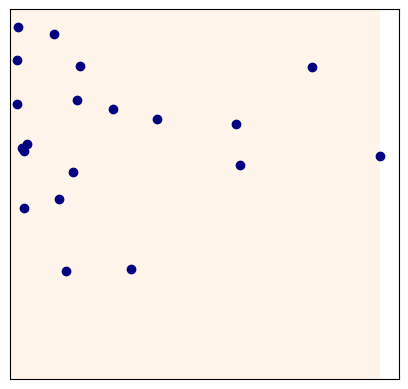

In [2]:
# Generating the dataset
torch.manual_seed(5)
d = 2   # dimension of the data points
n = 20   # number of data points

#y = torch.zeros((n,d), device=device)
y = (torch.randn(n, d, device = device)).abs() 
y = y / y.max()
nu = torch.ones(n, device=device)/n  # equal masses (nu is the empirical measure of the data)

# generate grid for plotting purpose
nr,nc = 256,256
extent = ((-0.5/nc, 1-0.5/nc, 1-0.5/nr, -0.5/nr))
xs = torch.linspace(0, 1, steps=nr)
ys = torch.linspace(0, 1, steps=nc)
xm, ym = torch.meshgrid(xs, ys, indexing='ij')
xm = xm.T
ym = ym.T
xgrid = torch.cat((xm.reshape(nr*nc,1),ym.reshape(nr*nc,1)),1).to(device)

# Plot data points
fig = plt.figure(dpi=100)
plt.xticks([])
plt.yticks([])
plt.imshow(np.zeros((nr,nc)),cmap = 'Oranges', extent=extent) # background
plt.scatter(y[:, 0].cpu(), y[:,1].cpu(),c='navy')
plt.show()

### GAN

[0/100] 	Loss_D: 0.2330	Loss_G: 1.9336


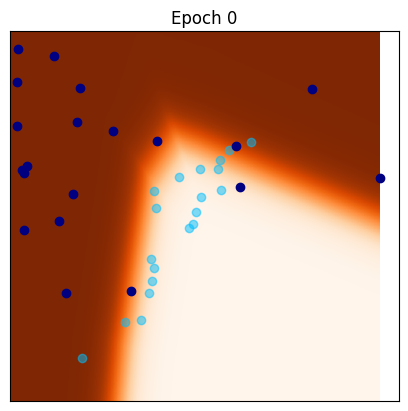

[1/100] 	Loss_D: 0.5065	Loss_G: 1.7825
[2/100] 	Loss_D: 0.5557	Loss_G: 1.5391
[3/100] 	Loss_D: 0.5780	Loss_G: 1.4633
[4/100] 	Loss_D: 0.5006	Loss_G: 1.5941
[5/100] 	Loss_D: 0.5026	Loss_G: 1.1403
[6/100] 	Loss_D: 0.6628	Loss_G: 1.5182
[7/100] 	Loss_D: 0.6290	Loss_G: 1.0793
[8/100] 	Loss_D: 0.8351	Loss_G: 1.5351
[9/100] 	Loss_D: 0.7209	Loss_G: 1.5794
[10/100] 	Loss_D: 0.9070	Loss_G: 1.3160


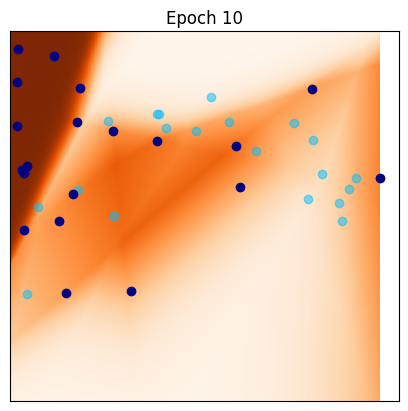

[11/100] 	Loss_D: 1.0402	Loss_G: 1.0159
[12/100] 	Loss_D: 0.9562	Loss_G: 1.1057
[13/100] 	Loss_D: 0.8455	Loss_G: 1.2433
[14/100] 	Loss_D: 0.8352	Loss_G: 1.3203
[15/100] 	Loss_D: 0.9718	Loss_G: 1.2299
[16/100] 	Loss_D: 0.8852	Loss_G: 1.3080
[17/100] 	Loss_D: 0.9344	Loss_G: 1.4587
[18/100] 	Loss_D: 0.9664	Loss_G: 1.4403
[19/100] 	Loss_D: 0.9866	Loss_G: 1.2709
[20/100] 	Loss_D: 1.0343	Loss_G: 0.9509


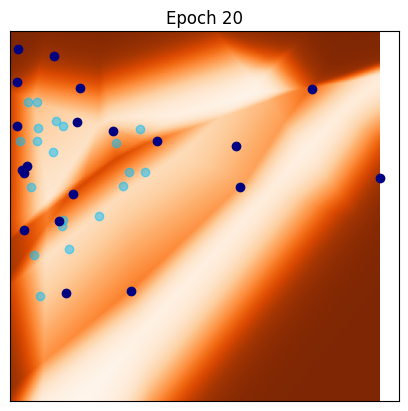

[21/100] 	Loss_D: 1.0859	Loss_G: 1.1495
[22/100] 	Loss_D: 1.0243	Loss_G: 1.0860
[23/100] 	Loss_D: 0.9686	Loss_G: 1.0033
[24/100] 	Loss_D: 0.9348	Loss_G: 0.9685
[25/100] 	Loss_D: 1.0943	Loss_G: 1.3822
[26/100] 	Loss_D: 1.0524	Loss_G: 1.5329
[27/100] 	Loss_D: 1.0024	Loss_G: 1.4683
[28/100] 	Loss_D: 1.0515	Loss_G: 1.0161
[29/100] 	Loss_D: 1.0622	Loss_G: 1.0796
[30/100] 	Loss_D: 0.9742	Loss_G: 1.3203


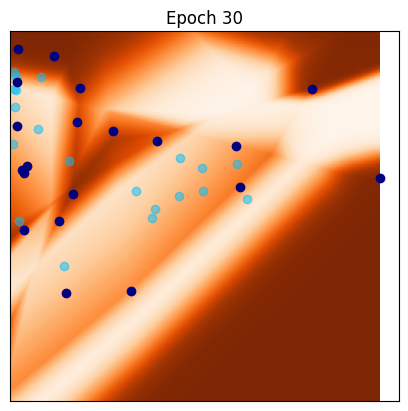

[31/100] 	Loss_D: 0.9709	Loss_G: 0.8716
[32/100] 	Loss_D: 1.1233	Loss_G: 0.9742
[33/100] 	Loss_D: 1.0935	Loss_G: 0.9175
[34/100] 	Loss_D: 0.8926	Loss_G: 0.9889
[35/100] 	Loss_D: 0.9325	Loss_G: 0.8329
[36/100] 	Loss_D: 1.0128	Loss_G: 1.0394
[37/100] 	Loss_D: 1.0141	Loss_G: 1.0860
[38/100] 	Loss_D: 1.0190	Loss_G: 1.1118
[39/100] 	Loss_D: 1.0662	Loss_G: 1.1215
[40/100] 	Loss_D: 1.1019	Loss_G: 1.0542


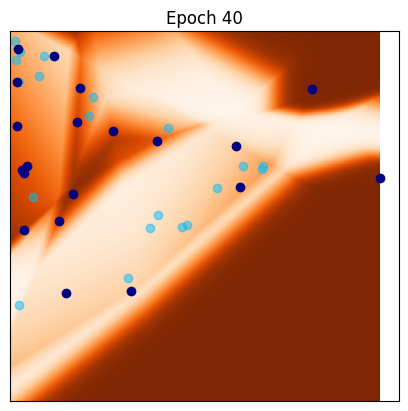

[41/100] 	Loss_D: 1.1259	Loss_G: 1.0025
[42/100] 	Loss_D: 1.2164	Loss_G: 1.3488
[43/100] 	Loss_D: 0.9967	Loss_G: 0.8640
[44/100] 	Loss_D: 1.0941	Loss_G: 1.0484
[45/100] 	Loss_D: 1.1158	Loss_G: 1.0298
[46/100] 	Loss_D: 1.2329	Loss_G: 0.9385
[47/100] 	Loss_D: 1.2778	Loss_G: 1.1174
[48/100] 	Loss_D: 1.1299	Loss_G: 0.9825
[49/100] 	Loss_D: 0.9890	Loss_G: 0.8351
[50/100] 	Loss_D: 0.9156	Loss_G: 1.0393


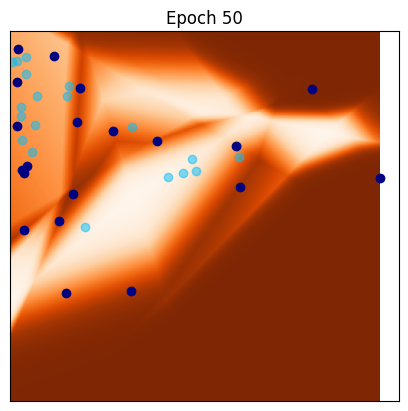

[51/100] 	Loss_D: 1.0096	Loss_G: 1.2591
[52/100] 	Loss_D: 1.1496	Loss_G: 1.5015
[53/100] 	Loss_D: 1.0479	Loss_G: 1.0392
[54/100] 	Loss_D: 1.3018	Loss_G: 1.3114
[55/100] 	Loss_D: 1.2070	Loss_G: 1.2659
[56/100] 	Loss_D: 1.0389	Loss_G: 1.1163
[57/100] 	Loss_D: 1.0673	Loss_G: 1.1341
[58/100] 	Loss_D: 1.3075	Loss_G: 1.1246
[59/100] 	Loss_D: 1.0137	Loss_G: 0.8365
[60/100] 	Loss_D: 1.1768	Loss_G: 1.3164


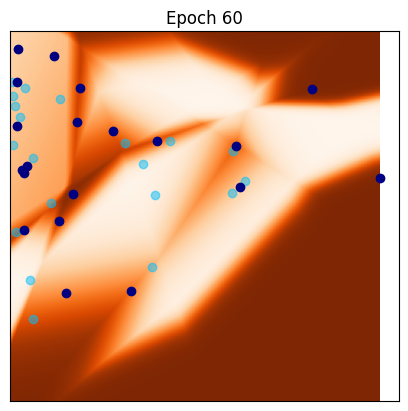

[61/100] 	Loss_D: 1.2146	Loss_G: 1.2023
[62/100] 	Loss_D: 1.1008	Loss_G: 0.8248
[63/100] 	Loss_D: 1.0029	Loss_G: 1.0222
[64/100] 	Loss_D: 1.1219	Loss_G: 1.0044
[65/100] 	Loss_D: 1.0990	Loss_G: 0.8046
[66/100] 	Loss_D: 1.1488	Loss_G: 0.8706
[67/100] 	Loss_D: 1.1588	Loss_G: 1.0325
[68/100] 	Loss_D: 1.0737	Loss_G: 0.8993
[69/100] 	Loss_D: 1.0875	Loss_G: 0.8353
[70/100] 	Loss_D: 1.1160	Loss_G: 1.0252


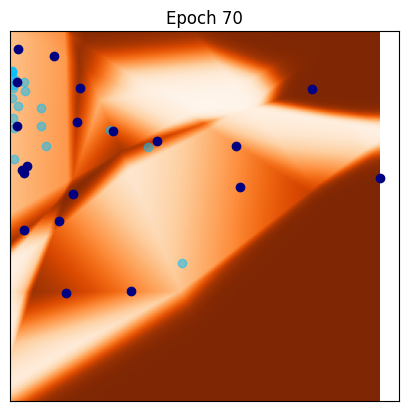

[71/100] 	Loss_D: 1.0224	Loss_G: 0.8895
[72/100] 	Loss_D: 1.1174	Loss_G: 1.0353
[73/100] 	Loss_D: 1.1381	Loss_G: 1.0348
[74/100] 	Loss_D: 1.1036	Loss_G: 0.9976
[75/100] 	Loss_D: 0.9624	Loss_G: 1.0322
[76/100] 	Loss_D: 0.8794	Loss_G: 0.9838
[77/100] 	Loss_D: 0.9284	Loss_G: 1.0429
[78/100] 	Loss_D: 1.1078	Loss_G: 1.2587
[79/100] 	Loss_D: 0.9171	Loss_G: 1.7274
[80/100] 	Loss_D: 0.8823	Loss_G: 0.9009


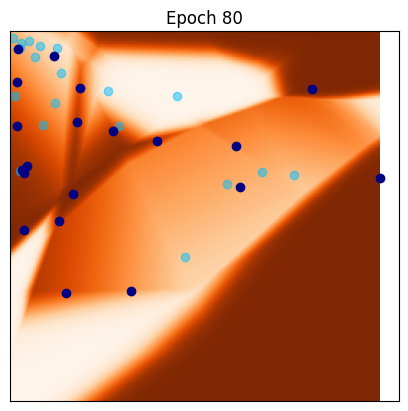

[81/100] 	Loss_D: 0.9550	Loss_G: 1.1162
[82/100] 	Loss_D: 0.8808	Loss_G: 0.8405
[83/100] 	Loss_D: 1.0201	Loss_G: 1.0422
[84/100] 	Loss_D: 0.9931	Loss_G: 0.8587
[85/100] 	Loss_D: 0.9329	Loss_G: 1.1585
[86/100] 	Loss_D: 0.9525	Loss_G: 1.2849
[87/100] 	Loss_D: 0.8895	Loss_G: 0.9853
[88/100] 	Loss_D: 0.9108	Loss_G: 1.2940
[89/100] 	Loss_D: 0.8974	Loss_G: 1.3236
[90/100] 	Loss_D: 0.9074	Loss_G: 1.1660


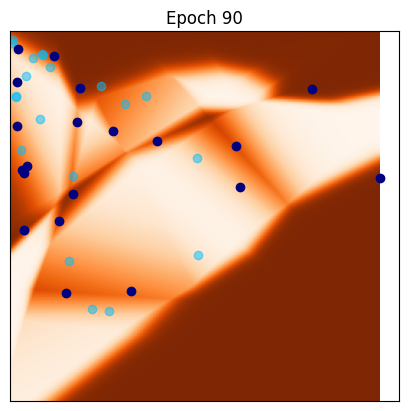

[91/100] 	Loss_D: 0.8008	Loss_G: 1.0433
[92/100] 	Loss_D: 0.9805	Loss_G: 1.1926
[93/100] 	Loss_D: 1.0435	Loss_G: 1.6240
[94/100] 	Loss_D: 1.0034	Loss_G: 1.2957
[95/100] 	Loss_D: 1.0139	Loss_G: 1.2812
[96/100] 	Loss_D: 0.9012	Loss_G: 1.1379
[97/100] 	Loss_D: 1.0405	Loss_G: 1.0010
[98/100] 	Loss_D: 1.0960	Loss_G: 1.3917
[99/100] 	Loss_D: 1.0216	Loss_G: 1.4539


In [58]:
# Training GAN
n_in = 10
b = 100
G = Generator(n_in=n_in, n_out=d, n_hid=10, nlayers=5, device=device)

D = DGAN(d, n_hid = 10).to(device)


gan, Glosses, Dlosses = train_gan2D(G, D, y, b = len(y))

The final result is pretty decent, the generator has managed to understand the structure of the dataset. Notice how all the points generated are also biased towards the region where there are the most points (top left region), ignoring the outliers.

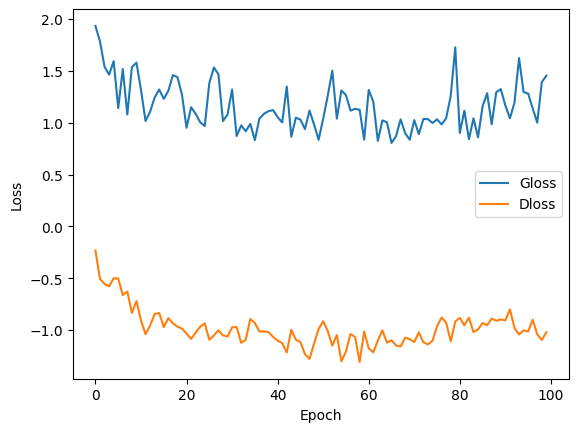

In [65]:
plt.plot(Glosses, label = "Gloss")
plt.plot(Dlosses, label = "Dloss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()

The losses for the two networks have slightly decreased, especially for the discriminator, but is quite steady due to the adversiality of the learning algorithm.

### WGAN

  1%|▊                                                                                   | 1/99 [00:07<11:36,  7.10s/it]

[1/100] 	Loss_D: -0.5331	Loss_G: 0.8914


  2%|█▋                                                                                  | 2/99 [00:14<11:36,  7.18s/it]

[2/100] 	Loss_D: -0.3296	Loss_G: 0.4280


  3%|██▌                                                                                 | 3/99 [00:21<11:26,  7.15s/it]

[3/100] 	Loss_D: -0.2254	Loss_G: 0.0268


  4%|███▍                                                                                | 4/99 [00:28<11:22,  7.19s/it]

[4/100] 	Loss_D: -0.2029	Loss_G: 0.0014
[5/100] 	Loss_D: -0.1230	Loss_G: 0.4377


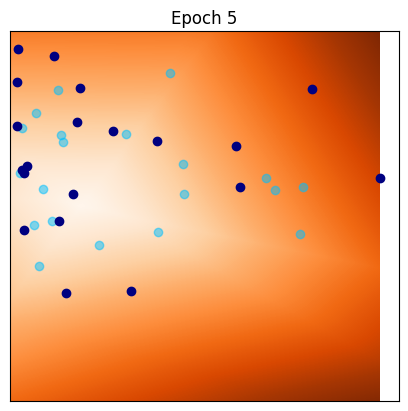

  6%|█████                                                                               | 6/99 [00:43<11:07,  7.17s/it]

[6/100] 	Loss_D: -0.1559	Loss_G: -0.0103


  7%|█████▉                                                                              | 7/99 [00:50<11:03,  7.21s/it]

[7/100] 	Loss_D: -0.1250	Loss_G: -0.1509


  8%|██████▊                                                                             | 8/99 [00:57<10:55,  7.20s/it]

[8/100] 	Loss_D: -0.1913	Loss_G: -0.4734


  9%|███████▋                                                                            | 9/99 [01:04<10:51,  7.24s/it]

[9/100] 	Loss_D: -0.1455	Loss_G: -0.4269
[10/100] 	Loss_D: -0.0866	Loss_G: -0.9362


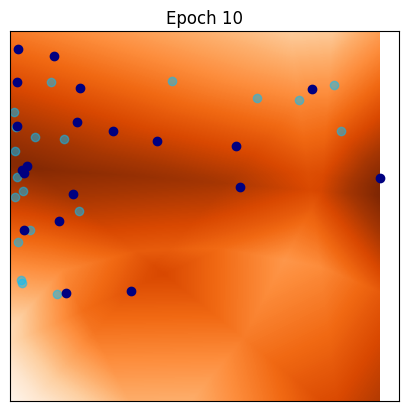

 11%|█████████▏                                                                         | 11/99 [01:19<10:42,  7.30s/it]

[11/100] 	Loss_D: -0.1727	Loss_G: -1.4681


 12%|██████████                                                                         | 12/99 [01:26<10:37,  7.32s/it]

[12/100] 	Loss_D: -0.0414	Loss_G: -1.9837


 13%|██████████▉                                                                        | 13/99 [01:34<10:24,  7.27s/it]

[13/100] 	Loss_D: -0.1552	Loss_G: -0.8340


 14%|███████████▋                                                                       | 14/99 [01:41<10:25,  7.36s/it]

[14/100] 	Loss_D: -0.0537	Loss_G: -0.6255
[15/100] 	Loss_D: -0.1076	Loss_G: -1.6032


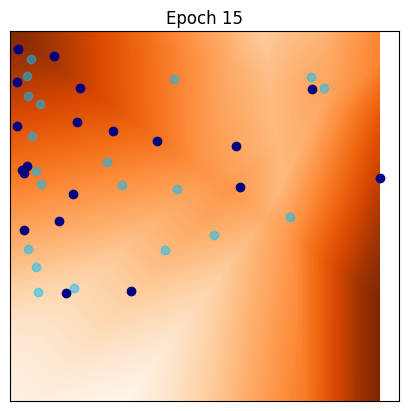

 16%|█████████████▍                                                                     | 16/99 [01:58<11:00,  7.95s/it]

[16/100] 	Loss_D: -0.1838	Loss_G: -1.6352


 17%|██████████████▎                                                                    | 17/99 [02:07<11:09,  8.17s/it]

[17/100] 	Loss_D: -0.1229	Loss_G: -1.6277


 18%|███████████████                                                                    | 18/99 [02:15<11:14,  8.33s/it]

[18/100] 	Loss_D: -0.0993	Loss_G: -1.9152


 19%|███████████████▉                                                                   | 19/99 [02:24<11:10,  8.38s/it]

[19/100] 	Loss_D: -0.0241	Loss_G: -1.9771
[20/100] 	Loss_D: -0.0427	Loss_G: -1.8404


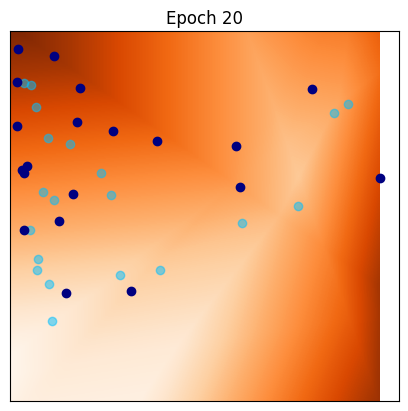

 21%|█████████████████▌                                                                 | 21/99 [02:40<10:45,  8.27s/it]

[21/100] 	Loss_D: -0.1144	Loss_G: -1.9083


 22%|██████████████████▍                                                                | 22/99 [02:48<10:23,  8.10s/it]

[22/100] 	Loss_D: -0.0455	Loss_G: -1.7162


 23%|███████████████████▎                                                               | 23/99 [02:55<09:54,  7.83s/it]

[23/100] 	Loss_D: -0.3059	Loss_G: -1.3169


 24%|████████████████████                                                               | 24/99 [03:03<09:33,  7.64s/it]

[24/100] 	Loss_D: -0.0681	Loss_G: -1.4732
[25/100] 	Loss_D: -0.0170	Loss_G: -2.6587


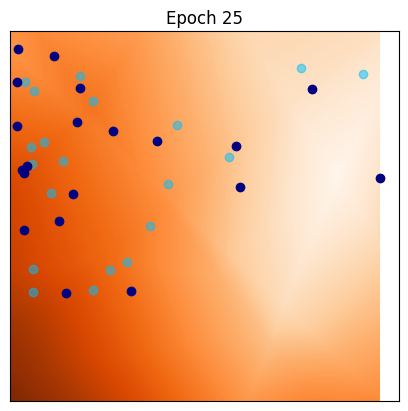

 26%|█████████████████████▊                                                             | 26/99 [03:18<09:13,  7.58s/it]

[26/100] 	Loss_D: -0.1573	Loss_G: -1.9401


 27%|██████████████████████▋                                                            | 27/99 [03:26<09:26,  7.87s/it]

[27/100] 	Loss_D: -0.0737	Loss_G: -1.8129


 28%|███████████████████████▍                                                           | 28/99 [03:35<09:33,  8.07s/it]

[28/100] 	Loss_D: 0.0384	Loss_G: -1.3654


 29%|████████████████████████▎                                                          | 29/99 [03:43<09:35,  8.22s/it]

[29/100] 	Loss_D: -0.1203	Loss_G: -0.7097
[30/100] 	Loss_D: -0.2117	Loss_G: -1.5248


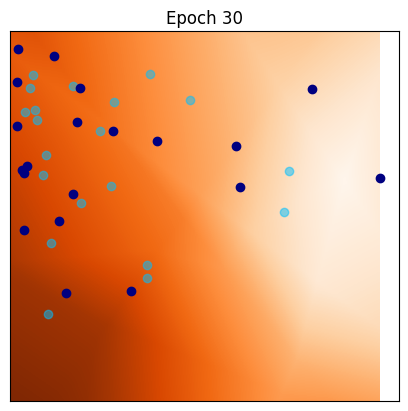

 31%|█████████████████████████▉                                                         | 31/99 [04:01<09:35,  8.46s/it]

[31/100] 	Loss_D: -0.0586	Loss_G: -1.5956


 32%|██████████████████████████▊                                                        | 32/99 [04:09<09:30,  8.51s/it]

[32/100] 	Loss_D: -0.1677	Loss_G: -0.5575


 33%|███████████████████████████▋                                                       | 33/99 [04:18<09:24,  8.55s/it]

[33/100] 	Loss_D: -0.0196	Loss_G: -0.7261


 34%|████████████████████████████▌                                                      | 34/99 [04:27<09:18,  8.60s/it]

[34/100] 	Loss_D: -0.0447	Loss_G: -0.4378
[35/100] 	Loss_D: -0.0749	Loss_G: -1.0524


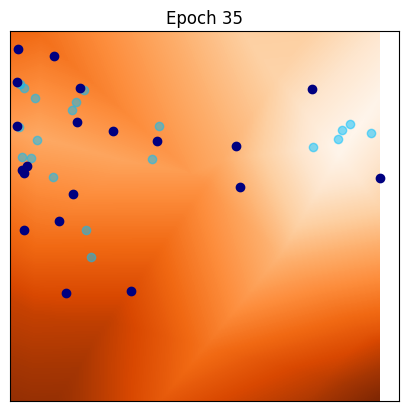

 36%|██████████████████████████████▏                                                    | 36/99 [04:44<09:05,  8.65s/it]

[36/100] 	Loss_D: -0.0589	Loss_G: -0.9011


 37%|███████████████████████████████                                                    | 37/99 [04:53<08:59,  8.70s/it]

[37/100] 	Loss_D: -0.0794	Loss_G: -0.2030


 38%|███████████████████████████████▊                                                   | 38/99 [05:00<08:24,  8.27s/it]

[38/100] 	Loss_D: -0.0563	Loss_G: -0.3904


 39%|████████████████████████████████▋                                                  | 39/99 [05:07<07:55,  7.92s/it]

[39/100] 	Loss_D: -0.0505	Loss_G: -0.9213
[40/100] 	Loss_D: -0.1224	Loss_G: -2.0545


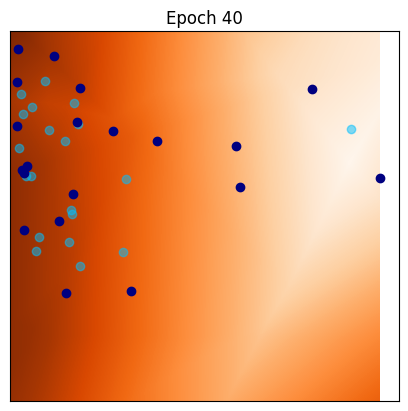

 41%|██████████████████████████████████▎                                                | 41/99 [05:22<07:17,  7.55s/it]

[41/100] 	Loss_D: -0.1418	Loss_G: -1.9044


 42%|███████████████████████████████████▏                                               | 42/99 [05:29<07:03,  7.42s/it]

[42/100] 	Loss_D: -0.0980	Loss_G: -0.4953


 43%|████████████████████████████████████                                               | 43/99 [05:36<06:51,  7.34s/it]

[43/100] 	Loss_D: -0.1404	Loss_G: 0.4064


 44%|████████████████████████████████████▉                                              | 44/99 [05:43<06:40,  7.28s/it]

[44/100] 	Loss_D: -0.1054	Loss_G: -0.2629
[45/100] 	Loss_D: -0.0631	Loss_G: -1.4576


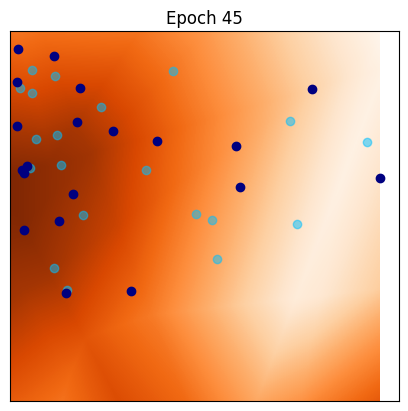

 46%|██████████████████████████████████████▌                                            | 46/99 [05:58<06:24,  7.25s/it]

[46/100] 	Loss_D: -0.2655	Loss_G: -1.8078


 47%|███████████████████████████████████████▍                                           | 47/99 [06:05<06:16,  7.23s/it]

[47/100] 	Loss_D: -0.0329	Loss_G: -1.8508


 48%|████████████████████████████████████████▏                                          | 48/99 [06:12<06:07,  7.20s/it]

[48/100] 	Loss_D: -0.0653	Loss_G: -1.0892


 49%|█████████████████████████████████████████                                          | 49/99 [06:19<05:59,  7.18s/it]

[49/100] 	Loss_D: -0.1557	Loss_G: -0.8621
[50/100] 	Loss_D: -0.1021	Loss_G: -0.9526


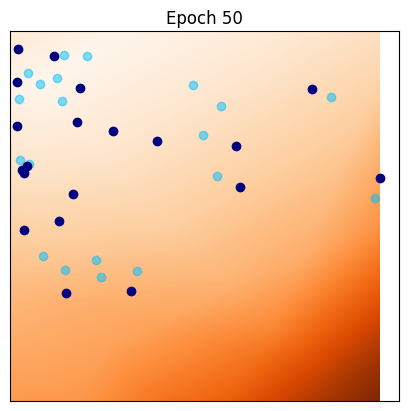

 52%|██████████████████████████████████████████▊                                        | 51/99 [06:33<05:44,  7.18s/it]

[51/100] 	Loss_D: -0.1155	Loss_G: -1.3868


 53%|███████████████████████████████████████████▌                                       | 52/99 [06:40<05:36,  7.17s/it]

[52/100] 	Loss_D: 0.0819	Loss_G: -1.0124


 54%|████████████████████████████████████████████▍                                      | 53/99 [06:48<05:29,  7.15s/it]

[53/100] 	Loss_D: -0.1181	Loss_G: -0.4818


 55%|█████████████████████████████████████████████▎                                     | 54/99 [06:55<05:21,  7.15s/it]

[54/100] 	Loss_D: -0.0857	Loss_G: -0.0740
[55/100] 	Loss_D: -0.0631	Loss_G: -1.3564


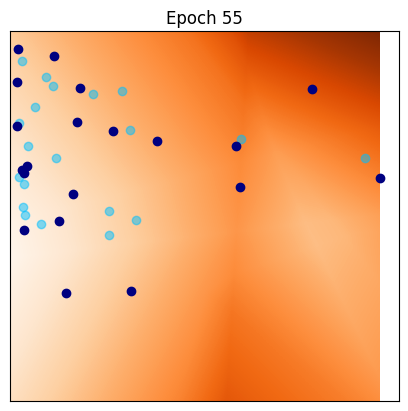

 57%|██████████████████████████████████████████████▉                                    | 56/99 [07:09<05:08,  7.18s/it]

[56/100] 	Loss_D: -0.0007	Loss_G: -2.7431


 58%|███████████████████████████████████████████████▊                                   | 57/99 [07:16<05:01,  7.19s/it]

[57/100] 	Loss_D: -0.0553	Loss_G: -2.8774


 59%|████████████████████████████████████████████████▋                                  | 58/99 [07:24<04:53,  7.17s/it]

[58/100] 	Loss_D: 0.0373	Loss_G: -1.7767


 60%|█████████████████████████████████████████████████▍                                 | 59/99 [07:31<04:46,  7.16s/it]

[59/100] 	Loss_D: -0.0145	Loss_G: -0.9612
[60/100] 	Loss_D: 0.0295	Loss_G: -2.5117


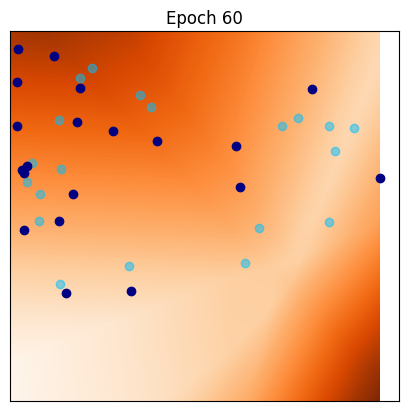

 62%|███████████████████████████████████████████████████▏                               | 61/99 [07:45<04:33,  7.19s/it]

[61/100] 	Loss_D: -0.1389	Loss_G: -3.0757


 63%|███████████████████████████████████████████████████▉                               | 62/99 [07:52<04:25,  7.18s/it]

[62/100] 	Loss_D: -0.1863	Loss_G: -2.8471


 64%|████████████████████████████████████████████████████▊                              | 63/99 [07:59<04:18,  7.18s/it]

[63/100] 	Loss_D: -0.1669	Loss_G: -2.9467


 65%|█████████████████████████████████████████████████████▋                             | 64/99 [08:07<04:10,  7.17s/it]

[64/100] 	Loss_D: 0.0471	Loss_G: -4.1944
[65/100] 	Loss_D: -0.0328	Loss_G: -3.1977


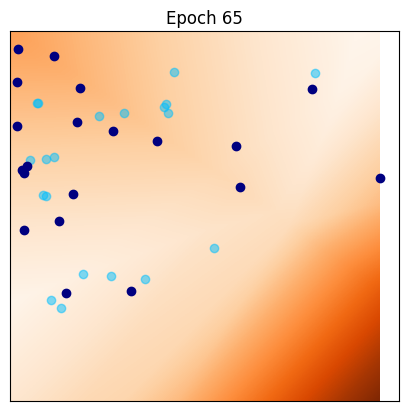

 67%|███████████████████████████████████████████████████████▎                           | 66/99 [08:21<03:57,  7.19s/it]

[66/100] 	Loss_D: -0.1725	Loss_G: -1.5615


 68%|████████████████████████████████████████████████████████▏                          | 67/99 [08:28<03:49,  7.18s/it]

[67/100] 	Loss_D: 0.0102	Loss_G: -1.5943


 69%|█████████████████████████████████████████████████████████                          | 68/99 [08:35<03:42,  7.17s/it]

[68/100] 	Loss_D: -0.1220	Loss_G: -1.9374


 70%|█████████████████████████████████████████████████████████▊                         | 69/99 [08:42<03:34,  7.16s/it]

[69/100] 	Loss_D: -0.0567	Loss_G: -2.2071
[70/100] 	Loss_D: -0.1058	Loss_G: -2.2292


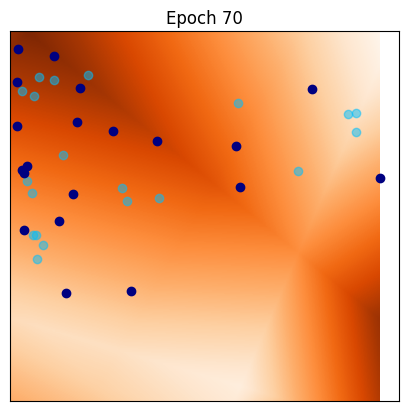

 72%|███████████████████████████████████████████████████████████▌                       | 71/99 [08:57<03:21,  7.20s/it]

[71/100] 	Loss_D: -0.0965	Loss_G: -3.1060


 73%|████████████████████████████████████████████████████████████▎                      | 72/99 [09:04<03:13,  7.18s/it]

[72/100] 	Loss_D: -0.0870	Loss_G: -2.4024


 74%|█████████████████████████████████████████████████████████████▏                     | 73/99 [09:11<03:06,  7.17s/it]

[73/100] 	Loss_D: -0.0303	Loss_G: -2.0724


 75%|██████████████████████████████████████████████████████████████                     | 74/99 [09:18<02:59,  7.16s/it]

[74/100] 	Loss_D: 0.0059	Loss_G: -1.8593
[75/100] 	Loss_D: -0.0405	Loss_G: -1.6219


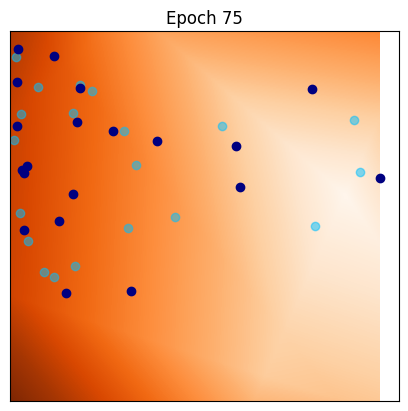

 77%|███████████████████████████████████████████████████████████████▋                   | 76/99 [09:33<02:45,  7.18s/it]

[76/100] 	Loss_D: -0.0574	Loss_G: -1.6442


 78%|████████████████████████████████████████████████████████████████▌                  | 77/99 [09:40<02:37,  7.17s/it]

[77/100] 	Loss_D: -0.0893	Loss_G: -1.6682


 79%|█████████████████████████████████████████████████████████████████▍                 | 78/99 [09:47<02:30,  7.16s/it]

[78/100] 	Loss_D: 0.0214	Loss_G: -1.5212


 80%|██████████████████████████████████████████████████████████████████▏                | 79/99 [09:54<02:23,  7.15s/it]

[79/100] 	Loss_D: 0.0217	Loss_G: -1.5630
[80/100] 	Loss_D: -0.1168	Loss_G: -1.0596


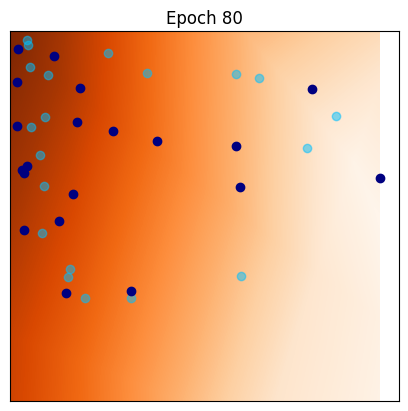

 82%|███████████████████████████████████████████████████████████████████▉               | 81/99 [10:09<02:09,  7.17s/it]

[81/100] 	Loss_D: -0.1156	Loss_G: -0.9463


 83%|████████████████████████████████████████████████████████████████████▋              | 82/99 [10:16<02:02,  7.18s/it]

[82/100] 	Loss_D: -0.0130	Loss_G: -0.9993


 84%|█████████████████████████████████████████████████████████████████████▌             | 83/99 [10:23<01:54,  7.17s/it]

[83/100] 	Loss_D: -0.0723	Loss_G: -2.1985


 85%|██████████████████████████████████████████████████████████████████████▍            | 84/99 [10:30<01:47,  7.16s/it]

[84/100] 	Loss_D: -0.0332	Loss_G: -2.5614
[85/100] 	Loss_D: -0.0190	Loss_G: -2.6675


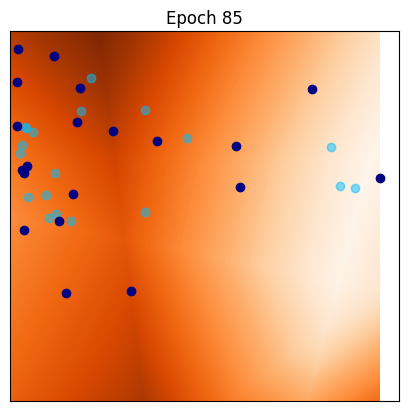

 87%|████████████████████████████████████████████████████████████████████████           | 86/99 [10:45<01:33,  7.19s/it]

[86/100] 	Loss_D: -0.0777	Loss_G: -2.9960


 88%|████████████████████████████████████████████████████████████████████████▉          | 87/99 [10:52<01:26,  7.18s/it]

[87/100] 	Loss_D: -0.0101	Loss_G: -3.3943


 89%|█████████████████████████████████████████████████████████████████████████▊         | 88/99 [10:59<01:18,  7.17s/it]

[88/100] 	Loss_D: -0.1721	Loss_G: -2.8970


 90%|██████████████████████████████████████████████████████████████████████████▌        | 89/99 [11:06<01:11,  7.16s/it]

[89/100] 	Loss_D: -0.1477	Loss_G: -3.0777
[90/100] 	Loss_D: -0.0241	Loss_G: -3.9370


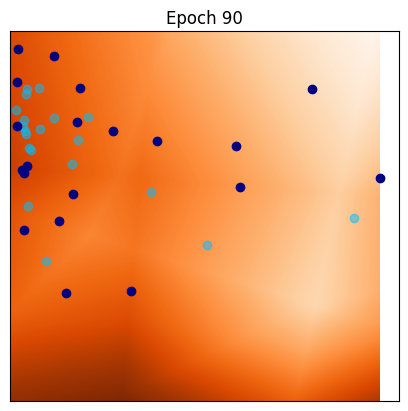

 92%|████████████████████████████████████████████████████████████████████████████▎      | 91/99 [11:20<00:57,  7.18s/it]

[91/100] 	Loss_D: -0.0379	Loss_G: -3.5666


 93%|█████████████████████████████████████████████████████████████████████████████▏     | 92/99 [11:28<00:50,  7.17s/it]

[92/100] 	Loss_D: -0.0899	Loss_G: -3.4384


 94%|█████████████████████████████████████████████████████████████████████████████▉     | 93/99 [11:35<00:43,  7.26s/it]

[93/100] 	Loss_D: -0.0901	Loss_G: -3.2971


 95%|██████████████████████████████████████████████████████████████████████████████▊    | 94/99 [11:43<00:36,  7.38s/it]

[94/100] 	Loss_D: -0.0567	Loss_G: -3.5072
[95/100] 	Loss_D: -0.0630	Loss_G: -3.2132


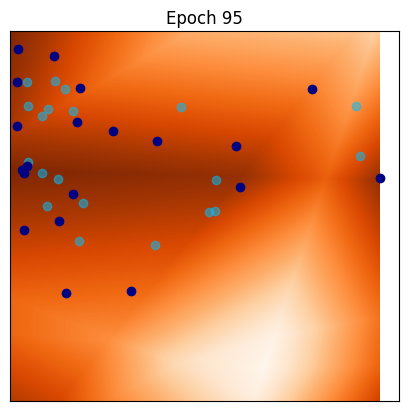

 97%|████████████████████████████████████████████████████████████████████████████████▍  | 96/99 [11:57<00:21,  7.32s/it]

[96/100] 	Loss_D: -0.0240	Loss_G: -1.9501


 98%|█████████████████████████████████████████████████████████████████████████████████▎ | 97/99 [12:04<00:14,  7.26s/it]

[97/100] 	Loss_D: -0.0604	Loss_G: -2.3231


 99%|██████████████████████████████████████████████████████████████████████████████████▏| 98/99 [12:12<00:07,  7.24s/it]

[98/100] 	Loss_D: -0.1066	Loss_G: -2.3901


100%|███████████████████████████████████████████████████████████████████████████████████| 99/99 [12:19<00:00,  7.47s/it]

[99/100] 	Loss_D: -0.0360	Loss_G: -2.0349


In [70]:
# Training WGAN
n_in = 10
b = 100
G = Generator(n_in=n_in, n_out=d, n_hid=10, nlayers=5, device=device)

D = DWGAN(d, n_hid = 10).to(device)


wgan, Glosses, Dlosses = train_wgan2D(G, D, y, b = len(y))

The generator learnt seems to be better than the one learnt with simple GAN. It takes into account the outliers, and seems to understand better the global structure of the dataset.

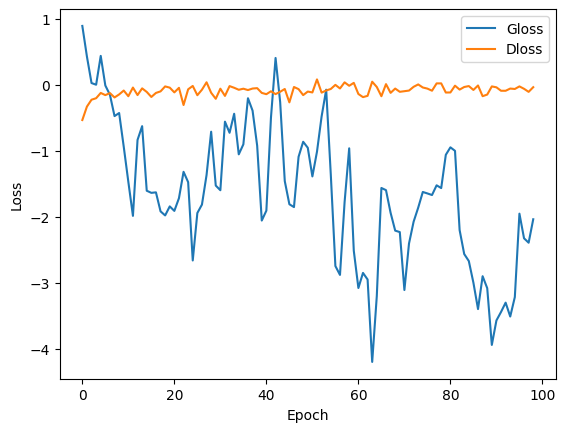

In [71]:
plt.plot(Glosses, label = "Gloss")
plt.plot(Dlosses, label = "Dloss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()

For the WGAN, the learning is much more stable, with a noticable decrease of the Gloss, while the Dloss is steady.

This is due to the fact that the Wasserstein distance is much more regular because of its weakness.

### Variational auto encoders

The VAE consists of two parts:
* A stochastic encoder E that approximates $$ p(z|x) $$ and that output the mean and variance.
* A decoder D that computes $$ p(x | z) $$ where $$ z \sim \cal{N}(0, 1)$$

During the training:
The model optimizes a lower bound of the log likelihood:
$$
\begin{equation}
    \mathcal{L}_{vae} = -\mathbb{E}_{z \sim q_{\psi}(z|x)} [log(p_{\theta}(x|z)] + D_{kl}(q_{\psi}(z|x)|| p_{\theta}(z))
\end{equation}
$$

The first term is the reconstruction term, minimizing it means maximizing the likelihood of the data given sampled latent variable z.

The second term is the regularization term, it makes sure that $p_{\theta}(z)$ is close enough to $q_{\psi}(z|x)$ so that after training, we can simply sample z from $\cal{N}(0, 1)$.

The reparametrisation trick is needed during training, so that it is differentiable.

In [191]:
class Encoder(nn.Module):
  def __init__(self, n_in, n_out, n_hid = 10, nlayers = 3, device = "cuda"):
    super().__init__()
    self.n_in = n_in
    self.n_out = n_out
    self.n_hid = n_hid
    self.nlayers = nlayers
    self.hidden = nn.ModuleList()
    n1 = n_in
    n2 = n_hid
    for i in range(nlayers):
        self.hidden.append(nn.Sequential(
            nn.Linear(n1, n2),
            nn.ReLU())).to(device)
        n1 = n2
    self.mean_layer = nn.Linear(n2, n_out).to(device)
    self.logvar_layer = nn.Linear(n2, n_out).to(device)
  def forward(self, batch):
    for i in range(self.nlayers):
        batch = self.hidden[i](batch)
    mean = self.mean_layer(batch)
    logvar = self.logvar_layer(batch)
    return mean.to(device), logvar.to(device)
class Decoder(nn.Module):
  def __init__(self, n_in, n_out, n_hid = 10, nlayers = 3, device = "cuda"):
    super().__init__()

    self.n_in = n_in
    self.n_out = n_out
    self.n_hid = n_hid
    self.nlayers = nlayers
    self.hidden = nn.ModuleList()
    n1 = n_in
    n2 = n_hid
    for i in range(nlayers):
        self.hidden.append(nn.Sequential(
            nn.Linear(n1, n2),
            nn.ReLU())).to(device)
        n1 = n2
    self.out = nn.Sequential(nn.Linear(n2, n_out),
                             nn.Sigmoid()).to(device)
  def forward(self, batch):
    for i in range(self.nlayers):
        batch = self.hidden[i](batch)
    return self.out(batch)

class VAE(nn.Module):
  def __init__(self, n_in_encoder, n_in_decoder, n_hid_encoder = 10, n_hid_decoder = 10, nlayers_encoder = 3, nlayers_decoder = 3, device = "cuda"):
    super().__init__()
    self.encoder = Encoder(n_in = n_in_encoder, n_out = n_in_decoder, n_hid = n_hid_encoder, nlayers = nlayers_encoder).to(device)
    self.decoder = Decoder(n_in = n_in_decoder, n_out = n_in_encoder, n_hid = n_hid_decoder, nlayers = nlayers_decoder).to(device)

  def reparametrisation(self, mu, sigma):
    eps = torch.randn_like(sigma).to(device)
    z =  mu + eps * sigma
    return z

  def forward(self, batch):
    mean, logvar = self.encoder(batch)
    sigma = torch.exp(0.5 * logvar).to(device)
    z = self.reparametrisation(mean, sigma)
    return self.decoder(z), mean, logvar


def loss_vae(x, x_predicted, mean, logvar, prop_reconstruction = 1, prop_regularization = 1):
  # Loss de reconstruction
  reconstruction_loss = nn.functional.mse_loss(x_predicted, x, reduction = "sum") * prop_reconstruction
  latent_regularization = 0.5 * torch.sum(mean ** 2 + logvar.exp() - 1- logvar ) * prop_regularization
  return reconstruction_loss + latent_regularization

def train_VAE2D(model,y,  lr = 0.01, n_epochs = 200, prop_reconstruction = 1, prop_regularization = 1):
    optimizer = torch.optim.Adam(model.parameters(), lr)
    losses = []
    size = 25
    for i in tqdm(range(n_epochs)):
      batch = y
      optimizer.zero_grad()
      x_reconstructed, mean, logvar = model(batch)
      loss = loss_vae(batch, x_reconstructed, mean, logvar, prop_reconstruction, prop_regularization)
      loss.backward()
      optimizer.step()
      losses.append(loss.item())
      with torch.no_grad():
        x_reconstructed = x_reconstructed.detach().cpu().numpy()
        plt.scatter(y[:, 0].cpu(), y[:,1].cpu(),c='navy')
        plt.scatter(x_reconstructed[:, 0], x_reconstructed[:, 1], c='deepskyblue', alpha = .5)
        plt.show()
    return model, losses


In [186]:
vae = VAE(2, 1, device = device)

  0%|                                                                                           | 0/200 [00:00<?, ?it/s]

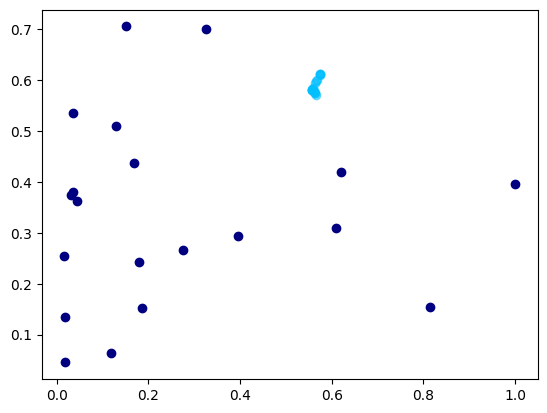

  0%|▍                                                                                  | 1/200 [00:00<00:33,  5.99it/s]

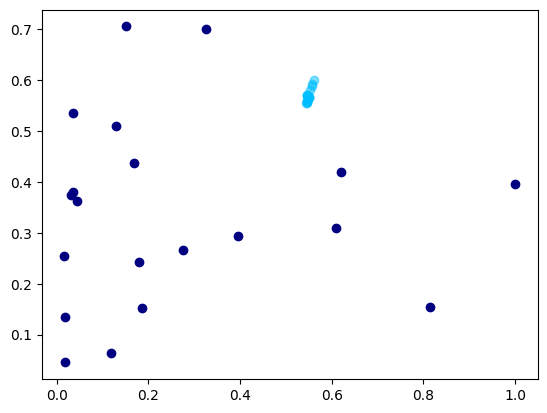

  1%|▊                                                                                  | 2/200 [00:00<00:33,  5.89it/s]

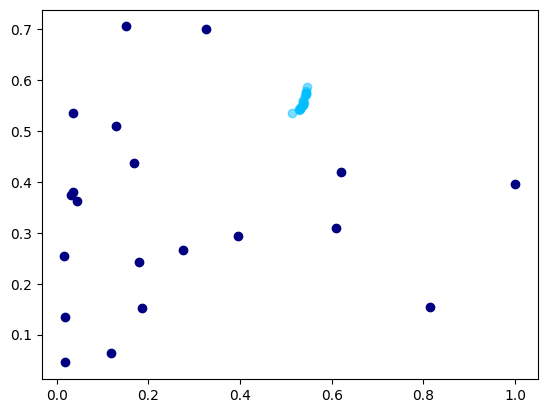

  2%|█▏                                                                                 | 3/200 [00:00<00:33,  5.91it/s]

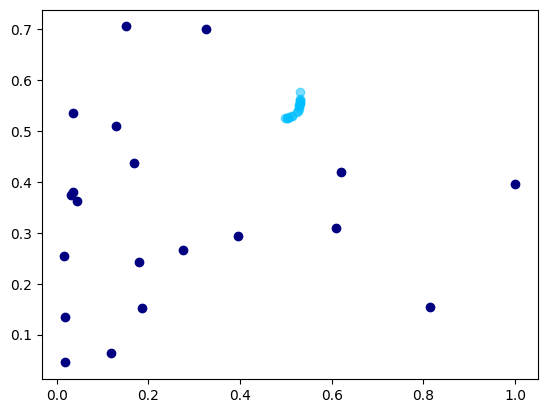

  2%|█▋                                                                                 | 4/200 [00:00<00:33,  5.92it/s]

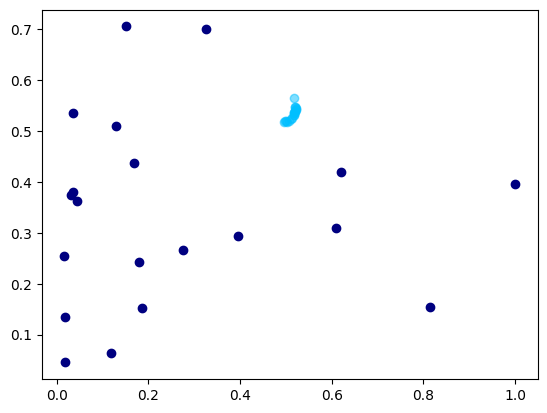

  2%|██                                                                                 | 5/200 [00:00<00:32,  5.92it/s]

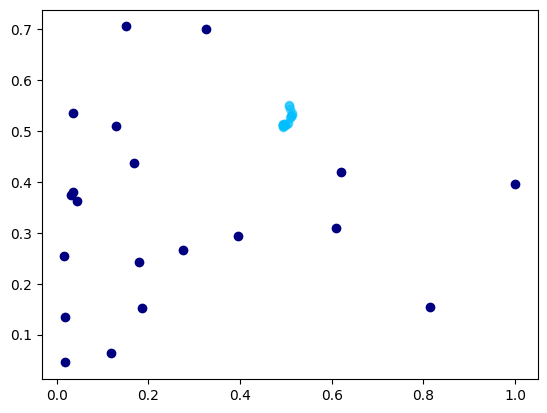

  3%|██▍                                                                                | 6/200 [00:01<00:32,  5.90it/s]

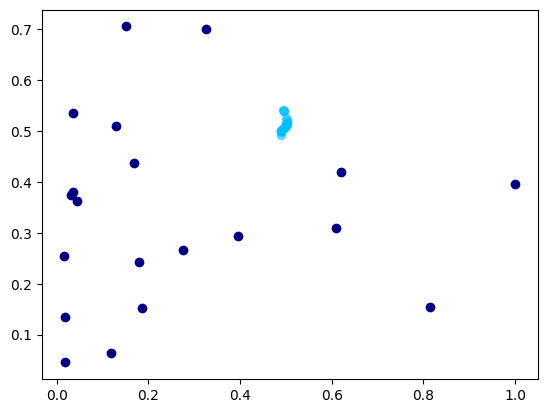

  4%|██▉                                                                                | 7/200 [00:01<00:32,  5.92it/s]

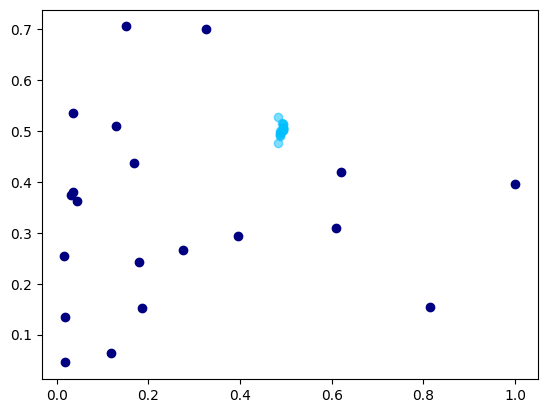

  4%|███▎                                                                               | 8/200 [00:01<00:32,  5.92it/s]

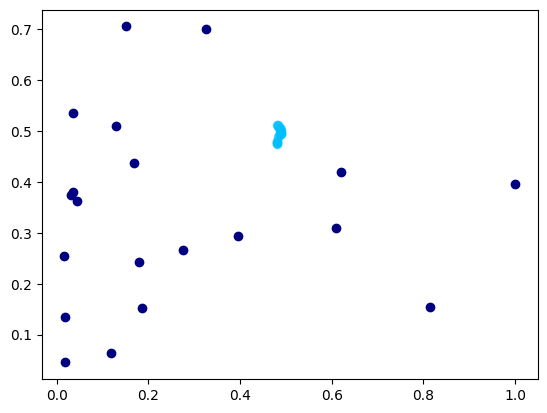

  4%|███▋                                                                               | 9/200 [00:01<00:35,  5.39it/s]

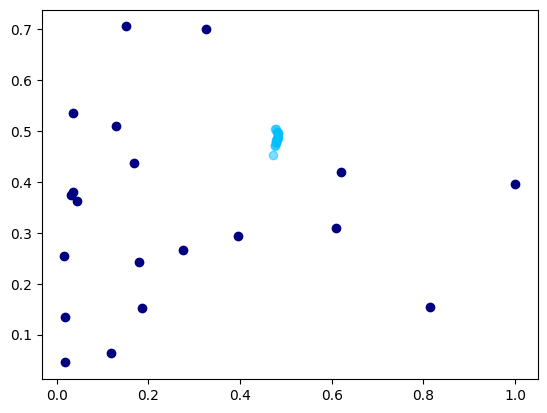

  5%|████                                                                              | 10/200 [00:02<01:00,  3.16it/s]

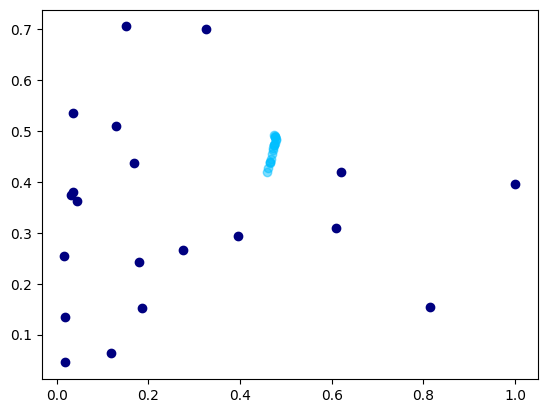

  6%|████▌                                                                             | 11/200 [00:02<00:51,  3.67it/s]

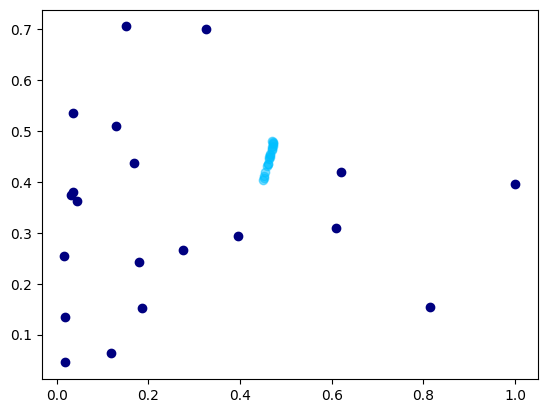

  6%|████▉                                                                             | 12/200 [00:02<00:45,  4.15it/s]

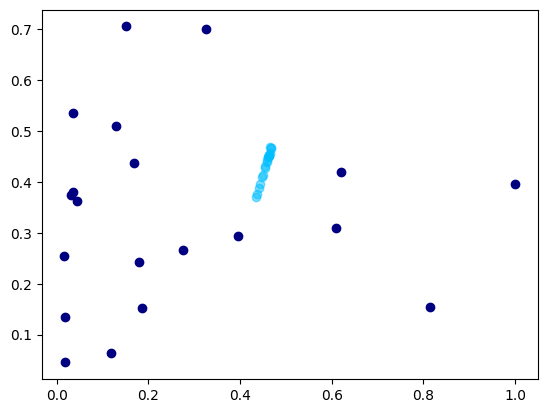

  6%|█████▎                                                                            | 13/200 [00:02<00:41,  4.55it/s]

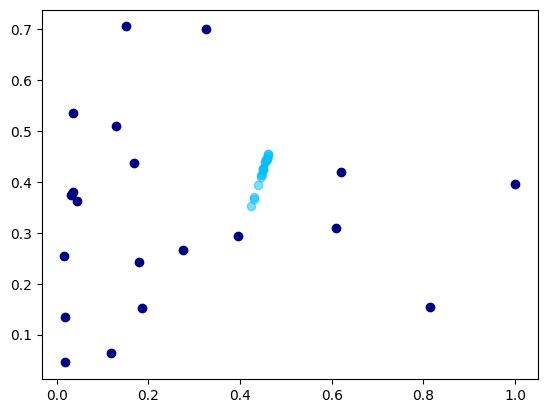

  7%|█████▋                                                                            | 14/200 [00:02<00:37,  4.91it/s]

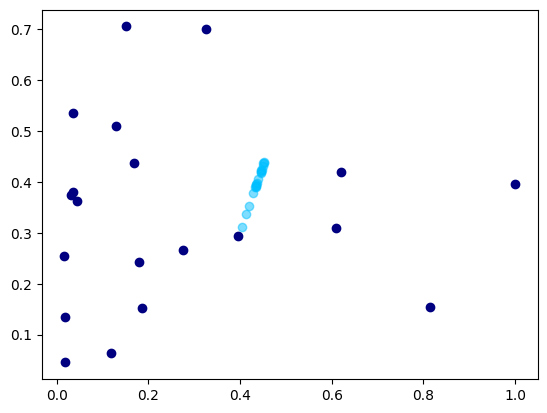

  8%|██████▏                                                                           | 15/200 [00:03<00:35,  5.14it/s]

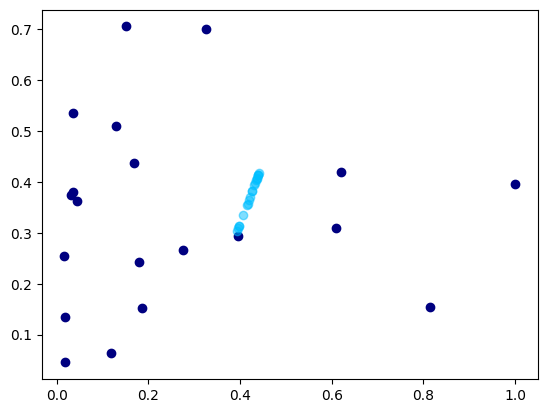

  8%|██████▌                                                                           | 16/200 [00:03<00:34,  5.30it/s]

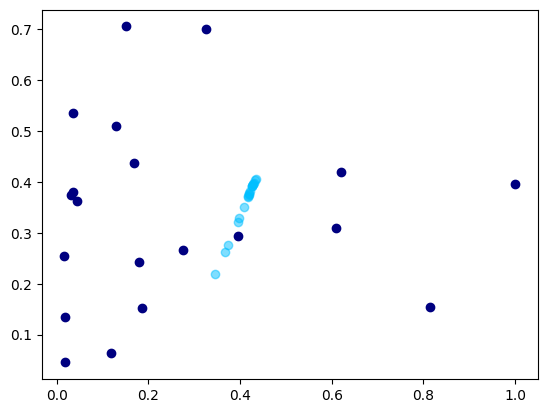

  8%|██████▉                                                                           | 17/200 [00:03<00:33,  5.41it/s]

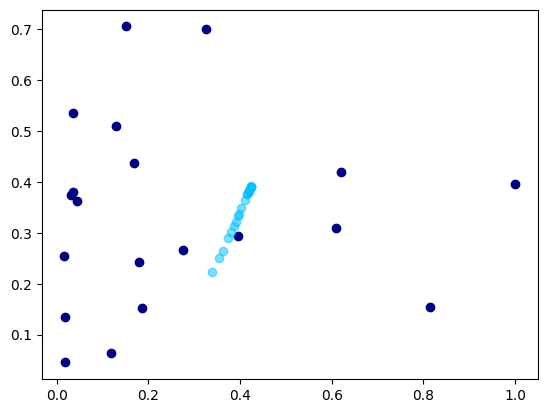

  9%|███████▍                                                                          | 18/200 [00:03<00:32,  5.56it/s]

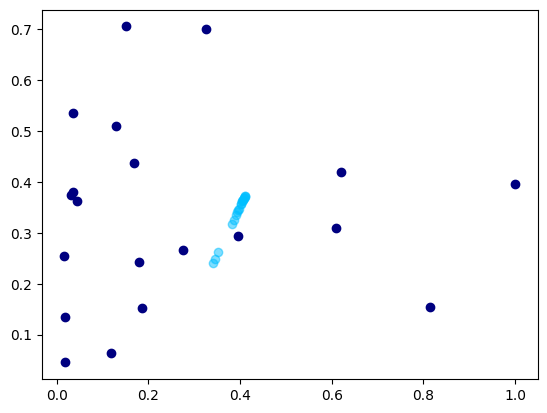

 10%|███████▊                                                                          | 19/200 [00:03<00:32,  5.65it/s]

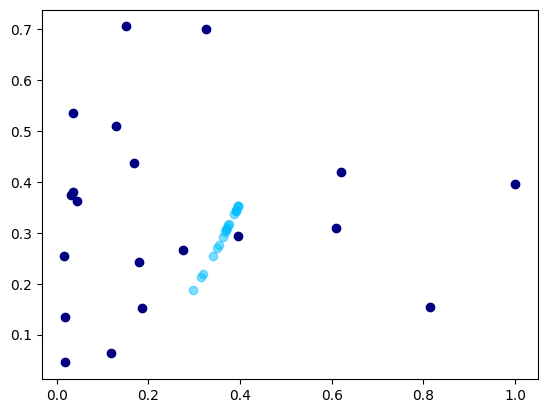

 10%|████████▏                                                                         | 20/200 [00:03<00:31,  5.74it/s]

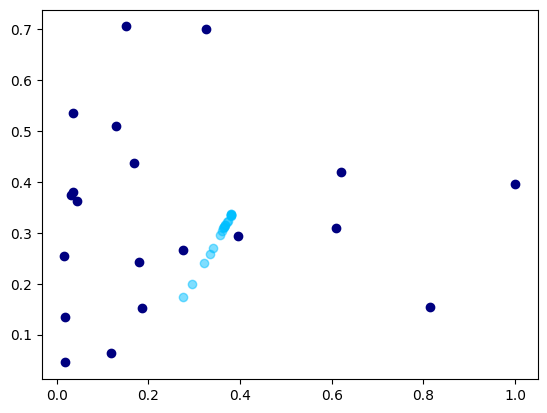

 10%|████████▌                                                                         | 21/200 [00:04<00:31,  5.72it/s]

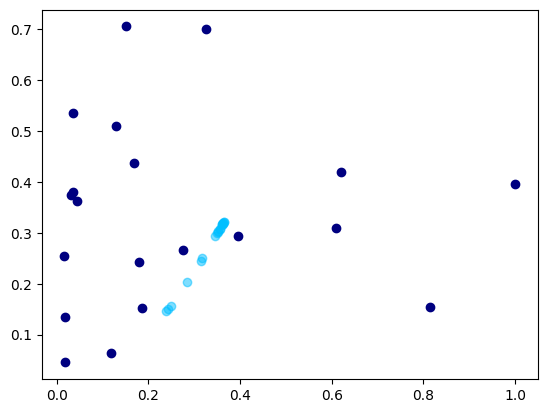

 11%|█████████                                                                         | 22/200 [00:04<00:30,  5.78it/s]

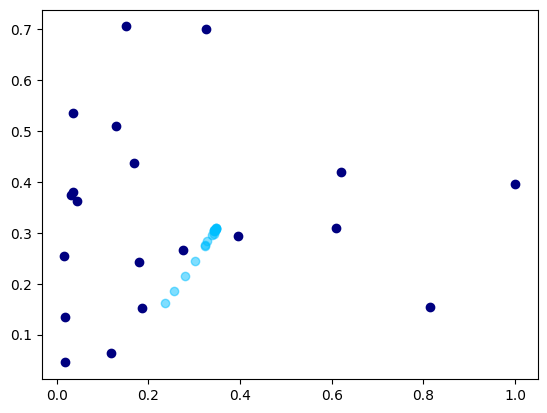

 12%|█████████▍                                                                        | 23/200 [00:04<00:31,  5.66it/s]

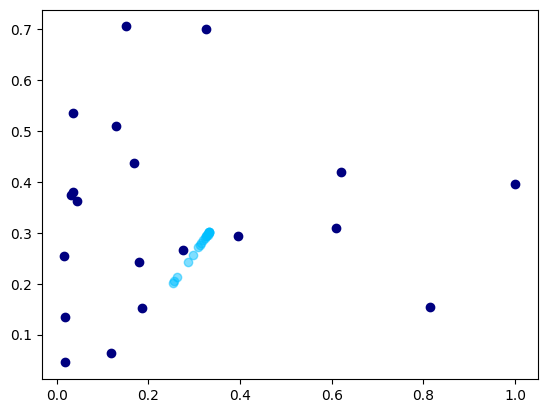

 12%|█████████▊                                                                        | 24/200 [00:04<00:31,  5.62it/s]

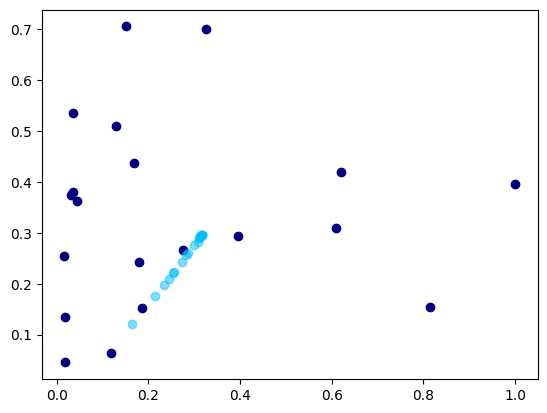

 12%|██████████▎                                                                       | 25/200 [00:04<00:31,  5.57it/s]

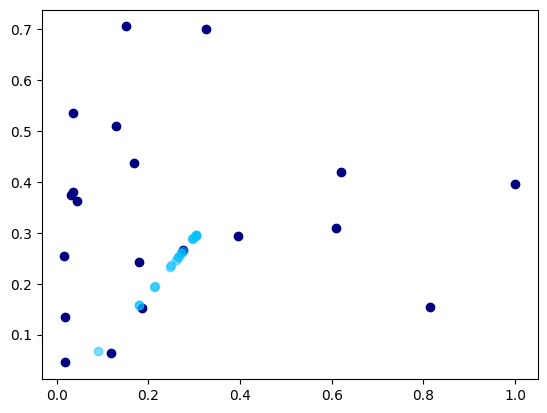

 13%|██████████▋                                                                       | 26/200 [00:04<00:30,  5.65it/s]

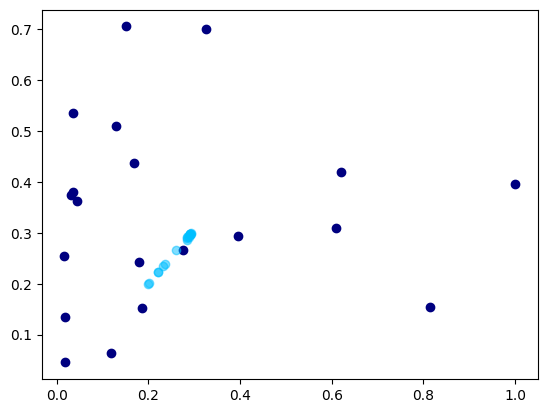

 14%|███████████                                                                       | 27/200 [00:05<00:30,  5.71it/s]

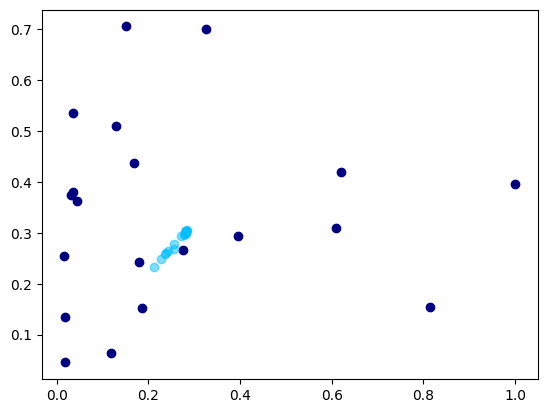

 14%|███████████▍                                                                      | 28/200 [00:05<00:29,  5.76it/s]

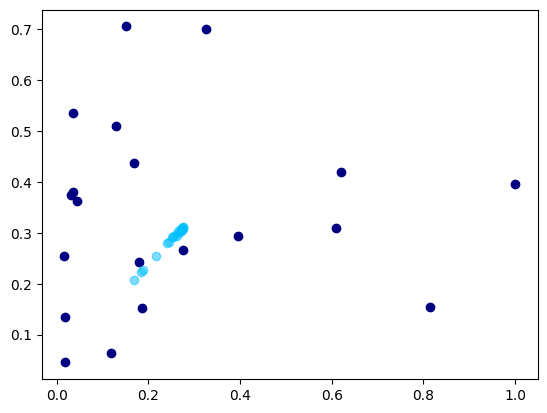

 14%|███████████▉                                                                      | 29/200 [00:05<00:29,  5.72it/s]

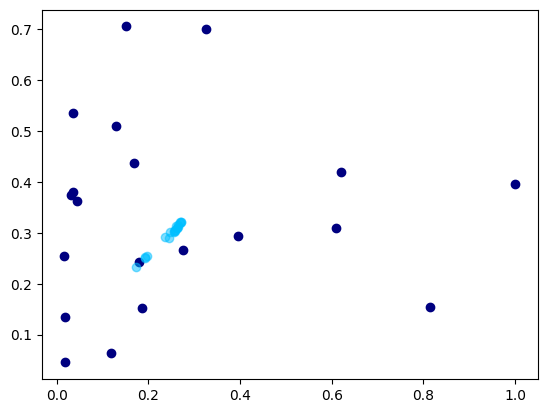

 15%|████████████▎                                                                     | 30/200 [00:05<00:30,  5.52it/s]

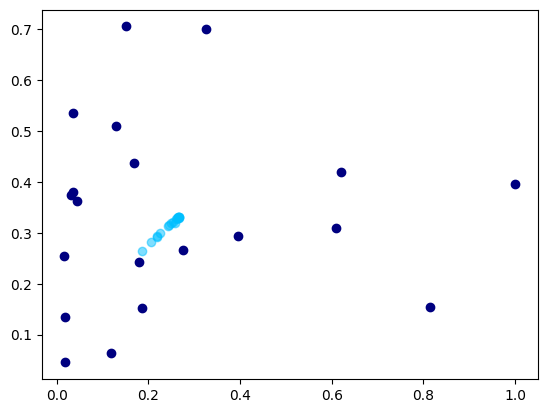

 16%|████████████▋                                                                     | 31/200 [00:05<00:29,  5.65it/s]

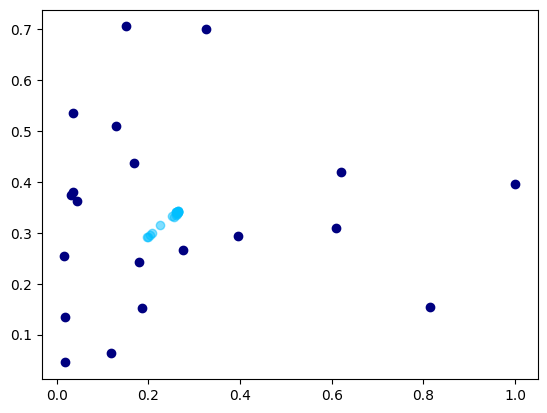

 16%|█████████████                                                                     | 32/200 [00:06<00:30,  5.55it/s]

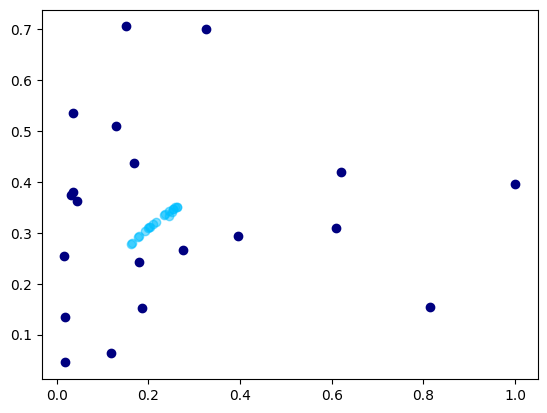

 16%|█████████████▌                                                                    | 33/200 [00:06<00:30,  5.52it/s]

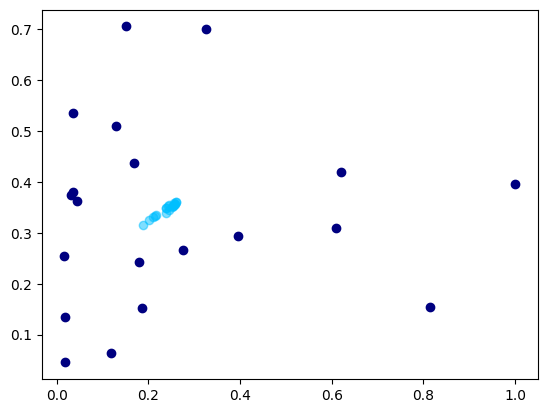

 17%|█████████████▉                                                                    | 34/200 [00:06<00:30,  5.50it/s]

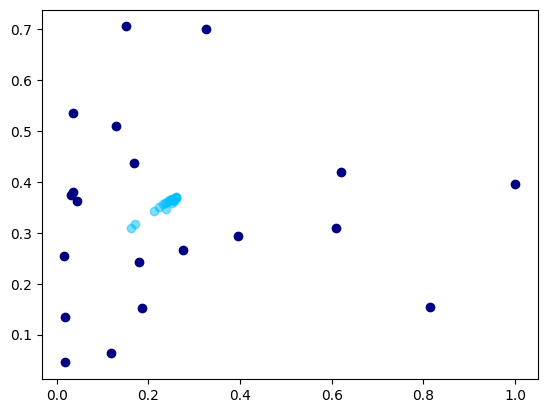

 18%|██████████████▎                                                                   | 35/200 [00:06<00:29,  5.64it/s]

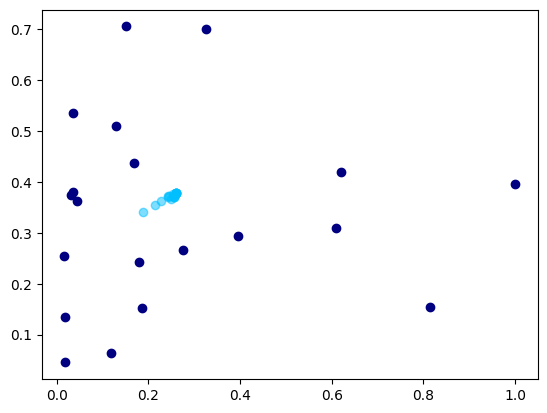

 18%|██████████████▊                                                                   | 36/200 [00:06<00:29,  5.64it/s]

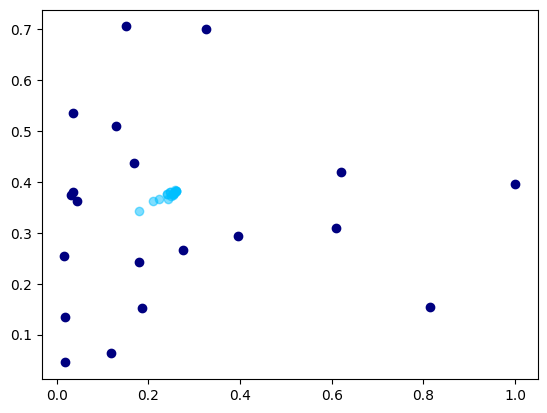

 18%|███████████████▏                                                                  | 37/200 [00:06<00:28,  5.65it/s]

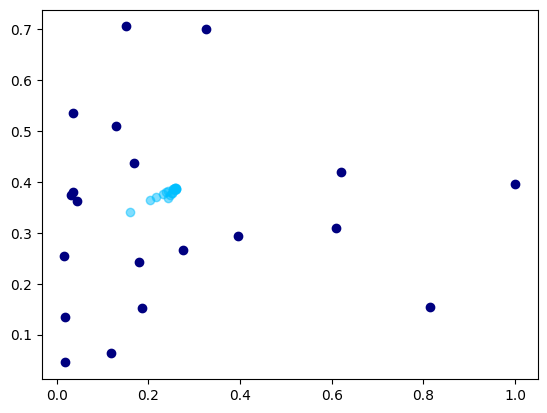

 19%|███████████████▌                                                                  | 38/200 [00:07<00:28,  5.63it/s]

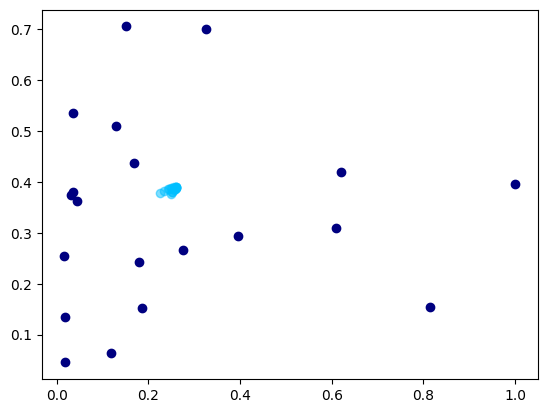

 20%|███████████████▉                                                                  | 39/200 [00:07<00:28,  5.74it/s]

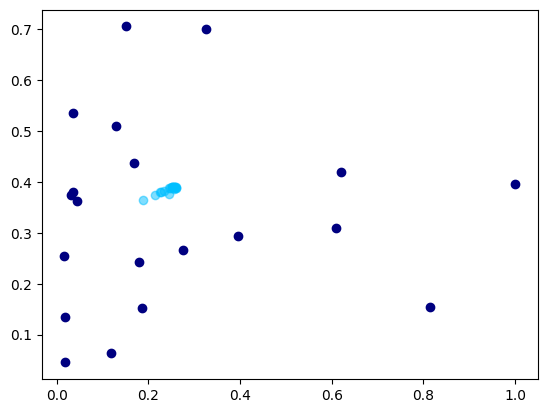

 20%|████████████████▍                                                                 | 40/200 [00:07<00:28,  5.65it/s]

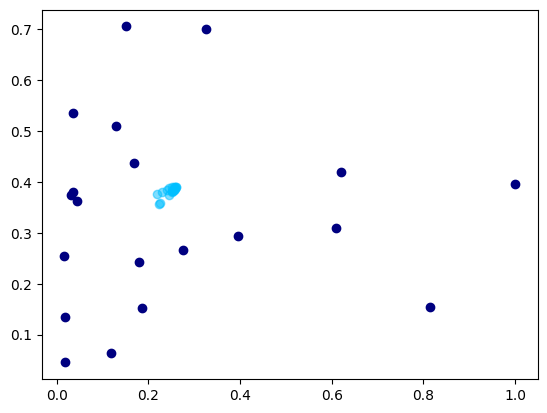

 20%|████████████████▊                                                                 | 41/200 [00:07<00:27,  5.77it/s]

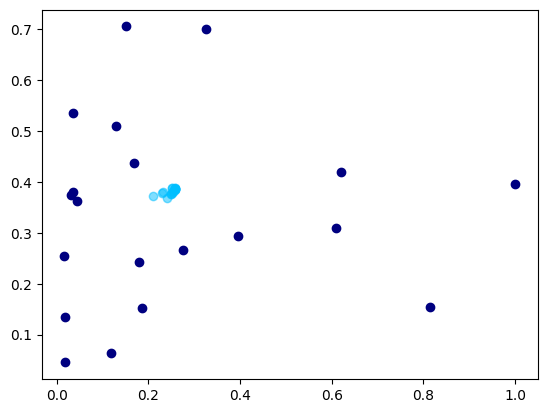

 21%|█████████████████▏                                                                | 42/200 [00:07<00:27,  5.67it/s]

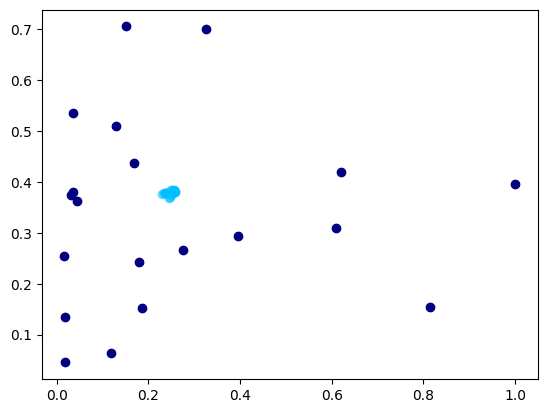

 22%|█████████████████▋                                                                | 43/200 [00:07<00:27,  5.70it/s]

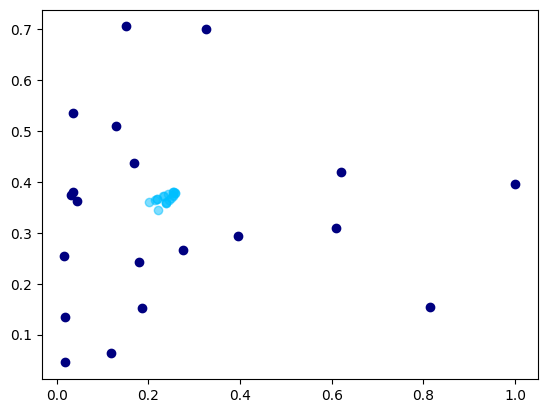

 22%|██████████████████                                                                | 44/200 [00:08<00:27,  5.74it/s]

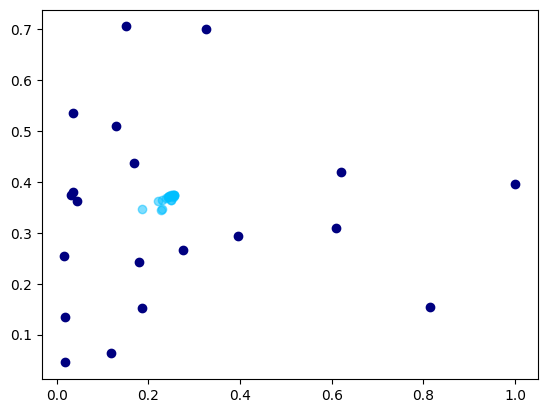

 22%|██████████████████▍                                                               | 45/200 [00:08<00:28,  5.52it/s]

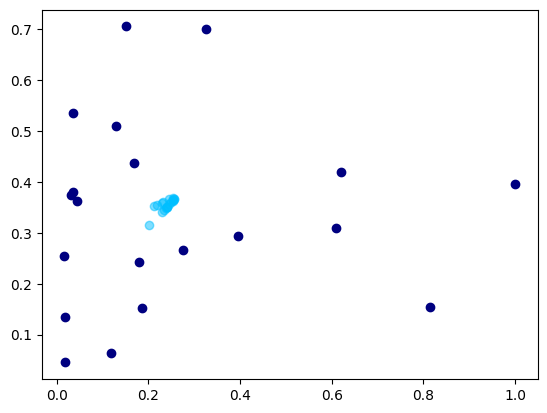

 23%|██████████████████▊                                                               | 46/200 [00:08<00:27,  5.63it/s]

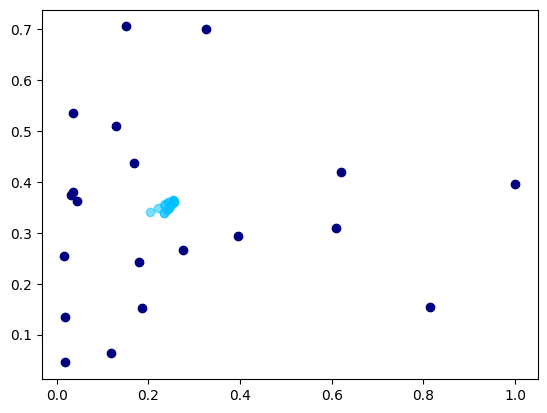

 24%|███████████████████▎                                                              | 47/200 [00:08<00:27,  5.59it/s]

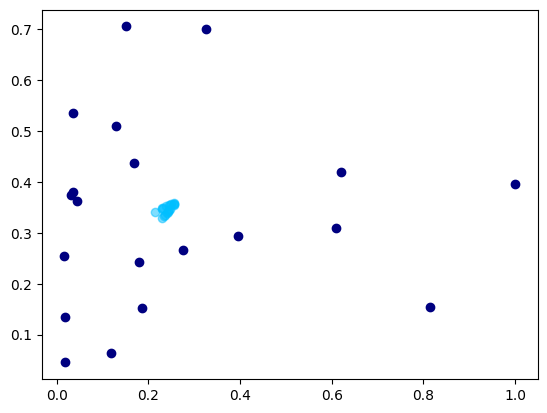

 24%|███████████████████▋                                                              | 48/200 [00:08<00:26,  5.69it/s]

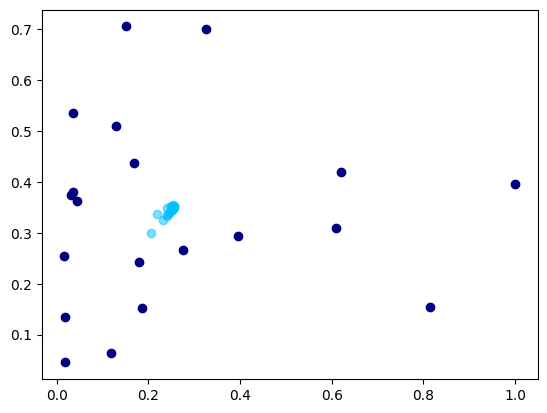

 24%|████████████████████                                                              | 49/200 [00:09<00:27,  5.53it/s]

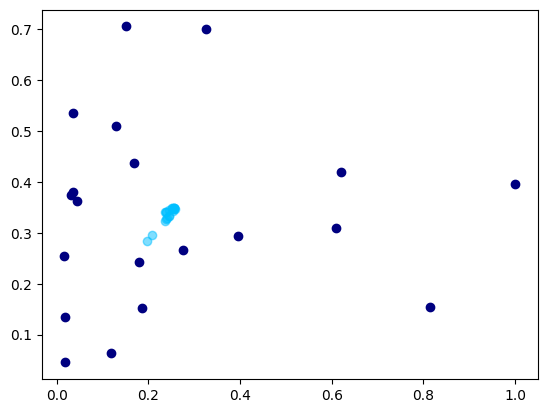

 25%|████████████████████▌                                                             | 50/200 [00:09<00:26,  5.68it/s]

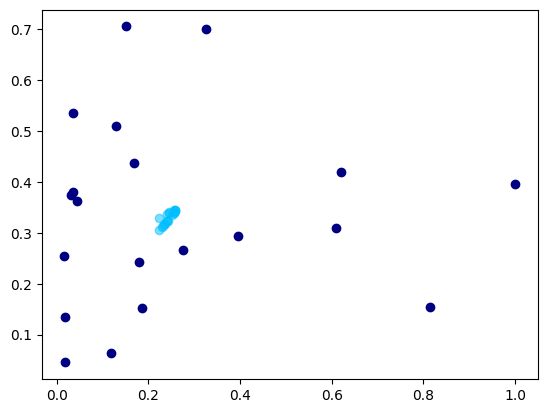

 26%|████████████████████▉                                                             | 51/200 [00:09<00:26,  5.59it/s]

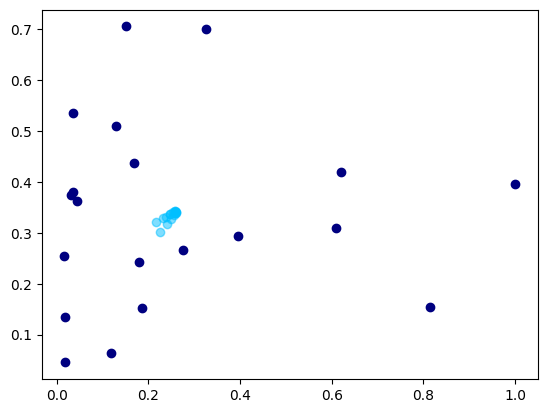

 26%|█████████████████████▎                                                            | 52/200 [00:09<00:25,  5.70it/s]

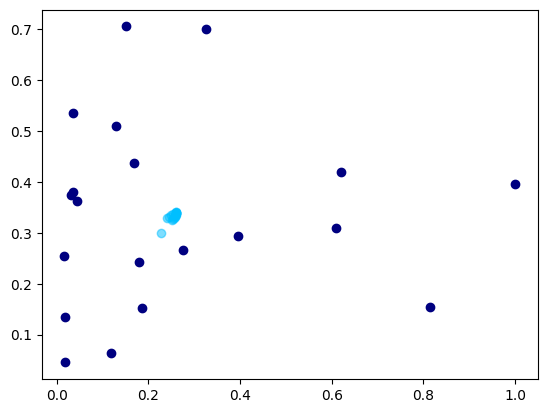

 26%|█████████████████████▋                                                            | 53/200 [00:09<00:25,  5.66it/s]

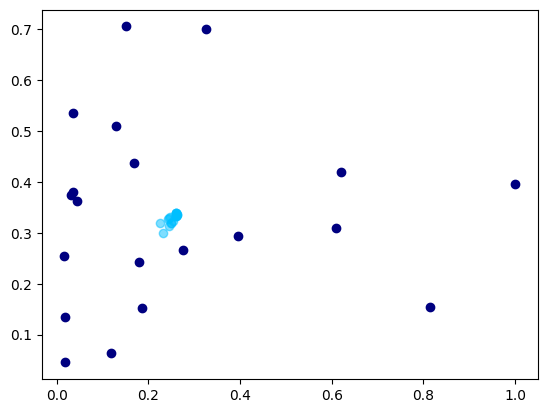

 27%|██████████████████████▏                                                           | 54/200 [00:09<00:25,  5.71it/s]

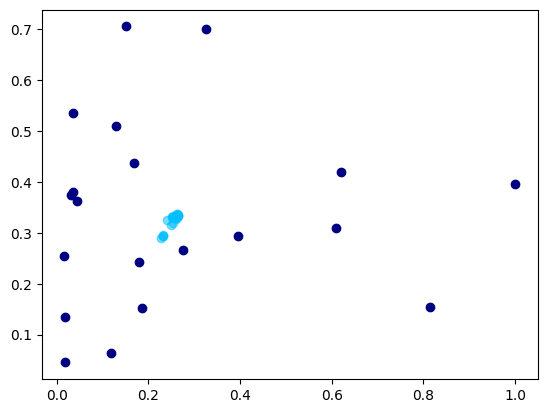

 28%|██████████████████████▌                                                           | 55/200 [00:10<00:25,  5.68it/s]

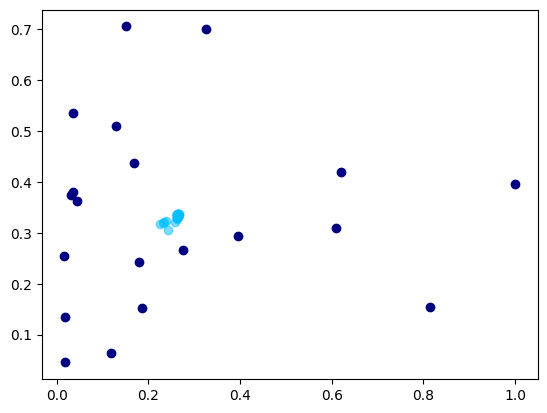

 28%|██████████████████████▉                                                           | 56/200 [00:10<00:25,  5.73it/s]

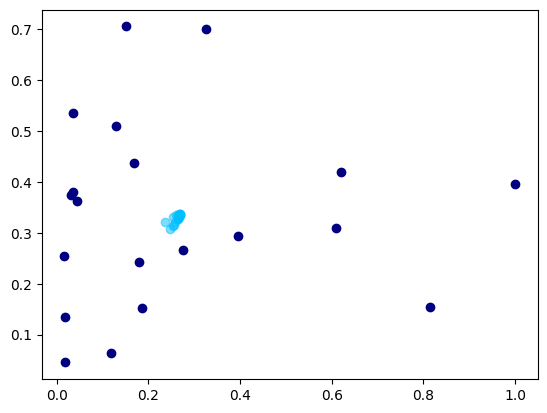

 28%|███████████████████████▎                                                          | 57/200 [00:10<00:24,  5.76it/s]

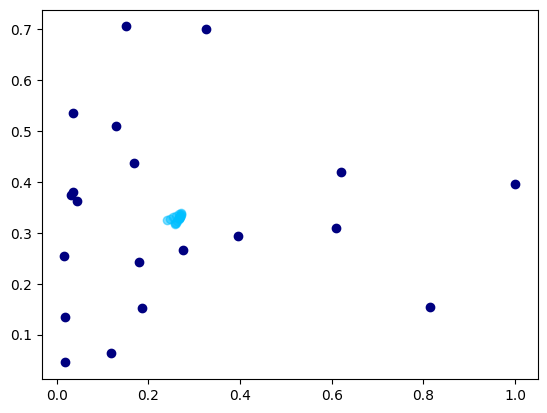

 29%|███████████████████████▊                                                          | 58/200 [00:10<00:25,  5.67it/s]

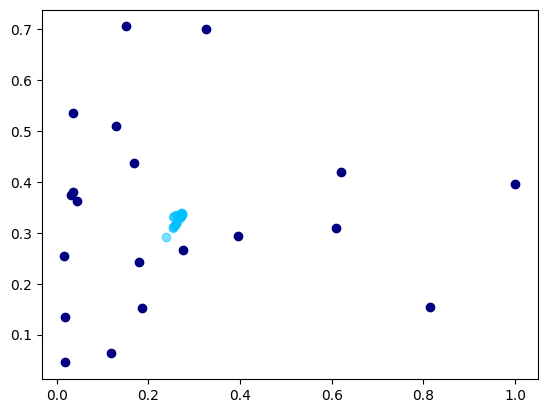

 30%|████████████████████████▏                                                         | 59/200 [00:10<00:24,  5.74it/s]

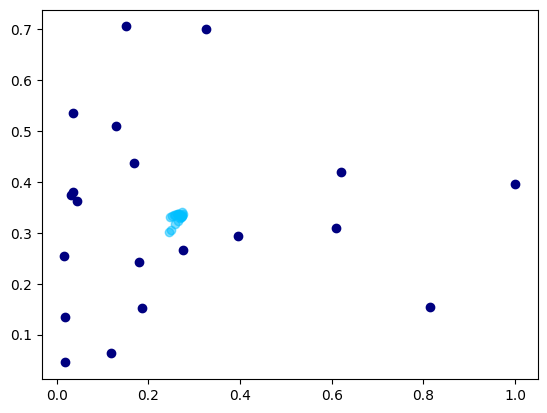

 30%|████████████████████████▌                                                         | 60/200 [00:10<00:23,  5.84it/s]

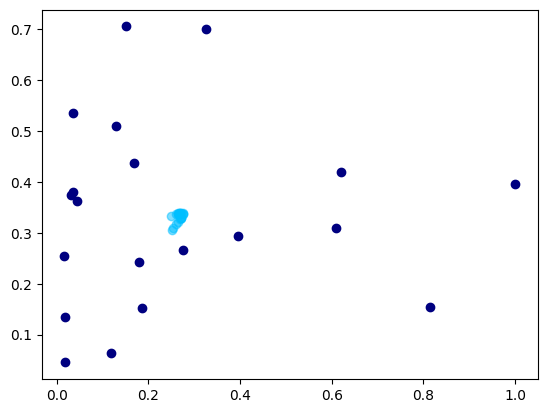

 30%|█████████████████████████                                                         | 61/200 [00:11<00:23,  5.87it/s]

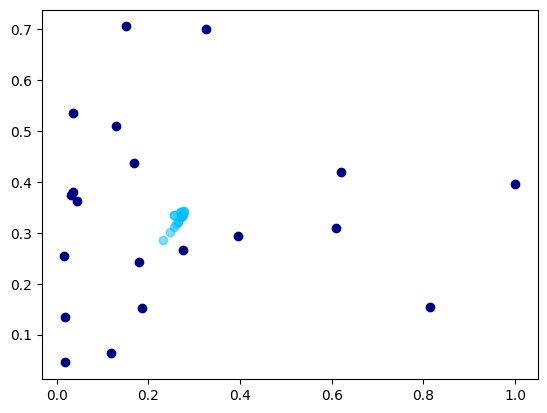

 31%|█████████████████████████▍                                                        | 62/200 [00:11<00:23,  5.88it/s]

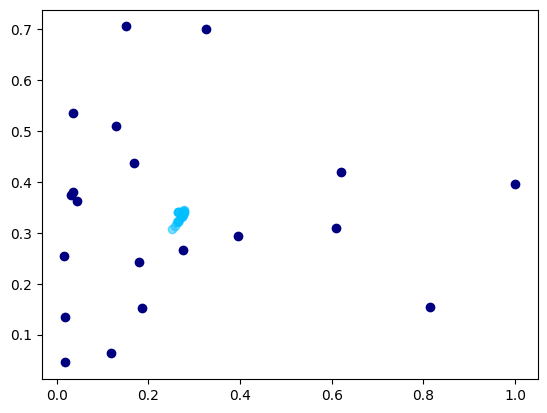

 32%|█████████████████████████▊                                                        | 63/200 [00:11<00:23,  5.86it/s]

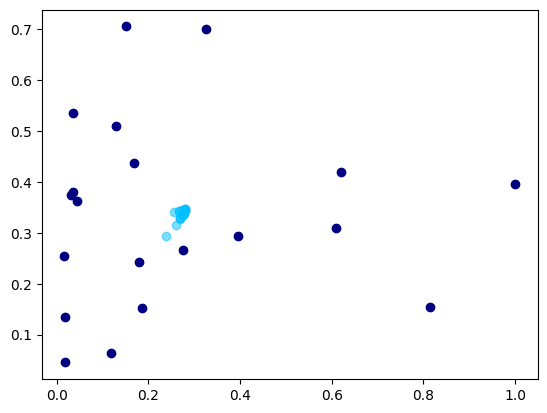

 32%|██████████████████████████▏                                                       | 64/200 [00:11<00:23,  5.76it/s]

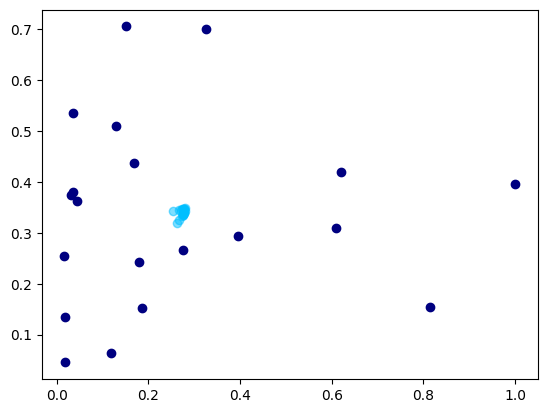

 32%|██████████████████████████▋                                                       | 65/200 [00:11<00:23,  5.83it/s]

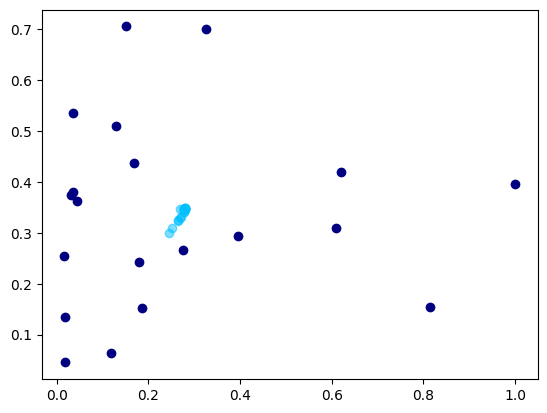

 33%|███████████████████████████                                                       | 66/200 [00:11<00:23,  5.67it/s]

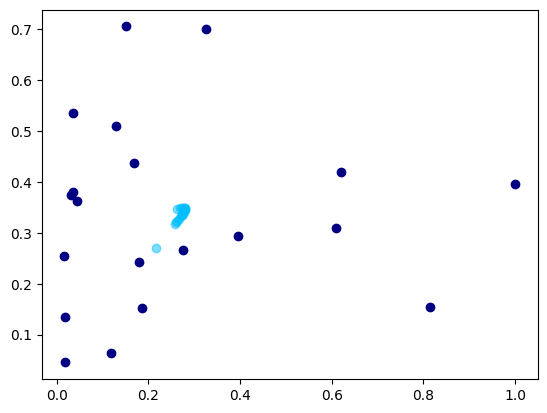

 34%|███████████████████████████▍                                                      | 67/200 [00:12<00:23,  5.72it/s]

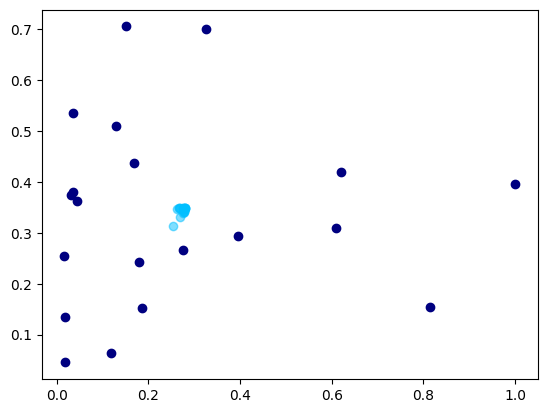

 34%|███████████████████████████▉                                                      | 68/200 [00:12<00:22,  5.78it/s]

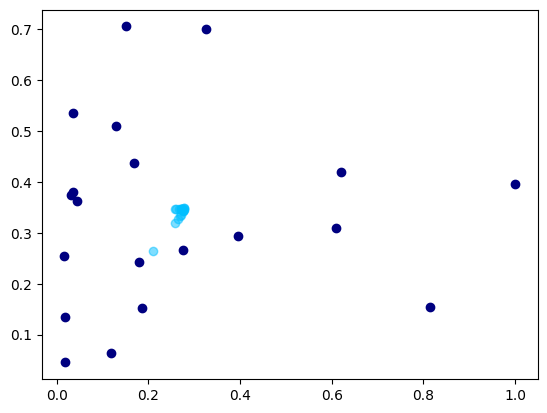

 34%|████████████████████████████▎                                                     | 69/200 [00:12<00:22,  5.78it/s]

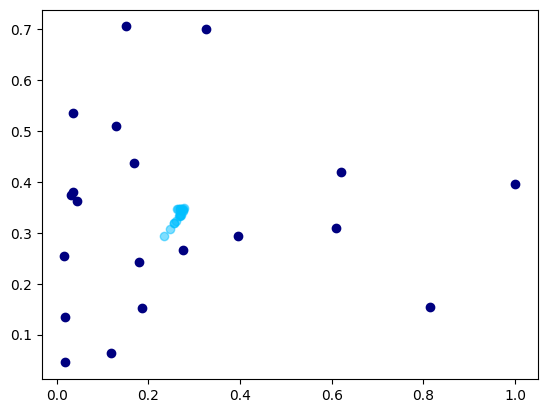

 35%|████████████████████████████▋                                                     | 70/200 [00:12<00:23,  5.65it/s]

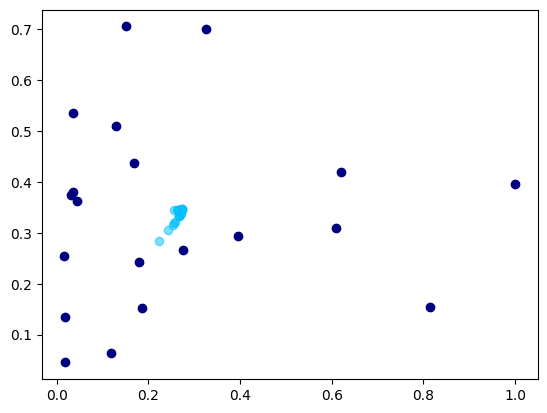

 36%|█████████████████████████████                                                     | 71/200 [00:12<00:22,  5.64it/s]

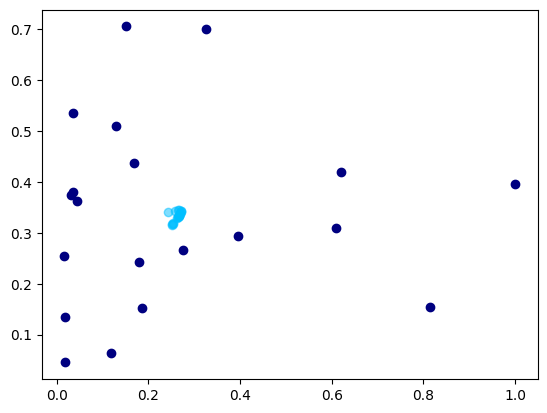

 36%|█████████████████████████████▌                                                    | 72/200 [00:13<00:22,  5.75it/s]

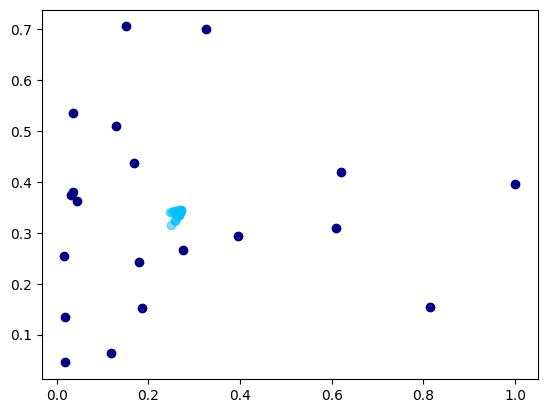

 36%|█████████████████████████████▉                                                    | 73/200 [00:13<00:22,  5.74it/s]

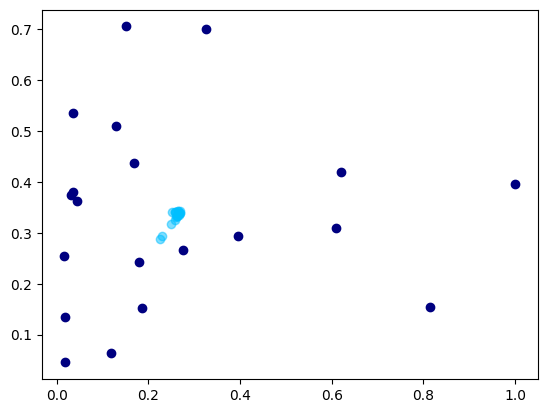

 37%|██████████████████████████████▎                                                   | 74/200 [00:13<00:22,  5.56it/s]

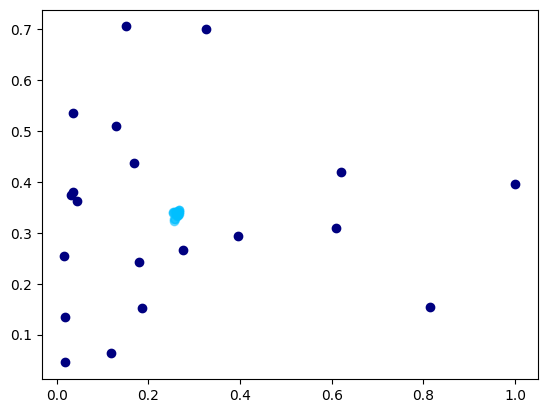

 38%|██████████████████████████████▊                                                   | 75/200 [00:13<00:22,  5.46it/s]

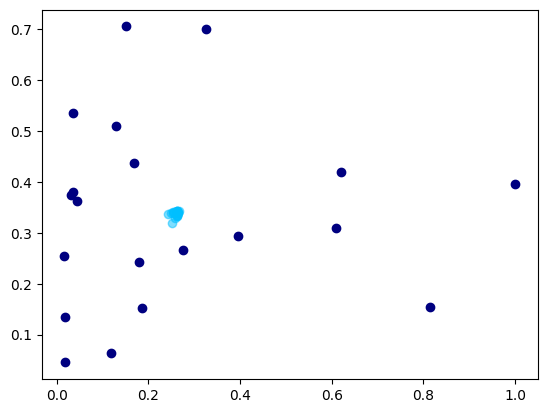

 38%|███████████████████████████████▏                                                  | 76/200 [00:13<00:22,  5.55it/s]

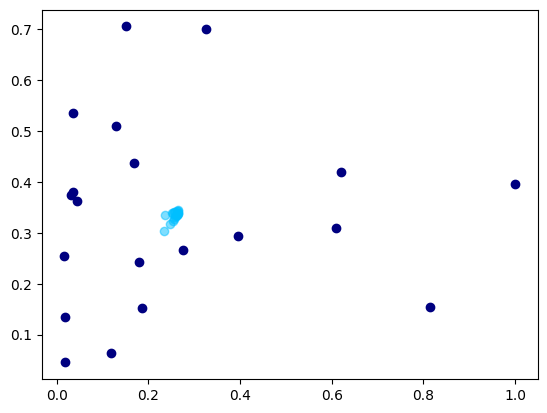

 38%|███████████████████████████████▌                                                  | 77/200 [00:13<00:22,  5.43it/s]

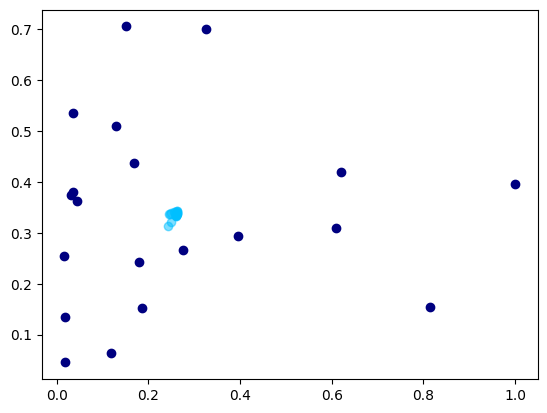

 39%|███████████████████████████████▉                                                  | 78/200 [00:14<00:22,  5.37it/s]

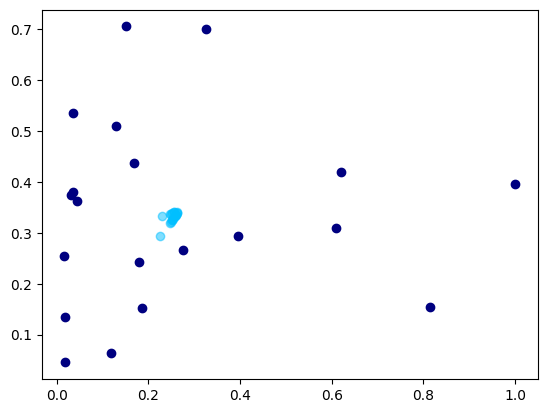

 40%|████████████████████████████████▍                                                 | 79/200 [00:14<00:21,  5.55it/s]

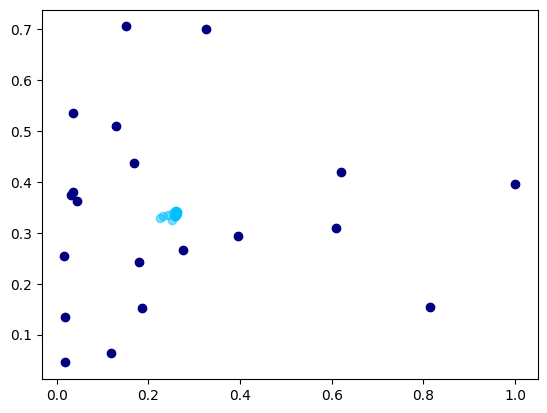

 40%|████████████████████████████████▊                                                 | 80/200 [00:14<00:21,  5.61it/s]

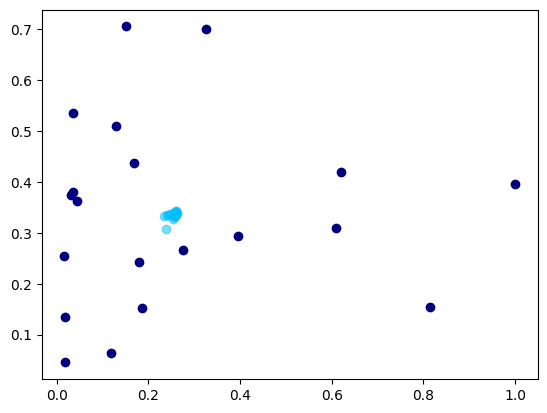

 40%|█████████████████████████████████▏                                                | 81/200 [00:14<00:21,  5.60it/s]

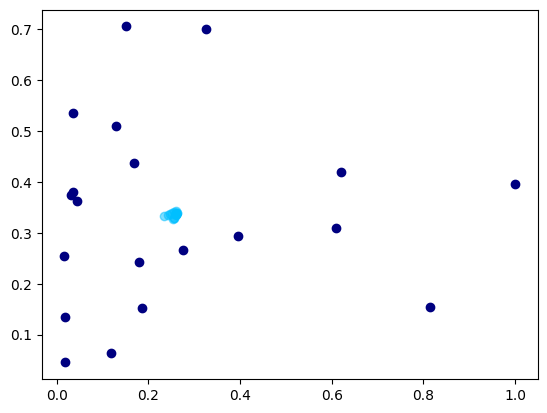

 41%|█████████████████████████████████▌                                                | 82/200 [00:14<00:20,  5.64it/s]

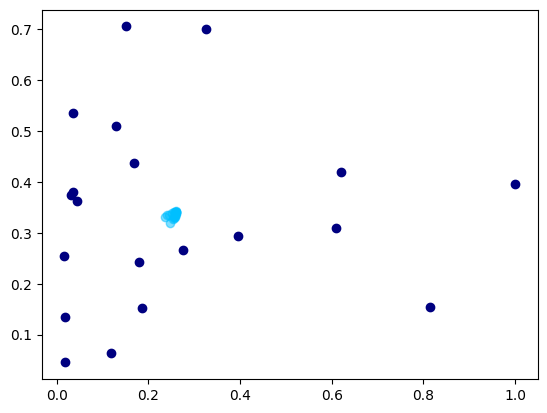

 42%|██████████████████████████████████                                                | 83/200 [00:15<00:20,  5.68it/s]

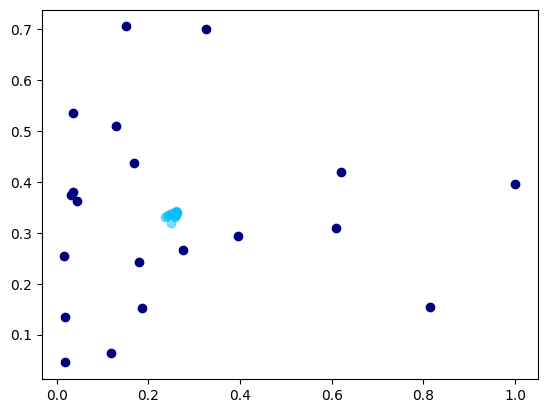

 42%|██████████████████████████████████▍                                               | 84/200 [00:15<00:20,  5.75it/s]

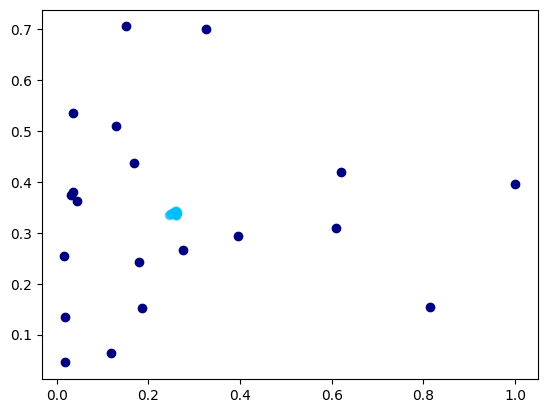

 42%|██████████████████████████████████▊                                               | 85/200 [00:15<00:19,  5.80it/s]

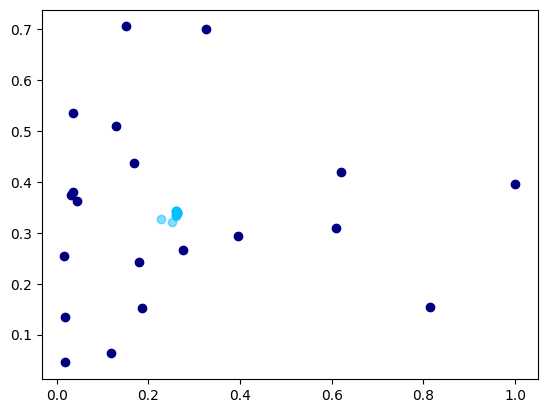

 43%|███████████████████████████████████▎                                              | 86/200 [00:15<00:20,  5.58it/s]

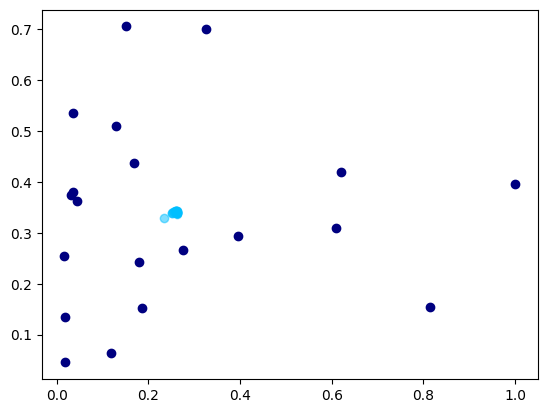

 44%|███████████████████████████████████▋                                              | 87/200 [00:15<00:21,  5.20it/s]

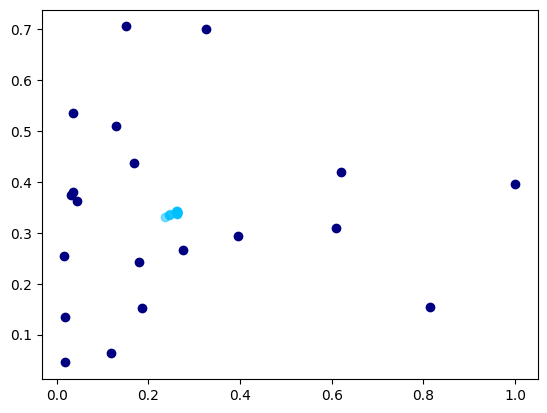

 44%|████████████████████████████████████                                              | 88/200 [00:15<00:21,  5.17it/s]

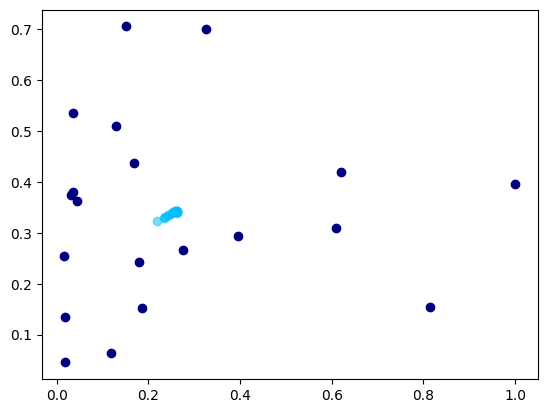

 44%|████████████████████████████████████▍                                             | 89/200 [00:16<00:20,  5.31it/s]

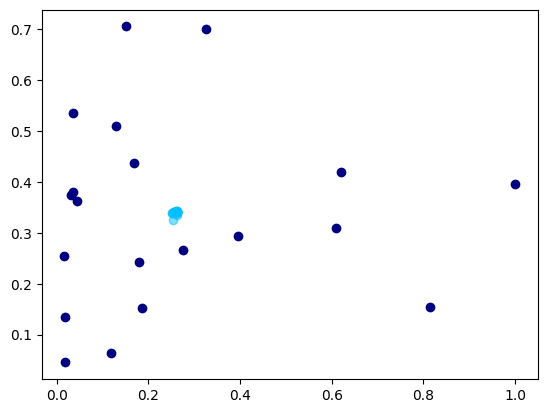

 45%|████████████████████████████████████▉                                             | 90/200 [00:16<00:20,  5.39it/s]

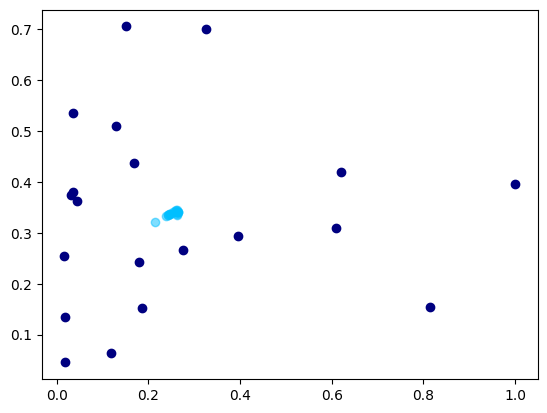

 46%|█████████████████████████████████████▎                                            | 91/200 [00:16<00:20,  5.42it/s]

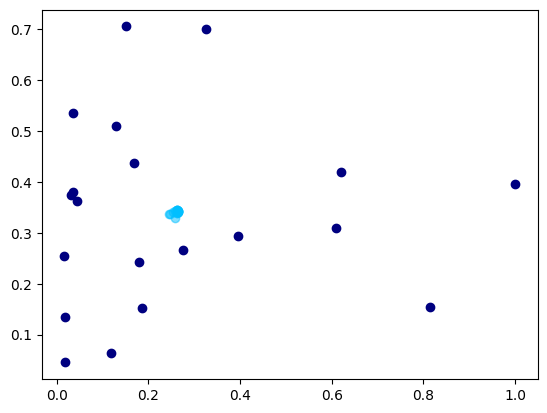

 46%|█████████████████████████████████████▋                                            | 92/200 [00:16<00:19,  5.47it/s]

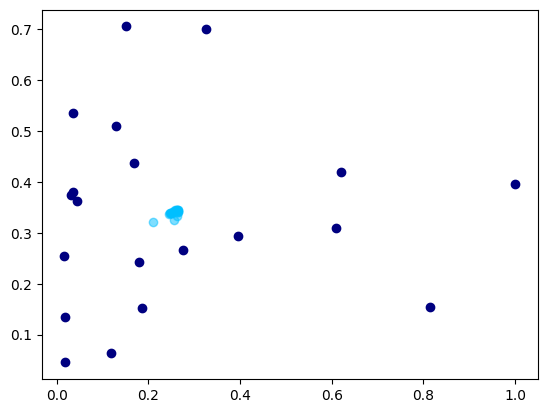

 46%|██████████████████████████████████████▏                                           | 93/200 [00:16<00:19,  5.60it/s]

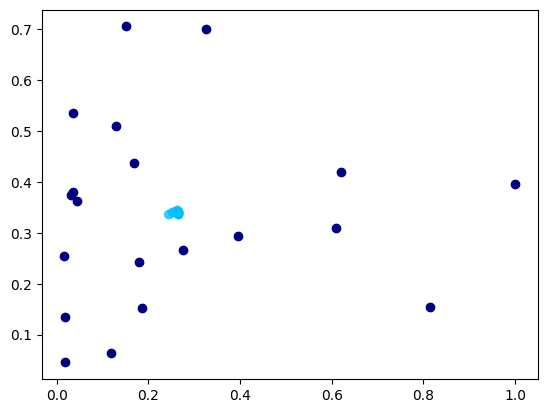

 47%|██████████████████████████████████████▌                                           | 94/200 [00:17<00:18,  5.62it/s]

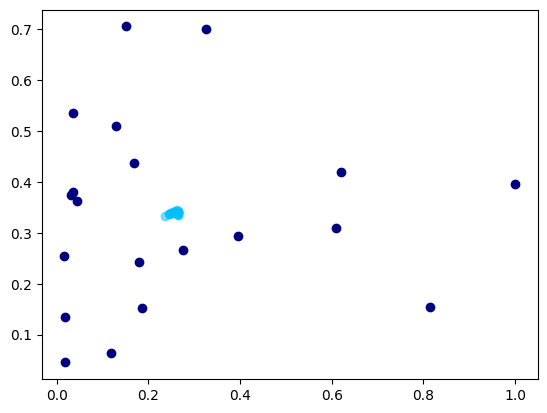

 48%|██████████████████████████████████████▉                                           | 95/200 [00:17<00:18,  5.67it/s]

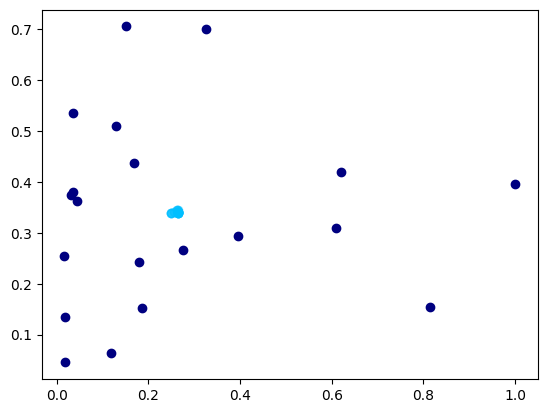

 48%|███████████████████████████████████████▎                                          | 96/200 [00:17<00:18,  5.55it/s]

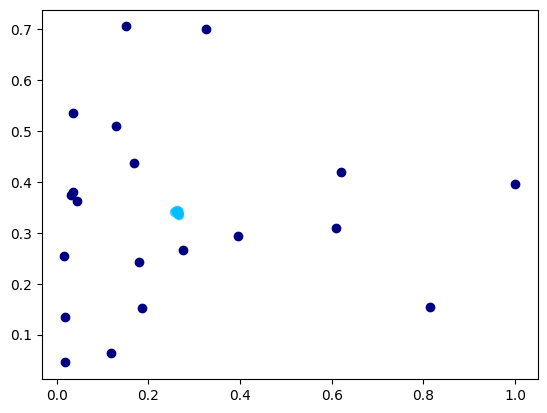

 48%|███████████████████████████████████████▊                                          | 97/200 [00:17<00:18,  5.51it/s]

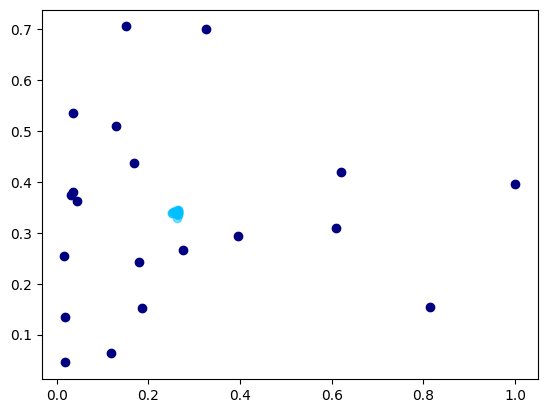

 49%|████████████████████████████████████████▏                                         | 98/200 [00:17<00:18,  5.55it/s]

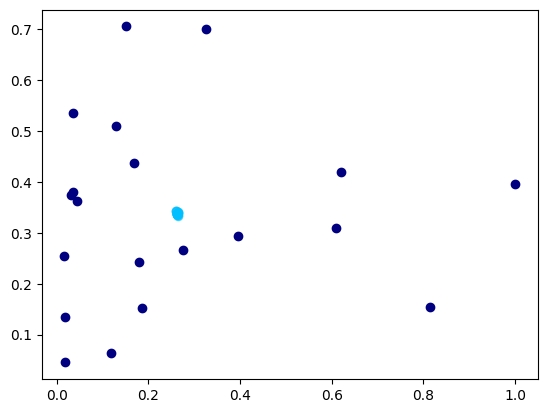

 50%|████████████████████████████████████████▌                                         | 99/200 [00:17<00:18,  5.59it/s]

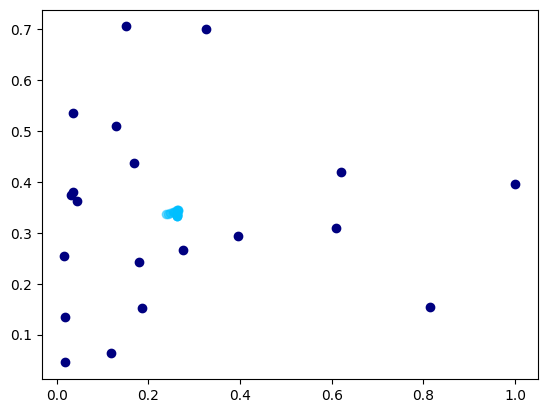

 50%|████████████████████████████████████████▌                                        | 100/200 [00:18<00:18,  5.55it/s]

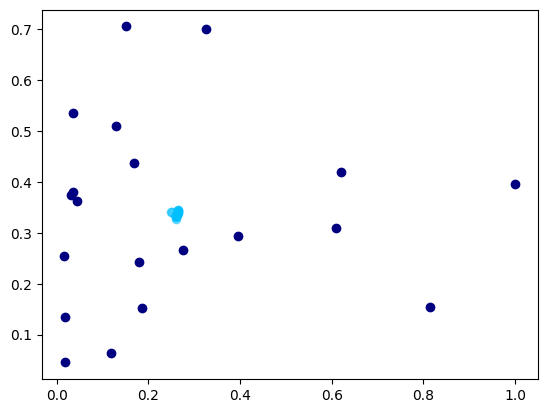

 50%|████████████████████████████████████████▉                                        | 101/200 [00:18<00:17,  5.52it/s]

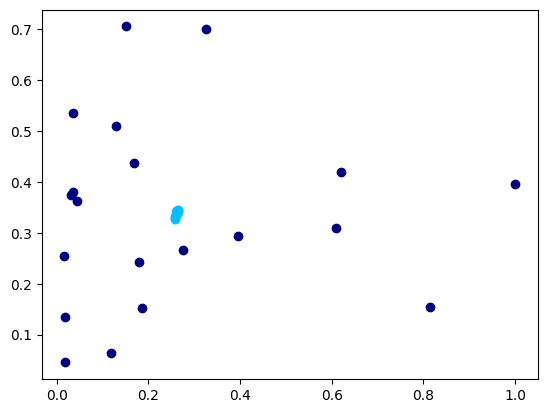

 51%|█████████████████████████████████████████▎                                       | 102/200 [00:18<00:17,  5.51it/s]

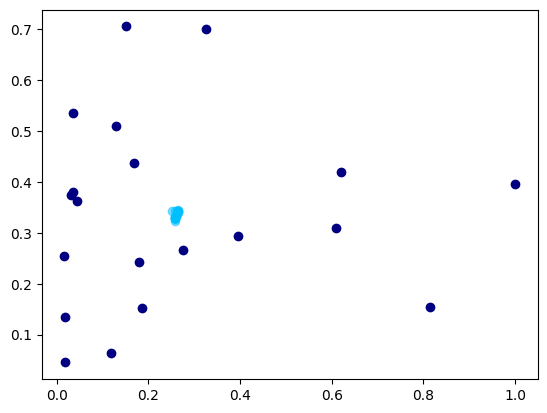

 52%|█████████████████████████████████████████▋                                       | 103/200 [00:18<00:19,  5.01it/s]

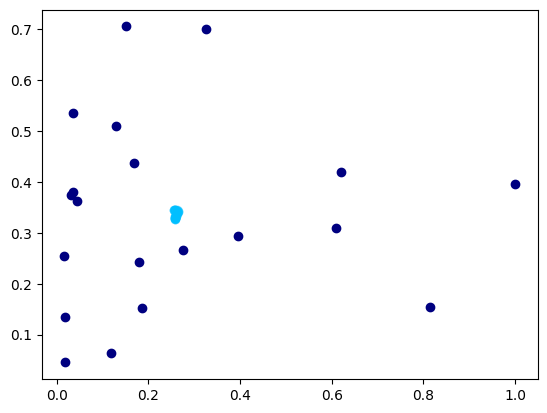

 52%|██████████████████████████████████████████                                       | 104/200 [00:18<00:18,  5.13it/s]

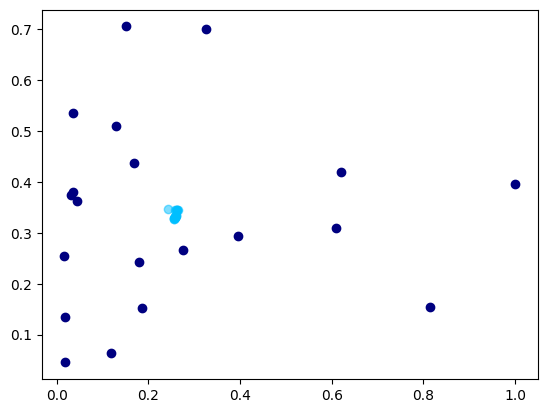

 52%|██████████████████████████████████████████▌                                      | 105/200 [00:19<00:18,  5.15it/s]

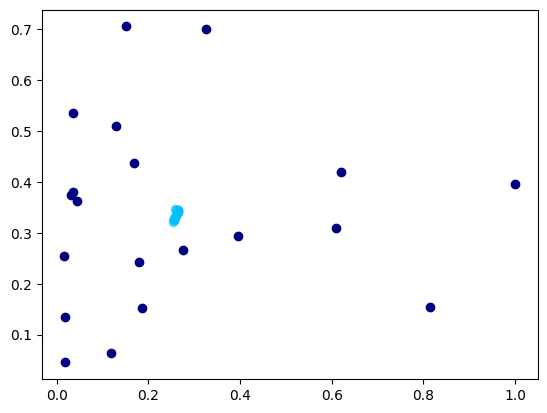

 53%|██████████████████████████████████████████▉                                      | 106/200 [00:19<00:17,  5.25it/s]

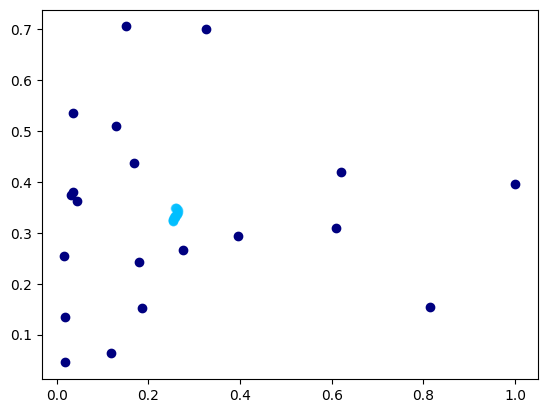

 54%|███████████████████████████████████████████▎                                     | 107/200 [00:19<00:18,  5.13it/s]

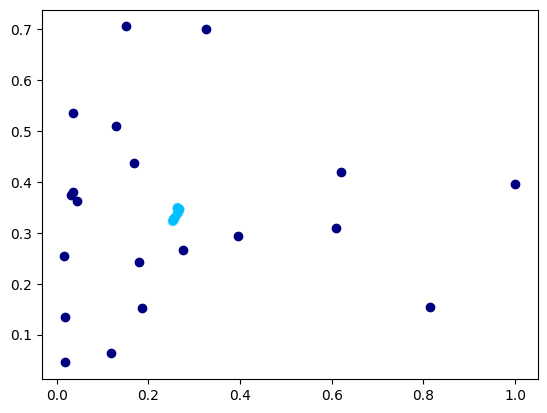

 54%|███████████████████████████████████████████▋                                     | 108/200 [00:19<00:17,  5.28it/s]

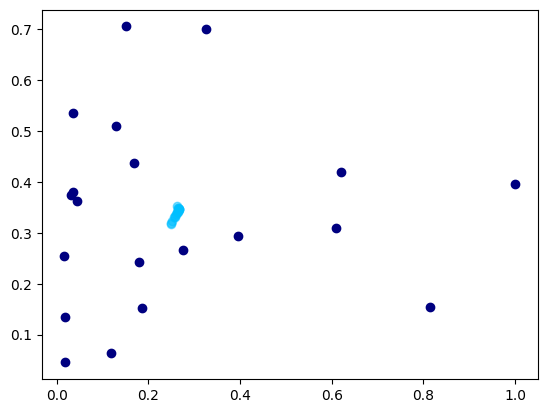

 55%|████████████████████████████████████████████▏                                    | 109/200 [00:19<00:16,  5.41it/s]

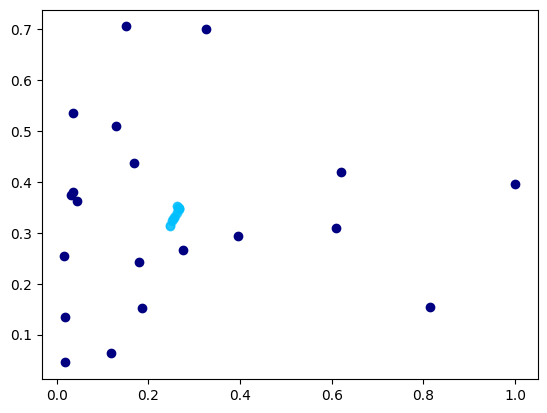

 55%|████████████████████████████████████████████▌                                    | 110/200 [00:20<00:16,  5.48it/s]

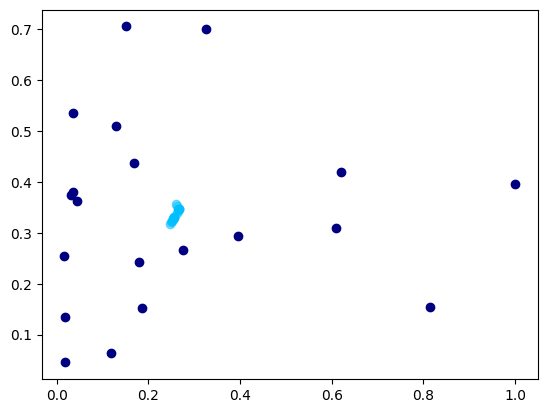

 56%|████████████████████████████████████████████▉                                    | 111/200 [00:20<00:16,  5.54it/s]

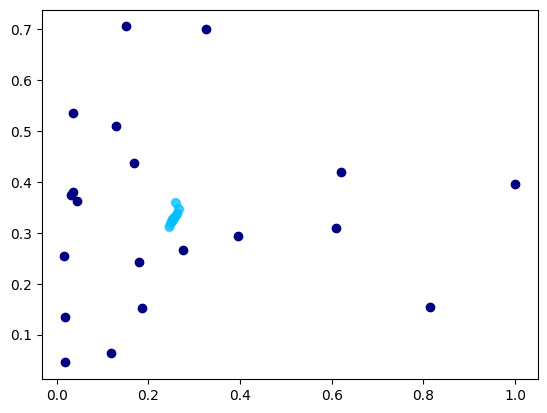

 56%|█████████████████████████████████████████████▎                                   | 112/200 [00:20<00:16,  5.46it/s]

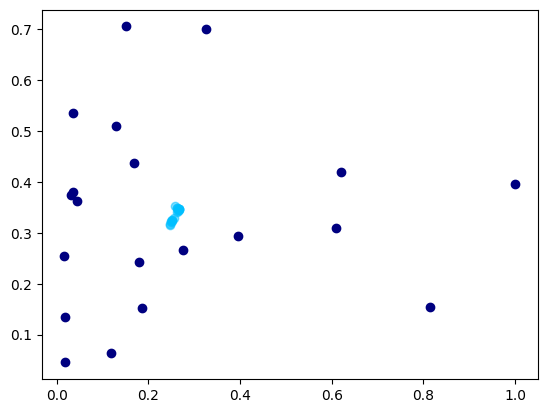

 56%|█████████████████████████████████████████████▊                                   | 113/200 [00:20<00:16,  5.30it/s]

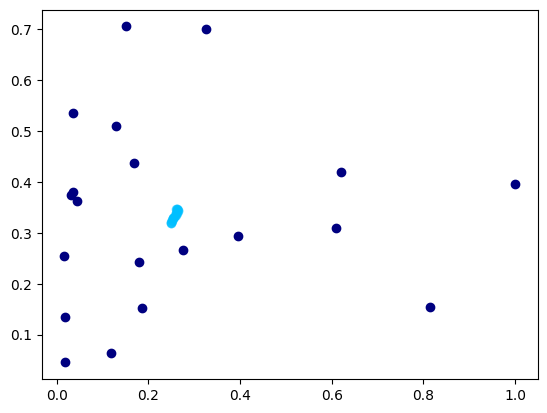

 57%|██████████████████████████████████████████████▏                                  | 114/200 [00:20<00:15,  5.41it/s]

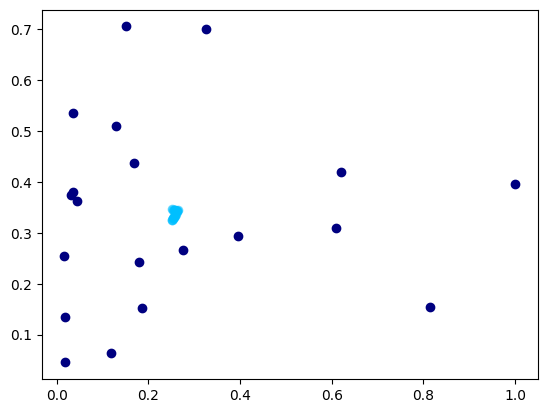

 57%|██████████████████████████████████████████████▌                                  | 115/200 [00:20<00:16,  5.31it/s]

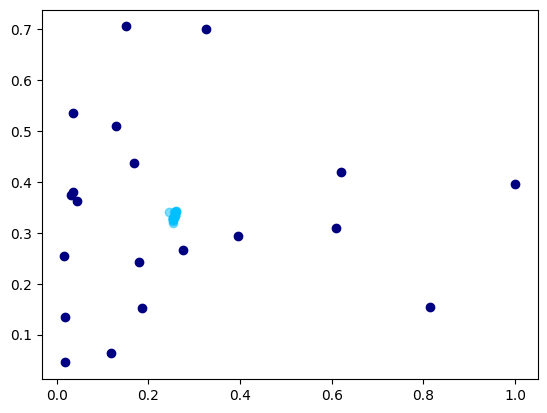

 58%|██████████████████████████████████████████████▉                                  | 116/200 [00:21<00:15,  5.41it/s]

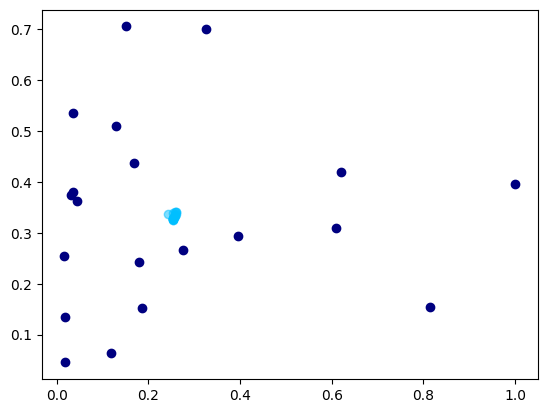

 58%|███████████████████████████████████████████████▍                                 | 117/200 [00:21<00:15,  5.48it/s]

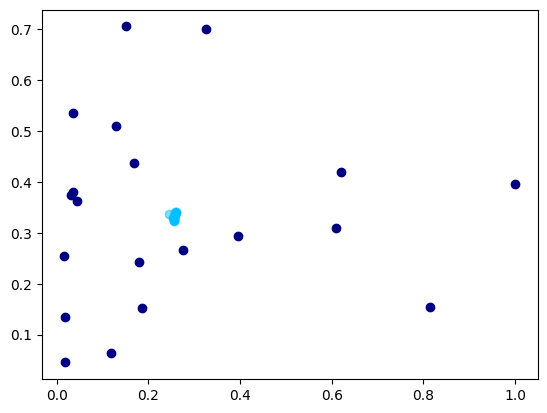

 59%|███████████████████████████████████████████████▊                                 | 118/200 [00:21<00:14,  5.59it/s]

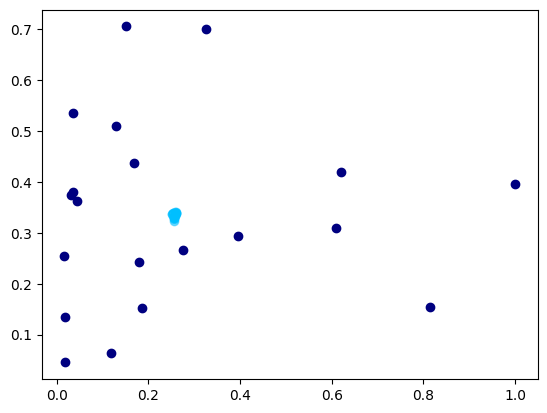

 60%|████████████████████████████████████████████████▏                                | 119/200 [00:21<00:14,  5.68it/s]

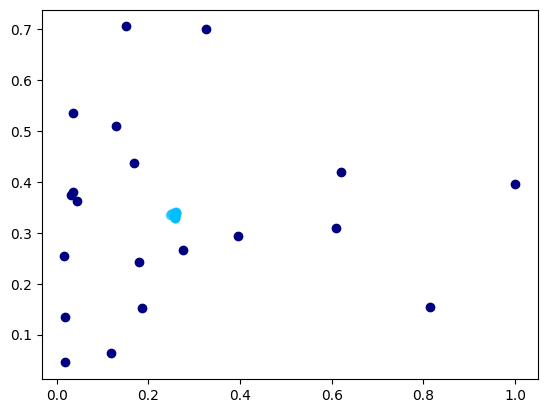

 60%|████████████████████████████████████████████████▌                                | 120/200 [00:21<00:14,  5.71it/s]

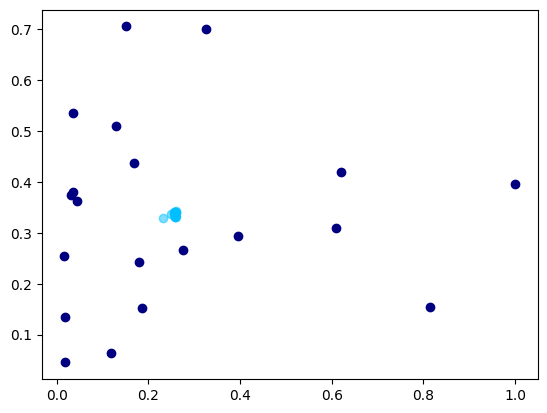

 60%|█████████████████████████████████████████████████                                | 121/200 [00:22<00:14,  5.64it/s]

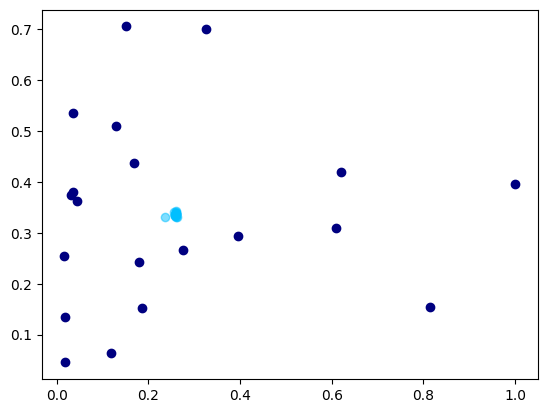

 61%|█████████████████████████████████████████████████▍                               | 122/200 [00:22<00:13,  5.68it/s]

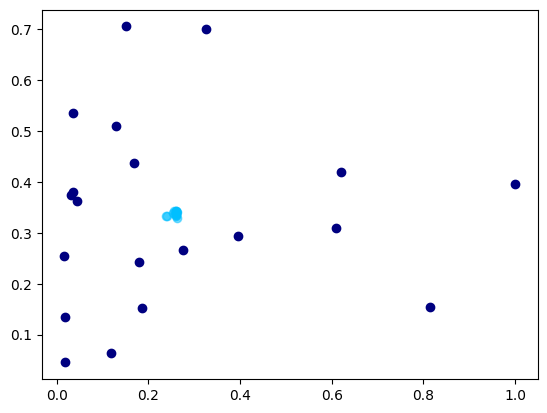

 62%|█████████████████████████████████████████████████▊                               | 123/200 [00:22<00:13,  5.61it/s]

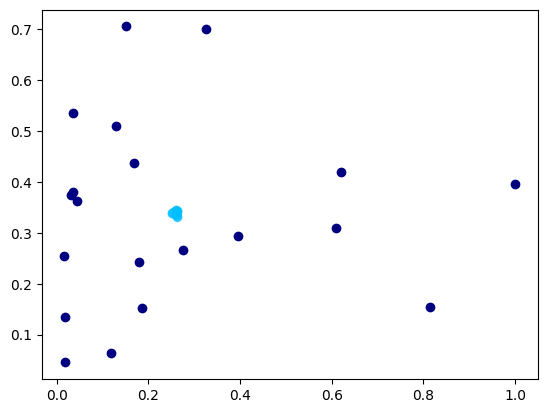

 62%|██████████████████████████████████████████████████▏                              | 124/200 [00:22<00:13,  5.49it/s]

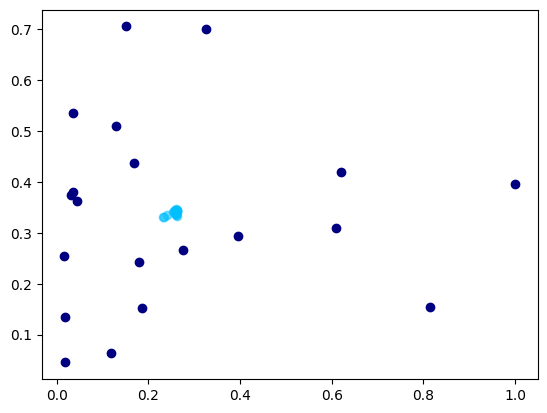

 62%|██████████████████████████████████████████████████▋                              | 125/200 [00:22<00:13,  5.42it/s]

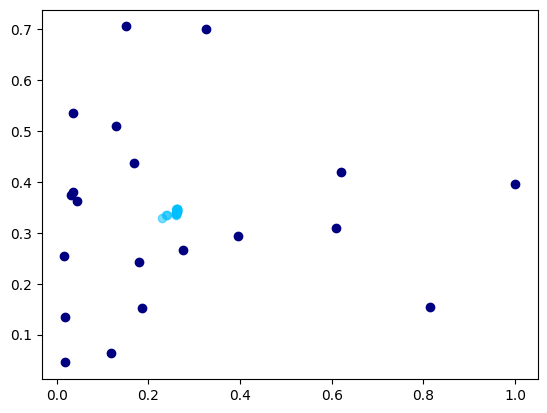

 63%|███████████████████████████████████████████████████                              | 126/200 [00:23<00:25,  2.87it/s]

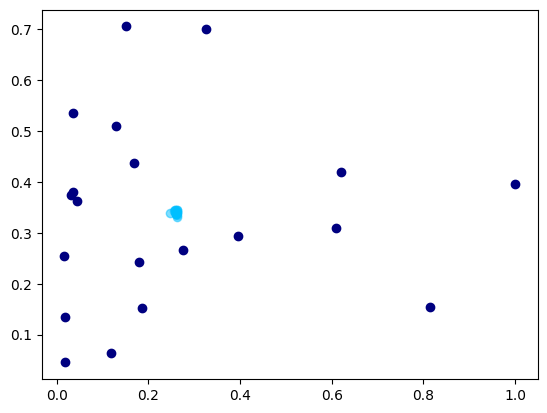

 64%|███████████████████████████████████████████████████▍                             | 127/200 [00:23<00:21,  3.38it/s]

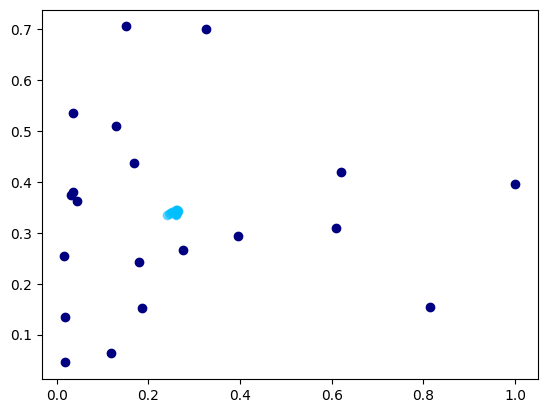

 64%|███████████████████████████████████████████████████▊                             | 128/200 [00:23<00:19,  3.76it/s]

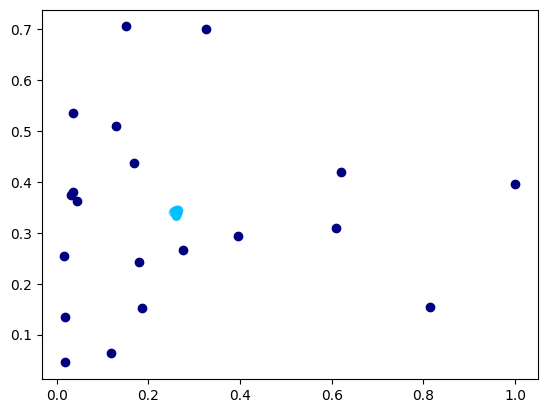

 64%|████████████████████████████████████████████████████▏                            | 129/200 [00:24<00:16,  4.20it/s]

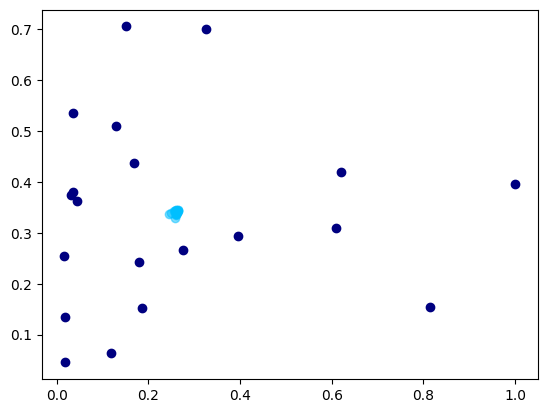

 65%|████████████████████████████████████████████████████▋                            | 130/200 [00:24<00:16,  4.32it/s]

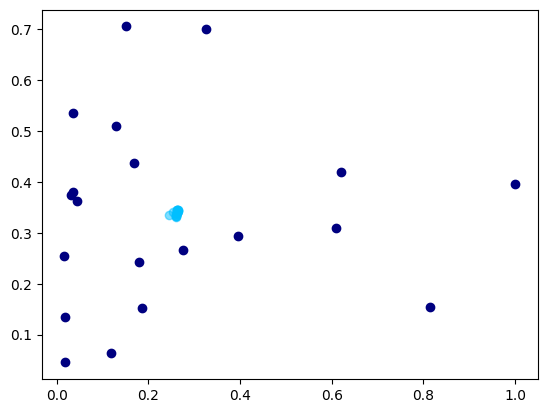

 66%|█████████████████████████████████████████████████████                            | 131/200 [00:24<00:14,  4.71it/s]

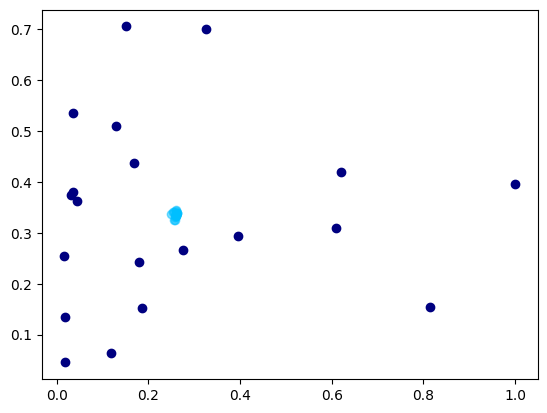

 66%|█████████████████████████████████████████████████████▍                           | 132/200 [00:24<00:13,  4.97it/s]

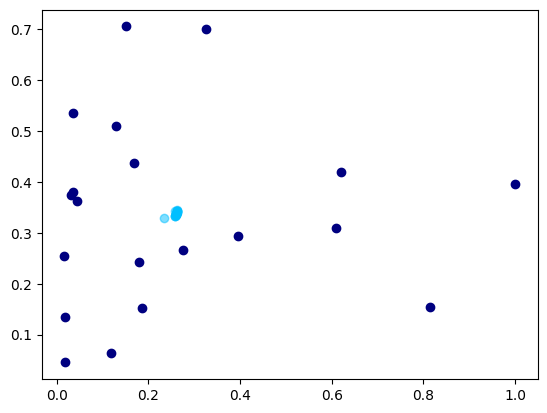

 66%|█████████████████████████████████████████████████████▊                           | 133/200 [00:24<00:12,  5.24it/s]

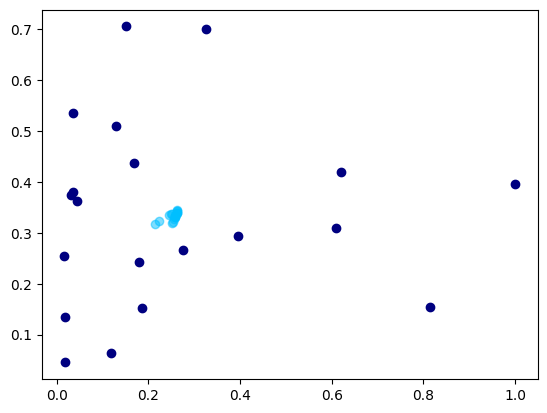

 67%|██████████████████████████████████████████████████████▎                          | 134/200 [00:24<00:12,  5.33it/s]

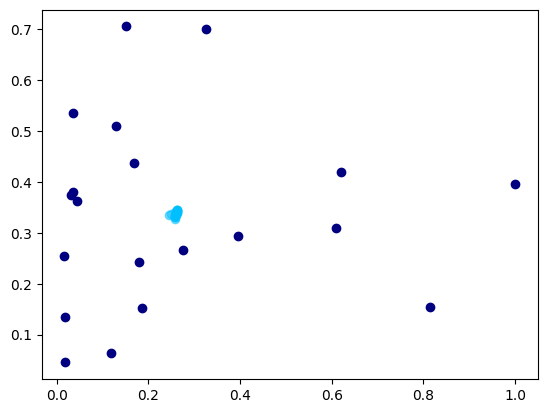

 68%|██████████████████████████████████████████████████████▋                          | 135/200 [00:25<00:11,  5.50it/s]

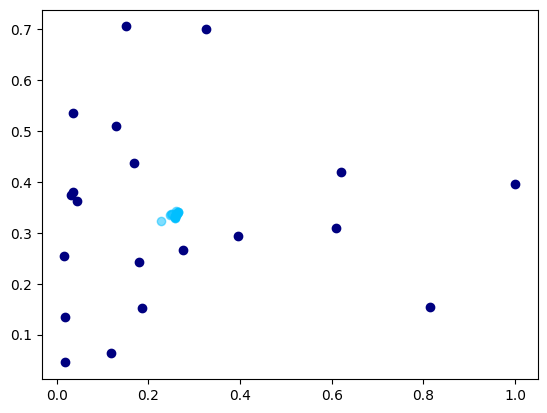

 68%|███████████████████████████████████████████████████████                          | 136/200 [00:25<00:11,  5.53it/s]

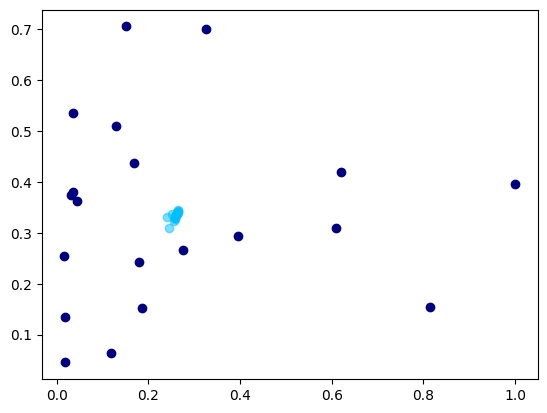

 68%|███████████████████████████████████████████████████████▍                         | 137/200 [00:25<00:11,  5.51it/s]

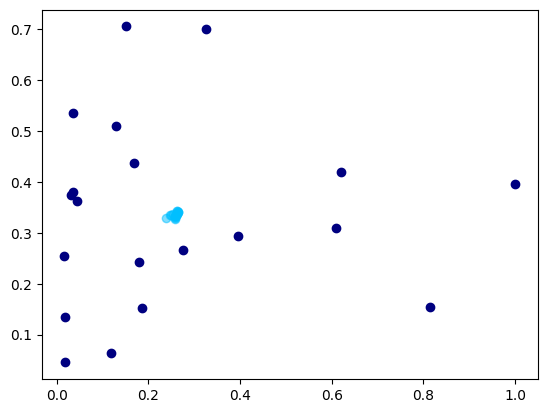

 69%|███████████████████████████████████████████████████████▉                         | 138/200 [00:25<00:11,  5.55it/s]

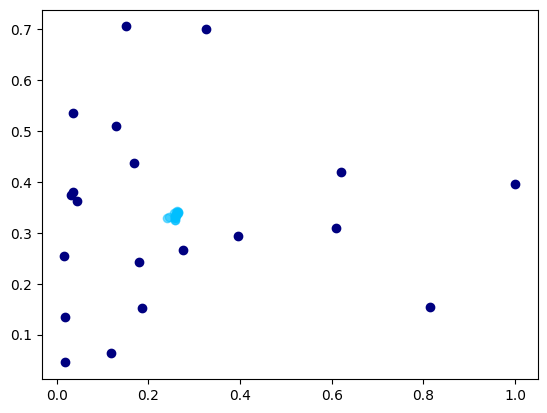

 70%|████████████████████████████████████████████████████████▎                        | 139/200 [00:25<00:10,  5.56it/s]

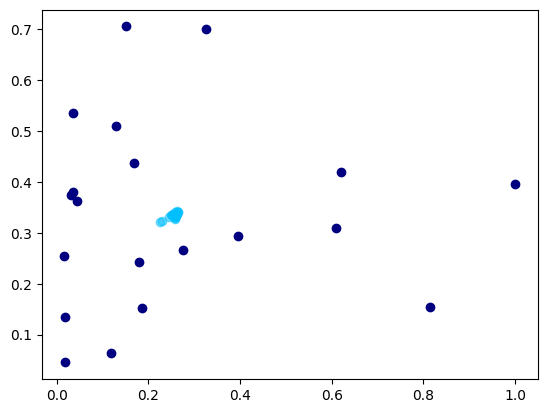

 70%|████████████████████████████████████████████████████████▋                        | 140/200 [00:25<00:10,  5.60it/s]

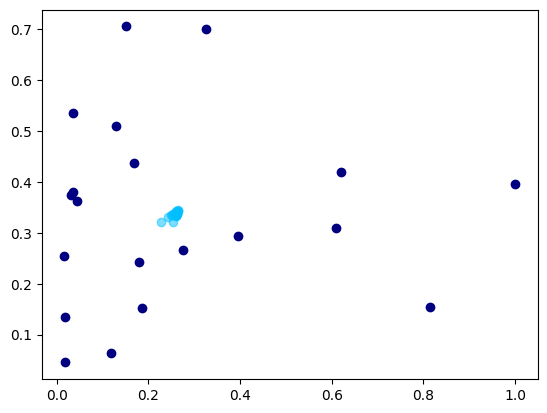

 70%|█████████████████████████████████████████████████████████                        | 141/200 [00:26<00:10,  5.69it/s]

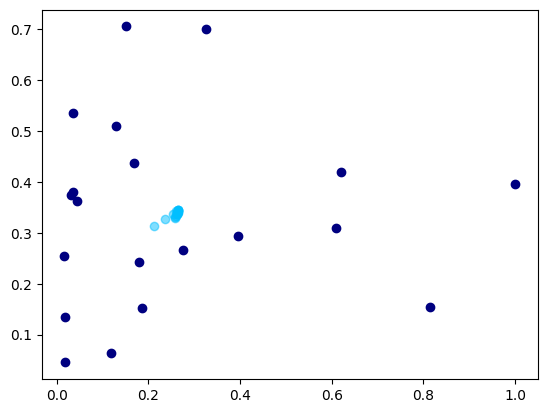

 71%|█████████████████████████████████████████████████████████▌                       | 142/200 [00:26<00:10,  5.56it/s]

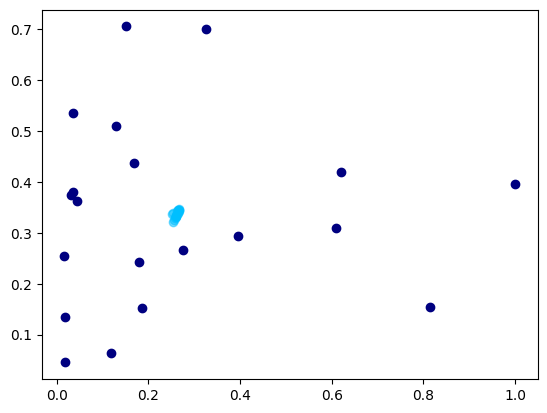

 72%|█████████████████████████████████████████████████████████▉                       | 143/200 [00:26<00:10,  5.64it/s]

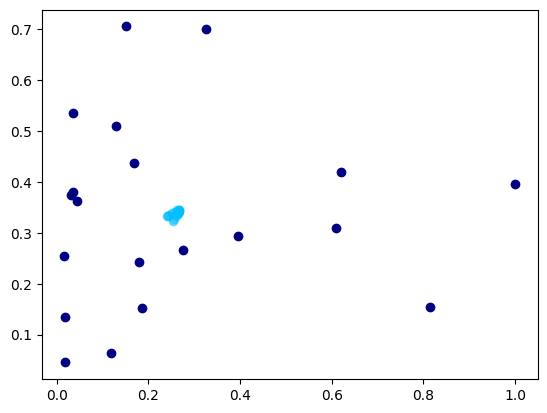

 72%|██████████████████████████████████████████████████████████▎                      | 144/200 [00:26<00:10,  5.54it/s]

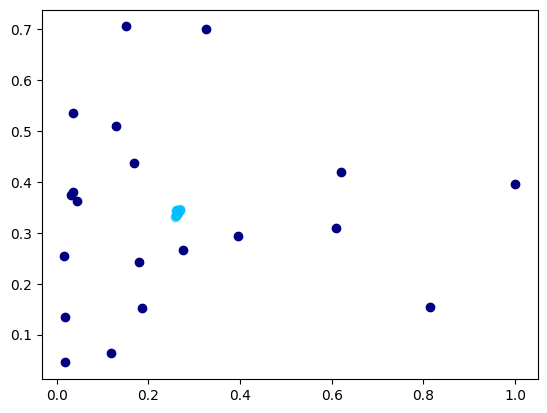

 72%|██████████████████████████████████████████████████████████▋                      | 145/200 [00:26<00:09,  5.62it/s]

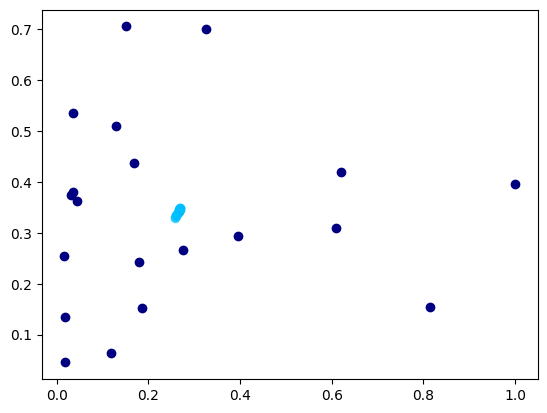

 73%|███████████████████████████████████████████████████████████▏                     | 146/200 [00:27<00:09,  5.57it/s]

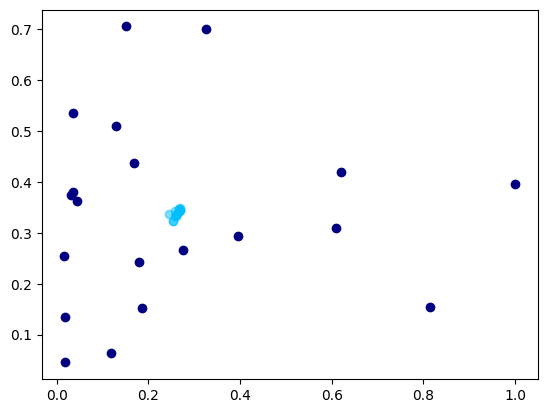

 74%|███████████████████████████████████████████████████████████▌                     | 147/200 [00:27<00:09,  5.64it/s]

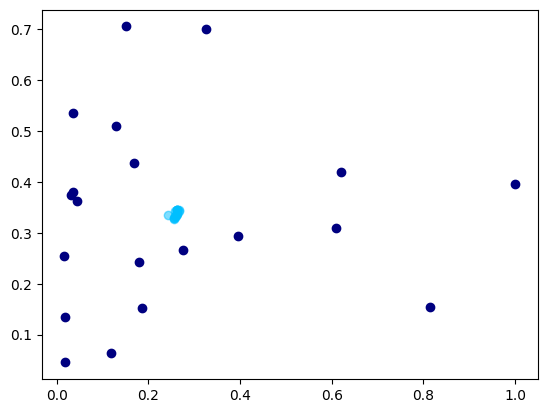

 74%|███████████████████████████████████████████████████████████▉                     | 148/200 [00:27<00:09,  5.75it/s]

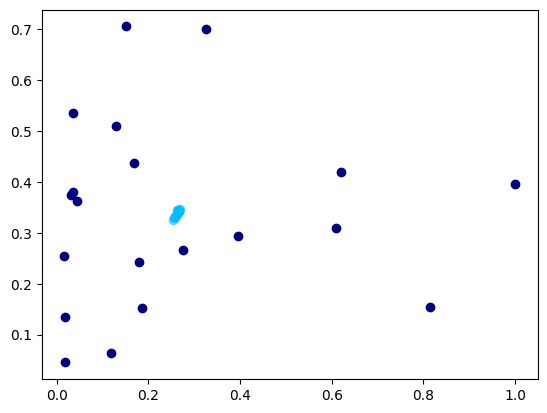

 74%|████████████████████████████████████████████████████████████▎                    | 149/200 [00:27<00:08,  5.79it/s]

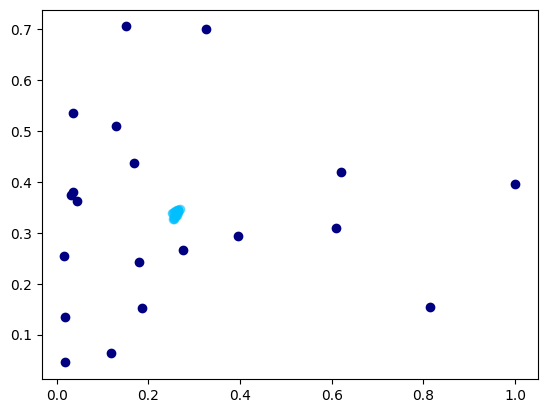

 75%|████████████████████████████████████████████████████████████▊                    | 150/200 [00:27<00:08,  5.82it/s]

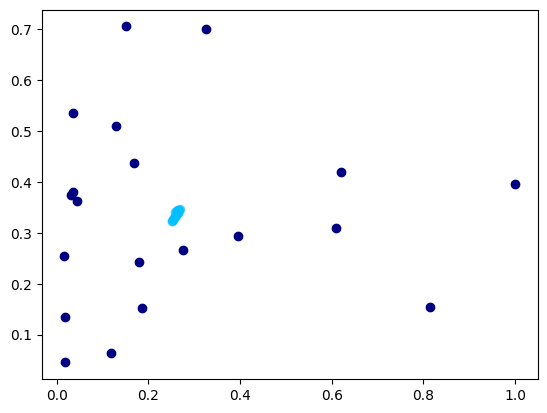

 76%|█████████████████████████████████████████████████████████████▏                   | 151/200 [00:27<00:08,  5.85it/s]

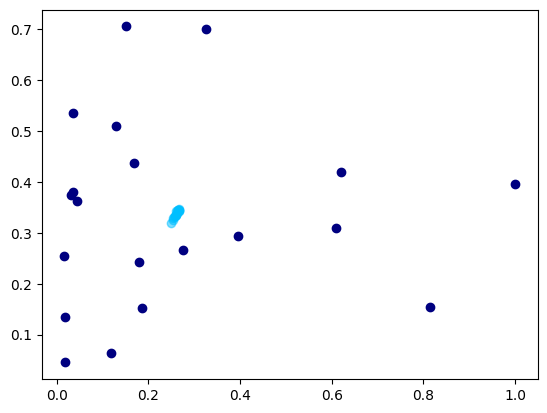

 76%|█████████████████████████████████████████████████████████████▌                   | 152/200 [00:28<00:08,  5.87it/s]

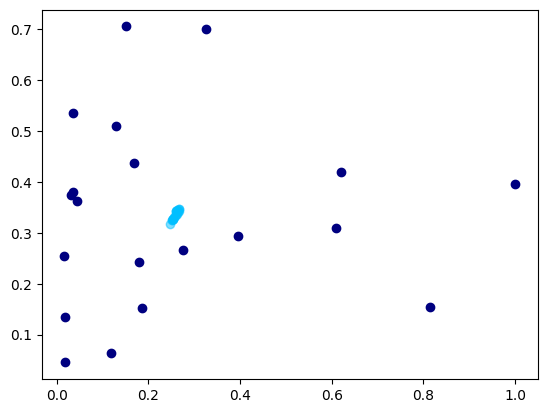

 76%|█████████████████████████████████████████████████████████████▉                   | 153/200 [00:28<00:08,  5.87it/s]

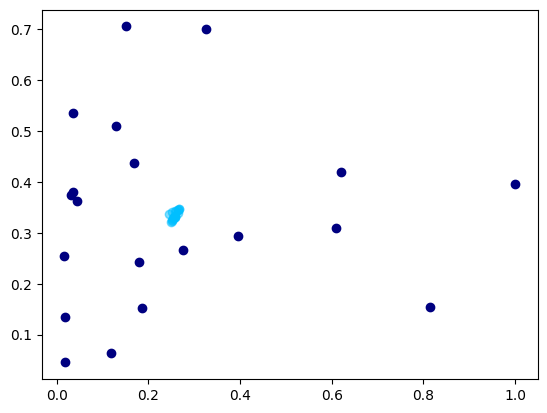

 77%|██████████████████████████████████████████████████████████████▎                  | 154/200 [00:28<00:08,  5.62it/s]

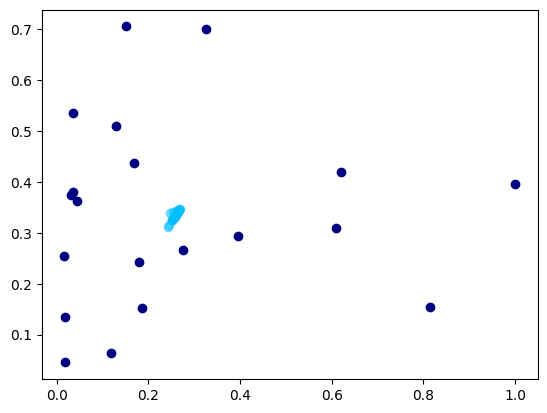

 78%|██████████████████████████████████████████████████████████████▊                  | 155/200 [00:28<00:07,  5.73it/s]

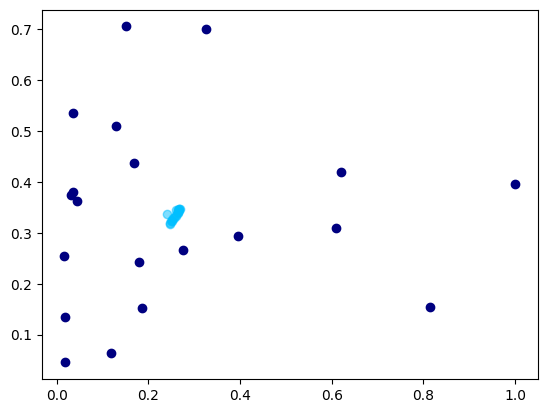

 78%|███████████████████████████████████████████████████████████████▏                 | 156/200 [00:28<00:07,  5.79it/s]

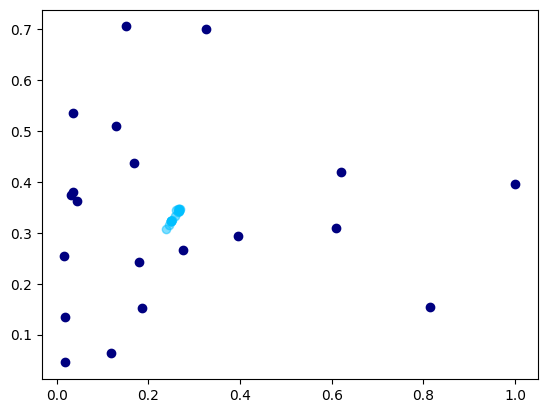

 78%|███████████████████████████████████████████████████████████████▌                 | 157/200 [00:28<00:07,  5.84it/s]

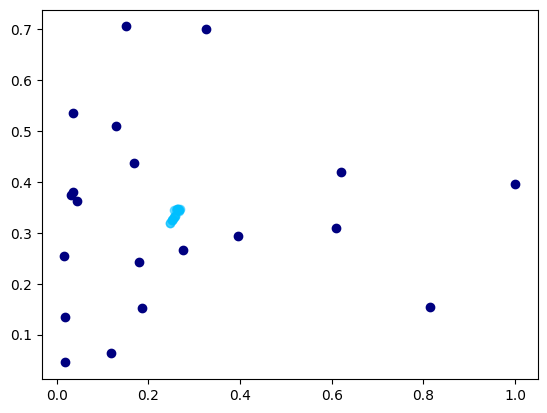

 79%|███████████████████████████████████████████████████████████████▉                 | 158/200 [00:29<00:07,  5.86it/s]

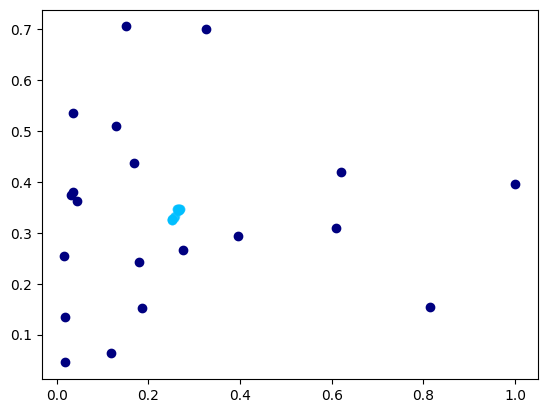

 80%|████████████████████████████████████████████████████████████████▍                | 159/200 [00:29<00:07,  5.82it/s]

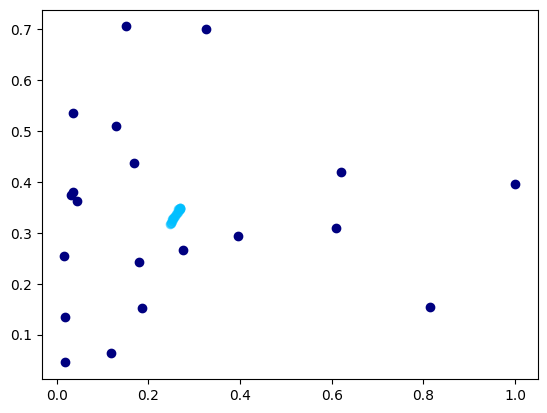

 80%|████████████████████████████████████████████████████████████████▊                | 160/200 [00:29<00:06,  5.78it/s]

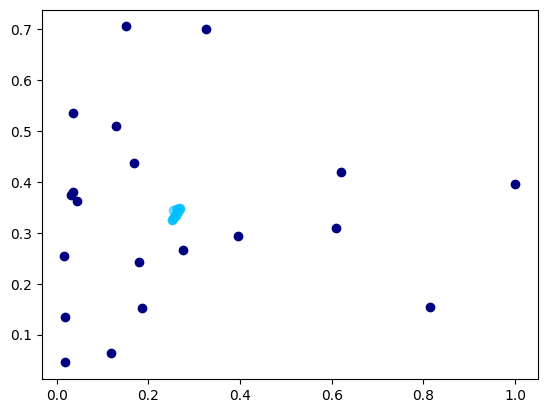

 80%|█████████████████████████████████████████████████████████████████▏               | 161/200 [00:29<00:06,  5.70it/s]

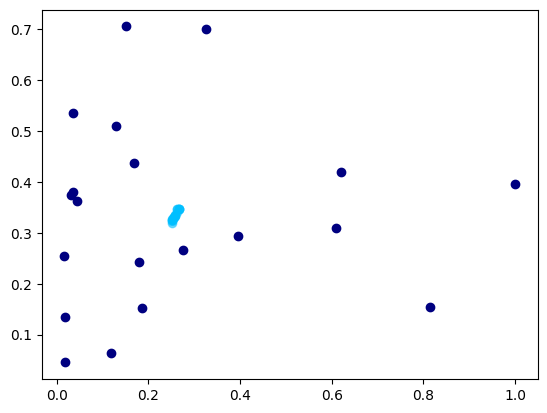

 81%|█████████████████████████████████████████████████████████████████▌               | 162/200 [00:29<00:06,  5.67it/s]

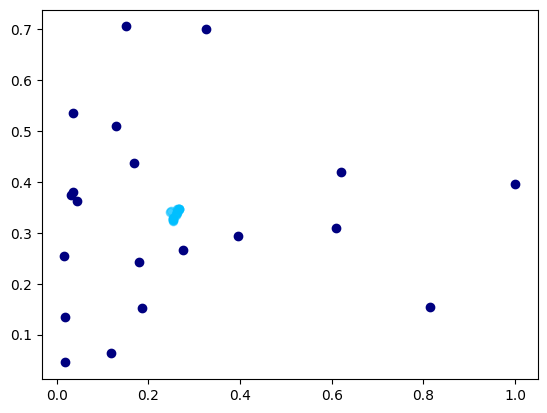

 82%|██████████████████████████████████████████████████████████████████               | 163/200 [00:29<00:06,  5.76it/s]

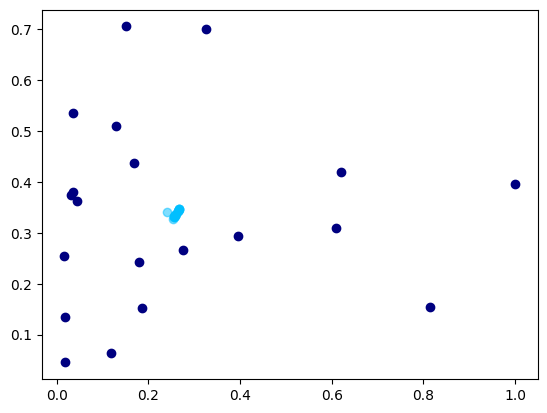

 82%|██████████████████████████████████████████████████████████████████▍              | 164/200 [00:30<00:06,  5.60it/s]

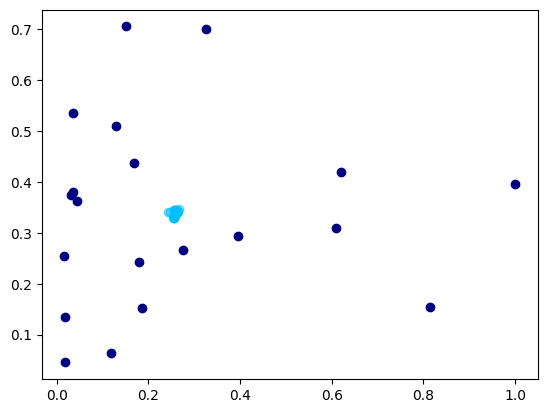

 82%|██████████████████████████████████████████████████████████████████▊              | 165/200 [00:30<00:06,  5.67it/s]

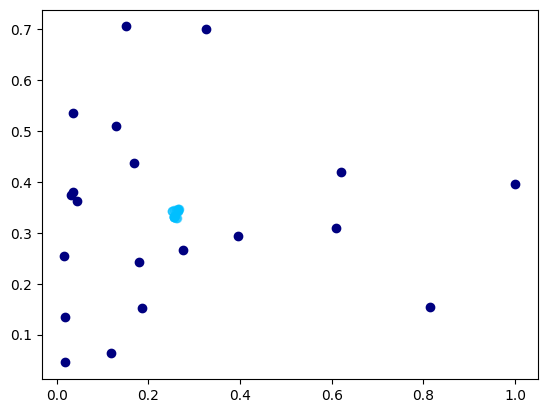

 83%|███████████████████████████████████████████████████████████████████▏             | 166/200 [00:30<00:05,  5.70it/s]

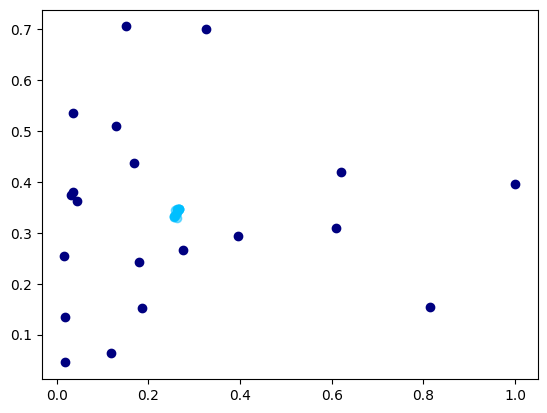

 84%|███████████████████████████████████████████████████████████████████▋             | 167/200 [00:30<00:05,  5.60it/s]

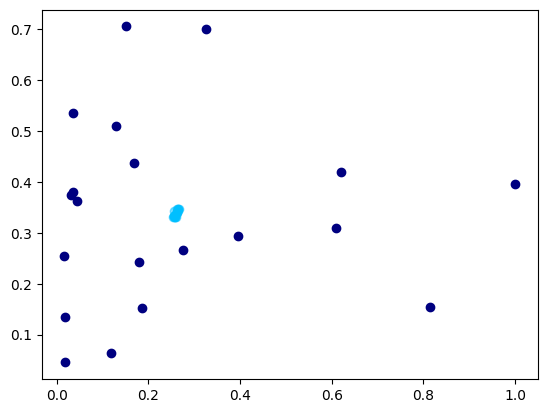

 84%|████████████████████████████████████████████████████████████████████             | 168/200 [00:30<00:05,  5.65it/s]

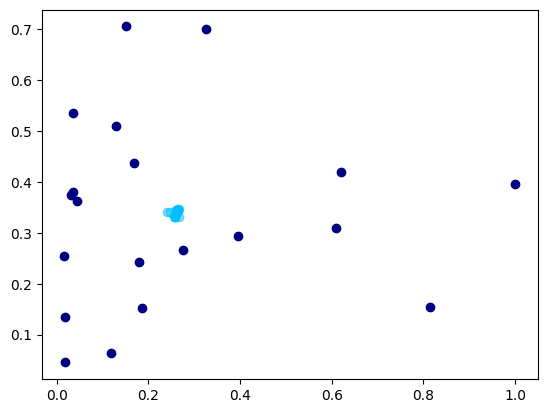

 84%|████████████████████████████████████████████████████████████████████▍            | 169/200 [00:31<00:05,  5.69it/s]

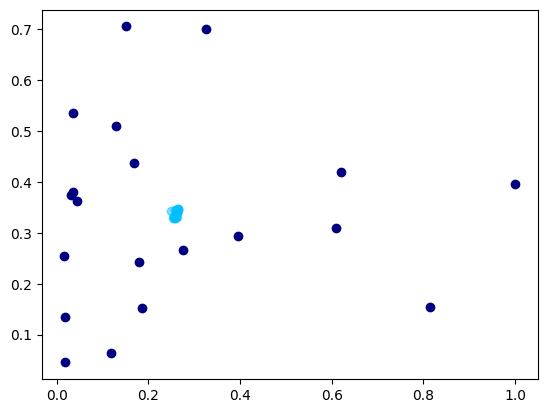

 85%|████████████████████████████████████████████████████████████████████▊            | 170/200 [00:31<00:05,  5.72it/s]

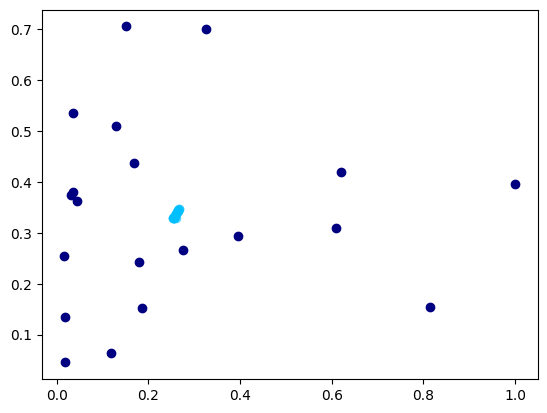

 86%|█████████████████████████████████████████████████████████████████████▎           | 171/200 [00:31<00:05,  5.73it/s]

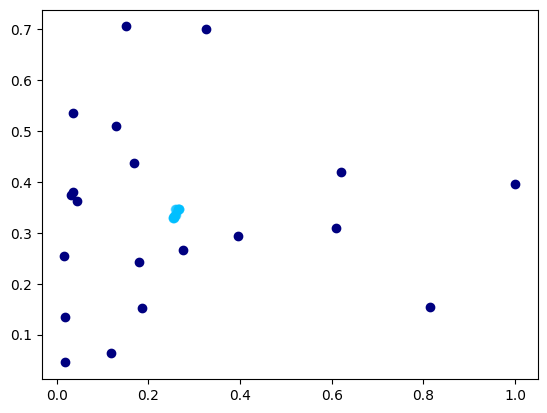

 86%|█████████████████████████████████████████████████████████████████████▋           | 172/200 [00:31<00:04,  5.69it/s]

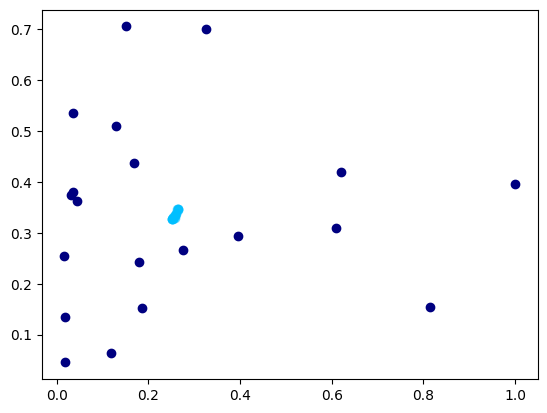

 86%|██████████████████████████████████████████████████████████████████████           | 173/200 [00:31<00:04,  5.70it/s]

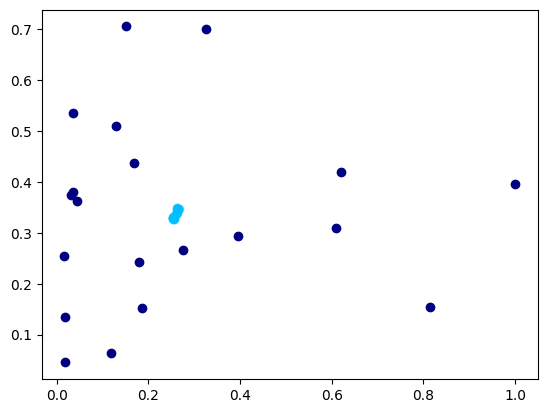

 87%|██████████████████████████████████████████████████████████████████████▍          | 174/200 [00:31<00:04,  5.78it/s]

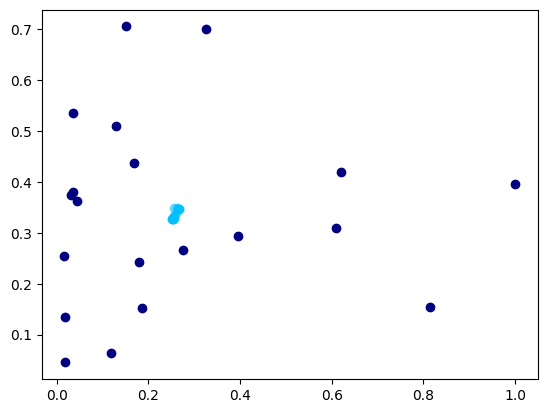

 88%|██████████████████████████████████████████████████████████████████████▉          | 175/200 [00:32<00:04,  5.78it/s]

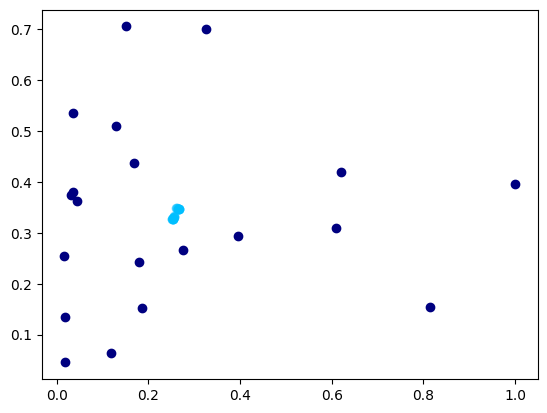

 88%|███████████████████████████████████████████████████████████████████████▎         | 176/200 [00:32<00:04,  5.78it/s]

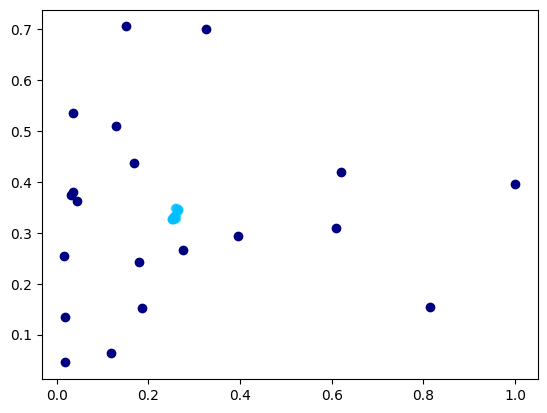

 88%|███████████████████████████████████████████████████████████████████████▋         | 177/200 [00:32<00:04,  5.74it/s]

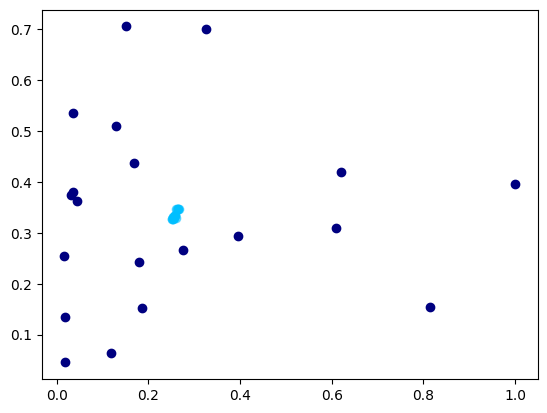

 89%|████████████████████████████████████████████████████████████████████████         | 178/200 [00:32<00:03,  5.70it/s]

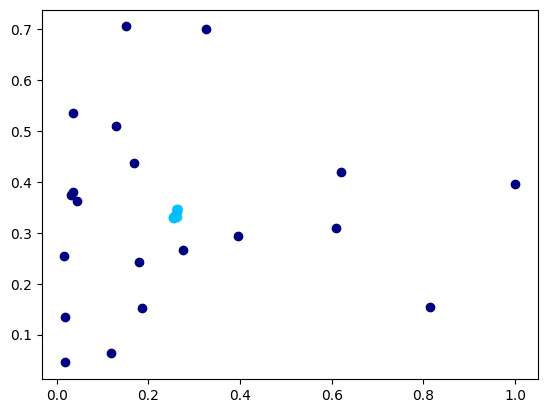

 90%|████████████████████████████████████████████████████████████████████████▍        | 179/200 [00:32<00:03,  5.74it/s]

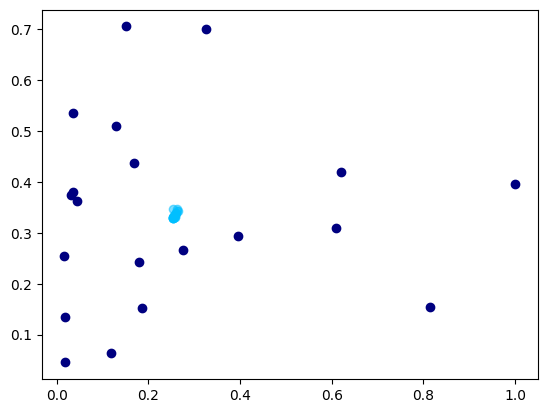

 90%|████████████████████████████████████████████████████████████████████████▉        | 180/200 [00:32<00:03,  5.84it/s]

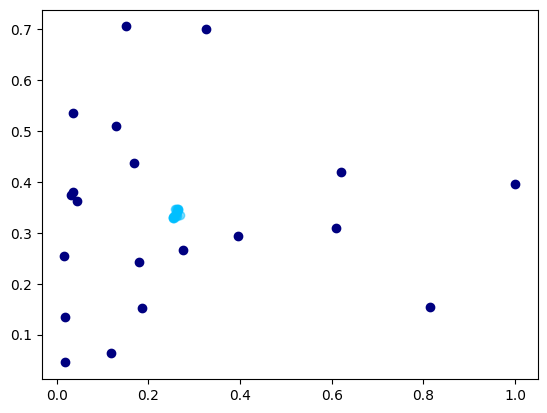

 90%|█████████████████████████████████████████████████████████████████████████▎       | 181/200 [00:33<00:03,  5.73it/s]

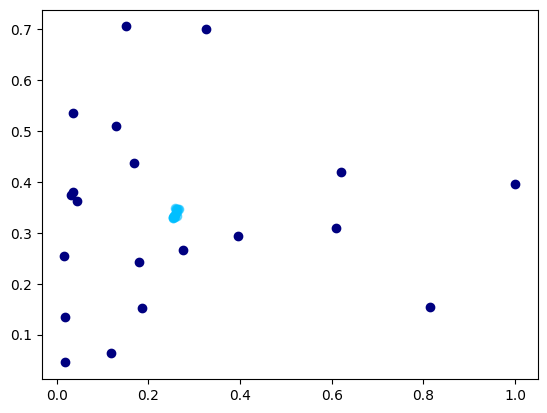

 91%|█████████████████████████████████████████████████████████████████████████▋       | 182/200 [00:33<00:03,  5.82it/s]

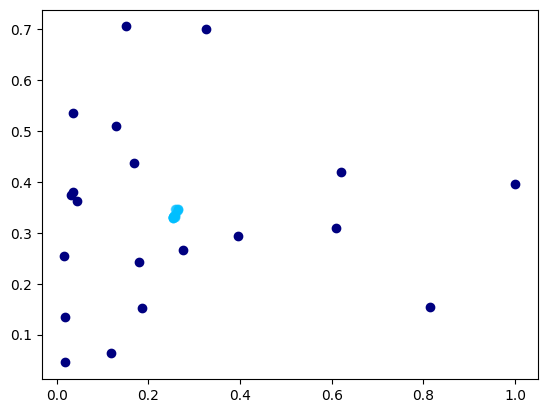

 92%|██████████████████████████████████████████████████████████████████████████       | 183/200 [00:33<00:02,  5.85it/s]

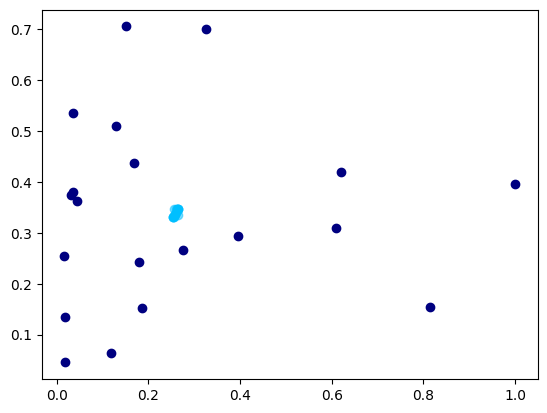

 92%|██████████████████████████████████████████████████████████████████████████▌      | 184/200 [00:33<00:02,  5.86it/s]

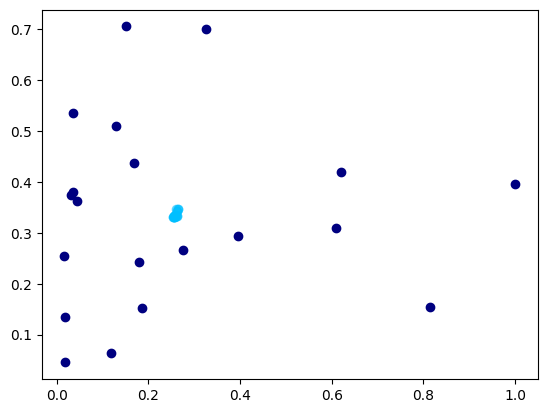

 92%|██████████████████████████████████████████████████████████████████████████▉      | 185/200 [00:33<00:02,  5.78it/s]

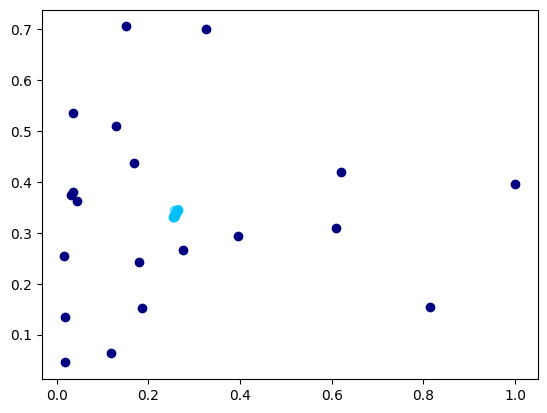

 93%|███████████████████████████████████████████████████████████████████████████▎     | 186/200 [00:34<00:02,  5.65it/s]

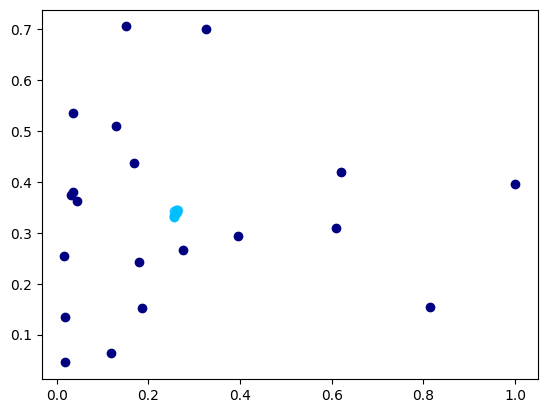

 94%|███████████████████████████████████████████████████████████████████████████▋     | 187/200 [00:34<00:02,  5.29it/s]

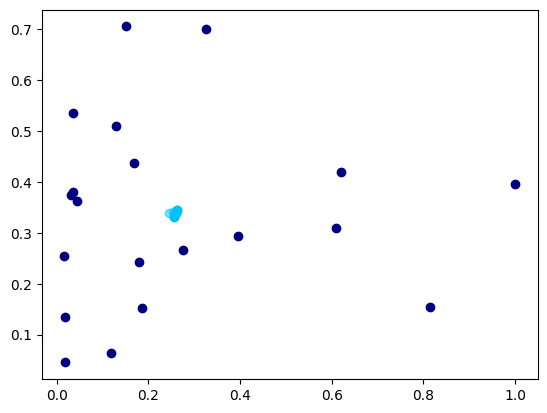

 94%|████████████████████████████████████████████████████████████████████████████▏    | 188/200 [00:34<00:02,  5.37it/s]

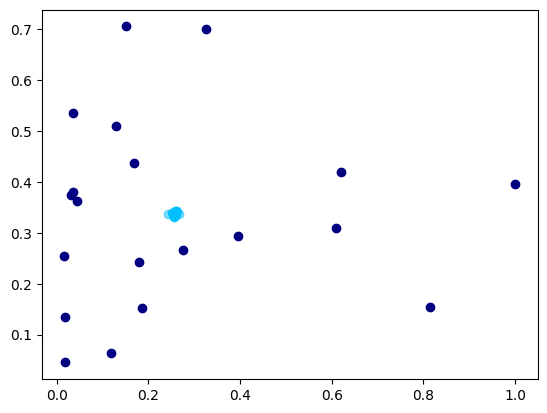

 94%|████████████████████████████████████████████████████████████████████████████▌    | 189/200 [00:34<00:02,  5.44it/s]

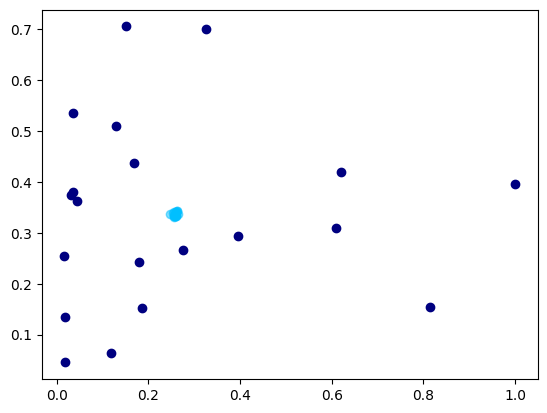

 95%|████████████████████████████████████████████████████████████████████████████▉    | 190/200 [00:34<00:01,  5.30it/s]

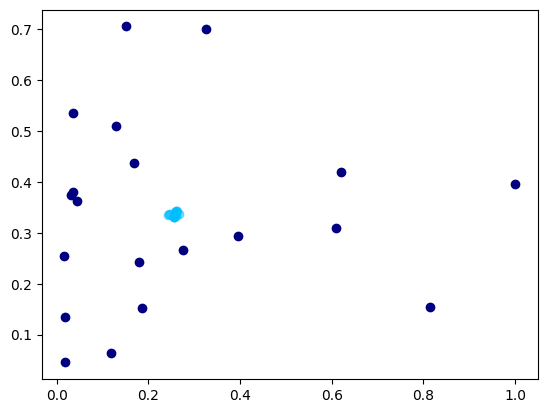

 96%|█████████████████████████████████████████████████████████████████████████████▎   | 191/200 [00:34<00:01,  5.20it/s]

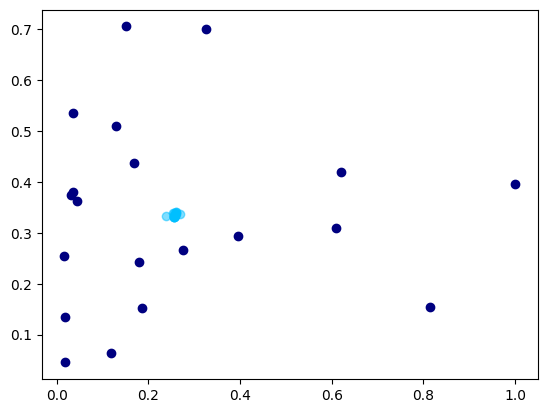

 96%|█████████████████████████████████████████████████████████████████████████████▊   | 192/200 [00:35<00:01,  5.20it/s]

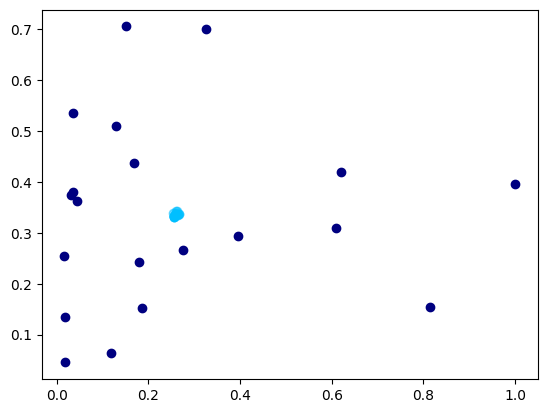

 96%|██████████████████████████████████████████████████████████████████████████████▏  | 193/200 [00:35<00:01,  5.35it/s]

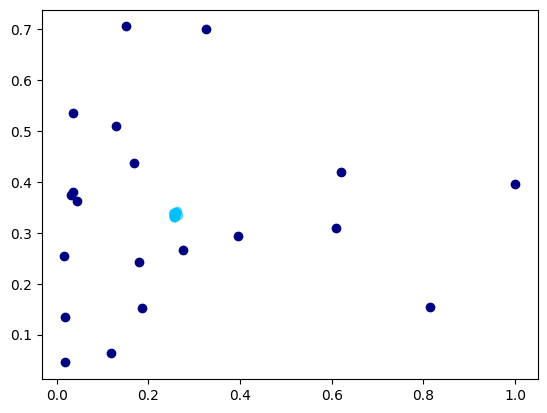

 97%|██████████████████████████████████████████████████████████████████████████████▌  | 194/200 [00:35<00:01,  5.40it/s]

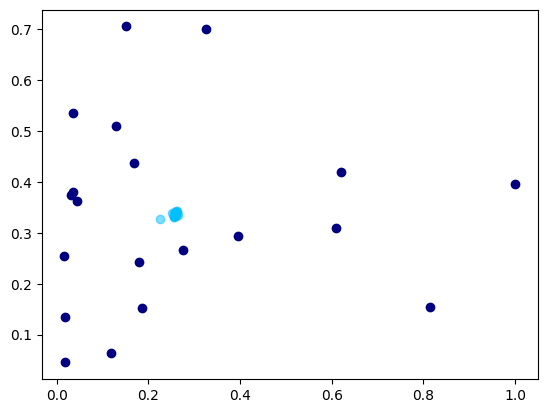

 98%|██████████████████████████████████████████████████████████████████████████████▉  | 195/200 [00:35<00:00,  5.46it/s]

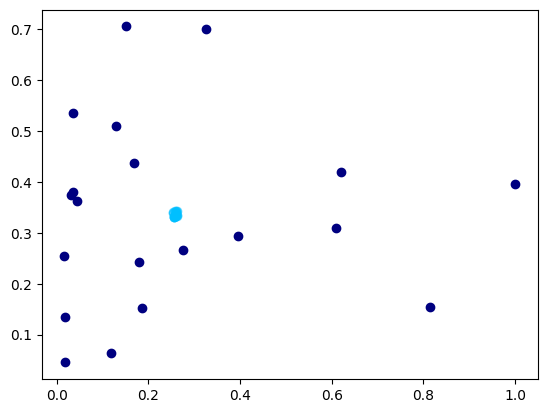

 98%|███████████████████████████████████████████████████████████████████████████████▍ | 196/200 [00:35<00:00,  5.41it/s]

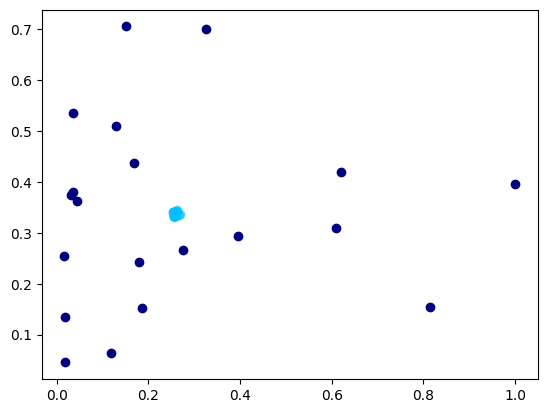

 98%|███████████████████████████████████████████████████████████████████████████████▊ | 197/200 [00:36<00:00,  5.52it/s]

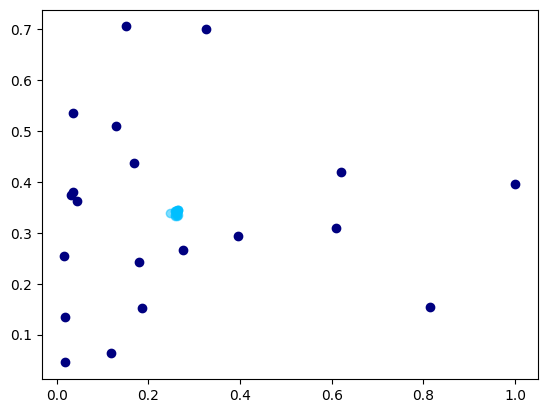

 99%|████████████████████████████████████████████████████████████████████████████████▏| 198/200 [00:36<00:00,  5.22it/s]

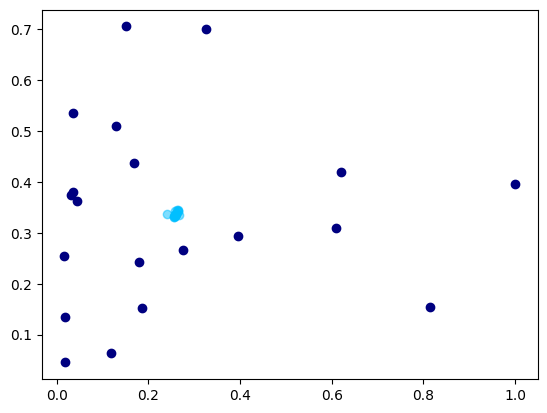

100%|████████████████████████████████████████████████████████████████████████████████▌| 199/200 [00:36<00:00,  5.34it/s]

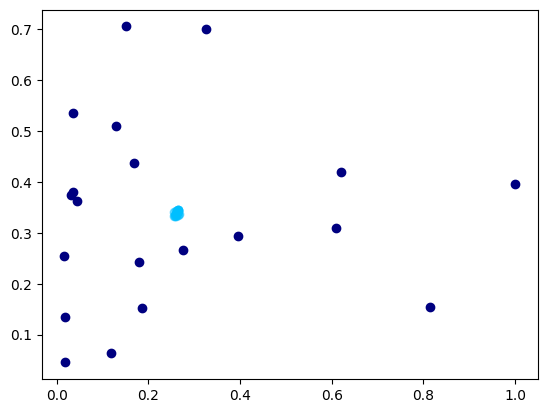

100%|█████████████████████████████████████████████████████████████████████████████████| 200/200 [00:36<00:00,  5.46it/s]


In [187]:
_, losses = train_VAE2D(vae, y)

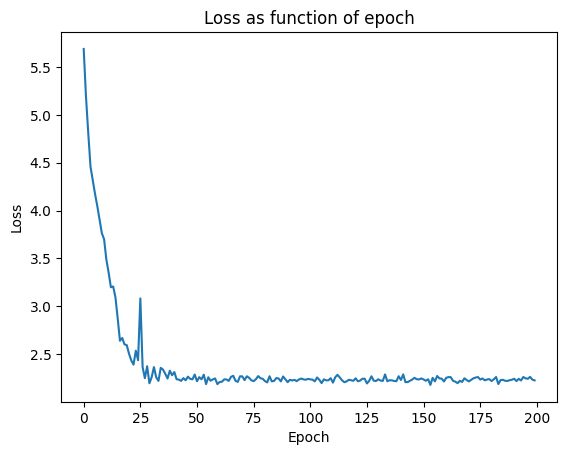

In [188]:
plt.plot(losses)
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Loss as function of epoch")
plt.show()

The loss has reached a plateau at around epoch 25.

However, you can see that the reconstruction is very bad, as the reconstructed points from y dataset are all gathered in the same small region.

This is certainly due to the fact that we have a latent regularizer in the loss, meaning it tries to push the approximate posterior distribution $q_{\psi}(z|x)$ to the prior $p_{\theta}(z)$. So the latent space will be more constrained, and the encoder will always map the examples to the same small region in latent space.

Let's try to change the proportions.

  0%|                                                                                          | 0/1000 [00:00<?, ?it/s]

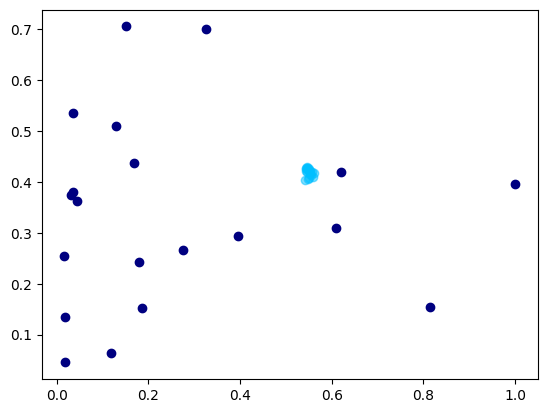

  0%|                                                                                  | 1/1000 [00:00<02:52,  5.79it/s]

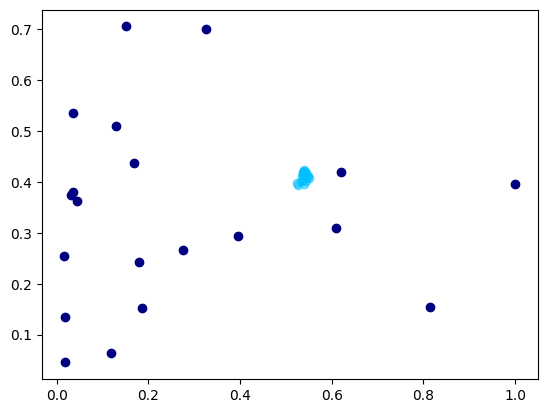

  0%|▏                                                                                 | 2/1000 [00:00<02:51,  5.82it/s]

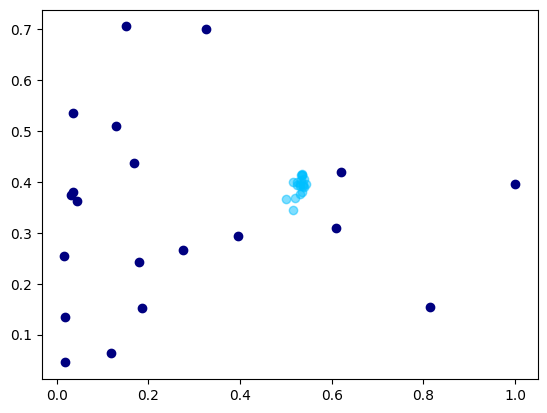

  0%|▏                                                                                 | 3/1000 [00:00<02:49,  5.90it/s]

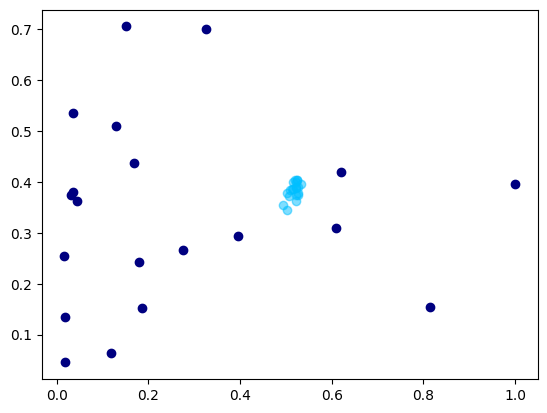

  0%|▎                                                                                 | 4/1000 [00:00<02:47,  5.93it/s]

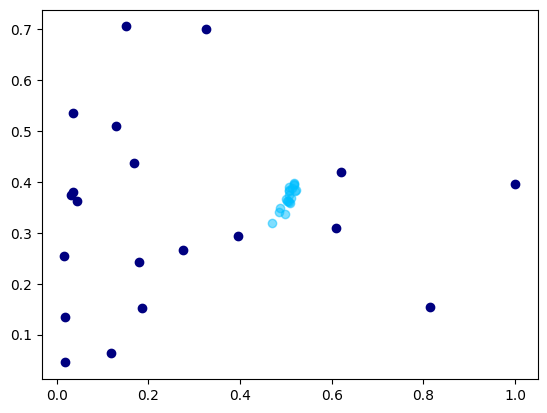

  0%|▍                                                                                 | 5/1000 [00:00<02:48,  5.89it/s]

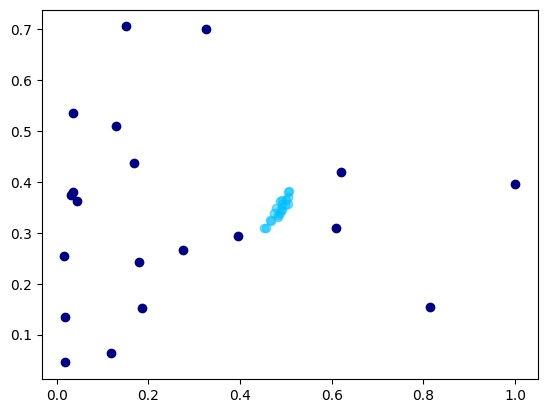

  1%|▍                                                                                 | 6/1000 [00:01<02:50,  5.84it/s]

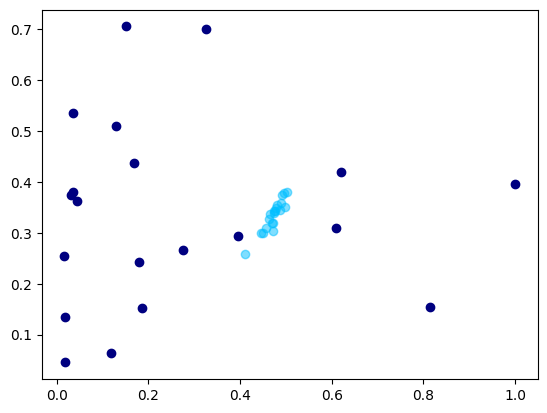

  1%|▌                                                                                 | 7/1000 [00:01<02:48,  5.89it/s]

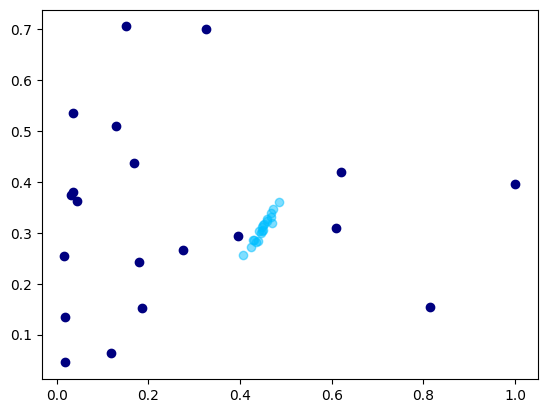

  1%|▋                                                                                 | 8/1000 [00:01<02:47,  5.91it/s]

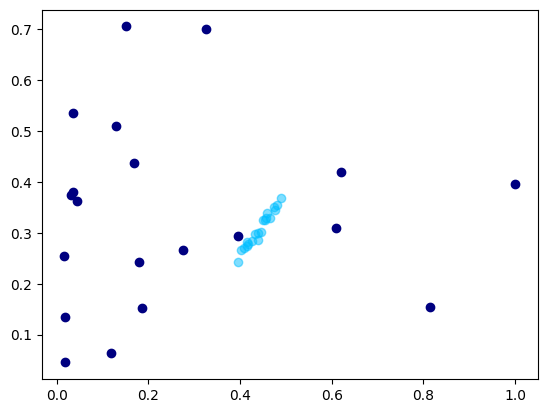

  1%|▋                                                                                 | 9/1000 [00:01<02:46,  5.96it/s]

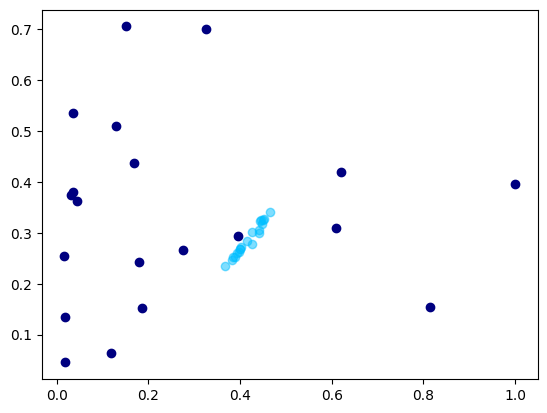

  1%|▊                                                                                | 10/1000 [00:01<02:47,  5.91it/s]

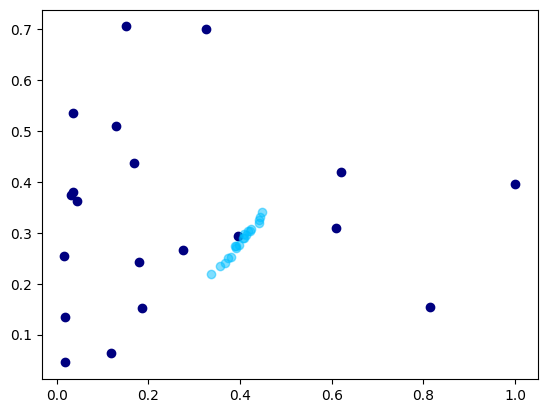

  1%|▉                                                                                | 11/1000 [00:01<02:48,  5.88it/s]

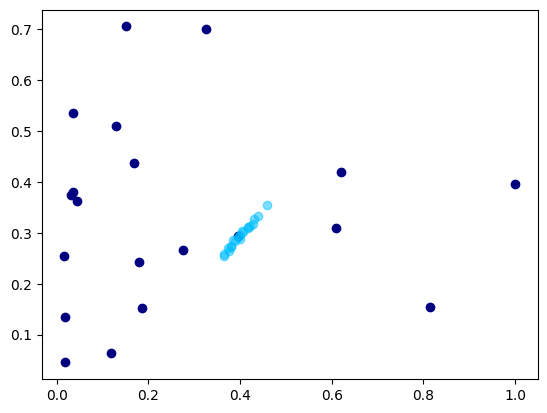

  1%|▉                                                                                | 12/1000 [00:02<02:47,  5.91it/s]

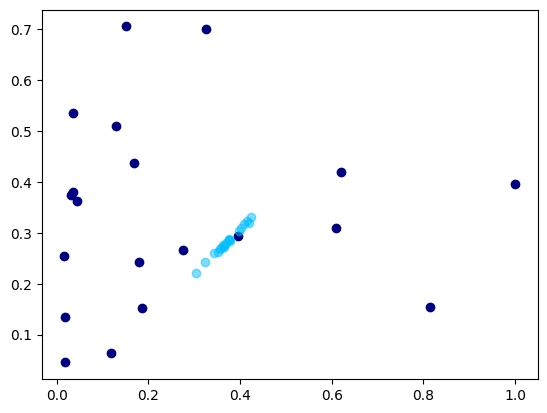

  1%|█                                                                                | 13/1000 [00:02<02:48,  5.86it/s]

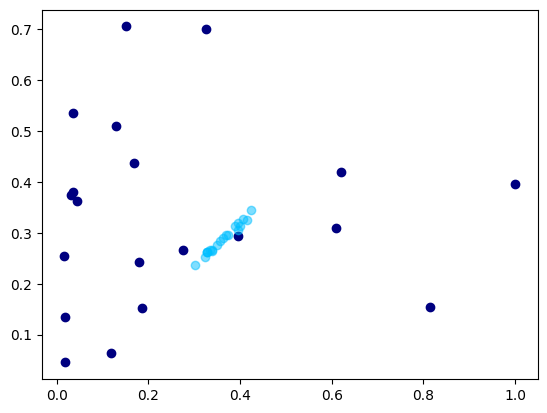

  1%|█▏                                                                               | 14/1000 [00:02<02:48,  5.85it/s]

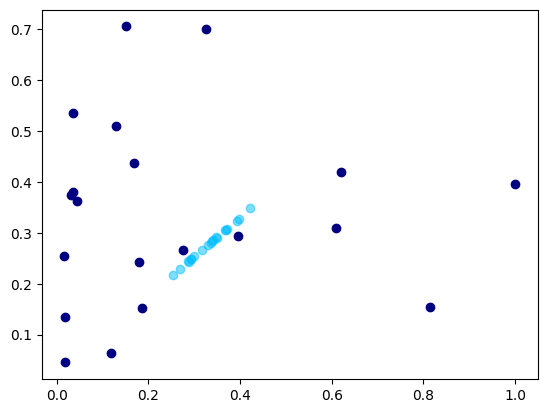

  2%|█▏                                                                               | 15/1000 [00:02<02:48,  5.85it/s]

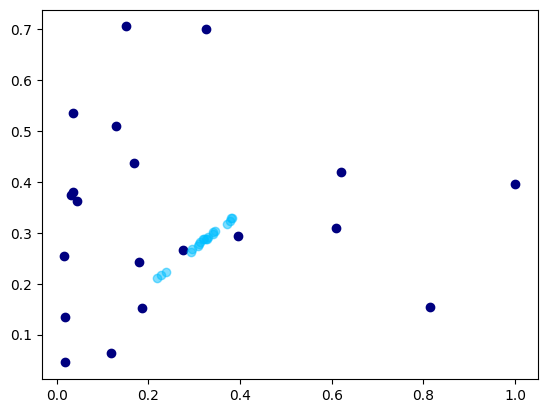

  2%|█▎                                                                               | 16/1000 [00:02<02:49,  5.81it/s]

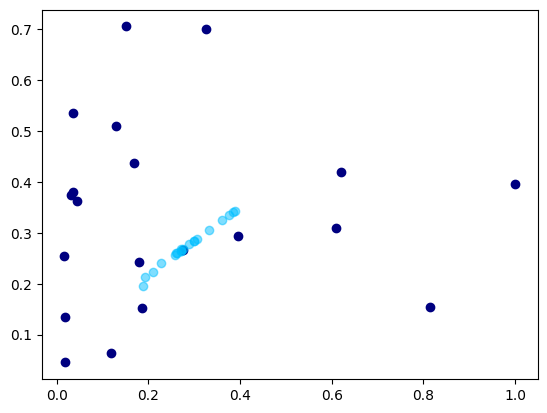

  2%|█▍                                                                               | 17/1000 [00:02<03:08,  5.22it/s]

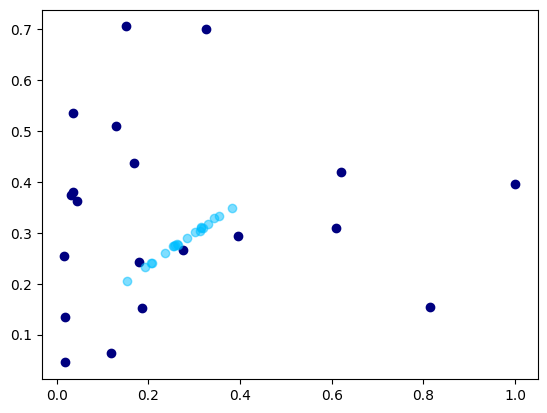

  2%|█▍                                                                               | 18/1000 [00:03<03:06,  5.28it/s]

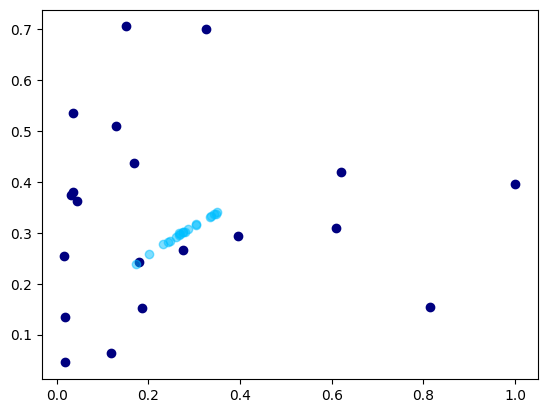

  2%|█▌                                                                               | 19/1000 [00:03<03:01,  5.40it/s]

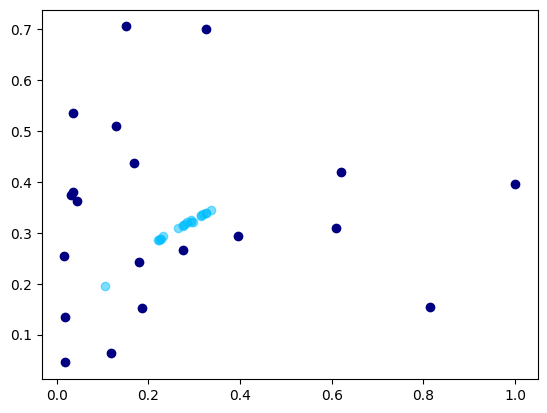

  2%|█▌                                                                               | 20/1000 [00:03<03:00,  5.43it/s]

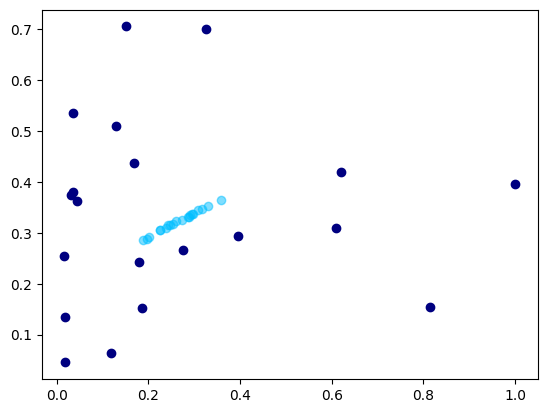

  2%|█▋                                                                               | 21/1000 [00:03<02:59,  5.44it/s]

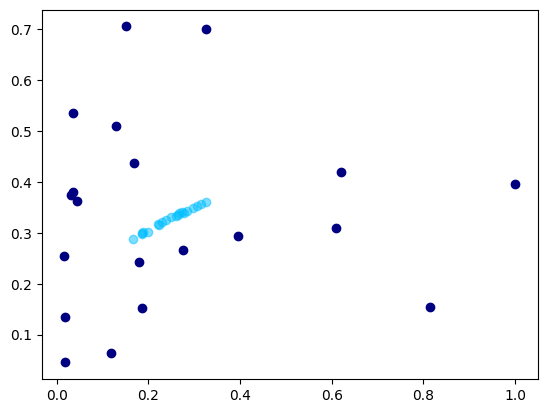

  2%|█▊                                                                               | 22/1000 [00:03<02:59,  5.45it/s]

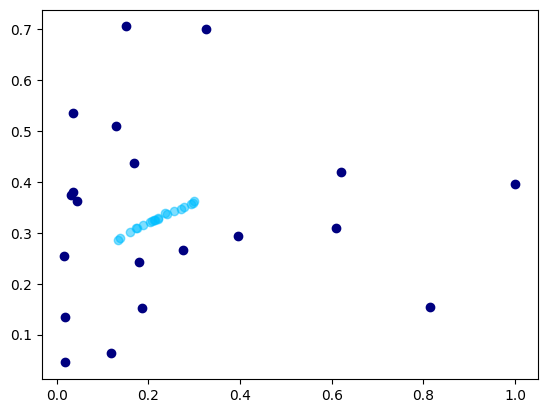

  2%|█▊                                                                               | 23/1000 [00:04<03:08,  5.17it/s]

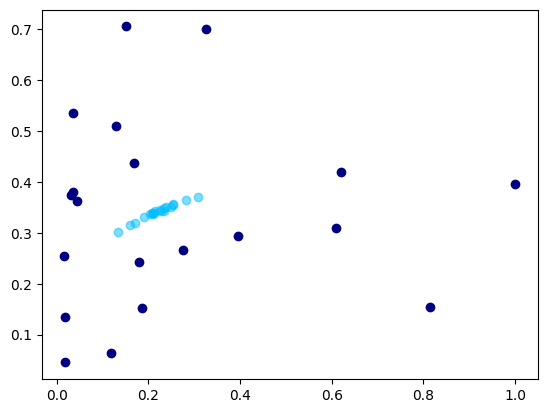

  2%|█▉                                                                               | 24/1000 [00:04<03:03,  5.31it/s]

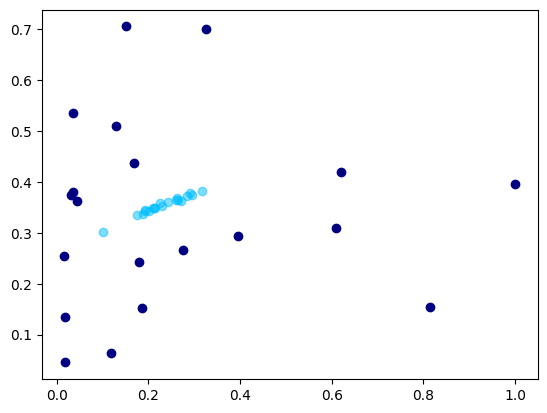

  2%|██                                                                               | 25/1000 [00:04<03:00,  5.40it/s]

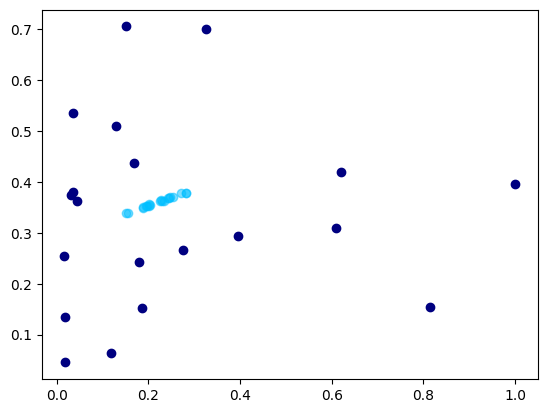

  3%|██                                                                               | 26/1000 [00:04<03:07,  5.21it/s]

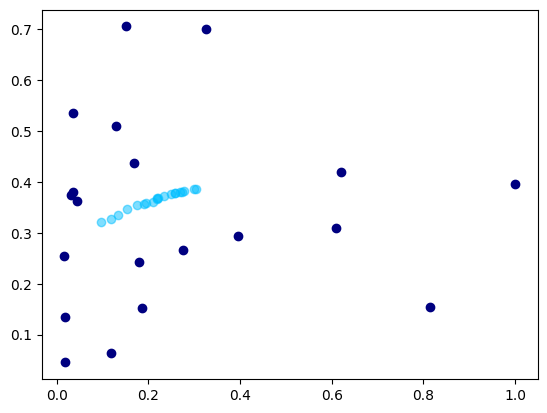

  3%|██▏                                                                              | 27/1000 [00:04<03:02,  5.32it/s]

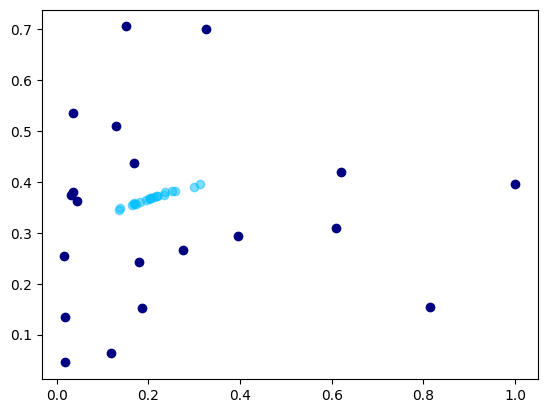

  3%|██▎                                                                              | 28/1000 [00:05<03:00,  5.40it/s]

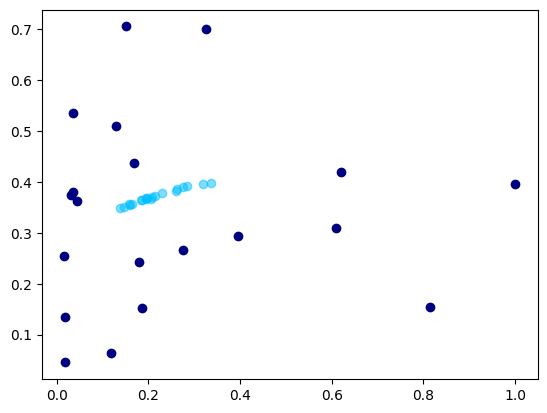

  3%|██▎                                                                              | 29/1000 [00:05<02:56,  5.52it/s]

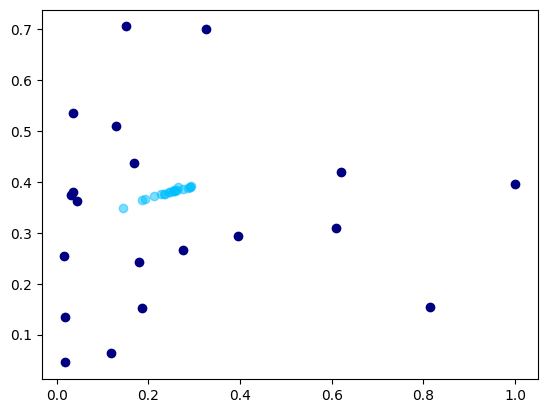

  3%|██▍                                                                              | 30/1000 [00:05<02:58,  5.44it/s]

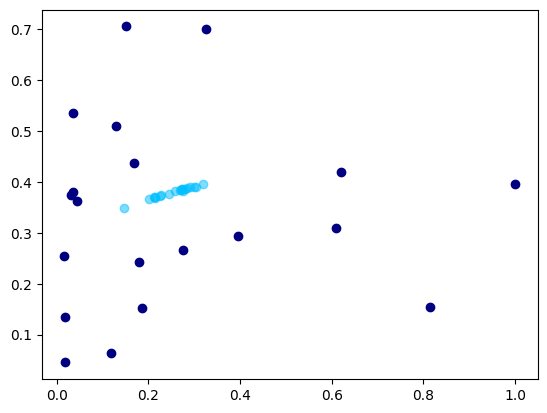

  3%|██▌                                                                              | 31/1000 [00:05<02:55,  5.53it/s]

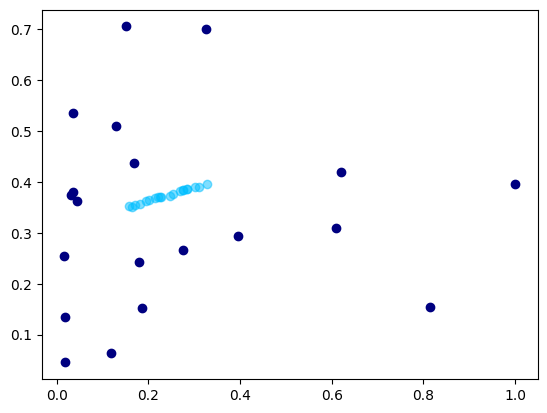

  3%|██▌                                                                              | 32/1000 [00:05<02:55,  5.52it/s]

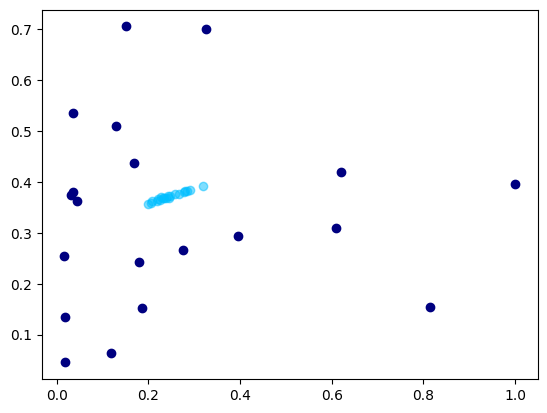

  3%|██▋                                                                              | 33/1000 [00:05<02:54,  5.54it/s]

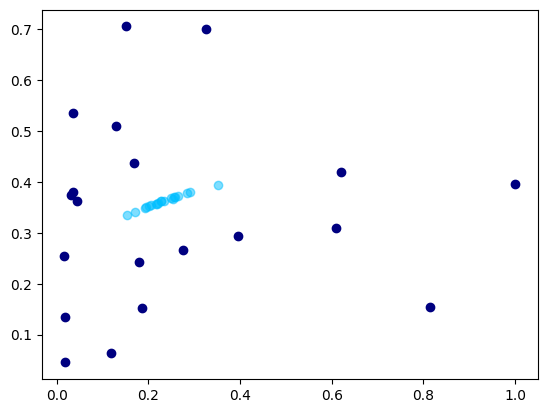

  3%|██▊                                                                              | 34/1000 [00:06<02:55,  5.49it/s]

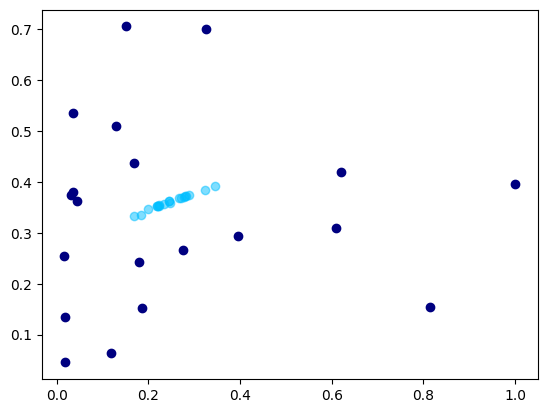

  4%|██▊                                                                              | 35/1000 [00:06<02:56,  5.45it/s]

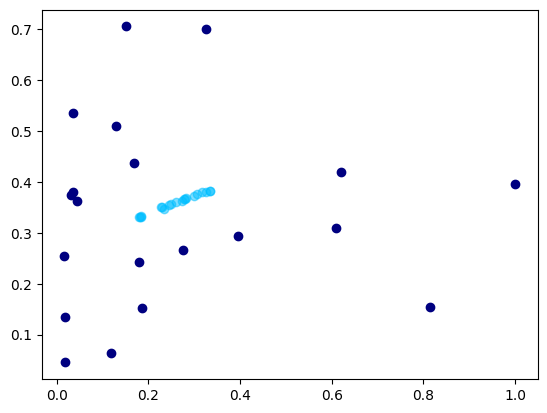

  4%|██▉                                                                              | 36/1000 [00:06<02:53,  5.55it/s]

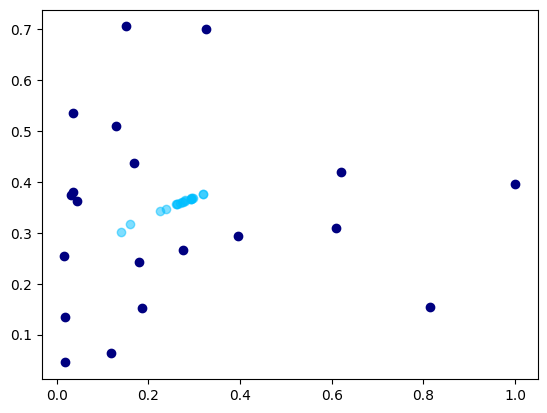

  4%|██▉                                                                              | 37/1000 [00:06<02:52,  5.58it/s]

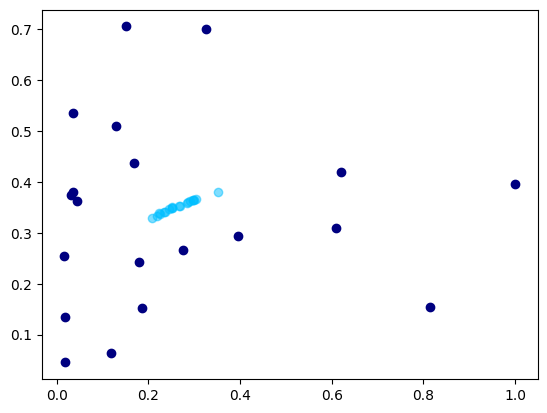

  4%|███                                                                              | 38/1000 [00:06<02:50,  5.64it/s]

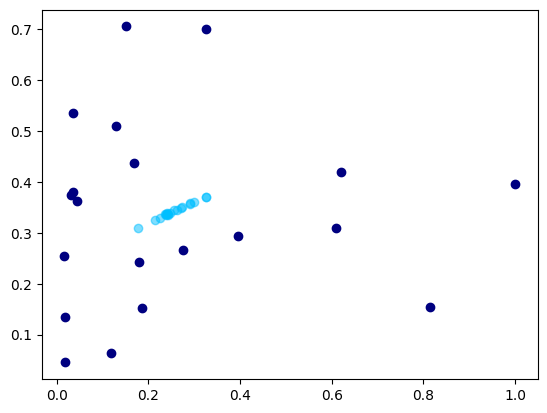

  4%|███▏                                                                             | 39/1000 [00:06<02:51,  5.60it/s]

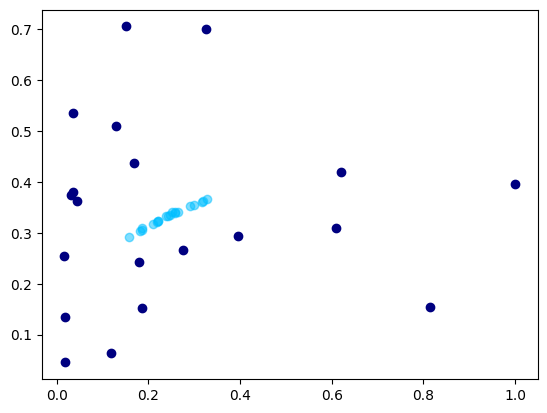

  4%|███▏                                                                             | 40/1000 [00:07<02:49,  5.66it/s]

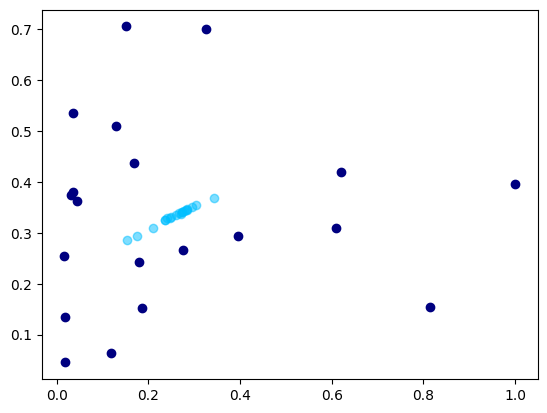

  4%|███▎                                                                             | 41/1000 [00:07<02:52,  5.58it/s]

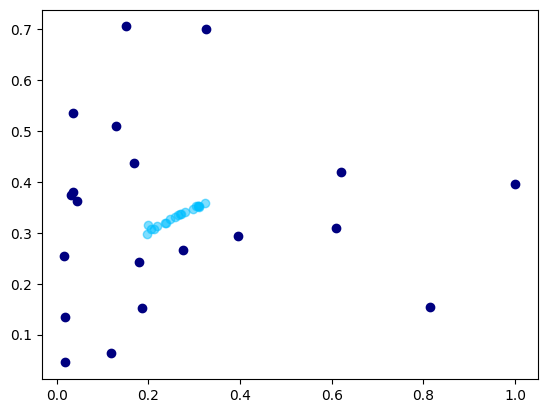

  4%|███▍                                                                             | 42/1000 [00:07<02:50,  5.63it/s]

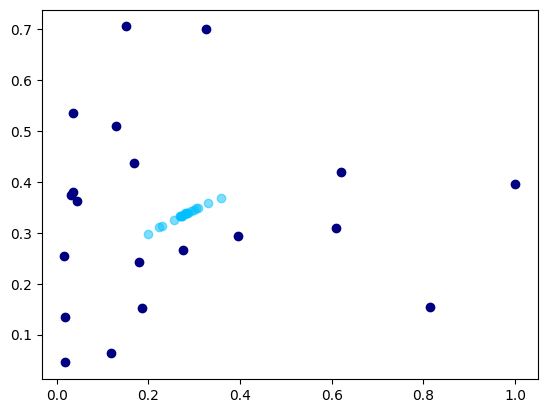

  4%|███▍                                                                             | 43/1000 [00:07<02:49,  5.65it/s]

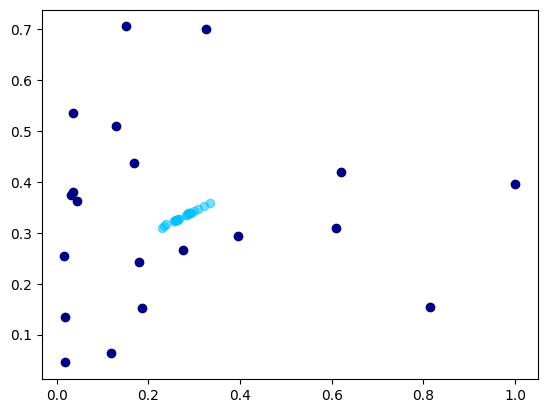

  4%|███▌                                                                             | 44/1000 [00:07<02:49,  5.65it/s]

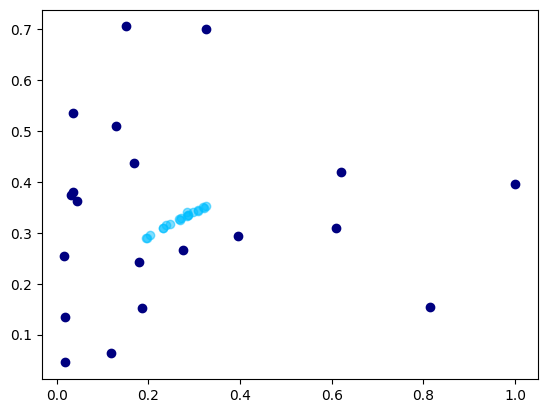

  4%|███▋                                                                             | 45/1000 [00:08<02:51,  5.58it/s]

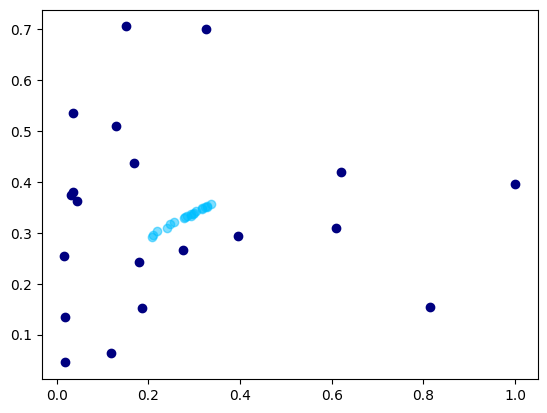

  5%|███▋                                                                             | 46/1000 [00:08<02:48,  5.65it/s]

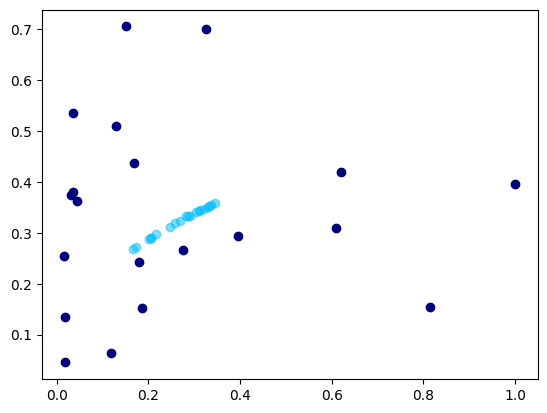

  5%|███▊                                                                             | 47/1000 [00:08<02:49,  5.64it/s]

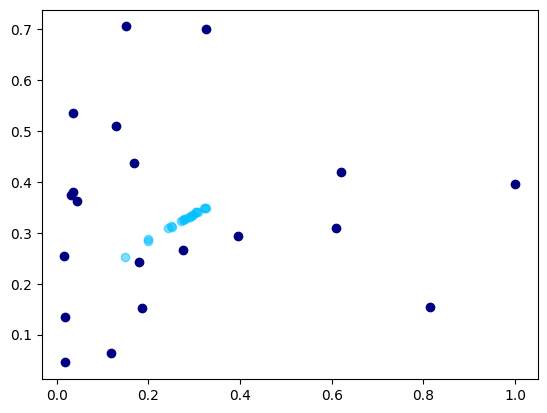

  5%|███▉                                                                             | 48/1000 [00:08<02:50,  5.59it/s]

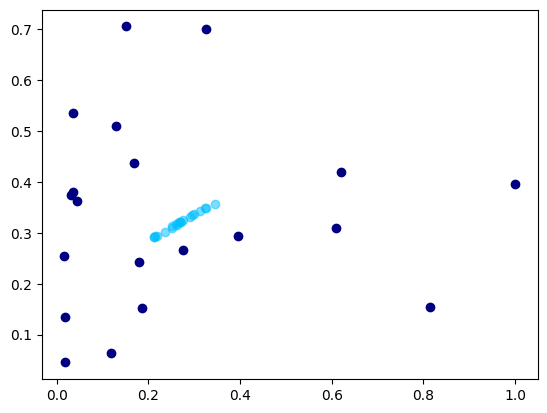

  5%|███▉                                                                             | 49/1000 [00:08<02:48,  5.64it/s]

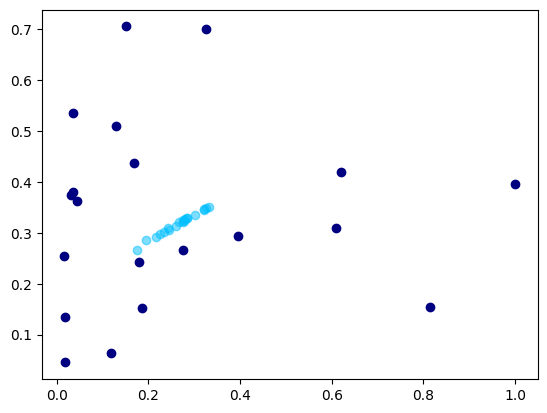

  5%|████                                                                             | 50/1000 [00:08<02:46,  5.71it/s]

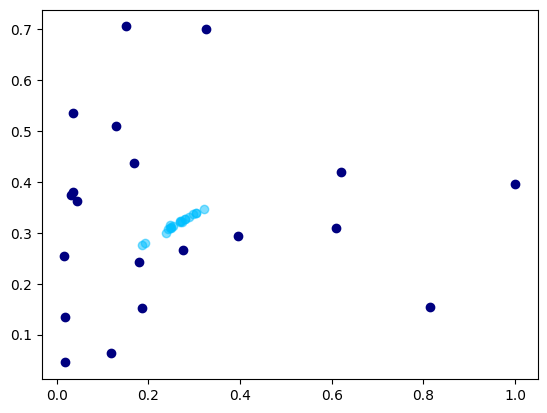

  5%|████▏                                                                            | 51/1000 [00:09<02:45,  5.75it/s]

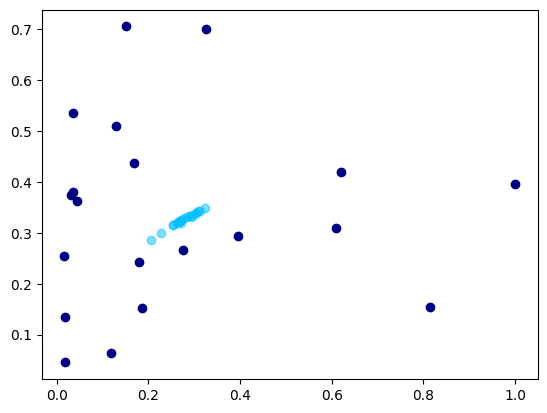

  5%|████▏                                                                            | 52/1000 [00:09<02:44,  5.75it/s]

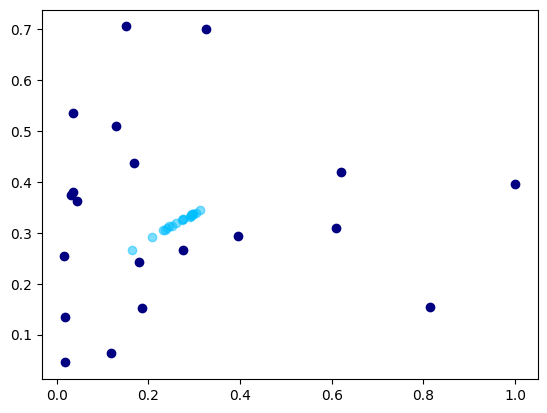

  5%|████▎                                                                            | 53/1000 [00:09<02:49,  5.59it/s]

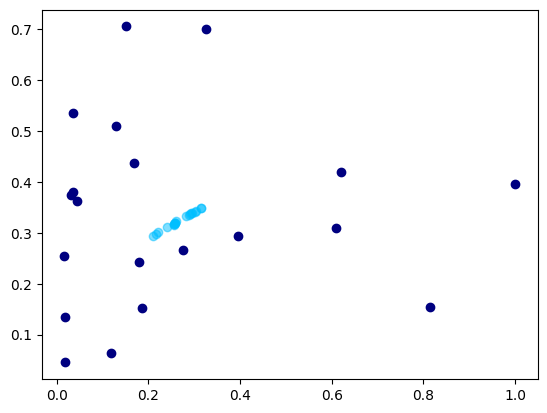

  5%|████▎                                                                            | 54/1000 [00:09<02:49,  5.57it/s]

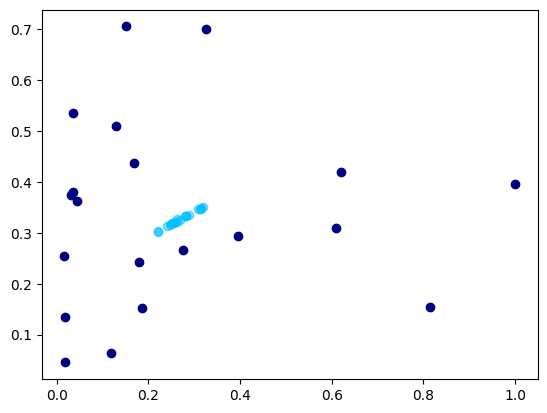

  6%|████▍                                                                            | 55/1000 [00:09<02:47,  5.64it/s]

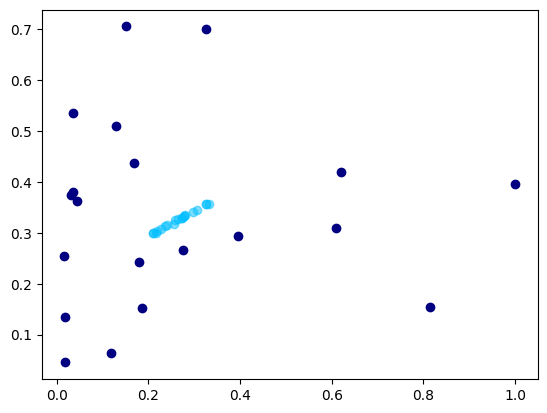

  6%|████▌                                                                            | 56/1000 [00:09<02:47,  5.65it/s]

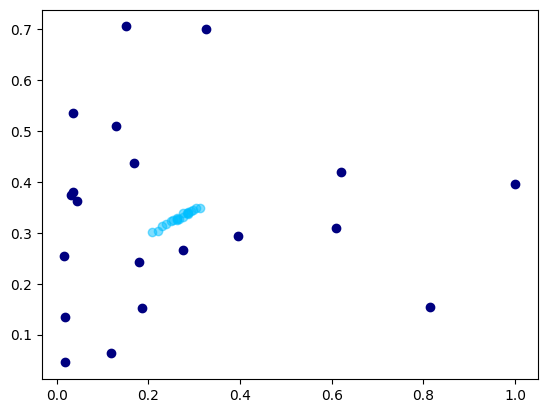

  6%|████▌                                                                            | 57/1000 [00:10<02:45,  5.70it/s]

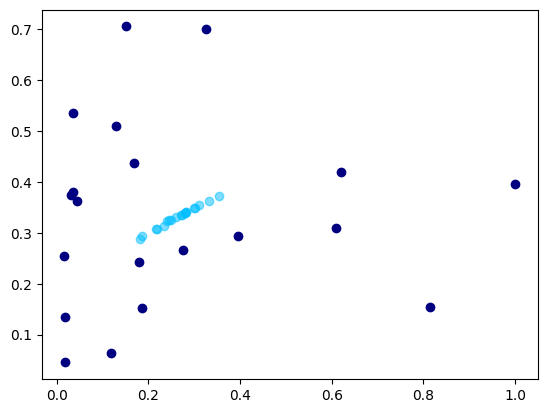

  6%|████▋                                                                            | 58/1000 [00:10<02:44,  5.71it/s]

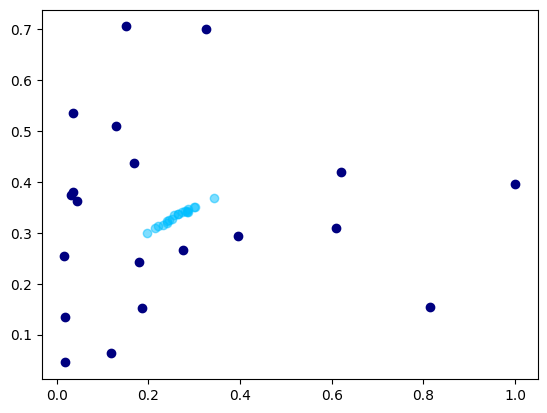

  6%|████▊                                                                            | 59/1000 [00:10<02:48,  5.58it/s]

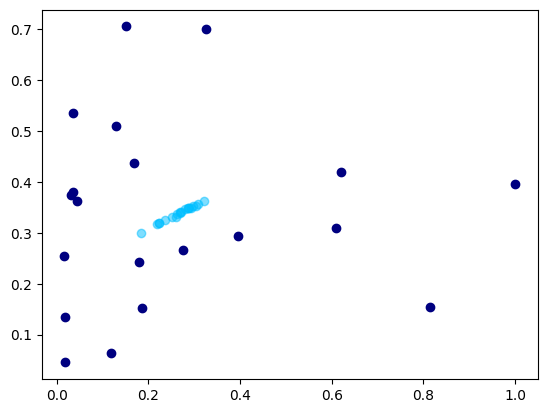

  6%|████▊                                                                            | 60/1000 [00:10<02:47,  5.60it/s]

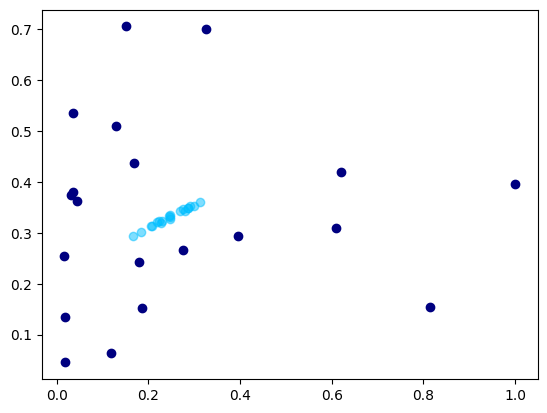

  6%|████▉                                                                            | 61/1000 [00:10<02:48,  5.59it/s]

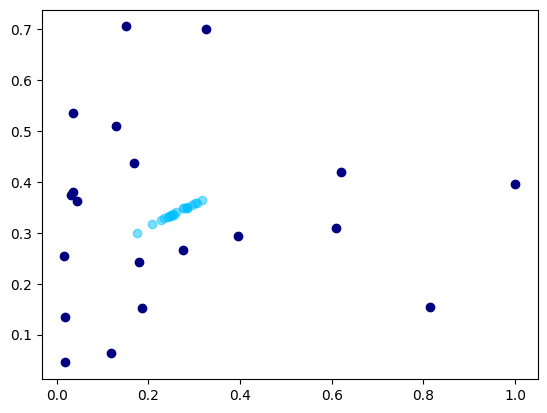

  6%|█████                                                                            | 62/1000 [00:11<02:48,  5.56it/s]

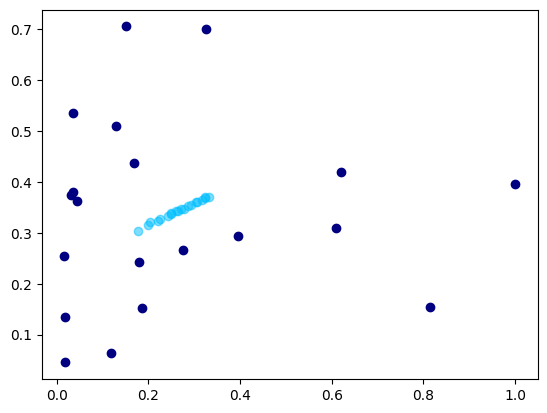

  6%|█████                                                                            | 63/1000 [00:11<02:46,  5.63it/s]

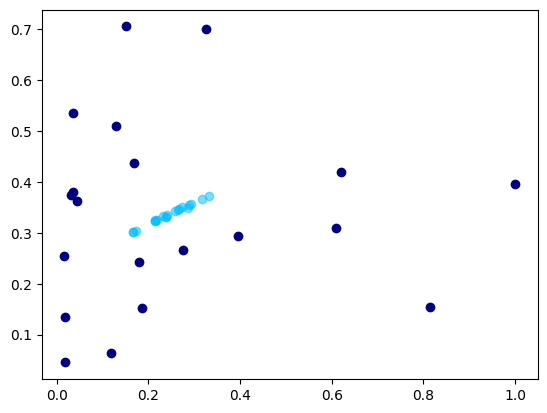

  6%|█████▏                                                                           | 64/1000 [00:11<02:44,  5.70it/s]

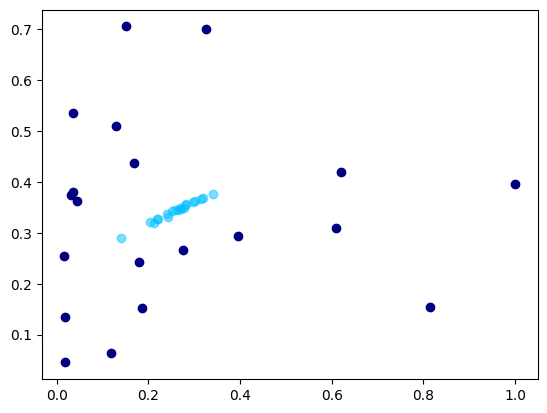

  6%|█████▎                                                                           | 65/1000 [00:11<02:41,  5.78it/s]

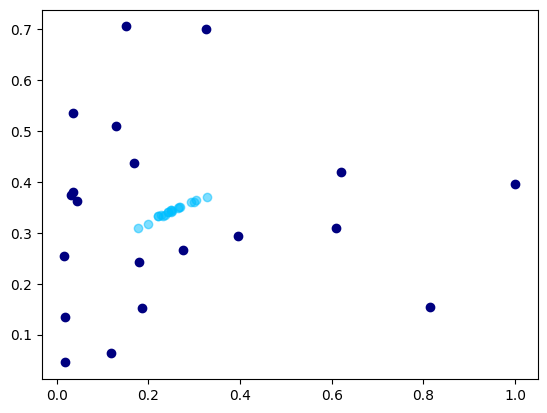

  7%|█████▎                                                                           | 66/1000 [00:11<02:40,  5.82it/s]

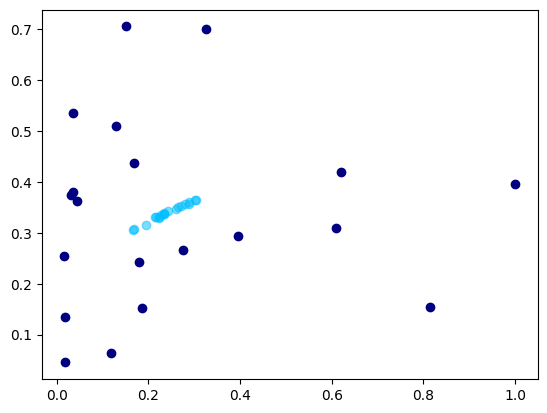

  7%|█████▍                                                                           | 67/1000 [00:11<02:39,  5.86it/s]

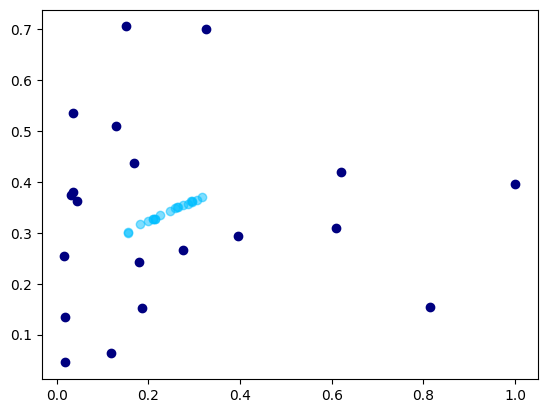

  7%|█████▌                                                                           | 68/1000 [00:12<02:37,  5.91it/s]

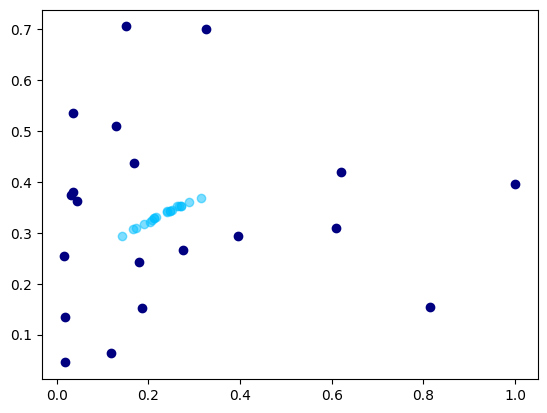

  7%|█████▌                                                                           | 69/1000 [00:12<02:37,  5.92it/s]

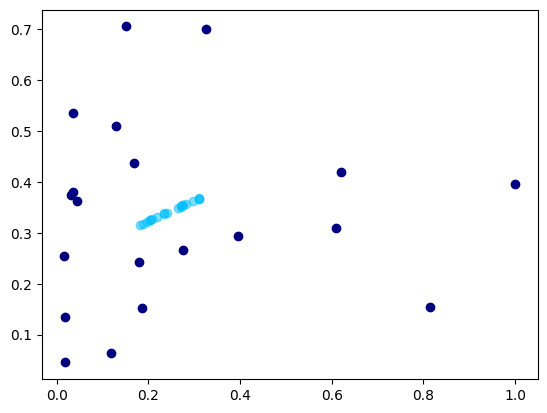

  7%|█████▋                                                                           | 70/1000 [00:12<02:38,  5.86it/s]

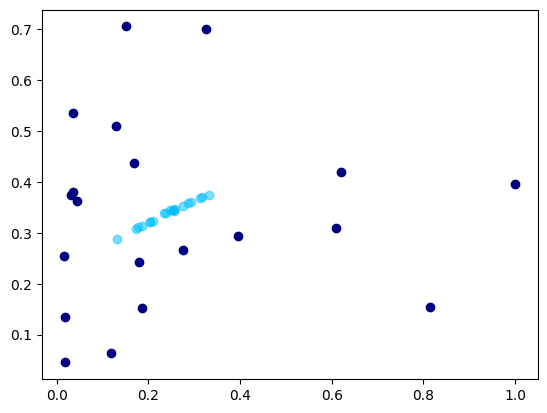

  7%|█████▊                                                                           | 71/1000 [00:12<02:36,  5.93it/s]

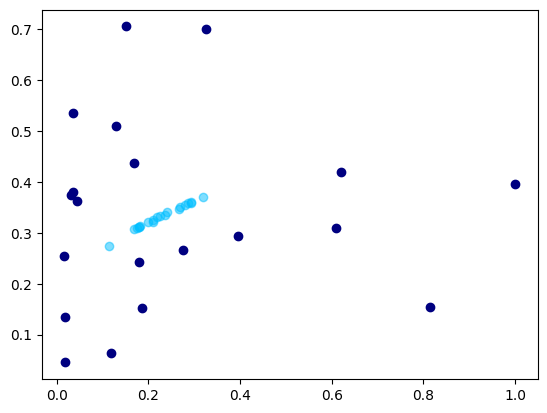

  7%|█████▊                                                                           | 72/1000 [00:12<02:37,  5.90it/s]

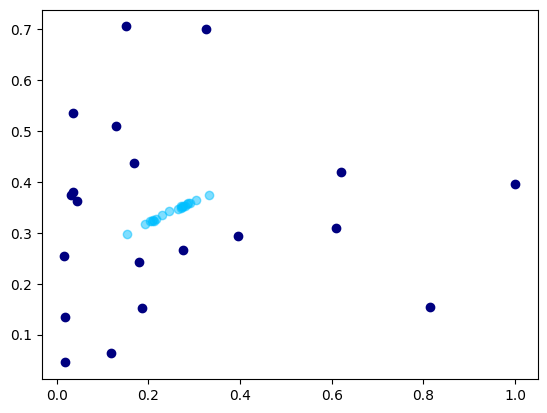

  7%|█████▉                                                                           | 73/1000 [00:12<02:36,  5.93it/s]

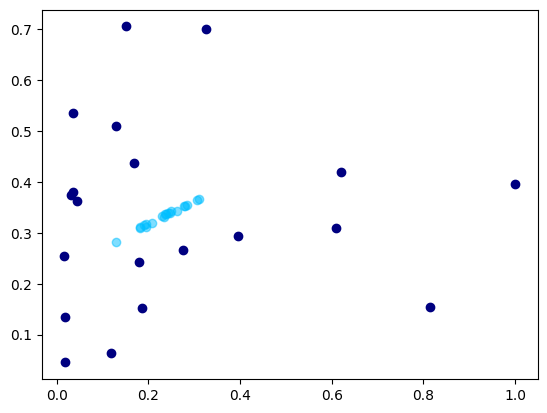

  7%|█████▉                                                                           | 74/1000 [00:13<02:37,  5.89it/s]

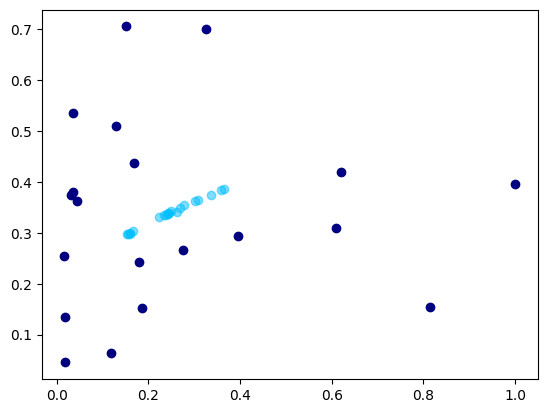

  8%|██████                                                                           | 75/1000 [00:13<02:39,  5.80it/s]

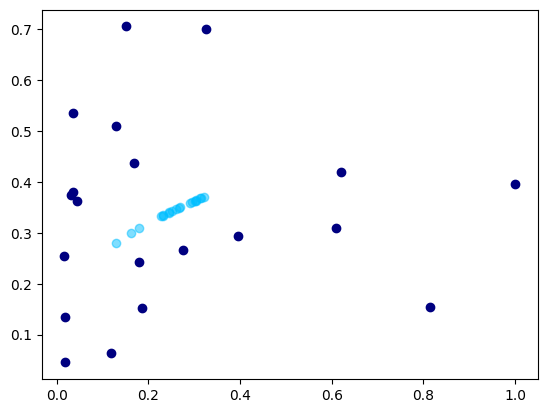

  8%|██████▏                                                                          | 76/1000 [00:13<02:38,  5.81it/s]

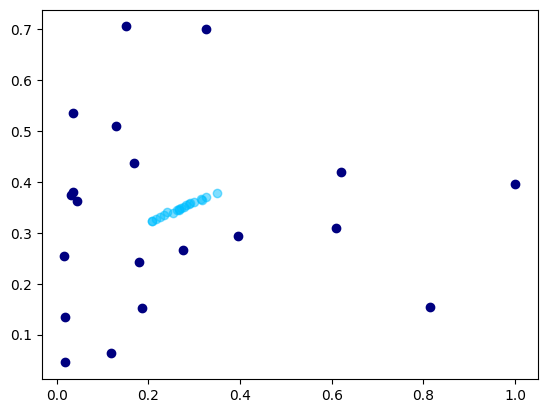

  8%|██████▏                                                                          | 77/1000 [00:13<02:38,  5.81it/s]

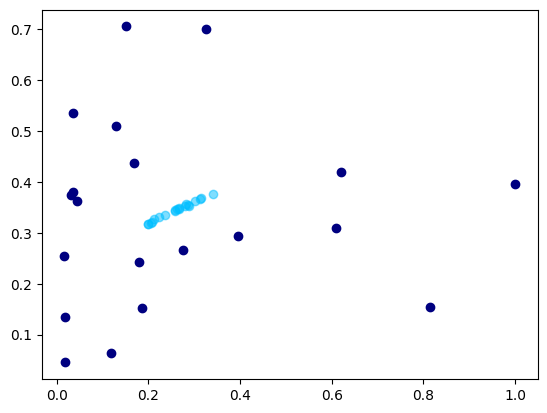

  8%|██████▎                                                                          | 78/1000 [00:13<02:37,  5.86it/s]

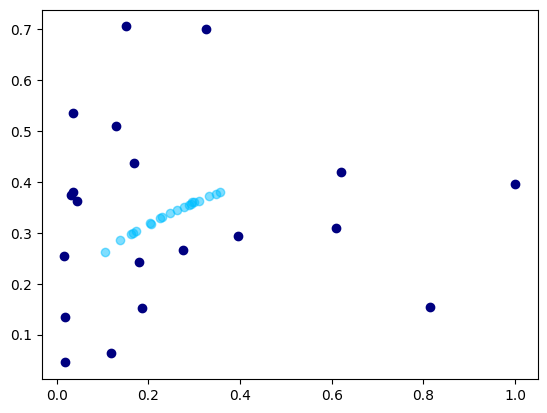

  8%|██████▍                                                                          | 79/1000 [00:13<02:35,  5.92it/s]

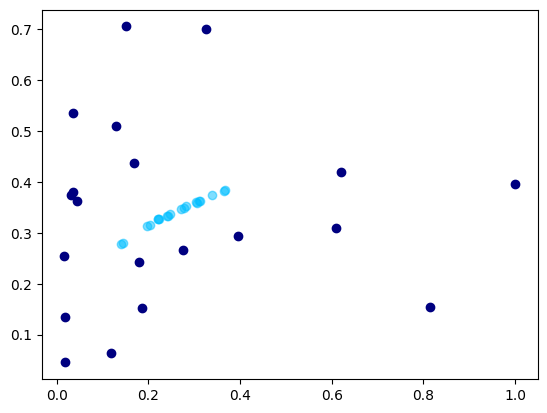

  8%|██████▍                                                                          | 80/1000 [00:14<02:39,  5.78it/s]

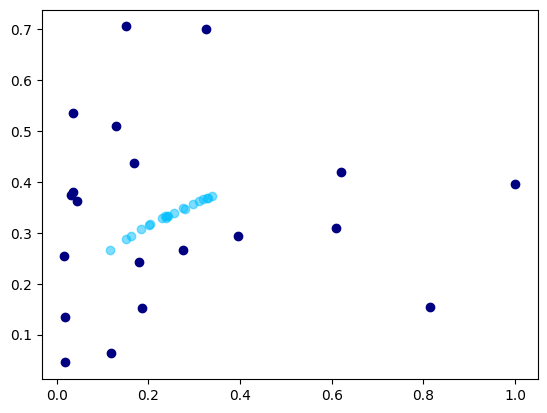

  8%|██████▌                                                                          | 81/1000 [00:14<02:36,  5.86it/s]

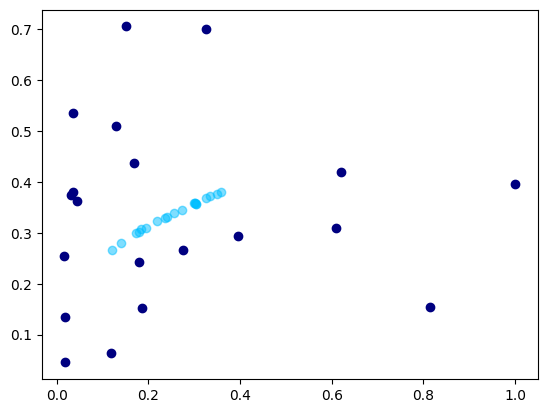

  8%|██████▋                                                                          | 82/1000 [00:14<02:36,  5.88it/s]

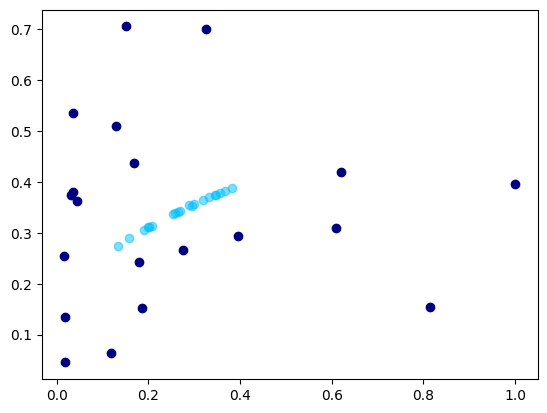

  8%|██████▋                                                                          | 83/1000 [00:14<02:39,  5.75it/s]

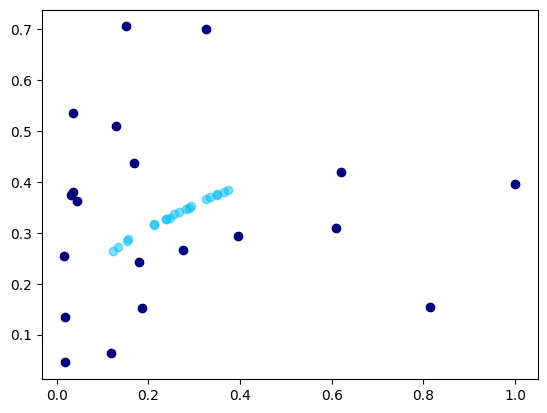

  8%|██████▊                                                                          | 84/1000 [00:14<02:40,  5.71it/s]

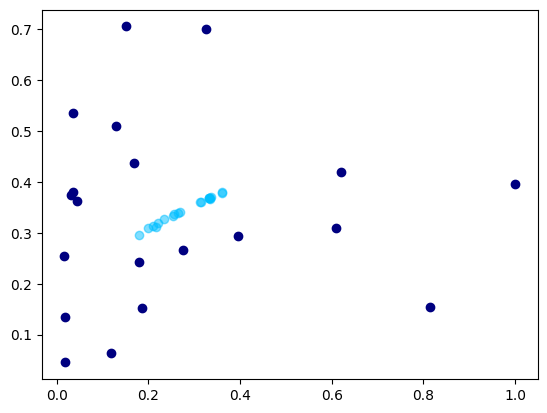

  8%|██████▉                                                                          | 85/1000 [00:14<02:40,  5.71it/s]

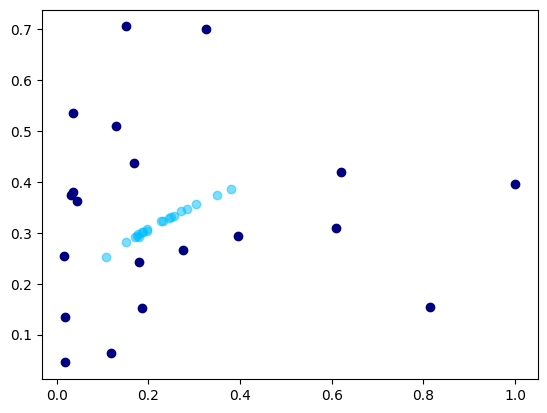

  9%|██████▉                                                                          | 86/1000 [00:15<02:41,  5.65it/s]

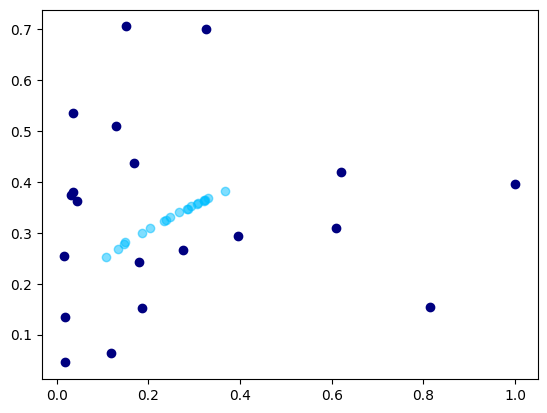

  9%|███████                                                                          | 87/1000 [00:15<02:52,  5.30it/s]

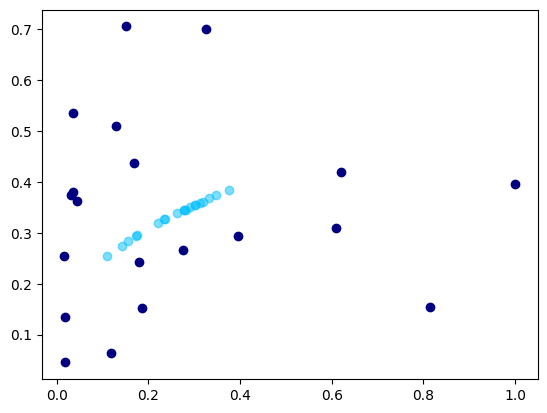

  9%|███████▏                                                                         | 88/1000 [00:15<02:48,  5.40it/s]

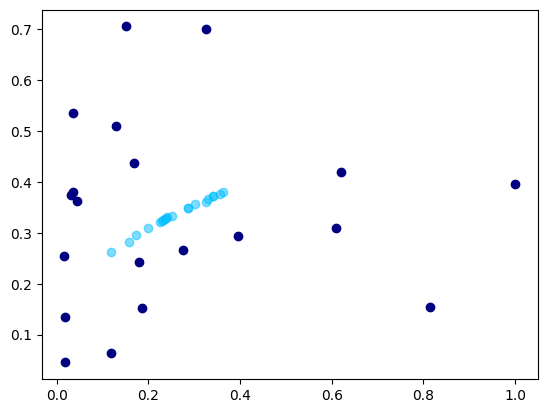

  9%|███████▏                                                                         | 89/1000 [00:15<02:46,  5.48it/s]

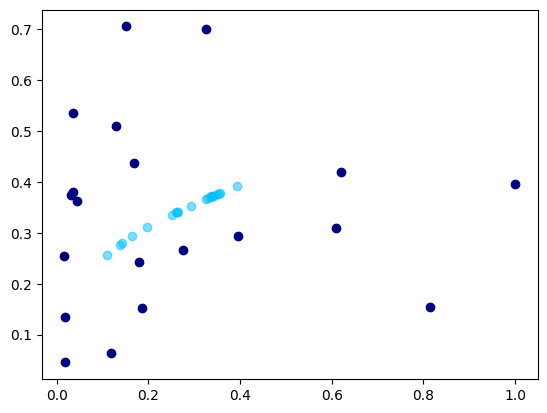

  9%|███████▎                                                                         | 90/1000 [00:15<02:42,  5.58it/s]

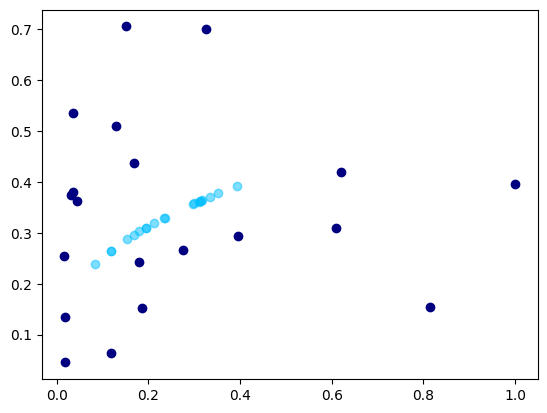

  9%|███████▎                                                                         | 91/1000 [00:16<02:39,  5.69it/s]

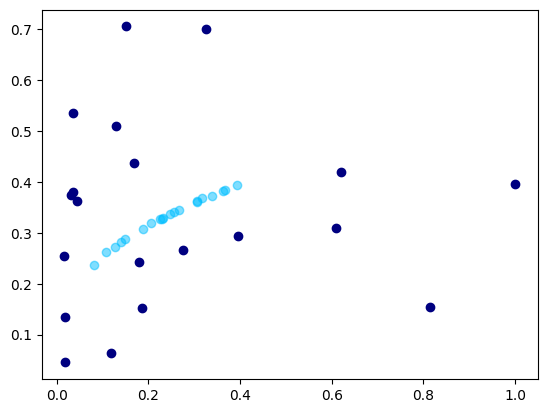

  9%|███████▍                                                                         | 92/1000 [00:16<02:39,  5.70it/s]

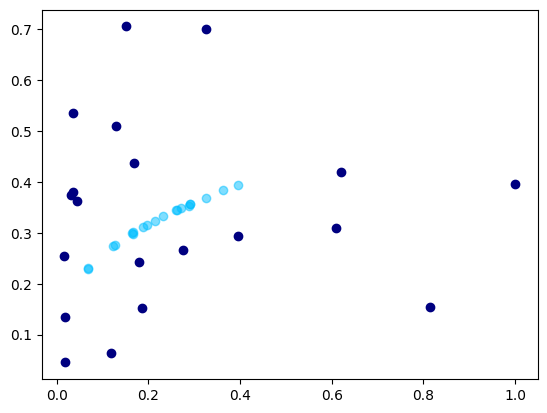

  9%|███████▌                                                                         | 93/1000 [00:16<02:41,  5.60it/s]

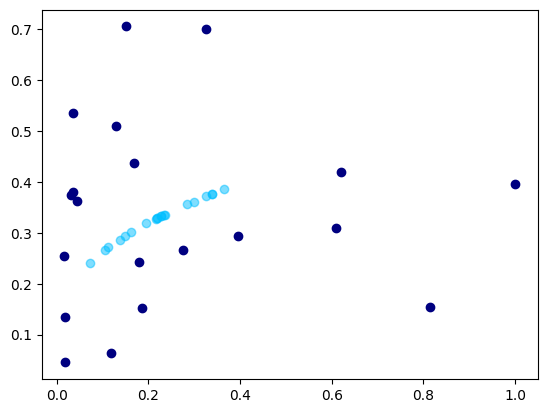

  9%|███████▌                                                                         | 94/1000 [00:16<02:41,  5.60it/s]

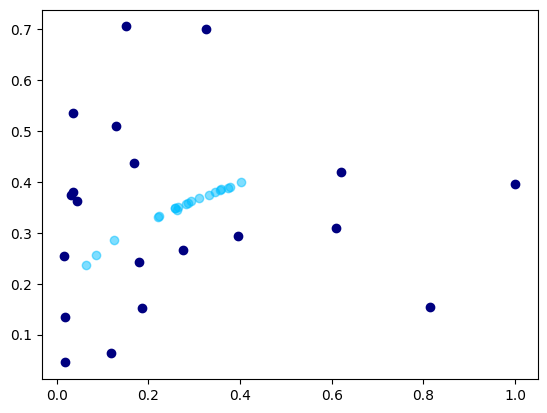

 10%|███████▋                                                                         | 95/1000 [00:16<02:40,  5.65it/s]

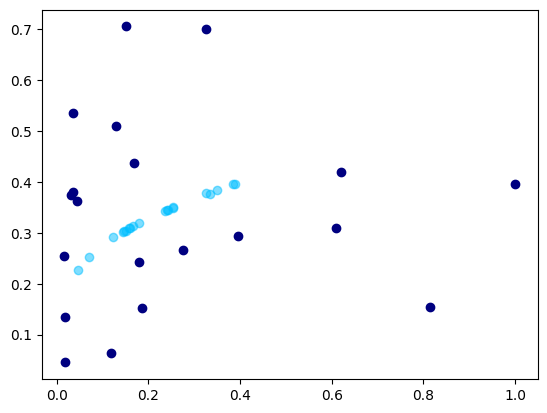

 10%|███████▊                                                                         | 96/1000 [00:16<02:38,  5.69it/s]

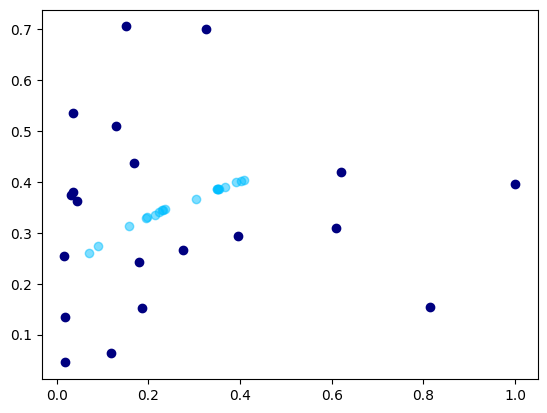

 10%|███████▊                                                                         | 97/1000 [00:17<02:39,  5.65it/s]

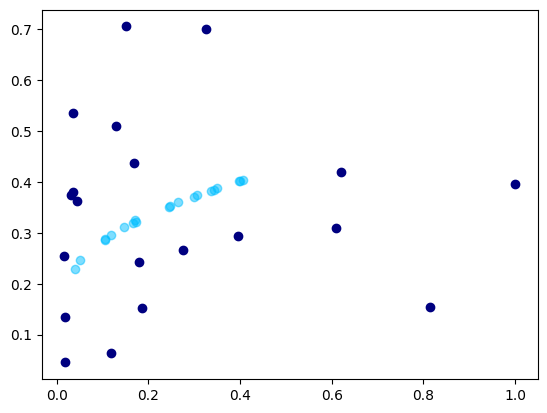

 10%|███████▉                                                                         | 98/1000 [00:17<02:38,  5.67it/s]

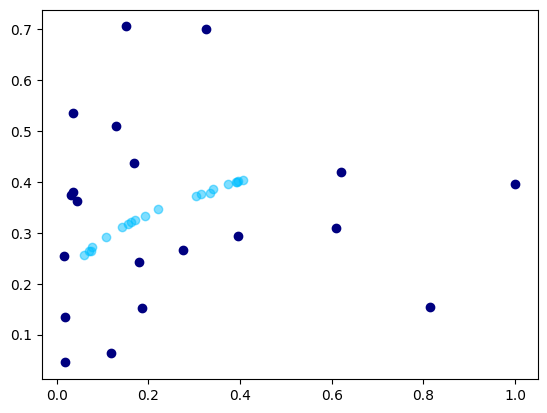

 10%|████████                                                                         | 99/1000 [00:17<02:41,  5.59it/s]

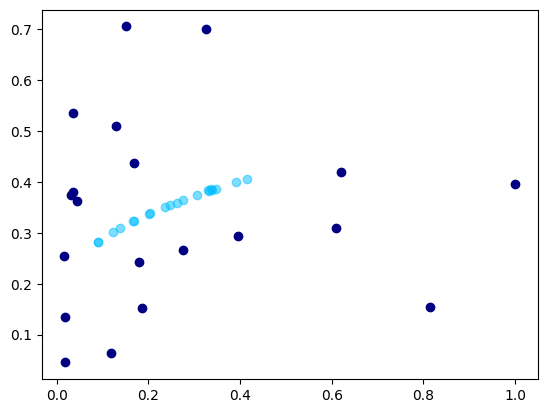

 10%|████████                                                                        | 100/1000 [00:17<02:39,  5.65it/s]

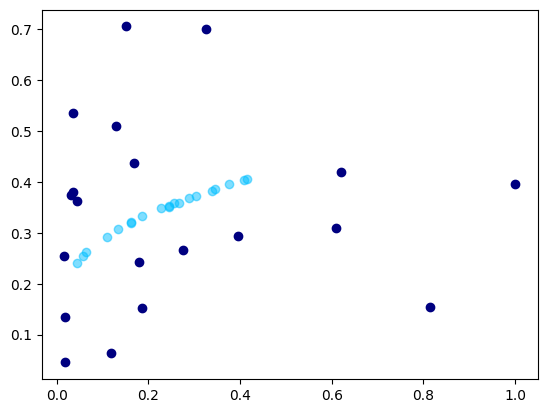

 10%|████████                                                                        | 101/1000 [00:17<02:36,  5.73it/s]

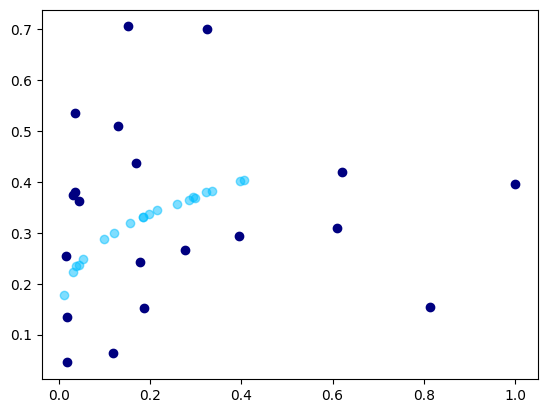

 10%|████████▏                                                                       | 102/1000 [00:18<02:37,  5.70it/s]

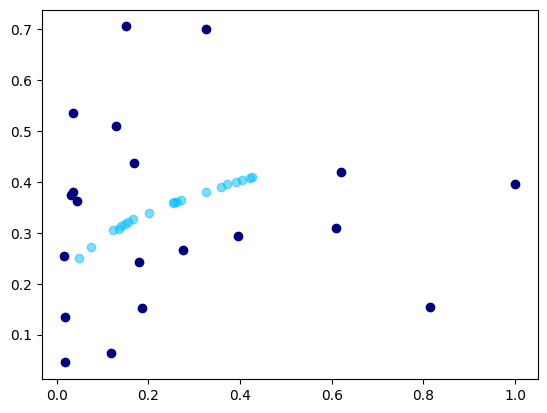

 10%|████████▏                                                                       | 103/1000 [00:18<02:37,  5.71it/s]

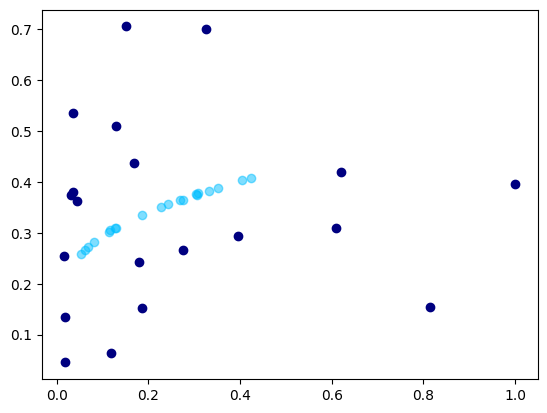

 10%|████████▎                                                                       | 104/1000 [00:18<02:36,  5.72it/s]

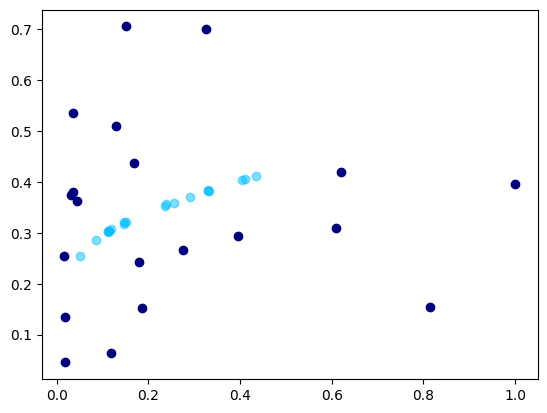

 10%|████████▍                                                                       | 105/1000 [00:19<04:57,  3.01it/s]

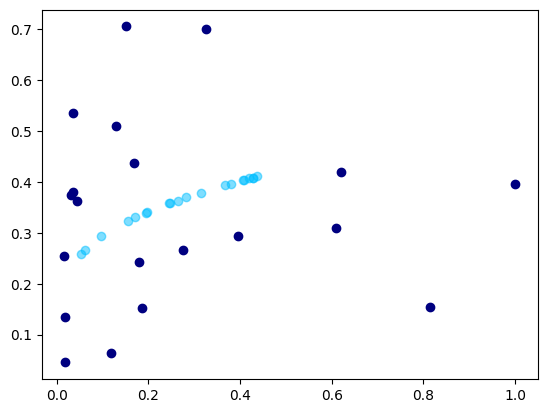

 11%|████████▍                                                                       | 106/1000 [00:19<04:16,  3.48it/s]

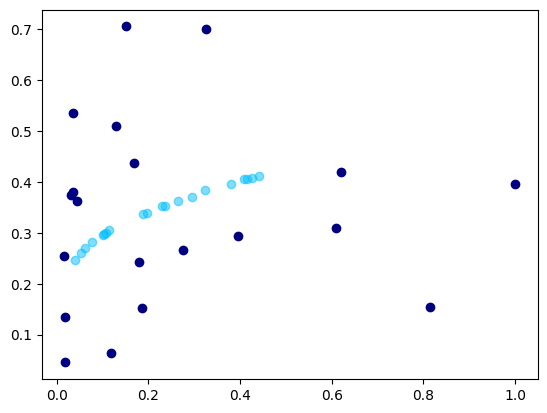

 11%|████████▌                                                                       | 107/1000 [00:19<03:51,  3.86it/s]

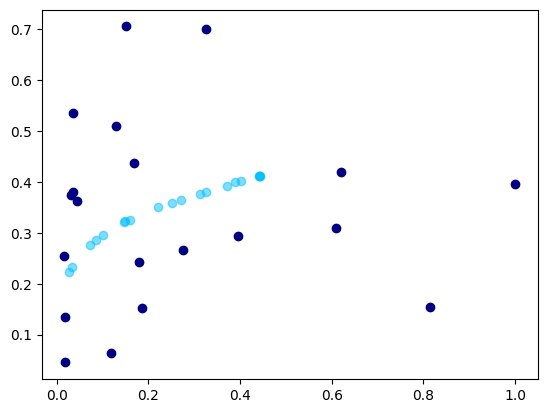

 11%|████████▋                                                                       | 108/1000 [00:19<03:27,  4.30it/s]

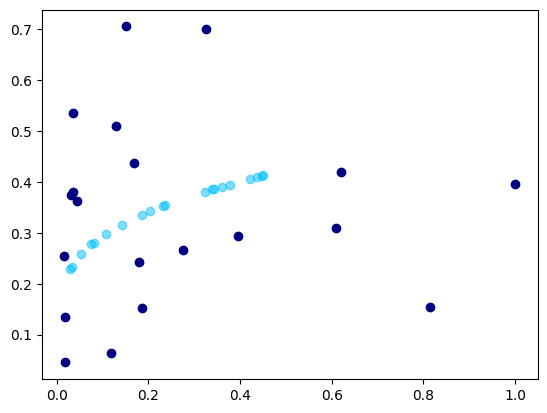

 11%|████████▋                                                                       | 109/1000 [00:19<03:14,  4.59it/s]

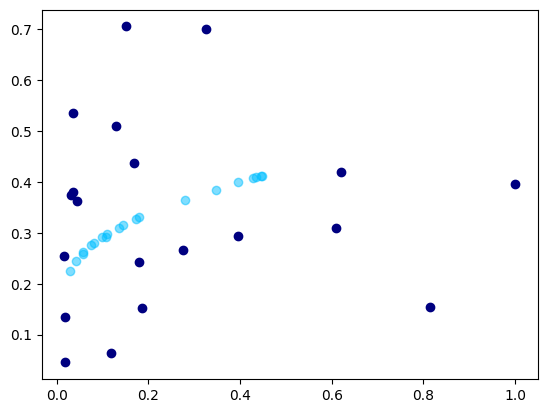

 11%|████████▊                                                                       | 110/1000 [00:19<03:02,  4.88it/s]

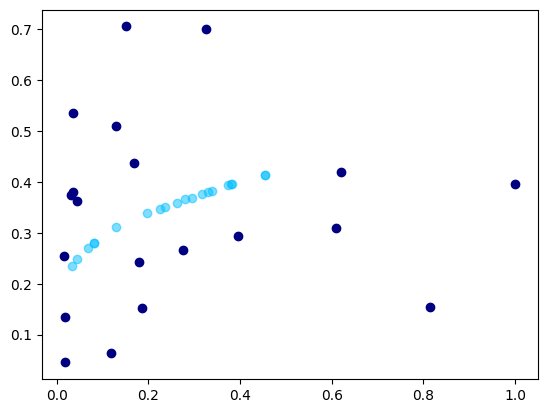

 11%|████████▉                                                                       | 111/1000 [00:20<02:56,  5.03it/s]

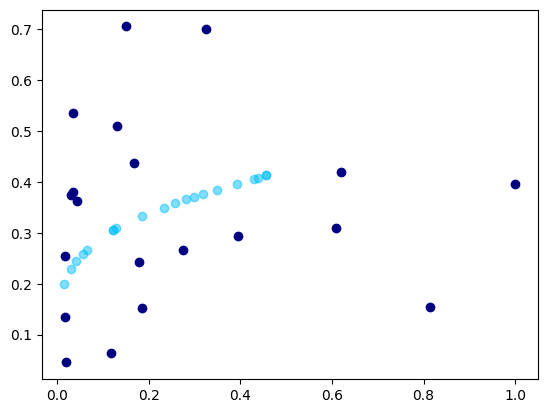

 11%|████████▉                                                                       | 112/1000 [00:20<02:49,  5.22it/s]

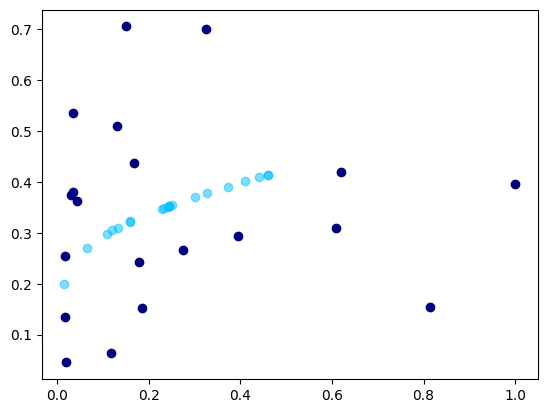

 11%|█████████                                                                       | 113/1000 [00:20<02:48,  5.27it/s]

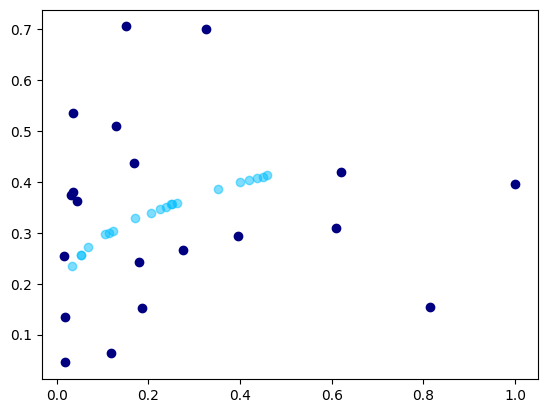

 11%|█████████                                                                       | 114/1000 [00:20<02:48,  5.27it/s]

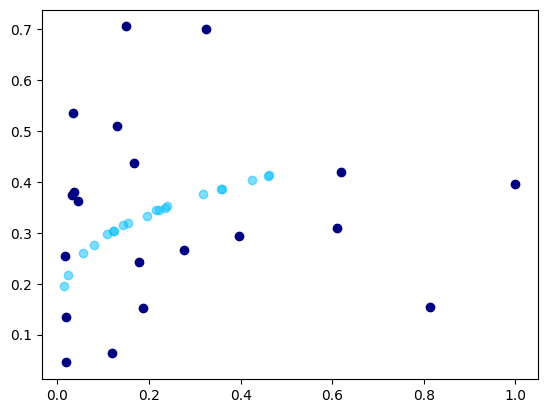

 12%|█████████▏                                                                      | 115/1000 [00:20<02:49,  5.21it/s]

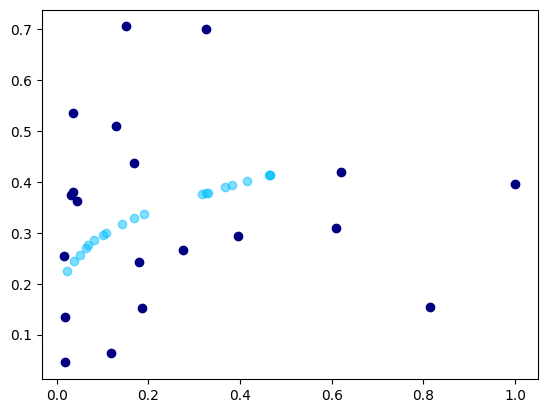

 12%|█████████▎                                                                      | 116/1000 [00:21<02:45,  5.33it/s]

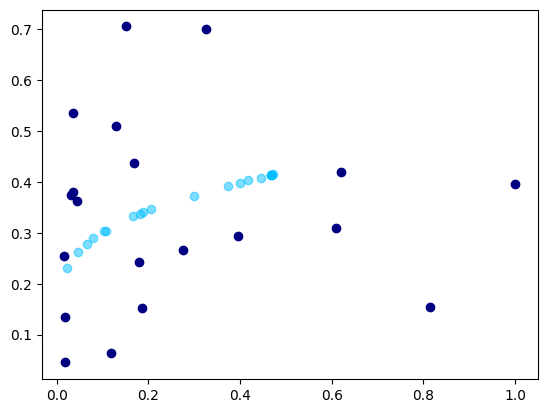

 12%|█████████▎                                                                      | 117/1000 [00:21<02:43,  5.42it/s]

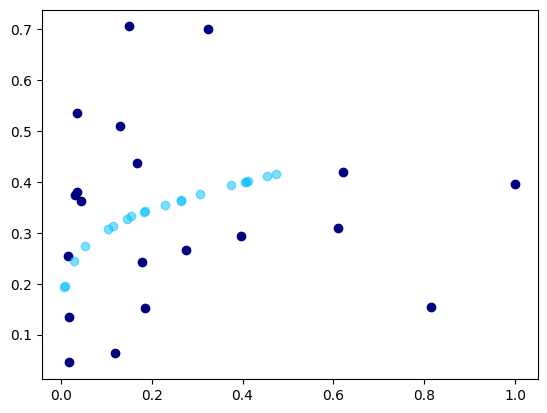

 12%|█████████▍                                                                      | 118/1000 [00:21<02:41,  5.46it/s]

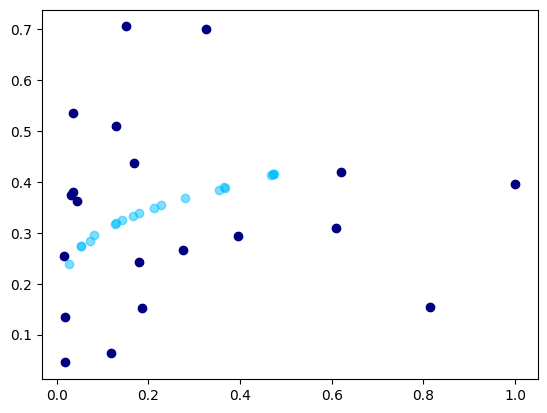

 12%|█████████▌                                                                      | 119/1000 [00:21<02:43,  5.39it/s]

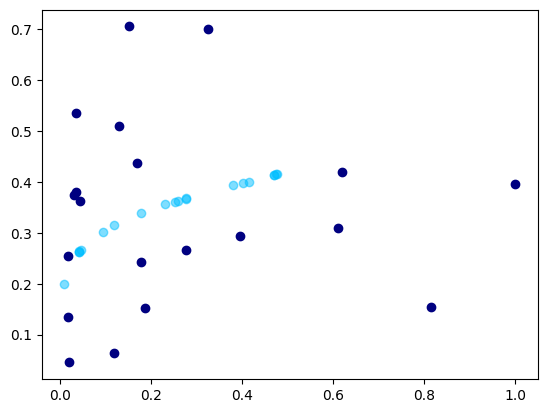

 12%|█████████▌                                                                      | 120/1000 [00:21<02:40,  5.47it/s]

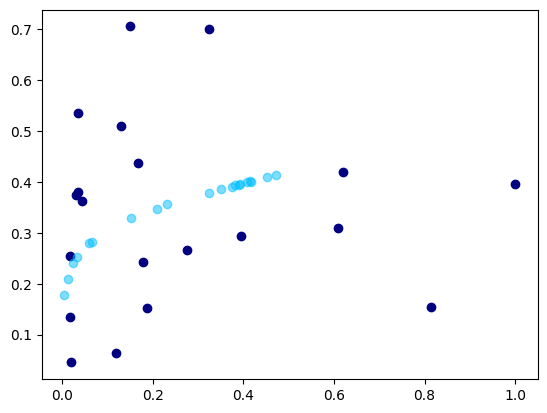

 12%|█████████▋                                                                      | 121/1000 [00:22<02:46,  5.27it/s]

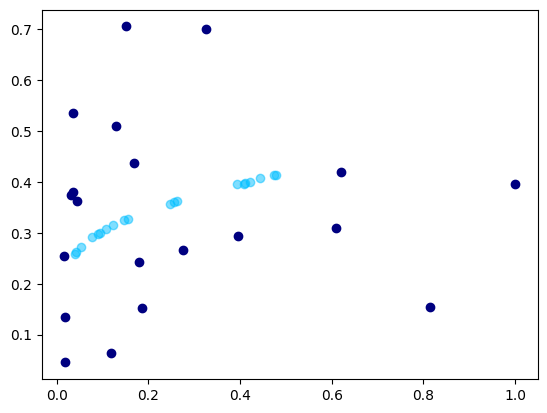

 12%|█████████▊                                                                      | 122/1000 [00:22<02:45,  5.29it/s]

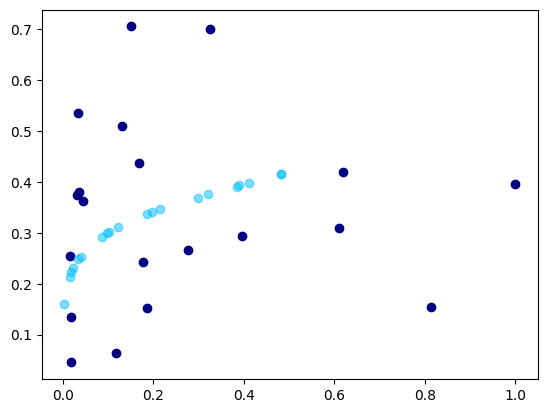

 12%|█████████▊                                                                      | 123/1000 [00:22<02:44,  5.32it/s]

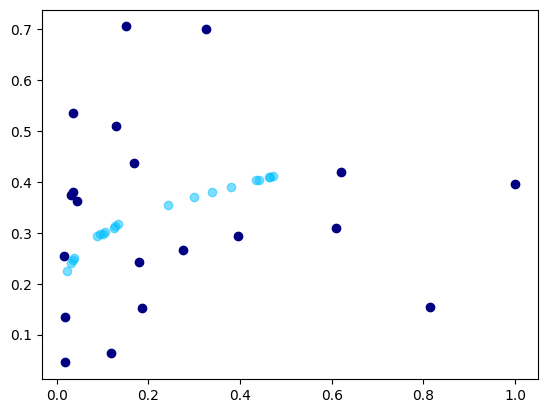

 12%|█████████▉                                                                      | 124/1000 [00:22<02:42,  5.39it/s]

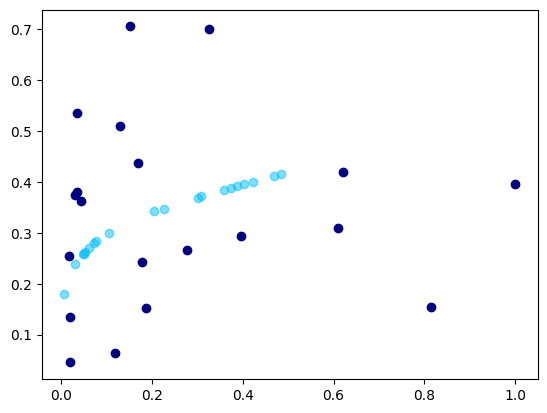

 12%|██████████                                                                      | 125/1000 [00:22<02:40,  5.45it/s]

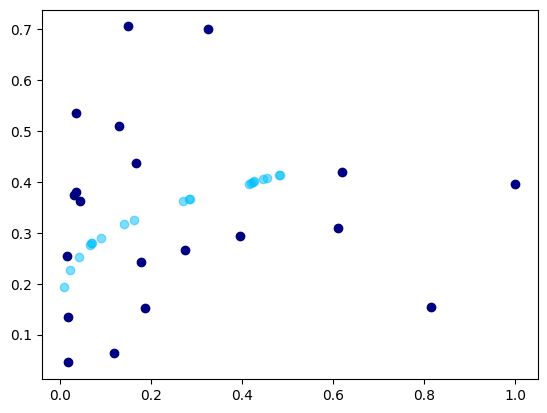

 13%|██████████                                                                      | 126/1000 [00:22<02:37,  5.54it/s]

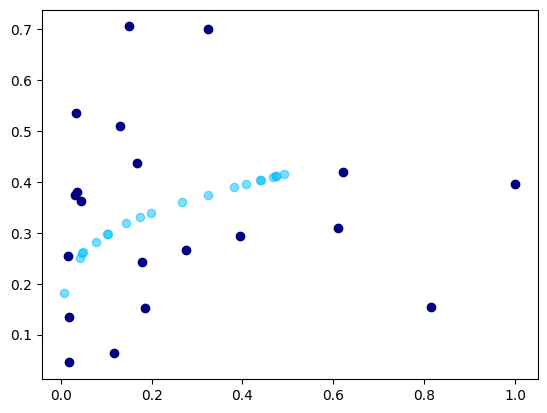

 13%|██████████▏                                                                     | 127/1000 [00:23<02:38,  5.51it/s]

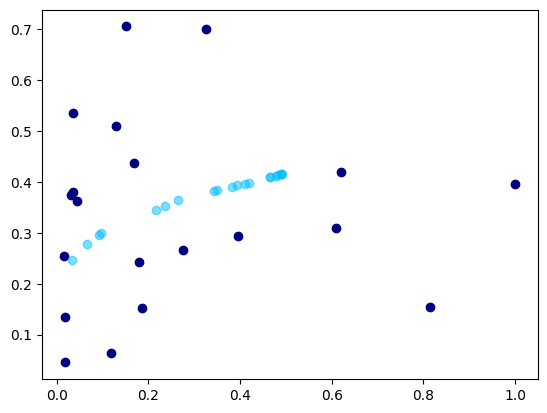

 13%|██████████▏                                                                     | 128/1000 [00:23<02:42,  5.37it/s]

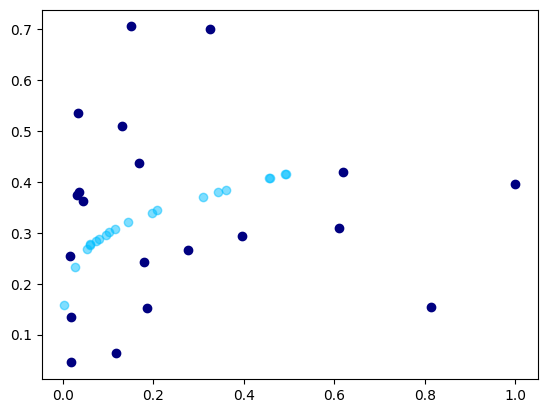

 13%|██████████▎                                                                     | 129/1000 [00:23<02:39,  5.45it/s]

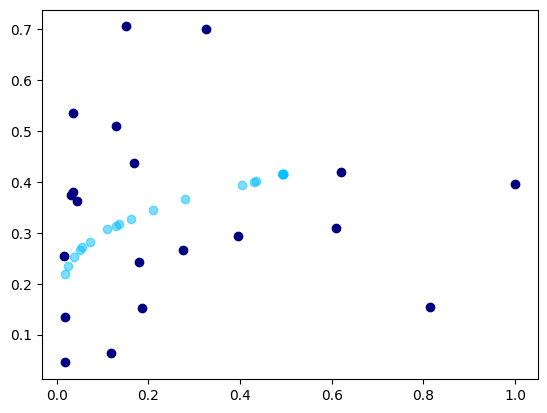

 13%|██████████▍                                                                     | 130/1000 [00:23<02:35,  5.60it/s]

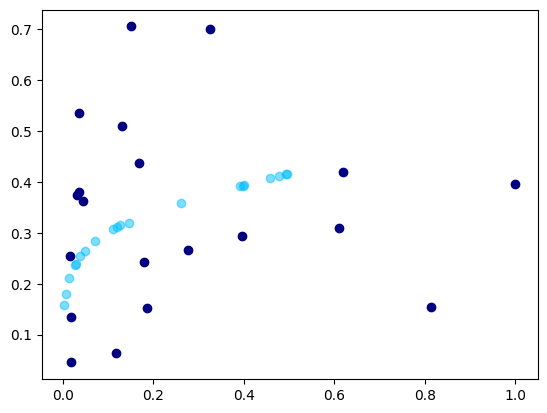

 13%|██████████▍                                                                     | 131/1000 [00:23<02:37,  5.53it/s]

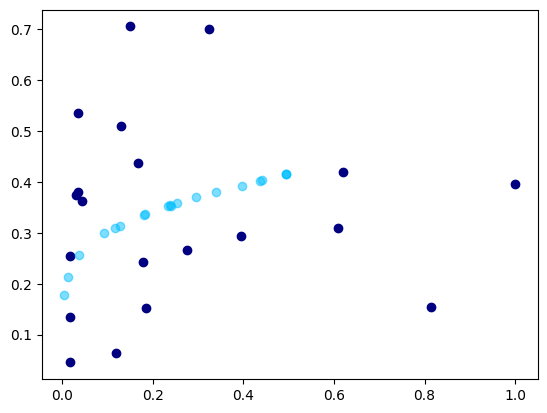

 13%|██████████▌                                                                     | 132/1000 [00:24<02:34,  5.60it/s]

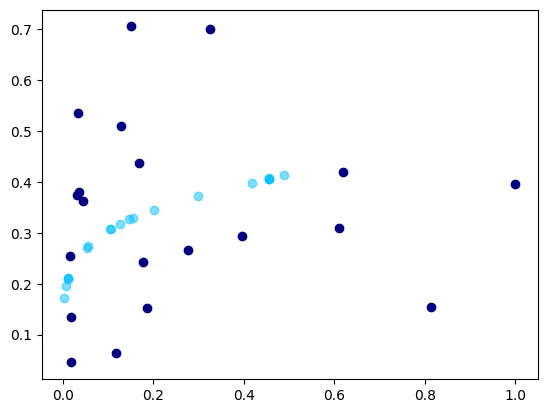

 13%|██████████▋                                                                     | 133/1000 [00:24<02:36,  5.55it/s]

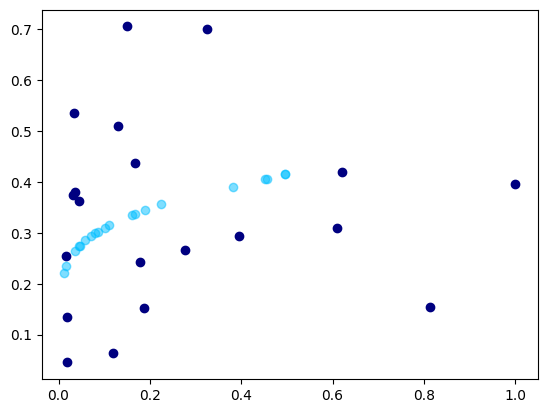

 13%|██████████▋                                                                     | 134/1000 [00:24<02:34,  5.61it/s]

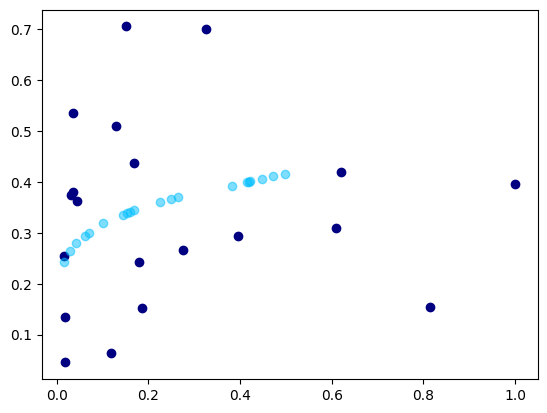

 14%|██████████▊                                                                     | 135/1000 [00:24<02:34,  5.60it/s]

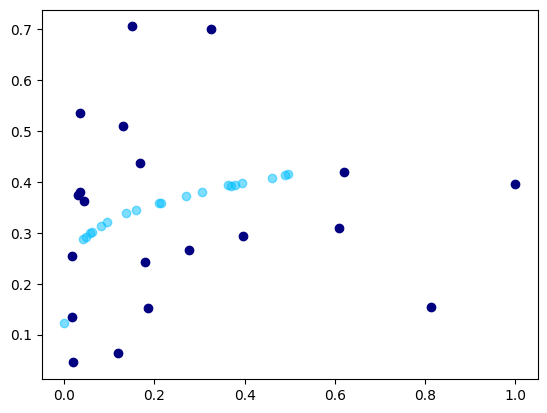

 14%|██████████▉                                                                     | 136/1000 [00:24<02:40,  5.38it/s]

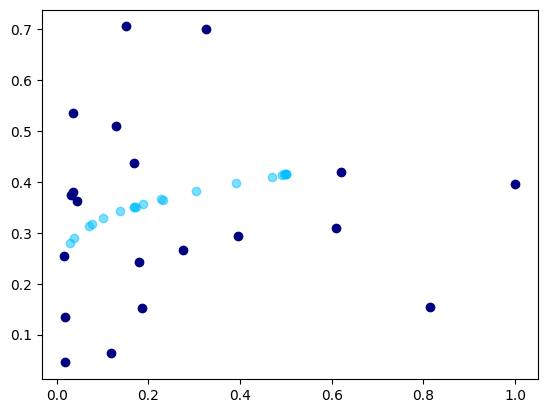

 14%|██████████▉                                                                     | 137/1000 [00:24<02:43,  5.28it/s]

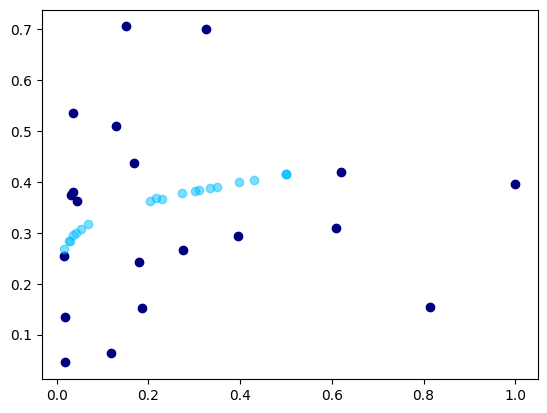

 14%|███████████                                                                     | 138/1000 [00:25<02:42,  5.31it/s]

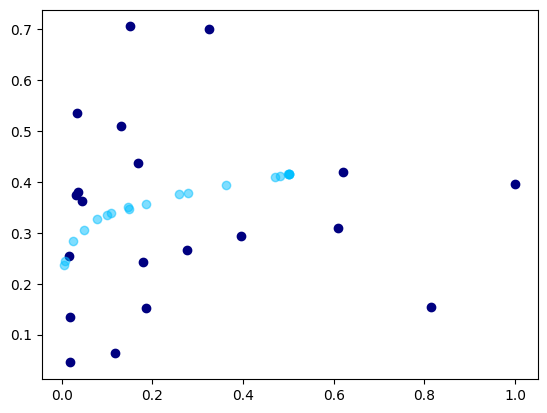

 14%|███████████                                                                     | 139/1000 [00:25<02:38,  5.44it/s]

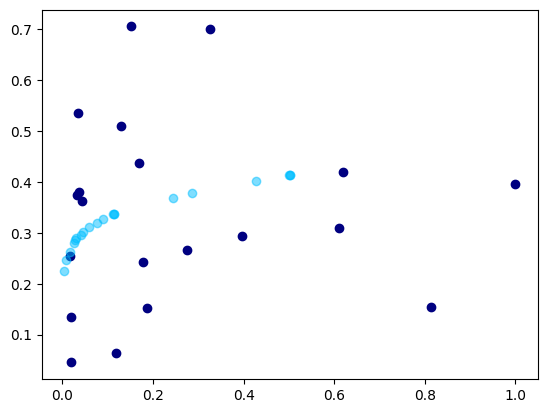

 14%|███████████▏                                                                    | 140/1000 [00:25<02:39,  5.39it/s]

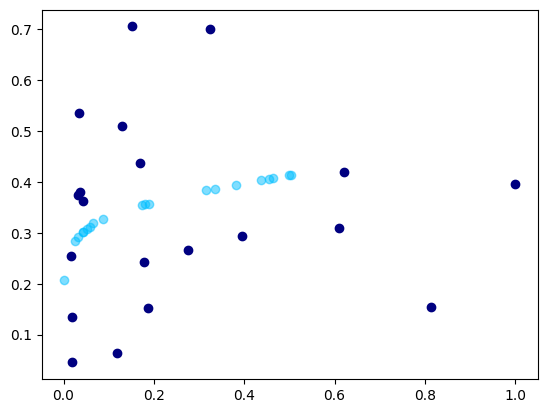

 14%|███████████▎                                                                    | 141/1000 [00:25<02:35,  5.51it/s]

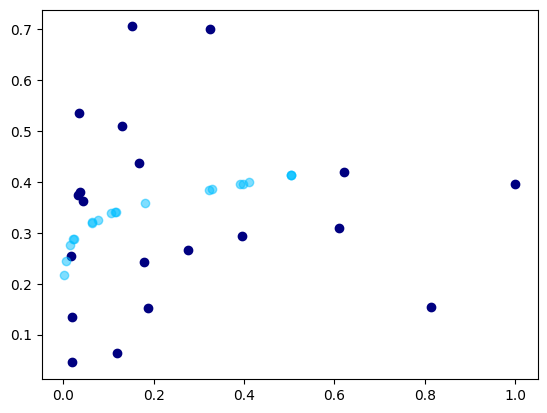

 14%|███████████▎                                                                    | 142/1000 [00:25<02:35,  5.52it/s]

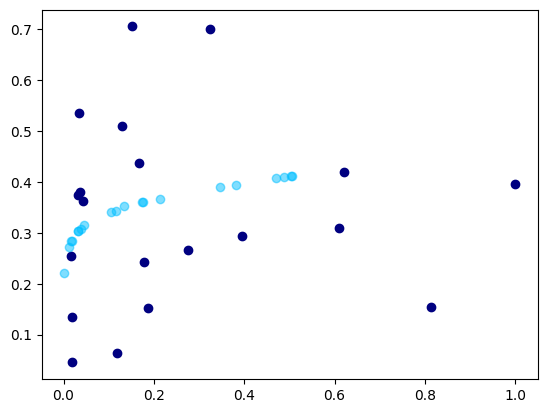

 14%|███████████▍                                                                    | 143/1000 [00:26<02:35,  5.51it/s]

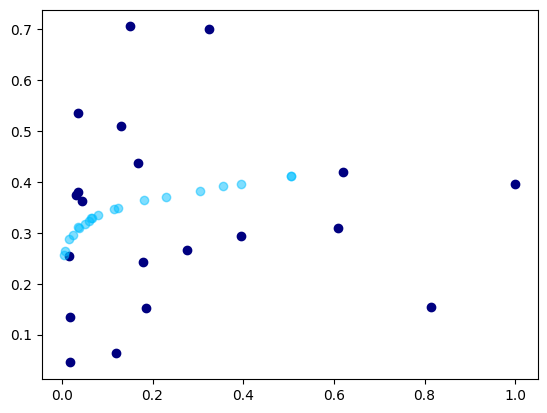

 14%|███████████▌                                                                    | 144/1000 [00:26<02:33,  5.56it/s]

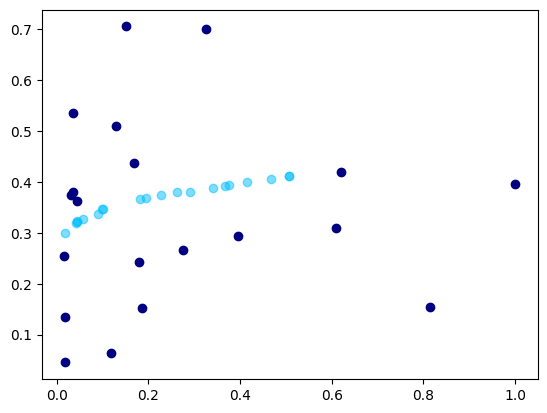

 14%|███████████▌                                                                    | 145/1000 [00:26<02:32,  5.60it/s]

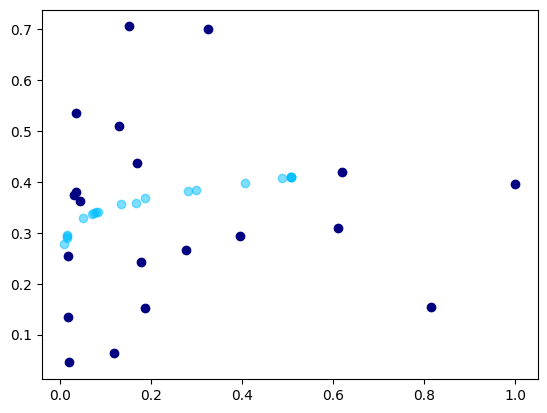

 15%|███████████▋                                                                    | 146/1000 [00:26<02:31,  5.63it/s]

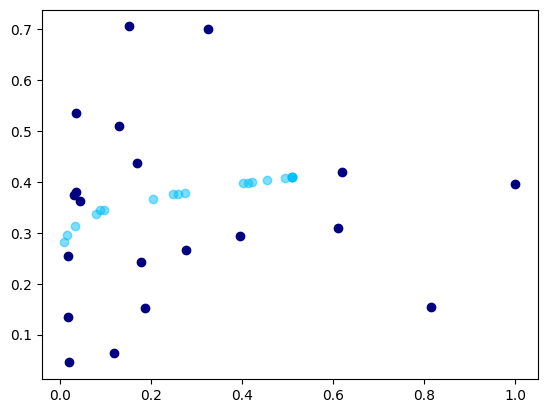

 15%|███████████▊                                                                    | 147/1000 [00:26<02:30,  5.66it/s]

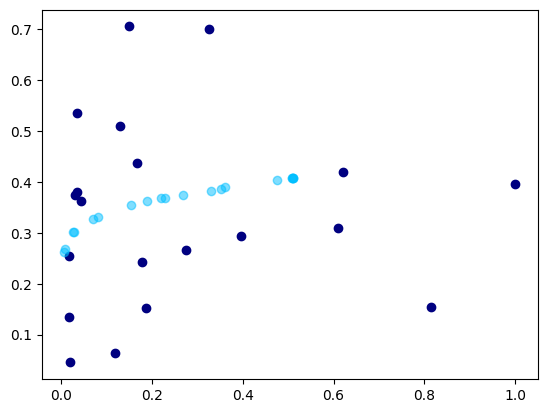

 15%|███████████▊                                                                    | 148/1000 [00:26<02:29,  5.69it/s]

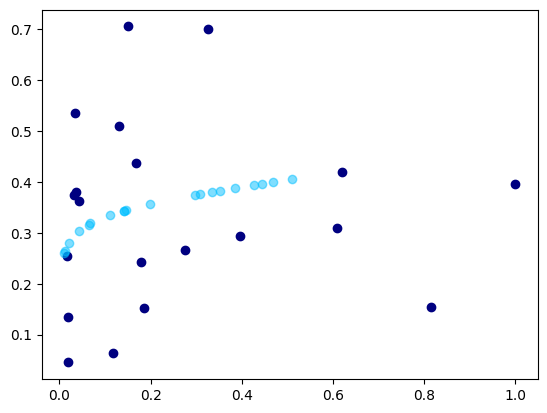

 15%|███████████▉                                                                    | 149/1000 [00:27<02:34,  5.52it/s]

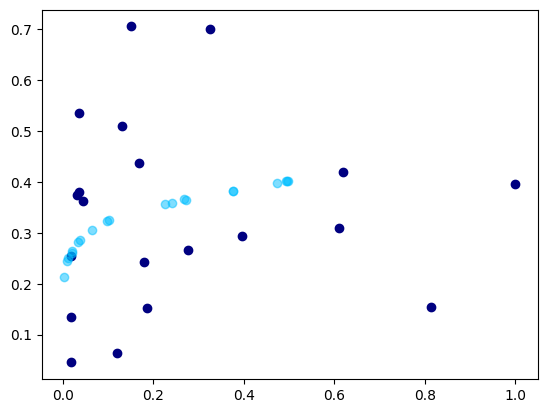

 15%|████████████                                                                    | 150/1000 [00:27<02:34,  5.49it/s]

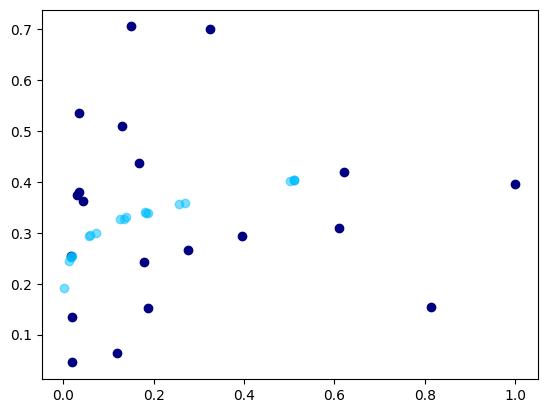

 15%|████████████                                                                    | 151/1000 [00:27<02:33,  5.53it/s]

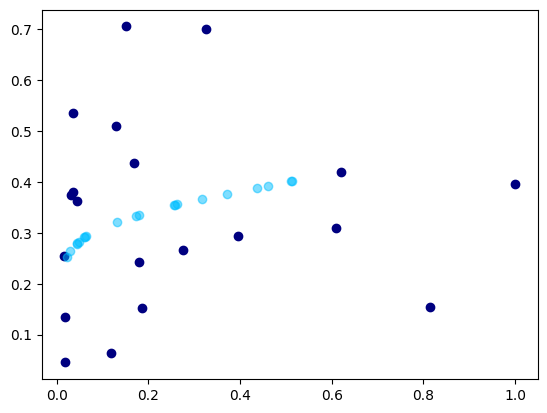

 15%|████████████▏                                                                   | 152/1000 [00:27<02:31,  5.59it/s]

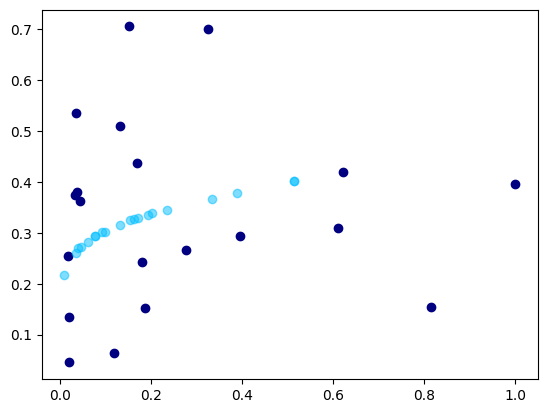

 15%|████████████▏                                                                   | 153/1000 [00:27<02:28,  5.70it/s]

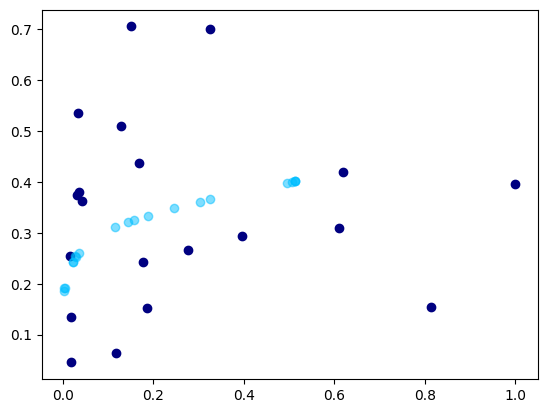

 15%|████████████▎                                                                   | 154/1000 [00:27<02:29,  5.66it/s]

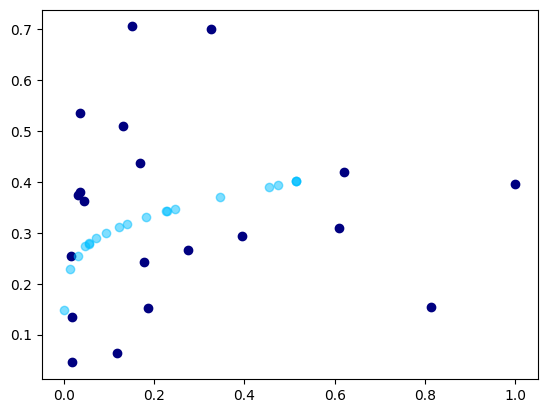

 16%|████████████▍                                                                   | 155/1000 [00:28<02:29,  5.66it/s]

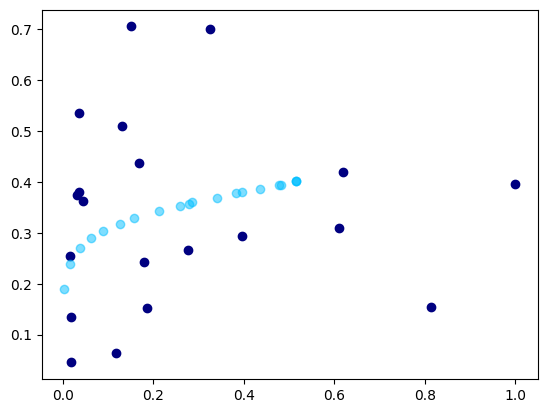

 16%|████████████▍                                                                   | 156/1000 [00:28<02:28,  5.70it/s]

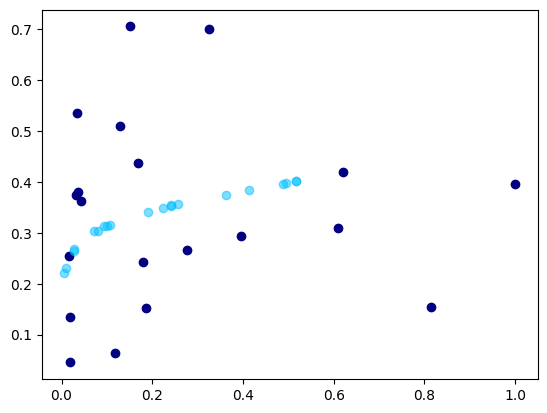

 16%|████████████▌                                                                   | 157/1000 [00:28<02:26,  5.75it/s]

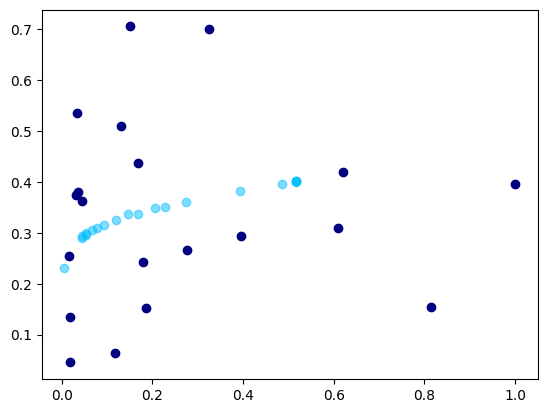

 16%|████████████▋                                                                   | 158/1000 [00:28<02:27,  5.70it/s]

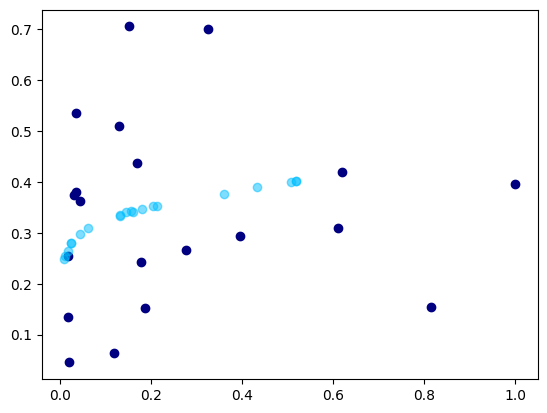

 16%|████████████▋                                                                   | 159/1000 [00:28<02:30,  5.58it/s]

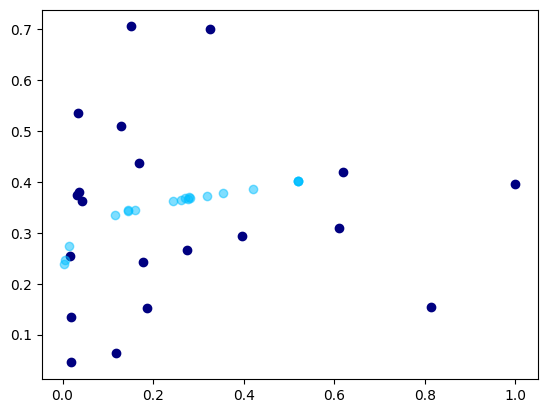

 16%|████████████▊                                                                   | 160/1000 [00:29<02:34,  5.45it/s]

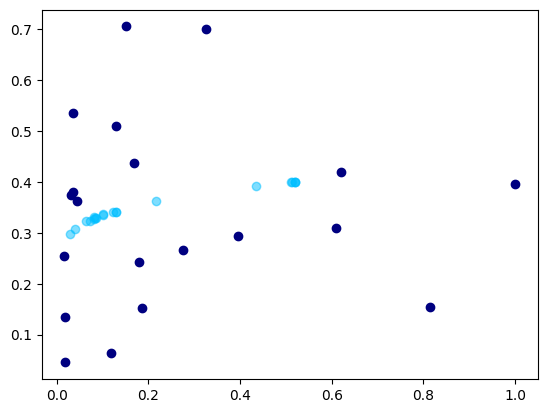

 16%|████████████▉                                                                   | 161/1000 [00:29<02:32,  5.49it/s]

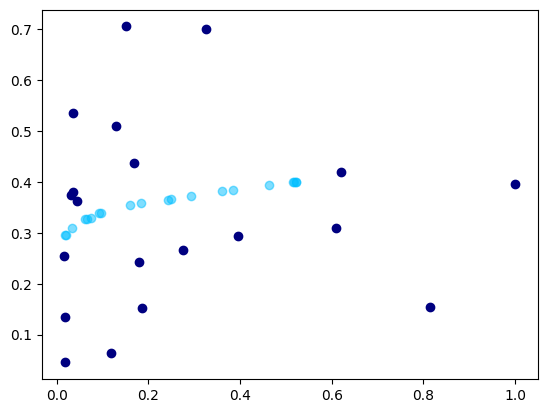

 16%|████████████▉                                                                   | 162/1000 [00:29<02:30,  5.55it/s]

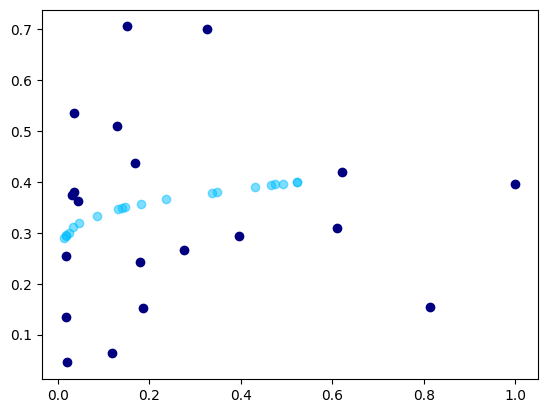

 16%|█████████████                                                                   | 163/1000 [00:29<02:32,  5.48it/s]

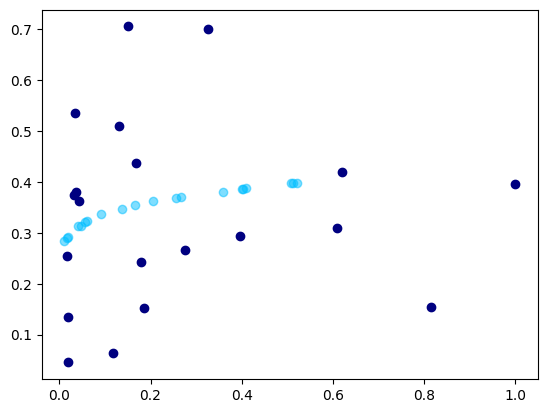

 16%|█████████████                                                                   | 164/1000 [00:29<02:28,  5.62it/s]

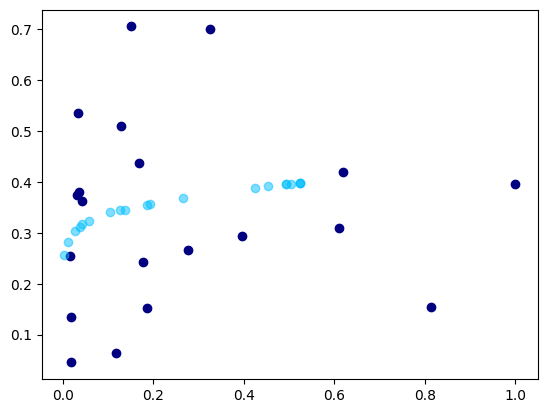

 16%|█████████████▏                                                                  | 165/1000 [00:29<02:25,  5.75it/s]

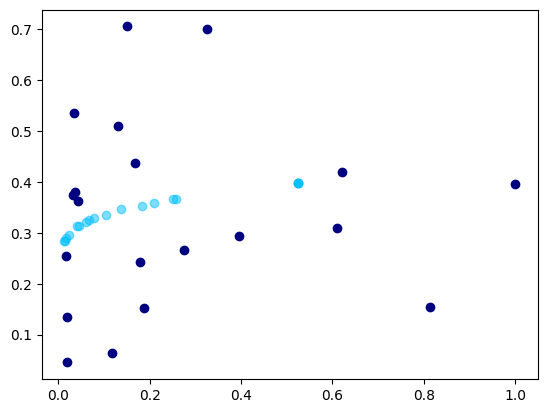

 17%|█████████████▎                                                                  | 166/1000 [00:30<02:29,  5.58it/s]

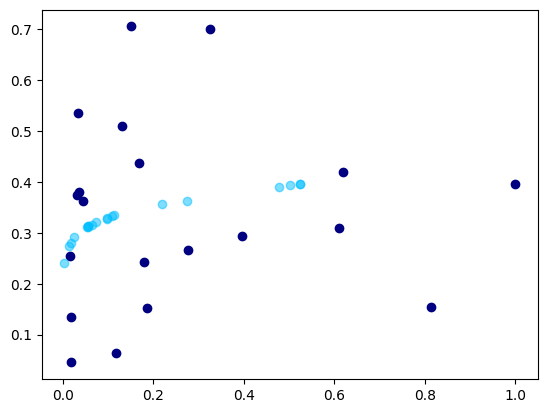

 17%|█████████████▎                                                                  | 167/1000 [00:30<02:28,  5.62it/s]

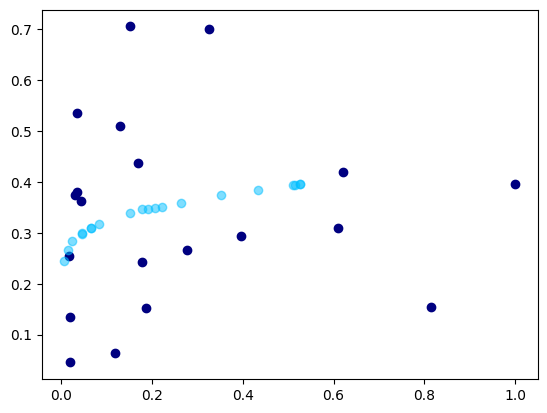

 17%|█████████████▍                                                                  | 168/1000 [00:30<02:25,  5.74it/s]

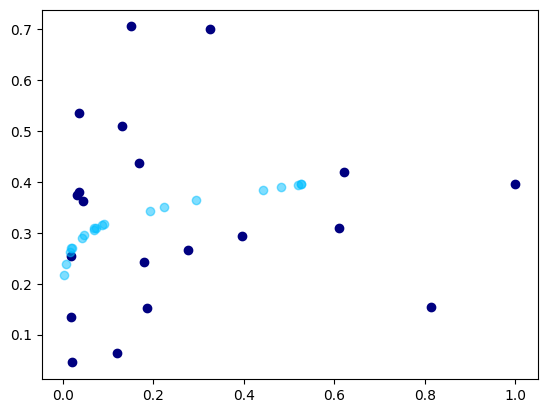

 17%|█████████████▌                                                                  | 169/1000 [00:30<02:26,  5.67it/s]

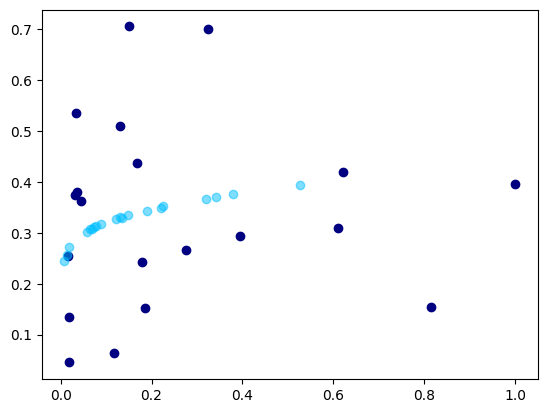

 17%|█████████████▌                                                                  | 170/1000 [00:30<02:33,  5.42it/s]

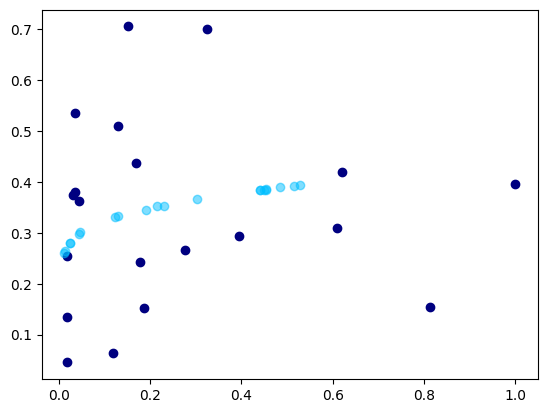

 17%|█████████████▋                                                                  | 171/1000 [00:31<02:30,  5.50it/s]

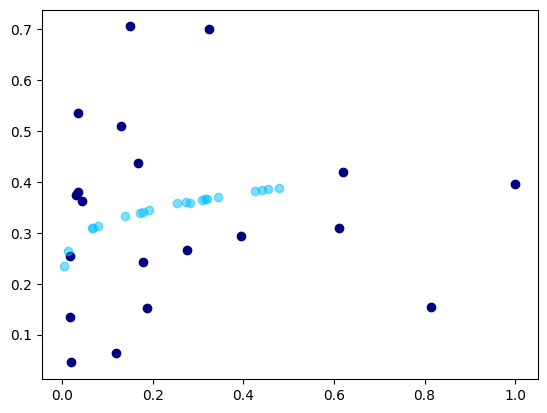

 17%|█████████████▊                                                                  | 172/1000 [00:31<02:28,  5.59it/s]

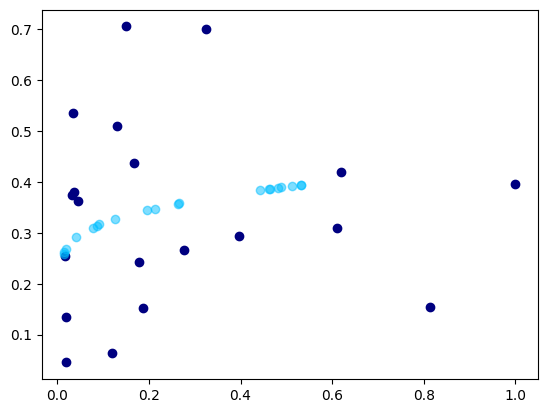

 17%|█████████████▊                                                                  | 173/1000 [00:31<02:26,  5.66it/s]

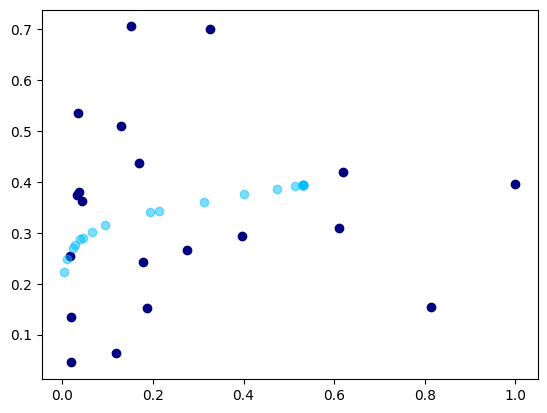

 17%|█████████████▉                                                                  | 174/1000 [00:31<02:22,  5.80it/s]

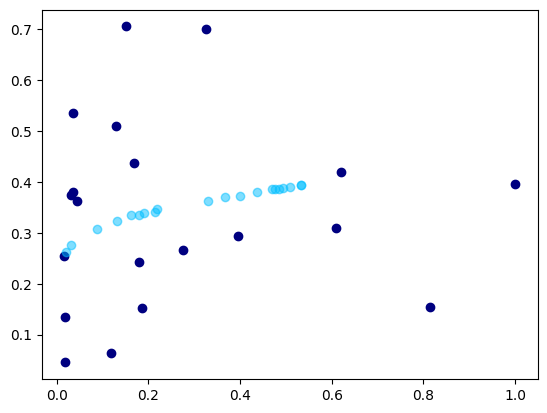

 18%|██████████████                                                                  | 175/1000 [00:31<02:21,  5.84it/s]

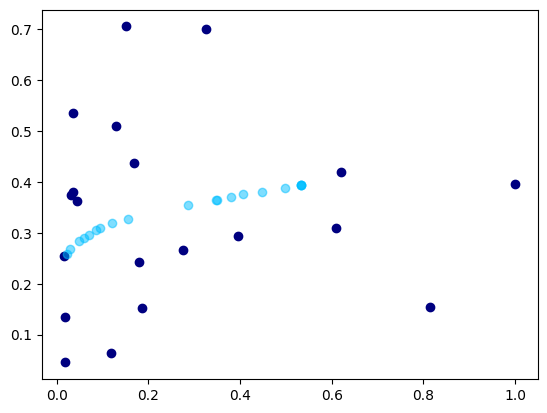

 18%|██████████████                                                                  | 176/1000 [00:31<02:19,  5.90it/s]

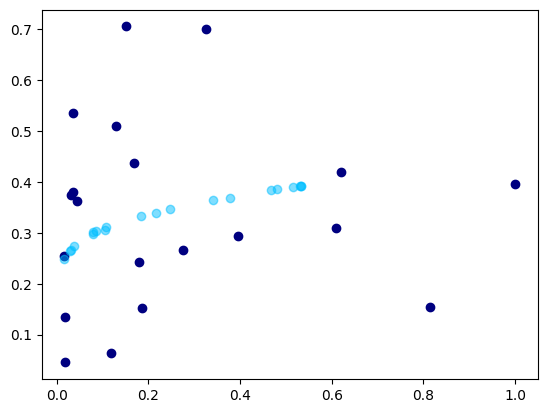

 18%|██████████████▏                                                                 | 177/1000 [00:32<02:19,  5.89it/s]

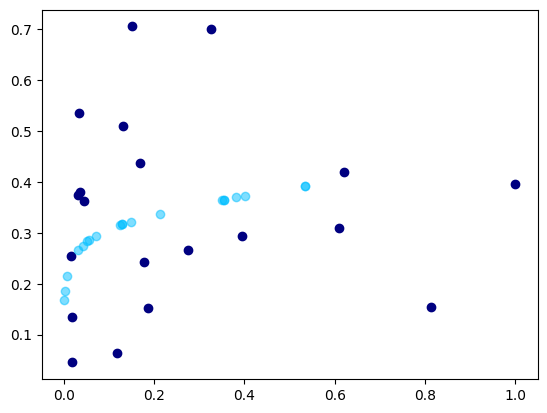

 18%|██████████████▏                                                                 | 178/1000 [00:32<02:31,  5.44it/s]

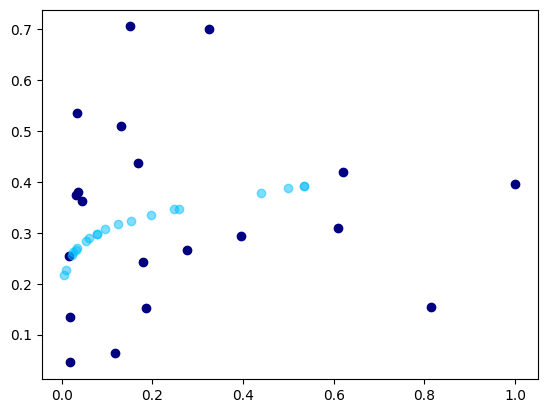

 18%|██████████████▎                                                                 | 179/1000 [00:32<02:33,  5.36it/s]

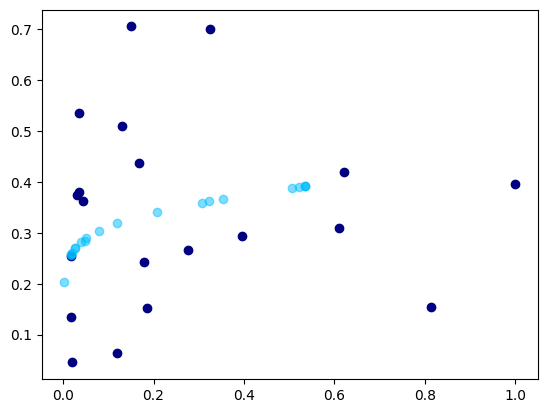

 18%|██████████████▍                                                                 | 180/1000 [00:32<02:30,  5.45it/s]

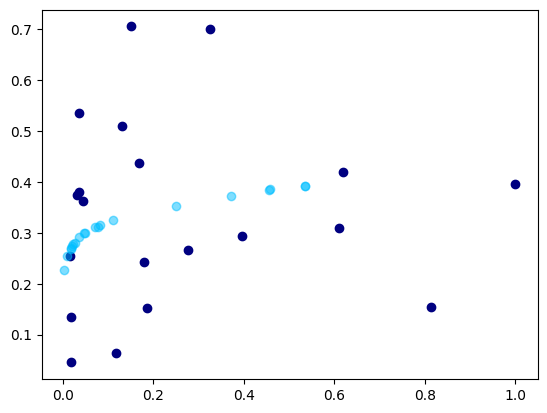

 18%|██████████████▍                                                                 | 181/1000 [00:32<02:25,  5.61it/s]

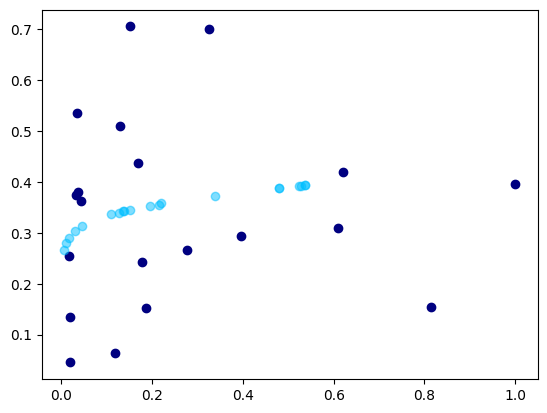

 18%|██████████████▌                                                                 | 182/1000 [00:32<02:27,  5.55it/s]

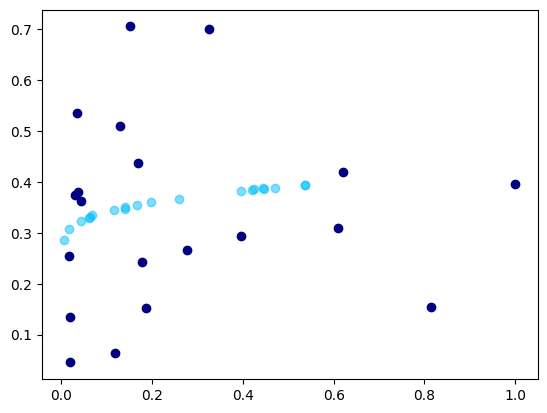

 18%|██████████████▋                                                                 | 183/1000 [00:33<02:26,  5.57it/s]

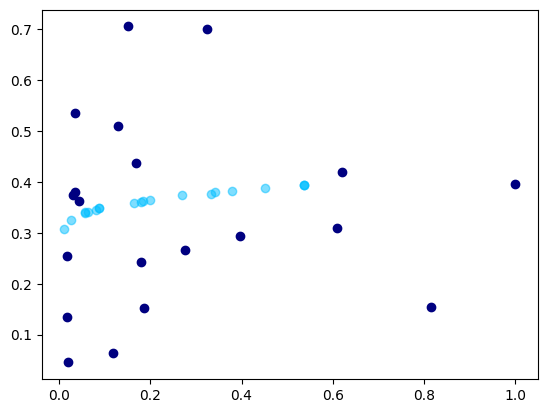

 18%|██████████████▋                                                                 | 184/1000 [00:33<02:22,  5.73it/s]

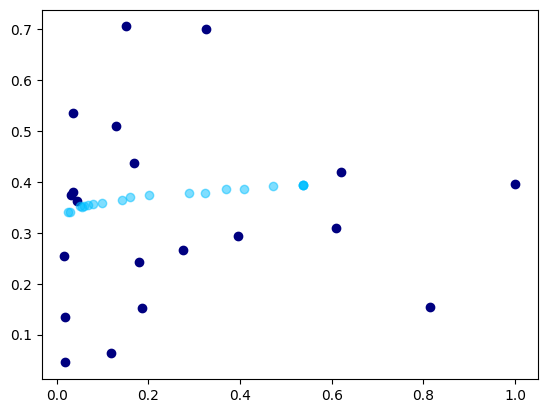

 18%|██████████████▊                                                                 | 185/1000 [00:33<02:19,  5.82it/s]

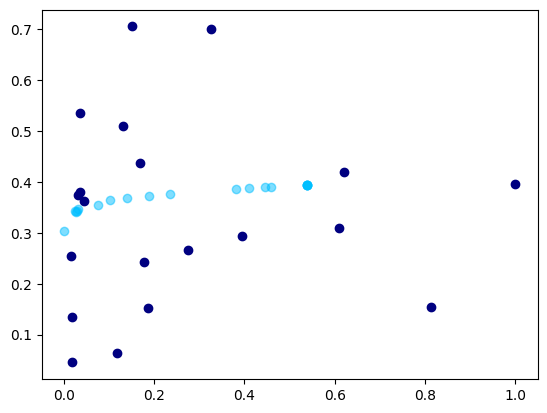

 19%|██████████████▉                                                                 | 186/1000 [00:33<02:20,  5.80it/s]

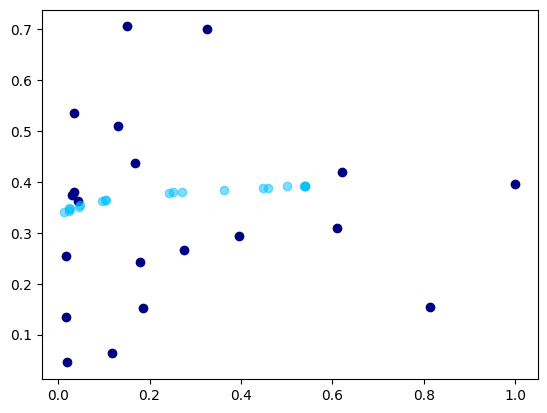

 19%|██████████████▉                                                                 | 187/1000 [00:33<02:20,  5.78it/s]

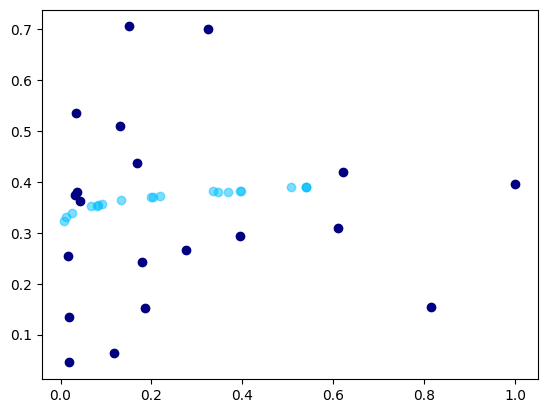

 19%|███████████████                                                                 | 188/1000 [00:34<02:18,  5.85it/s]

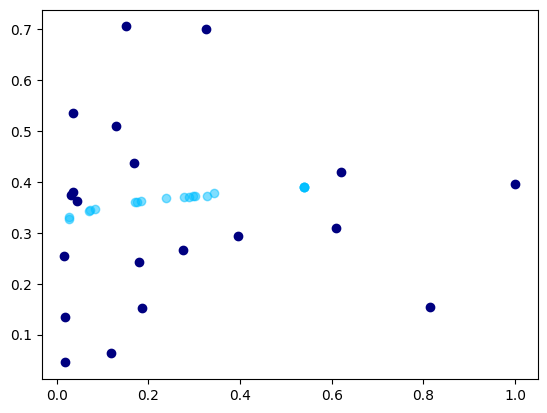

 19%|███████████████                                                                 | 189/1000 [00:34<02:20,  5.76it/s]

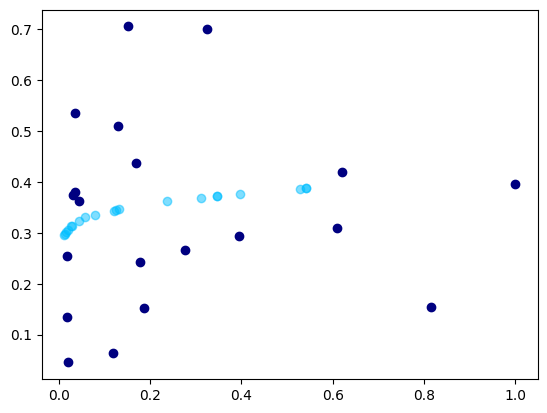

 19%|███████████████▏                                                                | 190/1000 [00:34<02:22,  5.70it/s]

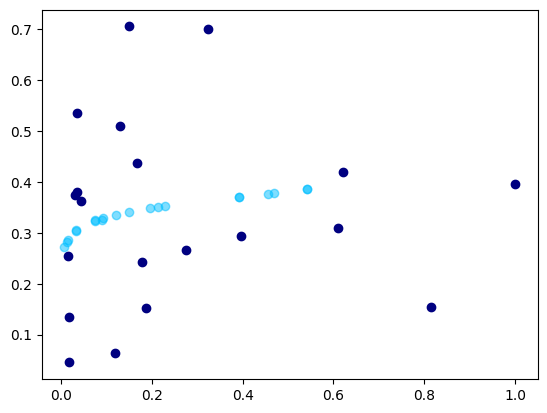

 19%|███████████████▎                                                                | 191/1000 [00:34<02:20,  5.75it/s]

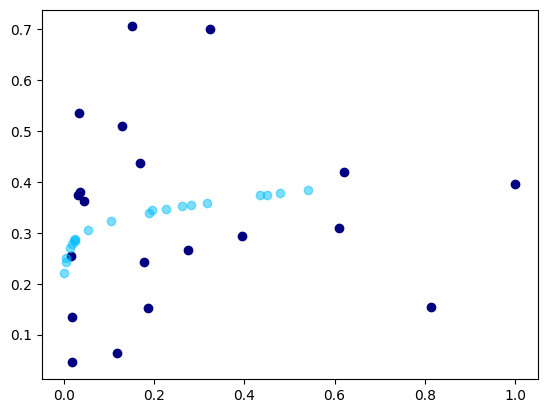

 19%|███████████████▎                                                                | 192/1000 [00:34<02:17,  5.86it/s]

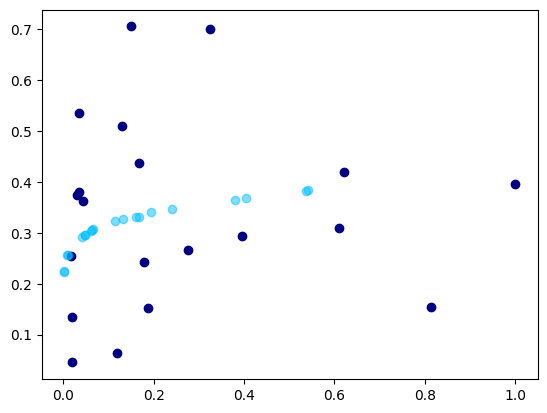

 19%|███████████████▍                                                                | 193/1000 [00:34<02:19,  5.78it/s]

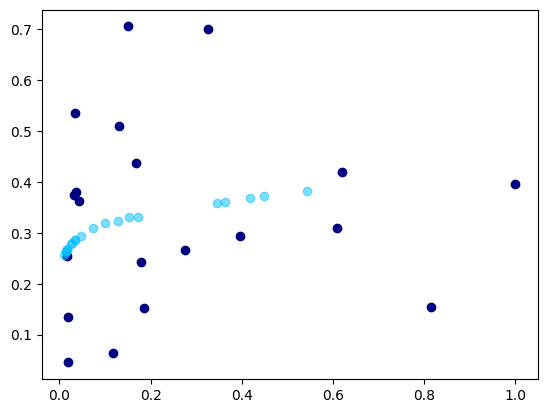

 19%|███████████████▌                                                                | 194/1000 [00:35<02:16,  5.89it/s]

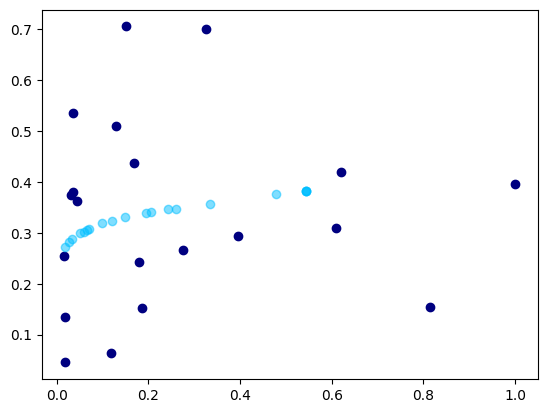

 20%|███████████████▌                                                                | 195/1000 [00:35<02:17,  5.84it/s]

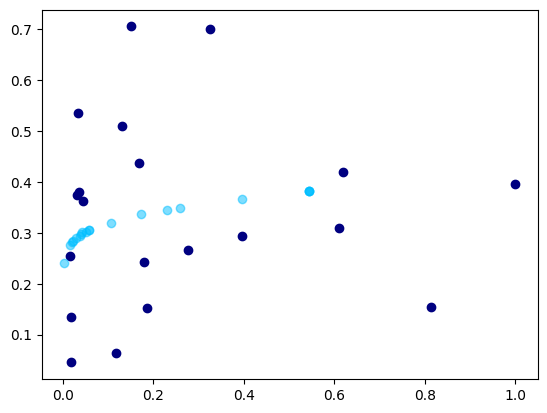

 20%|███████████████▋                                                                | 196/1000 [00:35<02:16,  5.87it/s]

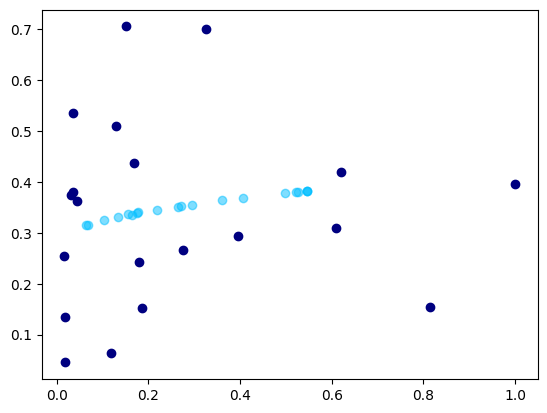

 20%|███████████████▊                                                                | 197/1000 [00:35<02:19,  5.75it/s]

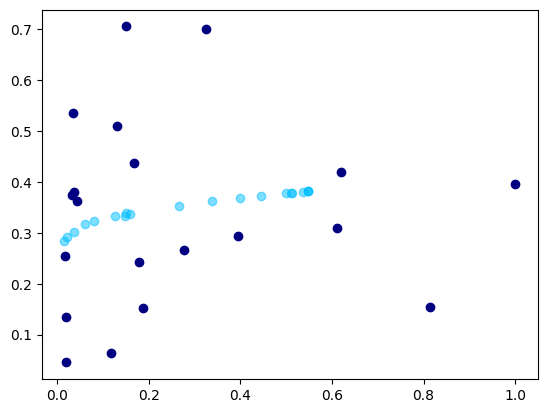

 20%|███████████████▊                                                                | 198/1000 [00:35<02:17,  5.84it/s]

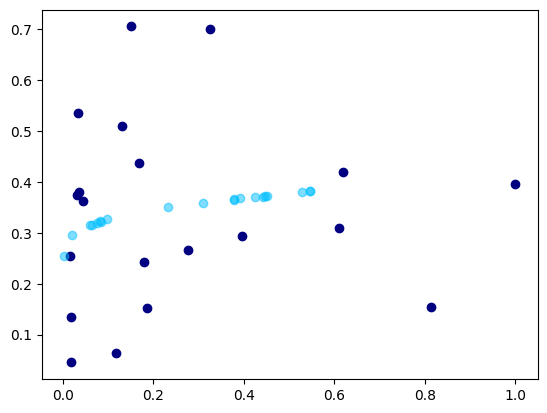

 20%|███████████████▉                                                                | 199/1000 [00:35<02:21,  5.67it/s]

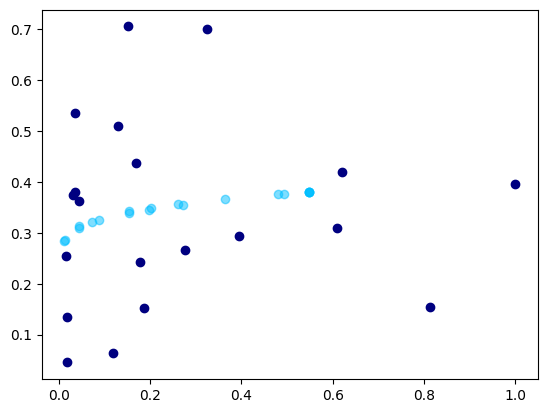

 20%|████████████████                                                                | 200/1000 [00:36<02:18,  5.79it/s]

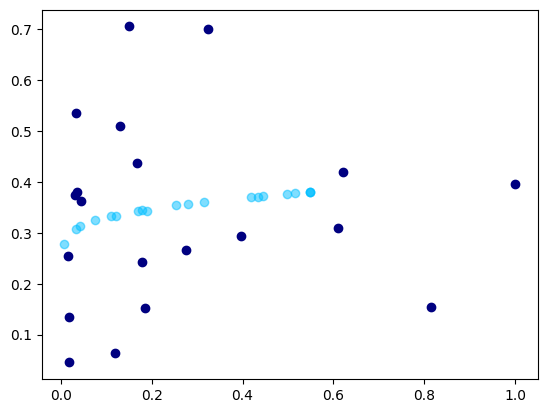

 20%|████████████████                                                                | 201/1000 [00:36<02:21,  5.66it/s]

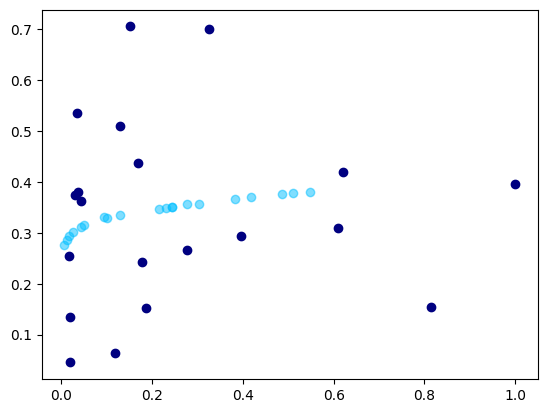

 20%|████████████████▏                                                               | 202/1000 [00:36<02:19,  5.71it/s]

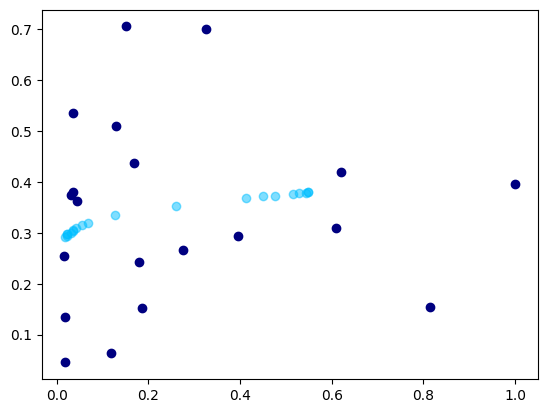

 20%|████████████████▏                                                               | 203/1000 [00:36<02:20,  5.67it/s]

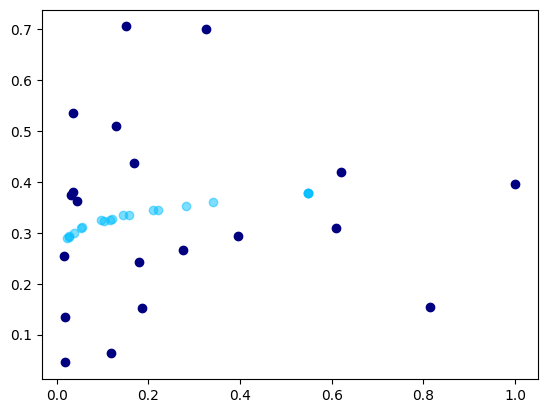

 20%|████████████████▎                                                               | 204/1000 [00:36<02:18,  5.77it/s]

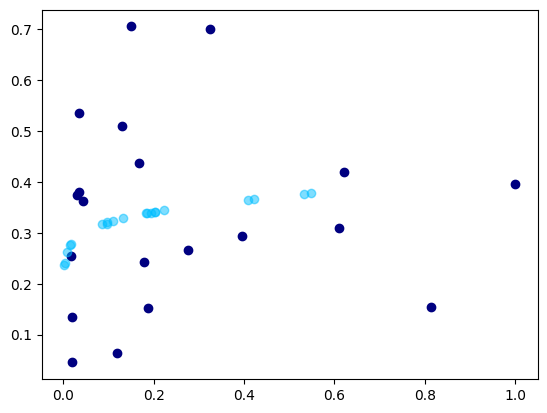

 20%|████████████████▍                                                               | 205/1000 [00:36<02:21,  5.62it/s]

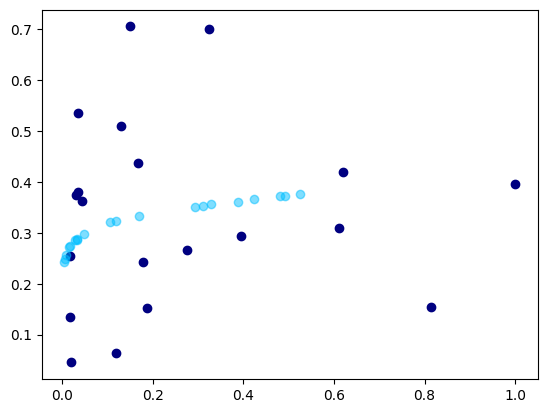

 21%|████████████████▍                                                               | 206/1000 [00:37<02:23,  5.53it/s]

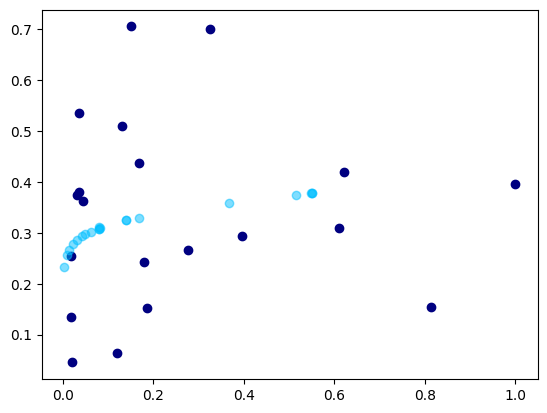

 21%|████████████████▌                                                               | 207/1000 [00:37<02:23,  5.54it/s]

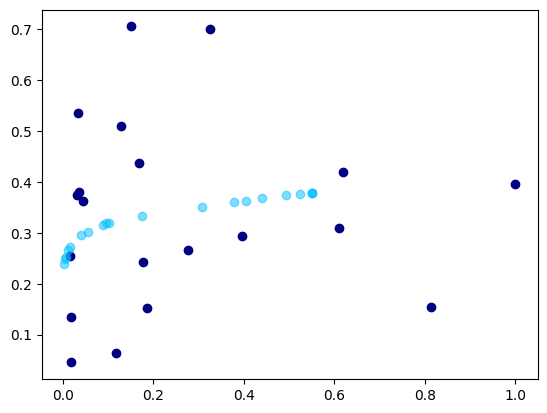

 21%|████████████████▋                                                               | 208/1000 [00:37<02:20,  5.63it/s]

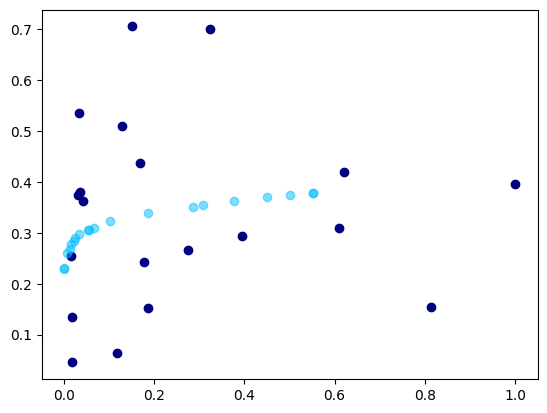

 21%|████████████████▋                                                               | 209/1000 [00:37<02:18,  5.69it/s]

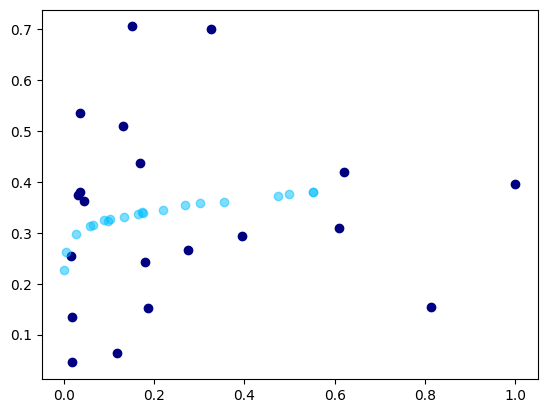

 21%|████████████████▊                                                               | 210/1000 [00:37<02:16,  5.77it/s]

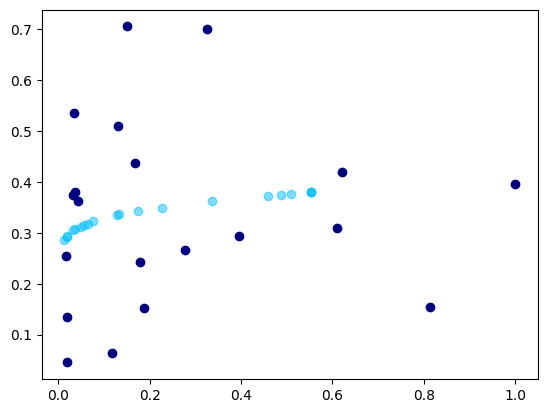

 21%|████████████████▉                                                               | 211/1000 [00:38<02:15,  5.82it/s]

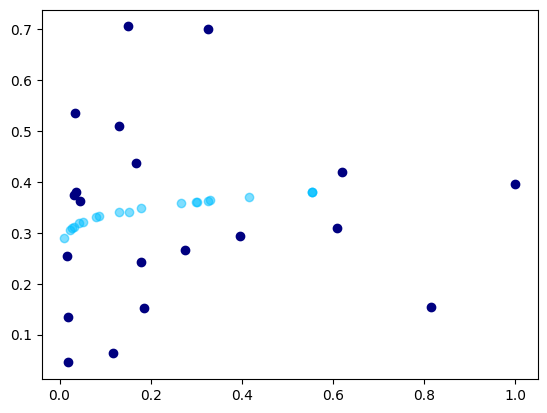

 21%|████████████████▉                                                               | 212/1000 [00:38<02:16,  5.77it/s]

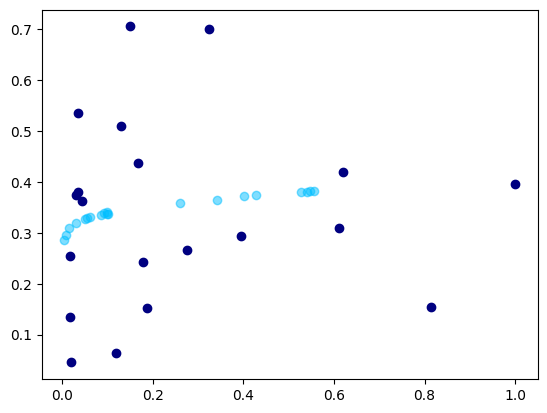

 21%|█████████████████                                                               | 213/1000 [00:38<02:15,  5.81it/s]

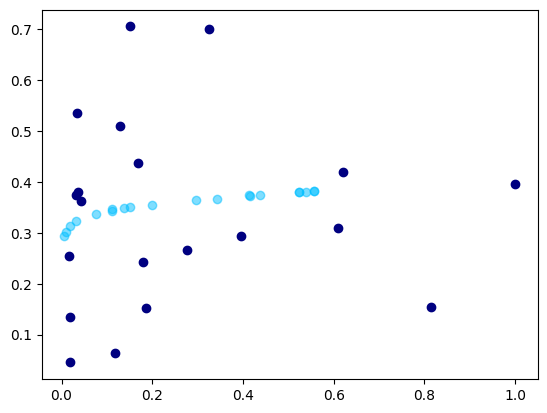

 21%|█████████████████                                                               | 214/1000 [00:38<02:17,  5.73it/s]

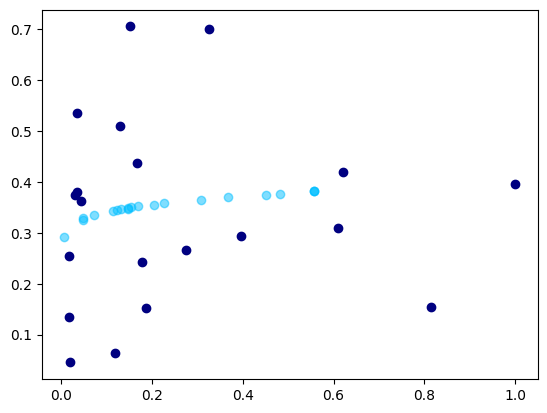

 22%|█████████████████▏                                                              | 215/1000 [00:38<02:14,  5.82it/s]

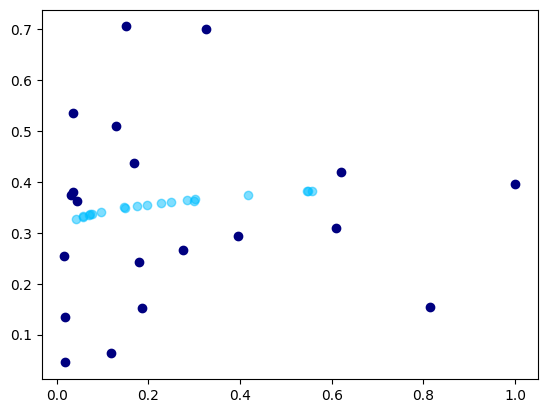

 22%|█████████████████▎                                                              | 216/1000 [00:38<02:14,  5.85it/s]

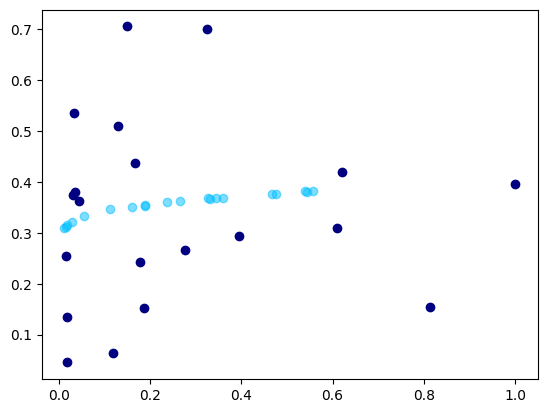

 22%|█████████████████▎                                                              | 217/1000 [00:39<02:12,  5.90it/s]

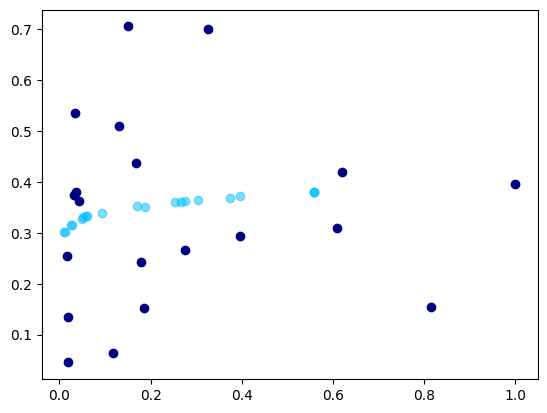

 22%|█████████████████▍                                                              | 218/1000 [00:39<02:21,  5.52it/s]

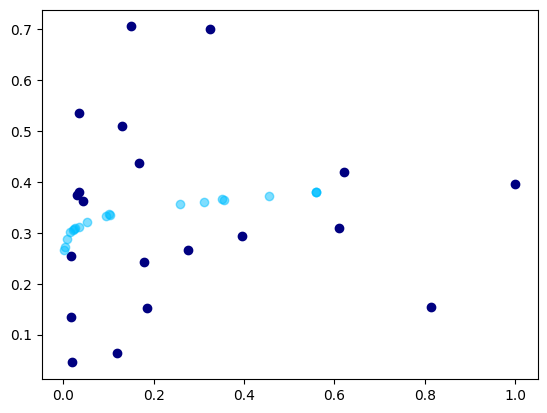

 22%|█████████████████▌                                                              | 219/1000 [00:39<02:18,  5.64it/s]

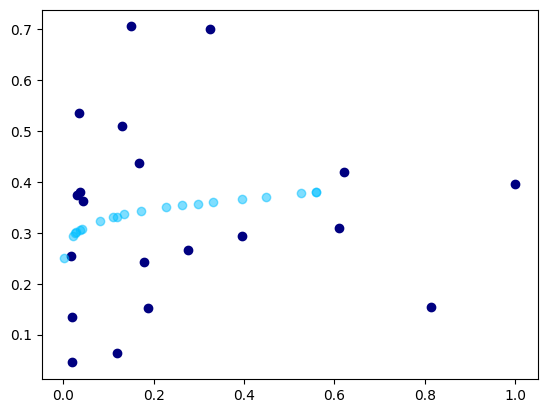

 22%|█████████████████▌                                                              | 220/1000 [00:39<02:18,  5.62it/s]

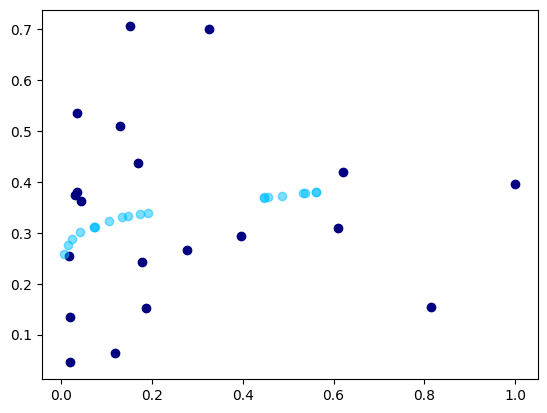

 22%|█████████████████▋                                                              | 221/1000 [00:39<02:17,  5.66it/s]

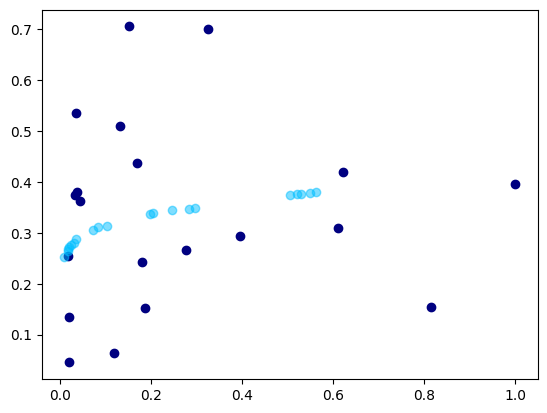

 22%|█████████████████▊                                                              | 222/1000 [00:39<02:19,  5.56it/s]

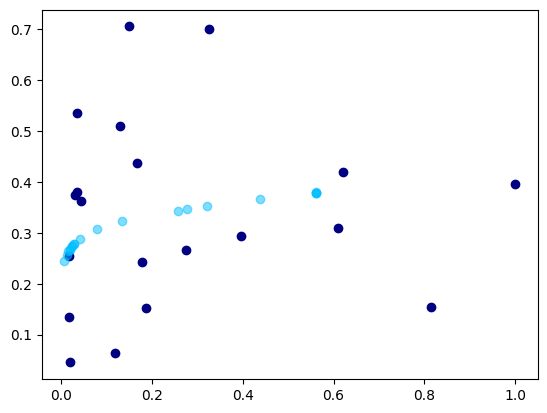

 22%|█████████████████▊                                                              | 223/1000 [00:40<02:17,  5.67it/s]

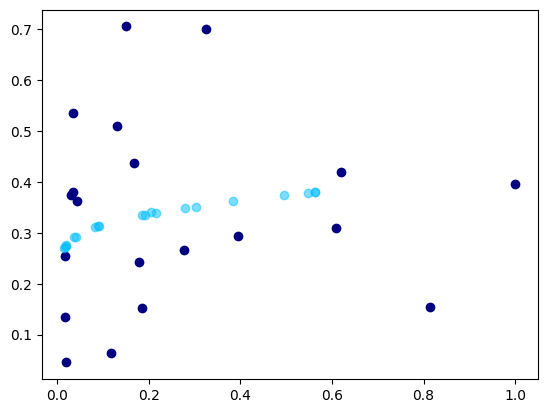

 22%|█████████████████▉                                                              | 224/1000 [00:40<02:17,  5.66it/s]

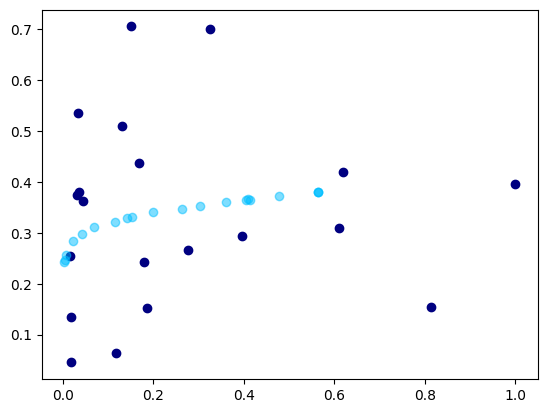

 22%|██████████████████                                                              | 225/1000 [00:40<02:15,  5.72it/s]

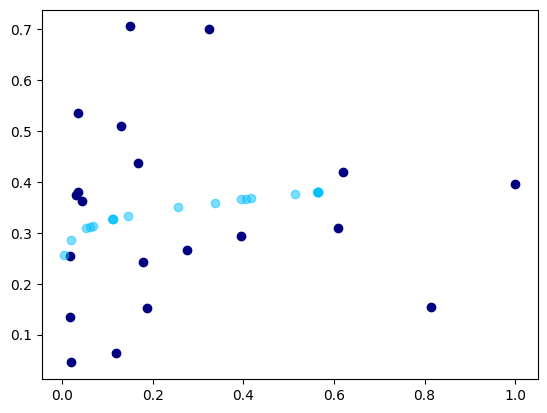

 23%|██████████████████                                                              | 226/1000 [00:40<02:14,  5.76it/s]

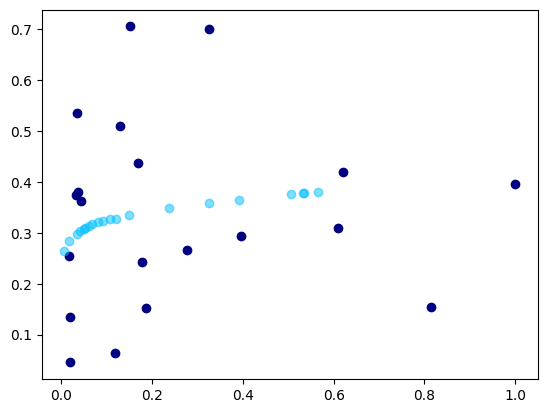

 23%|██████████████████▏                                                             | 227/1000 [00:40<02:13,  5.81it/s]

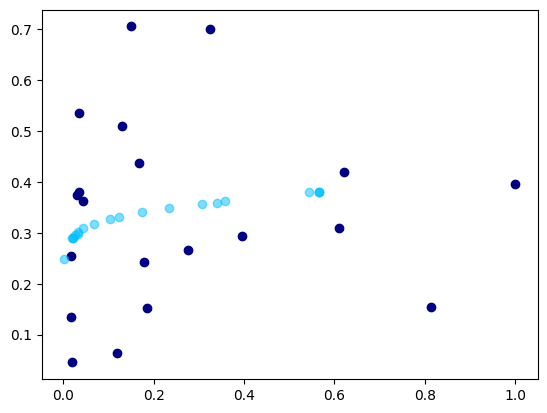

 23%|██████████████████▏                                                             | 228/1000 [00:40<02:11,  5.86it/s]

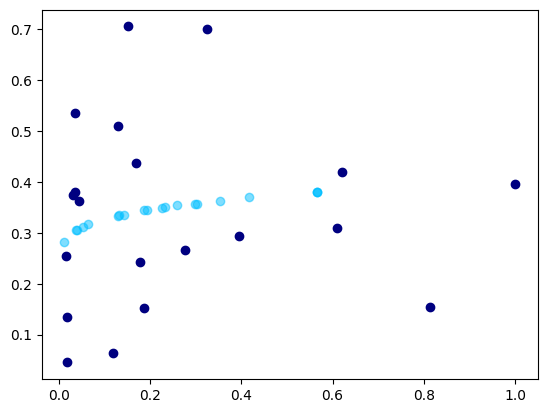

 23%|██████████████████▎                                                             | 229/1000 [00:41<04:00,  3.20it/s]

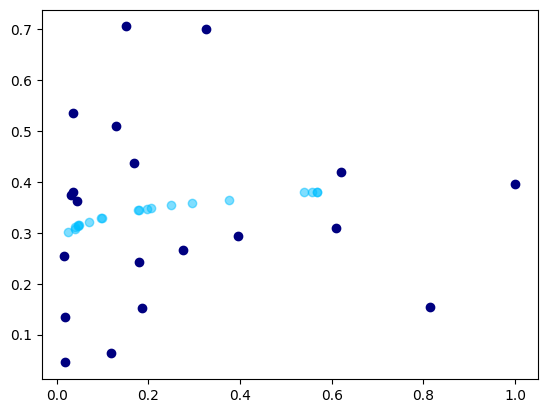

 23%|██████████████████▍                                                             | 230/1000 [00:41<03:28,  3.69it/s]

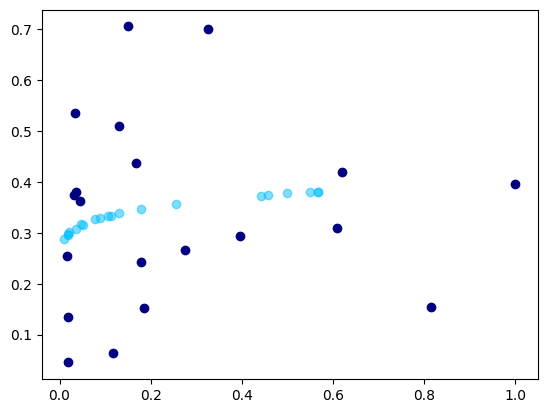

 23%|██████████████████▍                                                             | 231/1000 [00:41<03:03,  4.19it/s]

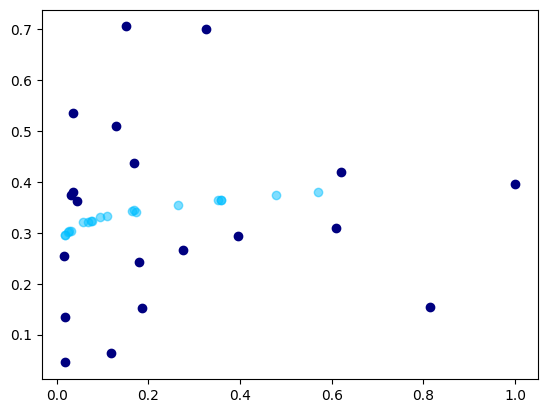

 23%|██████████████████▌                                                             | 232/1000 [00:42<02:47,  4.58it/s]

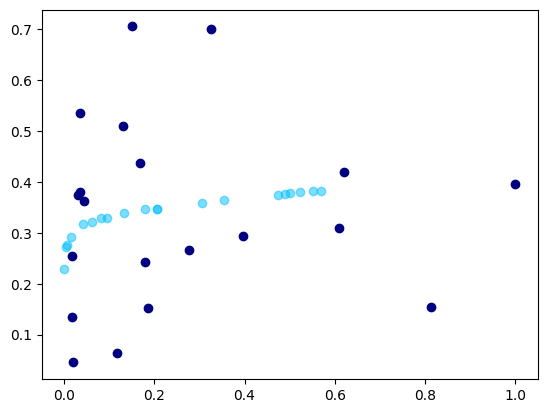

 23%|██████████████████▋                                                             | 233/1000 [00:42<02:37,  4.88it/s]

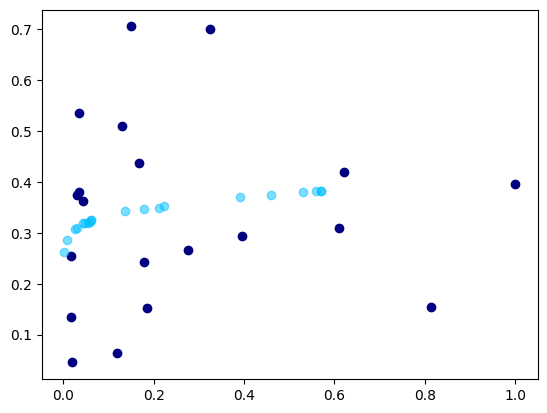

 23%|██████████████████▋                                                             | 234/1000 [00:42<02:28,  5.17it/s]

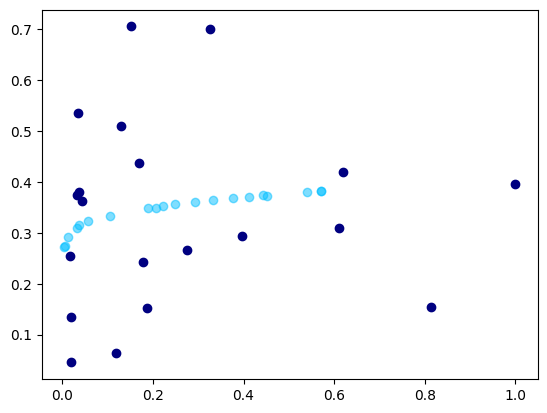

 24%|██████████████████▊                                                             | 235/1000 [00:42<02:23,  5.34it/s]

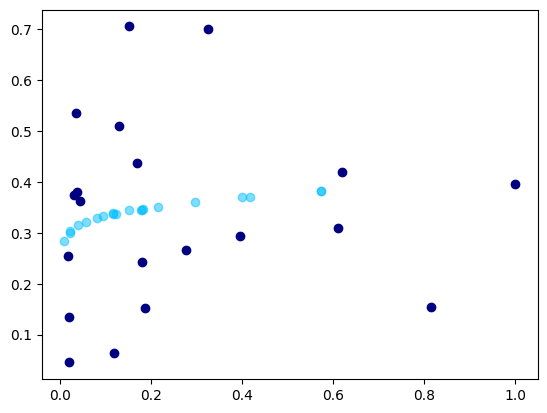

 24%|██████████████████▉                                                             | 236/1000 [00:42<02:17,  5.54it/s]

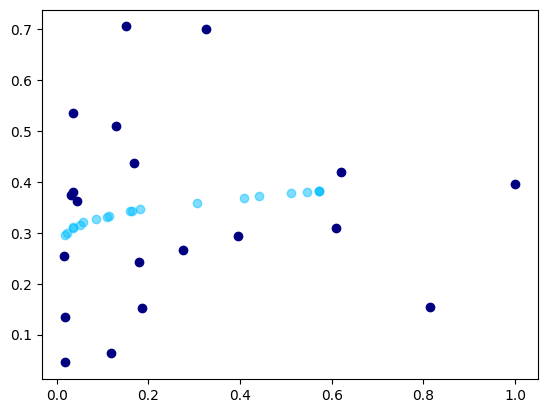

 24%|██████████████████▉                                                             | 237/1000 [00:42<02:14,  5.66it/s]

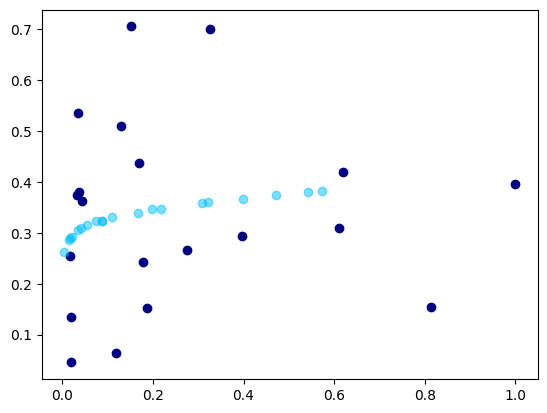

 24%|███████████████████                                                             | 238/1000 [00:43<02:12,  5.75it/s]

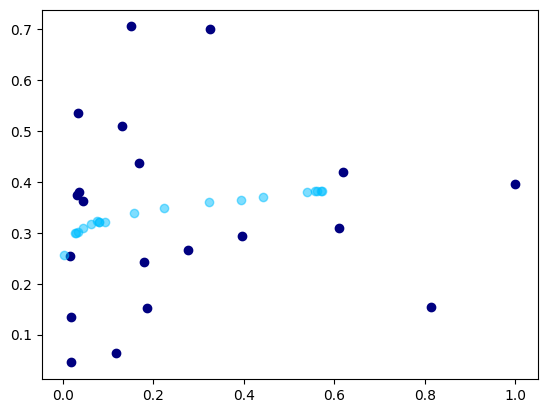

 24%|███████████████████                                                             | 239/1000 [00:43<02:10,  5.83it/s]

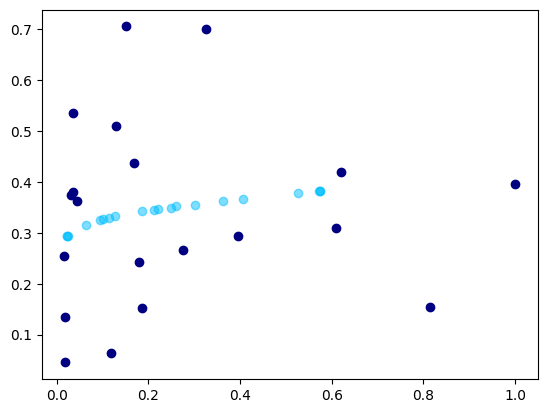

 24%|███████████████████▏                                                            | 240/1000 [00:43<02:10,  5.81it/s]

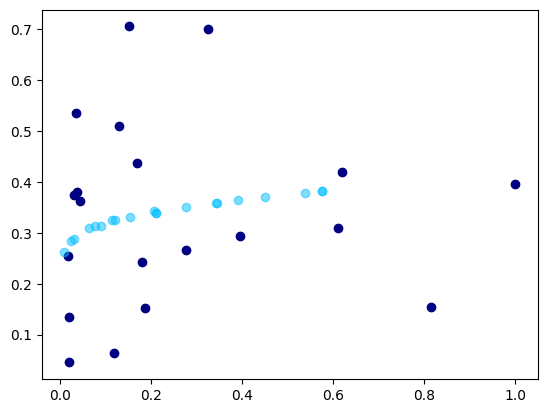

 24%|███████████████████▎                                                            | 241/1000 [00:43<02:10,  5.84it/s]

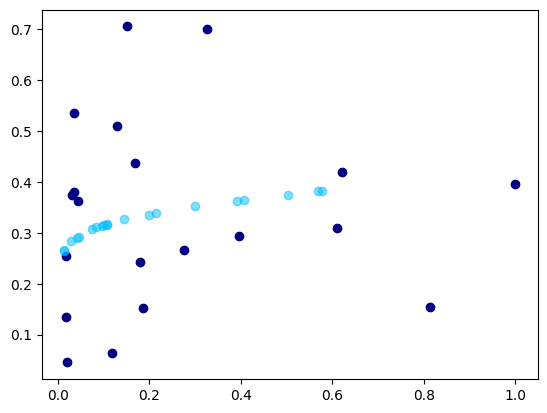

 24%|███████████████████▎                                                            | 242/1000 [00:43<02:12,  5.74it/s]

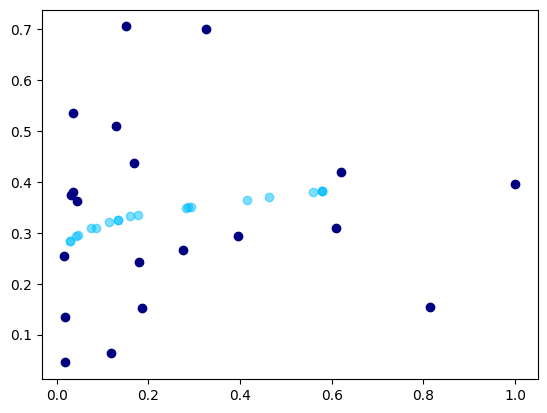

 24%|███████████████████▍                                                            | 243/1000 [00:44<02:13,  5.67it/s]

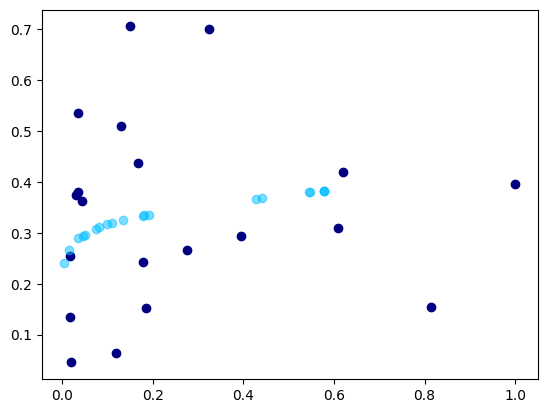

 24%|███████████████████▌                                                            | 244/1000 [00:44<02:12,  5.70it/s]

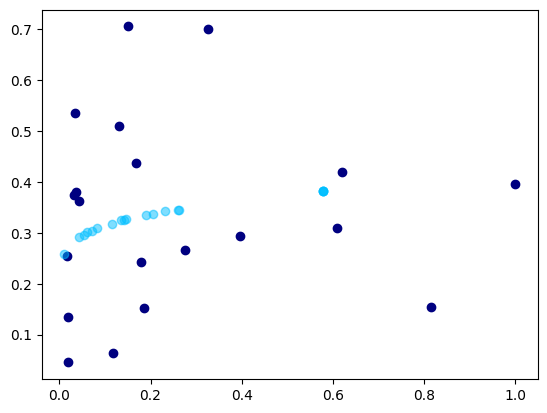

 24%|███████████████████▌                                                            | 245/1000 [00:44<02:15,  5.59it/s]

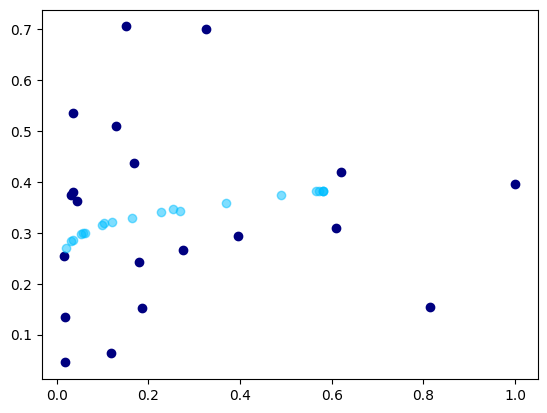

 25%|███████████████████▋                                                            | 246/1000 [00:44<02:12,  5.69it/s]

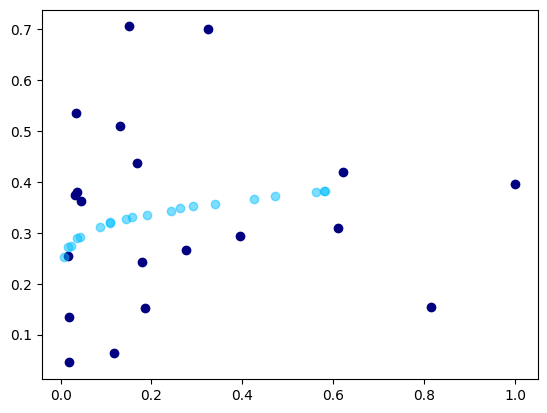

 25%|███████████████████▊                                                            | 247/1000 [00:44<02:10,  5.79it/s]

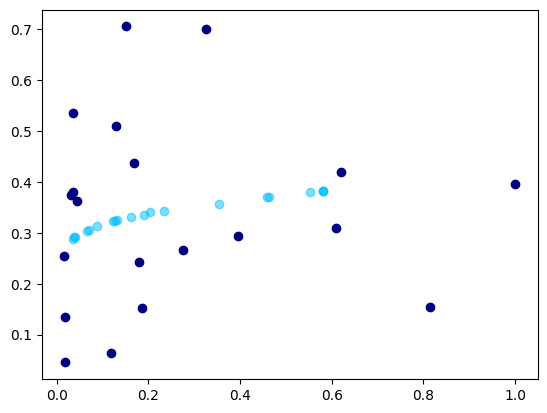

 25%|███████████████████▊                                                            | 248/1000 [00:44<02:11,  5.73it/s]

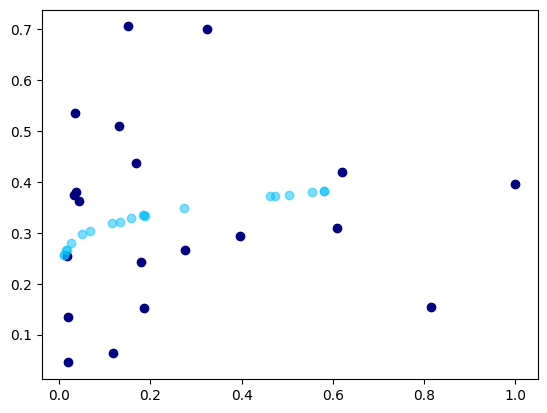

 25%|███████████████████▉                                                            | 249/1000 [00:45<02:09,  5.80it/s]

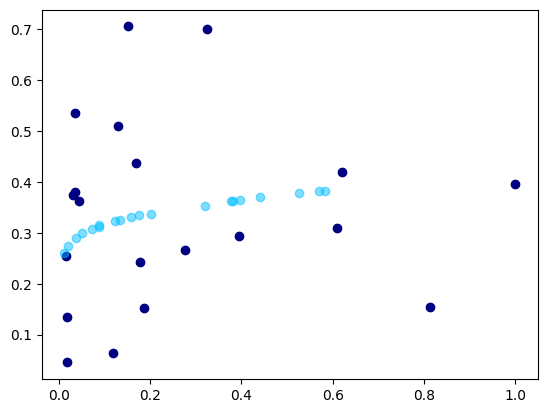

 25%|████████████████████                                                            | 250/1000 [00:45<02:09,  5.79it/s]

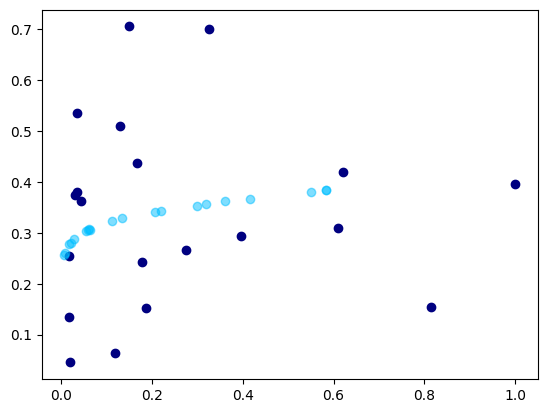

 25%|████████████████████                                                            | 251/1000 [00:45<02:08,  5.83it/s]

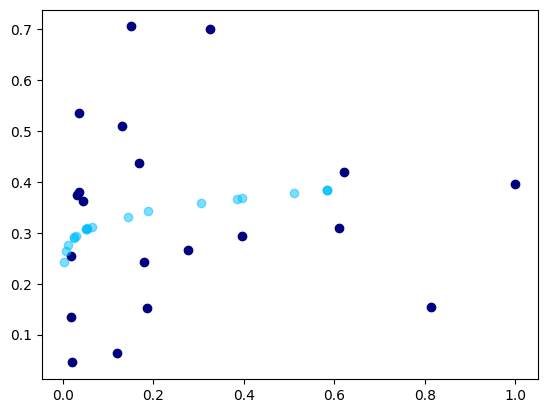

 25%|████████████████████▏                                                           | 252/1000 [00:45<02:07,  5.85it/s]

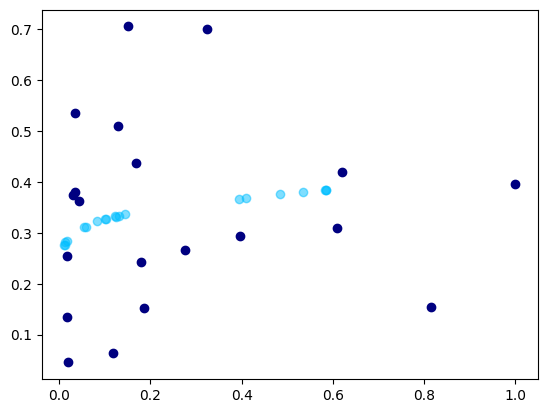

 25%|████████████████████▏                                                           | 253/1000 [00:45<02:07,  5.84it/s]

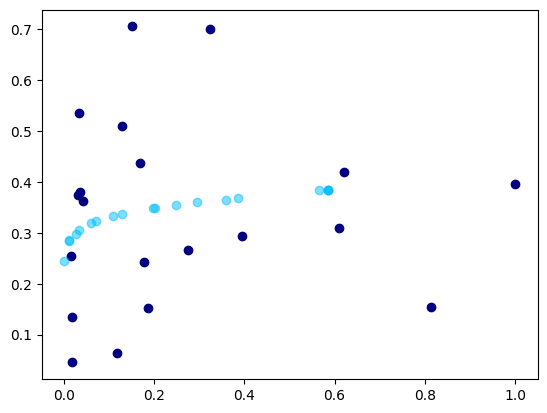

 25%|████████████████████▎                                                           | 254/1000 [00:45<02:17,  5.42it/s]

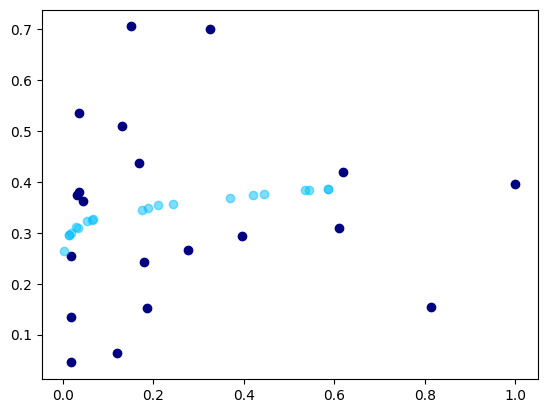

 26%|████████████████████▍                                                           | 255/1000 [00:46<02:13,  5.57it/s]

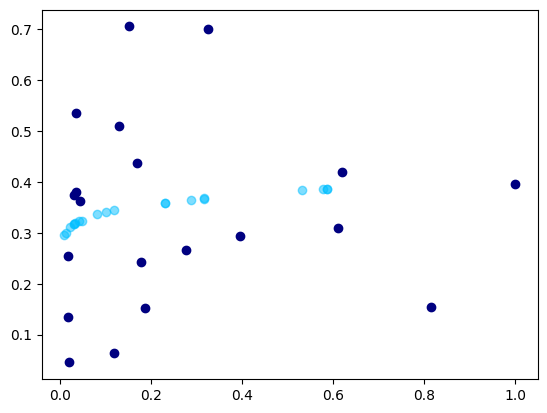

 26%|████████████████████▍                                                           | 256/1000 [00:46<02:15,  5.49it/s]

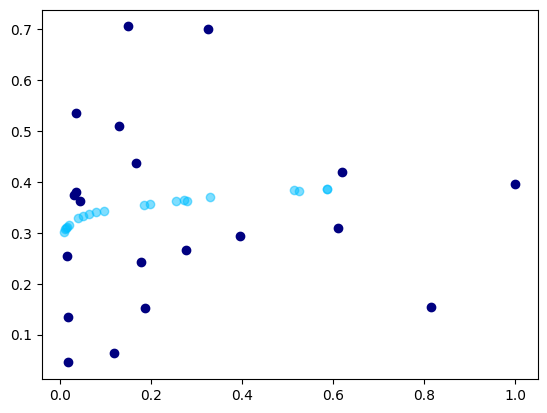

 26%|████████████████████▌                                                           | 257/1000 [00:46<02:11,  5.64it/s]

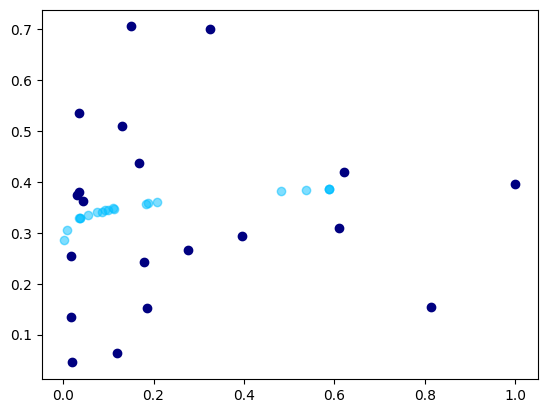

 26%|████████████████████▋                                                           | 258/1000 [00:46<02:08,  5.79it/s]

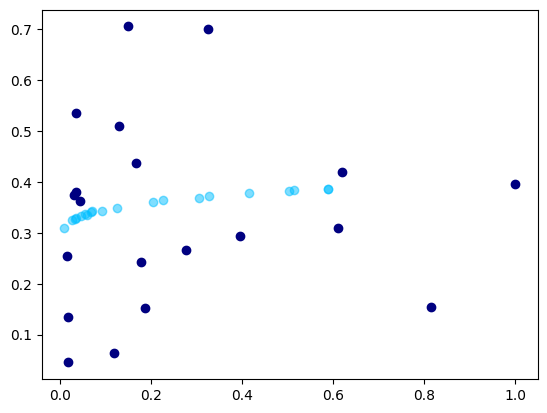

 26%|████████████████████▋                                                           | 259/1000 [00:46<02:07,  5.83it/s]

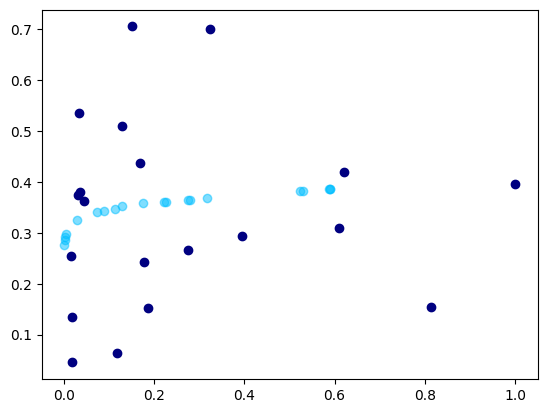

 26%|████████████████████▊                                                           | 260/1000 [00:46<02:06,  5.84it/s]

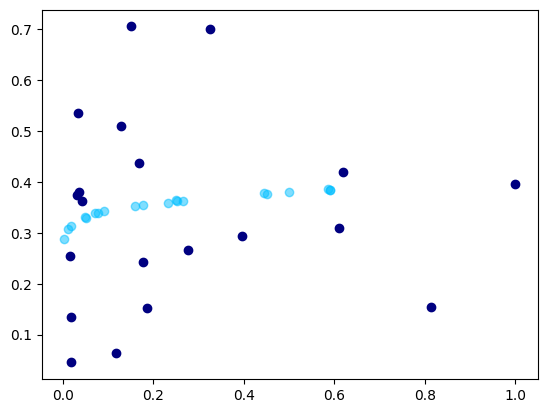

 26%|████████████████████▉                                                           | 261/1000 [00:47<02:06,  5.86it/s]

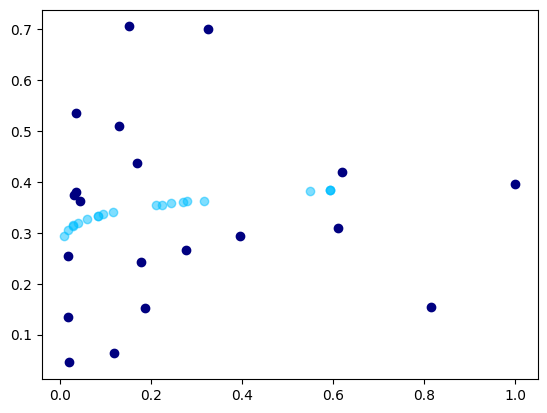

 26%|████████████████████▉                                                           | 262/1000 [00:47<02:05,  5.87it/s]

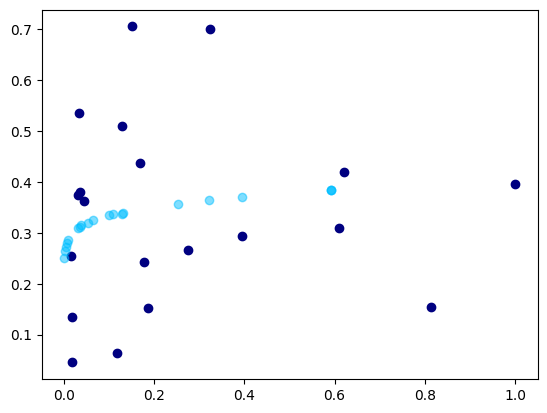

 26%|█████████████████████                                                           | 263/1000 [00:47<02:06,  5.81it/s]

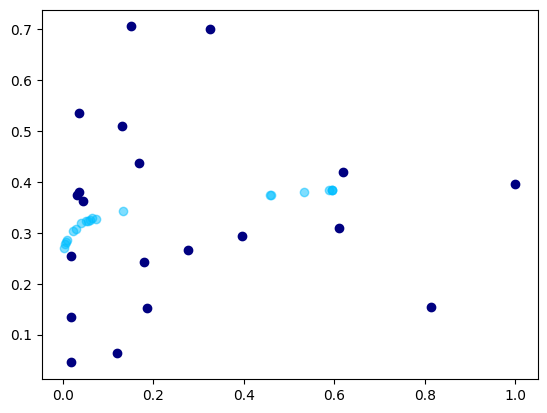

 26%|█████████████████████                                                           | 264/1000 [00:47<02:04,  5.91it/s]

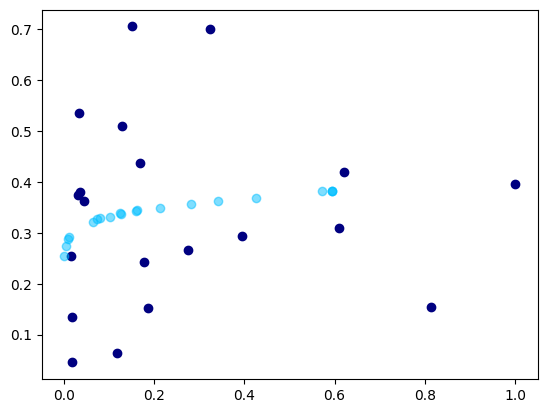

 26%|█████████████████████▏                                                          | 265/1000 [00:47<02:02,  5.99it/s]

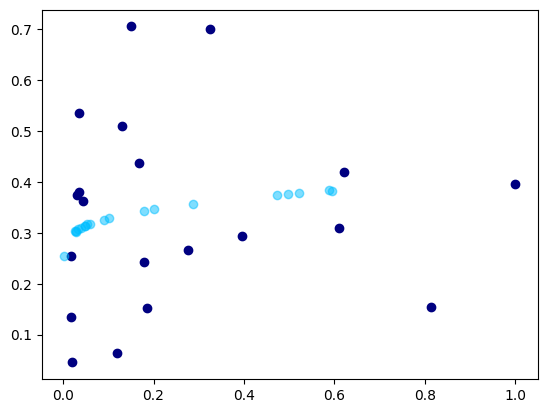

 27%|█████████████████████▎                                                          | 266/1000 [00:47<02:02,  6.01it/s]

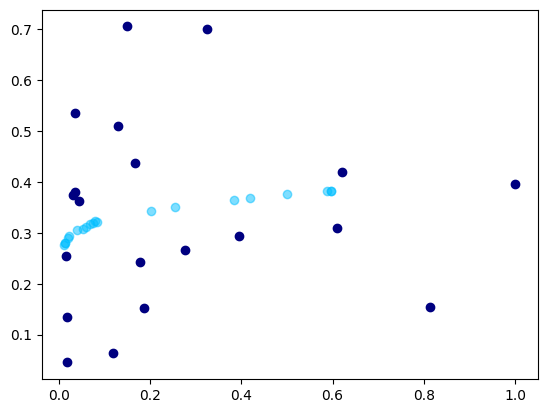

 27%|█████████████████████▎                                                          | 267/1000 [00:48<02:02,  5.99it/s]

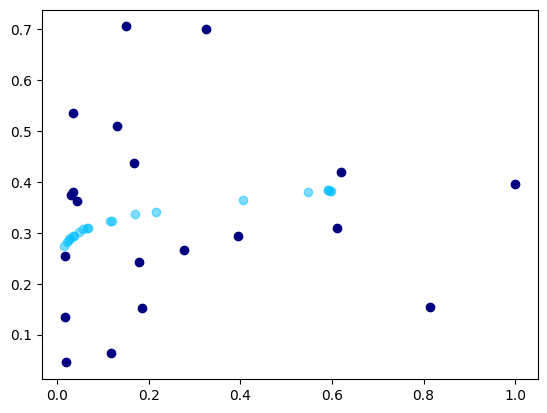

 27%|█████████████████████▍                                                          | 268/1000 [00:48<02:02,  5.99it/s]

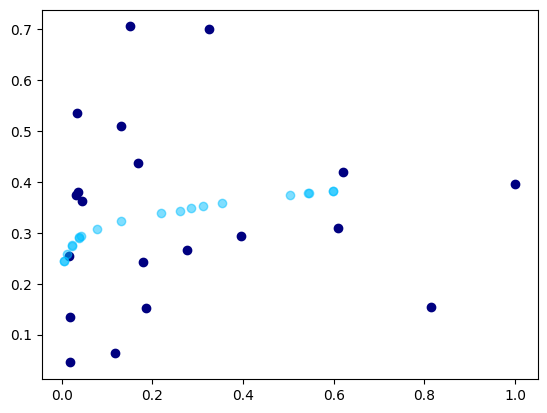

 27%|█████████████████████▌                                                          | 269/1000 [00:48<02:02,  5.96it/s]

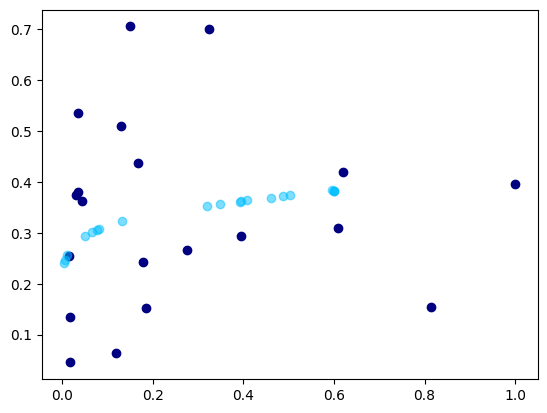

 27%|█████████████████████▌                                                          | 270/1000 [00:48<02:02,  5.96it/s]

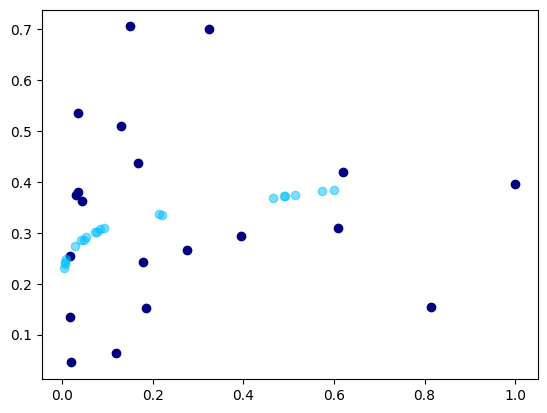

 27%|█████████████████████▋                                                          | 271/1000 [00:48<02:01,  6.02it/s]

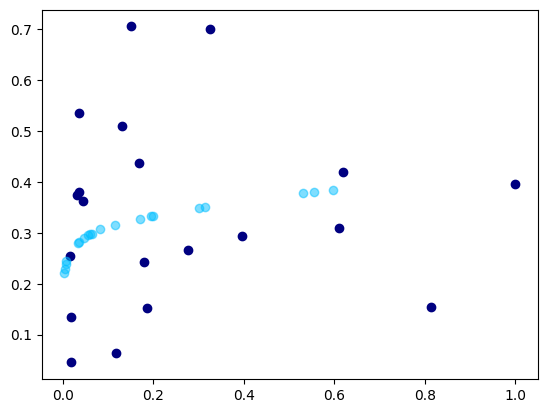

 27%|█████████████████████▊                                                          | 272/1000 [00:48<02:00,  6.04it/s]

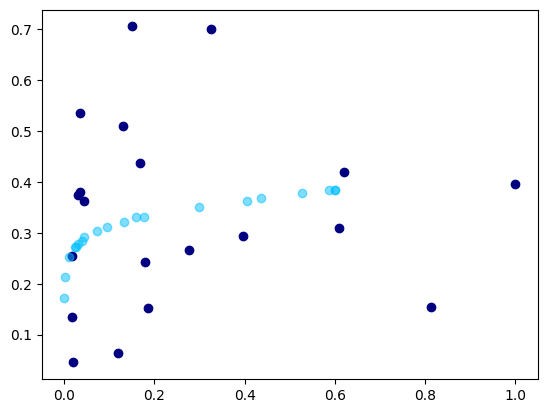

 27%|█████████████████████▊                                                          | 273/1000 [00:49<01:59,  6.06it/s]

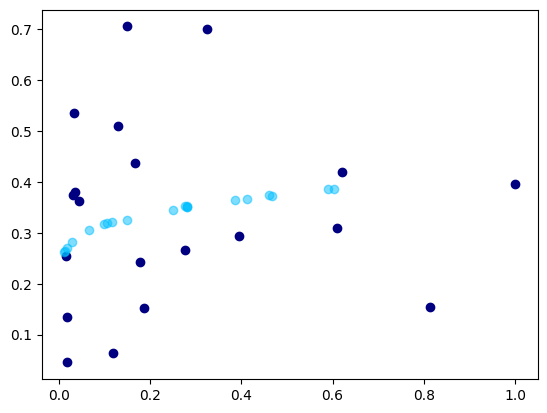

 27%|█████████████████████▉                                                          | 274/1000 [00:49<02:01,  5.99it/s]

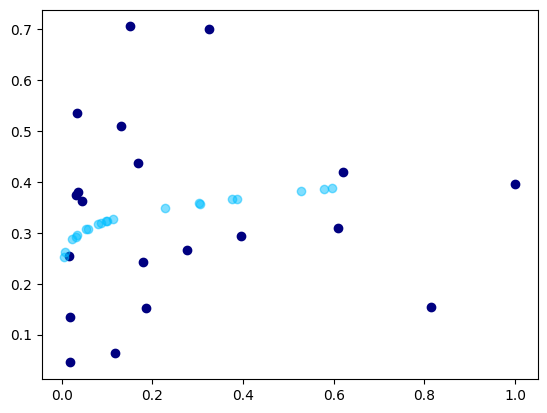

 28%|██████████████████████                                                          | 275/1000 [00:49<02:00,  6.02it/s]

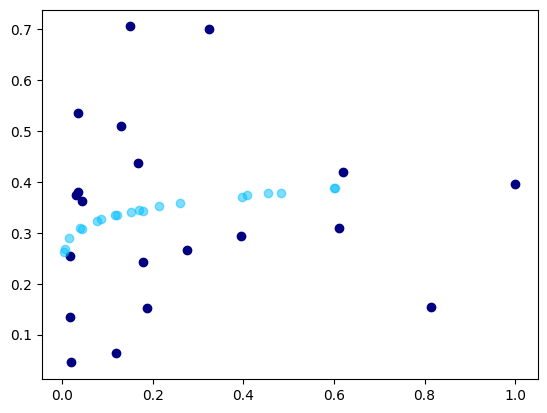

 28%|██████████████████████                                                          | 276/1000 [00:49<02:00,  6.01it/s]

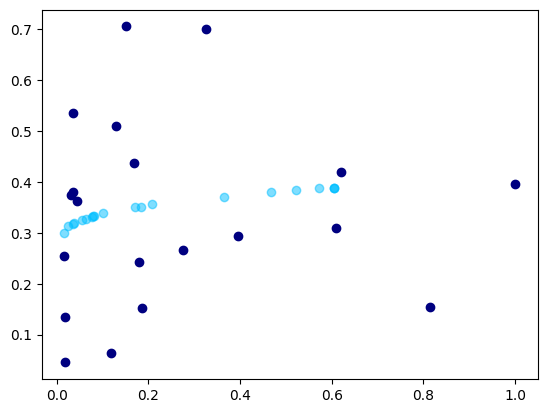

 28%|██████████████████████▏                                                         | 277/1000 [00:49<01:59,  6.08it/s]

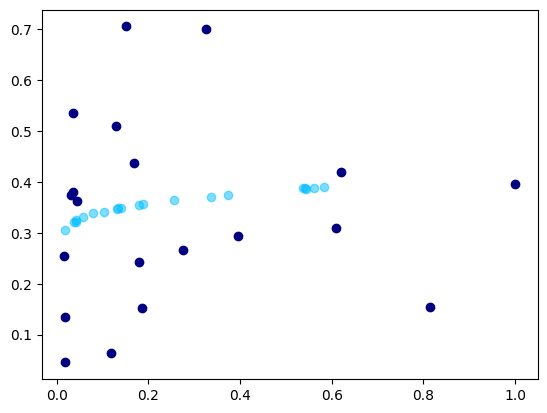

 28%|██████████████████████▏                                                         | 278/1000 [00:49<02:03,  5.85it/s]

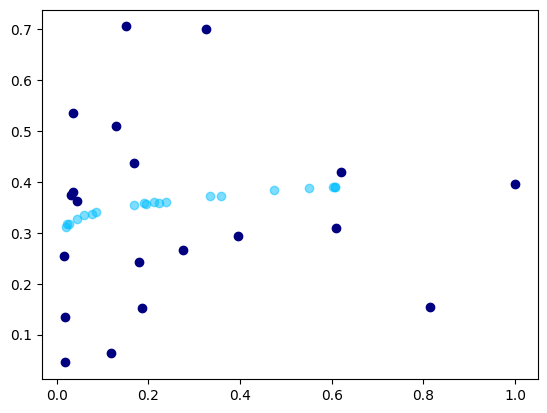

 28%|██████████████████████▎                                                         | 279/1000 [00:50<02:01,  5.92it/s]

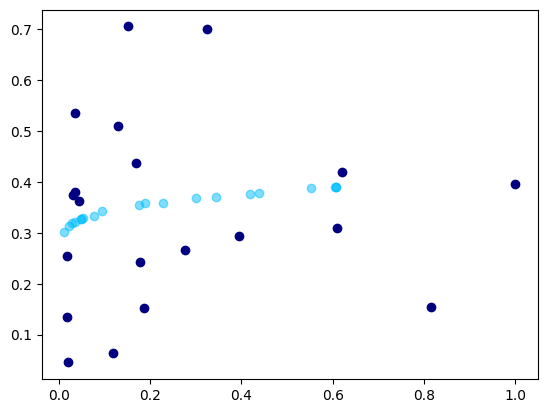

 28%|██████████████████████▍                                                         | 280/1000 [00:50<02:00,  5.96it/s]

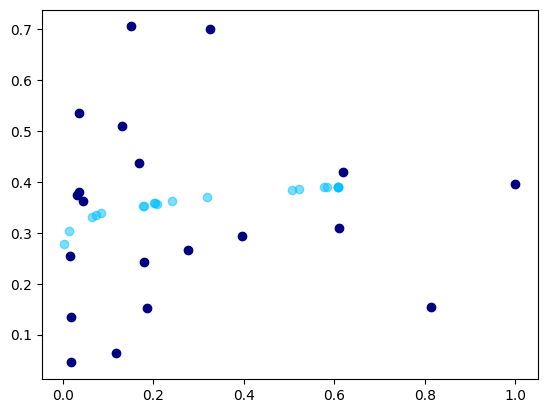

 28%|██████████████████████▍                                                         | 281/1000 [00:50<01:58,  6.05it/s]

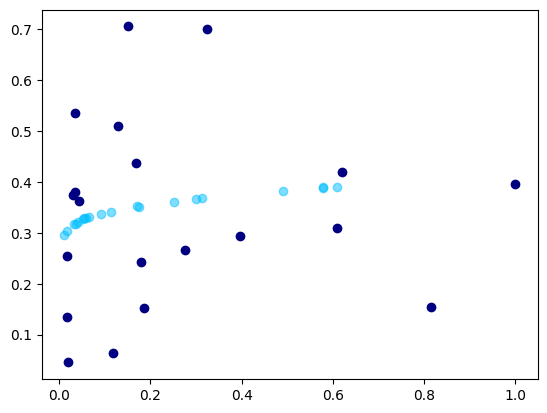

 28%|██████████████████████▌                                                         | 282/1000 [00:50<01:57,  6.09it/s]

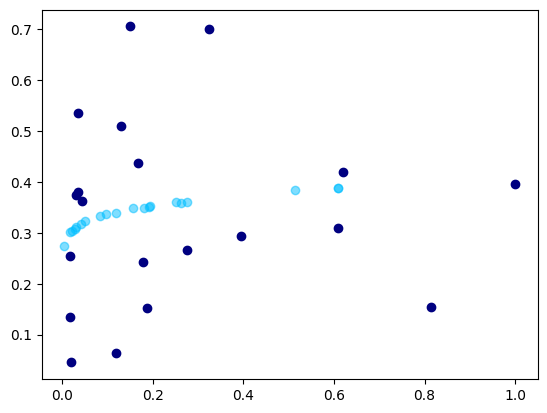

 28%|██████████████████████▋                                                         | 283/1000 [00:50<01:59,  6.00it/s]

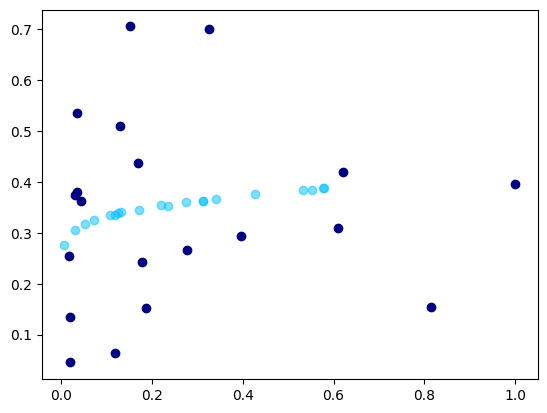

 28%|██████████████████████▋                                                         | 284/1000 [00:50<01:58,  6.03it/s]

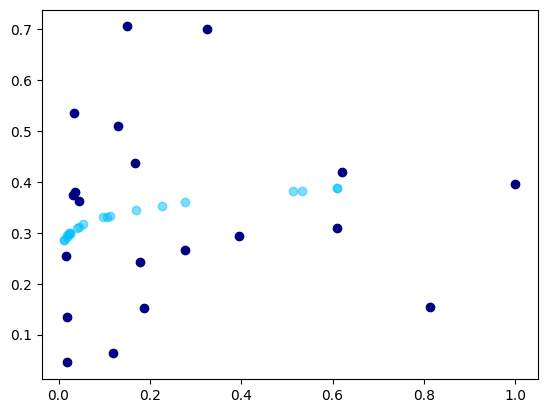

 28%|██████████████████████▊                                                         | 285/1000 [00:51<01:58,  6.04it/s]

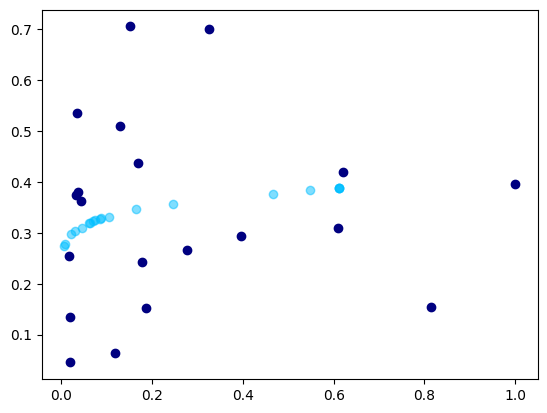

 29%|██████████████████████▉                                                         | 286/1000 [00:51<01:58,  6.00it/s]

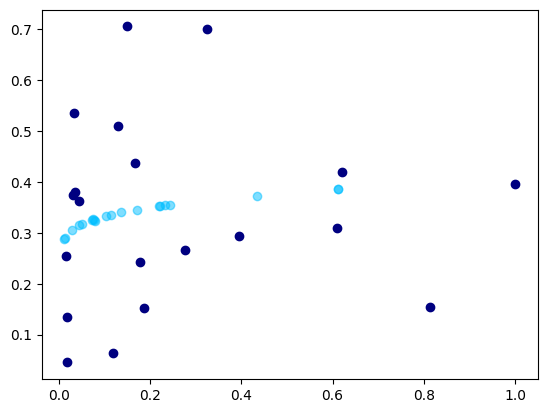

 29%|██████████████████████▉                                                         | 287/1000 [00:51<01:58,  6.02it/s]

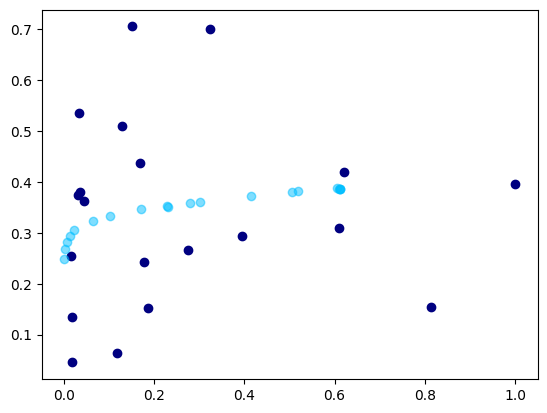

 29%|███████████████████████                                                         | 288/1000 [00:51<01:57,  6.03it/s]

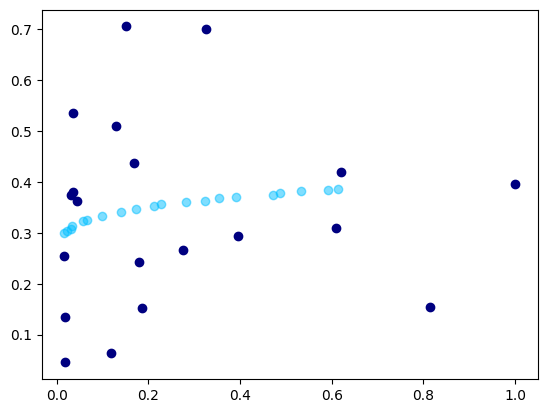

 29%|███████████████████████                                                         | 289/1000 [00:51<01:56,  6.11it/s]

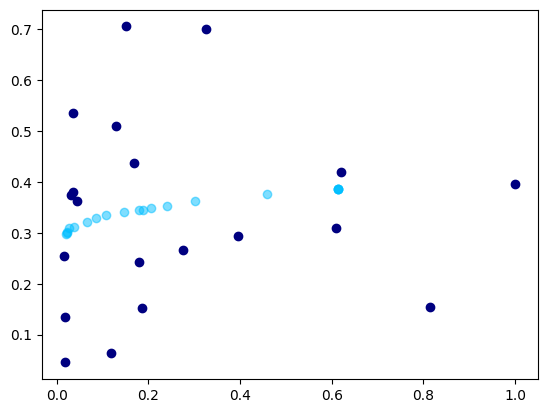

 29%|███████████████████████▏                                                        | 290/1000 [00:51<01:55,  6.13it/s]

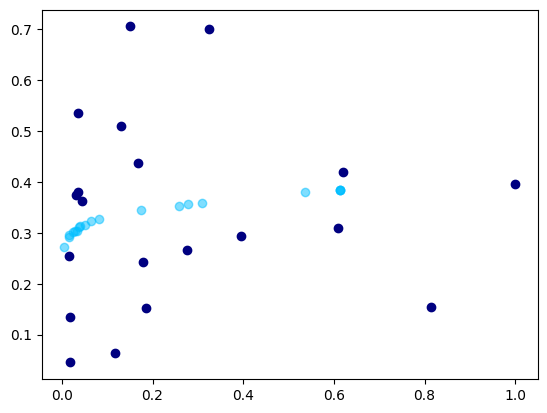

 29%|███████████████████████▎                                                        | 291/1000 [00:52<01:55,  6.16it/s]

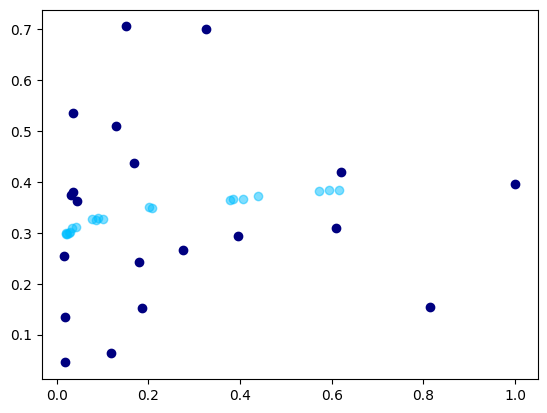

 29%|███████████████████████▎                                                        | 292/1000 [00:52<01:55,  6.12it/s]

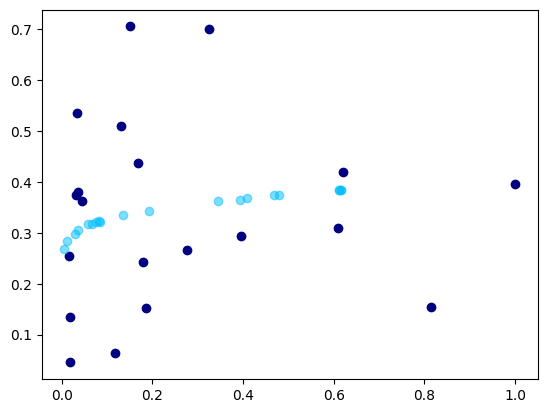

 29%|███████████████████████▍                                                        | 293/1000 [00:52<01:55,  6.11it/s]

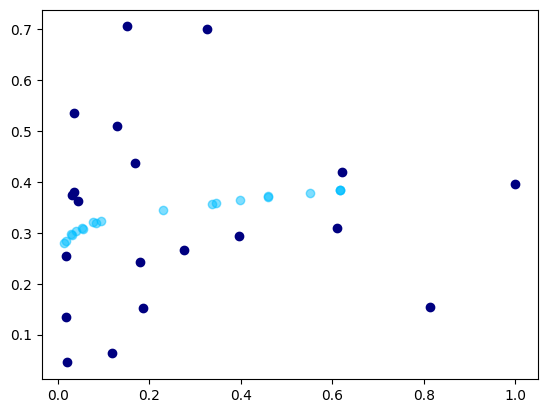

 29%|███████████████████████▌                                                        | 294/1000 [00:52<01:56,  6.07it/s]

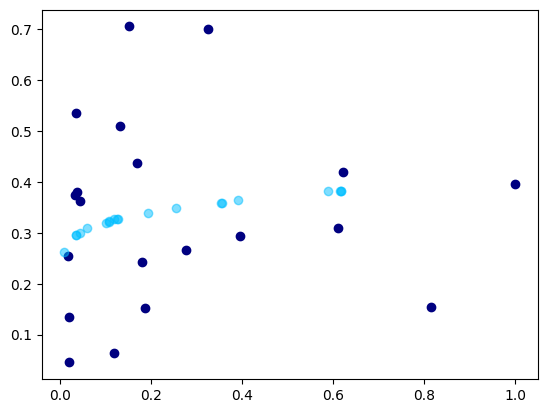

 30%|███████████████████████▌                                                        | 295/1000 [00:52<01:55,  6.09it/s]

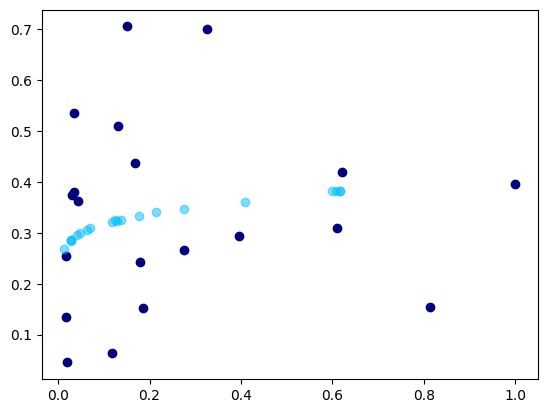

 30%|███████████████████████▋                                                        | 296/1000 [00:52<01:54,  6.12it/s]

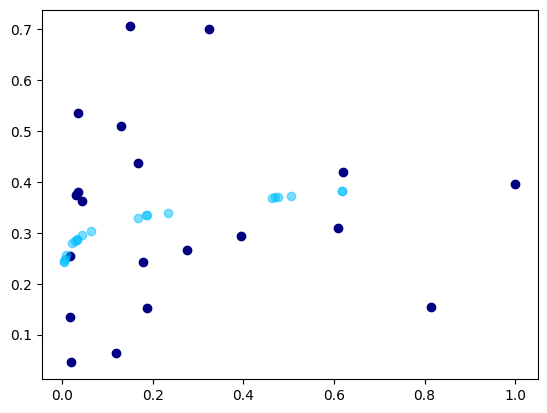

 30%|███████████████████████▊                                                        | 297/1000 [00:53<01:54,  6.15it/s]

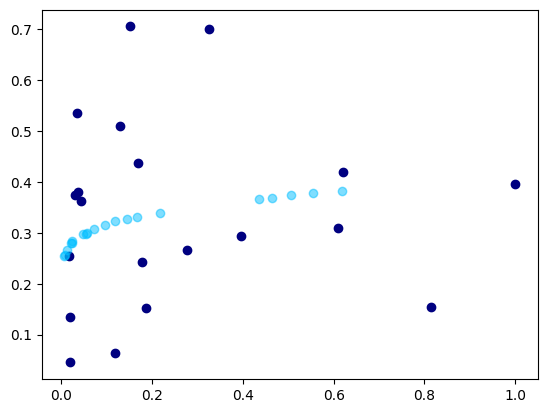

 30%|███████████████████████▊                                                        | 298/1000 [00:53<01:54,  6.14it/s]

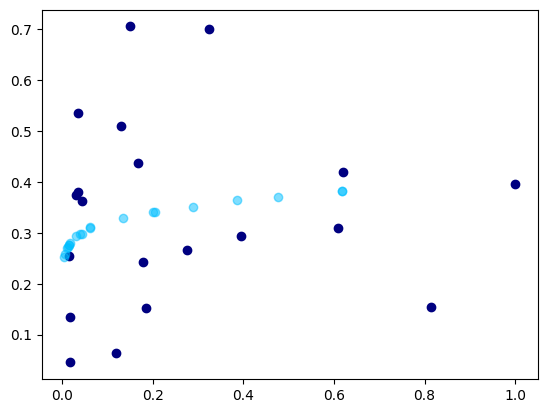

 30%|███████████████████████▉                                                        | 299/1000 [00:53<01:54,  6.12it/s]

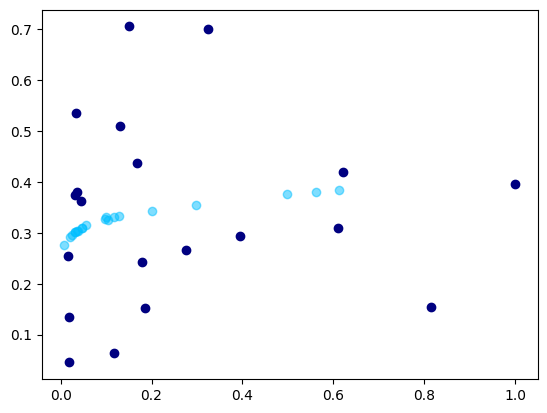

 30%|████████████████████████                                                        | 300/1000 [00:53<01:57,  5.97it/s]

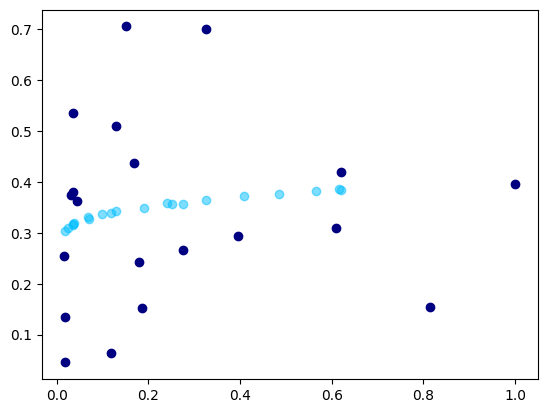

 30%|████████████████████████                                                        | 301/1000 [00:53<02:03,  5.65it/s]

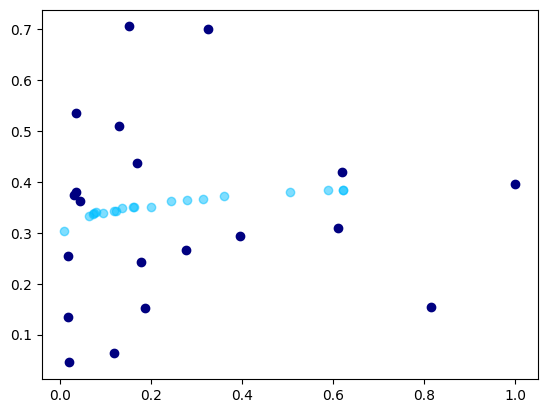

 30%|████████████████████████▏                                                       | 302/1000 [00:53<02:02,  5.68it/s]

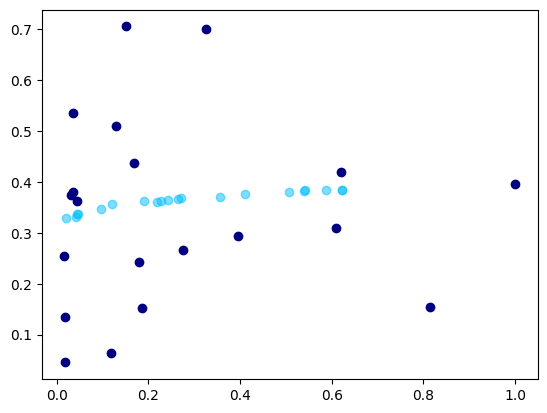

 30%|████████████████████████▏                                                       | 303/1000 [00:54<02:01,  5.74it/s]

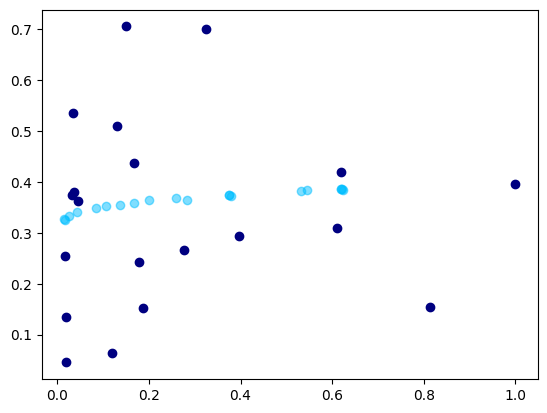

 30%|████████████████████████▎                                                       | 304/1000 [00:54<02:03,  5.63it/s]

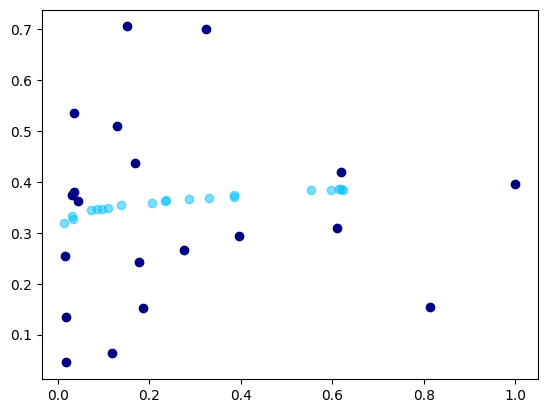

 30%|████████████████████████▍                                                       | 305/1000 [00:54<02:03,  5.62it/s]

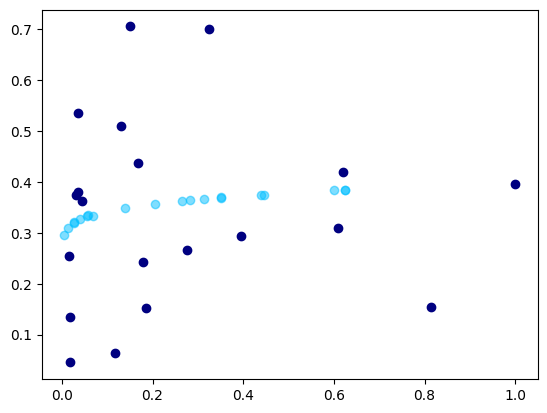

 31%|████████████████████████▍                                                       | 306/1000 [00:54<02:05,  5.51it/s]

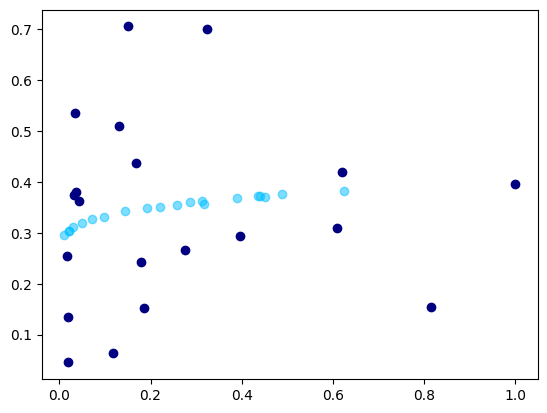

 31%|████████████████████████▌                                                       | 307/1000 [00:54<02:09,  5.34it/s]

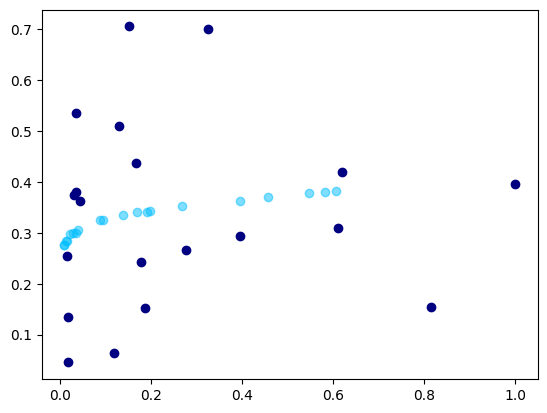

 31%|████████████████████████▋                                                       | 308/1000 [00:55<02:05,  5.53it/s]

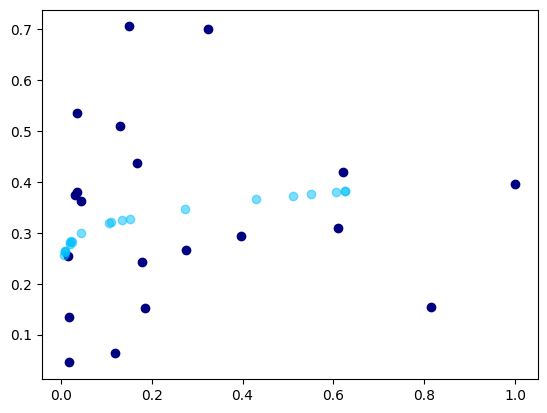

 31%|████████████████████████▋                                                       | 309/1000 [00:55<02:08,  5.38it/s]

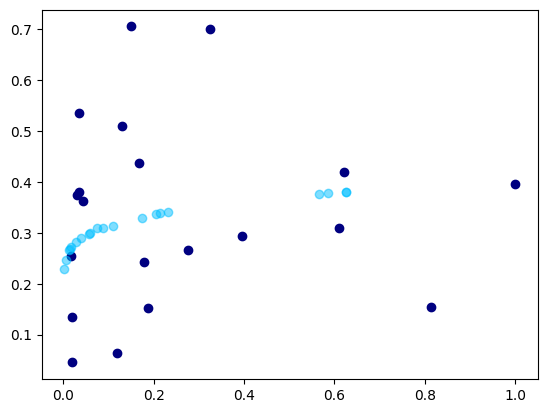

 31%|████████████████████████▊                                                       | 310/1000 [00:55<02:03,  5.58it/s]

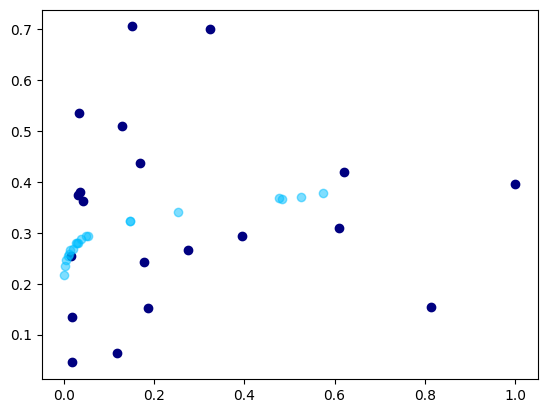

 31%|████████████████████████▉                                                       | 311/1000 [00:55<02:01,  5.65it/s]

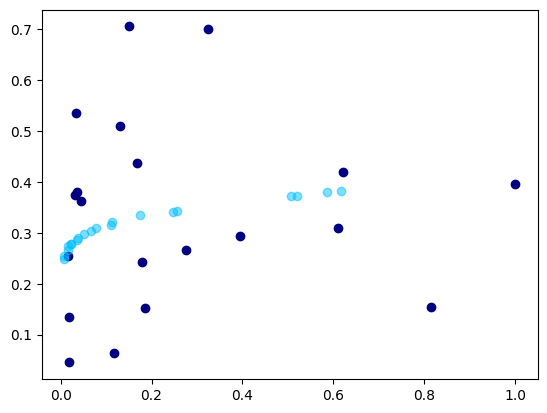

 31%|████████████████████████▉                                                       | 312/1000 [00:55<01:58,  5.79it/s]

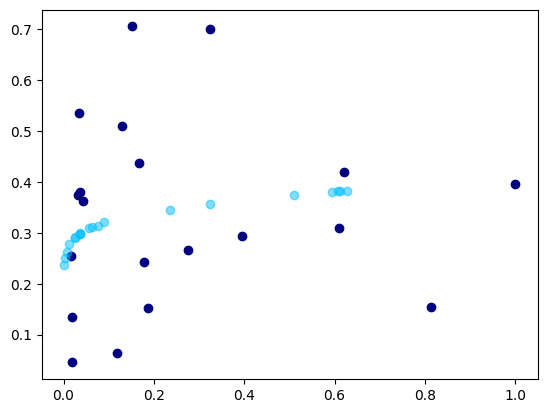

 31%|█████████████████████████                                                       | 313/1000 [00:55<01:57,  5.83it/s]

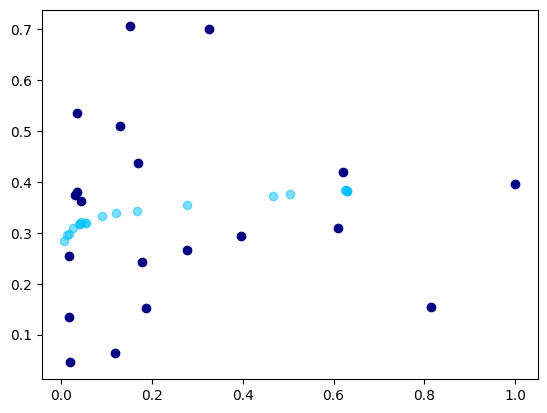

 31%|█████████████████████████                                                       | 314/1000 [00:56<01:56,  5.91it/s]

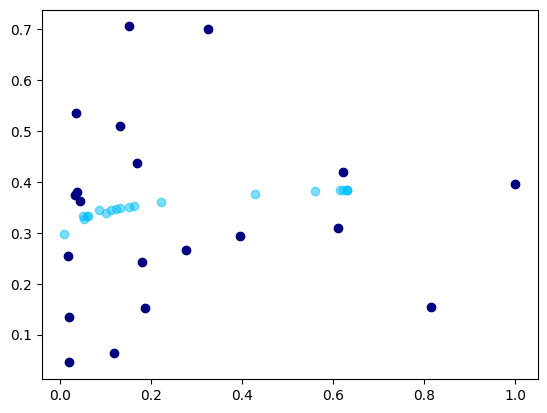

 32%|█████████████████████████▏                                                      | 315/1000 [00:56<01:58,  5.79it/s]

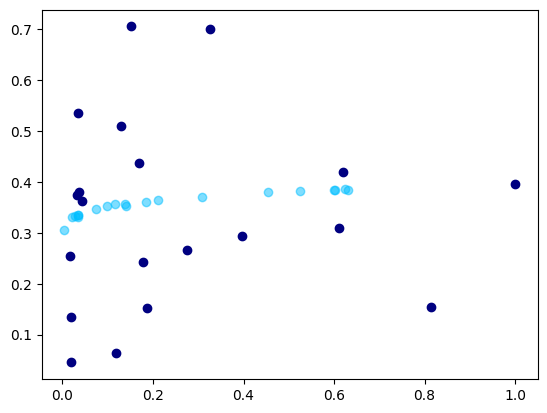

 32%|█████████████████████████▎                                                      | 316/1000 [00:56<02:02,  5.59it/s]

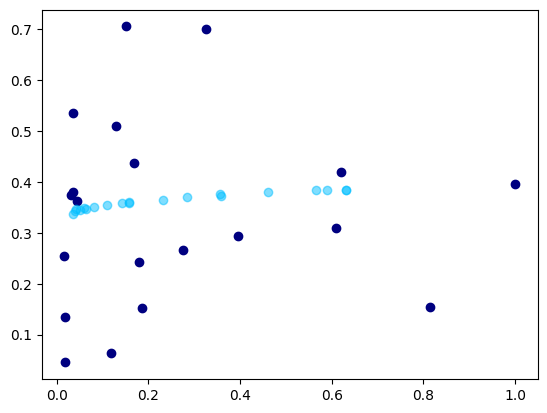

 32%|█████████████████████████▎                                                      | 317/1000 [00:56<02:00,  5.68it/s]

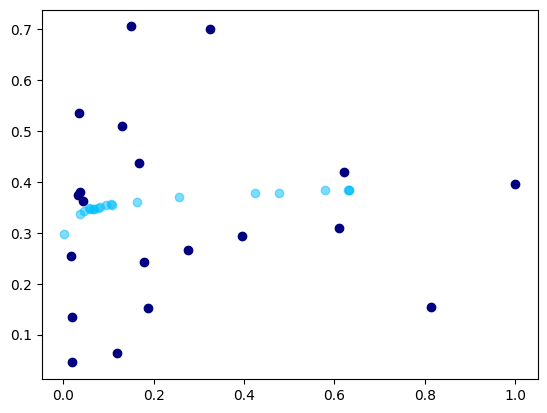

 32%|█████████████████████████▍                                                      | 318/1000 [00:56<01:56,  5.83it/s]

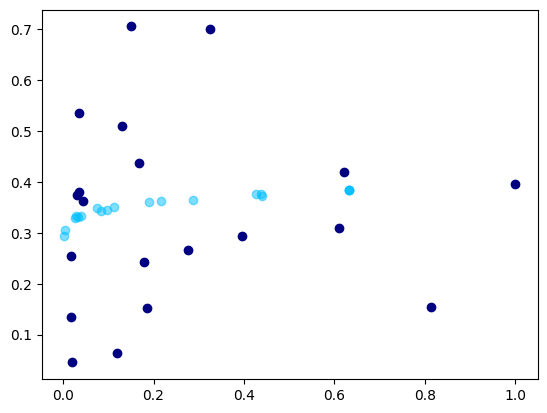

 32%|█████████████████████████▌                                                      | 319/1000 [00:56<01:56,  5.86it/s]

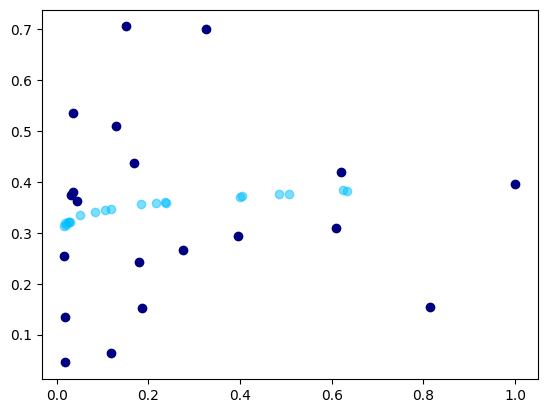

 32%|█████████████████████████▌                                                      | 320/1000 [00:57<01:54,  5.91it/s]

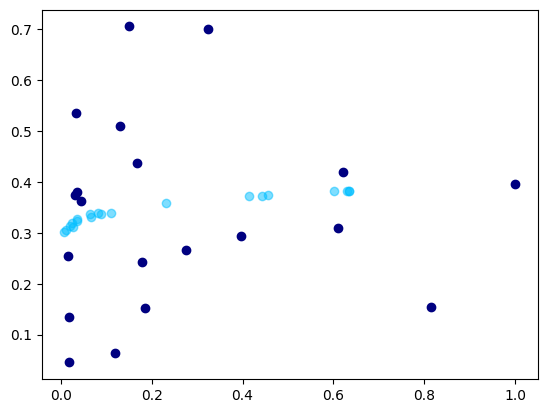

 32%|█████████████████████████▋                                                      | 321/1000 [00:57<01:54,  5.91it/s]

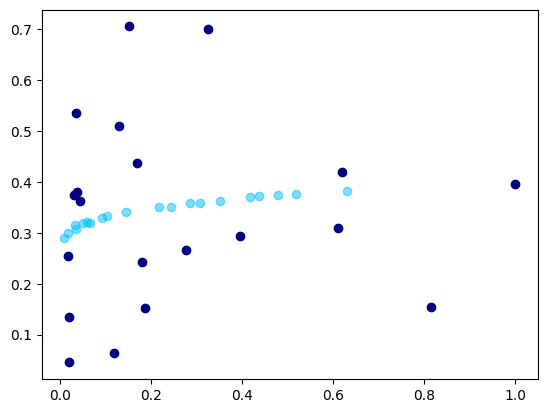

 32%|█████████████████████████▊                                                      | 322/1000 [00:57<01:55,  5.89it/s]

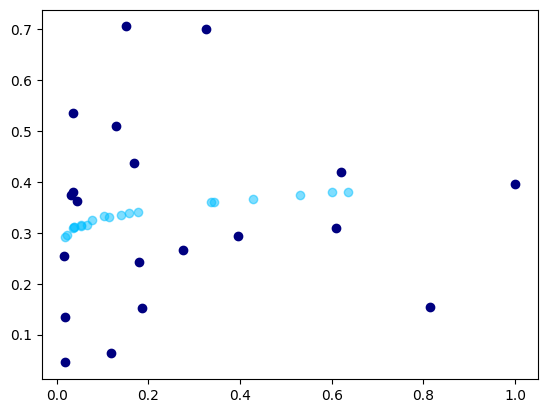

 32%|█████████████████████████▊                                                      | 323/1000 [00:57<01:54,  5.91it/s]

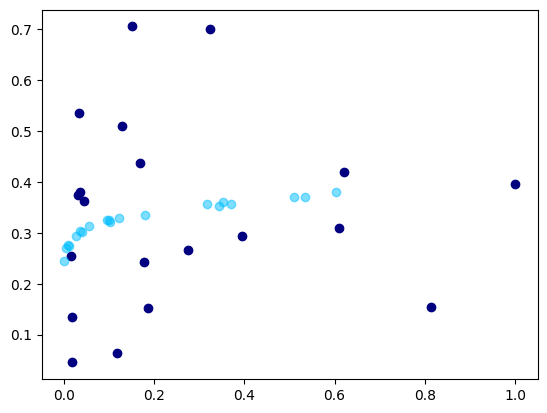

 32%|█████████████████████████▉                                                      | 324/1000 [00:57<01:53,  5.94it/s]

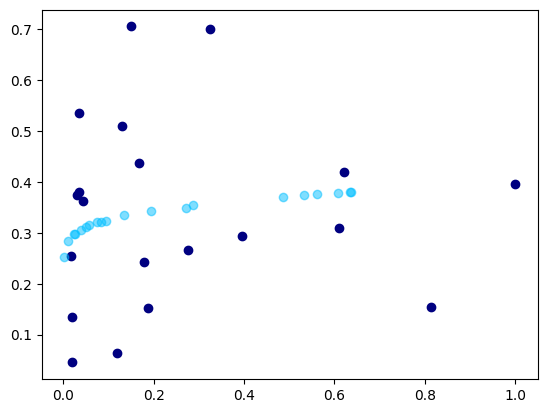

 32%|██████████████████████████                                                      | 325/1000 [00:57<01:53,  5.94it/s]

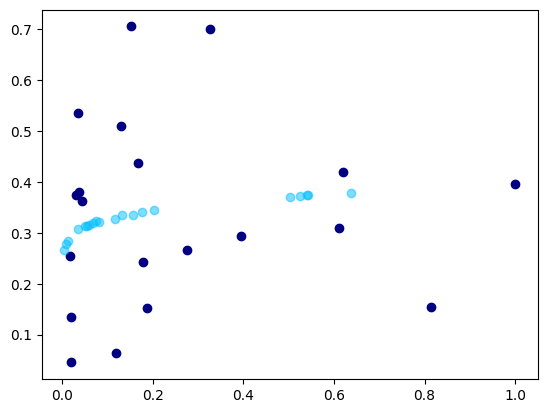

 33%|██████████████████████████                                                      | 326/1000 [00:58<01:53,  5.95it/s]

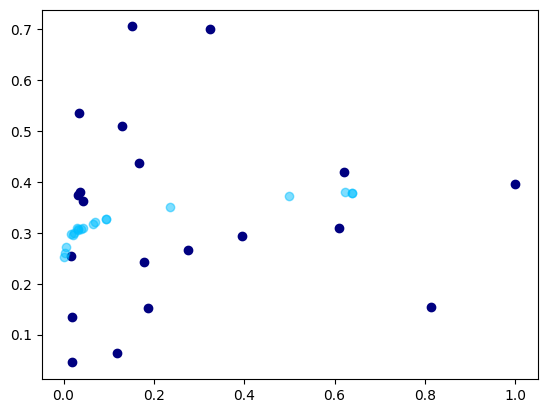

 33%|██████████████████████████▏                                                     | 327/1000 [00:58<01:52,  5.97it/s]

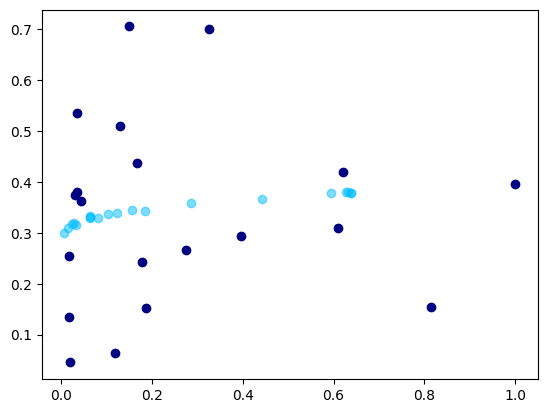

 33%|██████████████████████████▏                                                     | 328/1000 [00:58<01:52,  5.95it/s]

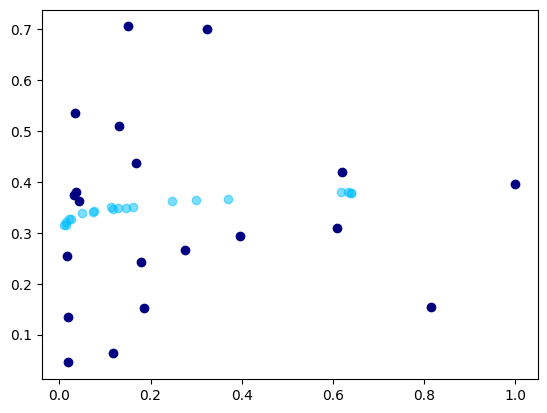

 33%|██████████████████████████▎                                                     | 329/1000 [00:58<01:52,  5.98it/s]

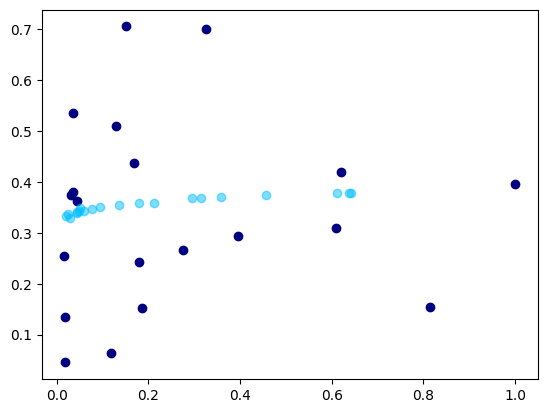

 33%|██████████████████████████▍                                                     | 330/1000 [00:58<01:52,  5.98it/s]

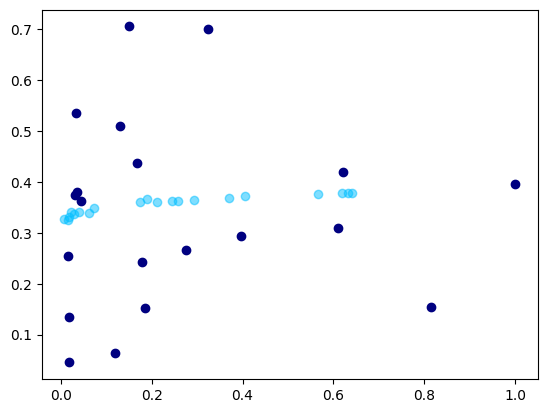

 33%|██████████████████████████▍                                                     | 331/1000 [00:58<01:51,  6.00it/s]

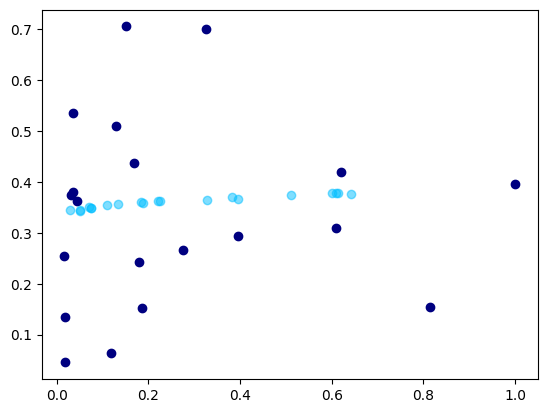

 33%|██████████████████████████▌                                                     | 332/1000 [00:59<01:51,  5.98it/s]

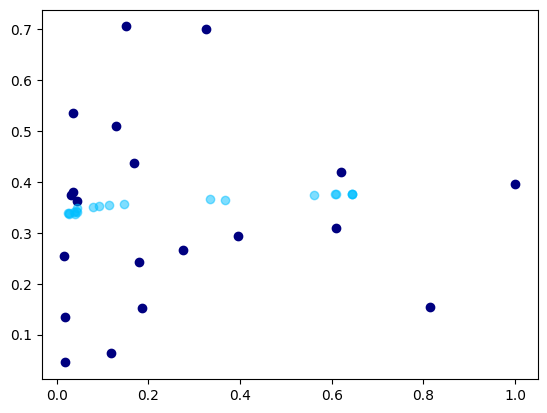

 33%|██████████████████████████▋                                                     | 333/1000 [00:59<01:51,  6.00it/s]

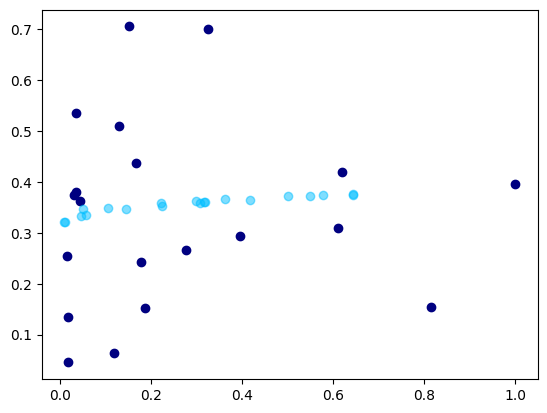

 33%|██████████████████████████▋                                                     | 334/1000 [00:59<01:50,  6.02it/s]

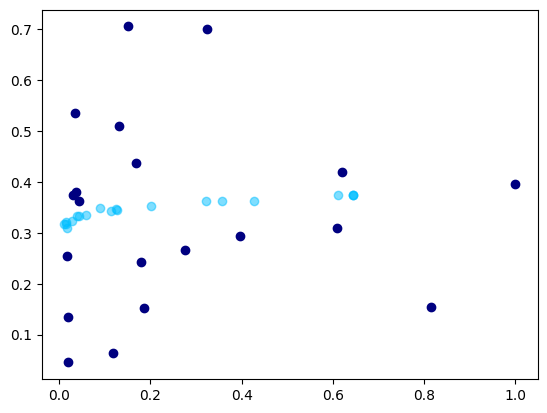

 34%|██████████████████████████▊                                                     | 335/1000 [00:59<01:50,  6.04it/s]

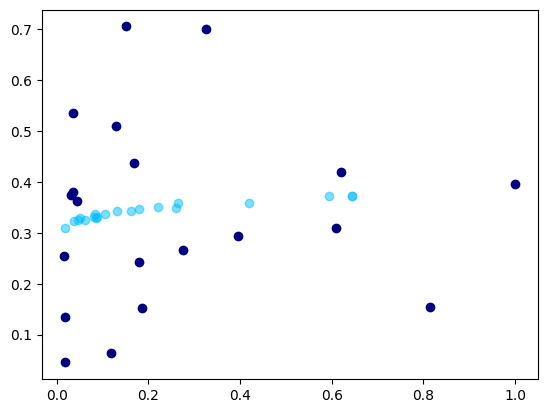

 34%|██████████████████████████▉                                                     | 336/1000 [00:59<01:52,  5.89it/s]

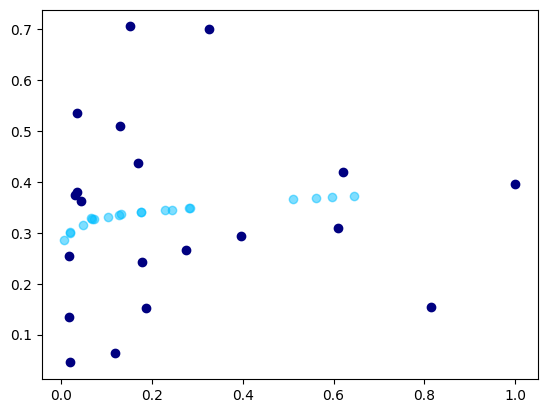

 34%|██████████████████████████▉                                                     | 337/1000 [01:00<01:54,  5.81it/s]

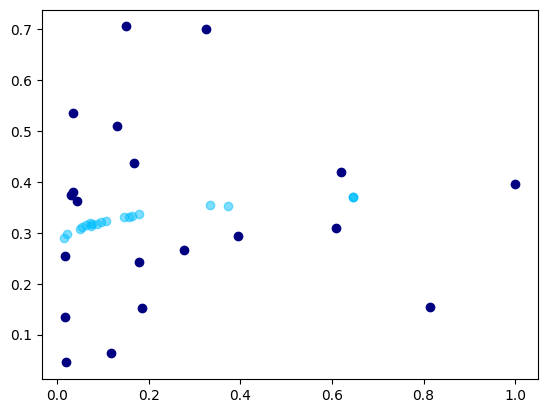

 34%|███████████████████████████                                                     | 338/1000 [01:00<01:55,  5.74it/s]

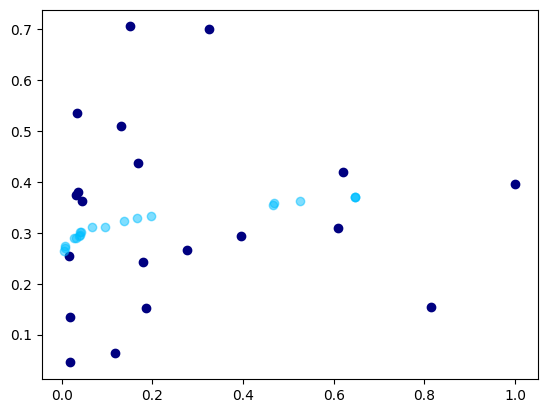

 34%|███████████████████████████                                                     | 339/1000 [01:00<01:53,  5.82it/s]

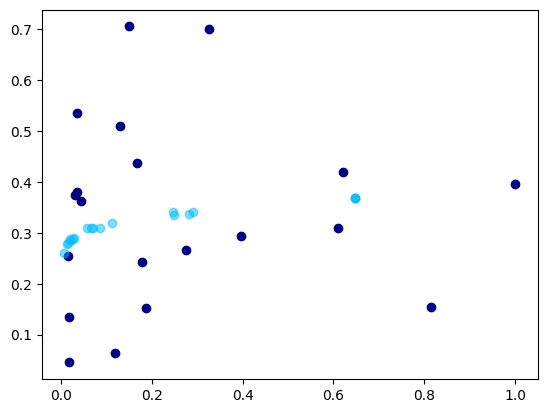

 34%|███████████████████████████▏                                                    | 340/1000 [01:00<01:51,  5.90it/s]

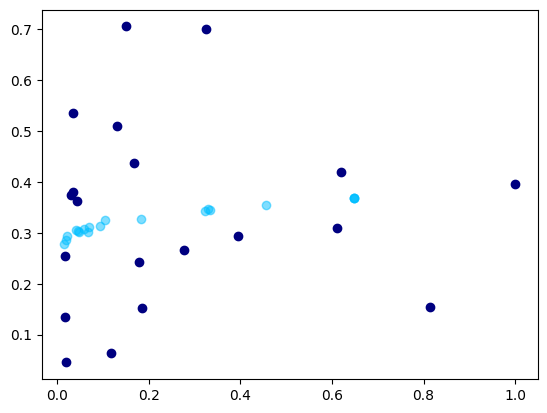

 34%|███████████████████████████▎                                                    | 341/1000 [01:00<01:50,  5.96it/s]

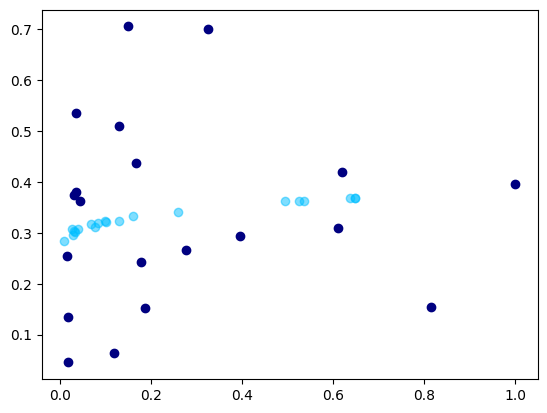

 34%|███████████████████████████▎                                                    | 342/1000 [01:00<01:51,  5.89it/s]

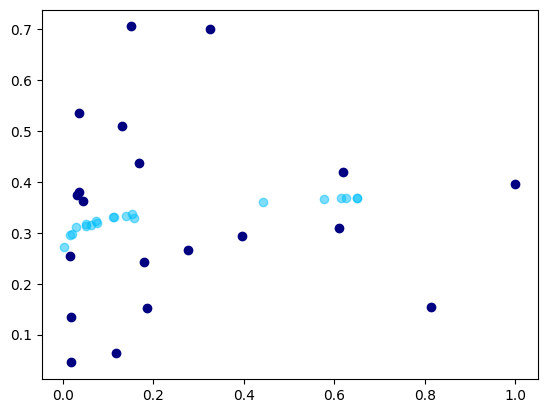

 34%|███████████████████████████▍                                                    | 343/1000 [01:01<02:00,  5.47it/s]

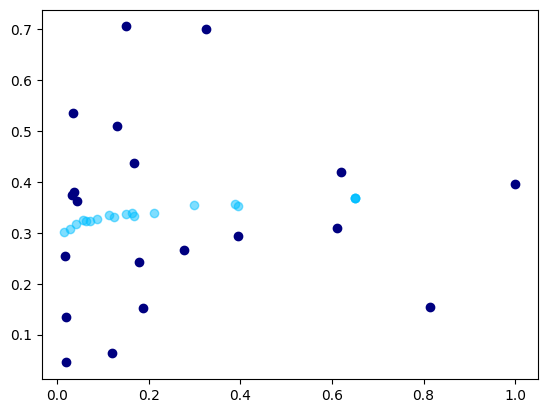

 34%|███████████████████████████▌                                                    | 344/1000 [01:01<02:00,  5.43it/s]

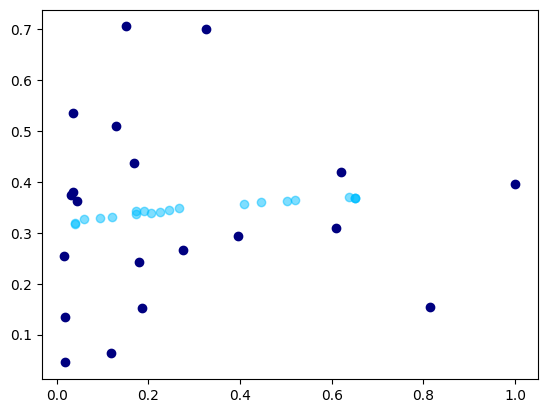

 34%|███████████████████████████▌                                                    | 345/1000 [01:01<01:57,  5.59it/s]

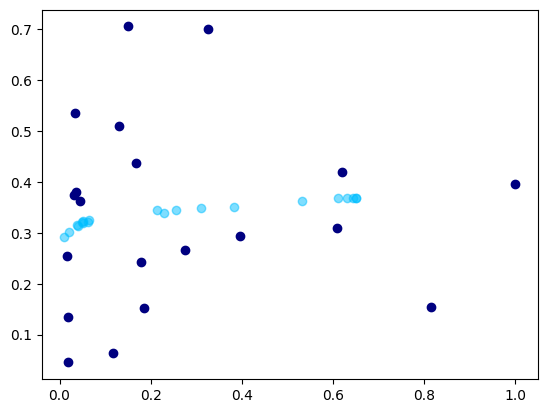

 35%|███████████████████████████▋                                                    | 346/1000 [01:01<01:55,  5.67it/s]

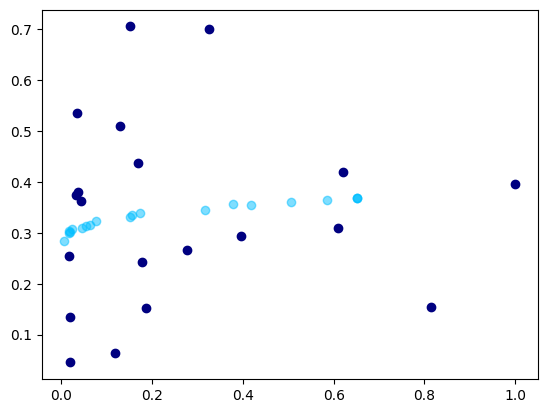

 35%|███████████████████████████▊                                                    | 347/1000 [01:01<02:08,  5.08it/s]

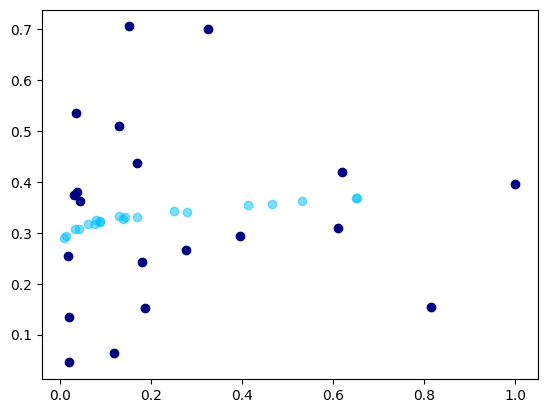

 35%|███████████████████████████▊                                                    | 348/1000 [01:02<02:02,  5.33it/s]

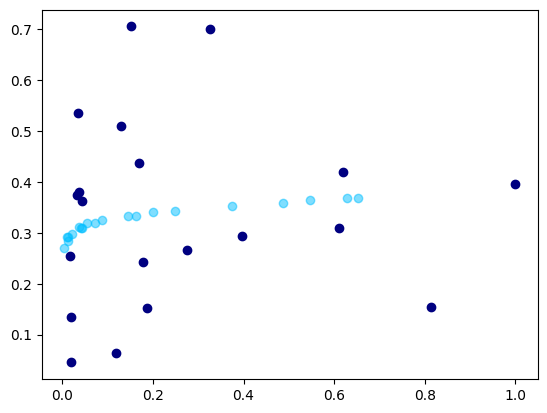

 35%|███████████████████████████▉                                                    | 349/1000 [01:02<01:58,  5.51it/s]

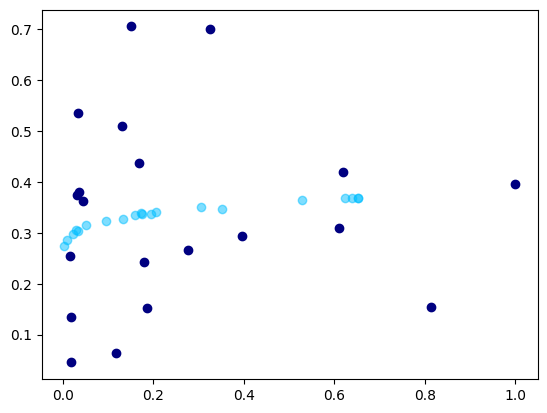

 35%|████████████████████████████                                                    | 350/1000 [01:02<01:55,  5.62it/s]

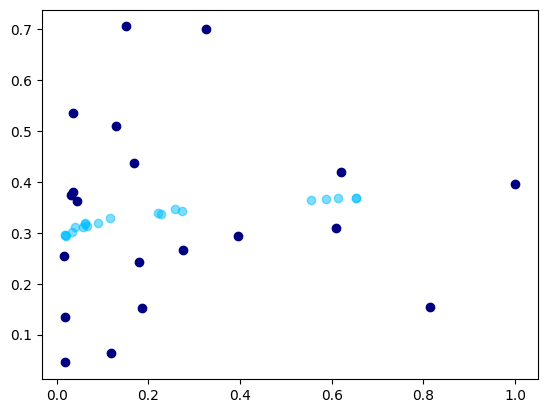

 35%|████████████████████████████                                                    | 351/1000 [01:02<01:53,  5.73it/s]

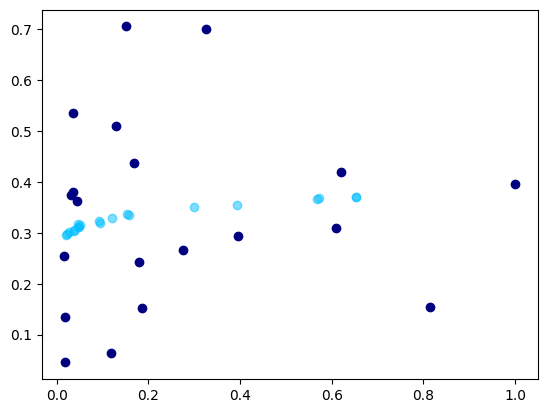

 35%|████████████████████████████▏                                                   | 352/1000 [01:02<01:50,  5.85it/s]

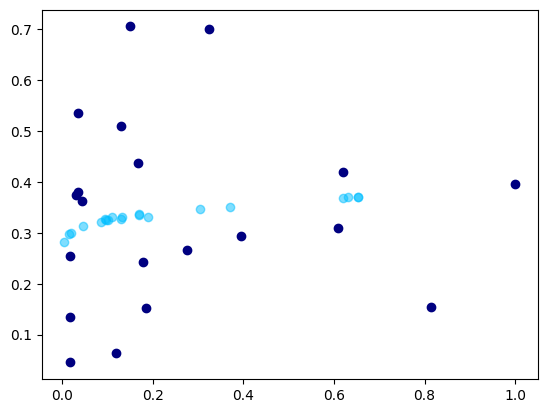

 35%|████████████████████████████▏                                                   | 353/1000 [01:03<03:19,  3.24it/s]

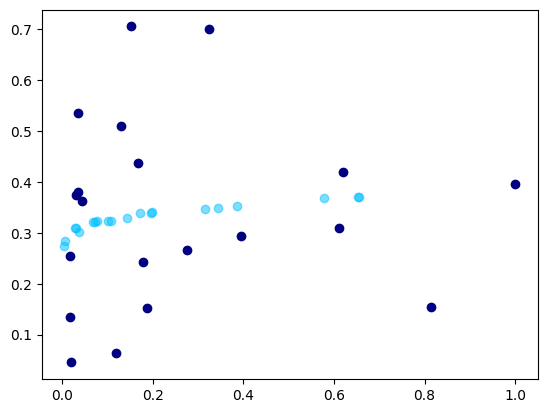

 35%|████████████████████████████▎                                                   | 354/1000 [01:03<02:50,  3.78it/s]

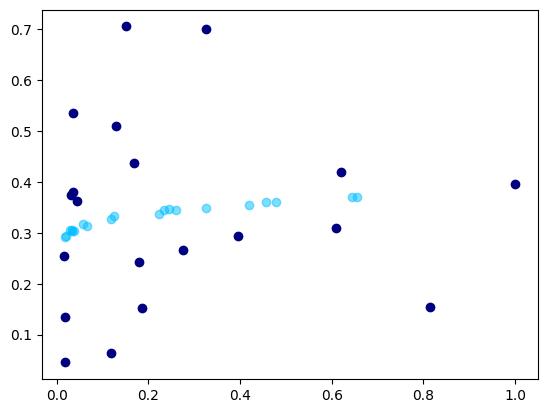

 36%|████████████████████████████▍                                                   | 355/1000 [01:03<02:34,  4.17it/s]

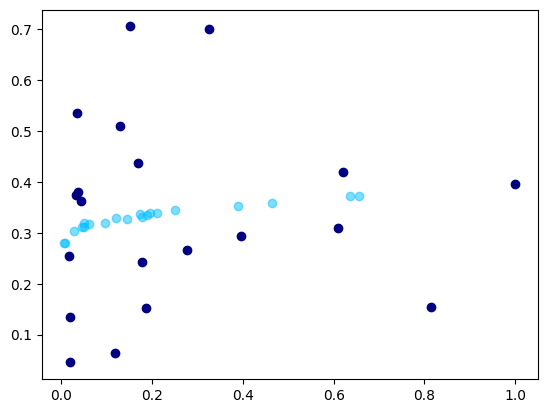

 36%|████████████████████████████▍                                                   | 356/1000 [01:03<02:24,  4.47it/s]

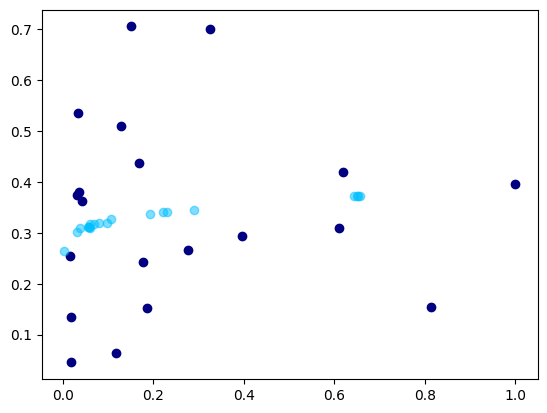

 36%|████████████████████████████▌                                                   | 357/1000 [01:04<02:13,  4.83it/s]

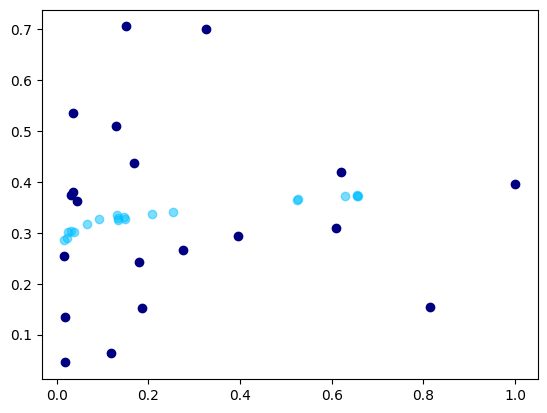

 36%|████████████████████████████▋                                                   | 358/1000 [01:04<02:10,  4.92it/s]

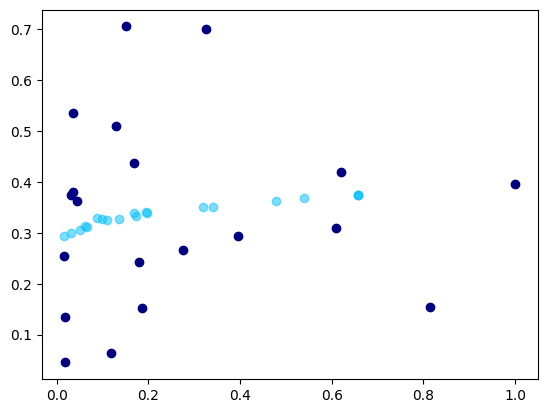

 36%|████████████████████████████▋                                                   | 359/1000 [01:04<02:03,  5.21it/s]

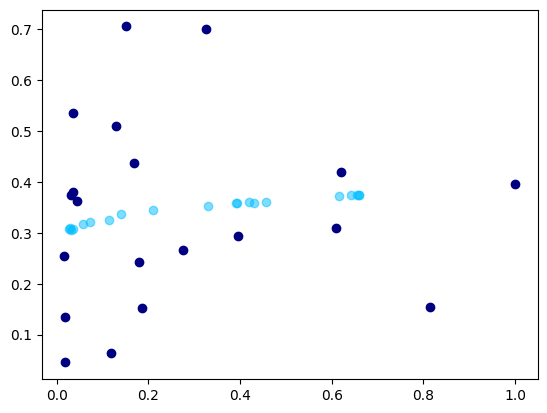

 36%|████████████████████████████▊                                                   | 360/1000 [01:04<01:58,  5.42it/s]

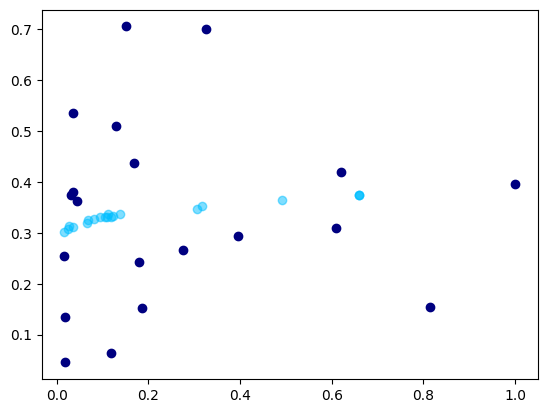

 36%|████████████████████████████▉                                                   | 361/1000 [01:04<01:55,  5.54it/s]

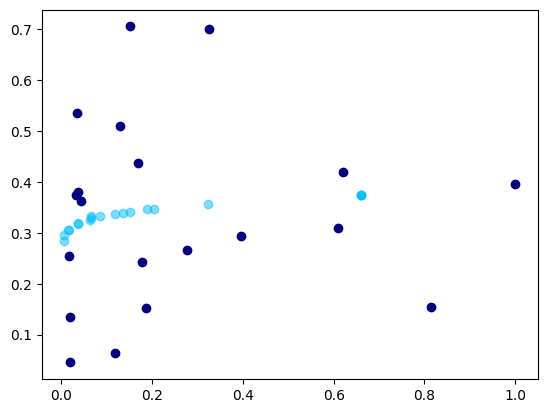

 36%|████████████████████████████▉                                                   | 362/1000 [01:04<01:52,  5.69it/s]

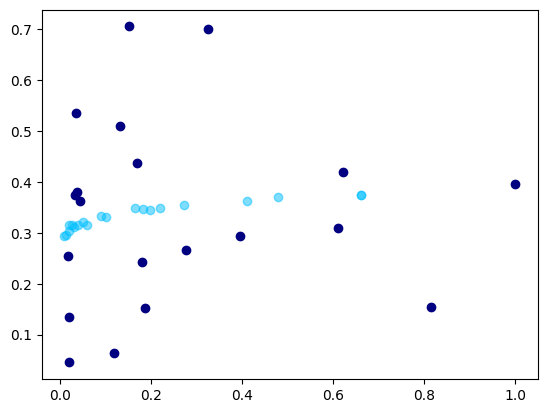

 36%|█████████████████████████████                                                   | 363/1000 [01:05<01:53,  5.62it/s]

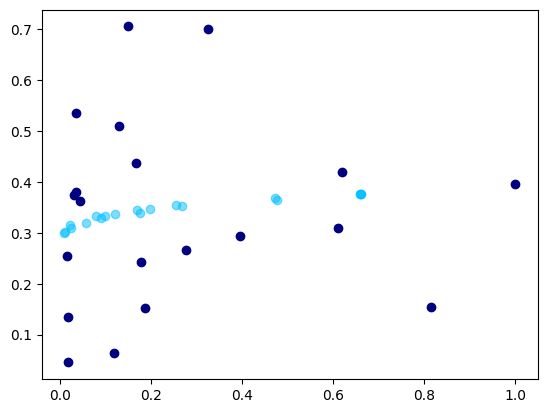

 36%|█████████████████████████████                                                   | 364/1000 [01:05<01:50,  5.73it/s]

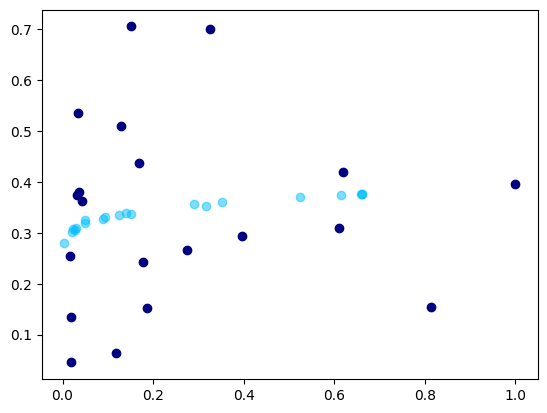

 36%|█████████████████████████████▏                                                  | 365/1000 [01:05<01:49,  5.81it/s]

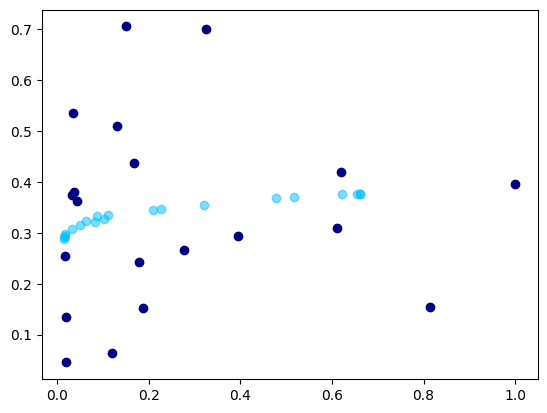

 37%|█████████████████████████████▎                                                  | 366/1000 [01:05<01:49,  5.80it/s]

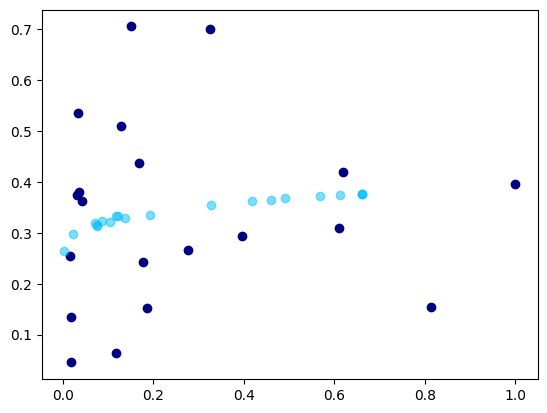

 37%|█████████████████████████████▎                                                  | 367/1000 [01:05<01:53,  5.59it/s]

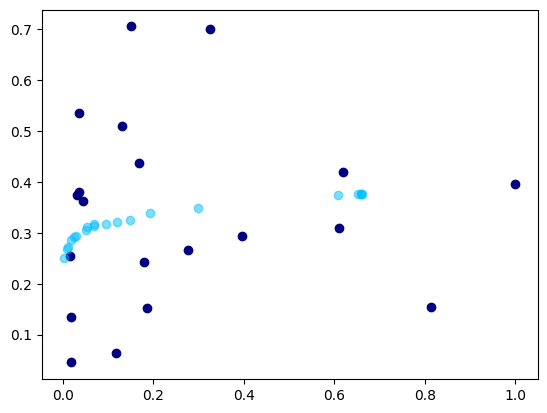

 37%|█████████████████████████████▍                                                  | 368/1000 [01:05<01:54,  5.52it/s]

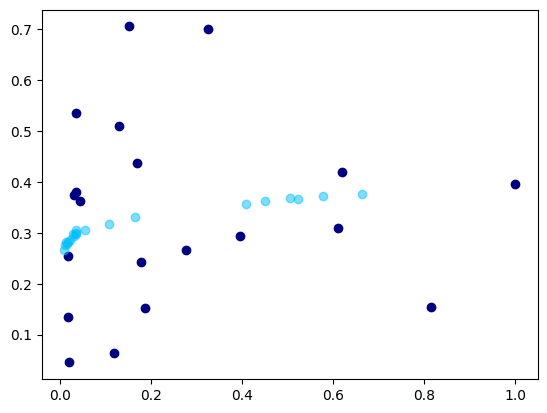

 37%|█████████████████████████████▌                                                  | 369/1000 [01:06<01:51,  5.65it/s]

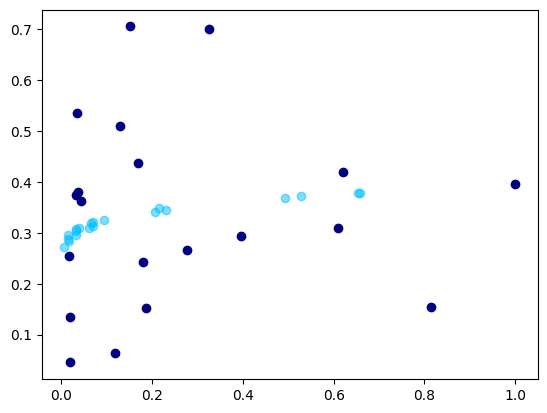

 37%|█████████████████████████████▌                                                  | 370/1000 [01:06<01:50,  5.71it/s]

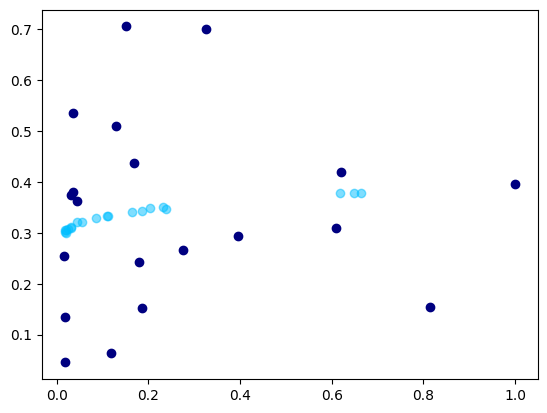

 37%|█████████████████████████████▋                                                  | 371/1000 [01:06<01:48,  5.79it/s]

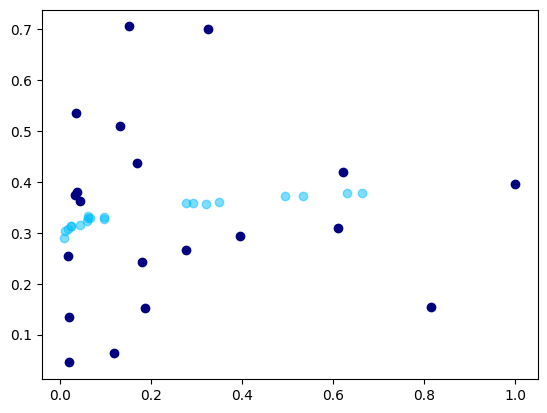

 37%|█████████████████████████████▊                                                  | 372/1000 [01:06<01:47,  5.83it/s]

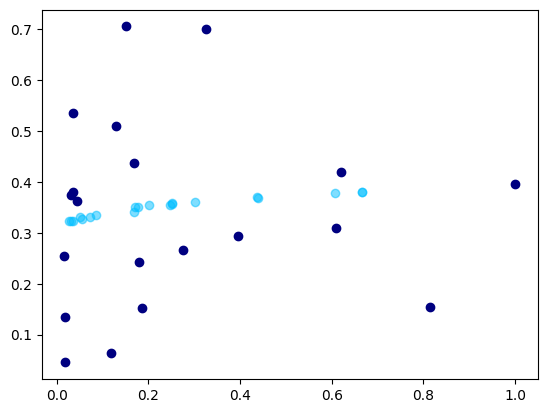

 37%|█████████████████████████████▊                                                  | 373/1000 [01:06<01:48,  5.77it/s]

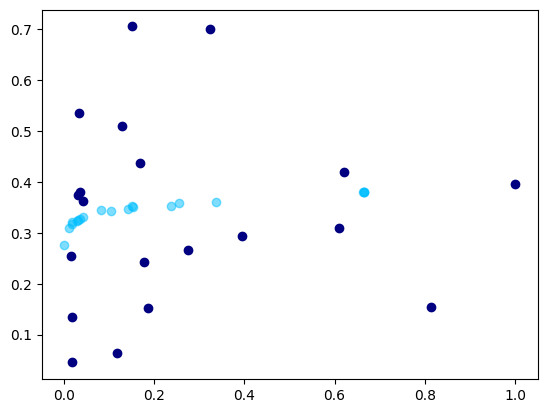

 37%|█████████████████████████████▉                                                  | 374/1000 [01:06<01:47,  5.84it/s]

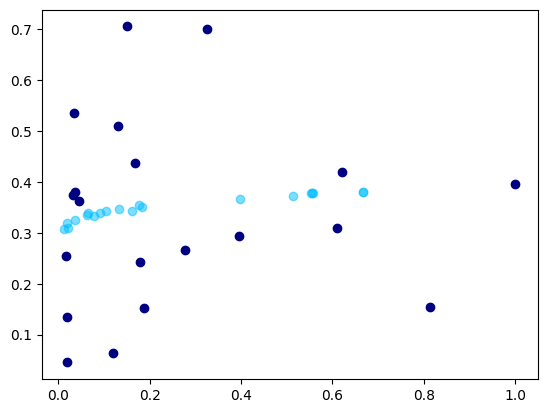

 38%|██████████████████████████████                                                  | 375/1000 [01:07<01:45,  5.93it/s]

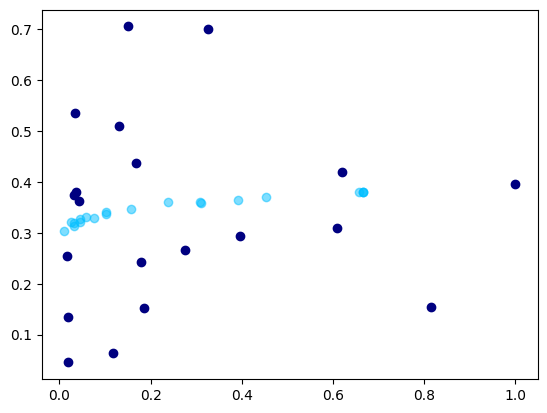

 38%|██████████████████████████████                                                  | 376/1000 [01:07<01:47,  5.82it/s]

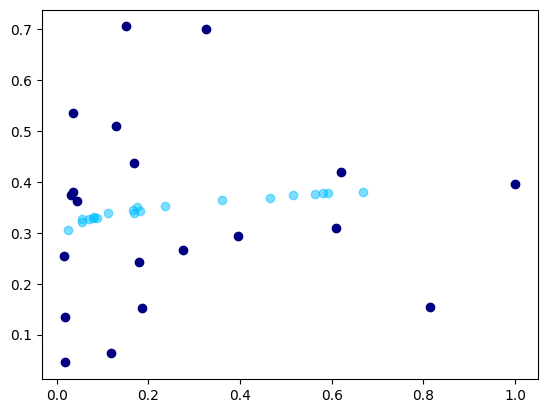

 38%|██████████████████████████████▏                                                 | 377/1000 [01:07<01:45,  5.89it/s]

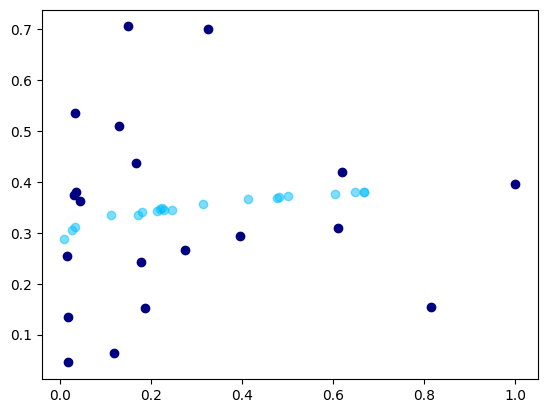

 38%|██████████████████████████████▏                                                 | 378/1000 [01:07<01:45,  5.92it/s]

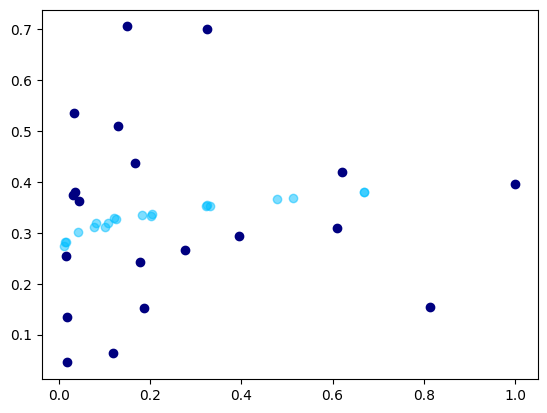

 38%|██████████████████████████████▎                                                 | 379/1000 [01:07<01:44,  5.96it/s]

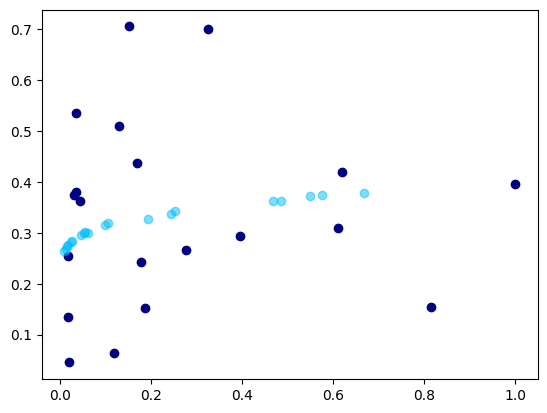

 38%|██████████████████████████████▍                                                 | 380/1000 [01:07<01:43,  5.98it/s]

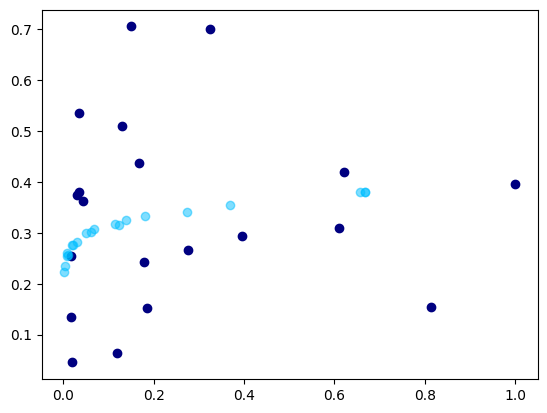

 38%|██████████████████████████████▍                                                 | 381/1000 [01:08<01:46,  5.79it/s]

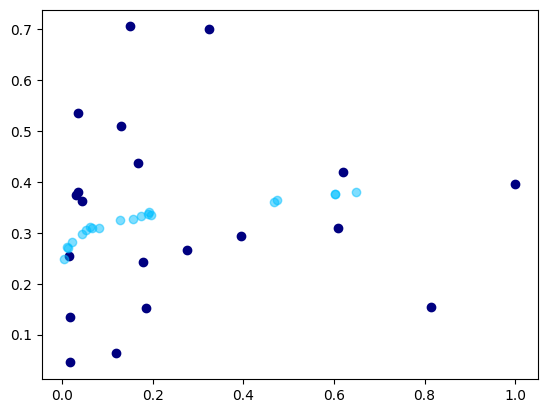

 38%|██████████████████████████████▌                                                 | 382/1000 [01:08<01:45,  5.86it/s]

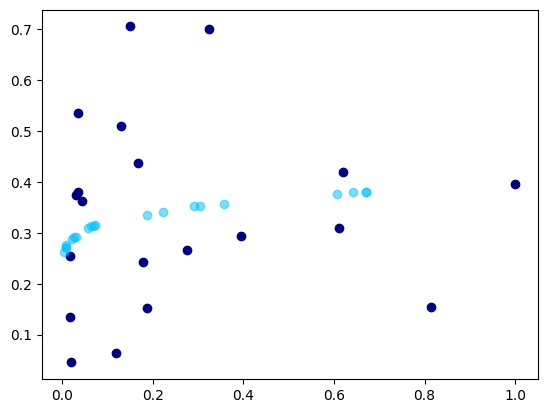

 38%|██████████████████████████████▋                                                 | 383/1000 [01:08<01:45,  5.86it/s]

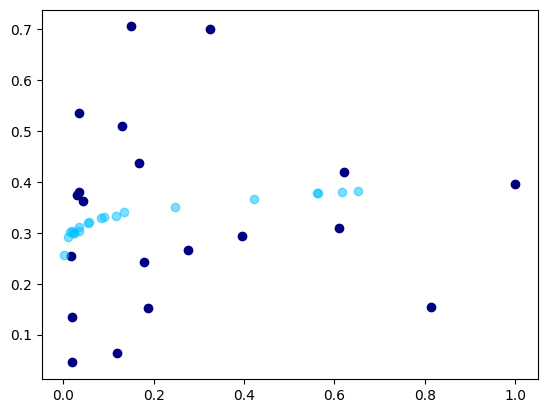

 38%|██████████████████████████████▋                                                 | 384/1000 [01:08<01:44,  5.91it/s]

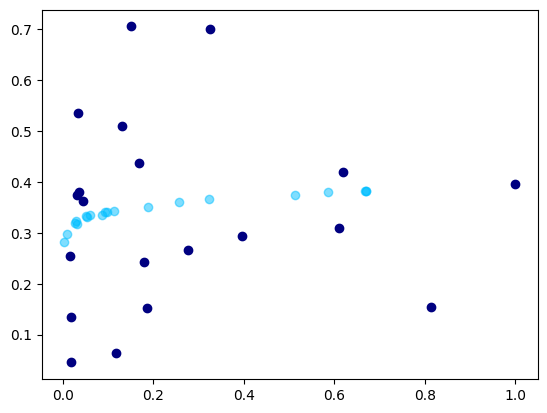

 38%|██████████████████████████████▊                                                 | 385/1000 [01:08<01:45,  5.83it/s]

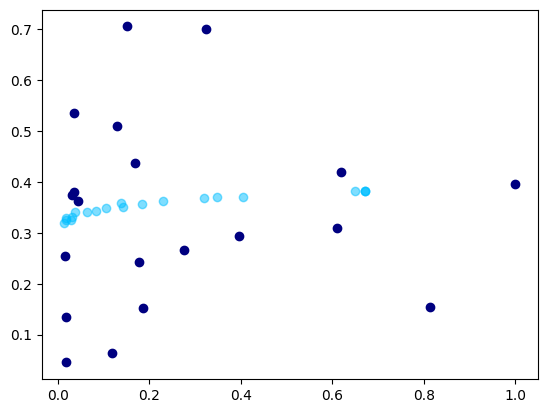

 39%|██████████████████████████████▉                                                 | 386/1000 [01:08<01:43,  5.92it/s]

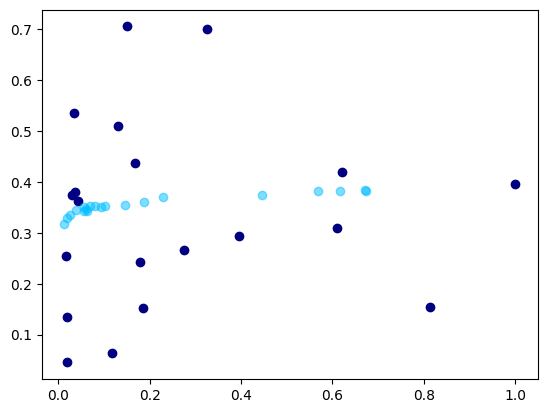

 39%|██████████████████████████████▉                                                 | 387/1000 [01:09<01:43,  5.93it/s]

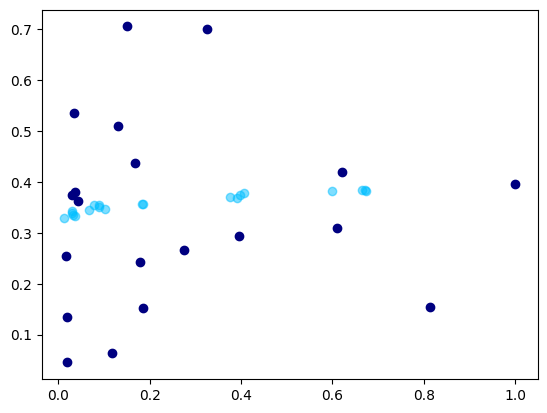

 39%|███████████████████████████████                                                 | 388/1000 [01:09<01:42,  5.99it/s]

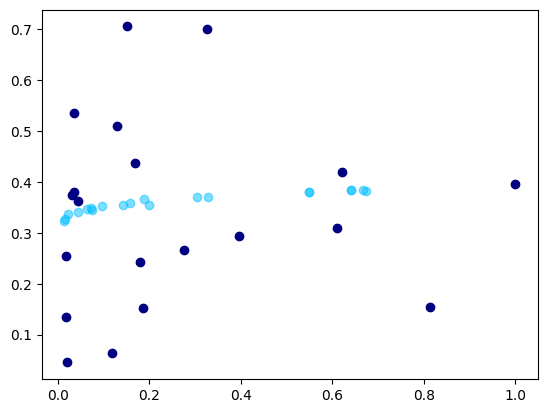

 39%|███████████████████████████████                                                 | 389/1000 [01:09<01:42,  5.98it/s]

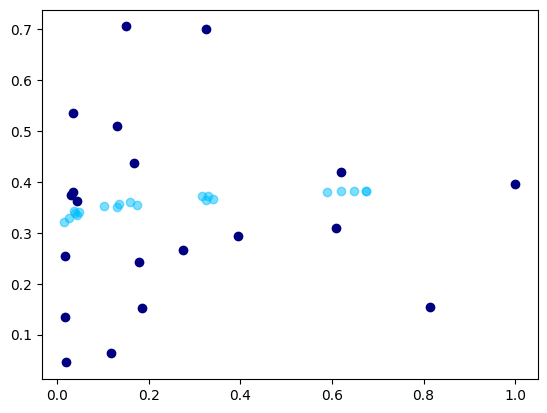

 39%|███████████████████████████████▏                                                | 390/1000 [01:09<01:41,  5.99it/s]

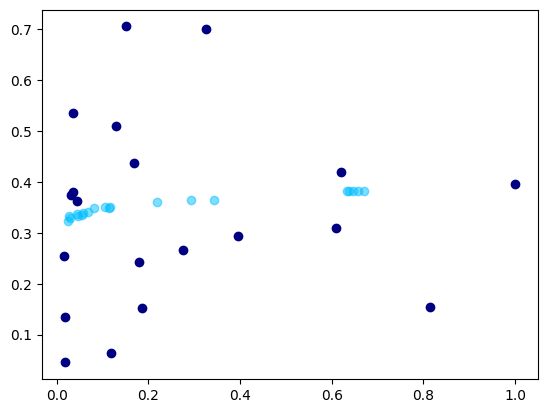

 39%|███████████████████████████████▎                                                | 391/1000 [01:09<01:42,  5.97it/s]

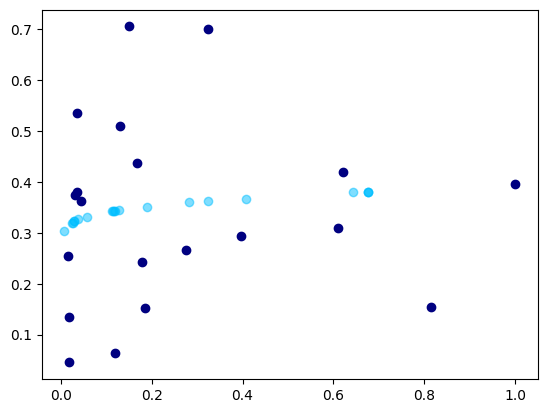

 39%|███████████████████████████████▎                                                | 392/1000 [01:09<01:41,  6.00it/s]

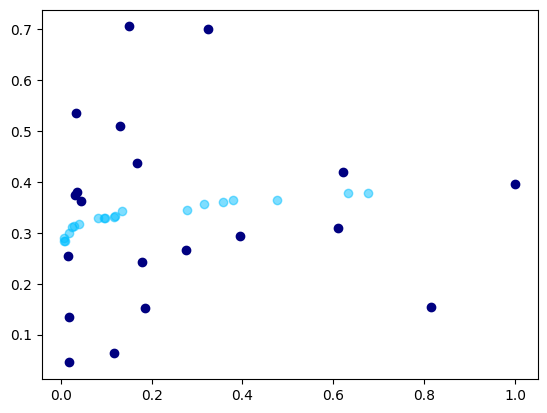

 39%|███████████████████████████████▍                                                | 393/1000 [01:10<01:42,  5.94it/s]

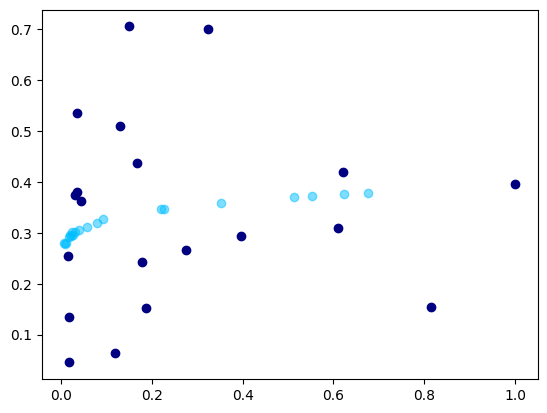

 39%|███████████████████████████████▌                                                | 394/1000 [01:10<01:46,  5.71it/s]

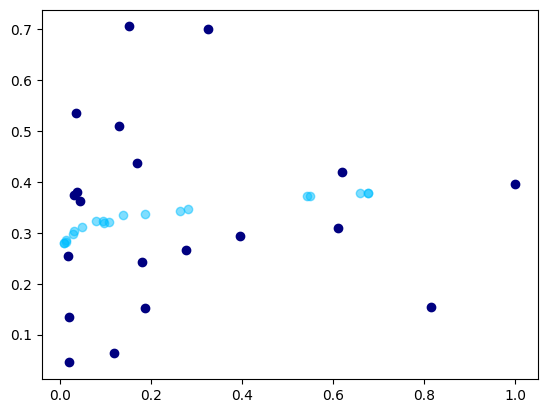

 40%|███████████████████████████████▌                                                | 395/1000 [01:10<01:44,  5.79it/s]

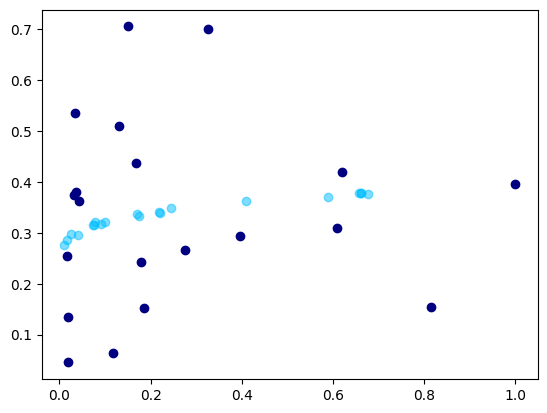

 40%|███████████████████████████████▋                                                | 396/1000 [01:10<01:43,  5.86it/s]

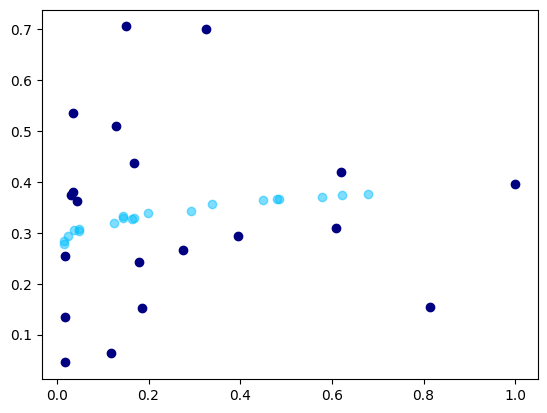

 40%|███████████████████████████████▊                                                | 397/1000 [01:10<01:41,  5.93it/s]

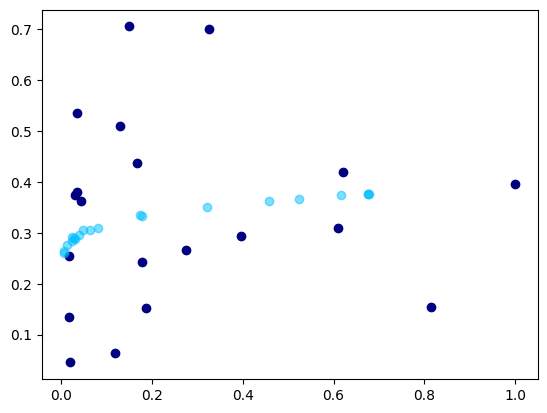

 40%|███████████████████████████████▊                                                | 398/1000 [01:11<01:40,  5.99it/s]

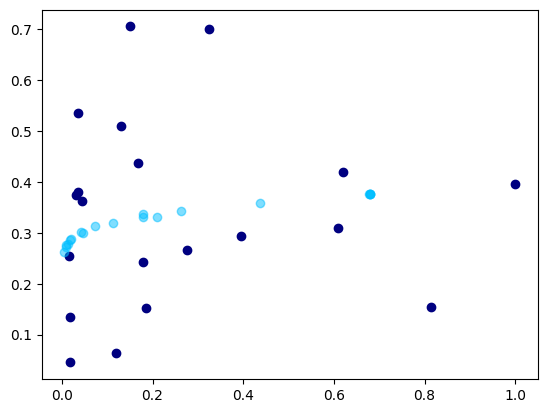

 40%|███████████████████████████████▉                                                | 399/1000 [01:11<01:41,  5.92it/s]

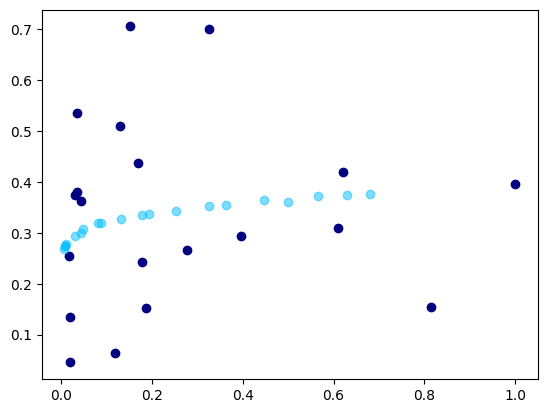

 40%|████████████████████████████████                                                | 400/1000 [01:11<01:41,  5.91it/s]

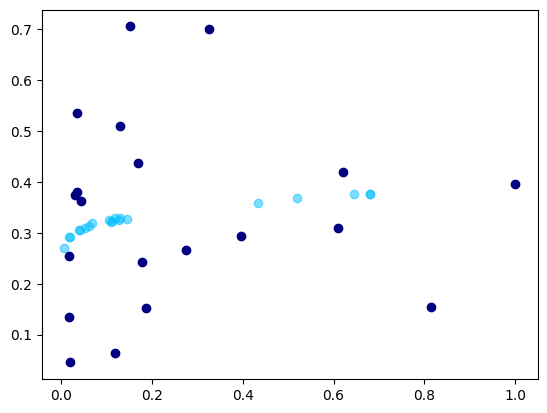

 40%|████████████████████████████████                                                | 401/1000 [01:11<01:41,  5.92it/s]

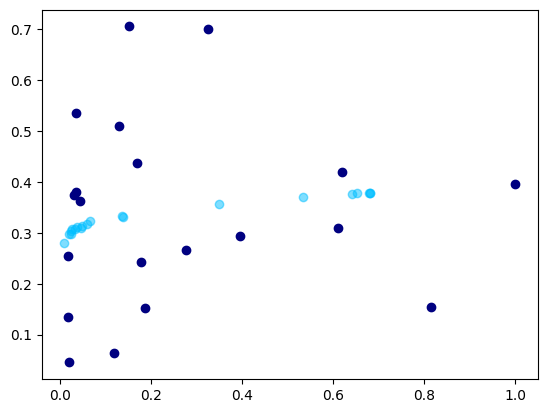

 40%|████████████████████████████████▏                                               | 402/1000 [01:11<01:40,  5.94it/s]

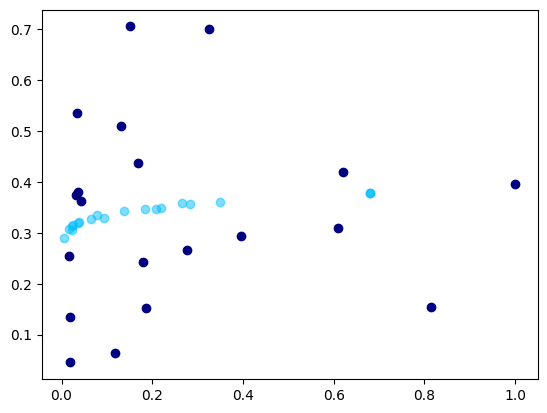

 40%|████████████████████████████████▏                                               | 403/1000 [01:11<01:47,  5.57it/s]

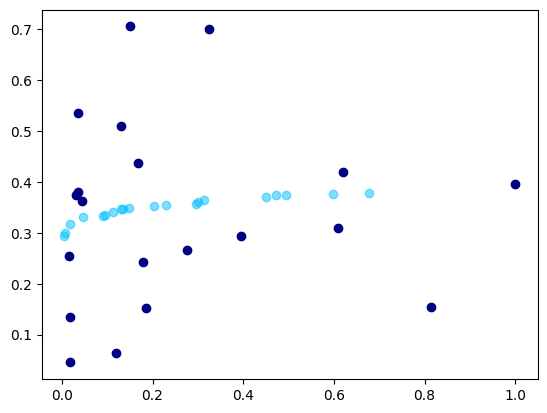

 40%|████████████████████████████████▎                                               | 404/1000 [01:12<01:47,  5.53it/s]

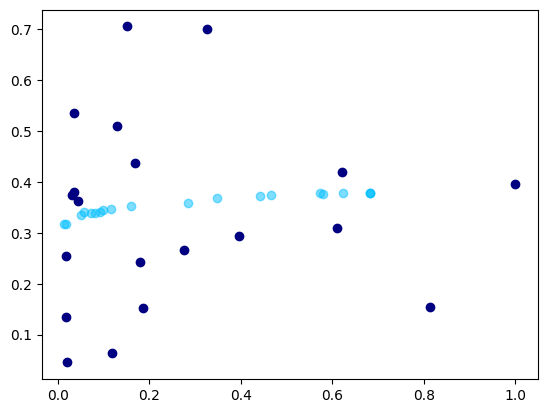

 40%|████████████████████████████████▍                                               | 405/1000 [01:12<01:44,  5.68it/s]

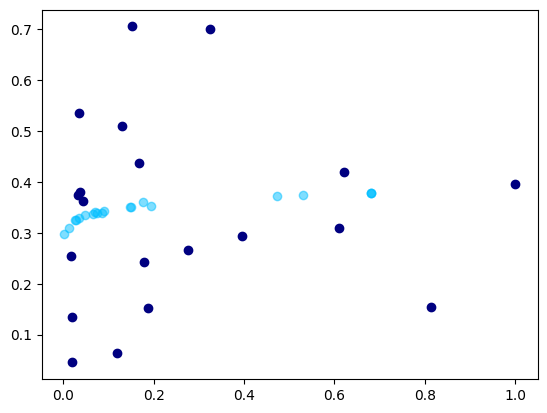

 41%|████████████████████████████████▍                                               | 406/1000 [01:12<01:43,  5.75it/s]

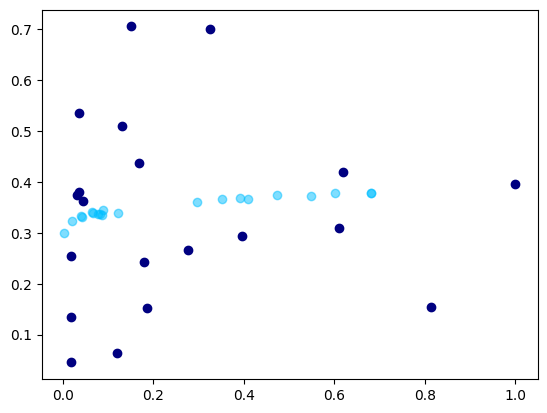

 41%|████████████████████████████████▌                                               | 407/1000 [01:12<01:41,  5.86it/s]

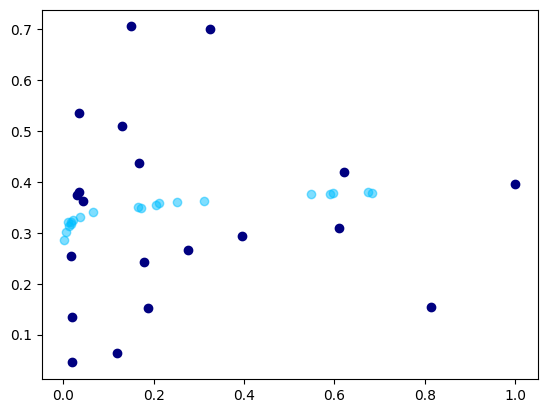

 41%|████████████████████████████████▋                                               | 408/1000 [01:12<01:41,  5.83it/s]

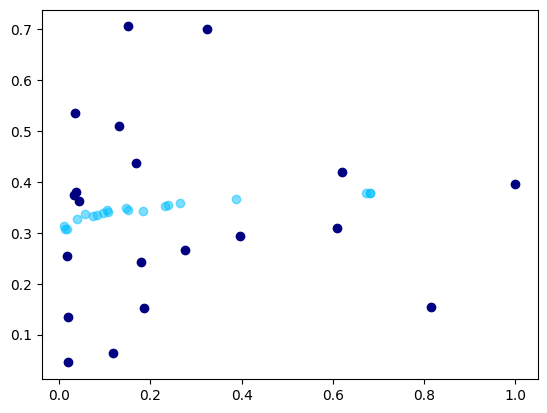

 41%|████████████████████████████████▋                                               | 409/1000 [01:12<01:40,  5.86it/s]

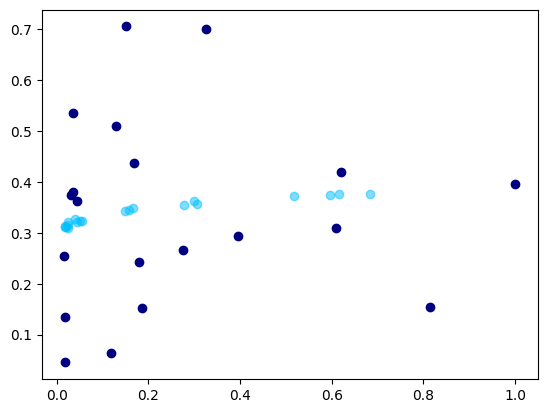

 41%|████████████████████████████████▊                                               | 410/1000 [01:13<01:39,  5.90it/s]

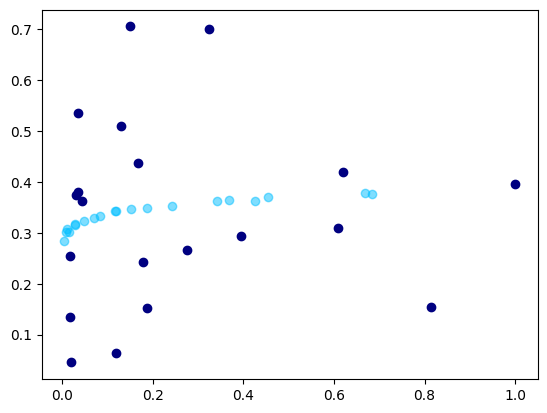

 41%|████████████████████████████████▉                                               | 411/1000 [01:13<01:39,  5.95it/s]

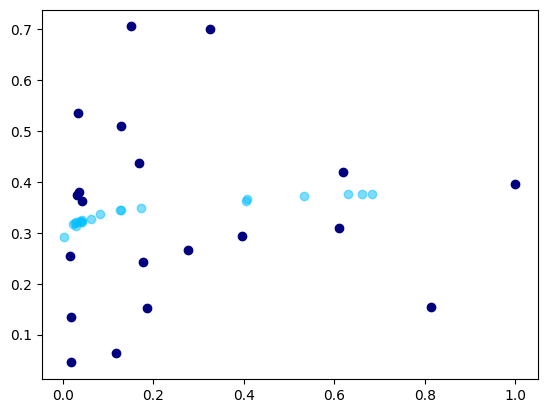

 41%|████████████████████████████████▉                                               | 412/1000 [01:13<01:39,  5.90it/s]

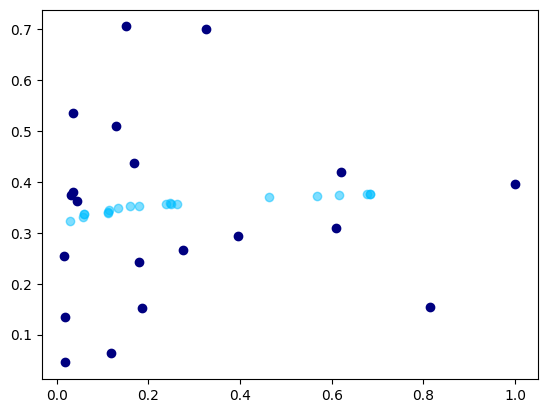

 41%|█████████████████████████████████                                               | 413/1000 [01:13<01:38,  5.93it/s]

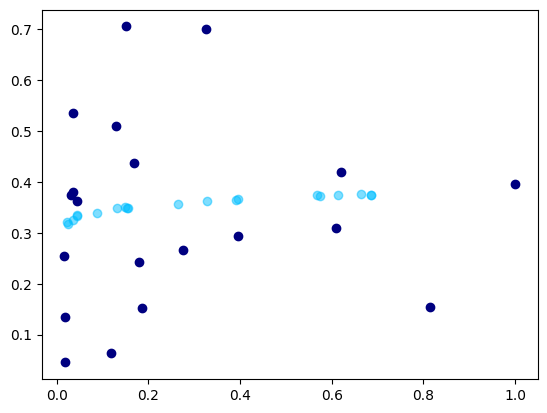

 41%|█████████████████████████████████                                               | 414/1000 [01:13<01:38,  5.93it/s]

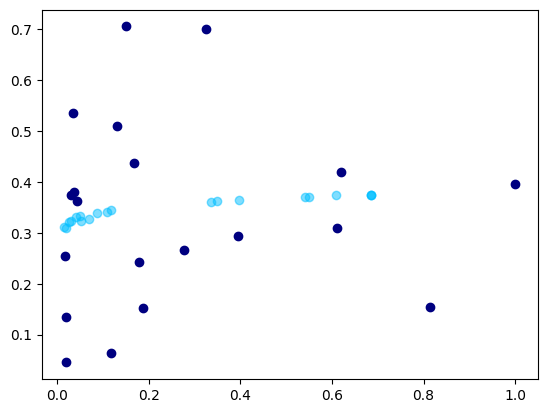

 42%|█████████████████████████████████▏                                              | 415/1000 [01:13<01:39,  5.88it/s]

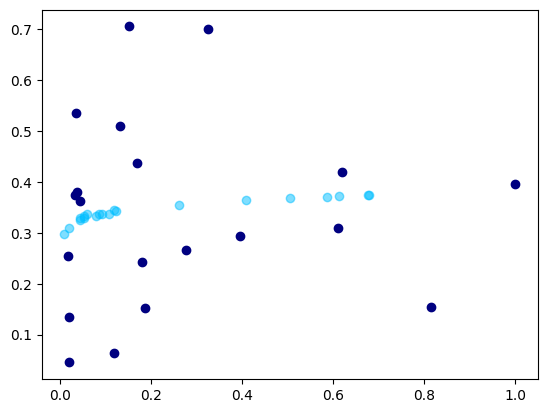

 42%|█████████████████████████████████▎                                              | 416/1000 [01:14<01:38,  5.94it/s]

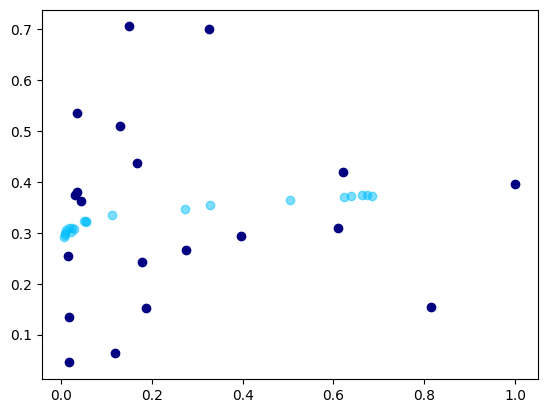

 42%|█████████████████████████████████▎                                              | 417/1000 [01:14<01:40,  5.81it/s]

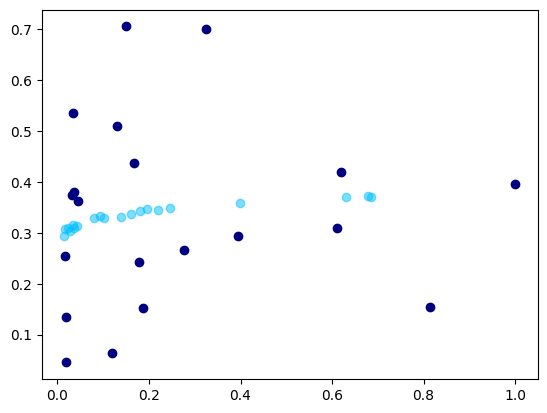

 42%|█████████████████████████████████▍                                              | 418/1000 [01:14<01:39,  5.86it/s]

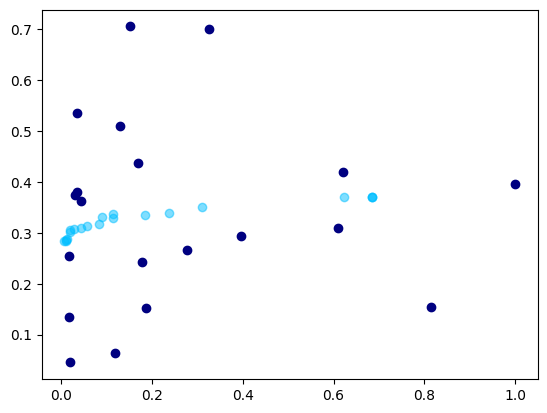

 42%|█████████████████████████████████▌                                              | 419/1000 [01:14<01:37,  5.95it/s]

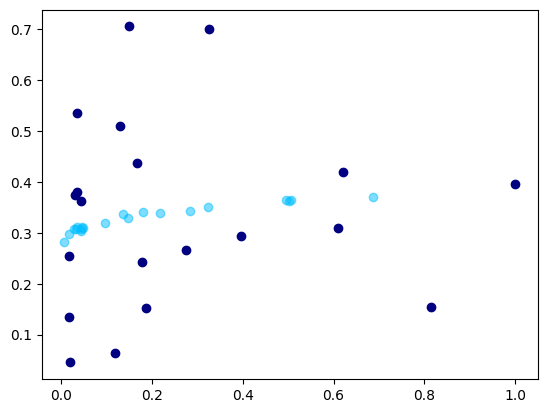

 42%|█████████████████████████████████▌                                              | 420/1000 [01:14<01:36,  5.99it/s]

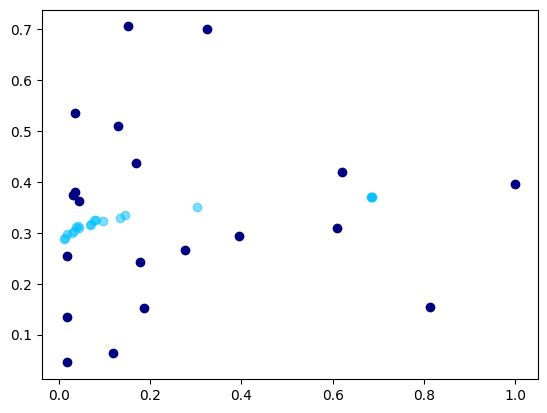

 42%|█████████████████████████████████▋                                              | 421/1000 [01:14<01:35,  6.05it/s]

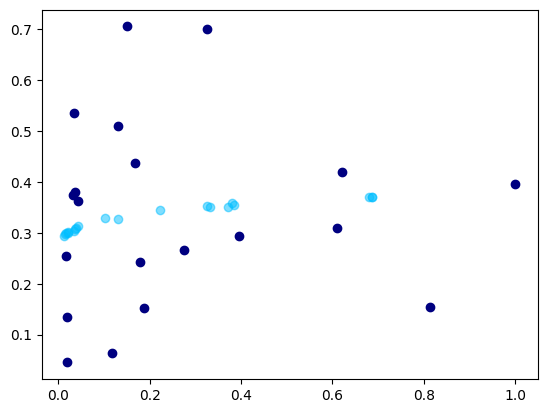

 42%|█████████████████████████████████▊                                              | 422/1000 [01:15<01:36,  6.02it/s]

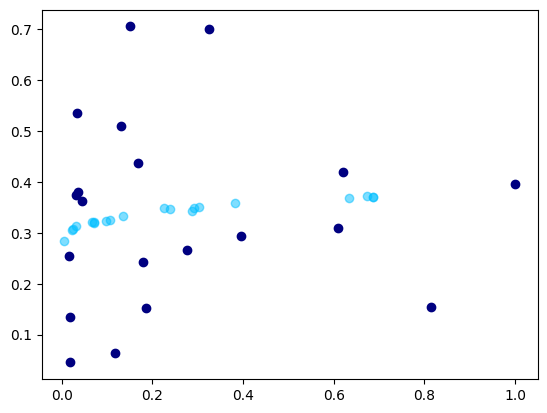

 42%|█████████████████████████████████▊                                              | 423/1000 [01:15<01:36,  6.01it/s]

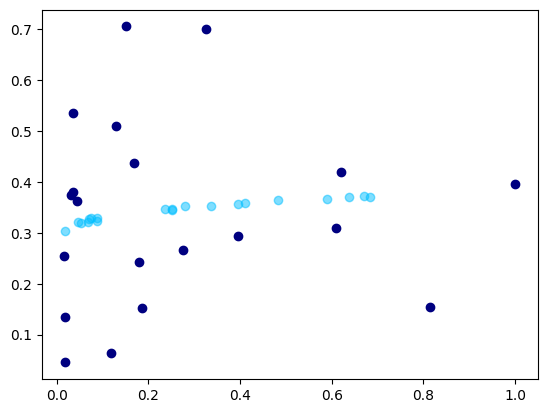

 42%|█████████████████████████████████▉                                              | 424/1000 [01:15<01:35,  6.05it/s]

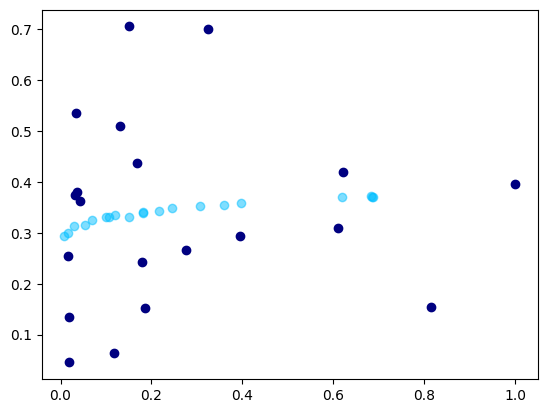

 42%|██████████████████████████████████                                              | 425/1000 [01:15<01:36,  5.98it/s]

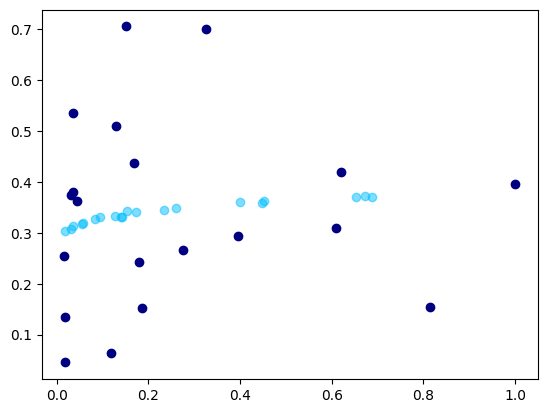

 43%|██████████████████████████████████                                              | 426/1000 [01:15<01:35,  5.98it/s]

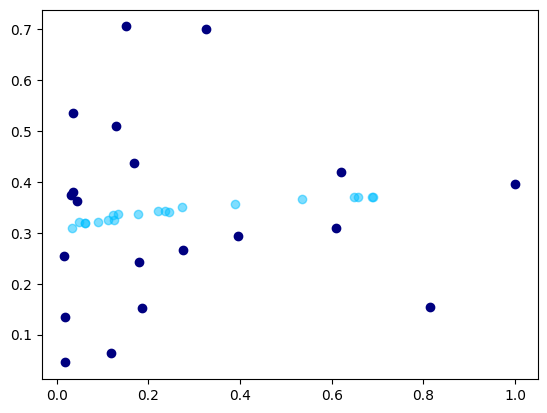

 43%|██████████████████████████████████▏                                             | 427/1000 [01:15<01:34,  6.04it/s]

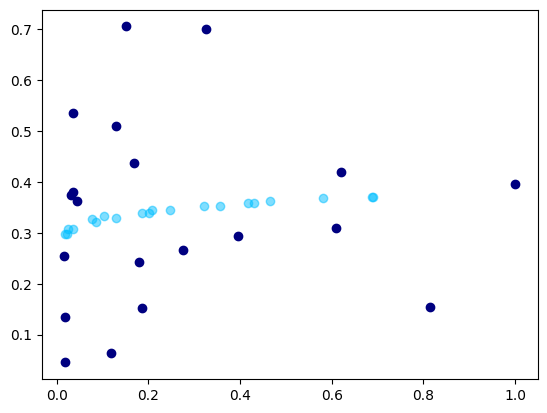

 43%|██████████████████████████████████▏                                             | 428/1000 [01:16<01:33,  6.09it/s]

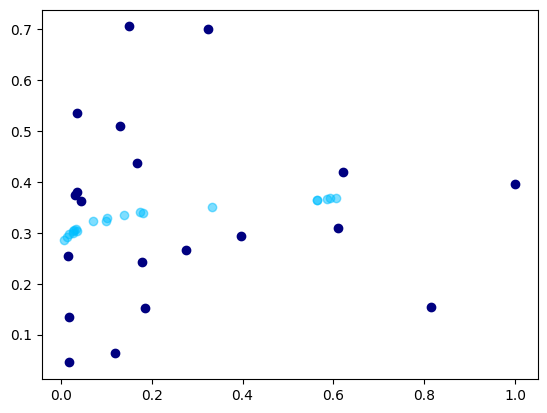

 43%|██████████████████████████████████▎                                             | 429/1000 [01:16<01:35,  6.00it/s]

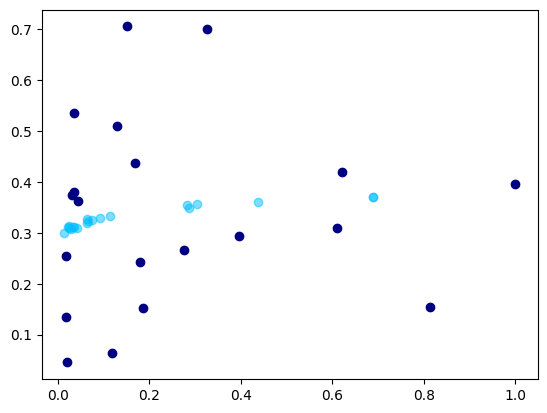

 43%|██████████████████████████████████▍                                             | 430/1000 [01:16<01:34,  6.03it/s]

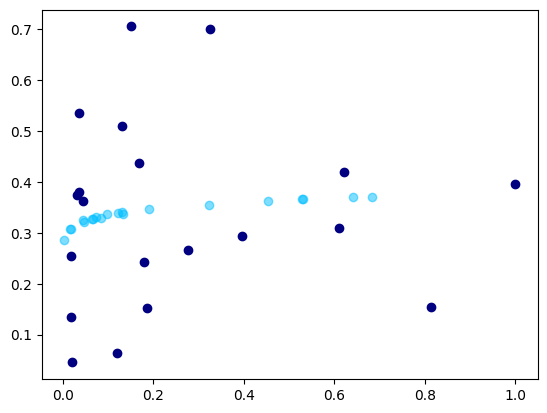

 43%|██████████████████████████████████▍                                             | 431/1000 [01:16<01:33,  6.08it/s]

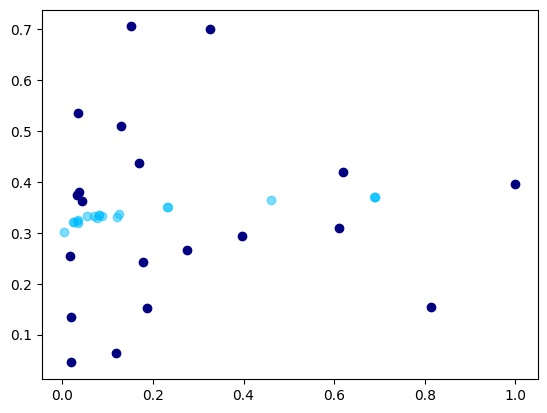

 43%|██████████████████████████████████▌                                             | 432/1000 [01:16<01:37,  5.81it/s]

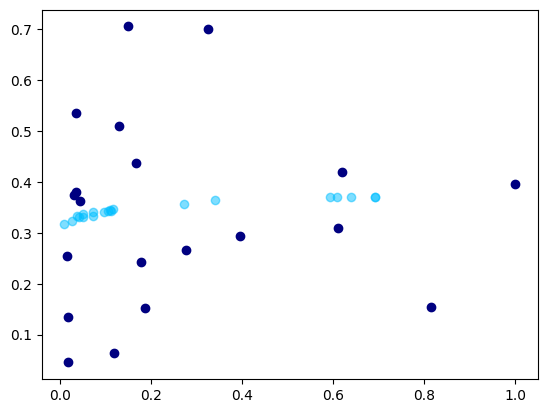

 43%|██████████████████████████████████▋                                             | 433/1000 [01:16<01:38,  5.77it/s]

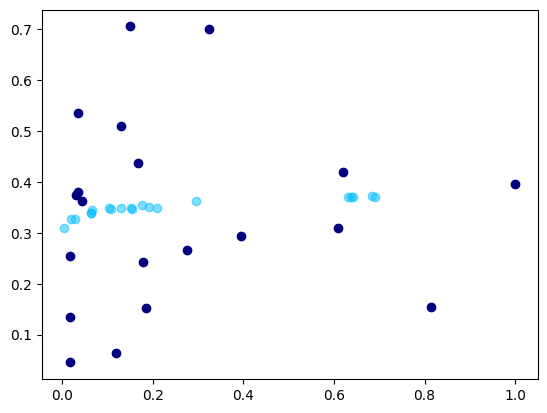

 43%|██████████████████████████████████▋                                             | 434/1000 [01:17<01:37,  5.82it/s]

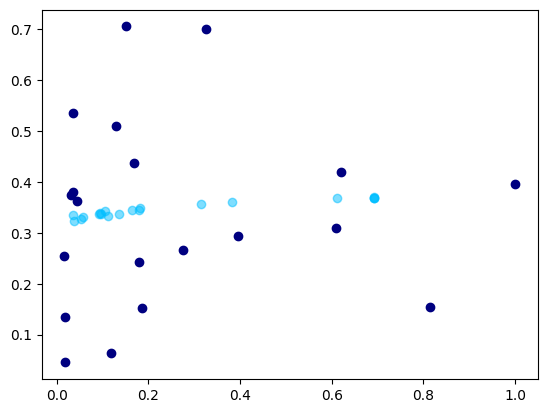

 44%|██████████████████████████████████▊                                             | 435/1000 [01:17<01:38,  5.75it/s]

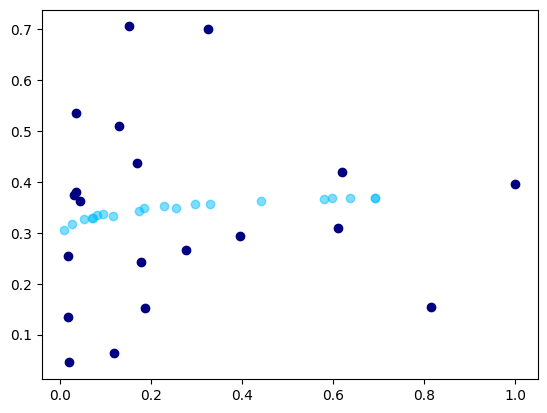

 44%|██████████████████████████████████▉                                             | 436/1000 [01:17<01:35,  5.89it/s]

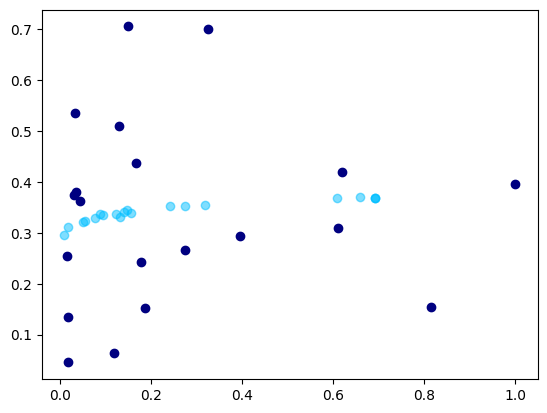

 44%|██████████████████████████████████▉                                             | 437/1000 [01:17<01:36,  5.81it/s]

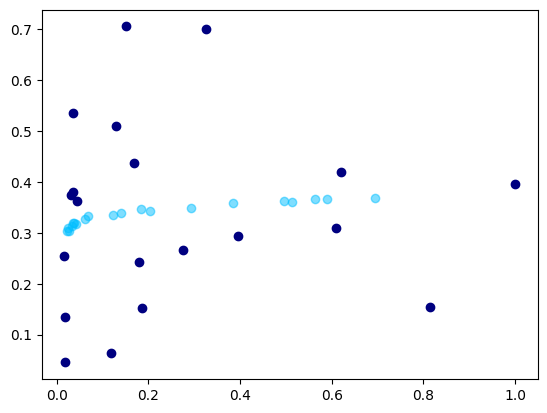

 44%|███████████████████████████████████                                             | 438/1000 [01:17<01:35,  5.90it/s]

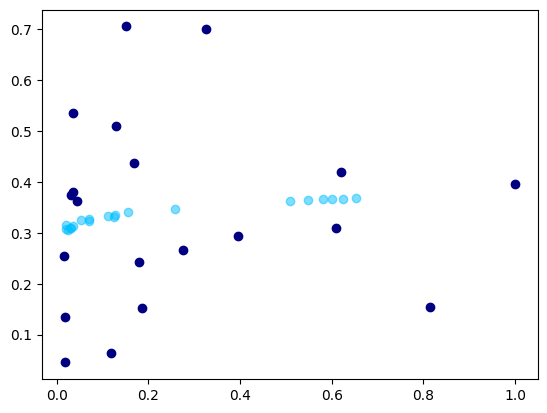

 44%|███████████████████████████████████                                             | 439/1000 [01:17<01:33,  5.98it/s]

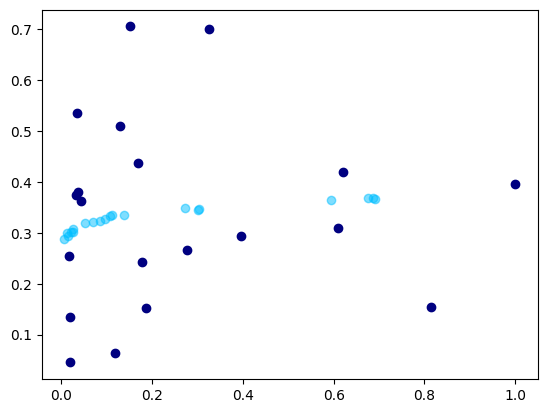

 44%|███████████████████████████████████▏                                            | 440/1000 [01:18<01:32,  6.03it/s]

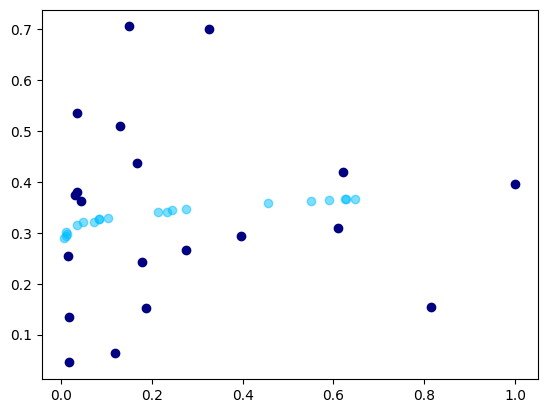

 44%|███████████████████████████████████▎                                            | 441/1000 [01:18<01:33,  5.98it/s]

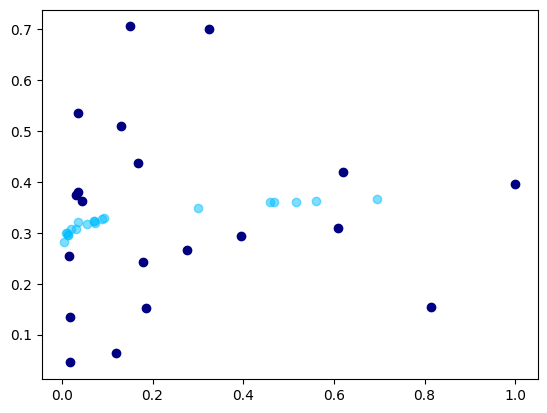

 44%|███████████████████████████████████▎                                            | 442/1000 [01:18<01:32,  6.00it/s]

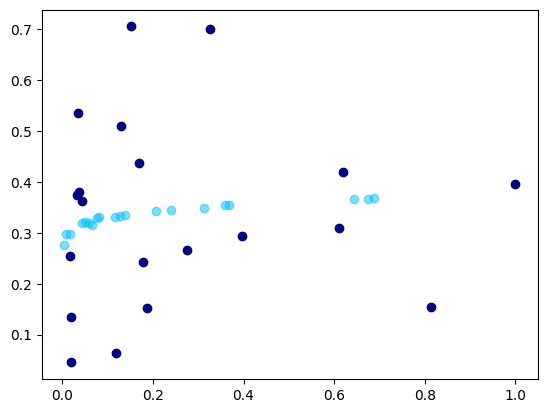

 44%|███████████████████████████████████▍                                            | 443/1000 [01:18<01:33,  5.98it/s]

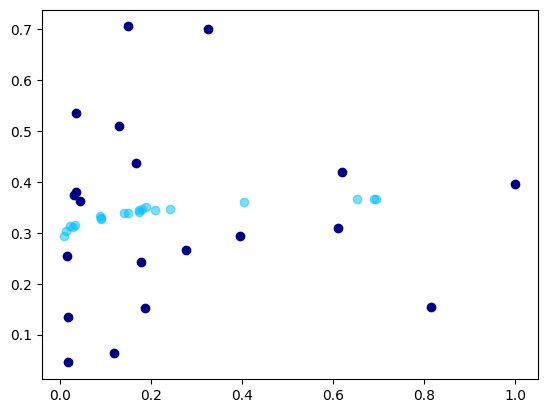

 44%|███████████████████████████████████▌                                            | 444/1000 [01:18<01:34,  5.89it/s]

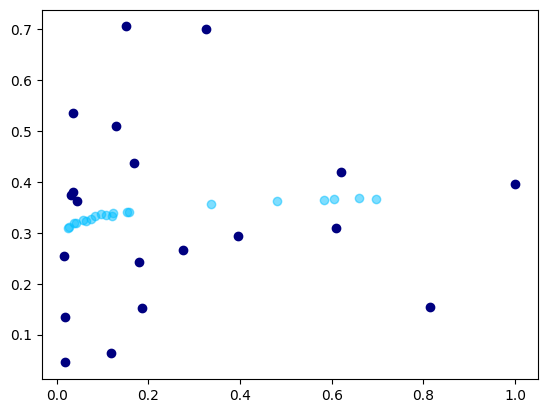

 44%|███████████████████████████████████▌                                            | 445/1000 [01:18<01:34,  5.90it/s]

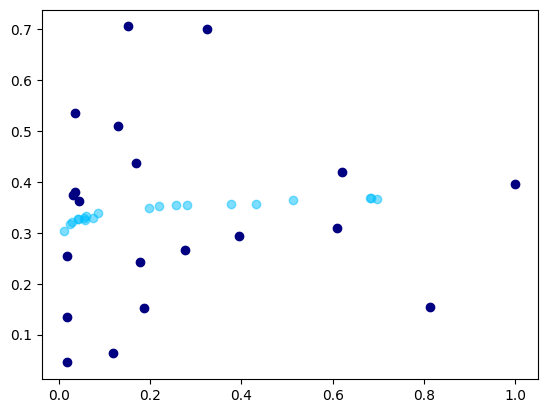

 45%|███████████████████████████████████▋                                            | 446/1000 [01:19<01:32,  5.96it/s]

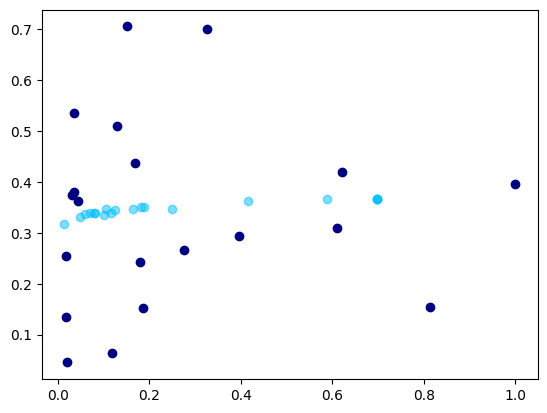

 45%|███████████████████████████████████▊                                            | 447/1000 [01:19<01:33,  5.91it/s]

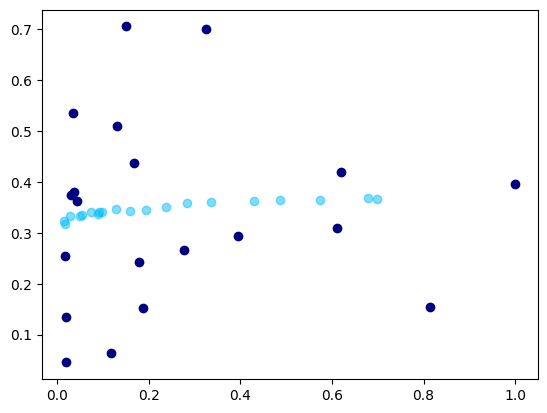

 45%|███████████████████████████████████▊                                            | 448/1000 [01:19<01:33,  5.92it/s]

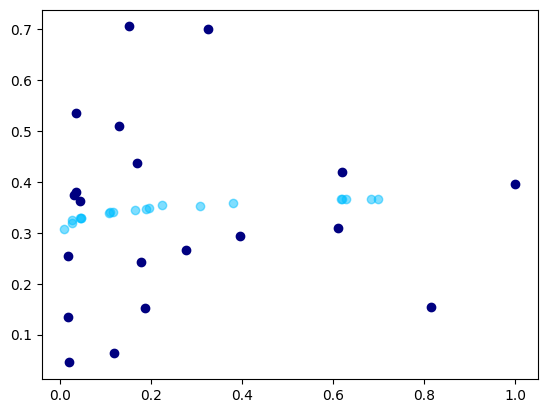

 45%|███████████████████████████████████▉                                            | 449/1000 [01:19<01:32,  5.99it/s]

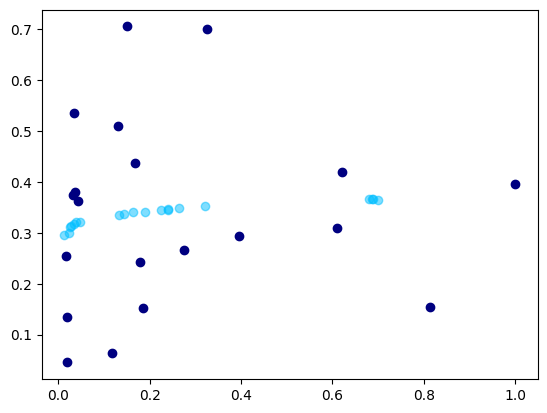

 45%|████████████████████████████████████                                            | 450/1000 [01:19<01:32,  5.92it/s]

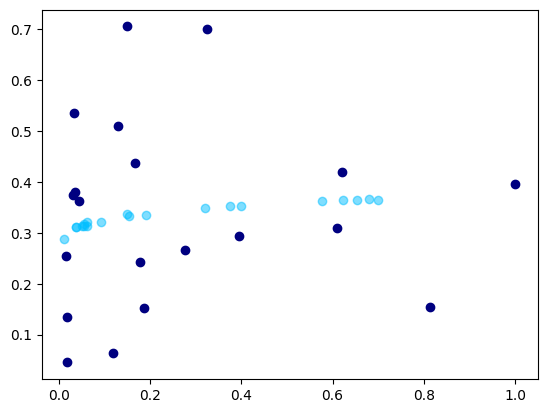

 45%|████████████████████████████████████                                            | 451/1000 [01:19<01:32,  5.92it/s]

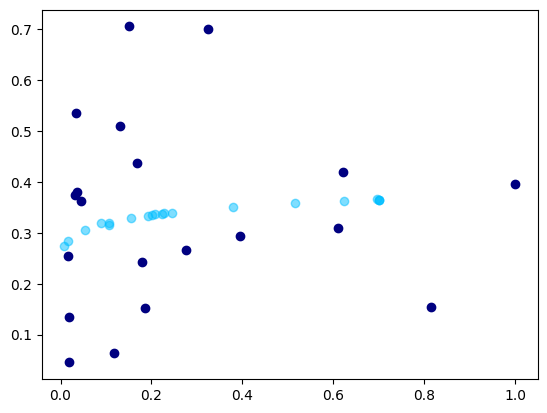

 45%|████████████████████████████████████▏                                           | 452/1000 [01:20<01:31,  5.98it/s]

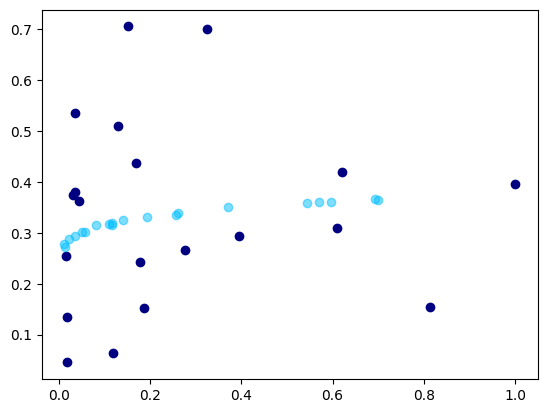

 45%|████████████████████████████████████▏                                           | 453/1000 [01:20<01:32,  5.93it/s]

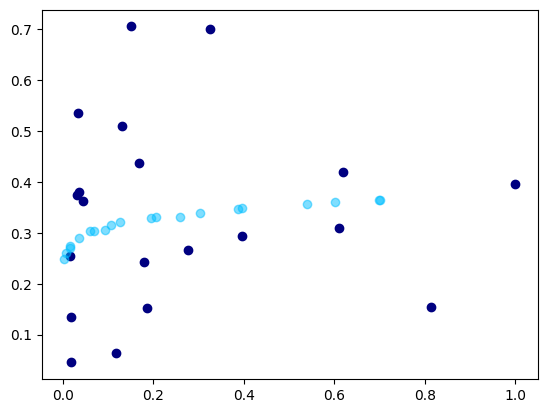

 45%|████████████████████████████████████▎                                           | 454/1000 [01:20<01:31,  5.97it/s]

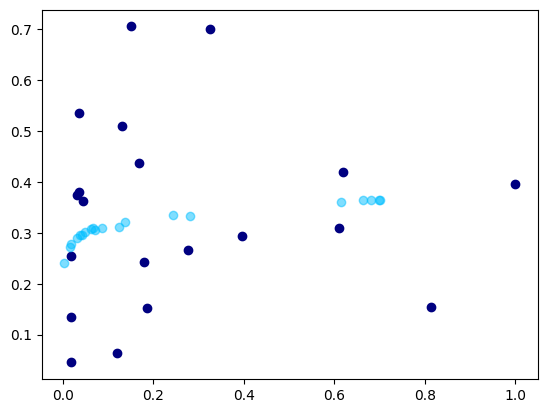

 46%|████████████████████████████████████▍                                           | 455/1000 [01:20<01:31,  5.96it/s]

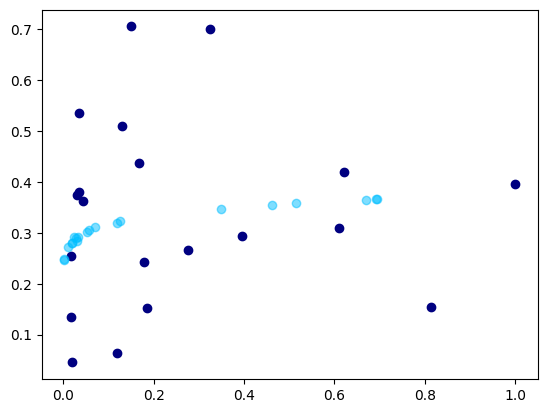

 46%|████████████████████████████████████▍                                           | 456/1000 [01:20<01:31,  5.95it/s]

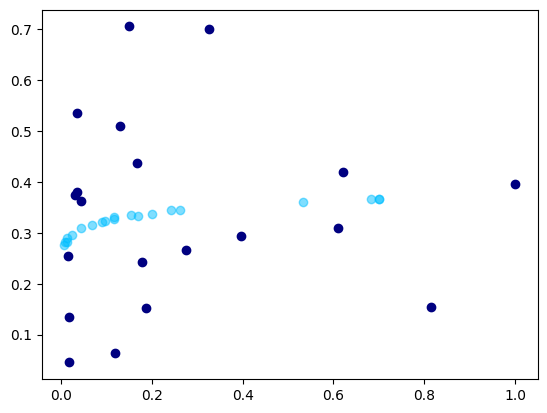

 46%|████████████████████████████████████▌                                           | 457/1000 [01:20<01:29,  6.05it/s]

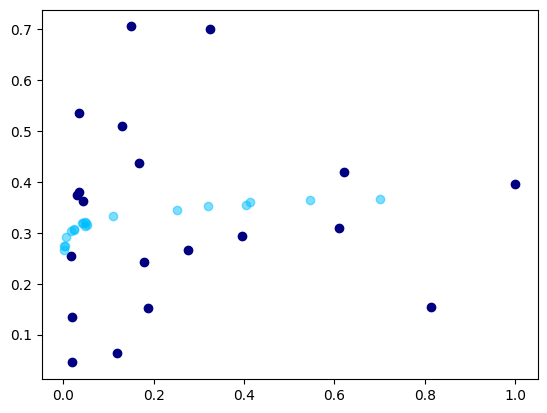

 46%|████████████████████████████████████▋                                           | 458/1000 [01:21<01:29,  6.06it/s]

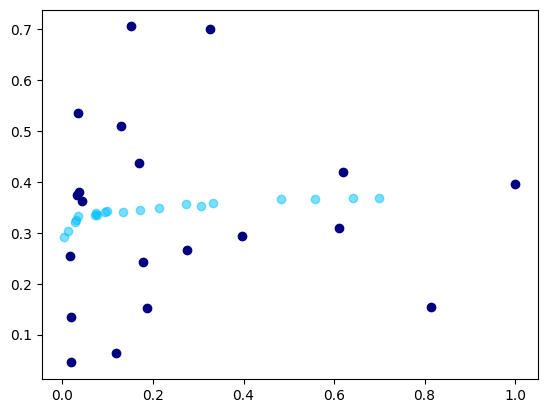

 46%|████████████████████████████████████▋                                           | 459/1000 [01:21<01:30,  5.98it/s]

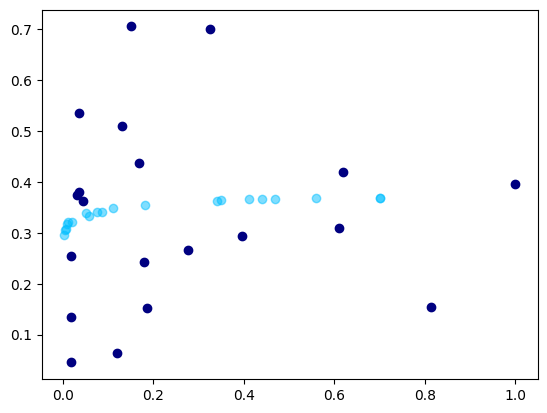

 46%|████████████████████████████████████▊                                           | 460/1000 [01:21<01:30,  5.99it/s]

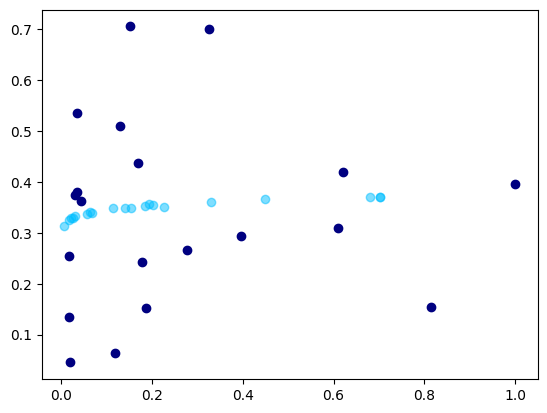

 46%|████████████████████████████████████▉                                           | 461/1000 [01:21<01:28,  6.06it/s]

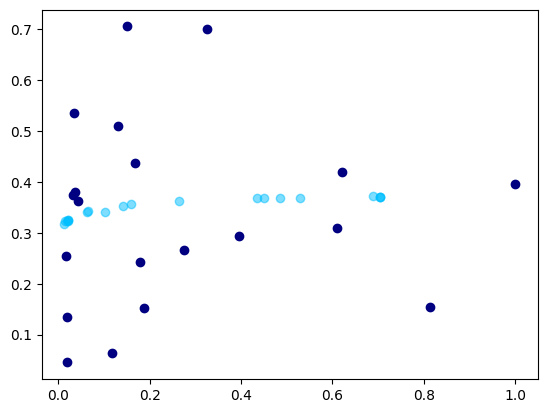

 46%|████████████████████████████████████▉                                           | 462/1000 [01:21<01:29,  5.99it/s]

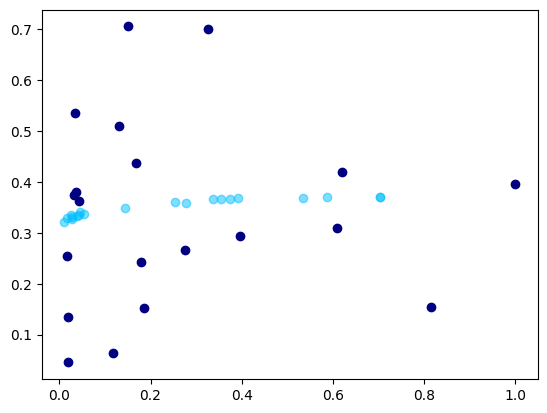

 46%|█████████████████████████████████████                                           | 463/1000 [01:21<01:29,  6.00it/s]

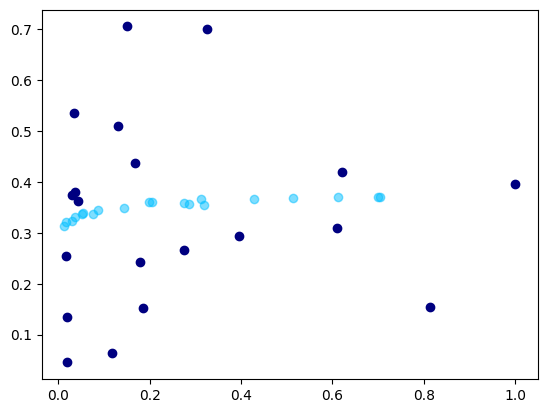

 46%|█████████████████████████████████████                                           | 464/1000 [01:22<01:30,  5.91it/s]

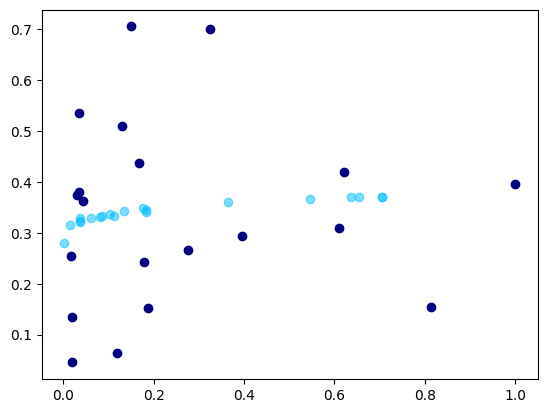

 46%|█████████████████████████████████████▏                                          | 465/1000 [01:22<01:30,  5.93it/s]

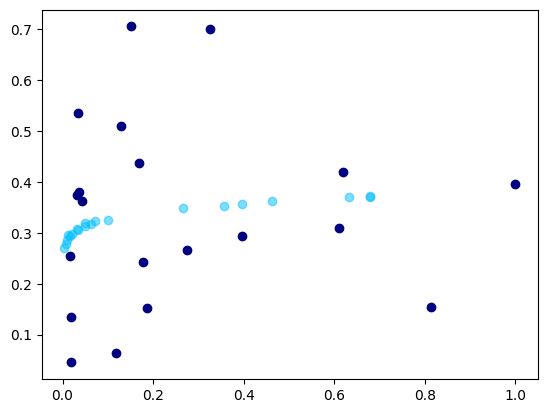

 47%|█████████████████████████████████████▎                                          | 466/1000 [01:22<01:29,  5.96it/s]

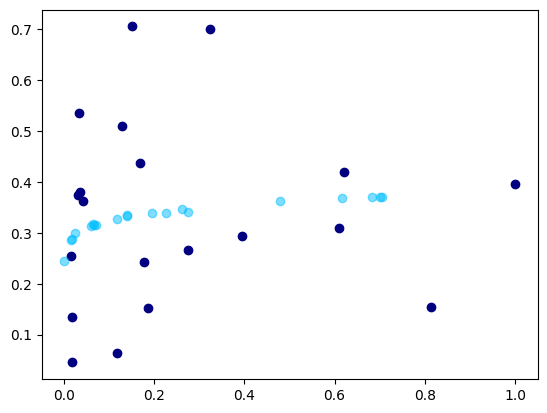

 47%|█████████████████████████████████████▎                                          | 467/1000 [01:22<01:29,  5.97it/s]

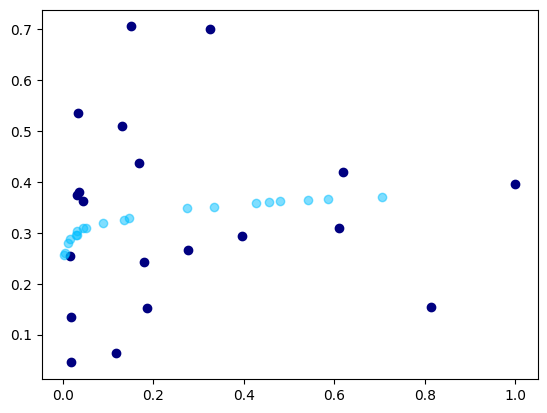

 47%|█████████████████████████████████████▍                                          | 468/1000 [01:22<01:29,  5.95it/s]

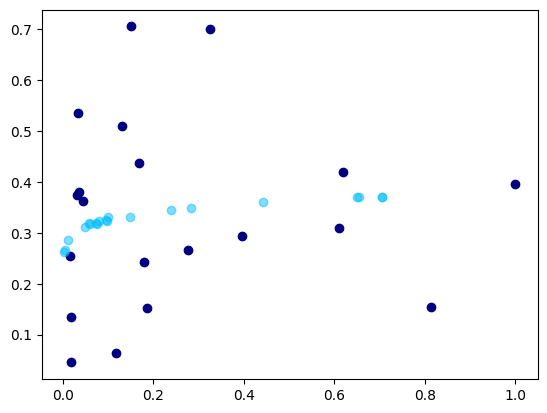

 47%|█████████████████████████████████████▌                                          | 469/1000 [01:22<01:28,  6.01it/s]

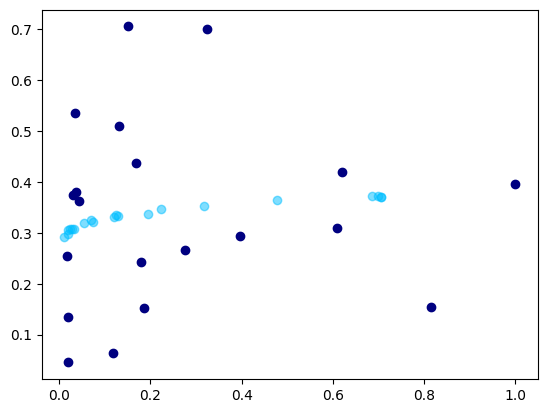

 47%|█████████████████████████████████████▌                                          | 470/1000 [01:23<01:27,  6.03it/s]

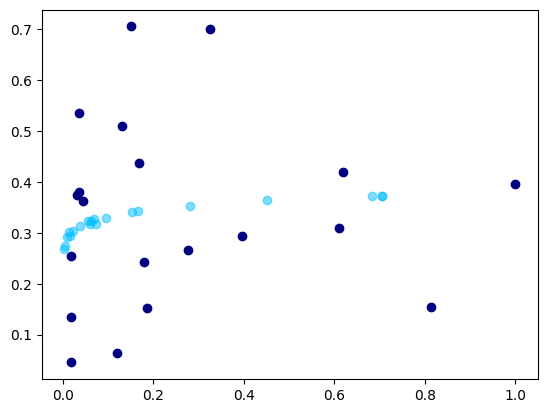

 47%|█████████████████████████████████████▋                                          | 471/1000 [01:23<01:31,  5.77it/s]

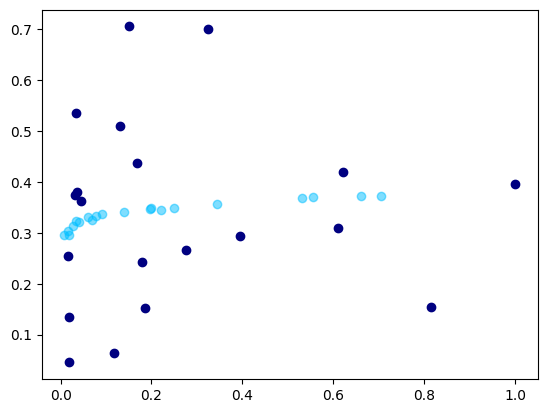

 47%|█████████████████████████████████████▊                                          | 472/1000 [01:23<01:33,  5.67it/s]

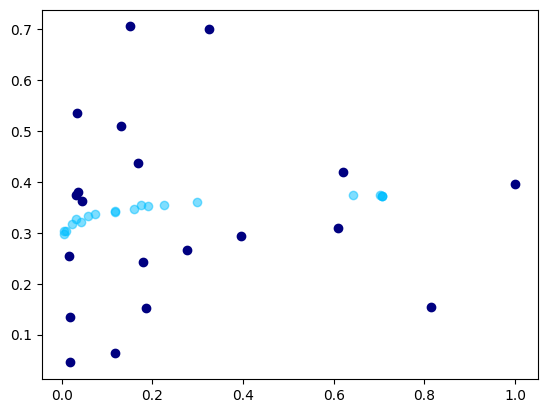

 47%|█████████████████████████████████████▊                                          | 473/1000 [01:23<01:32,  5.71it/s]

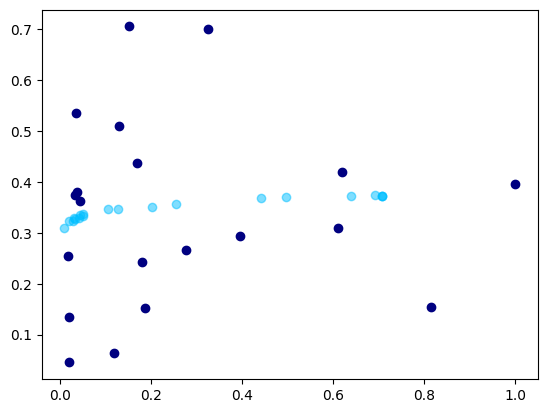

 47%|█████████████████████████████████████▉                                          | 474/1000 [01:23<01:31,  5.73it/s]

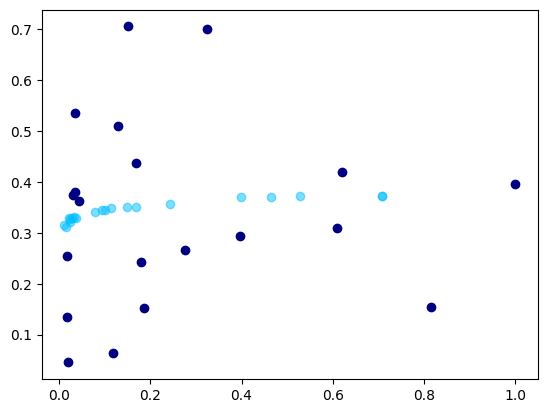

 48%|██████████████████████████████████████                                          | 475/1000 [01:24<01:31,  5.75it/s]

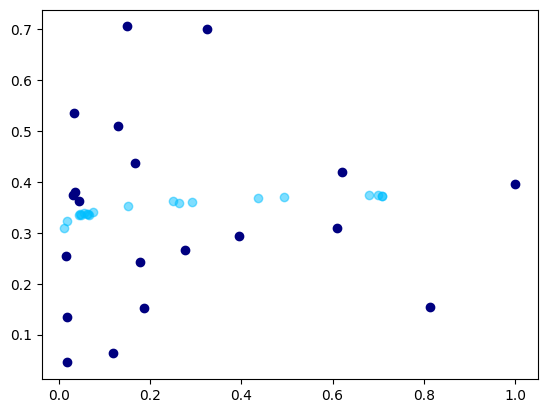

 48%|██████████████████████████████████████                                          | 476/1000 [01:24<01:34,  5.55it/s]

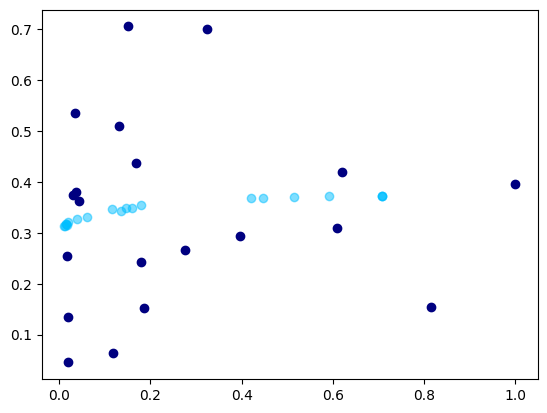

 48%|██████████████████████████████████████▏                                         | 477/1000 [01:24<01:32,  5.64it/s]

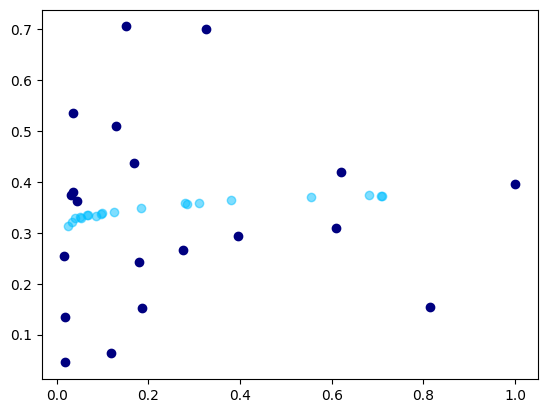

 48%|██████████████████████████████████████▏                                         | 478/1000 [01:24<01:32,  5.63it/s]

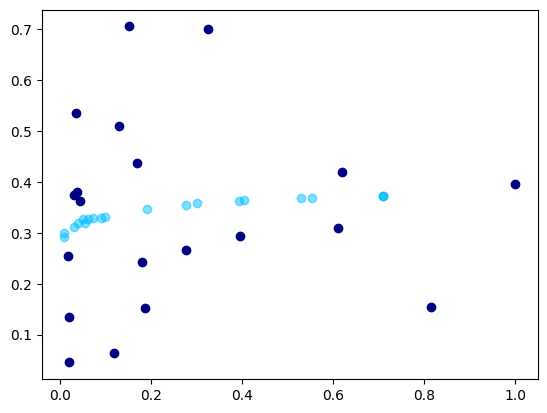

 48%|██████████████████████████████████████▎                                         | 479/1000 [01:24<01:31,  5.67it/s]

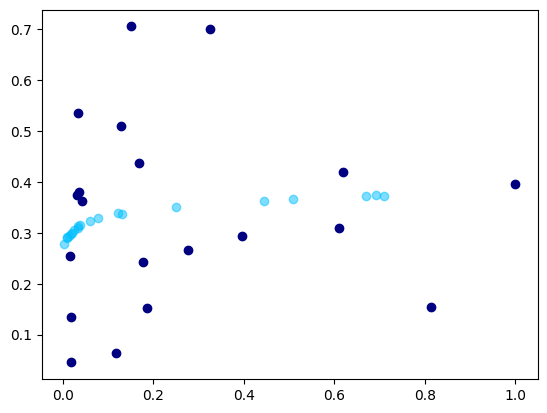

 48%|██████████████████████████████████████▍                                         | 480/1000 [01:25<02:47,  3.10it/s]

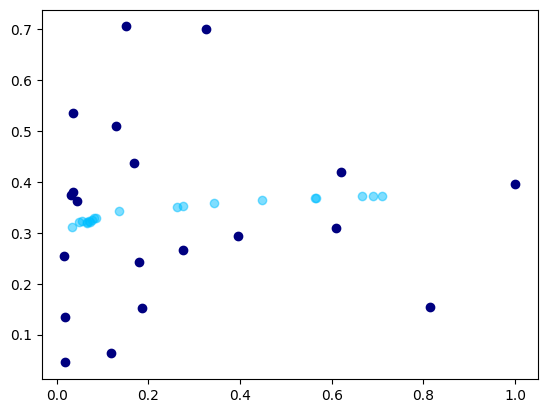

 48%|██████████████████████████████████████▍                                         | 481/1000 [01:25<02:24,  3.60it/s]

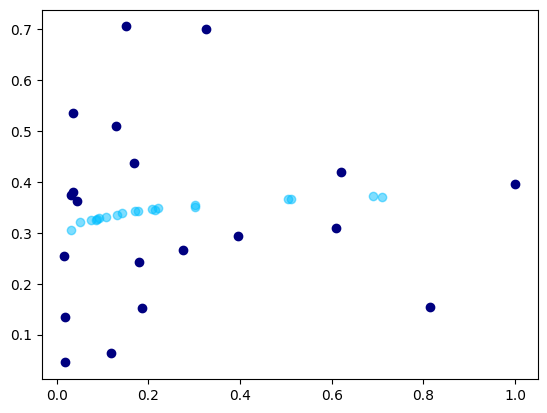

 48%|██████████████████████████████████████▌                                         | 482/1000 [01:25<02:07,  4.07it/s]

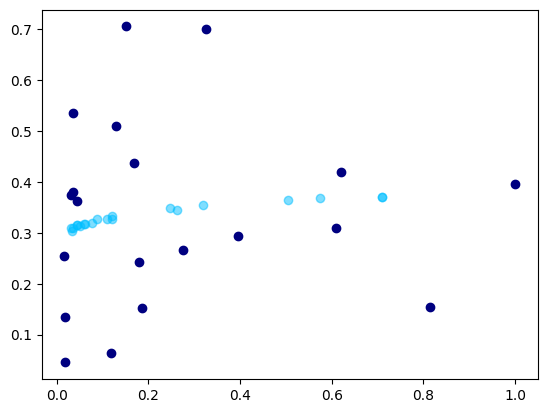

 48%|██████████████████████████████████████▋                                         | 483/1000 [01:25<01:55,  4.47it/s]

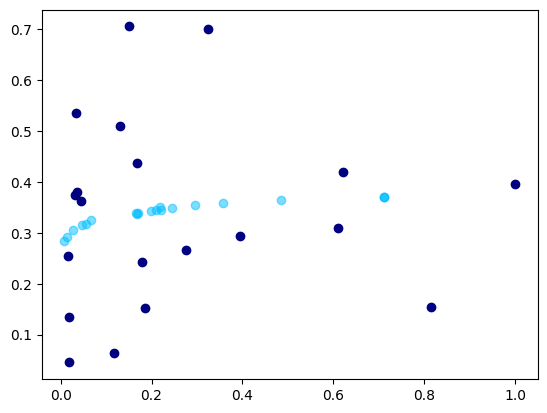

 48%|██████████████████████████████████████▋                                         | 484/1000 [01:26<01:46,  4.84it/s]

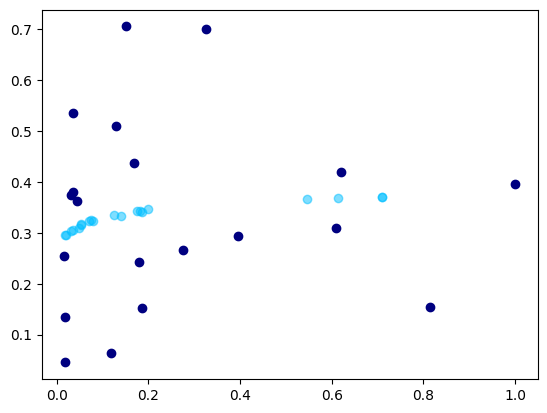

 48%|██████████████████████████████████████▊                                         | 485/1000 [01:26<01:41,  5.05it/s]

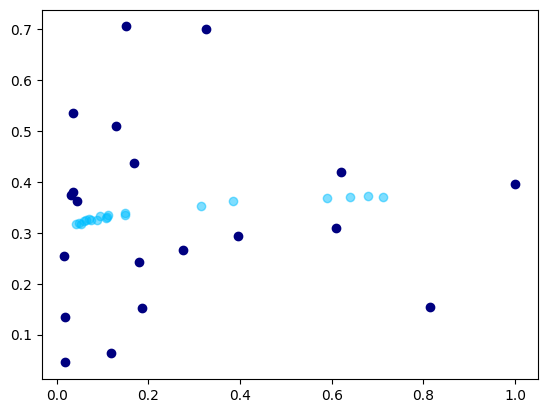

 49%|██████████████████████████████████████▉                                         | 486/1000 [01:26<01:36,  5.30it/s]

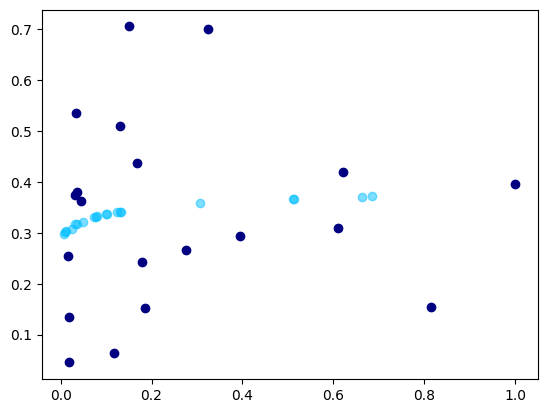

 49%|██████████████████████████████████████▉                                         | 487/1000 [01:26<01:34,  5.42it/s]

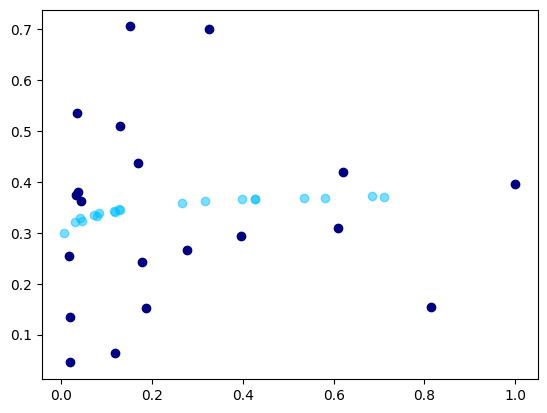

 49%|███████████████████████████████████████                                         | 488/1000 [01:26<01:32,  5.55it/s]

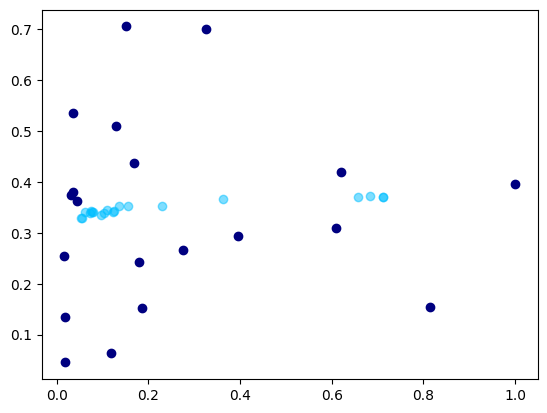

 49%|███████████████████████████████████████                                         | 489/1000 [01:26<01:30,  5.62it/s]

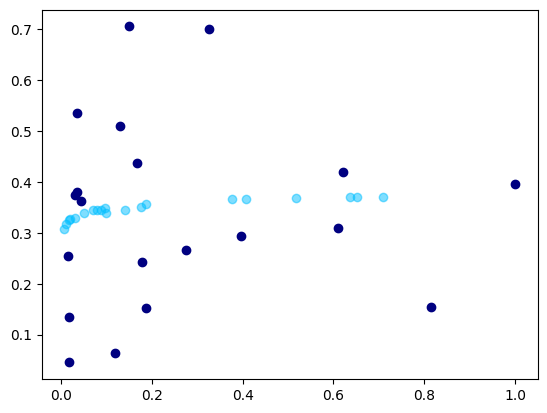

 49%|███████████████████████████████████████▏                                        | 490/1000 [01:27<01:28,  5.77it/s]

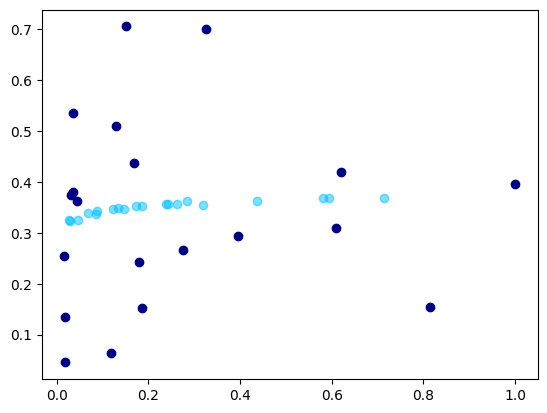

 49%|███████████████████████████████████████▎                                        | 491/1000 [01:27<01:28,  5.77it/s]

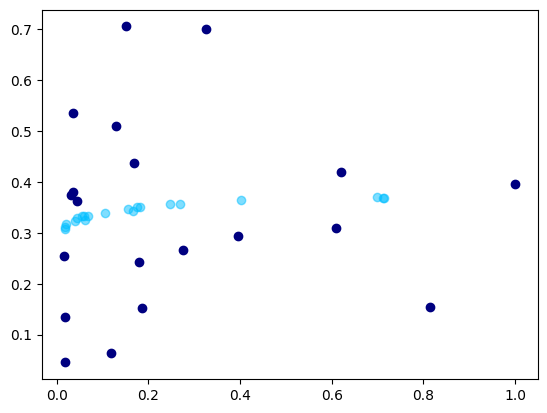

 49%|███████████████████████████████████████▎                                        | 492/1000 [01:27<01:27,  5.78it/s]

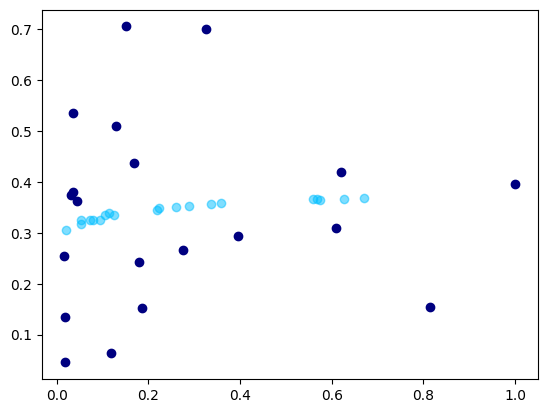

 49%|███████████████████████████████████████▍                                        | 493/1000 [01:27<01:25,  5.91it/s]

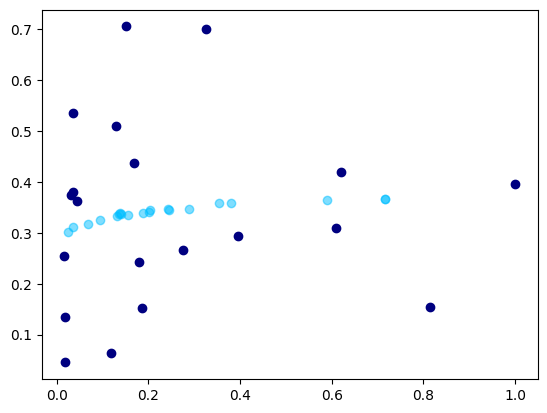

 49%|███████████████████████████████████████▌                                        | 494/1000 [01:27<01:26,  5.88it/s]

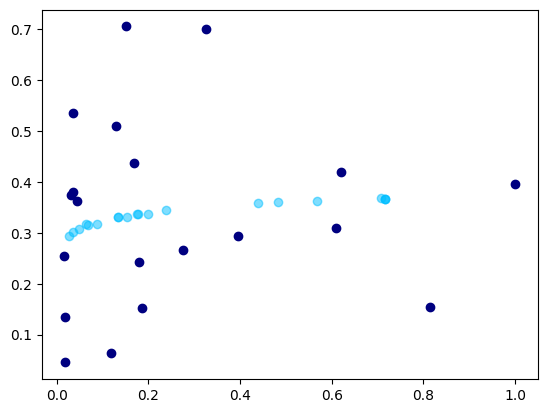

 50%|███████████████████████████████████████▌                                        | 495/1000 [01:27<01:25,  5.91it/s]

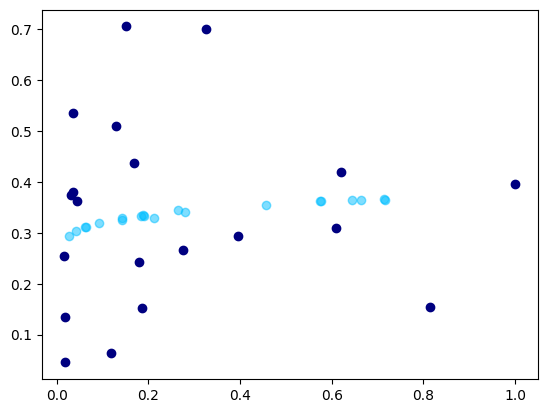

 50%|███████████████████████████████████████▋                                        | 496/1000 [01:28<01:25,  5.90it/s]

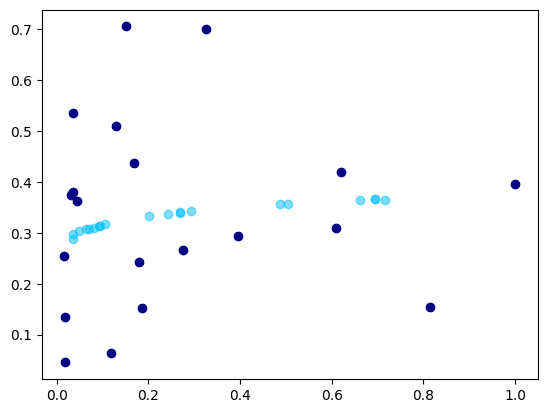

 50%|███████████████████████████████████████▊                                        | 497/1000 [01:28<01:30,  5.57it/s]

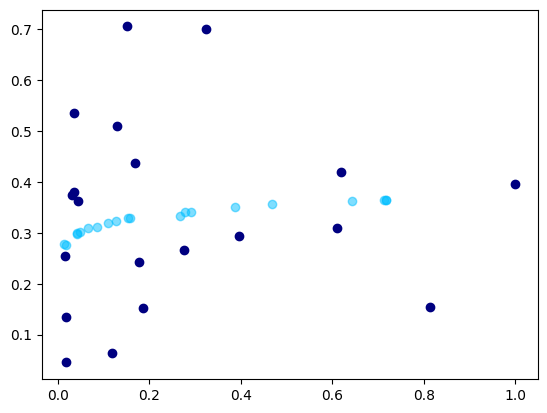

 50%|███████████████████████████████████████▊                                        | 498/1000 [01:28<01:32,  5.44it/s]

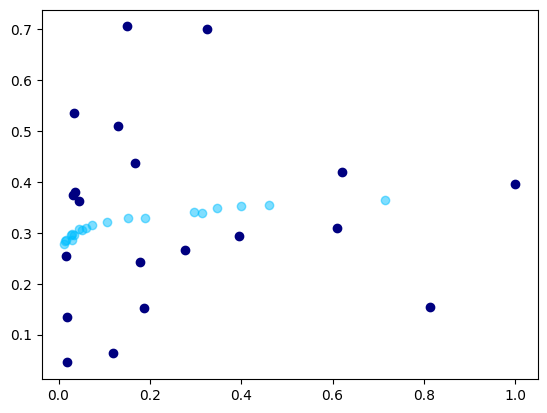

 50%|███████████████████████████████████████▉                                        | 499/1000 [01:28<01:30,  5.51it/s]

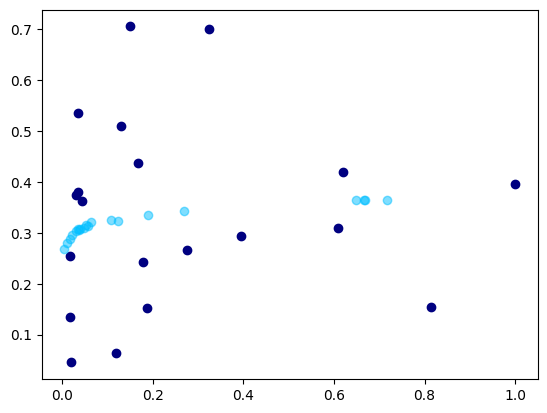

 50%|████████████████████████████████████████                                        | 500/1000 [01:28<01:28,  5.64it/s]

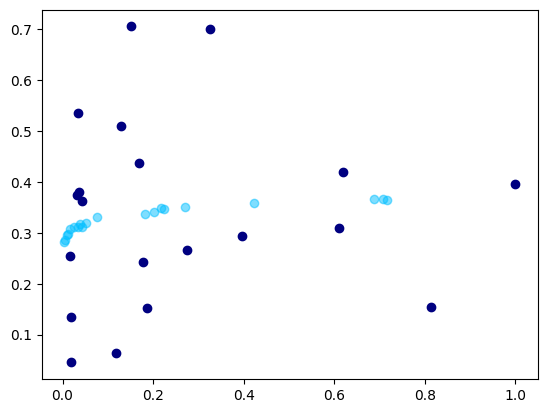

 50%|████████████████████████████████████████                                        | 501/1000 [01:29<01:26,  5.75it/s]

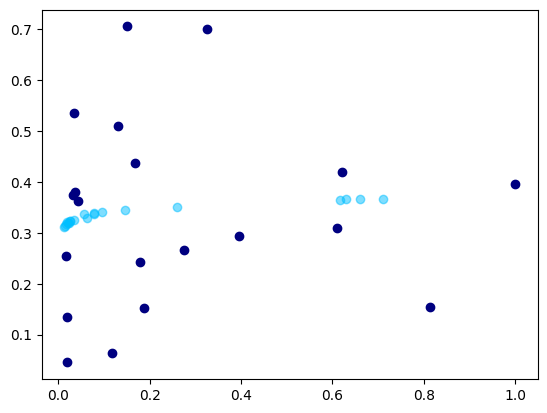

 50%|████████████████████████████████████████▏                                       | 502/1000 [01:29<01:26,  5.76it/s]

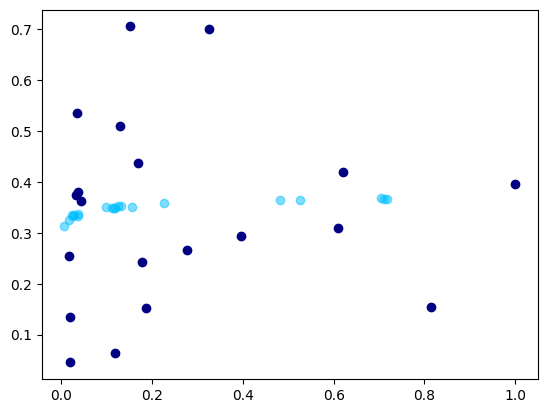

 50%|████████████████████████████████████████▏                                       | 503/1000 [01:29<01:25,  5.83it/s]

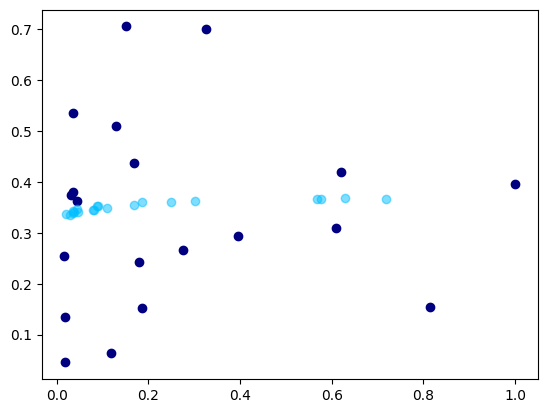

 50%|████████████████████████████████████████▎                                       | 504/1000 [01:29<01:28,  5.60it/s]

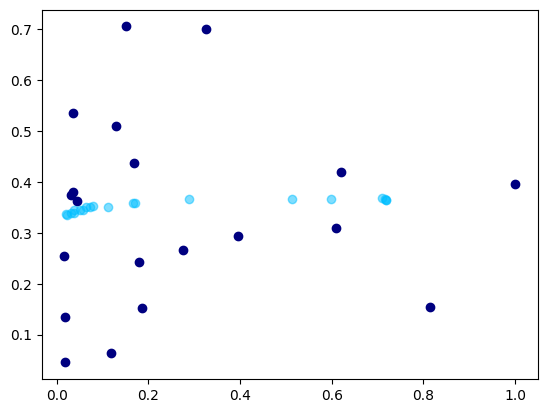

 50%|████████████████████████████████████████▍                                       | 505/1000 [01:29<01:27,  5.67it/s]

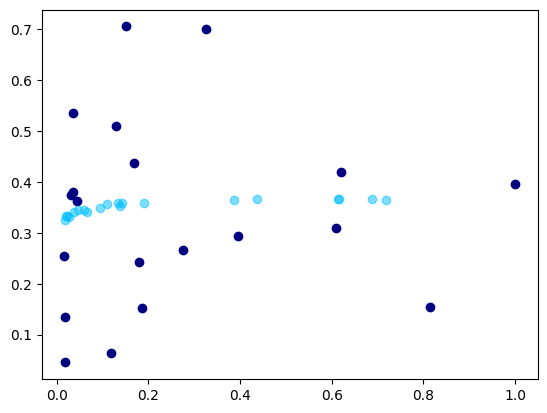

 51%|████████████████████████████████████████▍                                       | 506/1000 [01:29<01:27,  5.63it/s]

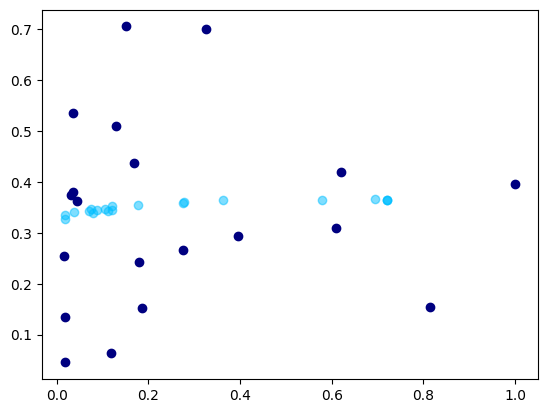

 51%|████████████████████████████████████████▌                                       | 507/1000 [01:30<01:25,  5.77it/s]

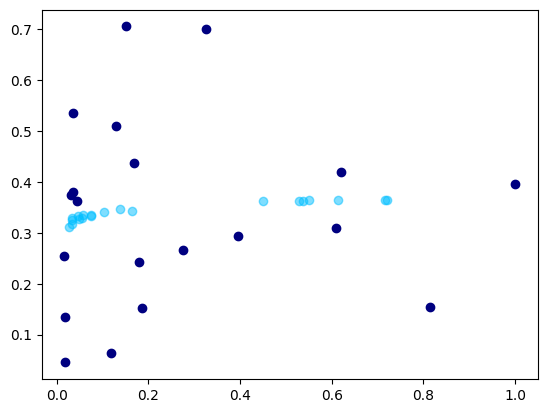

 51%|████████████████████████████████████████▋                                       | 508/1000 [01:30<01:24,  5.81it/s]

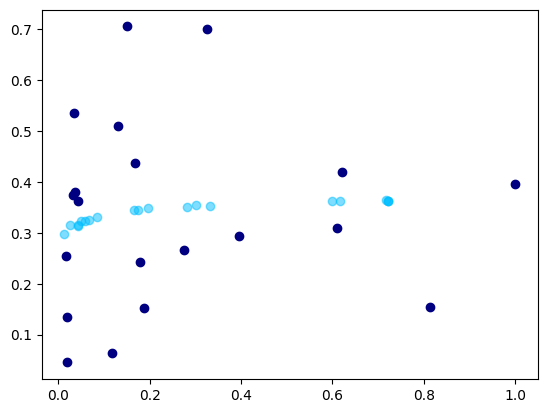

 51%|████████████████████████████████████████▋                                       | 509/1000 [01:30<01:24,  5.82it/s]

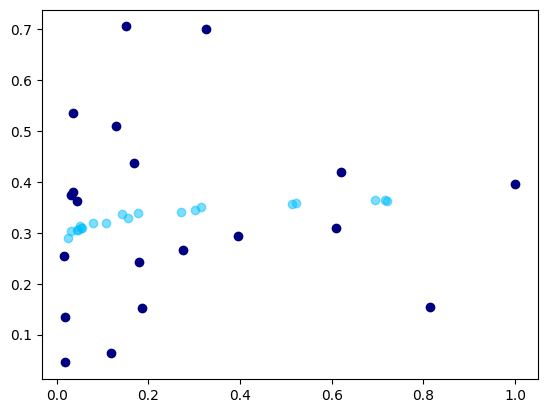

 51%|████████████████████████████████████████▊                                       | 510/1000 [01:30<01:25,  5.71it/s]

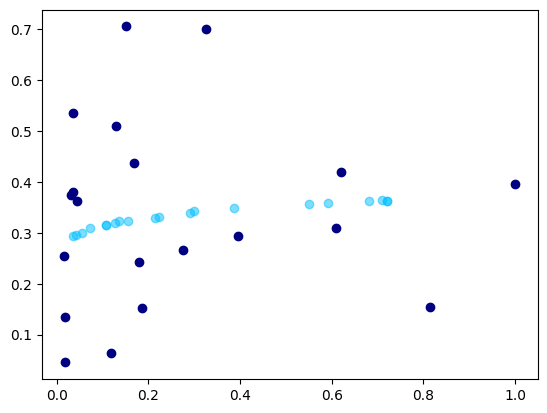

 51%|████████████████████████████████████████▉                                       | 511/1000 [01:30<01:24,  5.80it/s]

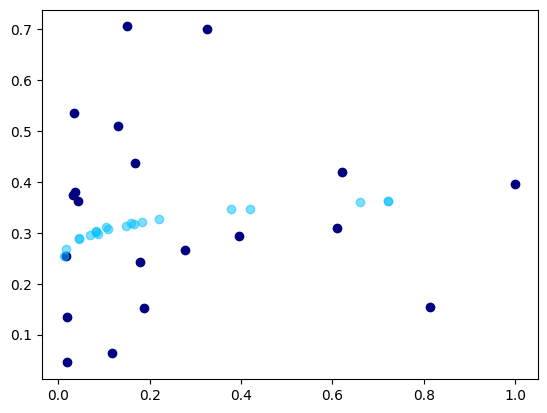

 51%|████████████████████████████████████████▉                                       | 512/1000 [01:30<01:22,  5.91it/s]

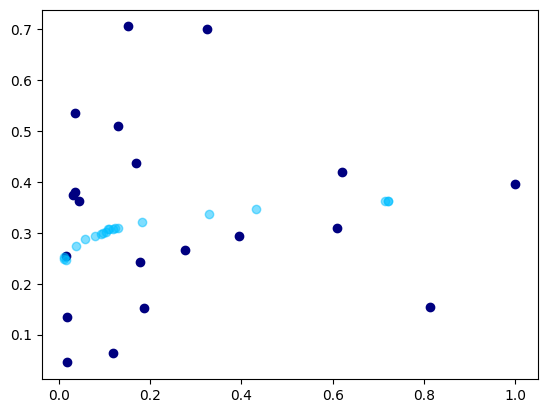

 51%|█████████████████████████████████████████                                       | 513/1000 [01:31<01:21,  5.97it/s]

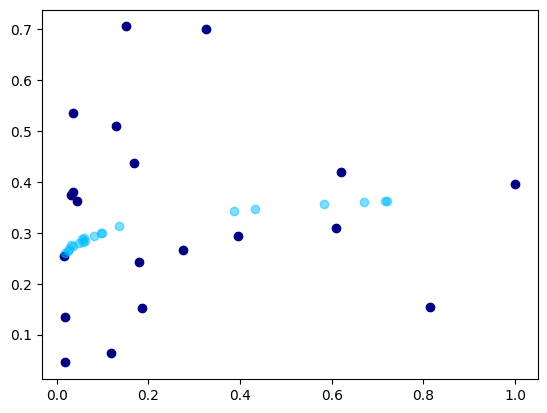

 51%|█████████████████████████████████████████                                       | 514/1000 [01:31<01:21,  5.93it/s]

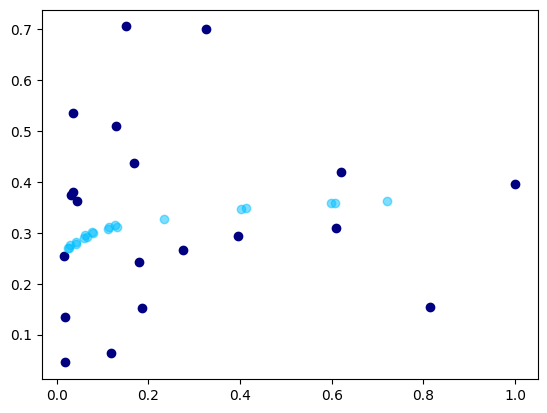

 52%|█████████████████████████████████████████▏                                      | 515/1000 [01:31<01:21,  5.92it/s]

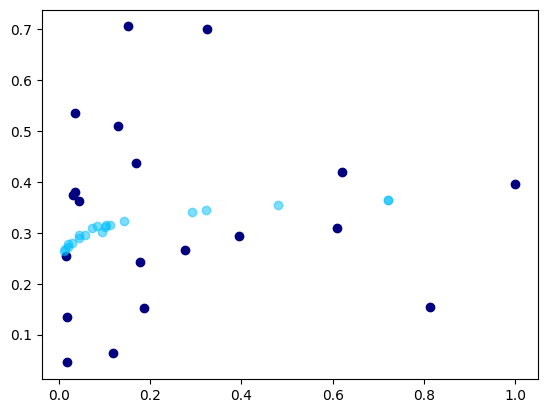

 52%|█████████████████████████████████████████▎                                      | 516/1000 [01:31<01:21,  5.93it/s]

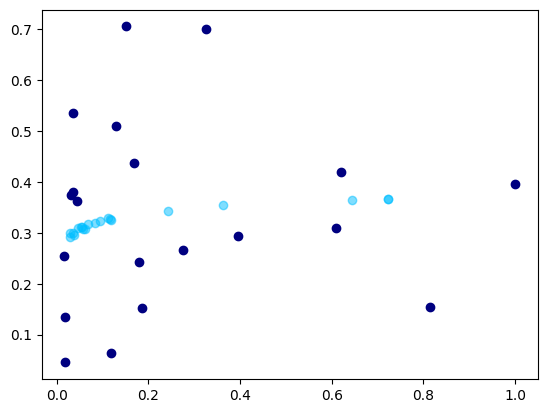

 52%|█████████████████████████████████████████▎                                      | 517/1000 [01:31<01:21,  5.92it/s]

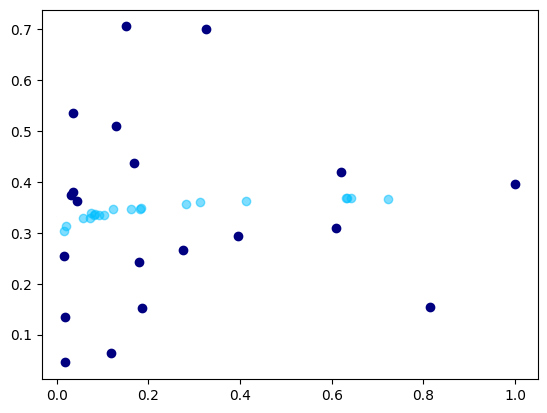

 52%|█████████████████████████████████████████▍                                      | 518/1000 [01:31<01:20,  5.99it/s]

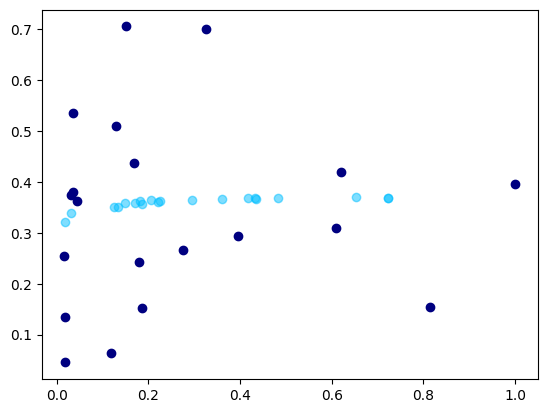

 52%|█████████████████████████████████████████▌                                      | 519/1000 [01:32<01:20,  5.98it/s]

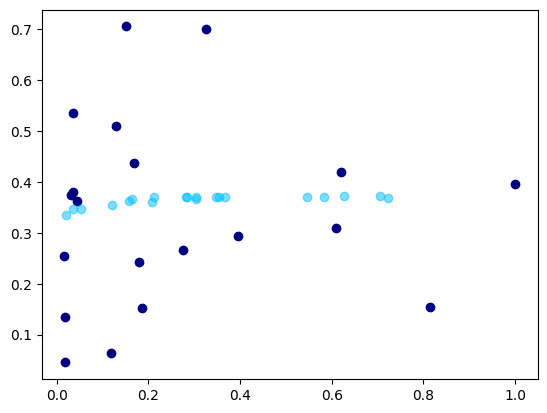

 52%|█████████████████████████████████████████▌                                      | 520/1000 [01:32<01:23,  5.78it/s]

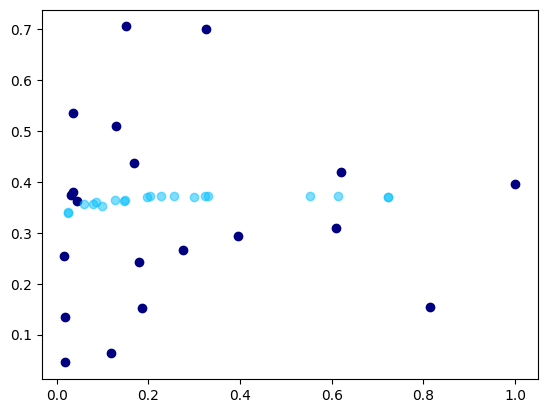

 52%|█████████████████████████████████████████▋                                      | 521/1000 [01:32<01:22,  5.82it/s]

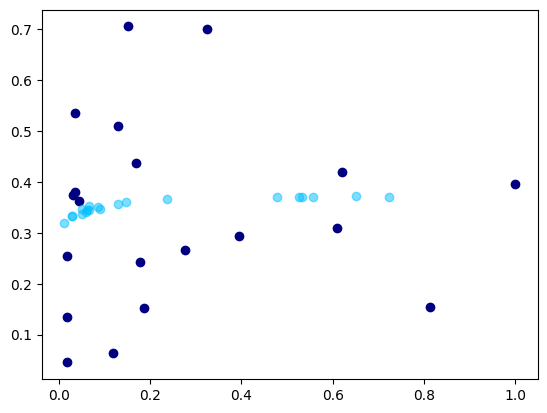

 52%|█████████████████████████████████████████▊                                      | 522/1000 [01:32<01:20,  5.92it/s]

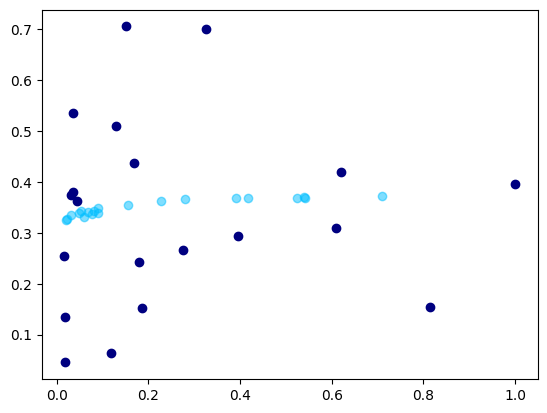

 52%|█████████████████████████████████████████▊                                      | 523/1000 [01:32<01:20,  5.96it/s]

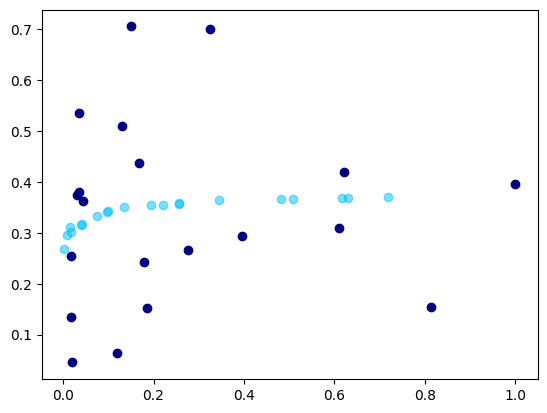

 52%|█████████████████████████████████████████▉                                      | 524/1000 [01:32<01:19,  5.99it/s]

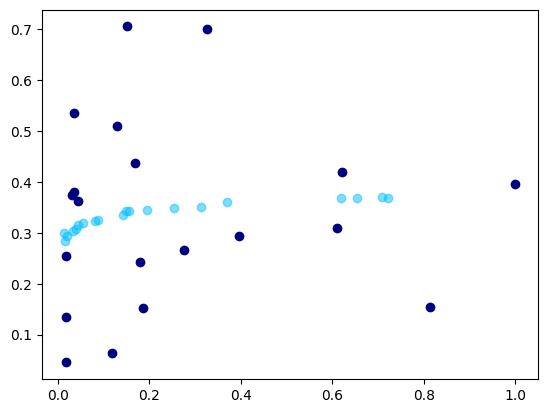

 52%|██████████████████████████████████████████                                      | 525/1000 [01:33<01:19,  5.97it/s]

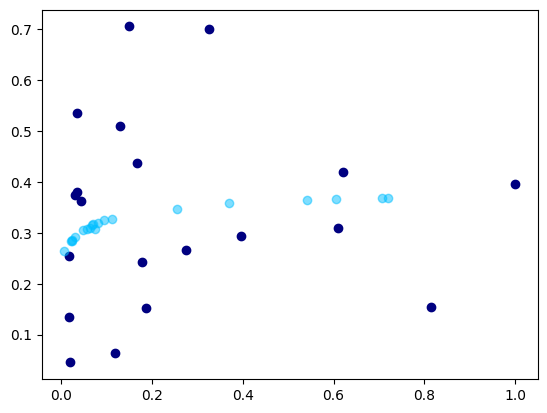

 53%|██████████████████████████████████████████                                      | 526/1000 [01:33<01:20,  5.88it/s]

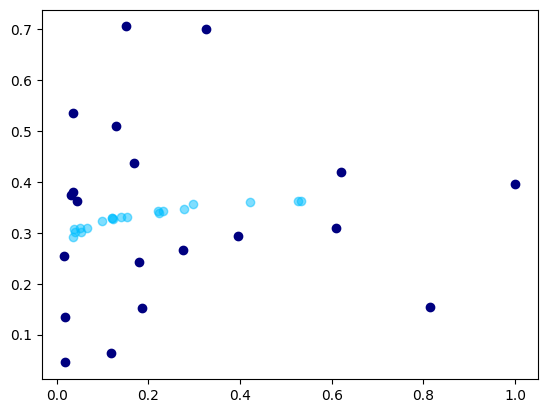

 53%|██████████████████████████████████████████▏                                     | 527/1000 [01:33<01:23,  5.64it/s]

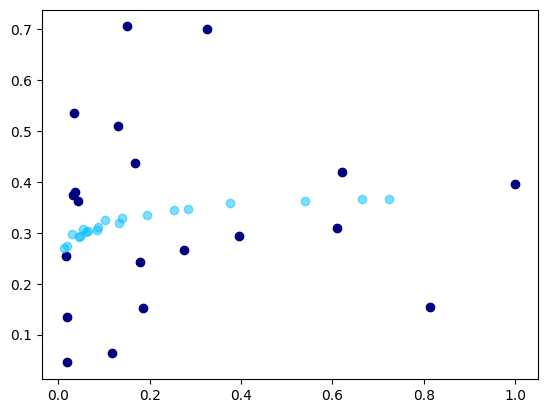

 53%|██████████████████████████████████████████▏                                     | 528/1000 [01:33<01:21,  5.77it/s]

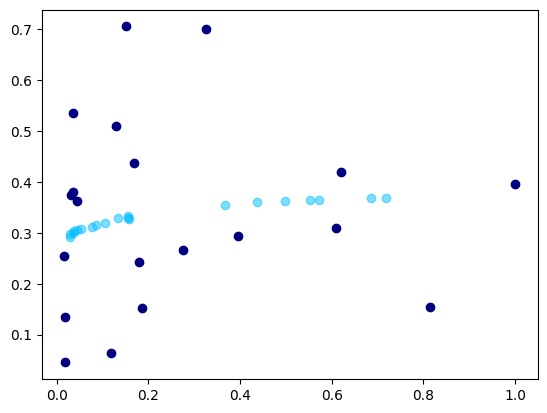

 53%|██████████████████████████████████████████▎                                     | 529/1000 [01:33<01:21,  5.77it/s]

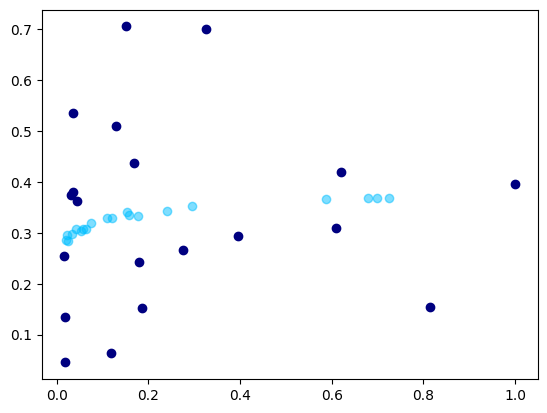

 53%|██████████████████████████████████████████▍                                     | 530/1000 [01:34<01:21,  5.78it/s]

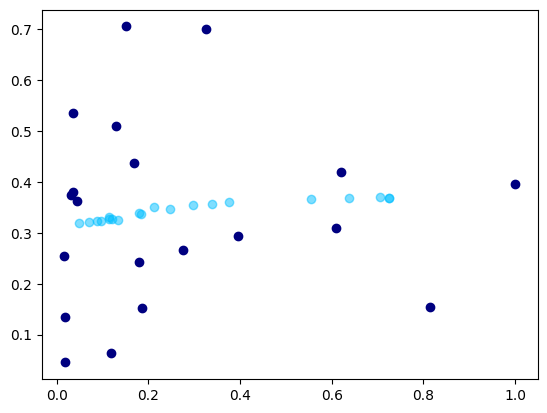

 53%|██████████████████████████████████████████▍                                     | 531/1000 [01:34<01:20,  5.84it/s]

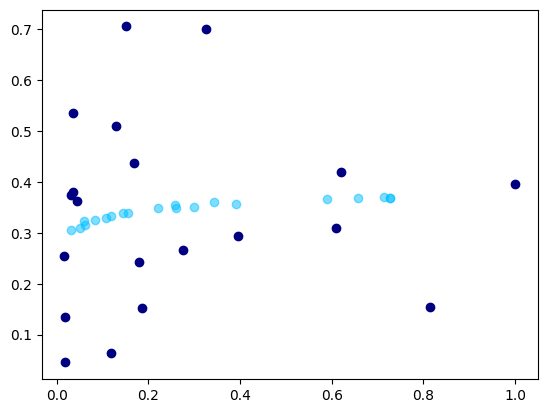

 53%|██████████████████████████████████████████▌                                     | 532/1000 [01:34<01:20,  5.80it/s]

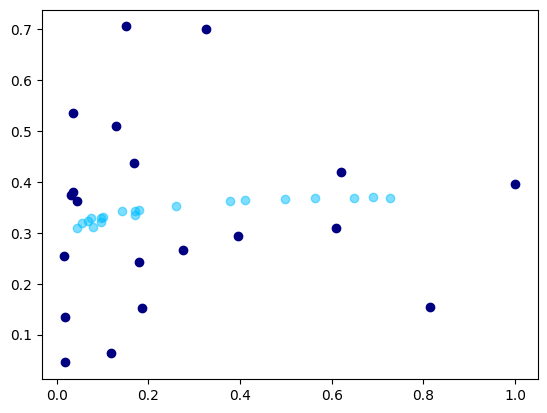

 53%|██████████████████████████████████████████▋                                     | 533/1000 [01:34<01:23,  5.60it/s]

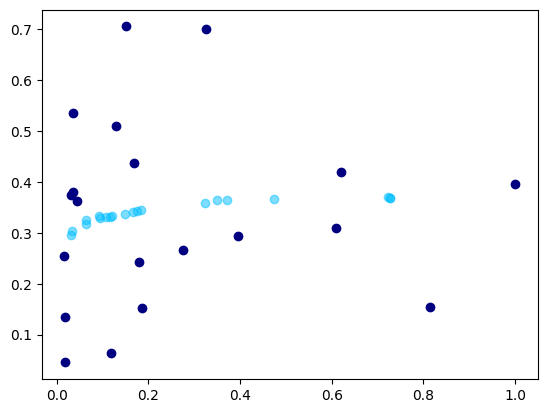

 53%|██████████████████████████████████████████▋                                     | 534/1000 [01:34<01:22,  5.66it/s]

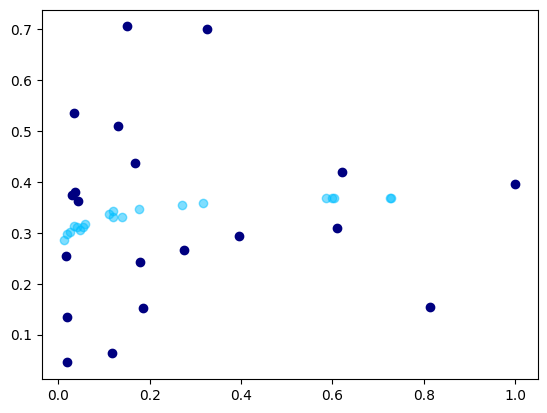

 54%|██████████████████████████████████████████▊                                     | 535/1000 [01:34<01:20,  5.74it/s]

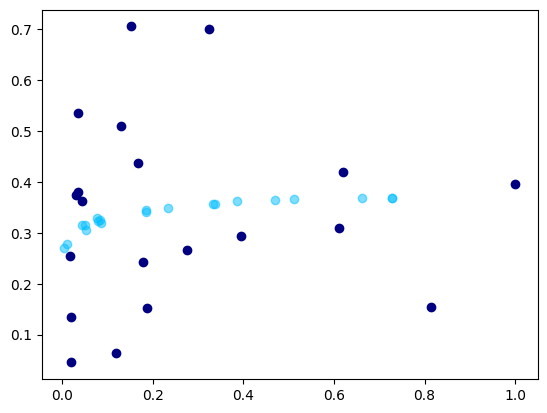

 54%|██████████████████████████████████████████▉                                     | 536/1000 [01:35<01:20,  5.80it/s]

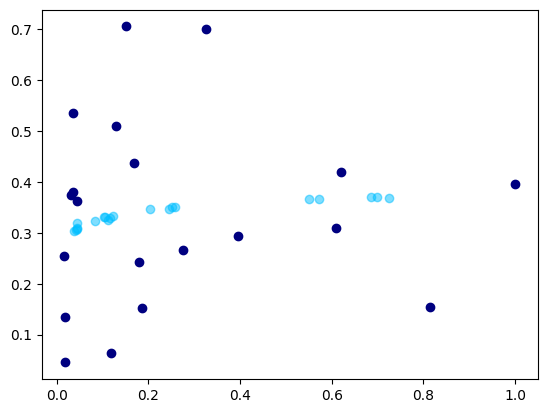

 54%|██████████████████████████████████████████▉                                     | 537/1000 [01:35<01:20,  5.78it/s]

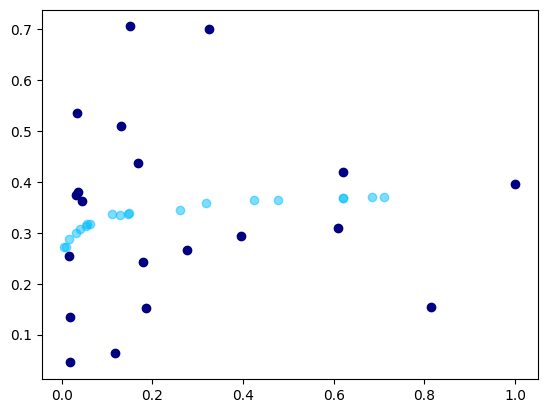

 54%|███████████████████████████████████████████                                     | 538/1000 [01:35<01:21,  5.65it/s]

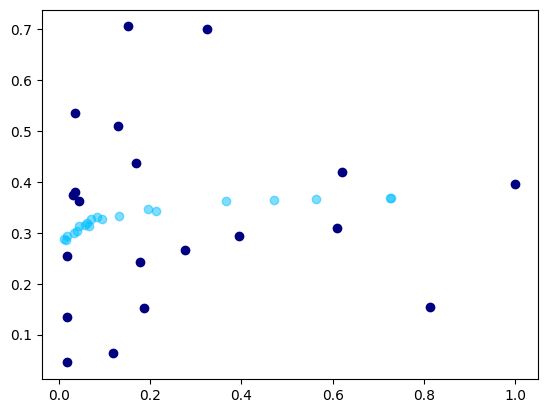

 54%|███████████████████████████████████████████                                     | 539/1000 [01:35<01:22,  5.59it/s]

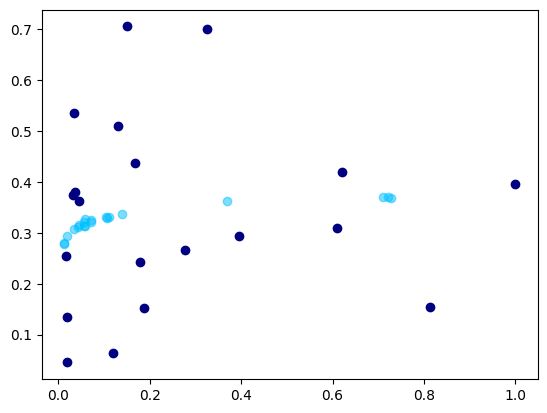

 54%|███████████████████████████████████████████▏                                    | 540/1000 [01:35<01:20,  5.69it/s]

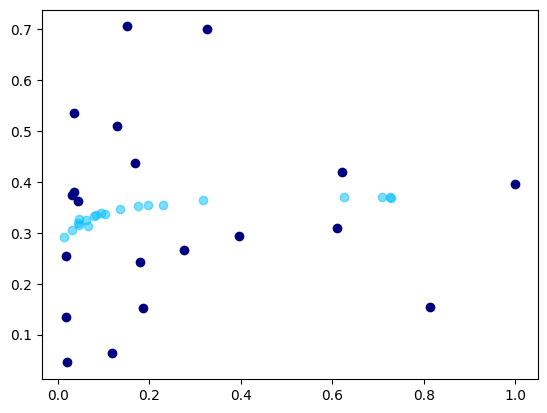

 54%|███████████████████████████████████████████▎                                    | 541/1000 [01:35<01:19,  5.79it/s]

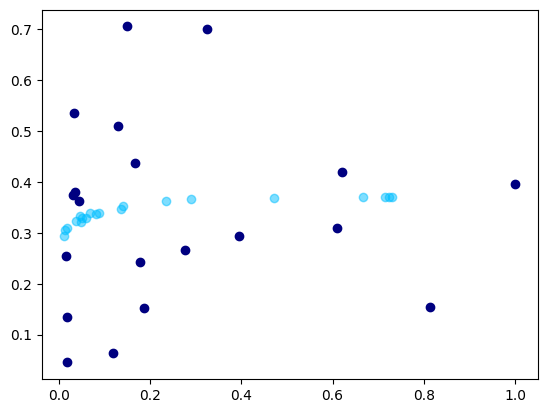

 54%|███████████████████████████████████████████▎                                    | 542/1000 [01:36<01:18,  5.83it/s]

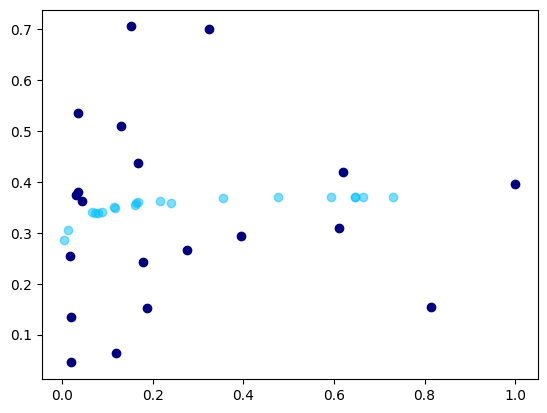

 54%|███████████████████████████████████████████▍                                    | 543/1000 [01:36<01:20,  5.70it/s]

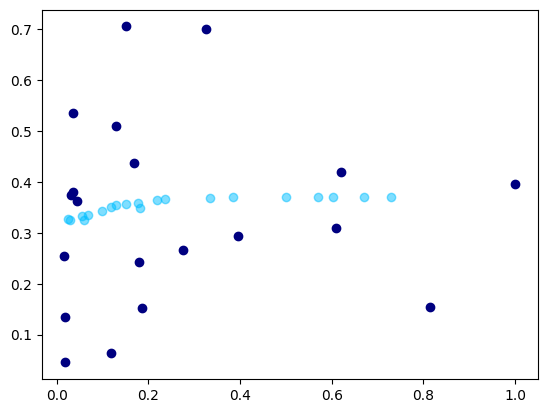

 54%|███████████████████████████████████████████▌                                    | 544/1000 [01:36<01:19,  5.70it/s]

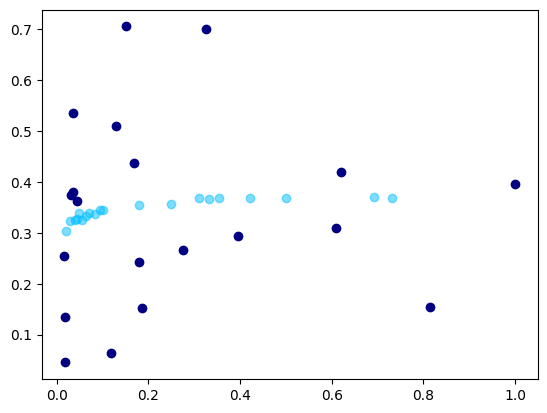

 55%|███████████████████████████████████████████▌                                    | 545/1000 [01:36<01:17,  5.84it/s]

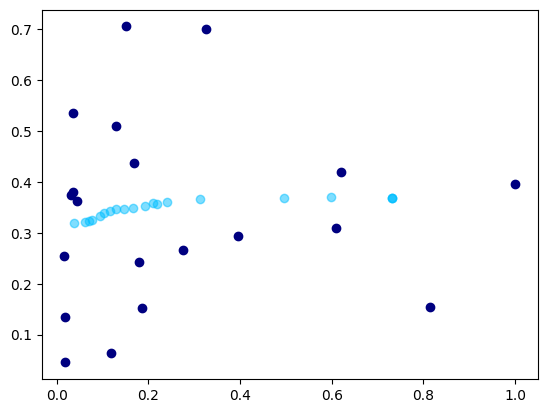

 55%|███████████████████████████████████████████▋                                    | 546/1000 [01:36<01:17,  5.85it/s]

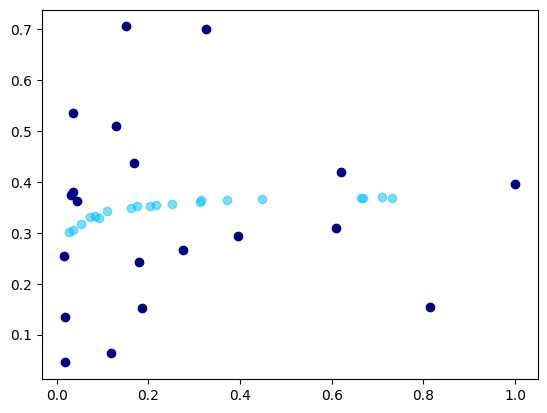

 55%|███████████████████████████████████████████▊                                    | 547/1000 [01:36<01:16,  5.93it/s]

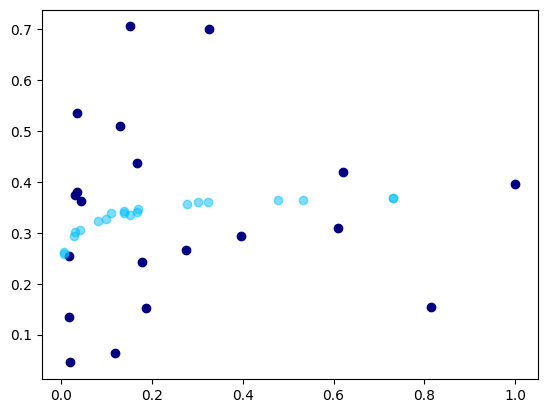

 55%|███████████████████████████████████████████▊                                    | 548/1000 [01:37<01:15,  5.95it/s]

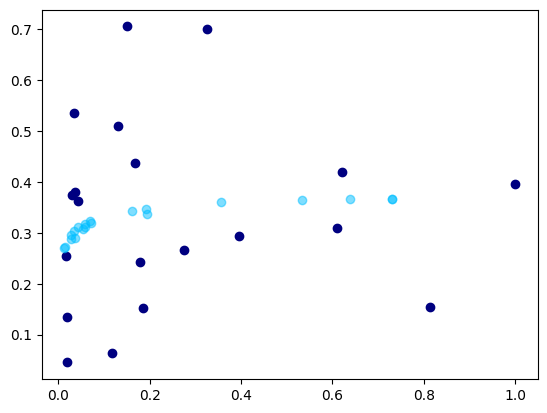

 55%|███████████████████████████████████████████▉                                    | 549/1000 [01:37<01:15,  5.97it/s]

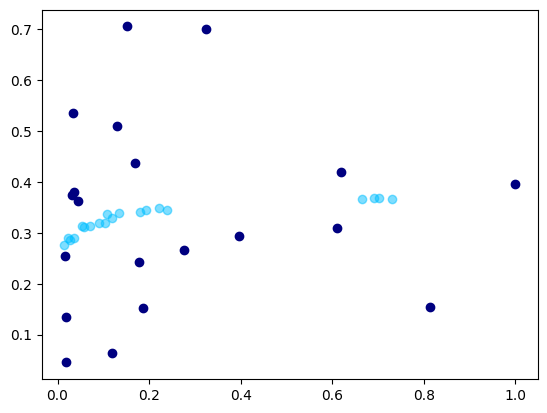

 55%|████████████████████████████████████████████                                    | 550/1000 [01:37<01:15,  5.99it/s]

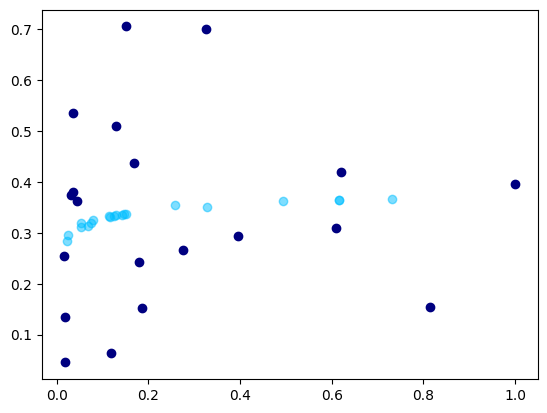

 55%|████████████████████████████████████████████                                    | 551/1000 [01:37<01:14,  6.00it/s]

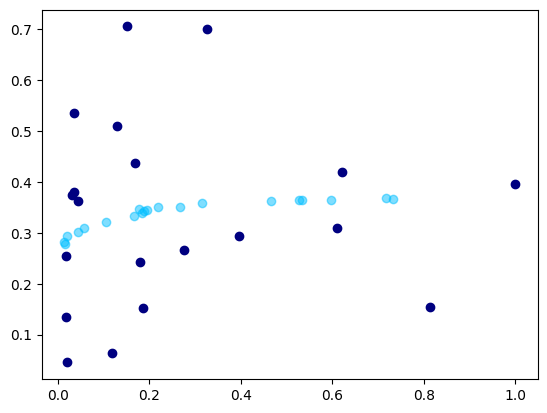

 55%|████████████████████████████████████████████▏                                   | 552/1000 [01:37<01:15,  5.95it/s]

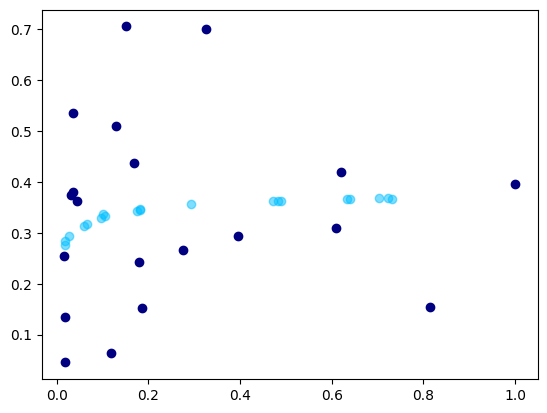

 55%|████████████████████████████████████████████▏                                   | 553/1000 [01:37<01:14,  5.99it/s]

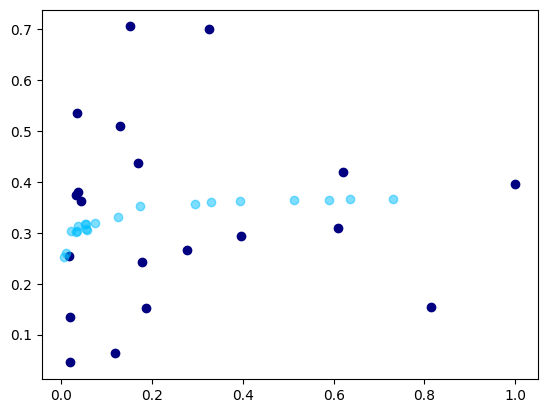

 55%|████████████████████████████████████████████▎                                   | 554/1000 [01:38<01:14,  5.98it/s]

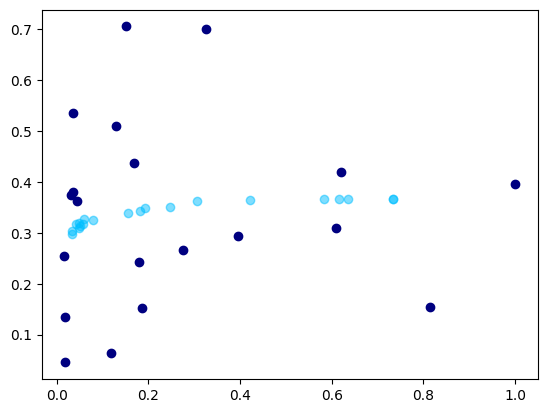

 56%|████████████████████████████████████████████▍                                   | 555/1000 [01:38<01:15,  5.89it/s]

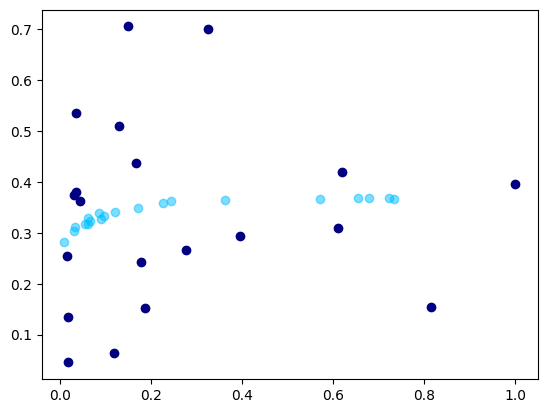

 56%|████████████████████████████████████████████▍                                   | 556/1000 [01:38<01:16,  5.81it/s]

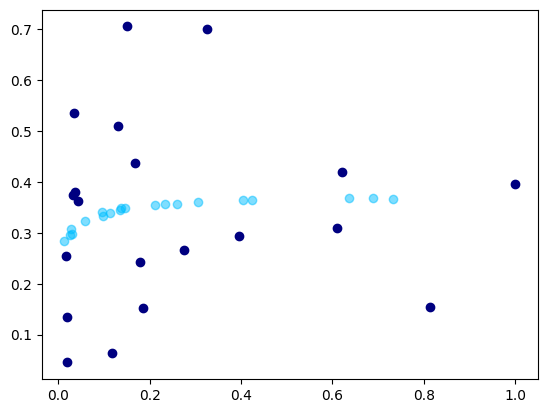

 56%|████████████████████████████████████████████▌                                   | 557/1000 [01:38<01:15,  5.89it/s]

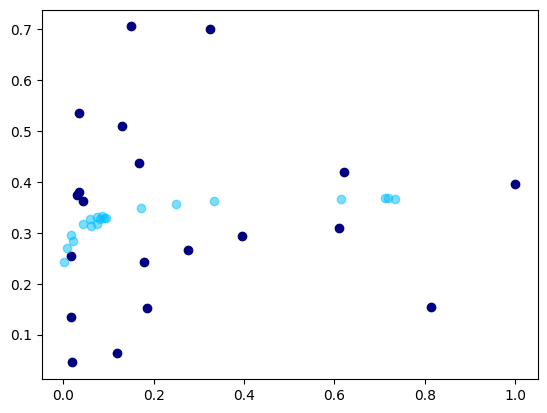

 56%|████████████████████████████████████████████▋                                   | 558/1000 [01:38<01:14,  5.93it/s]

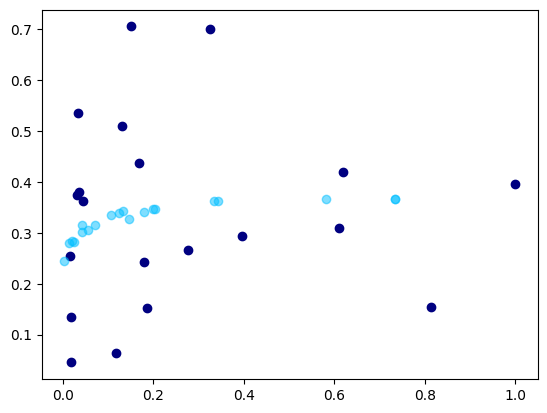

 56%|████████████████████████████████████████████▋                                   | 559/1000 [01:38<01:14,  5.90it/s]

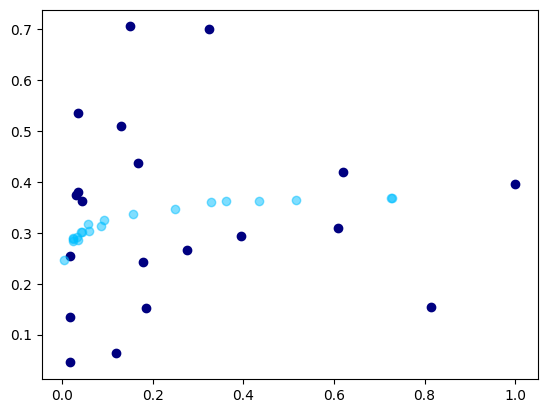

 56%|████████████████████████████████████████████▊                                   | 560/1000 [01:39<01:13,  5.97it/s]

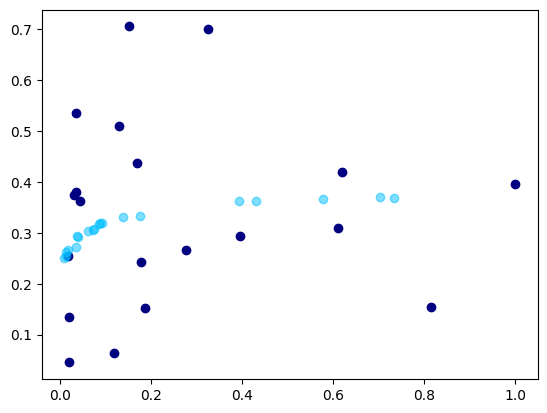

 56%|████████████████████████████████████████████▉                                   | 561/1000 [01:39<01:13,  6.01it/s]

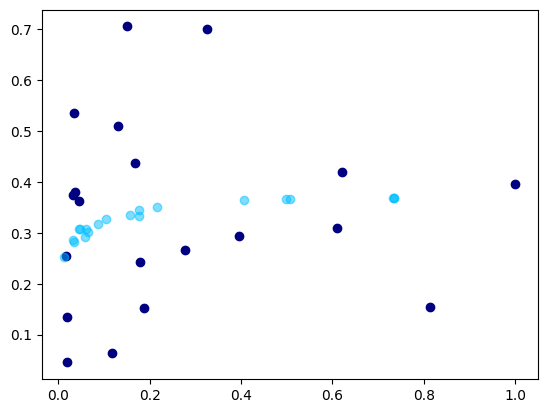

 56%|████████████████████████████████████████████▉                                   | 562/1000 [01:39<01:12,  6.04it/s]

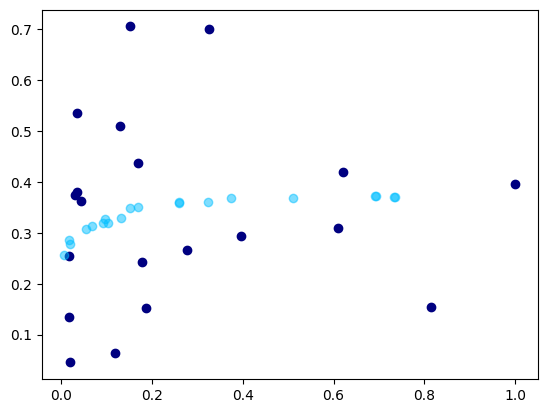

 56%|█████████████████████████████████████████████                                   | 563/1000 [01:39<01:12,  6.02it/s]

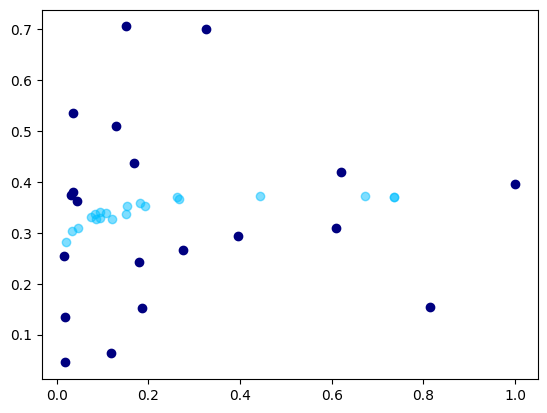

 56%|█████████████████████████████████████████████                                   | 564/1000 [01:39<01:12,  6.00it/s]

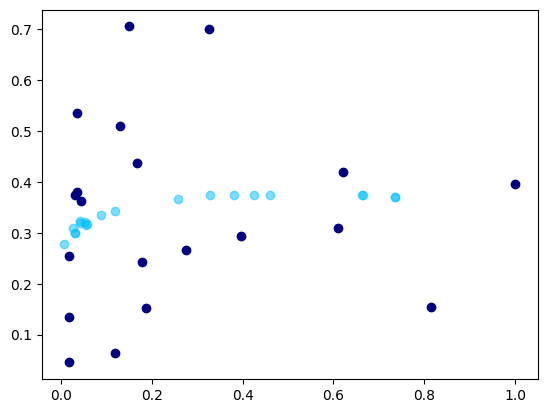

 56%|█████████████████████████████████████████████▏                                  | 565/1000 [01:40<01:15,  5.76it/s]

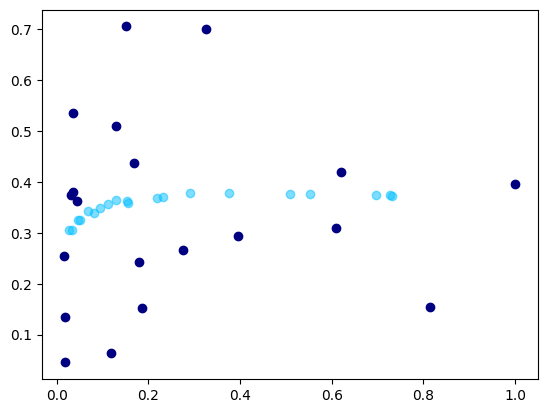

 57%|█████████████████████████████████████████████▎                                  | 566/1000 [01:40<01:17,  5.59it/s]

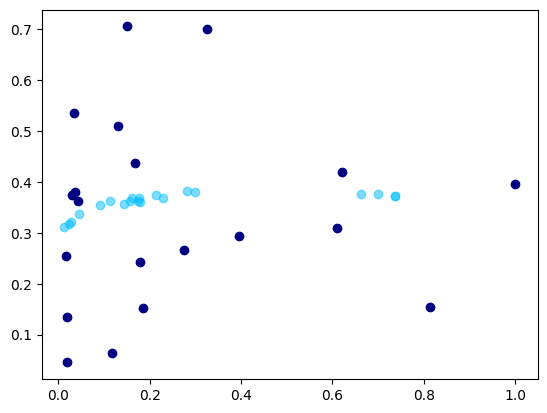

 57%|█████████████████████████████████████████████▎                                  | 567/1000 [01:40<01:16,  5.67it/s]

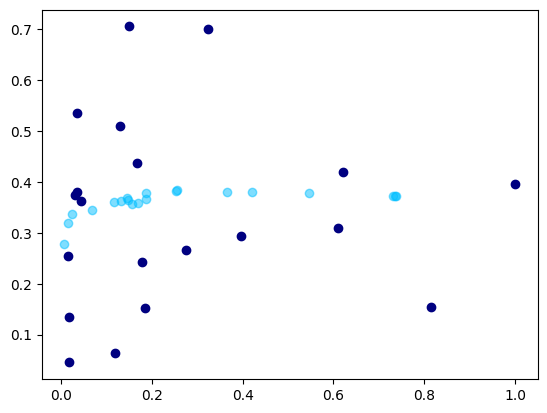

 57%|█████████████████████████████████████████████▍                                  | 568/1000 [01:40<01:16,  5.63it/s]

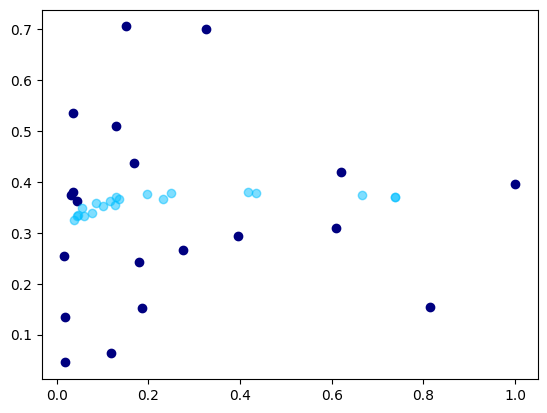

 57%|█████████████████████████████████████████████▌                                  | 569/1000 [01:40<01:19,  5.43it/s]

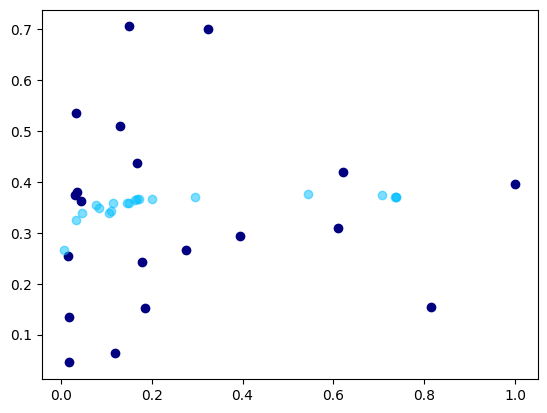

 57%|█████████████████████████████████████████████▌                                  | 570/1000 [01:40<01:17,  5.52it/s]

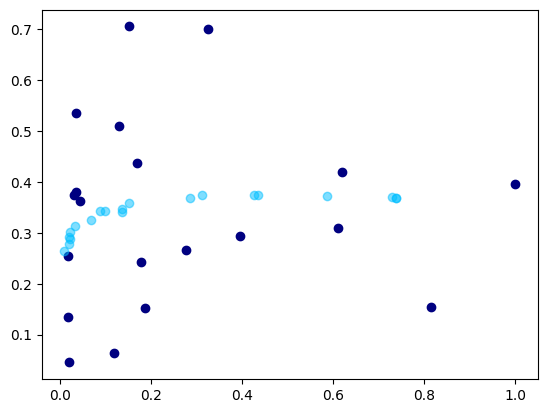

 57%|█████████████████████████████████████████████▋                                  | 571/1000 [01:41<01:16,  5.59it/s]

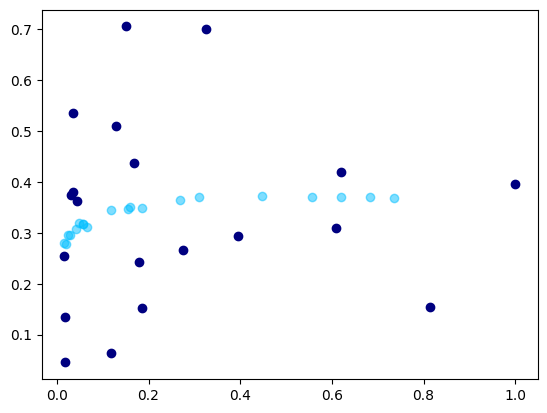

 57%|█████████████████████████████████████████████▊                                  | 572/1000 [01:41<01:17,  5.49it/s]

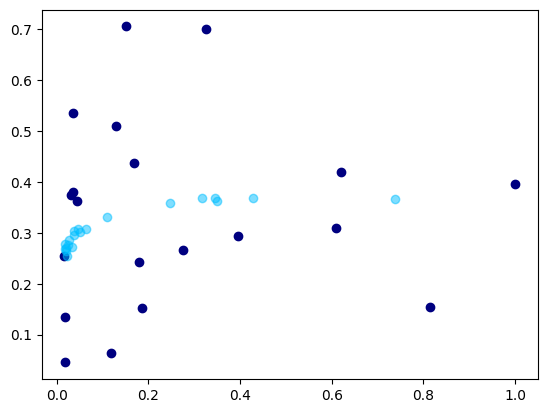

 57%|█████████████████████████████████████████████▊                                  | 573/1000 [01:41<01:17,  5.54it/s]

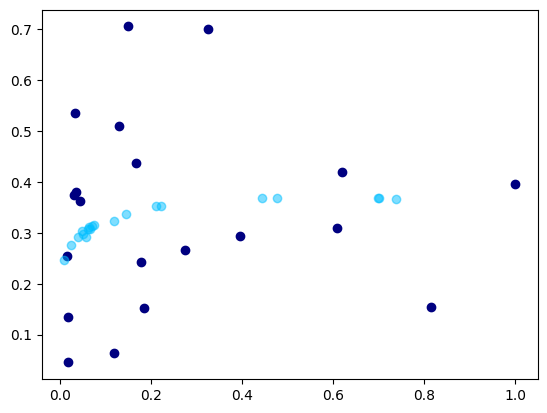

 57%|█████████████████████████████████████████████▉                                  | 574/1000 [01:41<01:16,  5.56it/s]

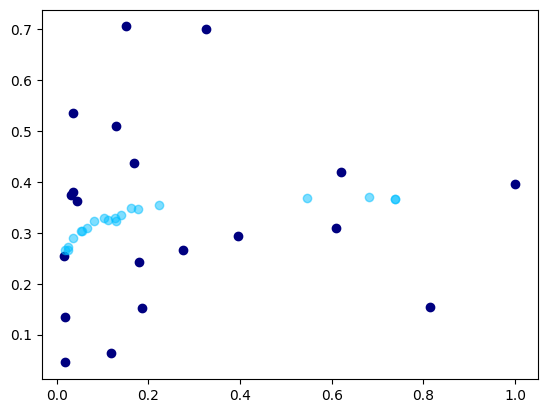

 57%|██████████████████████████████████████████████                                  | 575/1000 [01:41<01:15,  5.62it/s]

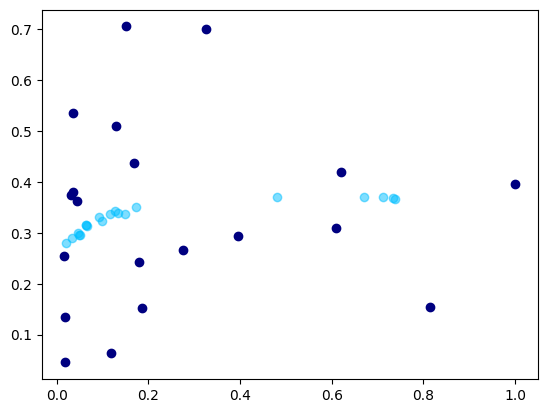

 58%|██████████████████████████████████████████████                                  | 576/1000 [01:41<01:14,  5.71it/s]

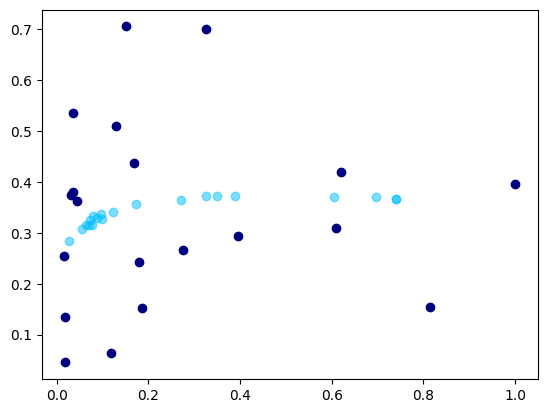

 58%|██████████████████████████████████████████████▏                                 | 577/1000 [01:42<01:14,  5.64it/s]

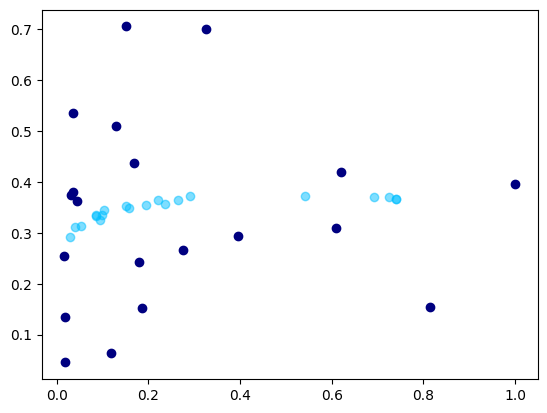

 58%|██████████████████████████████████████████████▏                                 | 578/1000 [01:42<01:13,  5.73it/s]

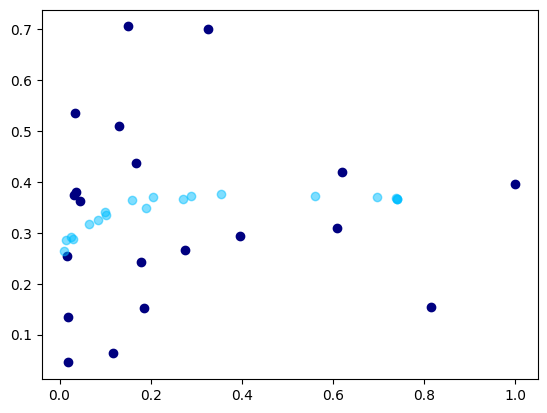

 58%|██████████████████████████████████████████████▎                                 | 579/1000 [01:42<01:13,  5.70it/s]

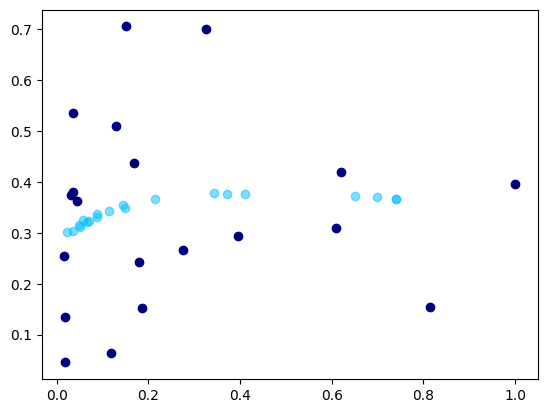

 58%|██████████████████████████████████████████████▍                                 | 580/1000 [01:42<01:11,  5.84it/s]

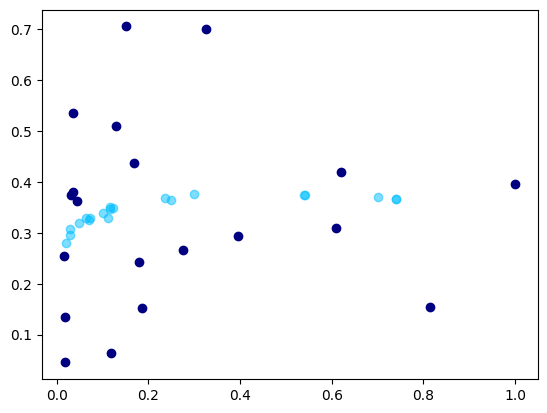

 58%|██████████████████████████████████████████████▍                                 | 581/1000 [01:42<01:11,  5.85it/s]

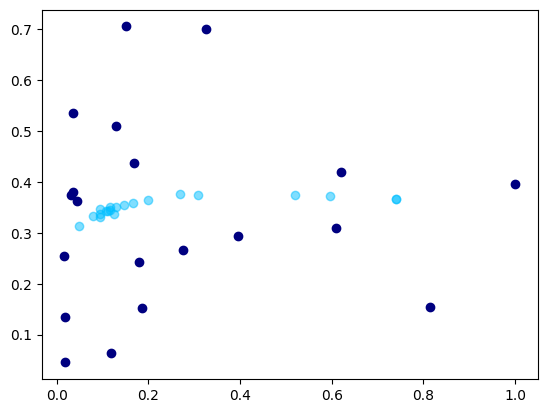

 58%|██████████████████████████████████████████████▌                                 | 582/1000 [01:43<01:11,  5.89it/s]

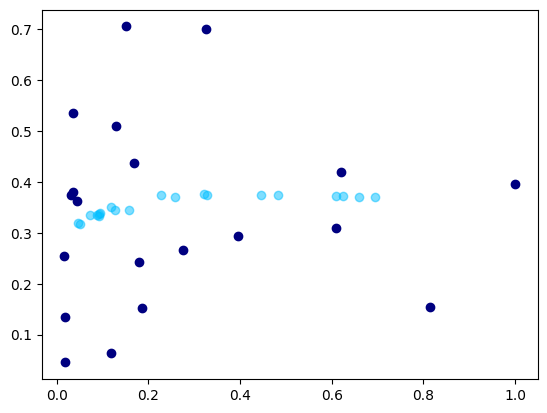

 58%|██████████████████████████████████████████████▋                                 | 583/1000 [01:43<01:10,  5.92it/s]

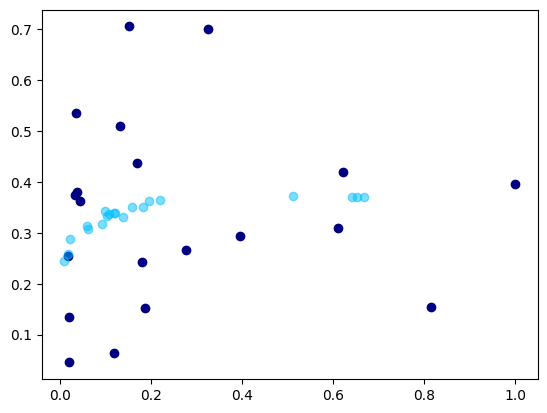

 58%|██████████████████████████████████████████████▋                                 | 584/1000 [01:43<01:10,  5.93it/s]

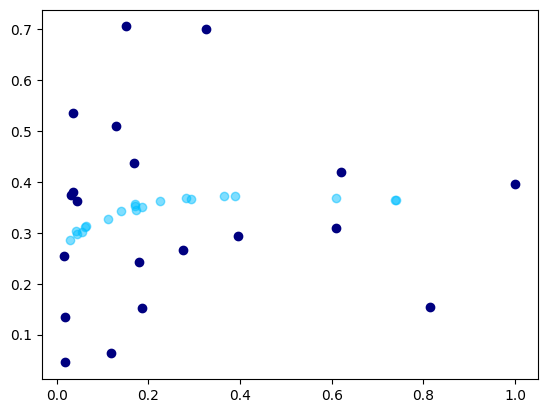

 58%|██████████████████████████████████████████████▊                                 | 585/1000 [01:43<01:09,  5.99it/s]

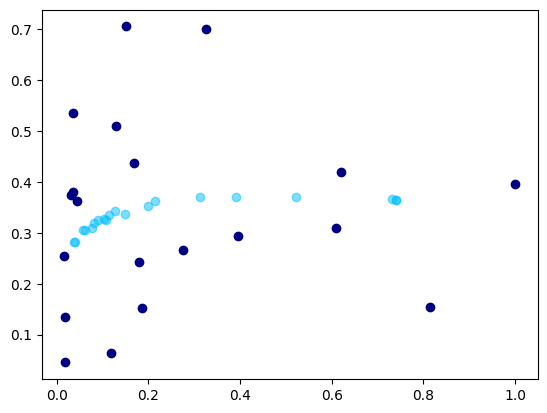

 59%|██████████████████████████████████████████████▉                                 | 586/1000 [01:43<01:08,  6.01it/s]

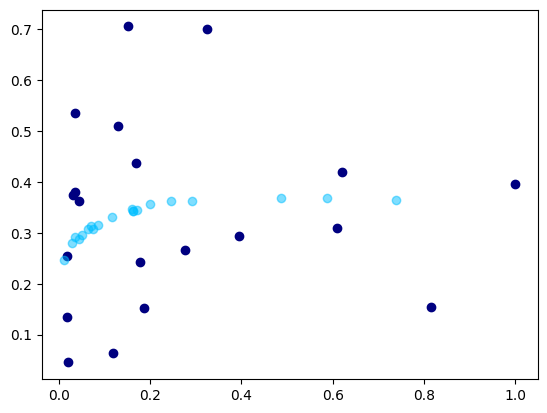

 59%|██████████████████████████████████████████████▉                                 | 587/1000 [01:43<01:08,  6.05it/s]

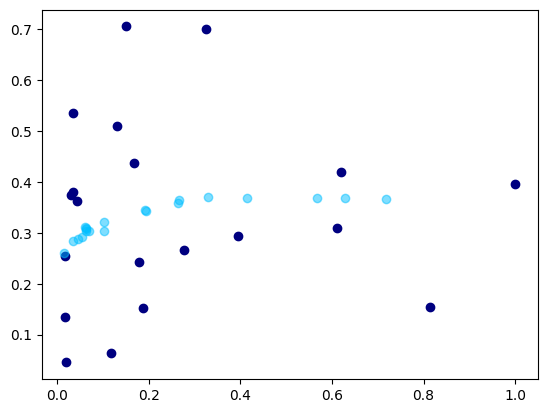

 59%|███████████████████████████████████████████████                                 | 588/1000 [01:44<01:08,  5.98it/s]

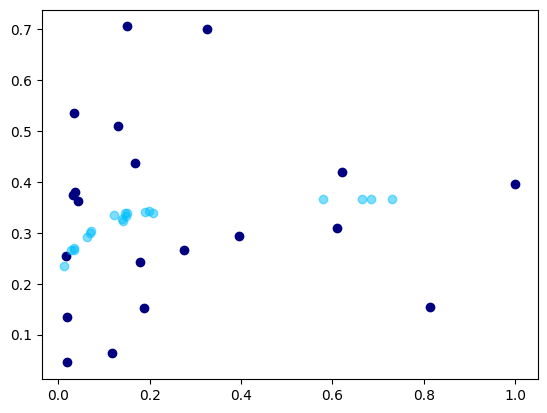

 59%|███████████████████████████████████████████████                                 | 589/1000 [01:44<01:08,  6.01it/s]

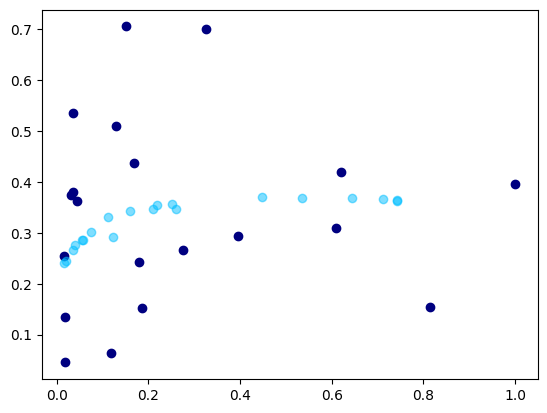

 59%|███████████████████████████████████████████████▏                                | 590/1000 [01:44<01:08,  5.99it/s]

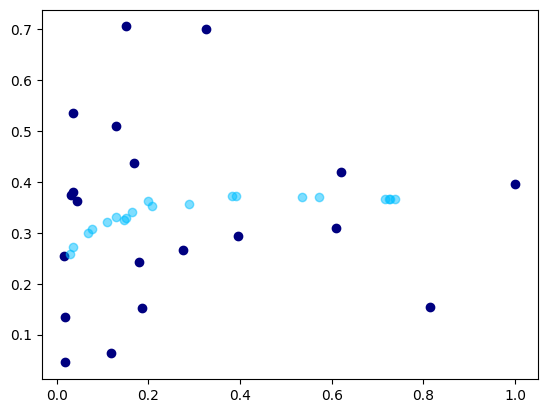

 59%|███████████████████████████████████████████████▎                                | 591/1000 [01:44<01:07,  6.05it/s]

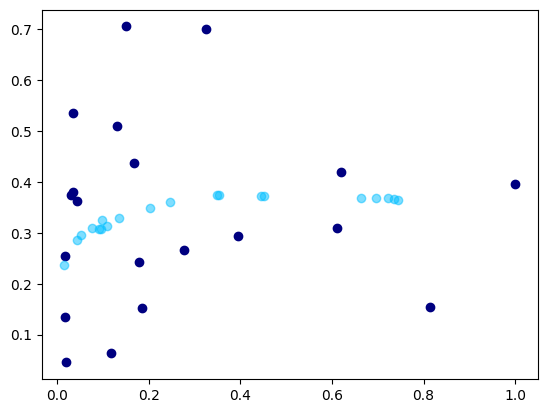

 59%|███████████████████████████████████████████████▎                                | 592/1000 [01:44<01:08,  6.00it/s]

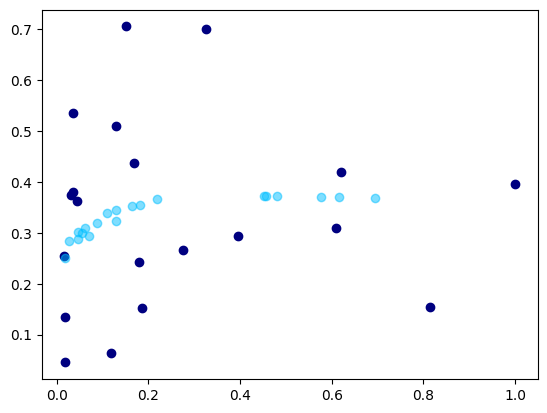

 59%|███████████████████████████████████████████████▍                                | 593/1000 [01:44<01:07,  6.00it/s]

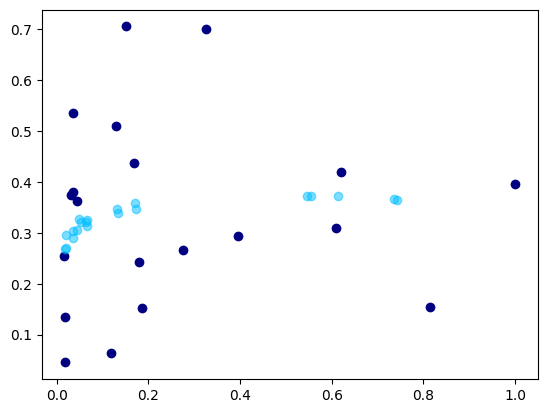

 59%|███████████████████████████████████████████████▌                                | 594/1000 [01:45<01:08,  5.95it/s]

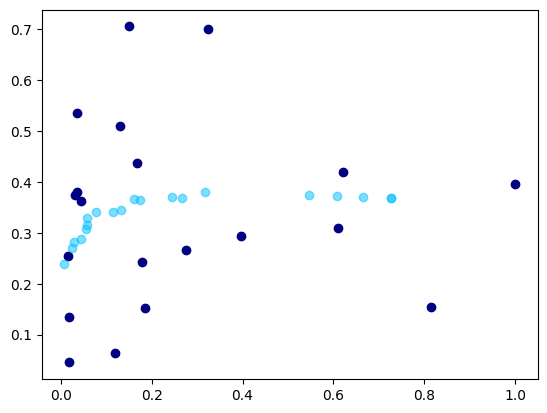

 60%|███████████████████████████████████████████████▌                                | 595/1000 [01:45<01:09,  5.83it/s]

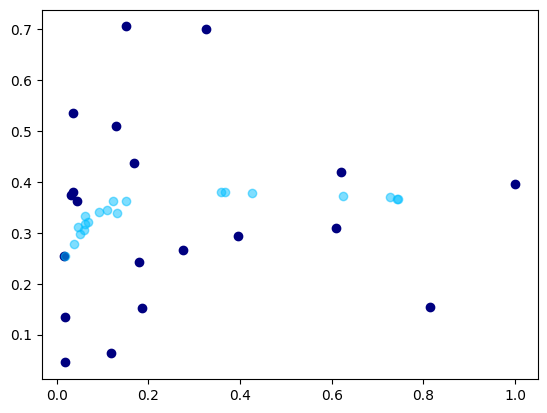

 60%|███████████████████████████████████████████████▋                                | 596/1000 [01:45<01:09,  5.84it/s]

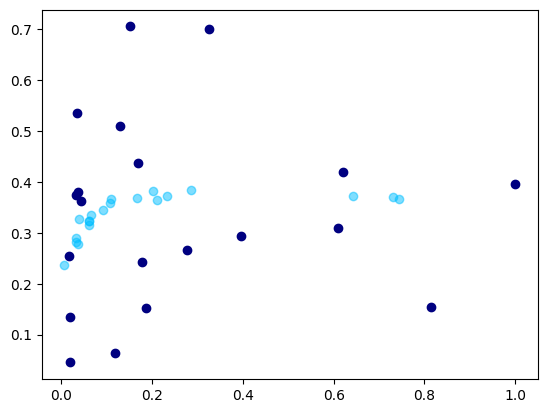

 60%|███████████████████████████████████████████████▊                                | 597/1000 [01:45<01:08,  5.86it/s]

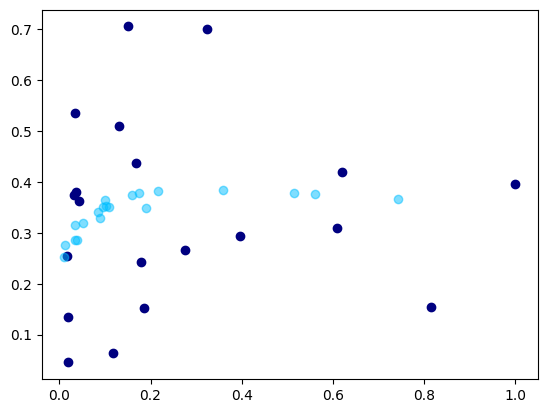

 60%|███████████████████████████████████████████████▊                                | 598/1000 [01:45<01:08,  5.84it/s]

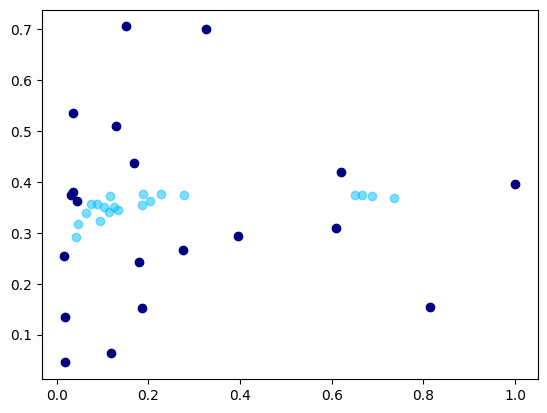

 60%|███████████████████████████████████████████████▉                                | 599/1000 [01:45<01:07,  5.90it/s]

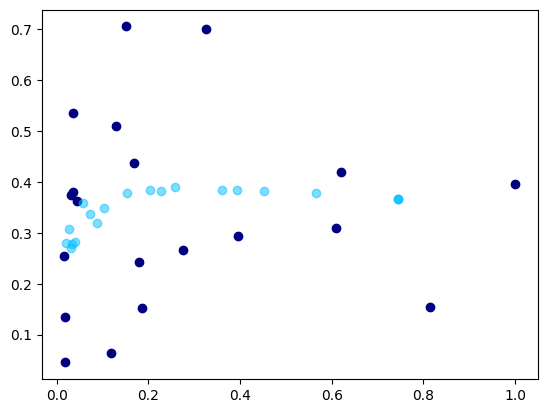

 60%|████████████████████████████████████████████████                                | 600/1000 [01:46<01:07,  5.92it/s]

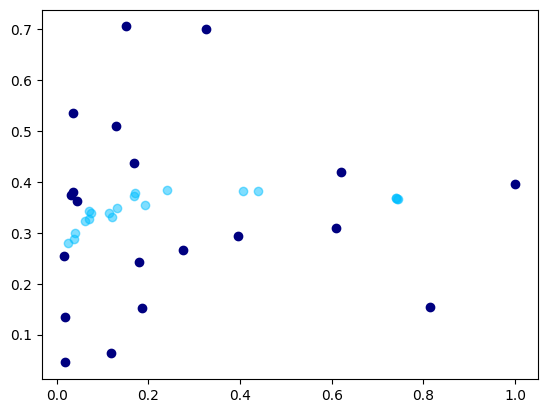

 60%|████████████████████████████████████████████████                                | 601/1000 [01:46<01:06,  5.98it/s]

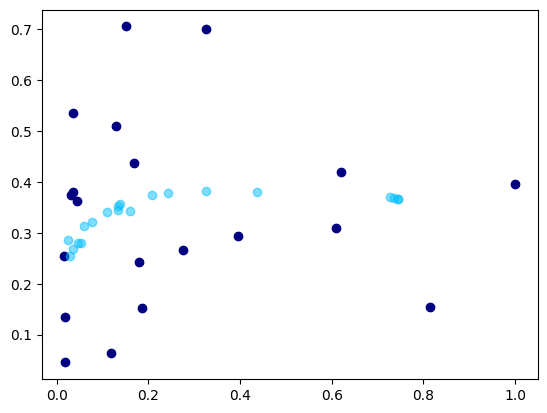

 60%|████████████████████████████████████████████████▏                               | 602/1000 [01:46<01:07,  5.94it/s]

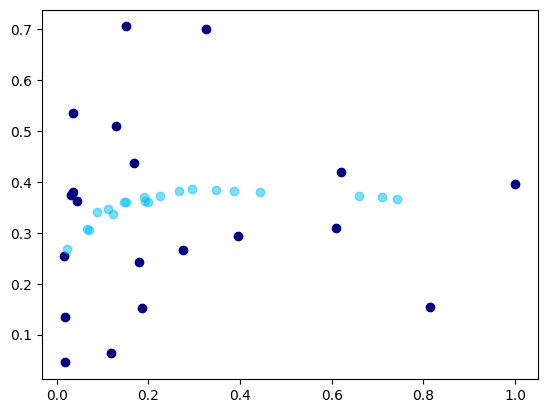

 60%|████████████████████████████████████████████████▏                               | 603/1000 [01:46<01:06,  6.01it/s]

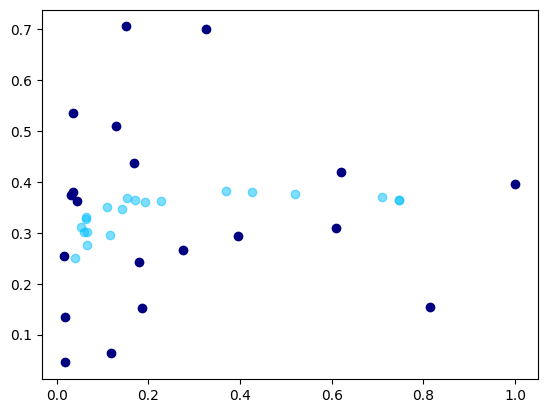

 60%|████████████████████████████████████████████████▎                               | 604/1000 [01:47<01:59,  3.33it/s]

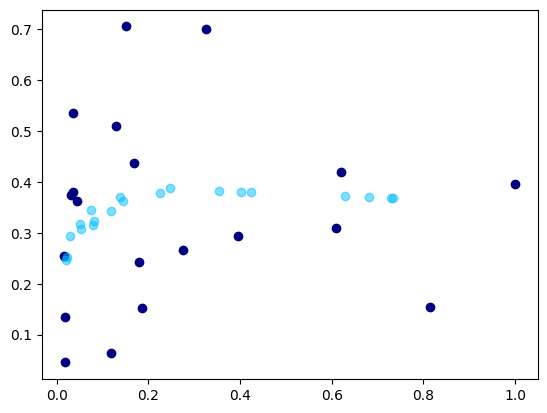

 60%|████████████████████████████████████████████████▍                               | 605/1000 [01:47<01:46,  3.71it/s]

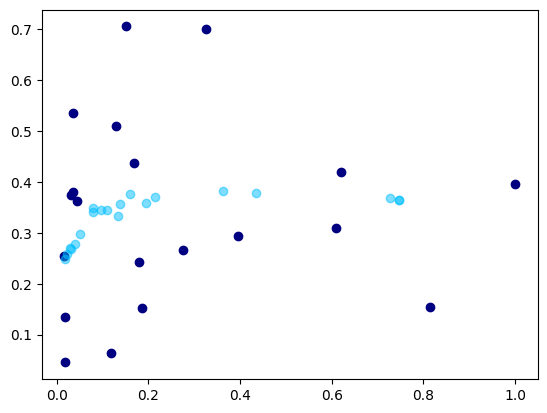

 61%|████████████████████████████████████████████████▍                               | 606/1000 [01:47<01:35,  4.14it/s]

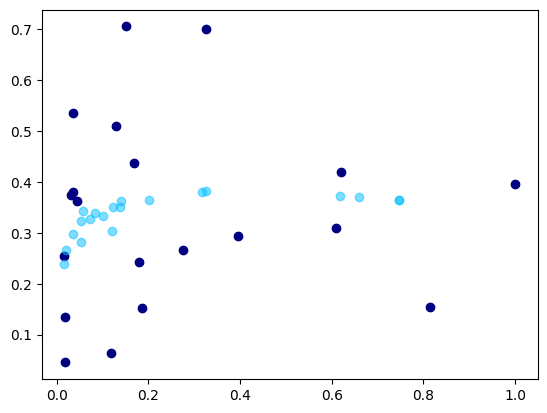

 61%|████████████████████████████████████████████████▌                               | 607/1000 [01:47<01:26,  4.53it/s]

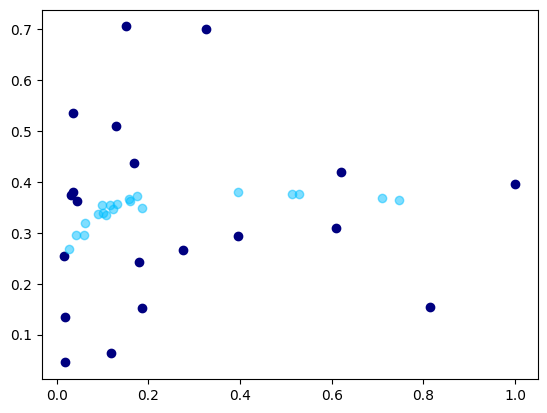

 61%|████████████████████████████████████████████████▋                               | 608/1000 [01:47<01:20,  4.87it/s]

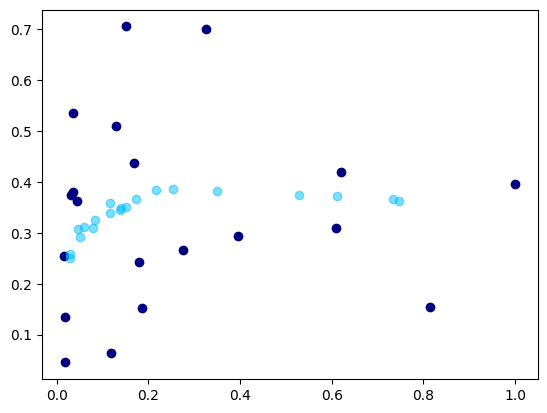

 61%|████████████████████████████████████████████████▋                               | 609/1000 [01:48<01:20,  4.84it/s]

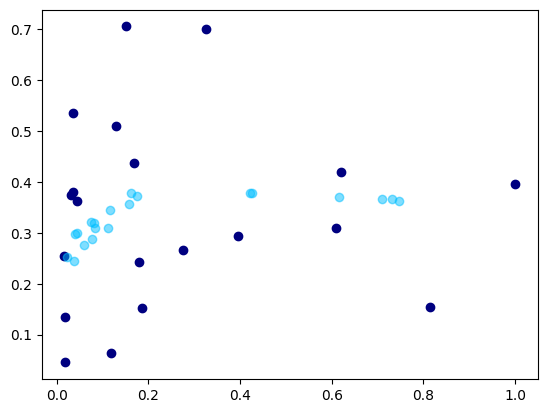

 61%|████████████████████████████████████████████████▊                               | 610/1000 [01:48<01:18,  4.97it/s]

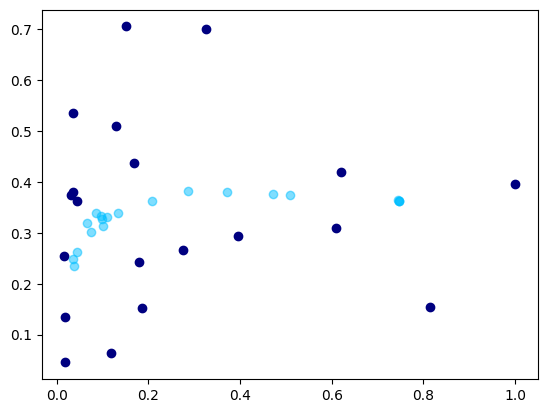

 61%|████████████████████████████████████████████████▉                               | 611/1000 [01:48<01:16,  5.07it/s]

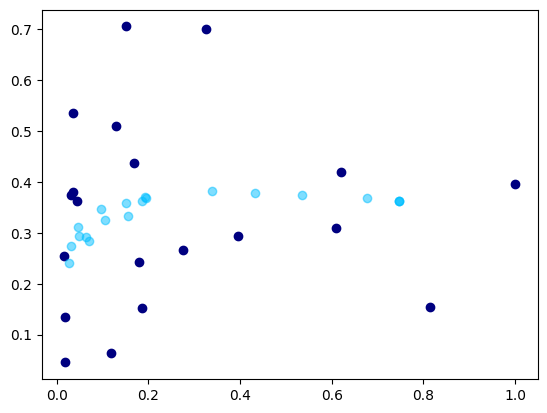

 61%|████████████████████████████████████████████████▉                               | 612/1000 [01:48<01:13,  5.31it/s]

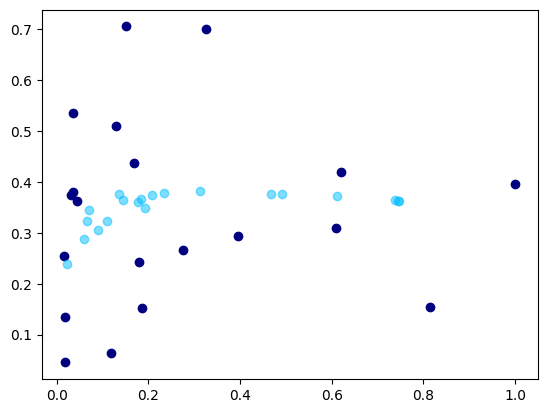

 61%|█████████████████████████████████████████████████                               | 613/1000 [01:48<01:10,  5.50it/s]

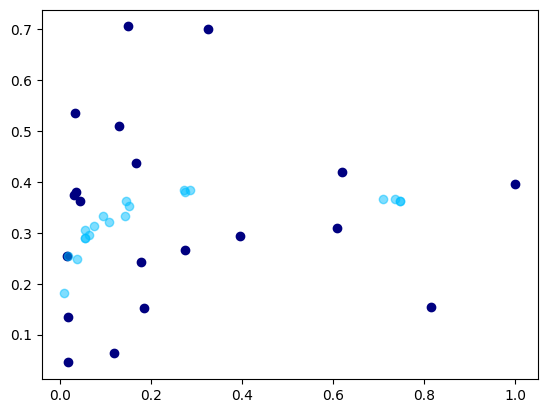

 61%|█████████████████████████████████████████████████                               | 614/1000 [01:48<01:08,  5.61it/s]

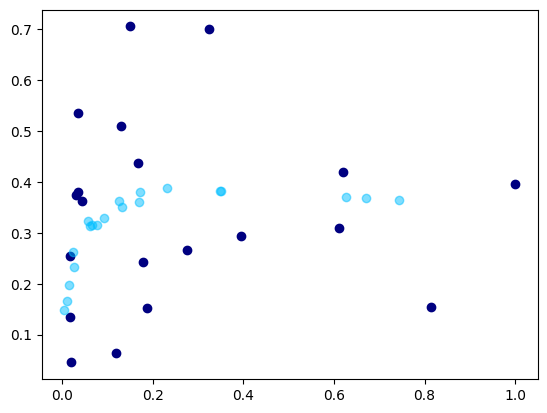

 62%|█████████████████████████████████████████████████▏                              | 615/1000 [01:49<01:08,  5.66it/s]

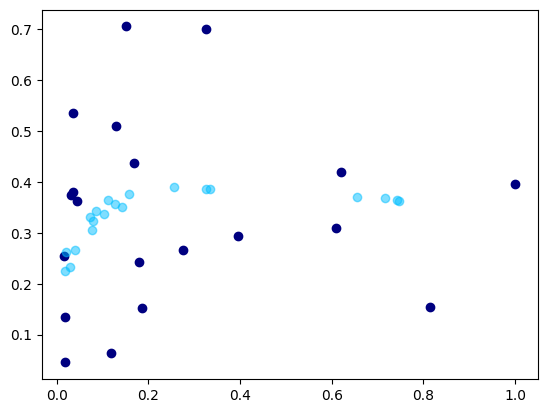

 62%|█████████████████████████████████████████████████▎                              | 616/1000 [01:49<01:08,  5.64it/s]

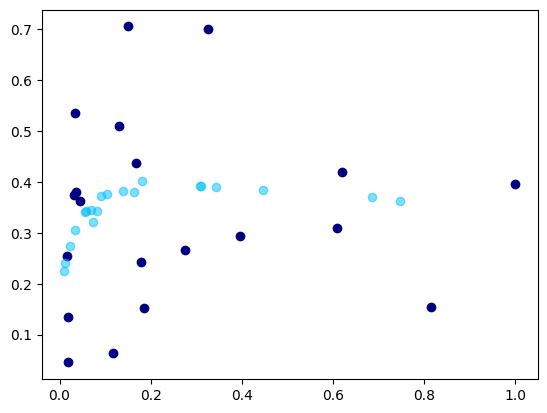

 62%|█████████████████████████████████████████████████▎                              | 617/1000 [01:49<01:07,  5.70it/s]

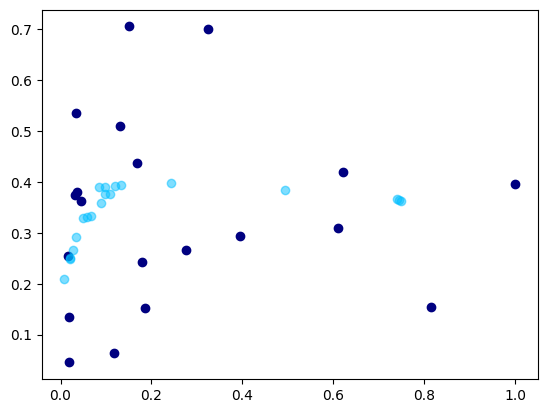

 62%|█████████████████████████████████████████████████▍                              | 618/1000 [01:49<01:05,  5.79it/s]

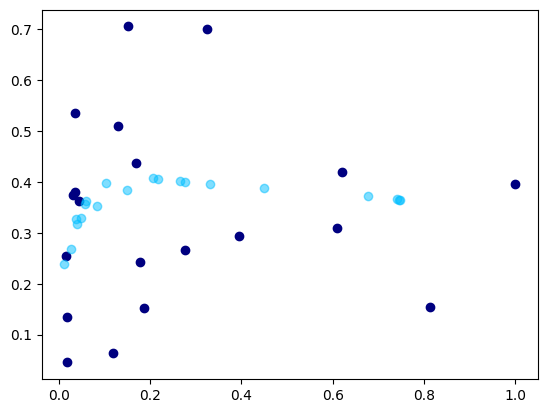

 62%|█████████████████████████████████████████████████▌                              | 619/1000 [01:49<01:04,  5.89it/s]

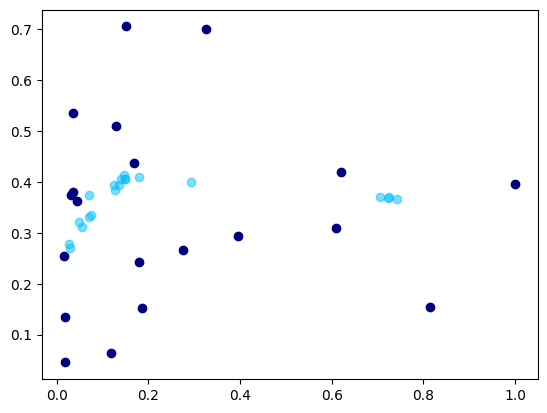

 62%|█████████████████████████████████████████████████▌                              | 620/1000 [01:49<01:04,  5.92it/s]

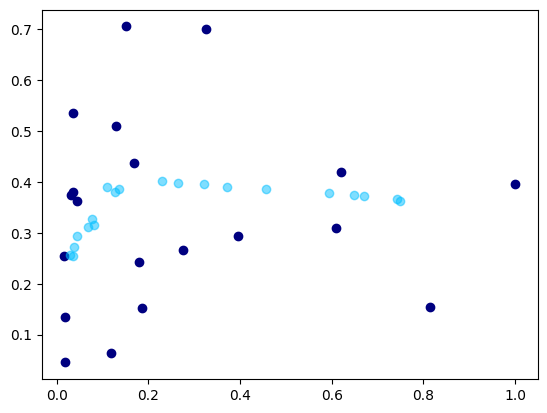

 62%|█████████████████████████████████████████████████▋                              | 621/1000 [01:50<01:05,  5.81it/s]

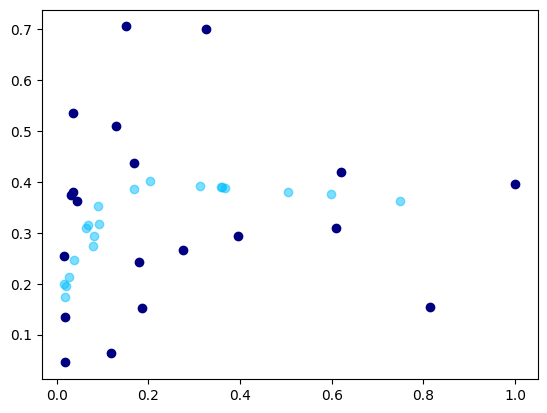

 62%|█████████████████████████████████████████████████▊                              | 622/1000 [01:50<01:07,  5.61it/s]

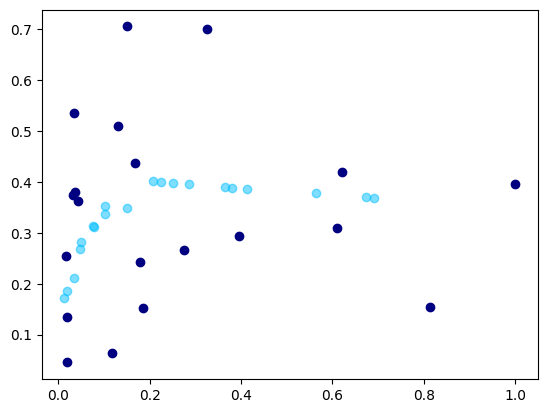

 62%|█████████████████████████████████████████████████▊                              | 623/1000 [01:50<01:06,  5.70it/s]

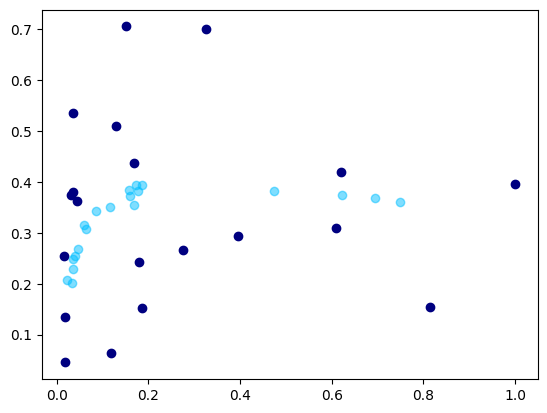

 62%|█████████████████████████████████████████████████▉                              | 624/1000 [01:50<01:07,  5.60it/s]

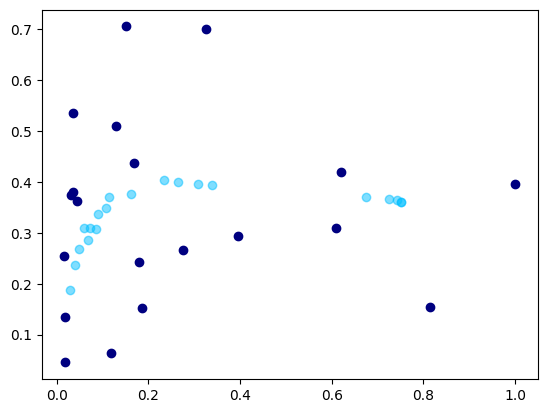

 62%|██████████████████████████████████████████████████                              | 625/1000 [01:50<01:05,  5.77it/s]

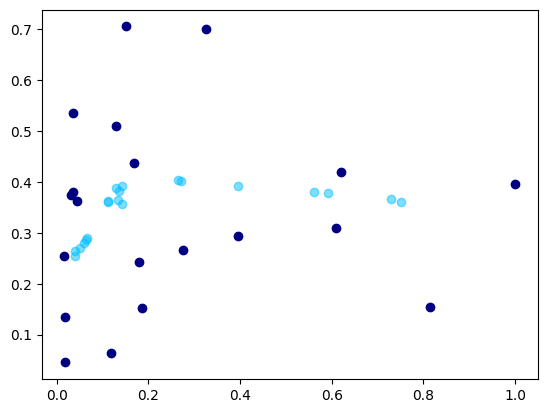

 63%|██████████████████████████████████████████████████                              | 626/1000 [01:51<01:03,  5.87it/s]

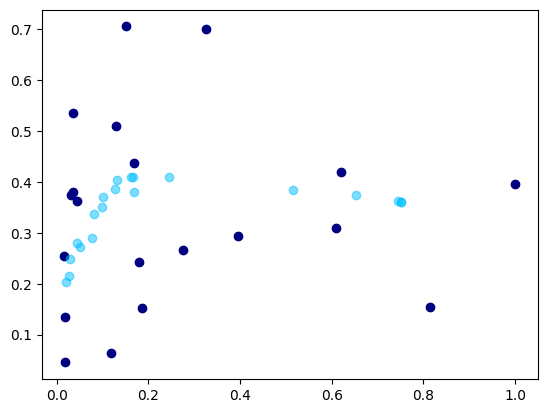

 63%|██████████████████████████████████████████████████▏                             | 627/1000 [01:51<01:03,  5.88it/s]

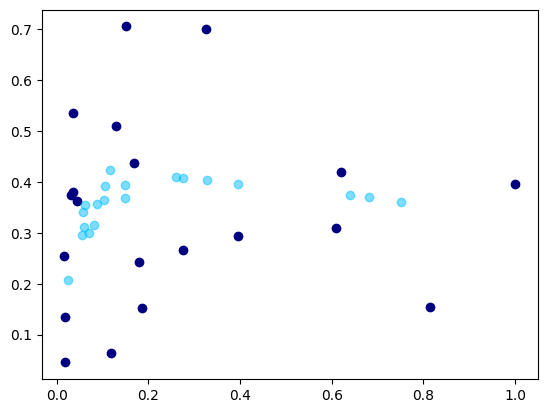

 63%|██████████████████████████████████████████████████▏                             | 628/1000 [01:51<01:02,  5.91it/s]

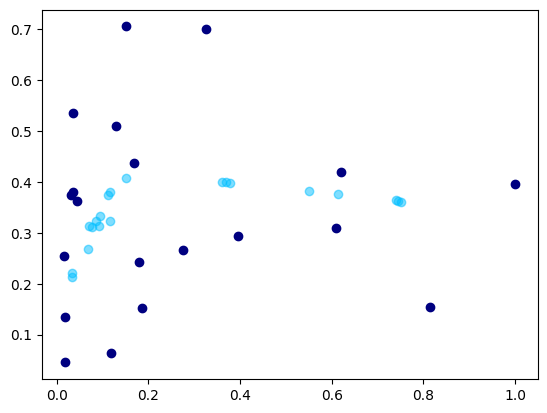

 63%|██████████████████████████████████████████████████▎                             | 629/1000 [01:51<01:02,  5.93it/s]

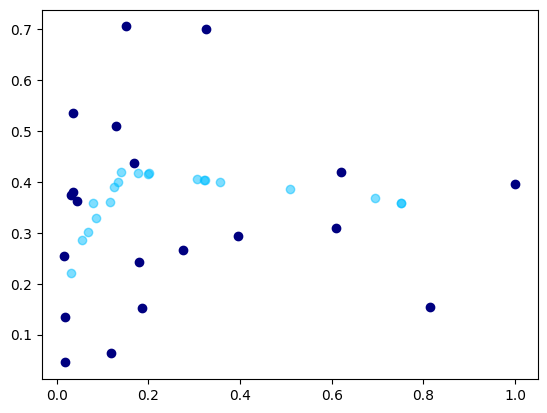

 63%|██████████████████████████████████████████████████▍                             | 630/1000 [01:51<01:02,  5.89it/s]

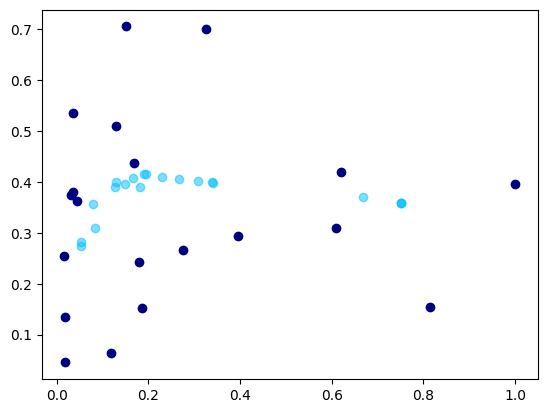

 63%|██████████████████████████████████████████████████▍                             | 631/1000 [01:51<01:02,  5.93it/s]

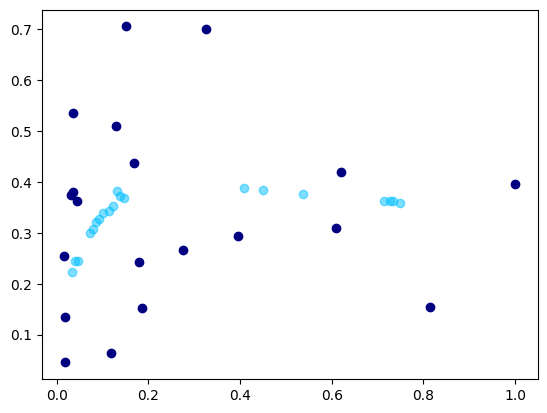

 63%|██████████████████████████████████████████████████▌                             | 632/1000 [01:52<01:02,  5.91it/s]

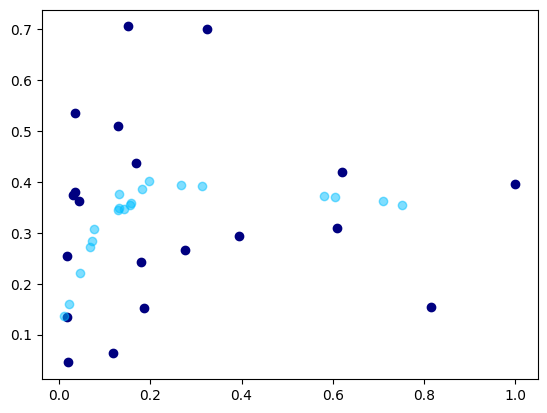

 63%|██████████████████████████████████████████████████▋                             | 633/1000 [01:52<01:03,  5.80it/s]

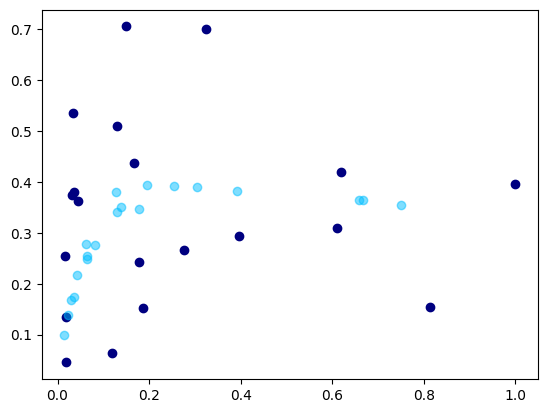

 63%|██████████████████████████████████████████████████▋                             | 634/1000 [01:52<01:02,  5.82it/s]

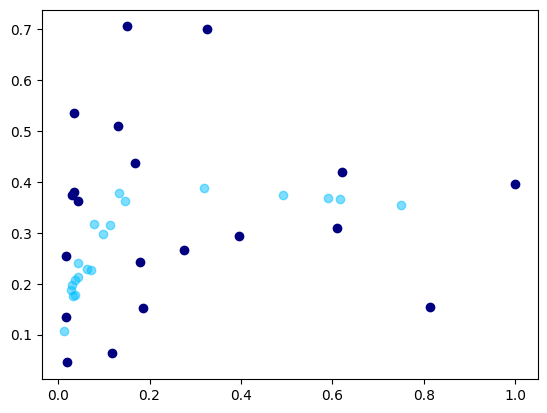

 64%|██████████████████████████████████████████████████▊                             | 635/1000 [01:52<01:02,  5.87it/s]

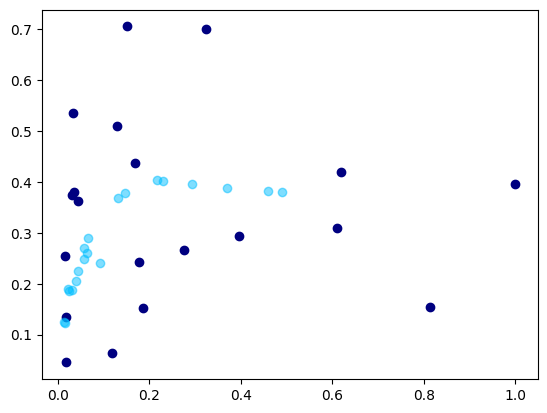

 64%|██████████████████████████████████████████████████▉                             | 636/1000 [01:52<01:01,  5.90it/s]

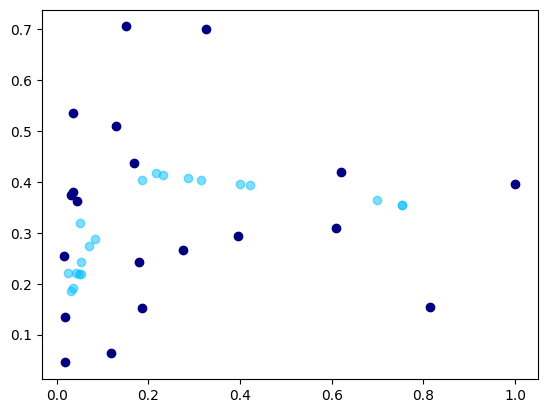

 64%|██████████████████████████████████████████████████▉                             | 637/1000 [01:52<01:00,  5.96it/s]

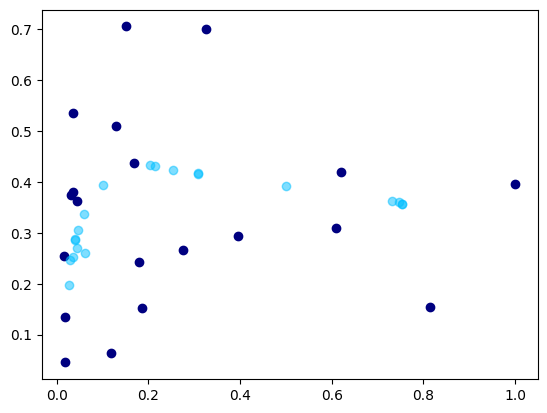

 64%|███████████████████████████████████████████████████                             | 638/1000 [01:53<01:00,  5.98it/s]

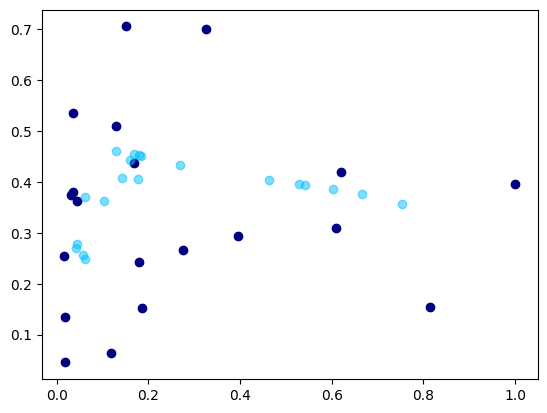

 64%|███████████████████████████████████████████████████                             | 639/1000 [01:53<00:59,  6.03it/s]

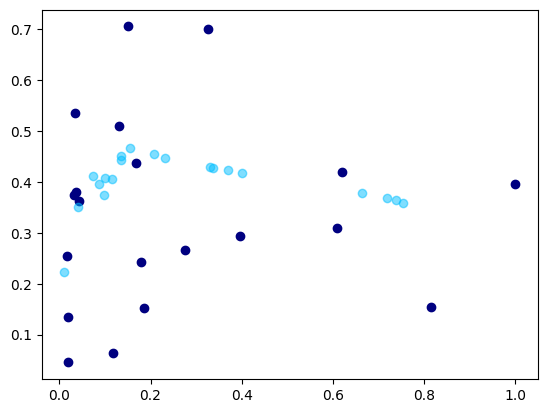

 64%|███████████████████████████████████████████████████▏                            | 640/1000 [01:53<01:00,  5.98it/s]

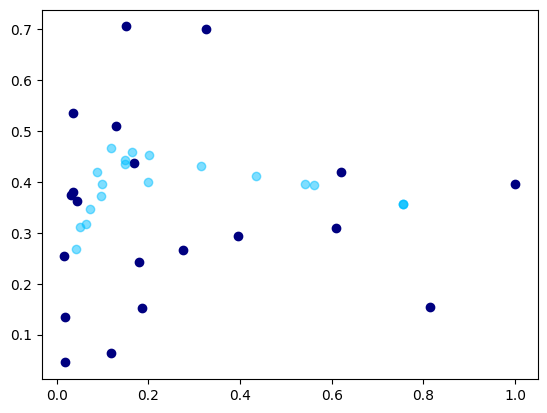

 64%|███████████████████████████████████████████████████▎                            | 641/1000 [01:53<01:01,  5.85it/s]

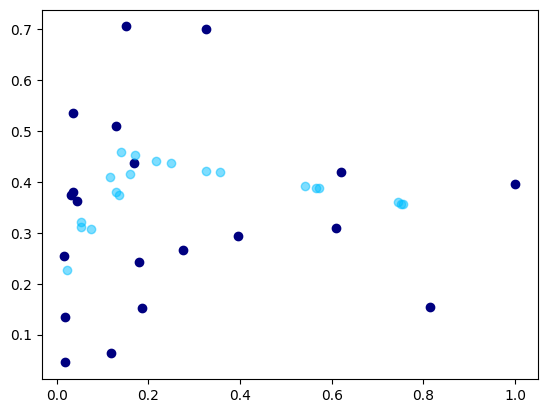

 64%|███████████████████████████████████████████████████▎                            | 642/1000 [01:53<01:03,  5.65it/s]

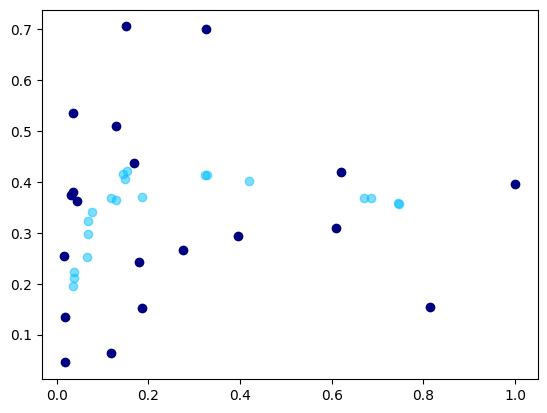

 64%|███████████████████████████████████████████████████▍                            | 643/1000 [01:53<01:03,  5.66it/s]

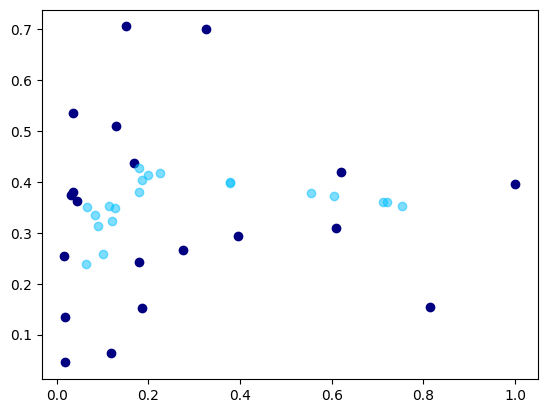

 64%|███████████████████████████████████████████████████▌                            | 644/1000 [01:54<01:01,  5.75it/s]

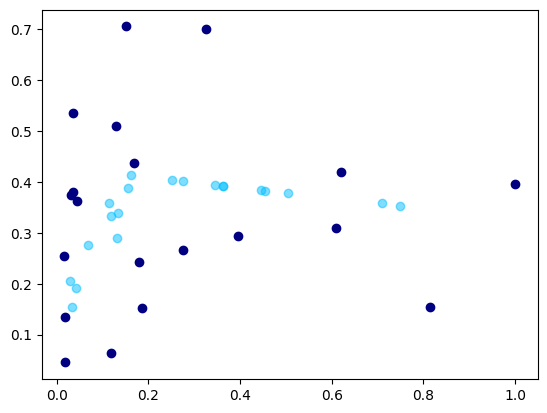

 64%|███████████████████████████████████████████████████▌                            | 645/1000 [01:54<01:01,  5.80it/s]

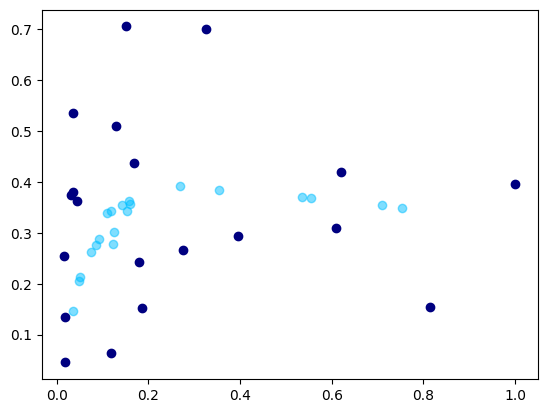

 65%|███████████████████████████████████████████████████▋                            | 646/1000 [01:54<01:01,  5.75it/s]

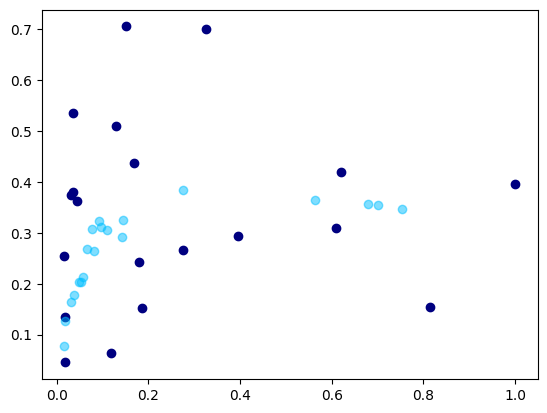

 65%|███████████████████████████████████████████████████▊                            | 647/1000 [01:54<01:01,  5.79it/s]

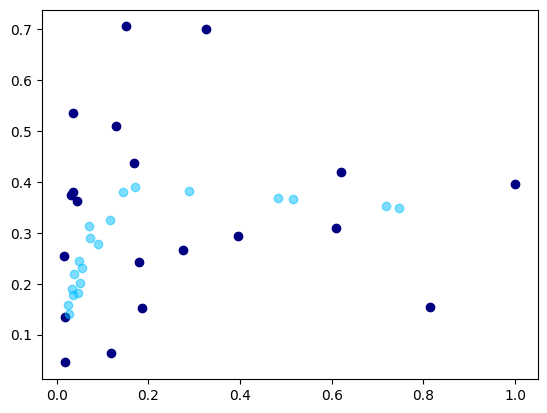

 65%|███████████████████████████████████████████████████▊                            | 648/1000 [01:54<00:59,  5.87it/s]

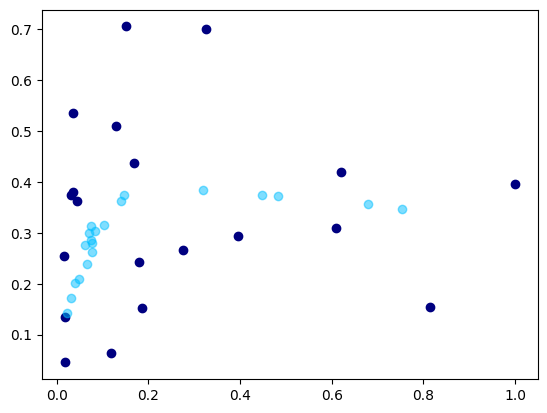

 65%|███████████████████████████████████████████████████▉                            | 649/1000 [01:54<00:59,  5.91it/s]

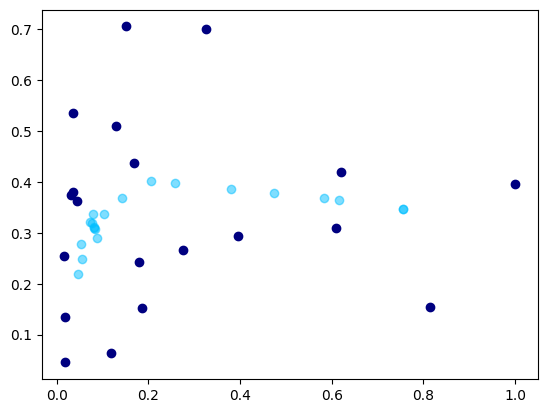

 65%|████████████████████████████████████████████████████                            | 650/1000 [01:55<00:59,  5.92it/s]

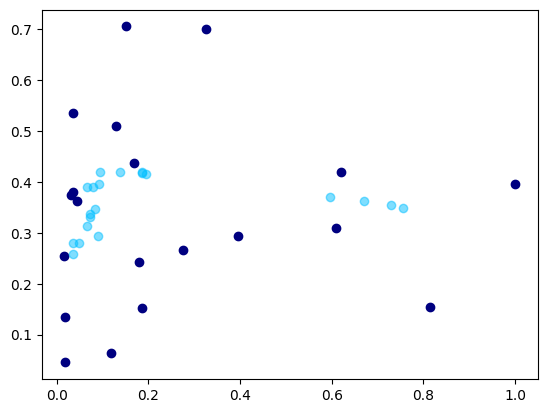

 65%|████████████████████████████████████████████████████                            | 651/1000 [01:55<01:01,  5.64it/s]

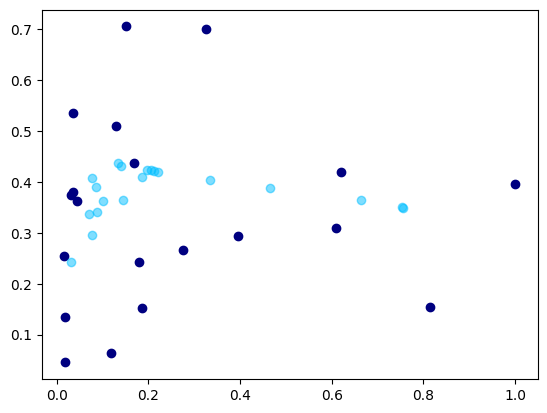

 65%|████████████████████████████████████████████████████▏                           | 652/1000 [01:55<01:00,  5.78it/s]

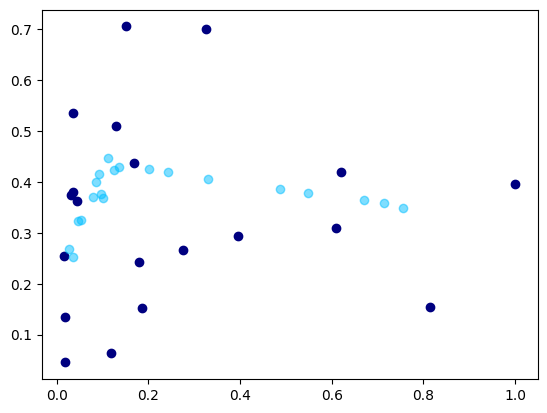

 65%|████████████████████████████████████████████████████▏                           | 653/1000 [01:55<00:59,  5.83it/s]

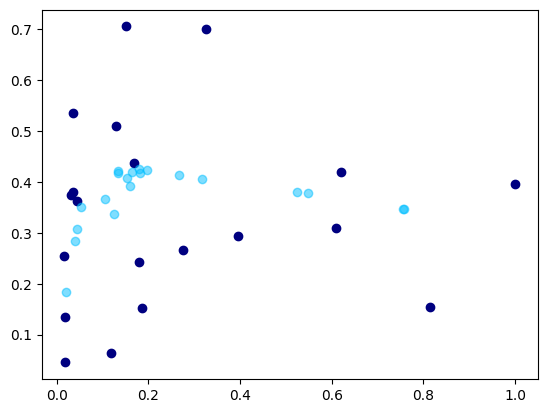

 65%|████████████████████████████████████████████████████▎                           | 654/1000 [01:55<00:58,  5.95it/s]

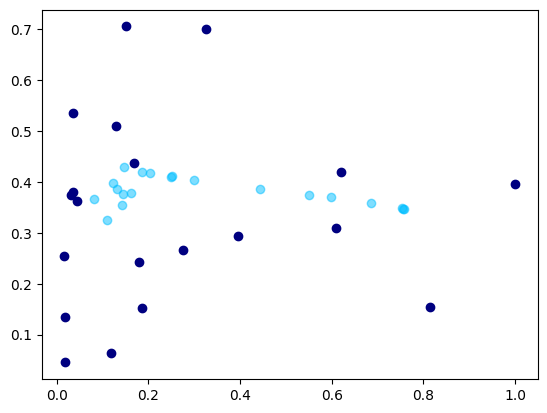

 66%|████████████████████████████████████████████████████▍                           | 655/1000 [01:55<00:57,  5.97it/s]

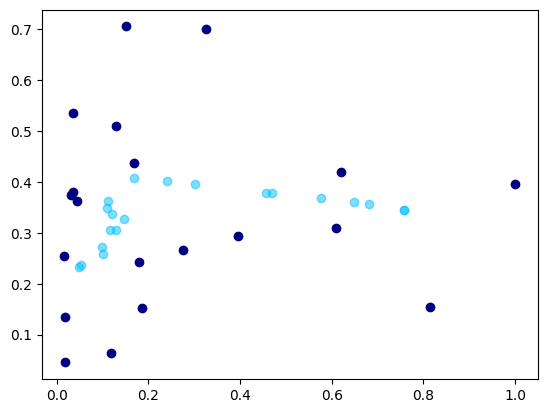

 66%|████████████████████████████████████████████████████▍                           | 656/1000 [01:56<00:57,  5.99it/s]

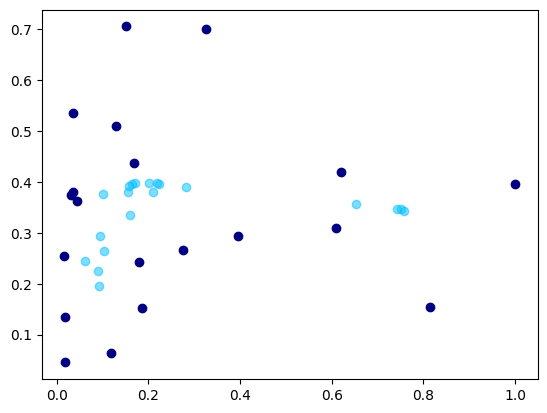

 66%|████████████████████████████████████████████████████▌                           | 657/1000 [01:56<00:57,  5.96it/s]

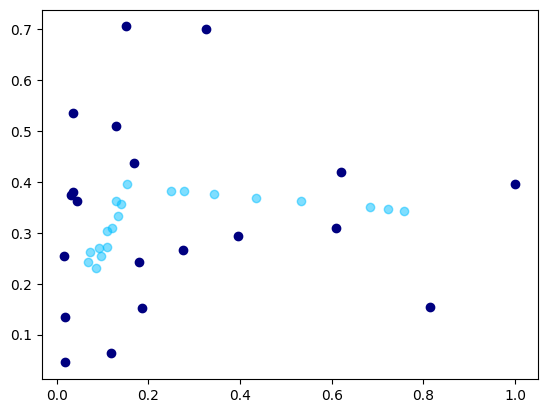

 66%|████████████████████████████████████████████████████▋                           | 658/1000 [01:56<00:58,  5.86it/s]

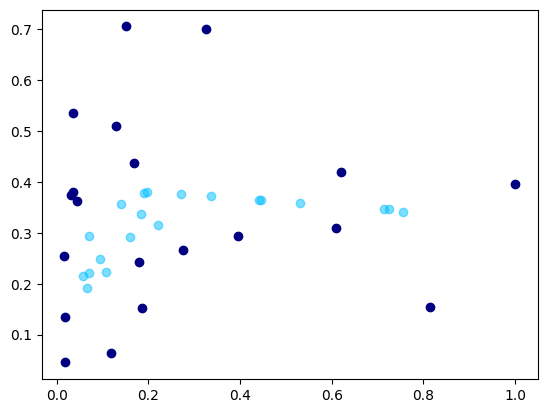

 66%|████████████████████████████████████████████████████▋                           | 659/1000 [01:56<00:57,  5.92it/s]

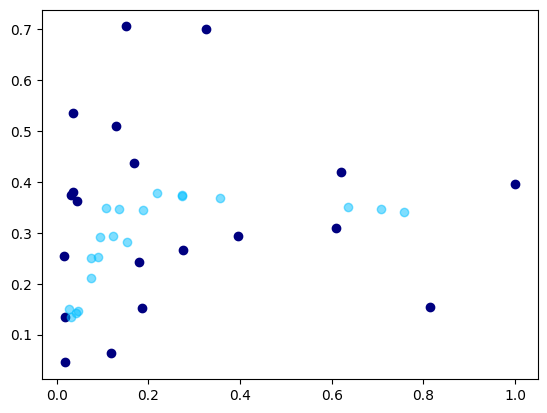

 66%|████████████████████████████████████████████████████▊                           | 660/1000 [01:56<00:56,  6.01it/s]

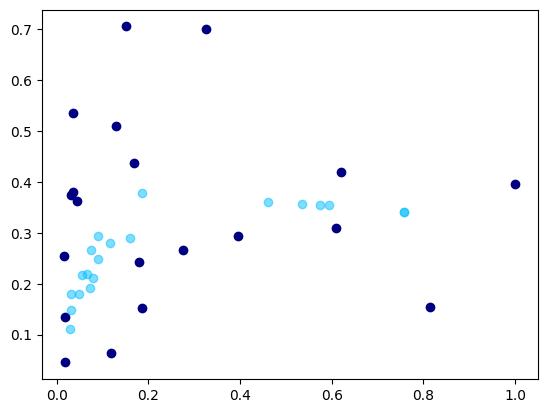

 66%|████████████████████████████████████████████████████▉                           | 661/1000 [01:56<00:56,  6.05it/s]

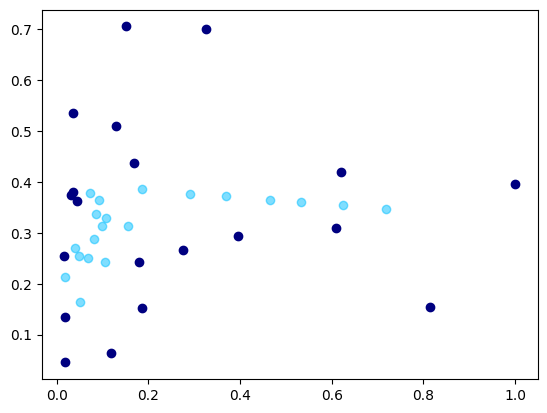

 66%|████████████████████████████████████████████████████▉                           | 662/1000 [01:57<00:56,  6.03it/s]

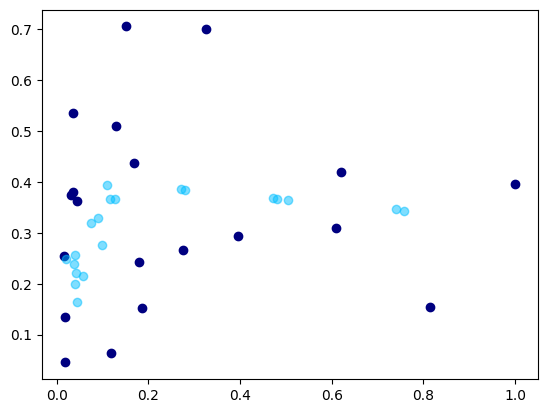

 66%|█████████████████████████████████████████████████████                           | 663/1000 [01:57<00:56,  6.00it/s]

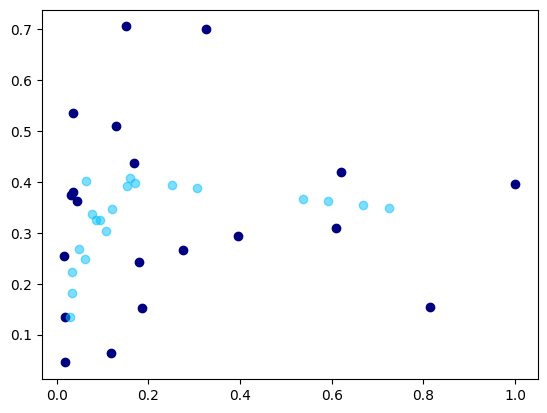

 66%|█████████████████████████████████████████████████████                           | 664/1000 [01:57<00:56,  5.98it/s]

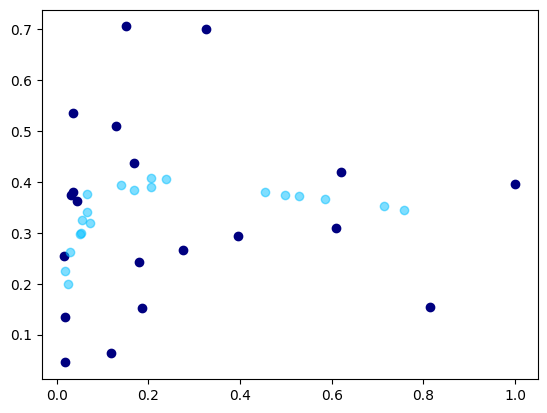

 66%|█████████████████████████████████████████████████████▏                          | 665/1000 [01:57<00:55,  5.99it/s]

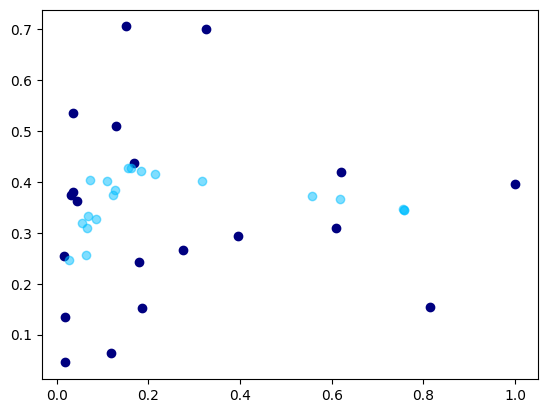

 67%|█████████████████████████████████████████████████████▎                          | 666/1000 [01:57<00:56,  5.95it/s]

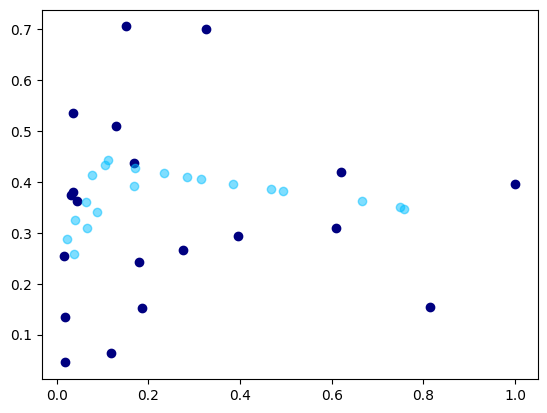

 67%|█████████████████████████████████████████████████████▎                          | 667/1000 [01:57<00:55,  5.96it/s]

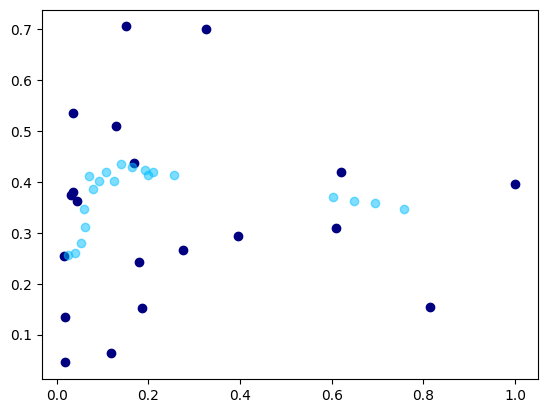

 67%|█████████████████████████████████████████████████████▍                          | 668/1000 [01:58<00:55,  5.95it/s]

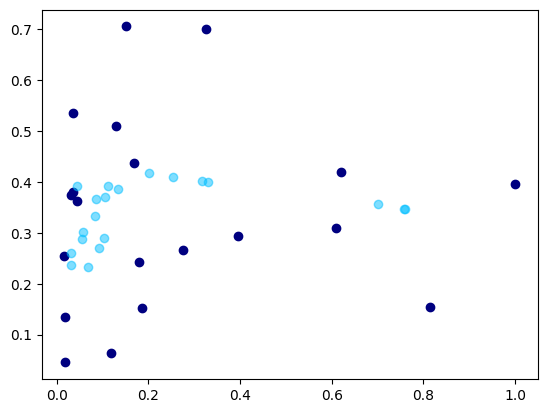

 67%|█████████████████████████████████████████████████████▌                          | 669/1000 [01:58<00:55,  5.92it/s]

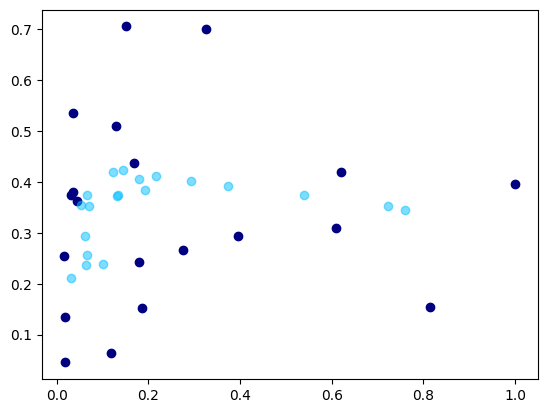

 67%|█████████████████████████████████████████████████████▌                          | 670/1000 [01:58<00:55,  5.94it/s]

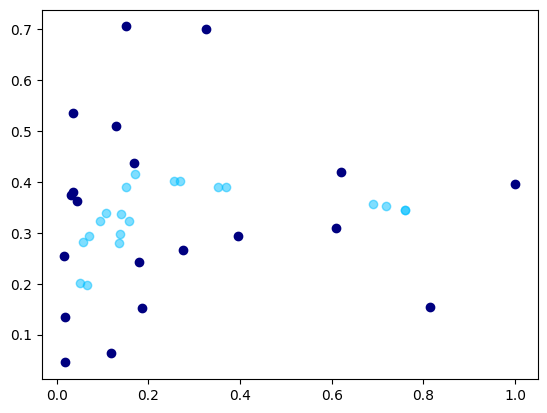

 67%|█████████████████████████████████████████████████████▋                          | 671/1000 [01:58<00:54,  6.01it/s]

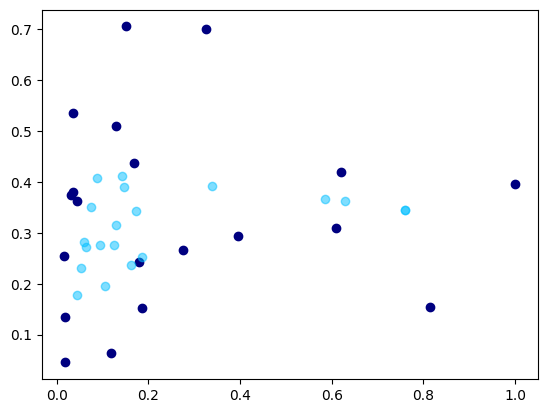

 67%|█████████████████████████████████████████████████████▊                          | 672/1000 [01:58<00:54,  5.98it/s]

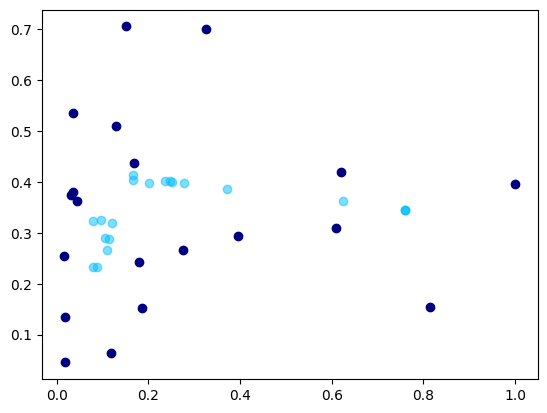

 67%|█████████████████████████████████████████████████████▊                          | 673/1000 [01:58<00:54,  5.98it/s]

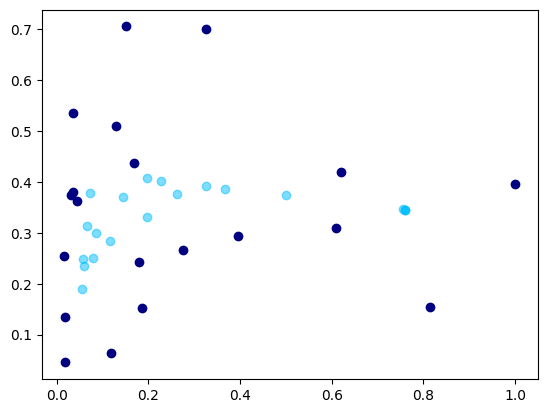

 67%|█████████████████████████████████████████████████████▉                          | 674/1000 [01:59<00:54,  5.94it/s]

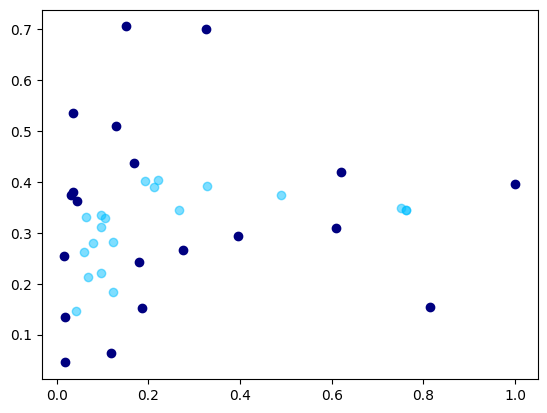

 68%|██████████████████████████████████████████████████████                          | 675/1000 [01:59<00:55,  5.91it/s]

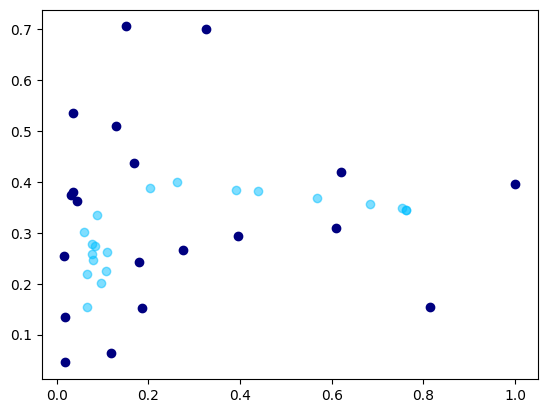

 68%|██████████████████████████████████████████████████████                          | 676/1000 [01:59<00:54,  5.93it/s]

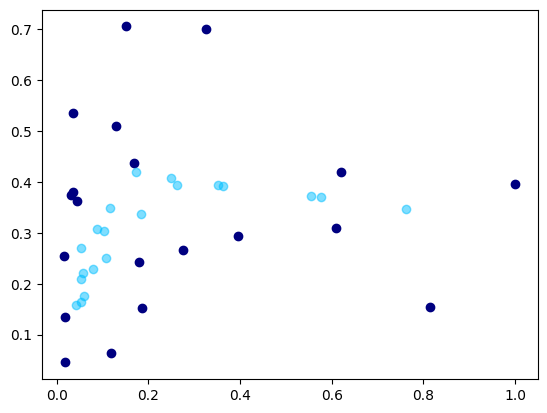

 68%|██████████████████████████████████████████████████████▏                         | 677/1000 [01:59<00:54,  5.96it/s]

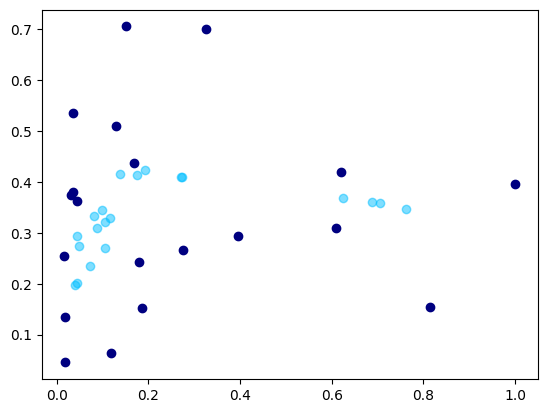

 68%|██████████████████████████████████████████████████████▏                         | 678/1000 [01:59<00:54,  5.87it/s]

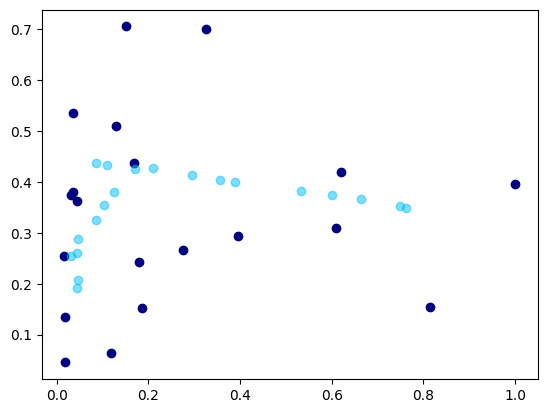

 68%|██████████████████████████████████████████████████████▎                         | 679/1000 [01:59<00:53,  5.95it/s]

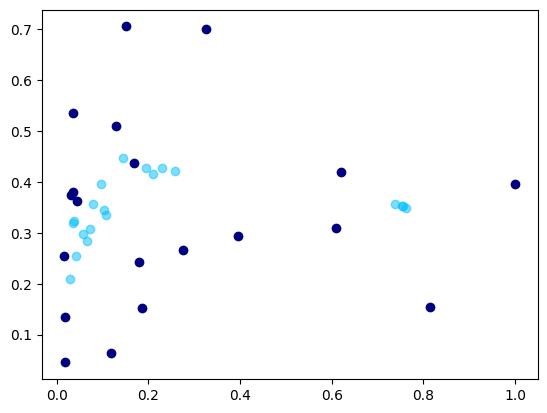

 68%|██████████████████████████████████████████████████████▍                         | 680/1000 [02:00<00:55,  5.78it/s]

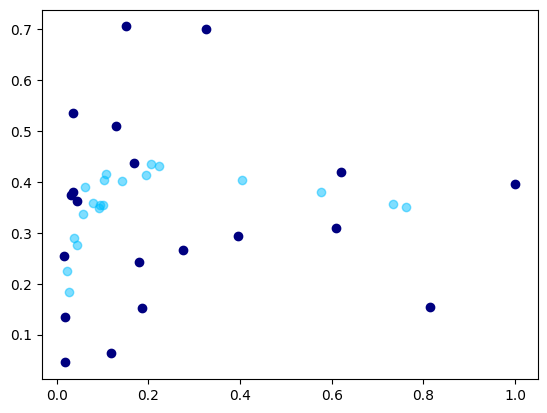

 68%|██████████████████████████████████████████████████████▍                         | 681/1000 [02:00<00:55,  5.75it/s]

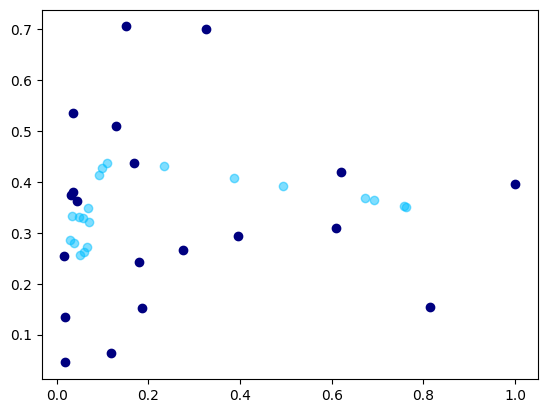

 68%|██████████████████████████████████████████████████████▌                         | 682/1000 [02:00<00:55,  5.75it/s]

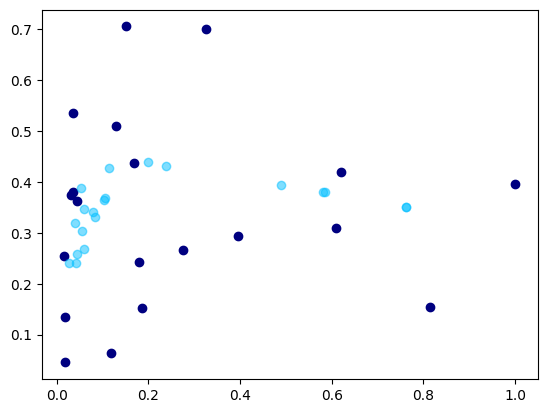

 68%|██████████████████████████████████████████████████████▋                         | 683/1000 [02:00<00:54,  5.83it/s]

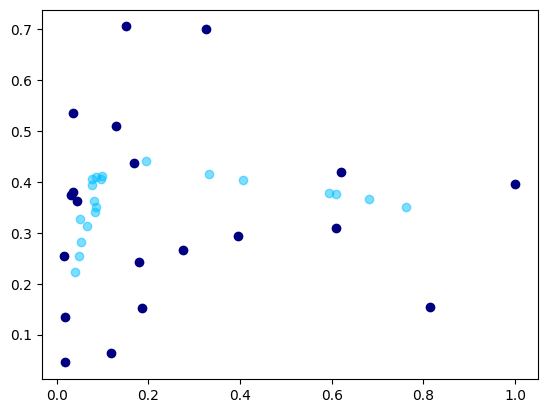

 68%|██████████████████████████████████████████████████████▋                         | 684/1000 [02:00<00:53,  5.88it/s]

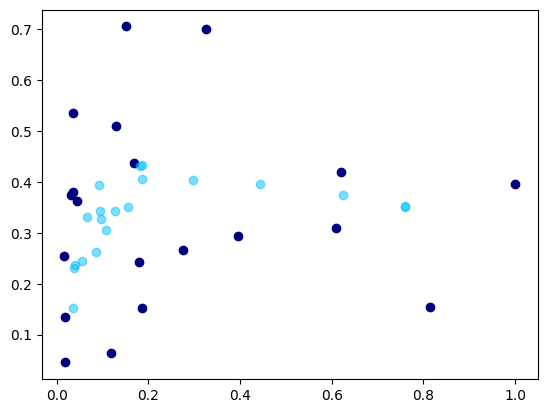

 68%|██████████████████████████████████████████████████████▊                         | 685/1000 [02:01<00:53,  5.90it/s]

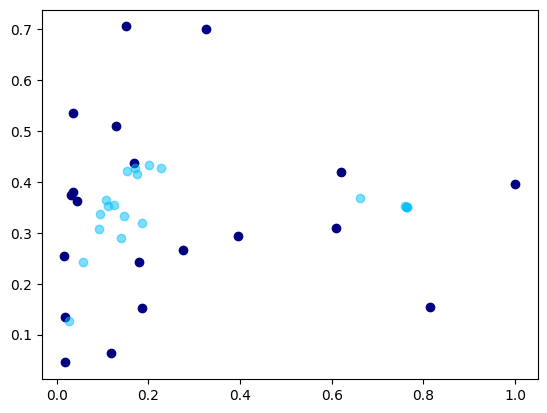

 69%|██████████████████████████████████████████████████████▉                         | 686/1000 [02:01<00:53,  5.84it/s]

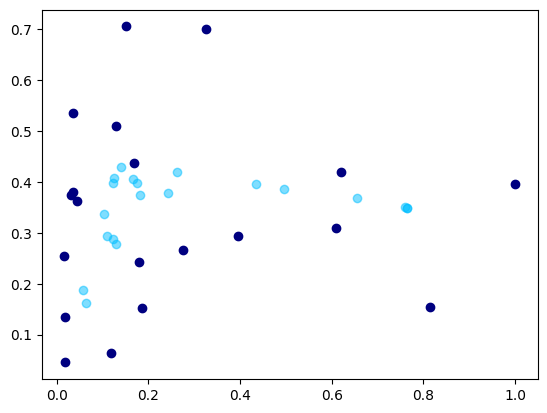

 69%|██████████████████████████████████████████████████████▉                         | 687/1000 [02:01<00:52,  5.93it/s]

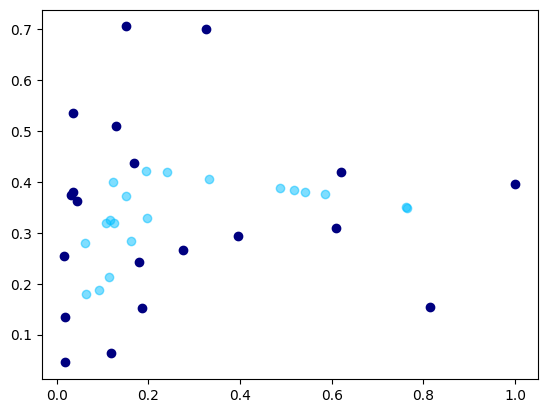

 69%|███████████████████████████████████████████████████████                         | 688/1000 [02:01<00:52,  5.98it/s]

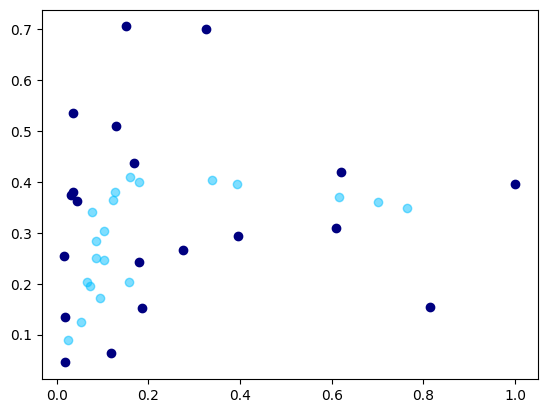

 69%|███████████████████████████████████████████████████████                         | 689/1000 [02:01<00:52,  5.96it/s]

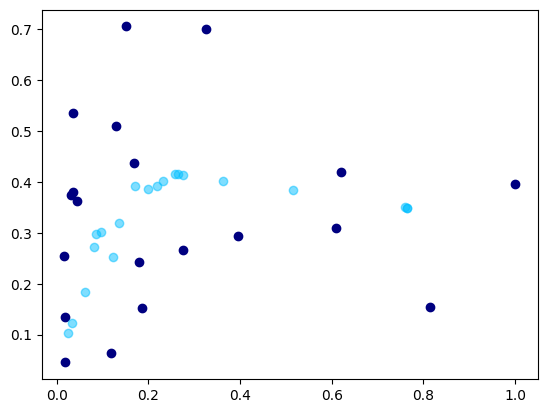

 69%|███████████████████████████████████████████████████████▏                        | 690/1000 [02:01<00:52,  5.94it/s]

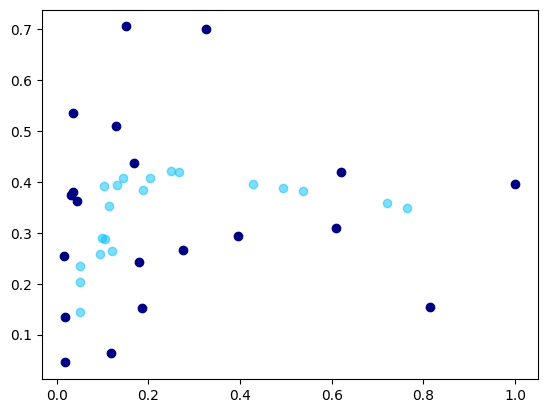

 69%|███████████████████████████████████████████████████████▎                        | 691/1000 [02:02<00:51,  5.95it/s]

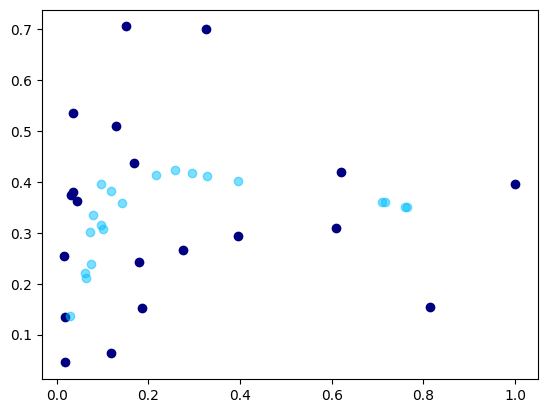

 69%|███████████████████████████████████████████████████████▎                        | 692/1000 [02:02<00:52,  5.84it/s]

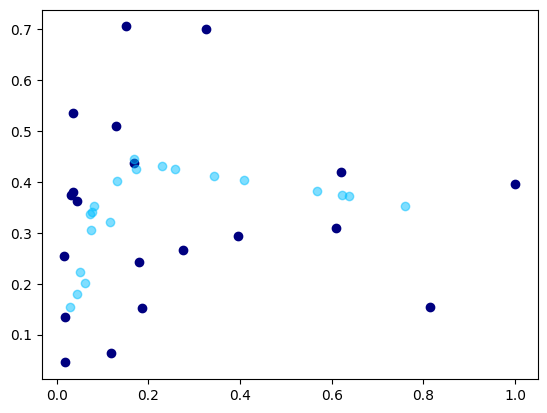

 69%|███████████████████████████████████████████████████████▍                        | 693/1000 [02:02<00:51,  5.91it/s]

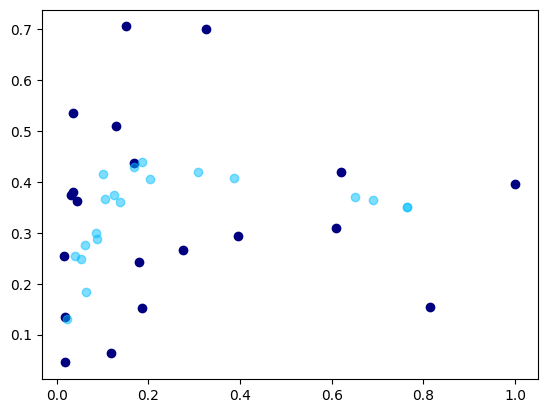

 69%|███████████████████████████████████████████████████████▌                        | 694/1000 [02:02<00:50,  6.01it/s]

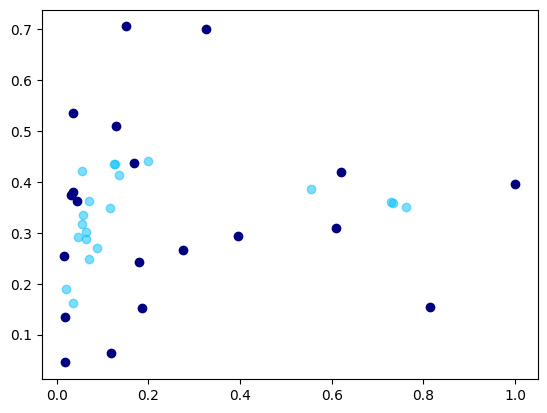

 70%|███████████████████████████████████████████████████████▌                        | 695/1000 [02:02<00:50,  5.98it/s]

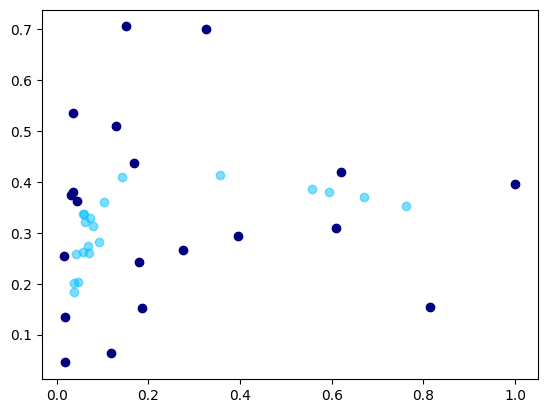

 70%|███████████████████████████████████████████████████████▋                        | 696/1000 [02:02<00:50,  5.99it/s]

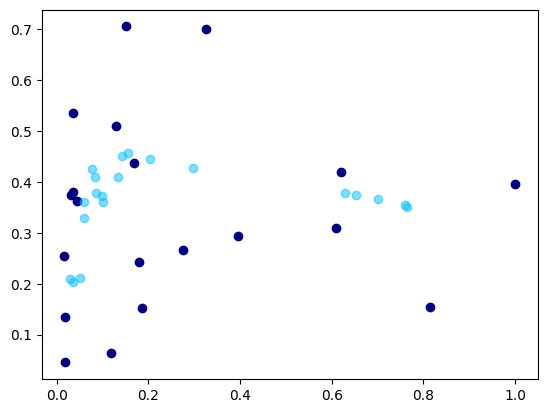

 70%|███████████████████████████████████████████████████████▊                        | 697/1000 [02:03<00:50,  5.96it/s]

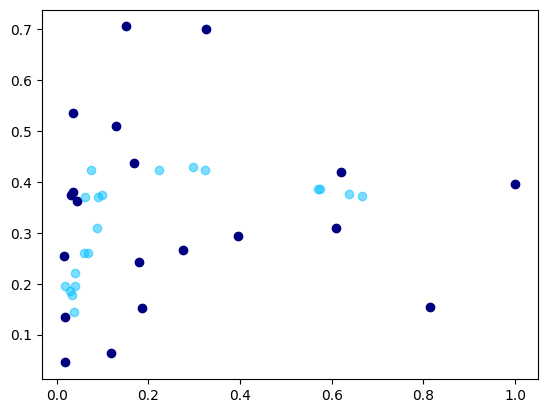

 70%|███████████████████████████████████████████████████████▊                        | 698/1000 [02:03<00:50,  5.96it/s]

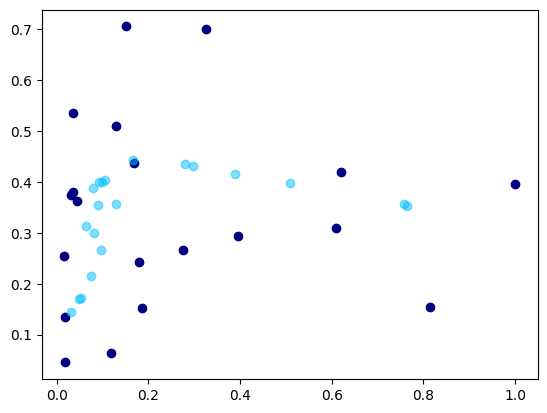

 70%|███████████████████████████████████████████████████████▉                        | 699/1000 [02:03<00:50,  5.95it/s]

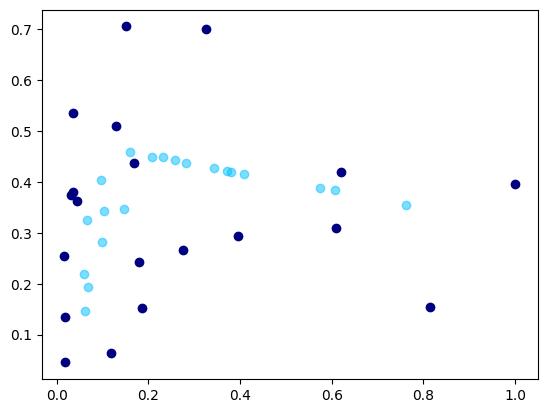

 70%|████████████████████████████████████████████████████████                        | 700/1000 [02:03<00:51,  5.79it/s]

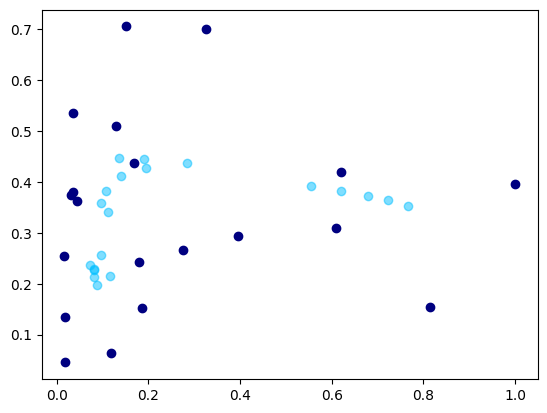

 70%|████████████████████████████████████████████████████████                        | 701/1000 [02:03<00:50,  5.86it/s]

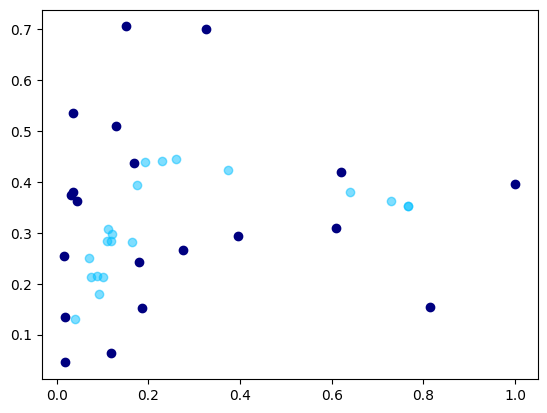

 70%|████████████████████████████████████████████████████████▏                       | 702/1000 [02:03<00:50,  5.95it/s]

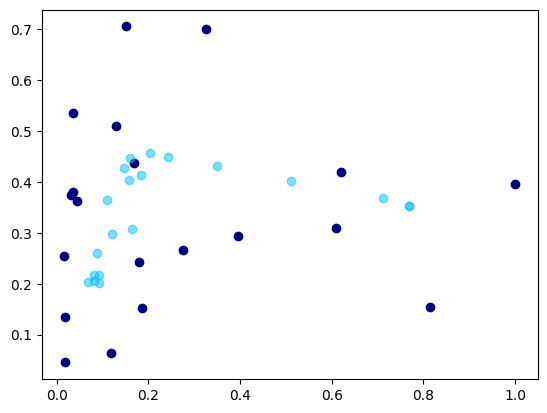

 70%|████████████████████████████████████████████████████████▏                       | 703/1000 [02:04<00:50,  5.86it/s]

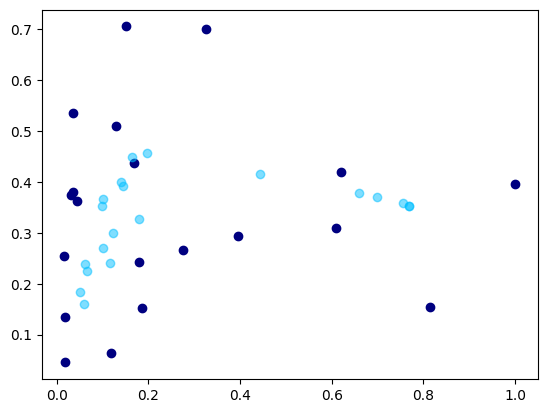

 70%|████████████████████████████████████████████████████████▎                       | 704/1000 [02:04<00:53,  5.57it/s]

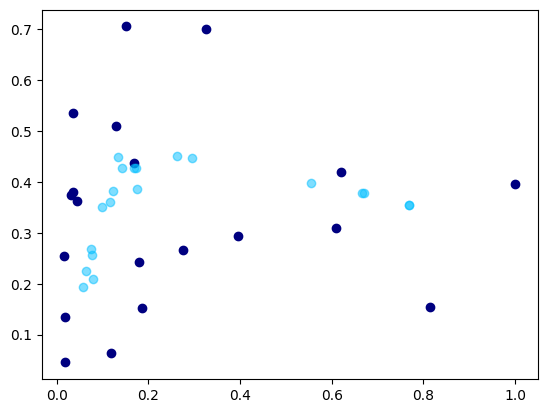

 70%|████████████████████████████████████████████████████████▍                       | 705/1000 [02:04<00:53,  5.55it/s]

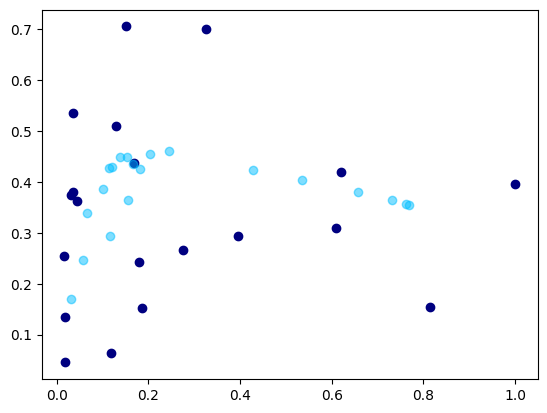

 71%|████████████████████████████████████████████████████████▍                       | 706/1000 [02:04<00:51,  5.72it/s]

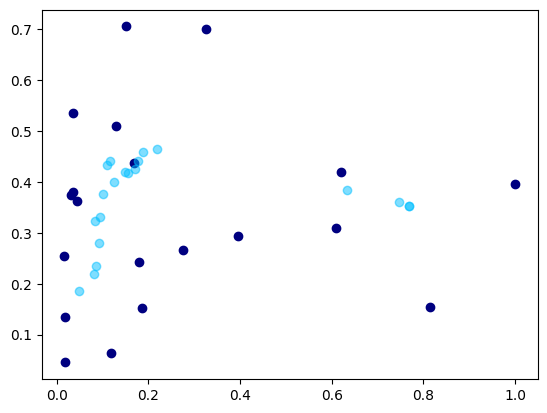

 71%|████████████████████████████████████████████████████████▌                       | 707/1000 [02:04<00:50,  5.82it/s]

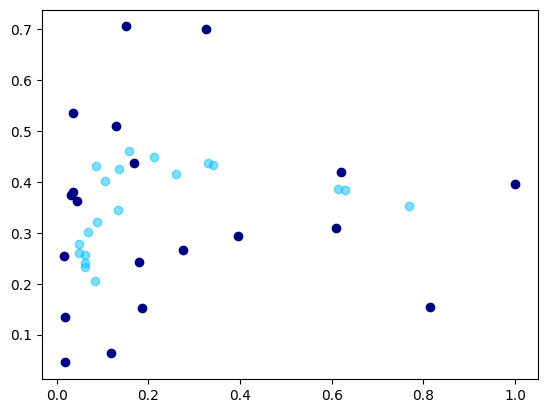

 71%|████████████████████████████████████████████████████████▋                       | 708/1000 [02:04<00:49,  5.90it/s]

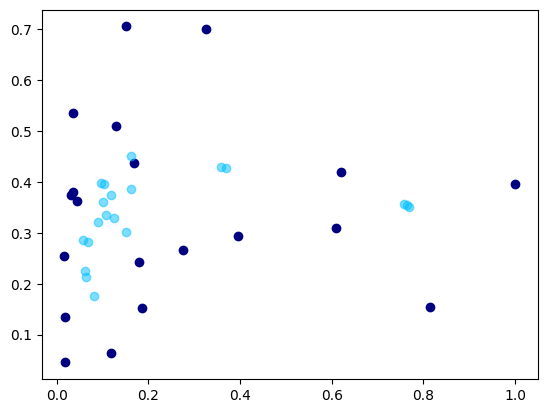

 71%|████████████████████████████████████████████████████████▋                       | 709/1000 [02:05<00:49,  5.94it/s]

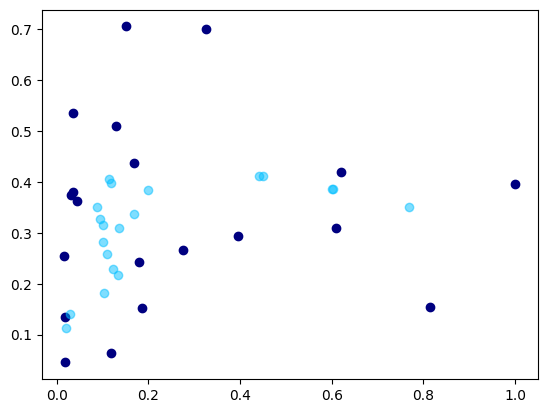

 71%|████████████████████████████████████████████████████████▊                       | 710/1000 [02:05<00:48,  5.94it/s]

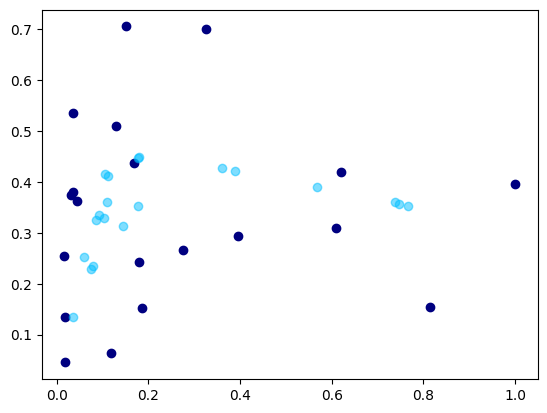

 71%|████████████████████████████████████████████████████████▉                       | 711/1000 [02:05<00:48,  5.98it/s]

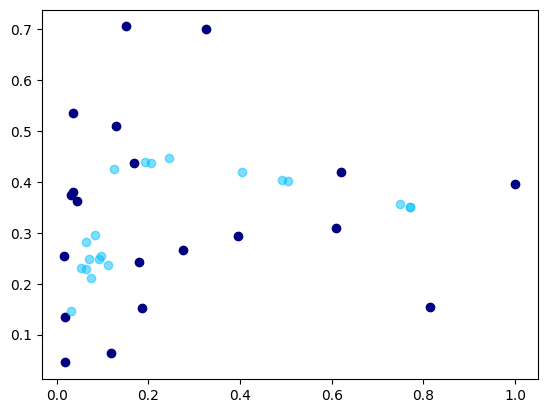

 71%|████████████████████████████████████████████████████████▉                       | 712/1000 [02:05<00:48,  5.99it/s]

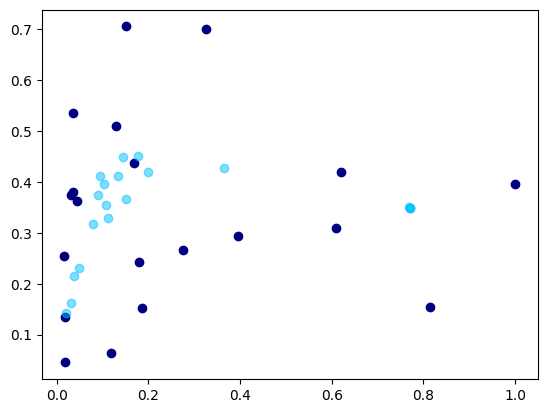

 71%|█████████████████████████████████████████████████████████                       | 713/1000 [02:05<00:47,  5.98it/s]

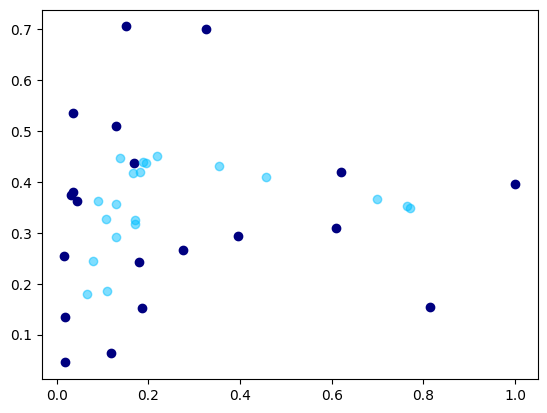

 71%|█████████████████████████████████████████████████████████                       | 714/1000 [02:05<00:47,  6.01it/s]

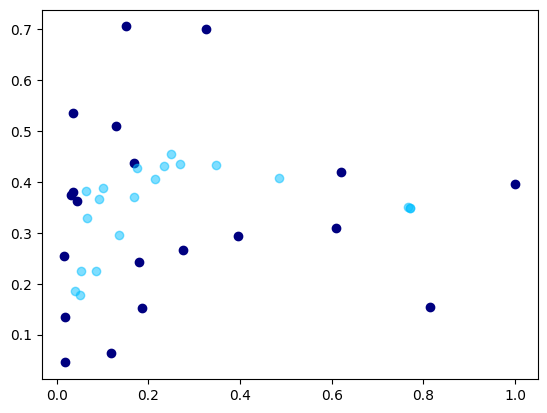

 72%|█████████████████████████████████████████████████████████▏                      | 715/1000 [02:06<00:47,  5.99it/s]

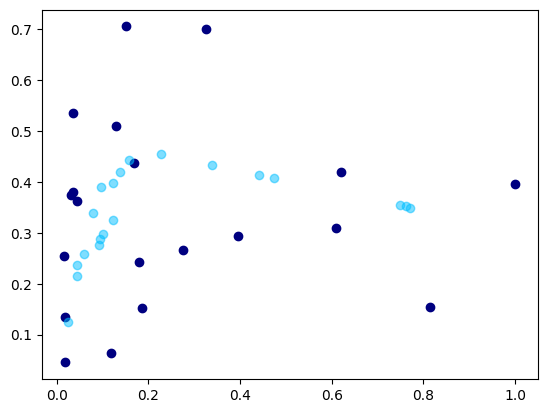

 72%|█████████████████████████████████████████████████████████▎                      | 716/1000 [02:06<00:49,  5.68it/s]

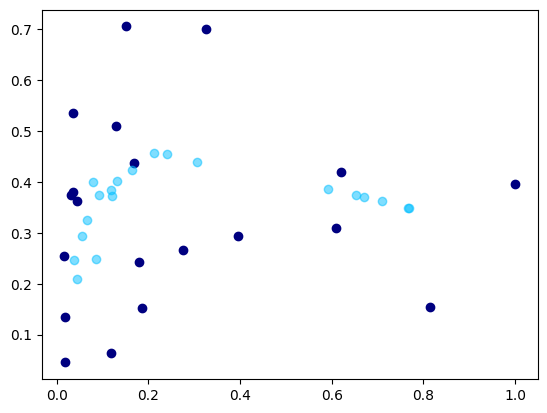

 72%|█████████████████████████████████████████████████████████▎                      | 717/1000 [02:06<00:48,  5.81it/s]

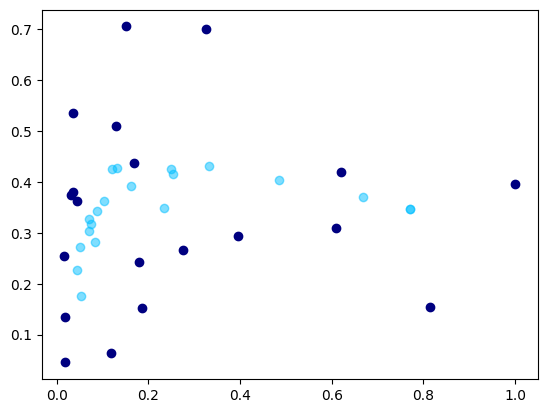

 72%|█████████████████████████████████████████████████████████▍                      | 718/1000 [02:06<00:47,  5.91it/s]

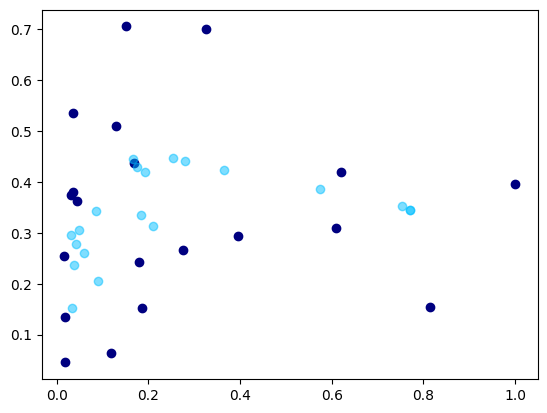

 72%|█████████████████████████████████████████████████████████▌                      | 719/1000 [02:06<00:47,  5.96it/s]

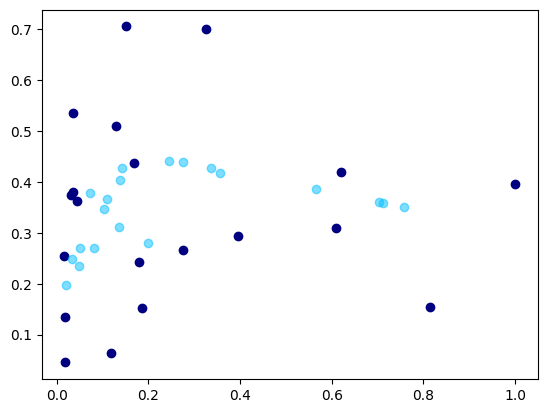

 72%|█████████████████████████████████████████████████████████▌                      | 720/1000 [02:06<00:46,  6.03it/s]

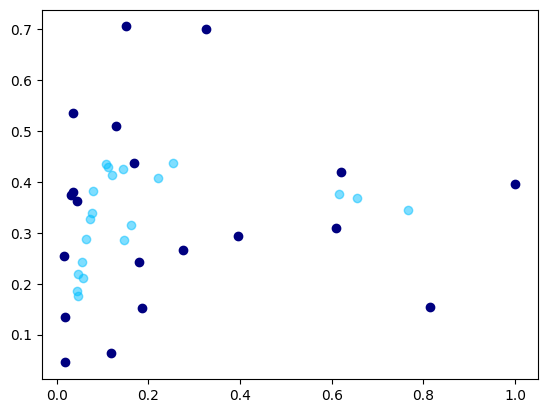

 72%|█████████████████████████████████████████████████████████▋                      | 721/1000 [02:07<00:46,  6.01it/s]

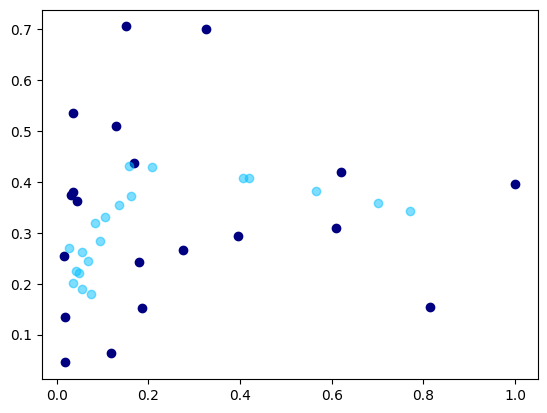

 72%|█████████████████████████████████████████████████████████▊                      | 722/1000 [02:07<00:46,  5.98it/s]

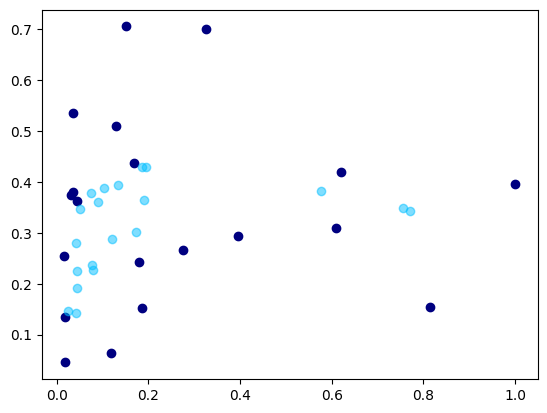

 72%|█████████████████████████████████████████████████████████▊                      | 723/1000 [02:07<00:46,  5.98it/s]

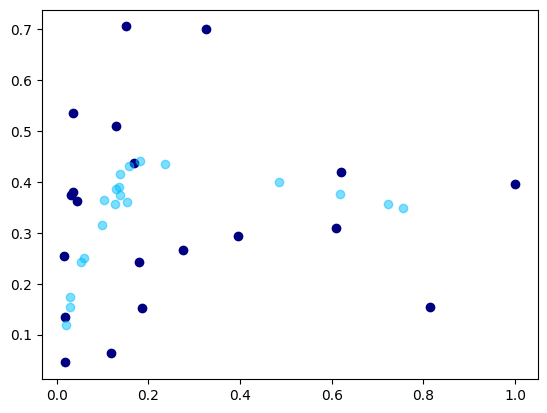

 72%|█████████████████████████████████████████████████████████▉                      | 724/1000 [02:07<00:47,  5.80it/s]

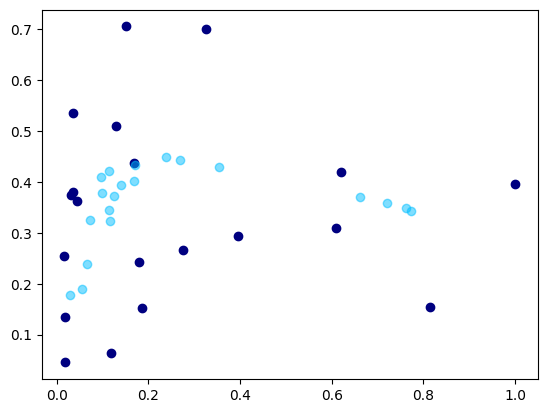

 72%|██████████████████████████████████████████████████████████                      | 725/1000 [02:07<00:46,  5.91it/s]

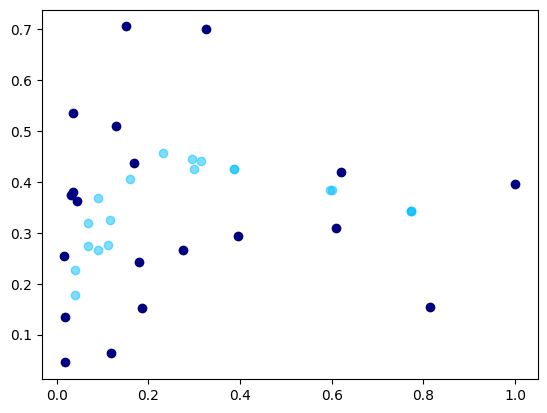

 73%|██████████████████████████████████████████████████████████                      | 726/1000 [02:07<00:47,  5.77it/s]

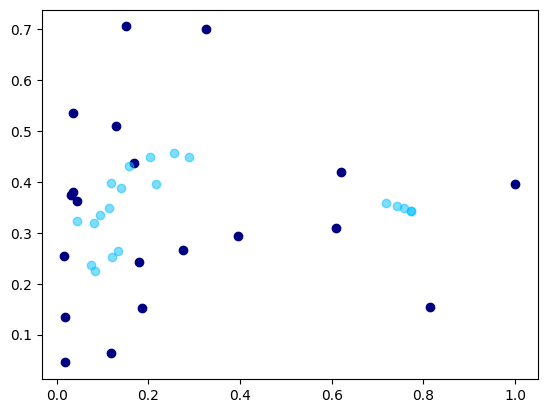

 73%|██████████████████████████████████████████████████████████▏                     | 727/1000 [02:08<00:46,  5.87it/s]

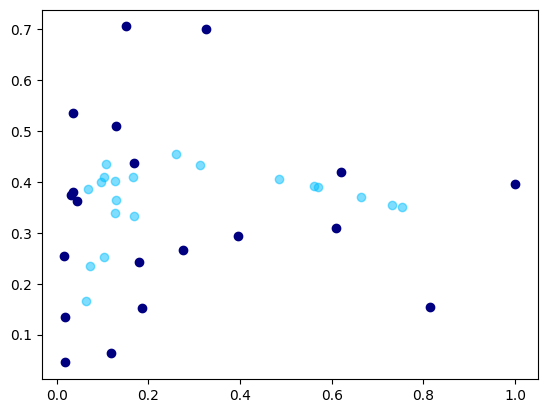

 73%|██████████████████████████████████████████████████████████▏                     | 728/1000 [02:08<01:22,  3.28it/s]

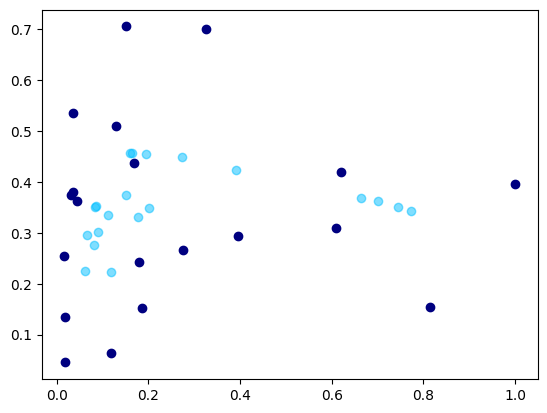

 73%|██████████████████████████████████████████████████████████▎                     | 729/1000 [02:08<01:13,  3.70it/s]

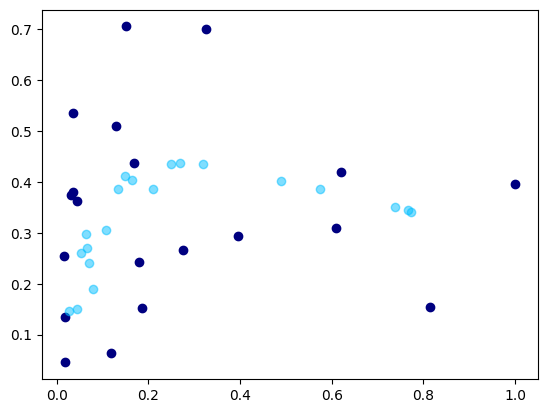

 73%|██████████████████████████████████████████████████████████▍                     | 730/1000 [02:09<01:04,  4.19it/s]

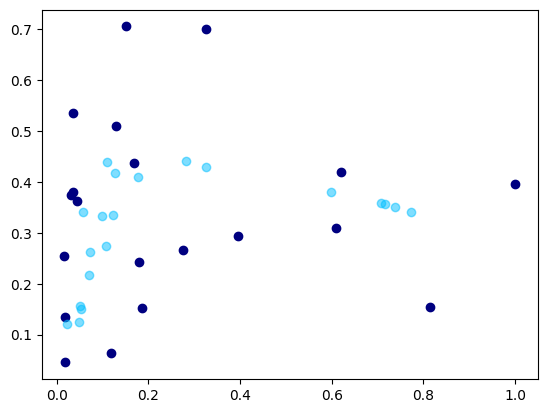

 73%|██████████████████████████████████████████████████████████▍                     | 731/1000 [02:09<00:59,  4.53it/s]

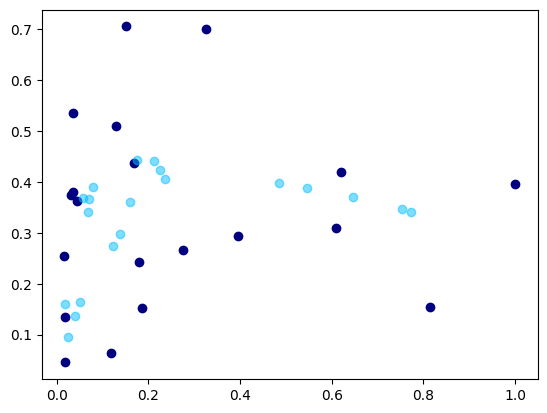

 73%|██████████████████████████████████████████████████████████▌                     | 732/1000 [02:09<00:55,  4.80it/s]

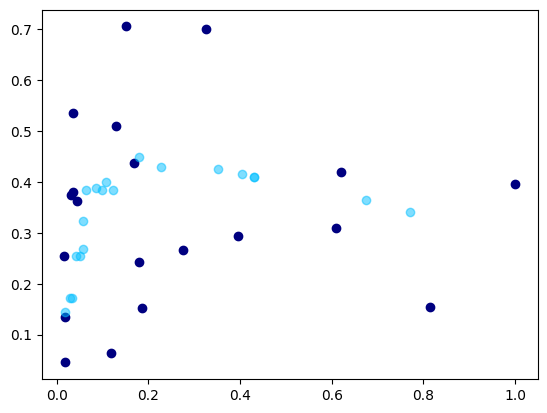

 73%|██████████████████████████████████████████████████████████▋                     | 733/1000 [02:09<00:52,  5.13it/s]

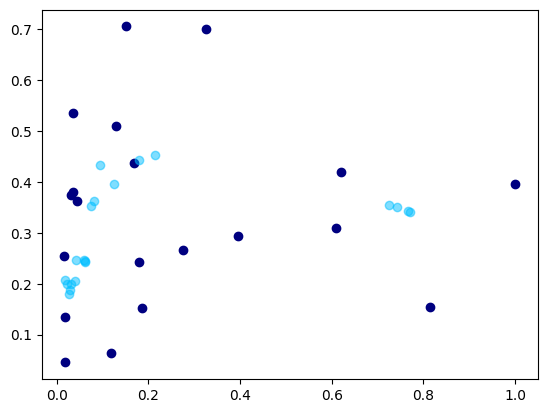

 73%|██████████████████████████████████████████████████████████▋                     | 734/1000 [02:09<00:50,  5.32it/s]

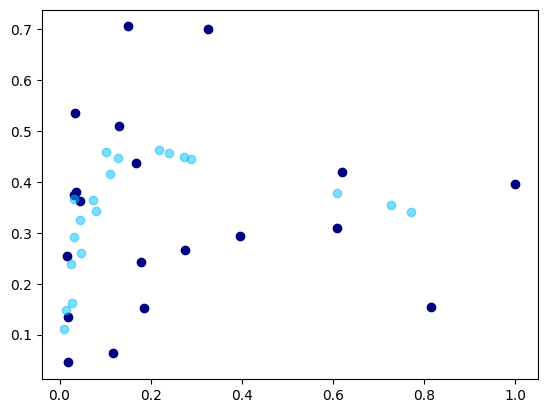

 74%|██████████████████████████████████████████████████████████▊                     | 735/1000 [02:09<00:48,  5.47it/s]

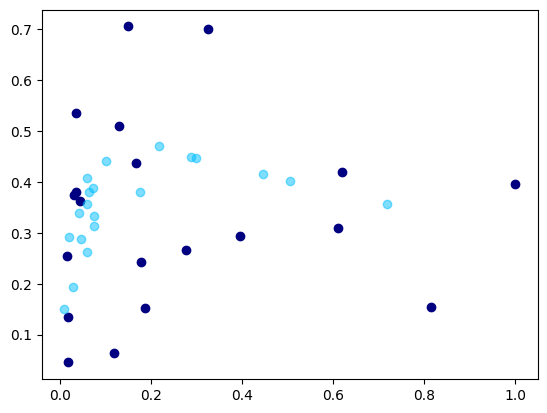

 74%|██████████████████████████████████████████████████████████▉                     | 736/1000 [02:10<00:46,  5.64it/s]

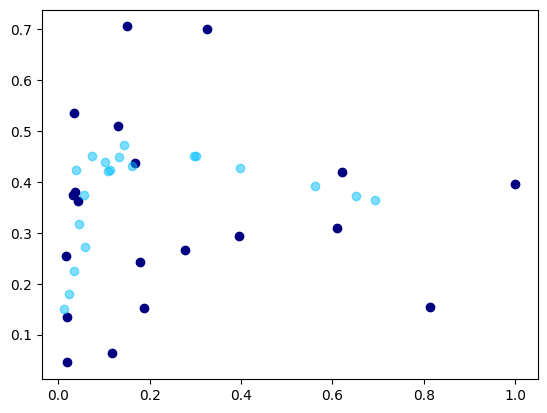

 74%|██████████████████████████████████████████████████████████▉                     | 737/1000 [02:10<00:46,  5.70it/s]

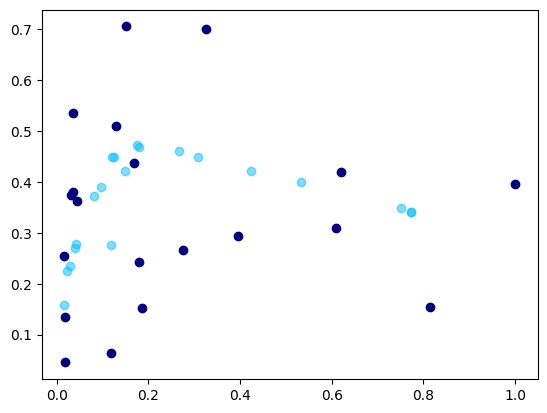

 74%|███████████████████████████████████████████████████████████                     | 738/1000 [02:10<00:45,  5.76it/s]

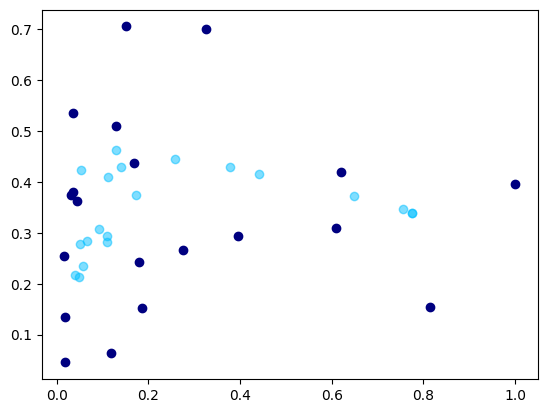

 74%|███████████████████████████████████████████████████████████                     | 739/1000 [02:10<00:46,  5.57it/s]

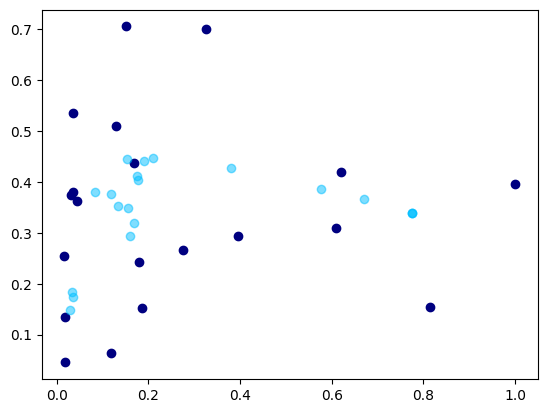

 74%|███████████████████████████████████████████████████████████▏                    | 740/1000 [02:10<00:46,  5.58it/s]

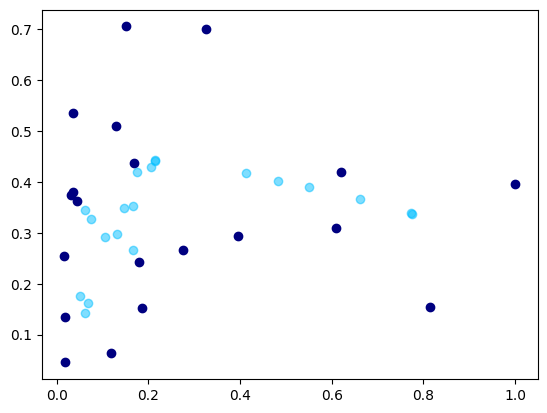

 74%|███████████████████████████████████████████████████████████▎                    | 741/1000 [02:11<00:45,  5.67it/s]

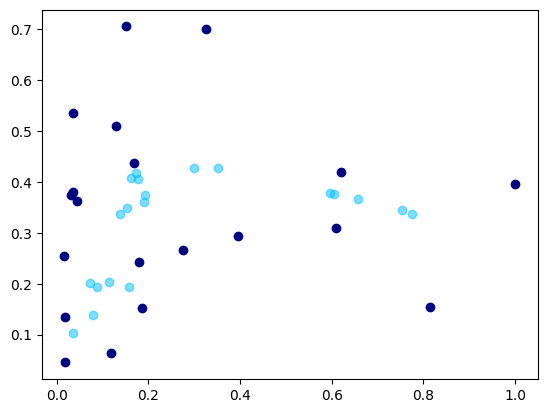

 74%|███████████████████████████████████████████████████████████▎                    | 742/1000 [02:11<00:45,  5.63it/s]

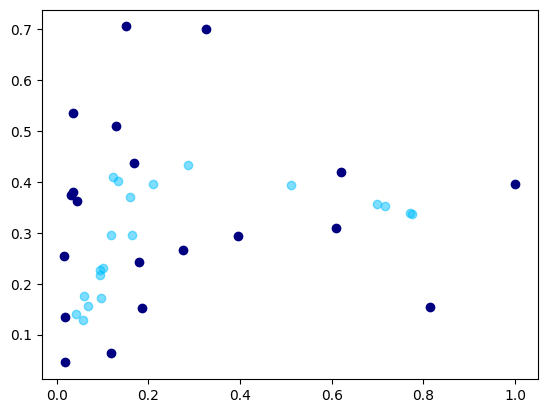

 74%|███████████████████████████████████████████████████████████▍                    | 743/1000 [02:11<00:45,  5.68it/s]

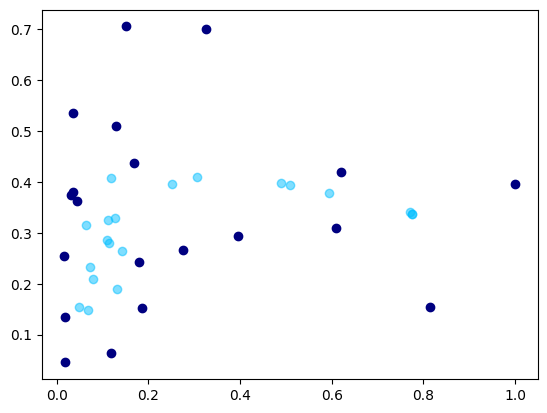

 74%|███████████████████████████████████████████████████████████▌                    | 744/1000 [02:11<00:44,  5.77it/s]

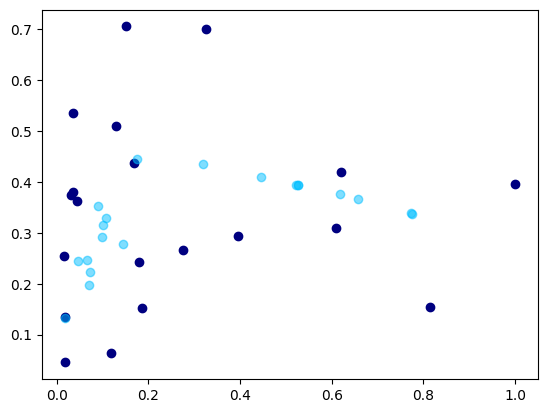

 74%|███████████████████████████████████████████████████████████▌                    | 745/1000 [02:11<00:44,  5.78it/s]

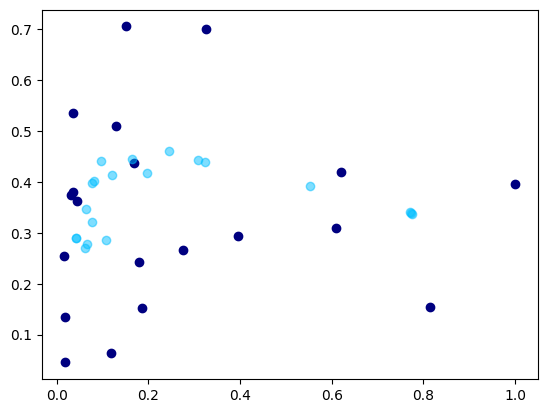

 75%|███████████████████████████████████████████████████████████▋                    | 746/1000 [02:11<00:43,  5.84it/s]

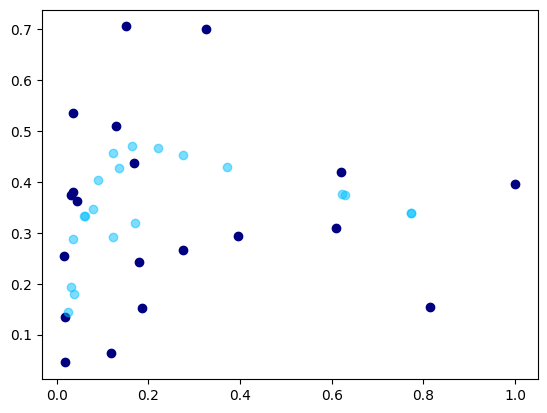

 75%|███████████████████████████████████████████████████████████▊                    | 747/1000 [02:12<00:43,  5.87it/s]

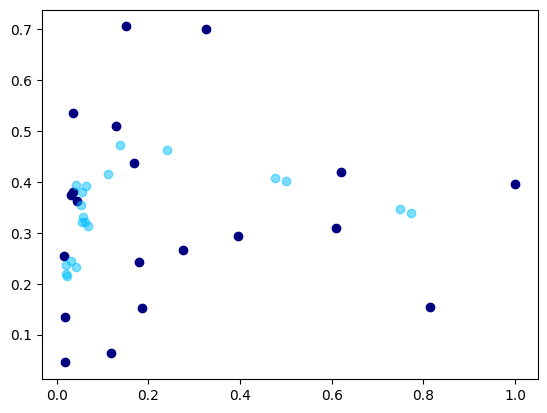

 75%|███████████████████████████████████████████████████████████▊                    | 748/1000 [02:12<00:42,  5.86it/s]

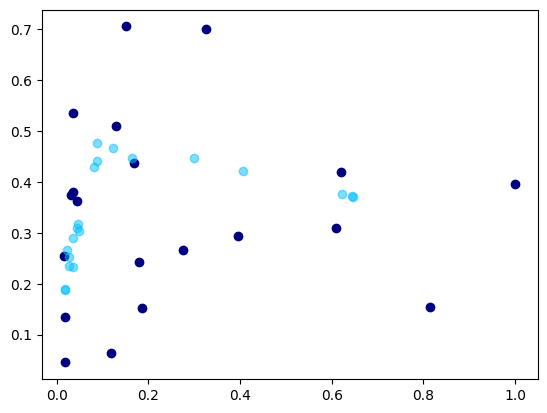

 75%|███████████████████████████████████████████████████████████▉                    | 749/1000 [02:12<00:42,  5.89it/s]

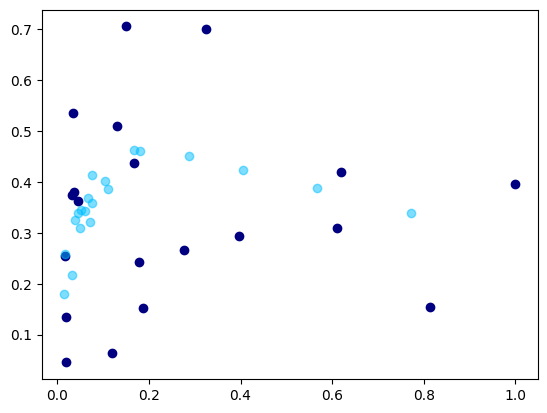

 75%|████████████████████████████████████████████████████████████                    | 750/1000 [02:12<00:42,  5.86it/s]

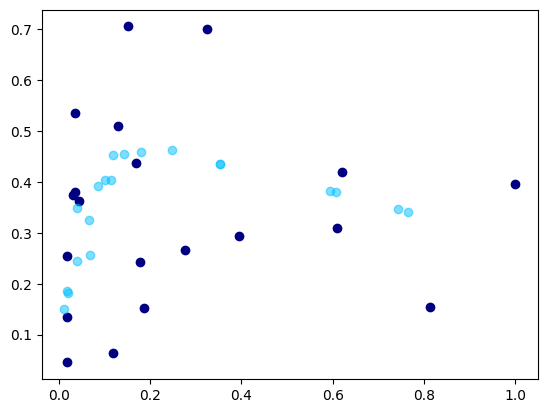

 75%|████████████████████████████████████████████████████████████                    | 751/1000 [02:12<00:43,  5.78it/s]

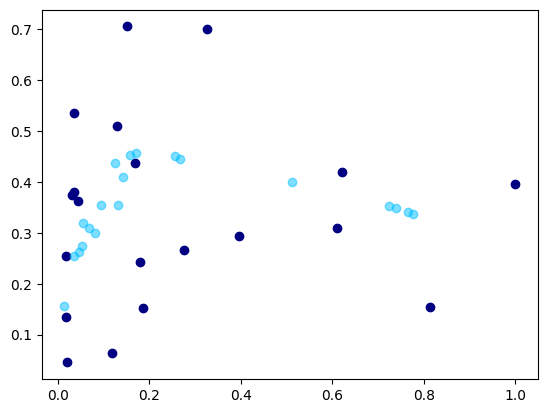

 75%|████████████████████████████████████████████████████████████▏                   | 752/1000 [02:12<00:42,  5.84it/s]

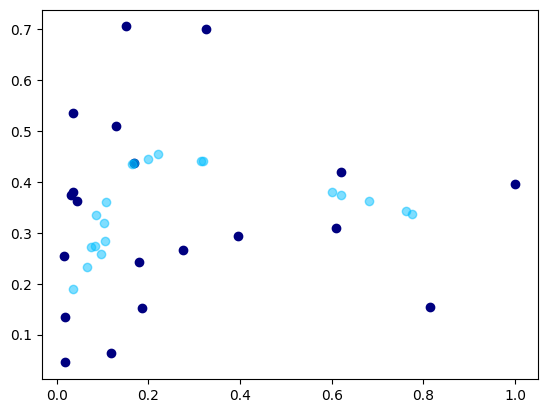

 75%|████████████████████████████████████████████████████████████▏                   | 753/1000 [02:13<00:41,  5.92it/s]

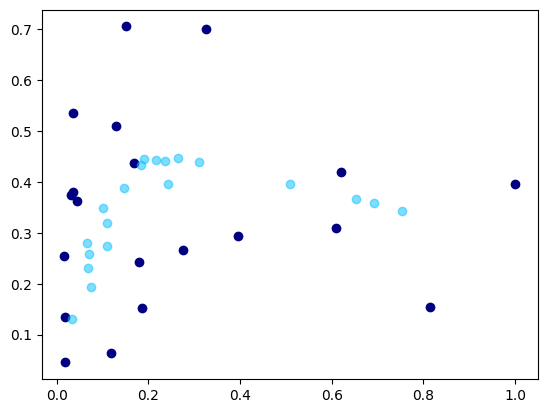

 75%|████████████████████████████████████████████████████████████▎                   | 754/1000 [02:13<00:41,  5.95it/s]

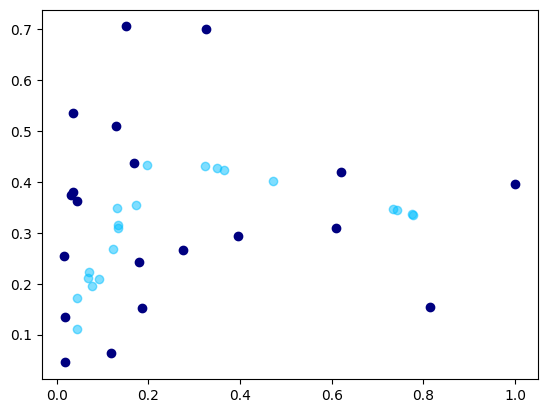

 76%|████████████████████████████████████████████████████████████▍                   | 755/1000 [02:13<00:40,  6.00it/s]

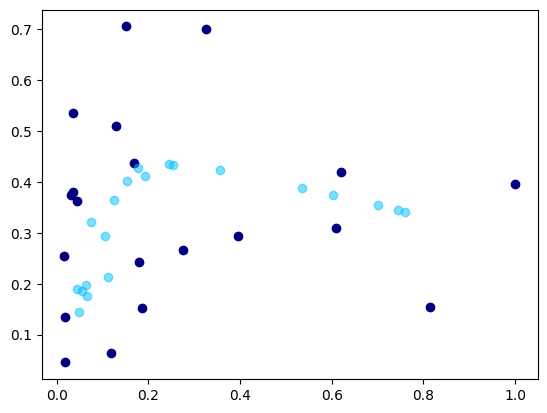

 76%|████████████████████████████████████████████████████████████▍                   | 756/1000 [02:13<00:40,  6.01it/s]

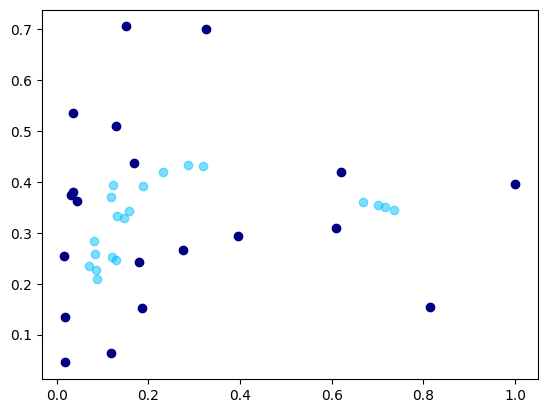

 76%|████████████████████████████████████████████████████████████▌                   | 757/1000 [02:13<00:40,  6.05it/s]

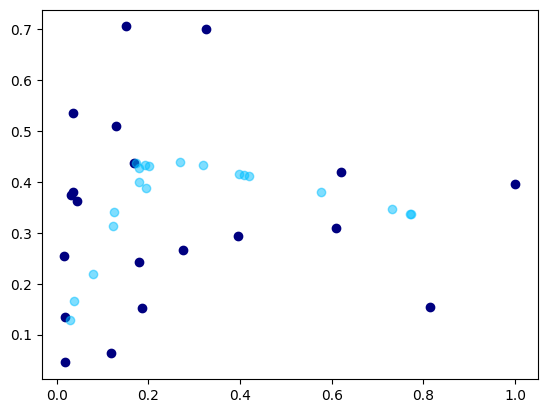

 76%|████████████████████████████████████████████████████████████▋                   | 758/1000 [02:13<00:41,  5.77it/s]

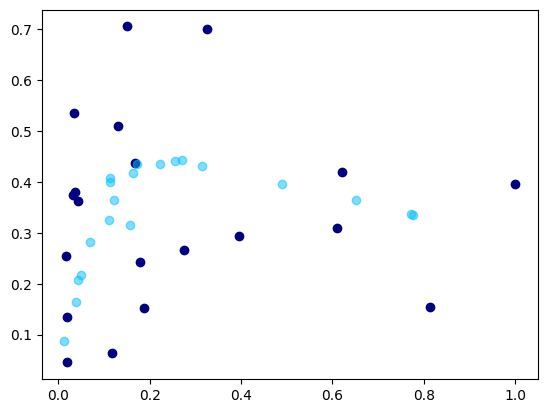

 76%|████████████████████████████████████████████████████████████▋                   | 759/1000 [02:14<00:41,  5.87it/s]

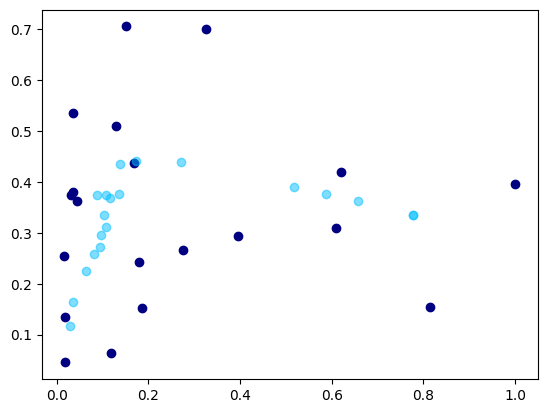

 76%|████████████████████████████████████████████████████████████▊                   | 760/1000 [02:14<00:40,  5.92it/s]

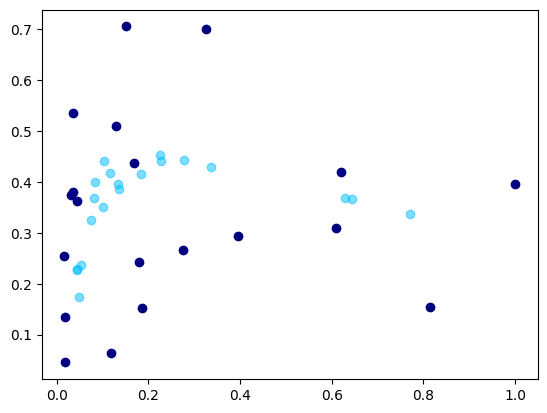

 76%|████████████████████████████████████████████████████████████▉                   | 761/1000 [02:14<00:40,  5.95it/s]

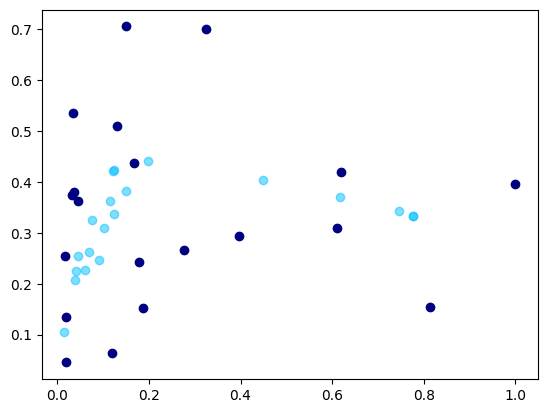

 76%|████████████████████████████████████████████████████████████▉                   | 762/1000 [02:14<00:39,  5.97it/s]

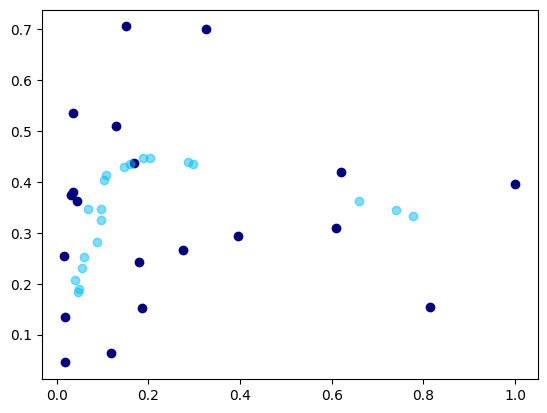

 76%|█████████████████████████████████████████████████████████████                   | 763/1000 [02:14<00:39,  5.97it/s]

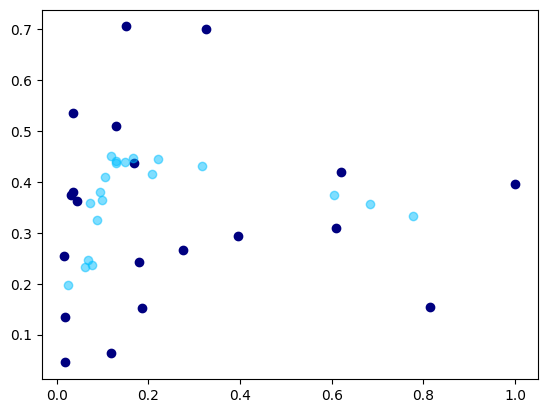

 76%|█████████████████████████████████████████████████████████████                   | 764/1000 [02:14<00:39,  5.99it/s]

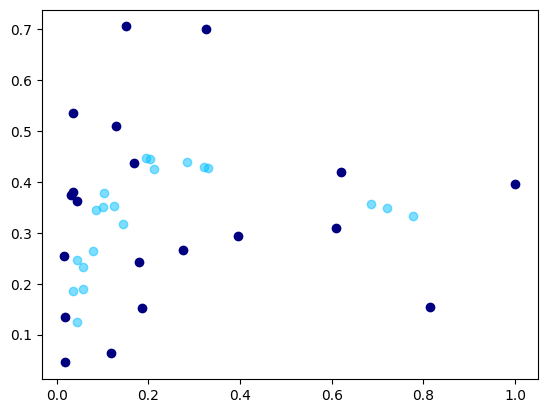

 76%|█████████████████████████████████████████████████████████████▏                  | 765/1000 [02:15<00:39,  6.01it/s]

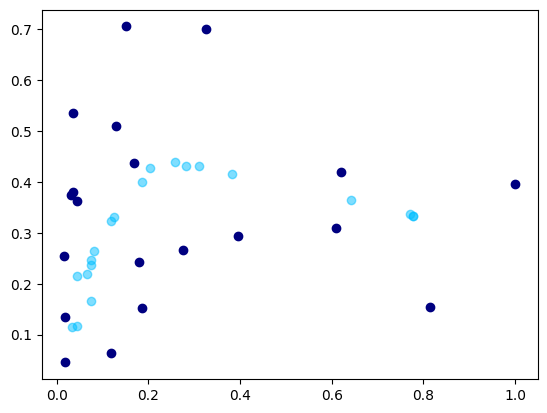

 77%|█████████████████████████████████████████████████████████████▎                  | 766/1000 [02:15<00:39,  6.00it/s]

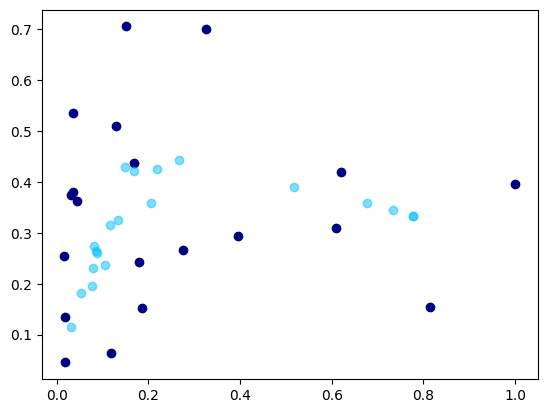

 77%|█████████████████████████████████████████████████████████████▎                  | 767/1000 [02:15<00:38,  6.03it/s]

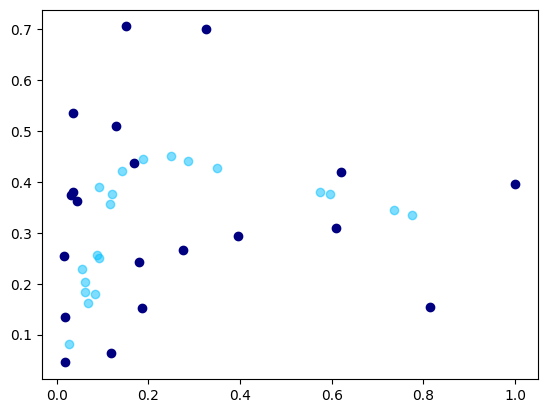

 77%|█████████████████████████████████████████████████████████████▍                  | 768/1000 [02:15<00:38,  6.01it/s]

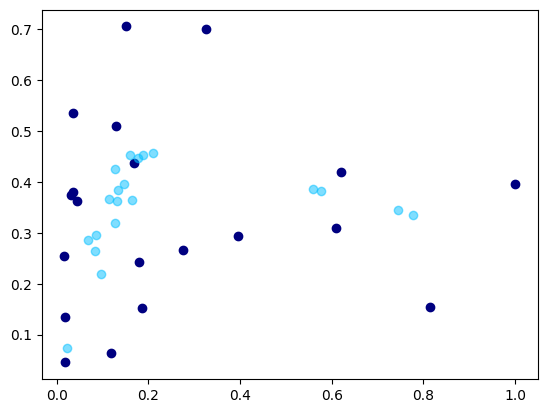

 77%|█████████████████████████████████████████████████████████████▌                  | 769/1000 [02:15<00:38,  6.04it/s]

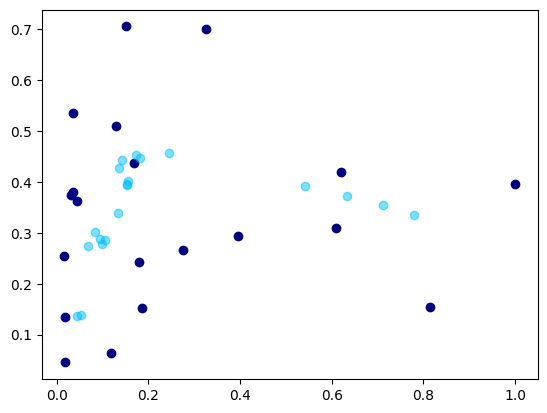

 77%|█████████████████████████████████████████████████████████████▌                  | 770/1000 [02:15<00:38,  6.03it/s]

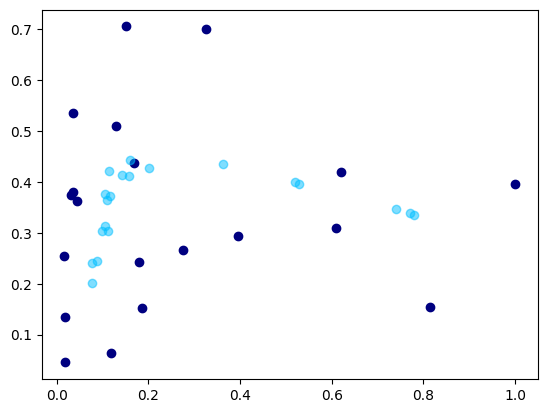

 77%|█████████████████████████████████████████████████████████████▋                  | 771/1000 [02:16<00:38,  6.02it/s]

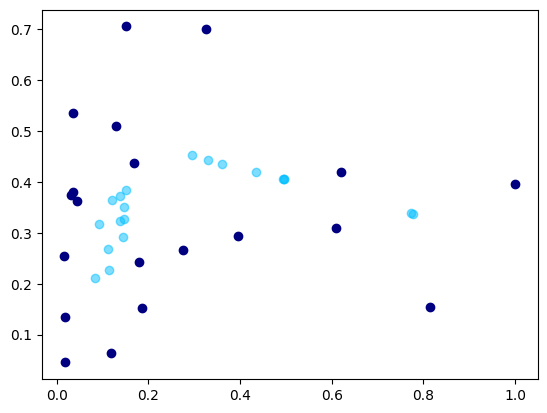

 77%|█████████████████████████████████████████████████████████████▊                  | 772/1000 [02:16<00:38,  5.94it/s]

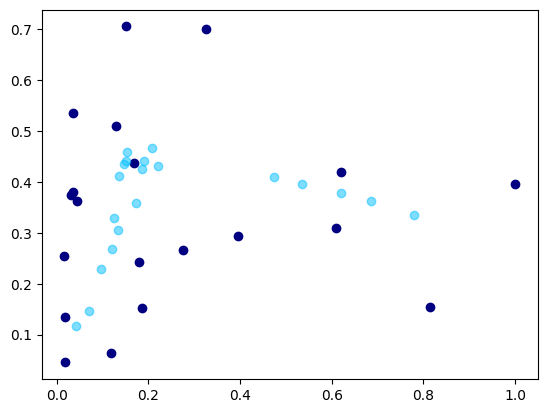

 77%|█████████████████████████████████████████████████████████████▊                  | 773/1000 [02:16<00:38,  5.96it/s]

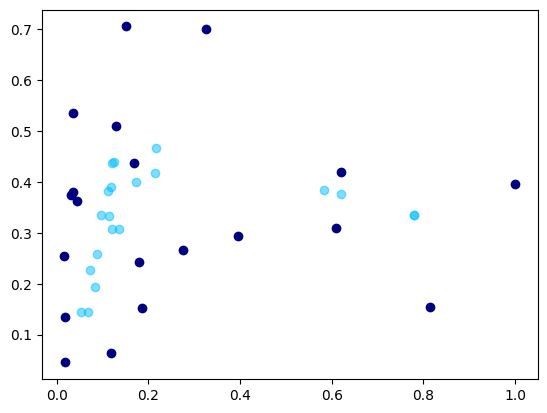

 77%|█████████████████████████████████████████████████████████████▉                  | 774/1000 [02:16<00:37,  5.97it/s]

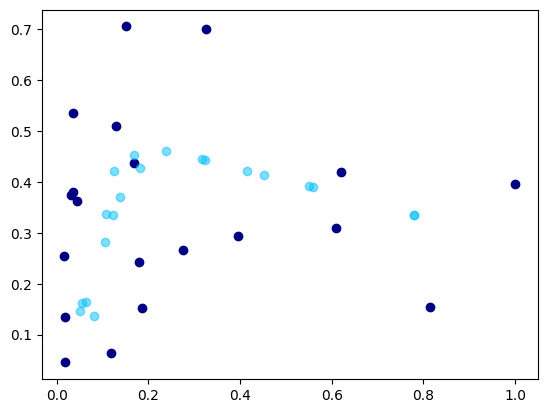

 78%|██████████████████████████████████████████████████████████████                  | 775/1000 [02:16<00:37,  5.93it/s]

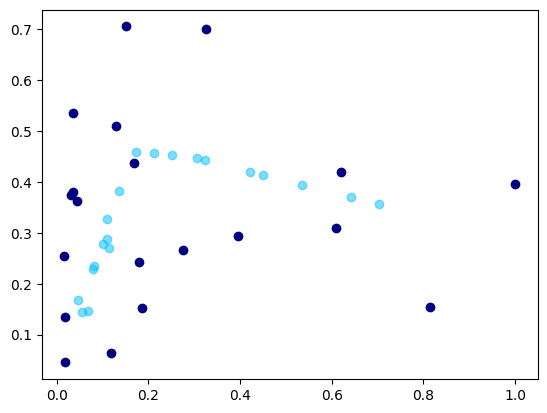

 78%|██████████████████████████████████████████████████████████████                  | 776/1000 [02:16<00:38,  5.78it/s]

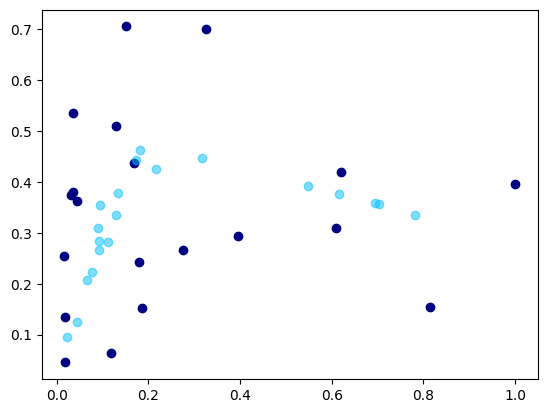

 78%|██████████████████████████████████████████████████████████████▏                 | 777/1000 [02:17<00:38,  5.86it/s]

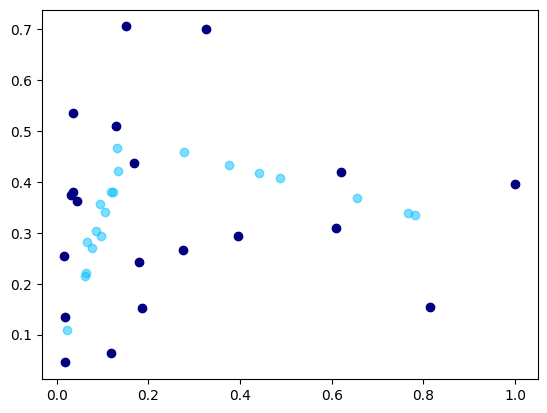

 78%|██████████████████████████████████████████████████████████████▏                 | 778/1000 [02:17<00:37,  5.92it/s]

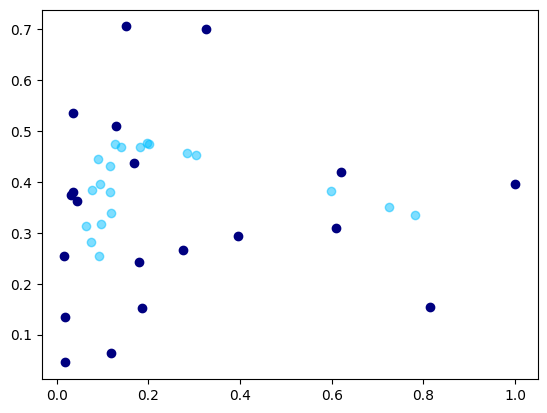

 78%|██████████████████████████████████████████████████████████████▎                 | 779/1000 [02:17<00:37,  5.89it/s]

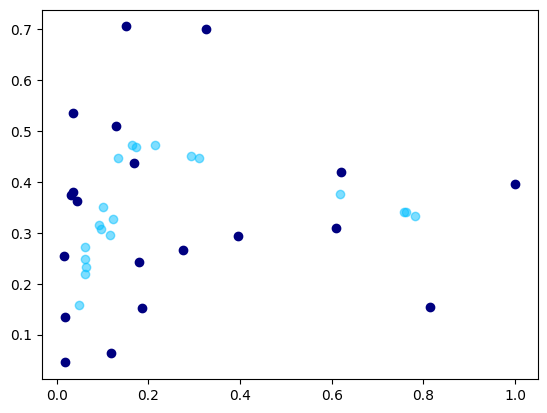

 78%|██████████████████████████████████████████████████████████████▍                 | 780/1000 [02:17<00:38,  5.76it/s]

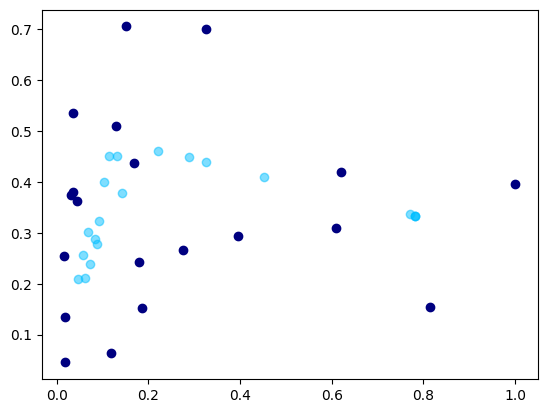

 78%|██████████████████████████████████████████████████████████████▍                 | 781/1000 [02:17<00:38,  5.74it/s]

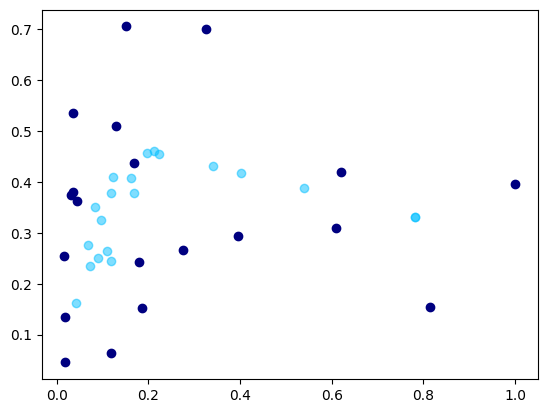

 78%|██████████████████████████████████████████████████████████████▌                 | 782/1000 [02:17<00:37,  5.85it/s]

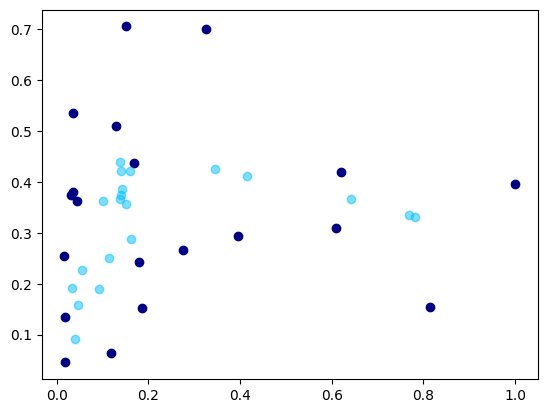

 78%|██████████████████████████████████████████████████████████████▋                 | 783/1000 [02:18<00:36,  5.87it/s]

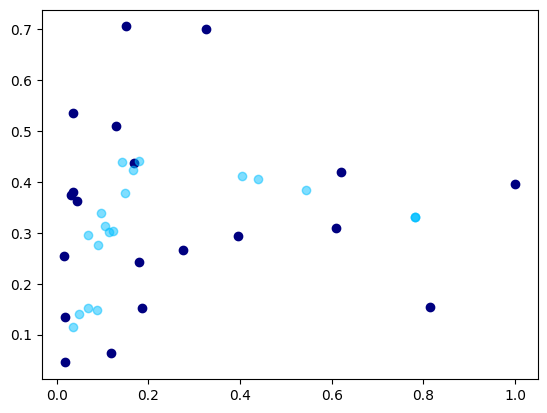

 78%|██████████████████████████████████████████████████████████████▋                 | 784/1000 [02:18<00:36,  5.85it/s]

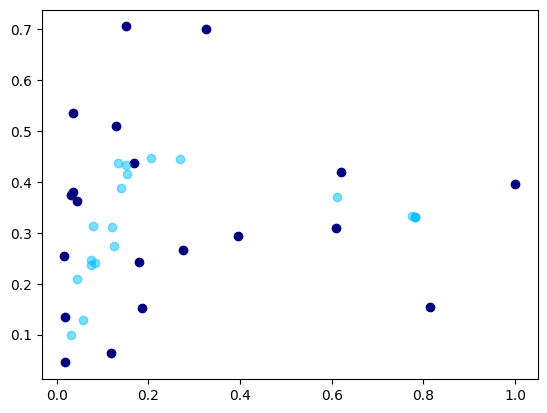

 78%|██████████████████████████████████████████████████████████████▊                 | 785/1000 [02:18<00:37,  5.68it/s]

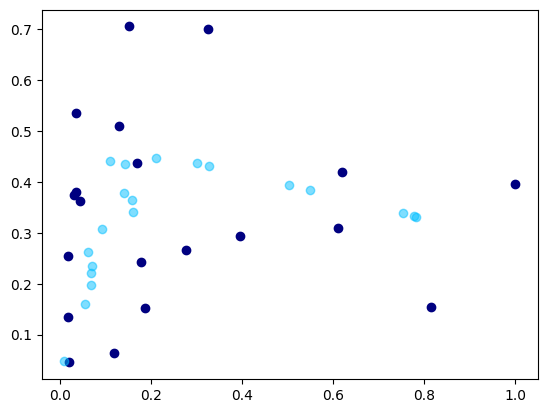

 79%|██████████████████████████████████████████████████████████████▉                 | 786/1000 [02:18<00:37,  5.70it/s]

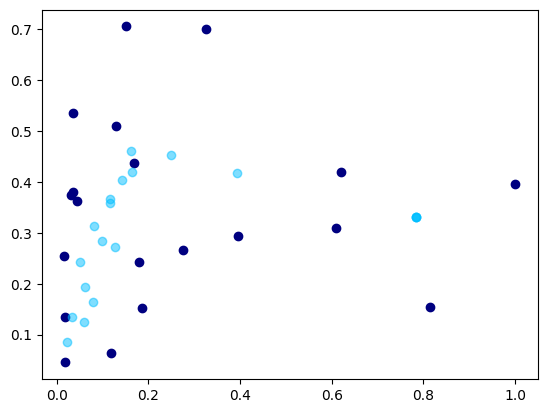

 79%|██████████████████████████████████████████████████████████████▉                 | 787/1000 [02:18<00:37,  5.73it/s]

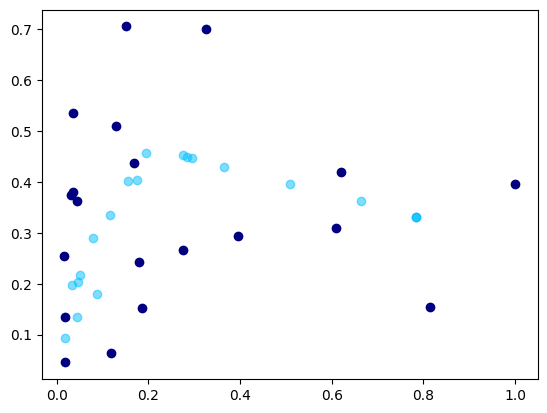

 79%|███████████████████████████████████████████████████████████████                 | 788/1000 [02:19<00:36,  5.84it/s]

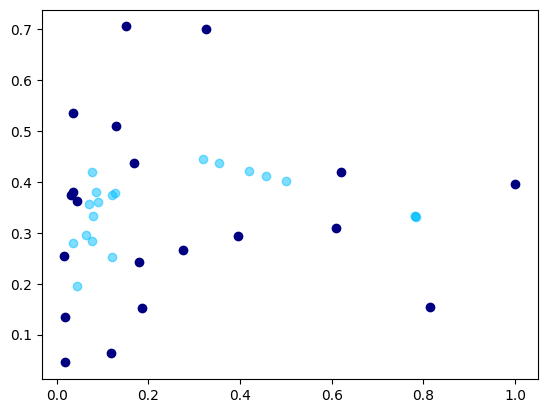

 79%|███████████████████████████████████████████████████████████████                 | 789/1000 [02:19<00:36,  5.82it/s]

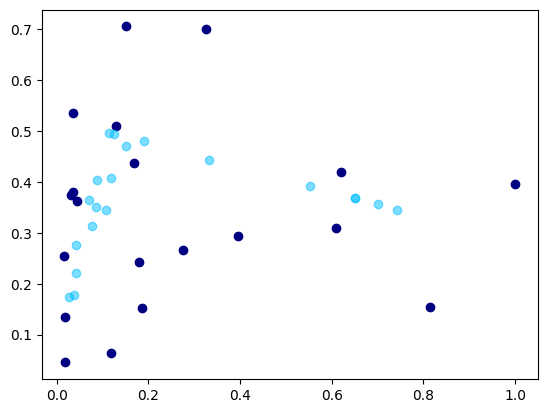

 79%|███████████████████████████████████████████████████████████████▏                | 790/1000 [02:19<00:35,  5.87it/s]

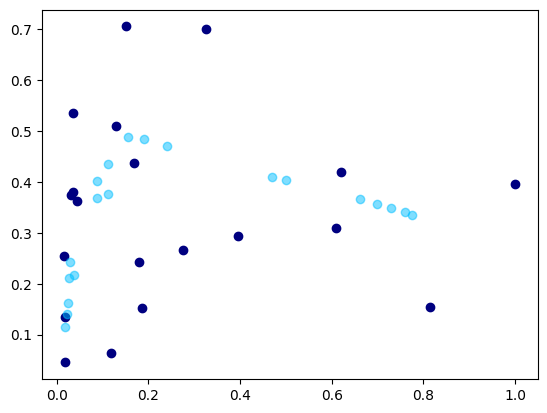

 79%|███████████████████████████████████████████████████████████████▎                | 791/1000 [02:19<00:35,  5.91it/s]

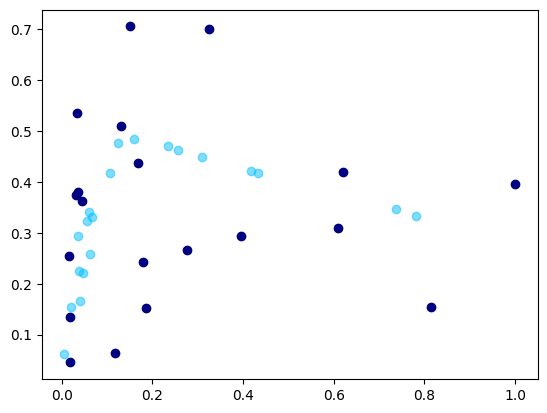

 79%|███████████████████████████████████████████████████████████████▎                | 792/1000 [02:19<00:35,  5.87it/s]

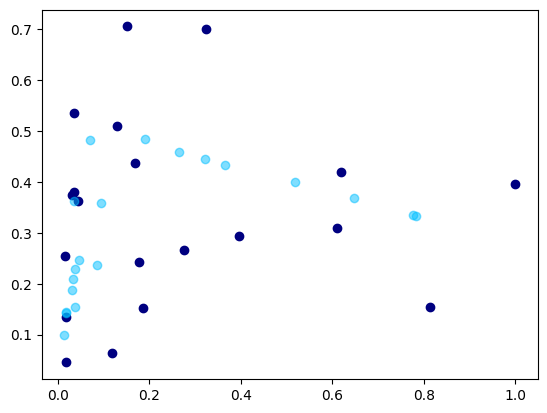

 79%|███████████████████████████████████████████████████████████████▍                | 793/1000 [02:19<00:35,  5.81it/s]

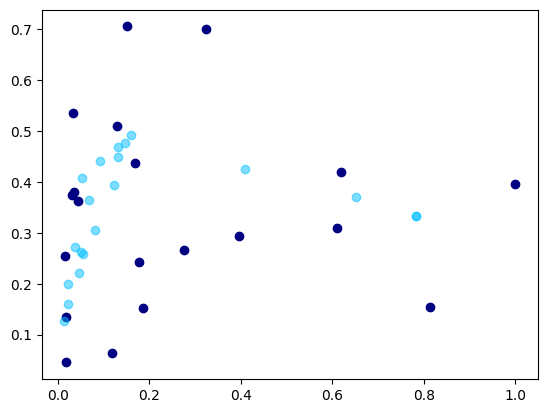

 79%|███████████████████████████████████████████████████████████████▌                | 794/1000 [02:20<00:35,  5.81it/s]

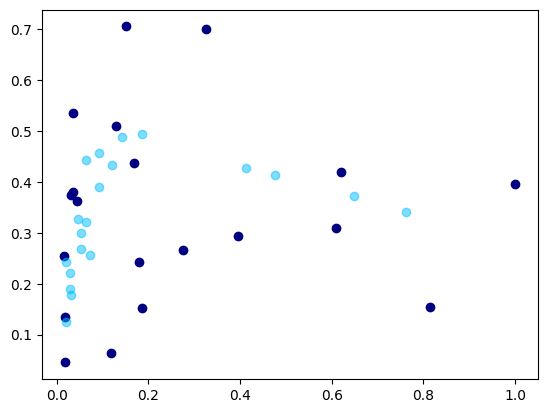

 80%|███████████████████████████████████████████████████████████████▌                | 795/1000 [02:20<00:35,  5.78it/s]

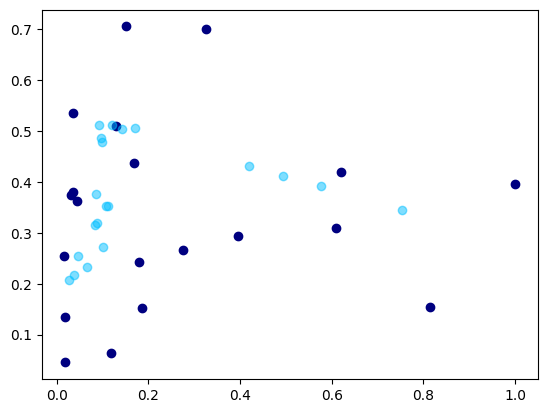

 80%|███████████████████████████████████████████████████████████████▋                | 796/1000 [02:20<00:34,  5.84it/s]

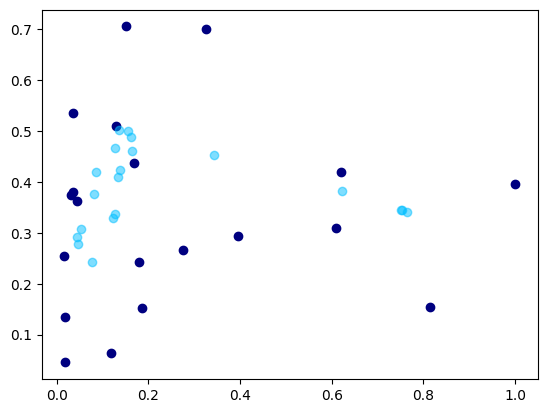

 80%|███████████████████████████████████████████████████████████████▊                | 797/1000 [02:20<00:34,  5.92it/s]

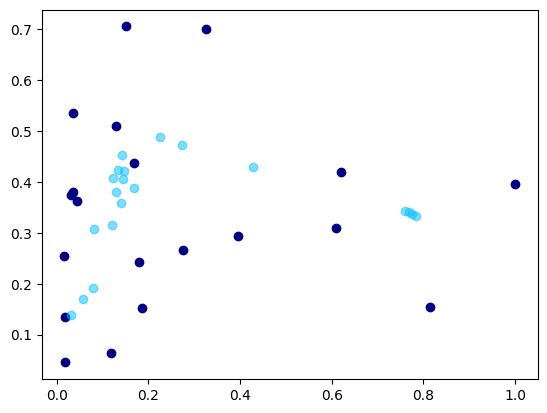

 80%|███████████████████████████████████████████████████████████████▊                | 798/1000 [02:20<00:34,  5.88it/s]

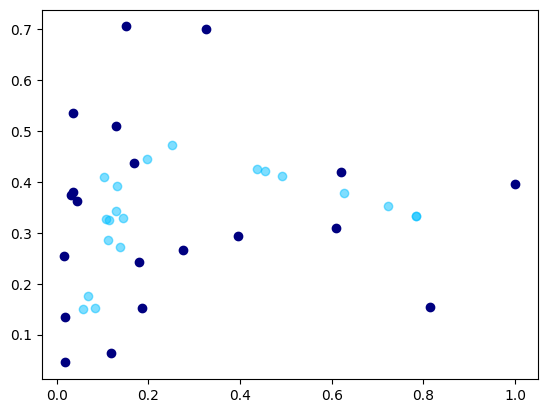

 80%|███████████████████████████████████████████████████████████████▉                | 799/1000 [02:20<00:34,  5.84it/s]

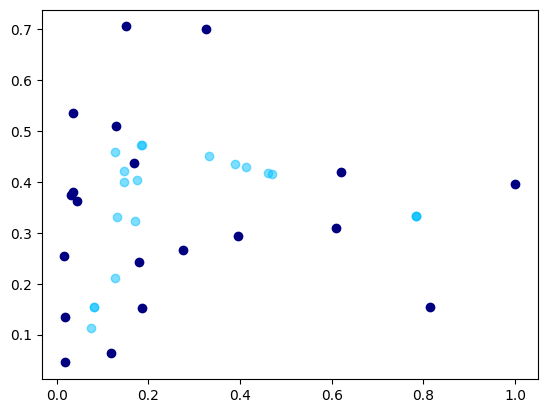

 80%|████████████████████████████████████████████████████████████████                | 800/1000 [02:21<00:34,  5.86it/s]

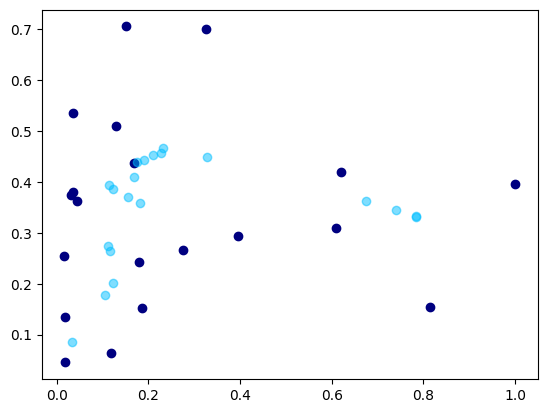

 80%|████████████████████████████████████████████████████████████████                | 801/1000 [02:21<00:33,  5.95it/s]

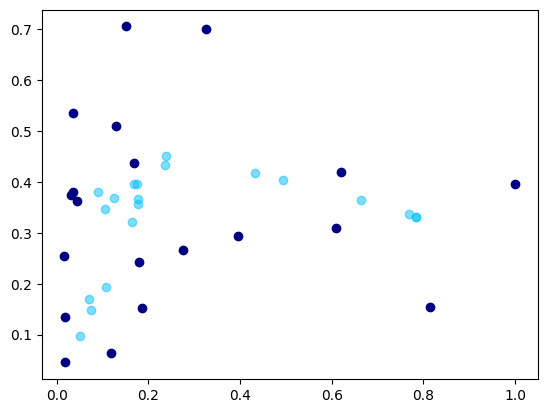

 80%|████████████████████████████████████████████████████████████████▏               | 802/1000 [02:21<00:33,  5.91it/s]

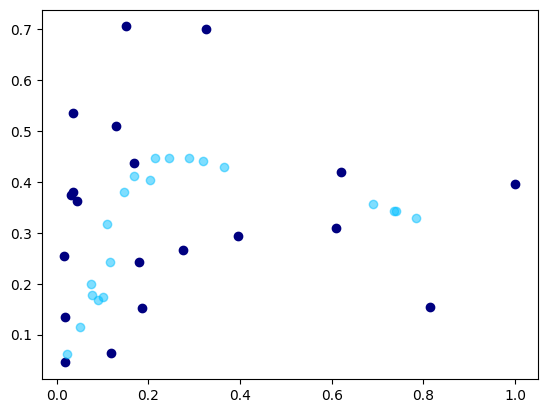

 80%|████████████████████████████████████████████████████████████████▏               | 803/1000 [02:21<00:33,  5.96it/s]

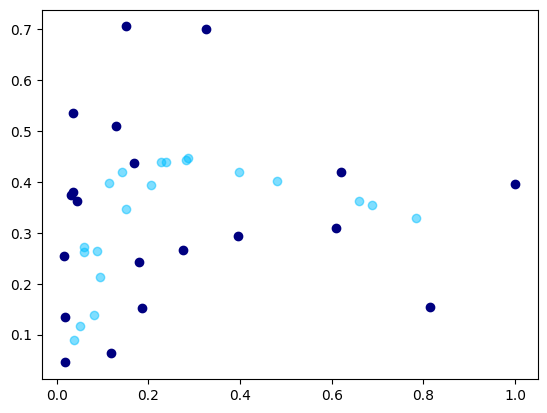

 80%|████████████████████████████████████████████████████████████████▎               | 804/1000 [02:21<00:33,  5.89it/s]

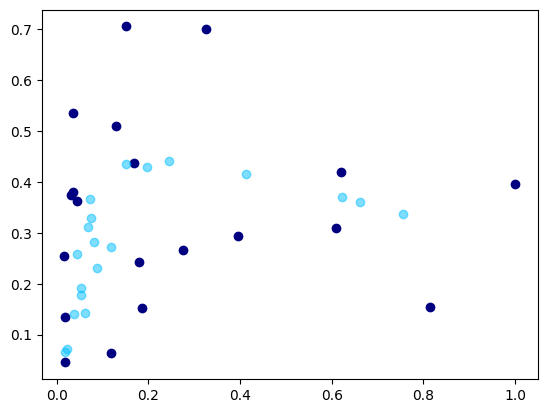

 80%|████████████████████████████████████████████████████████████████▍               | 805/1000 [02:21<00:33,  5.90it/s]

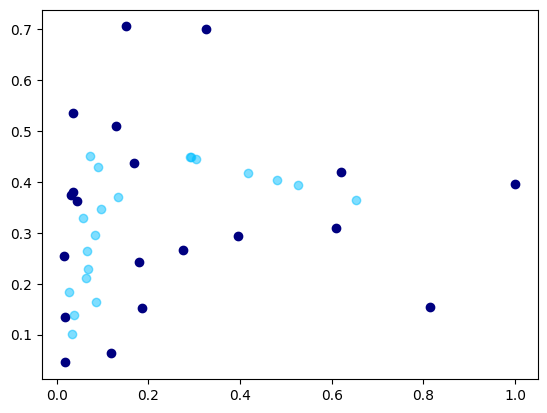

 81%|████████████████████████████████████████████████████████████████▍               | 806/1000 [02:22<00:32,  5.88it/s]

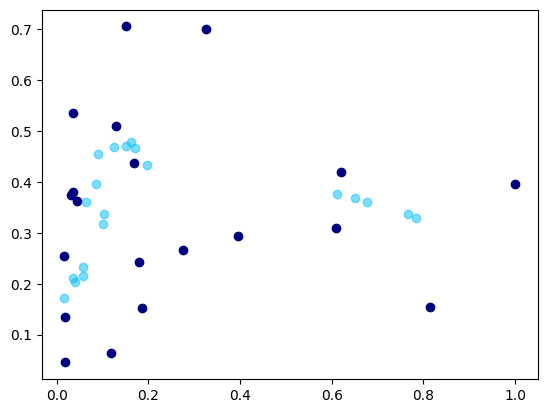

 81%|████████████████████████████████████████████████████████████████▌               | 807/1000 [02:22<00:33,  5.84it/s]

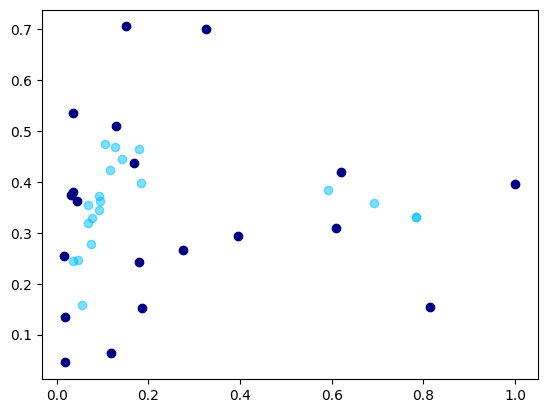

 81%|████████████████████████████████████████████████████████████████▋               | 808/1000 [02:22<00:34,  5.52it/s]

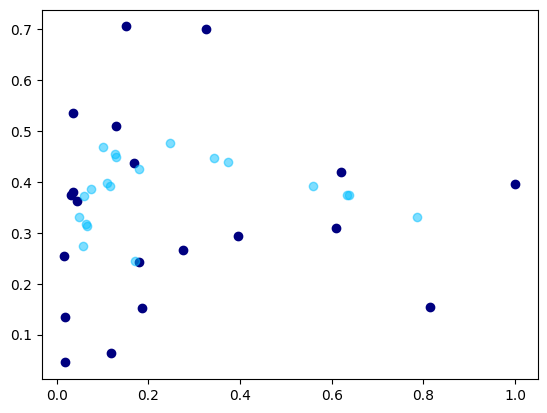

 81%|████████████████████████████████████████████████████████████████▋               | 809/1000 [02:22<00:33,  5.68it/s]

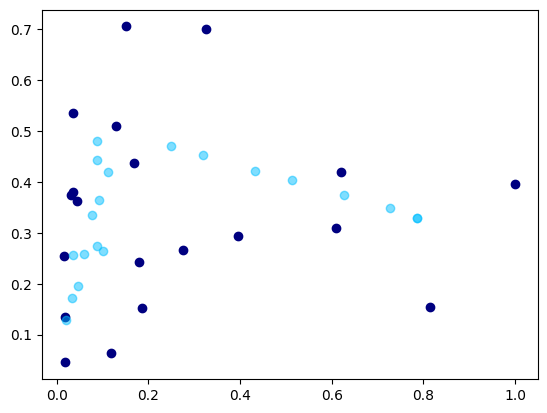

 81%|████████████████████████████████████████████████████████████████▊               | 810/1000 [02:22<00:34,  5.58it/s]

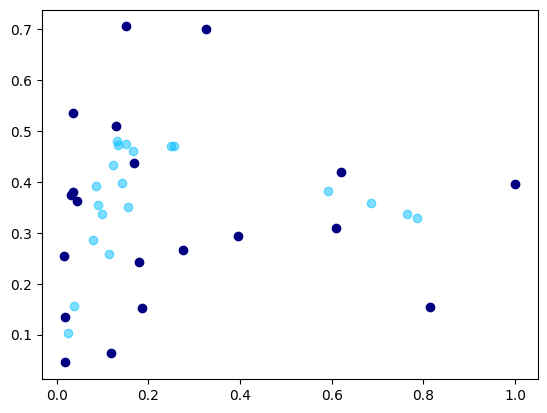

 81%|████████████████████████████████████████████████████████████████▉               | 811/1000 [02:22<00:33,  5.72it/s]

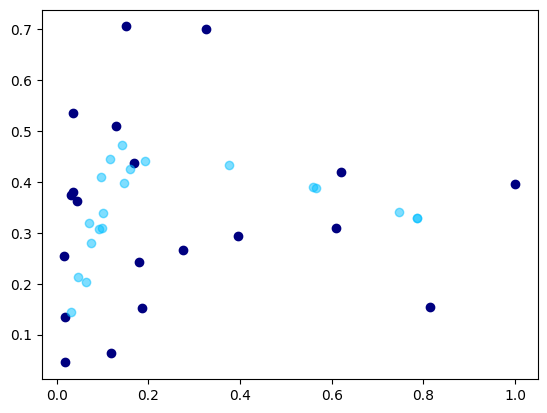

 81%|████████████████████████████████████████████████████████████████▉               | 812/1000 [02:23<00:33,  5.69it/s]

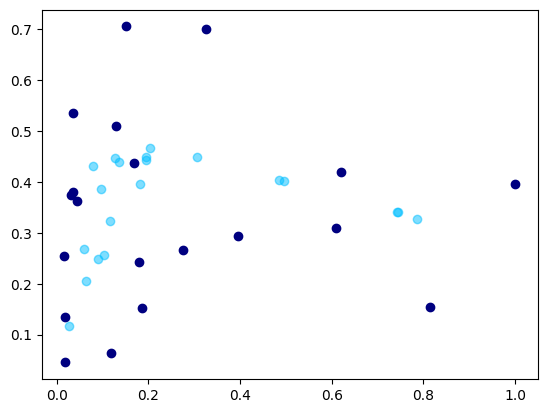

 81%|█████████████████████████████████████████████████████████████████               | 813/1000 [02:23<00:33,  5.61it/s]

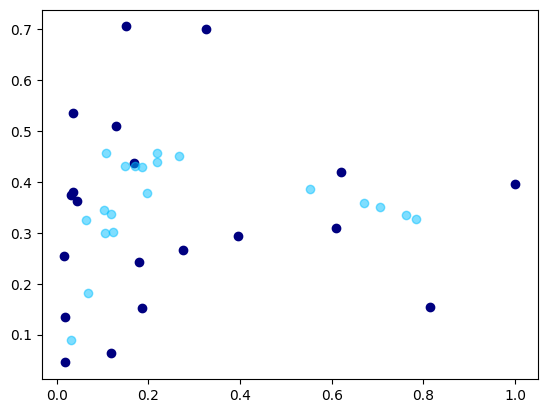

 81%|█████████████████████████████████████████████████████████████████               | 814/1000 [02:23<00:33,  5.52it/s]

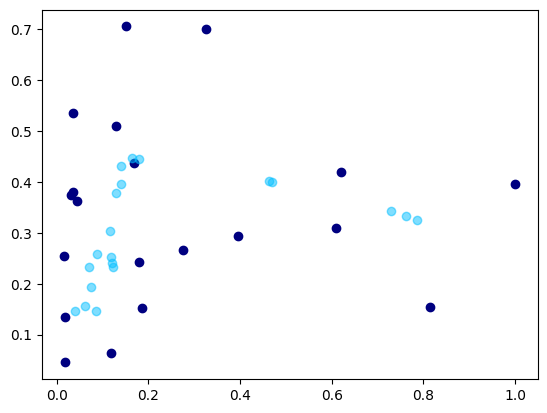

 82%|█████████████████████████████████████████████████████████████████▏              | 815/1000 [02:23<00:33,  5.59it/s]

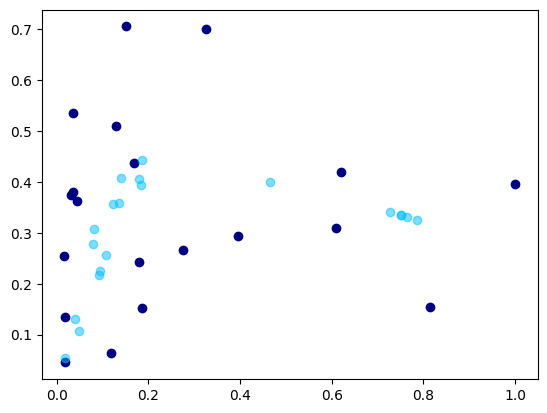

 82%|█████████████████████████████████████████████████████████████████▎              | 816/1000 [02:23<00:32,  5.65it/s]

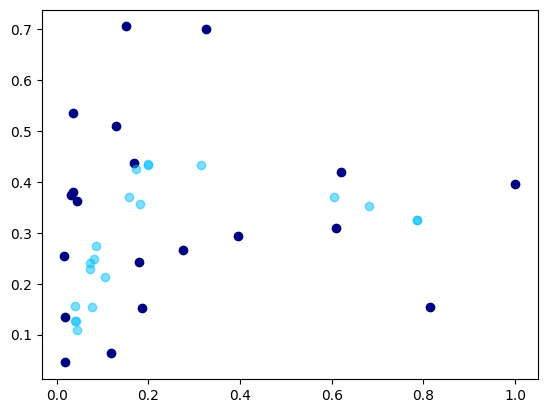

 82%|█████████████████████████████████████████████████████████████████▎              | 817/1000 [02:24<00:31,  5.73it/s]

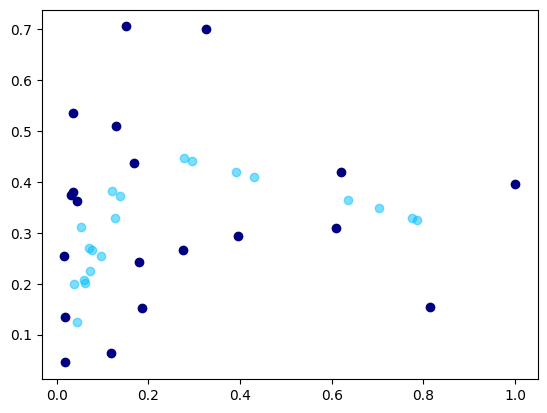

 82%|█████████████████████████████████████████████████████████████████▍              | 818/1000 [02:24<00:31,  5.77it/s]

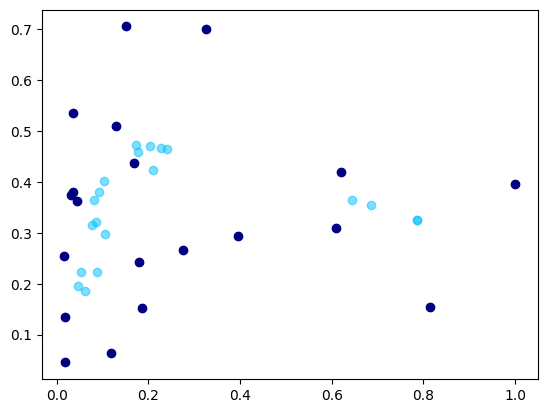

 82%|█████████████████████████████████████████████████████████████████▌              | 819/1000 [02:24<00:30,  5.87it/s]

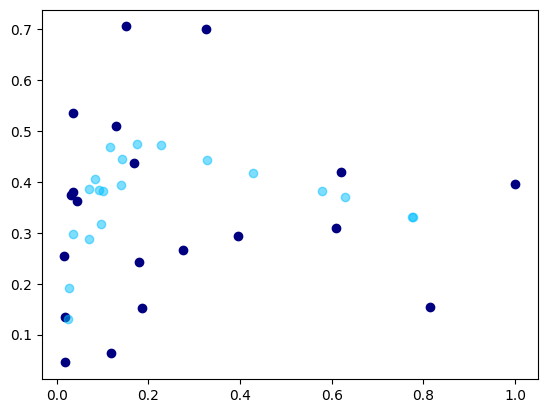

 82%|█████████████████████████████████████████████████████████████████▌              | 820/1000 [02:24<00:31,  5.78it/s]

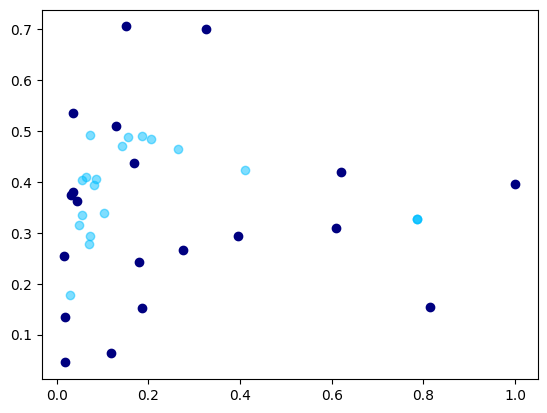

 82%|█████████████████████████████████████████████████████████████████▋              | 821/1000 [02:24<00:30,  5.86it/s]

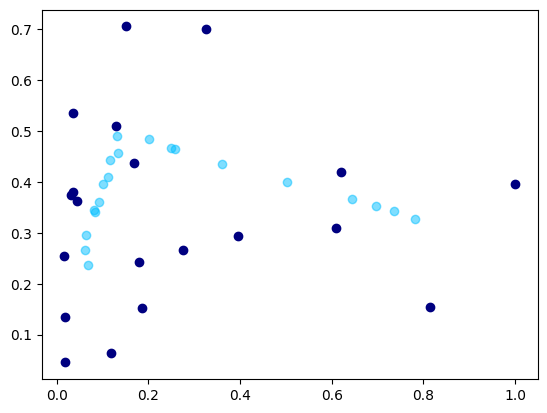

 82%|█████████████████████████████████████████████████████████████████▊              | 822/1000 [02:24<00:31,  5.57it/s]

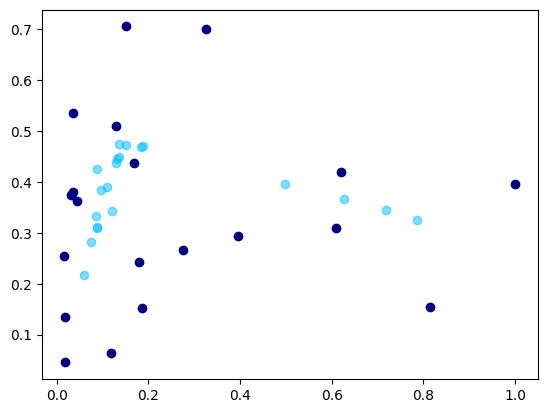

 82%|█████████████████████████████████████████████████████████████████▊              | 823/1000 [02:25<00:30,  5.72it/s]

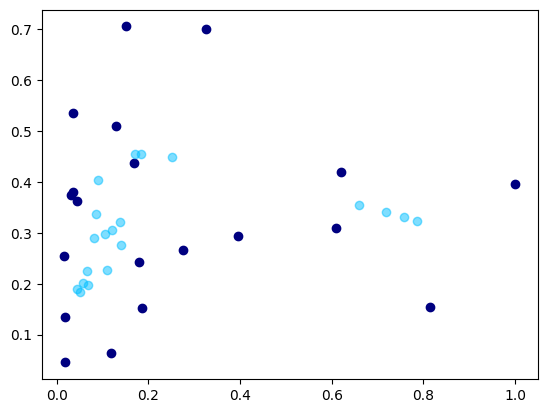

 82%|█████████████████████████████████████████████████████████████████▉              | 824/1000 [02:25<00:30,  5.80it/s]

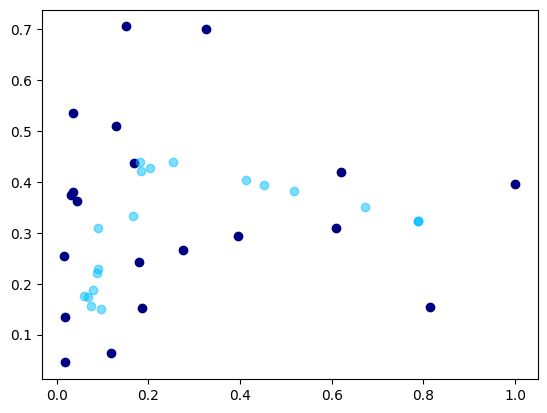

 82%|██████████████████████████████████████████████████████████████████              | 825/1000 [02:25<00:29,  5.84it/s]

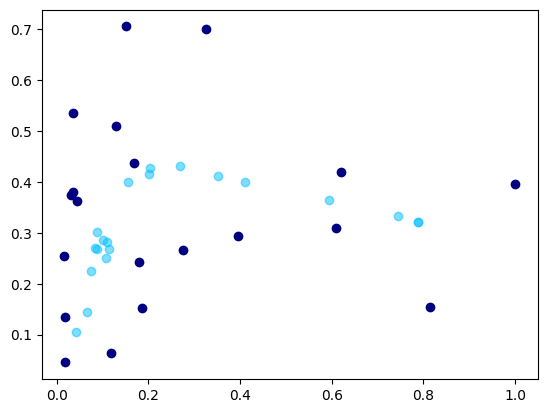

 83%|██████████████████████████████████████████████████████████████████              | 826/1000 [02:25<00:29,  5.93it/s]

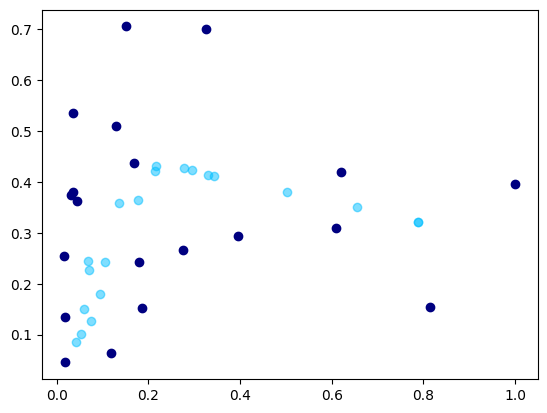

 83%|██████████████████████████████████████████████████████████████████▏             | 827/1000 [02:25<00:29,  5.90it/s]

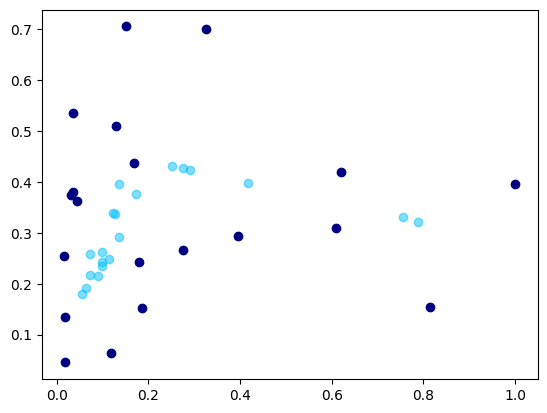

 83%|██████████████████████████████████████████████████████████████████▏             | 828/1000 [02:25<00:29,  5.93it/s]

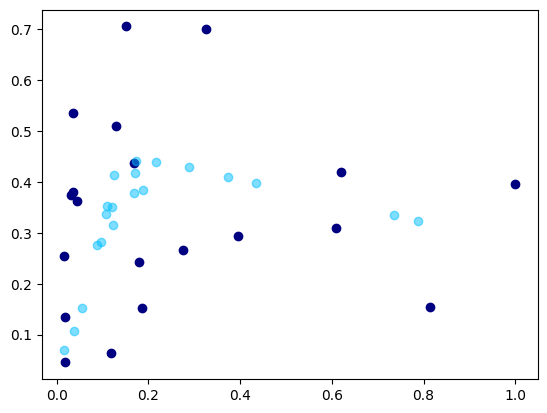

 83%|██████████████████████████████████████████████████████████████████▎             | 829/1000 [02:26<00:29,  5.84it/s]

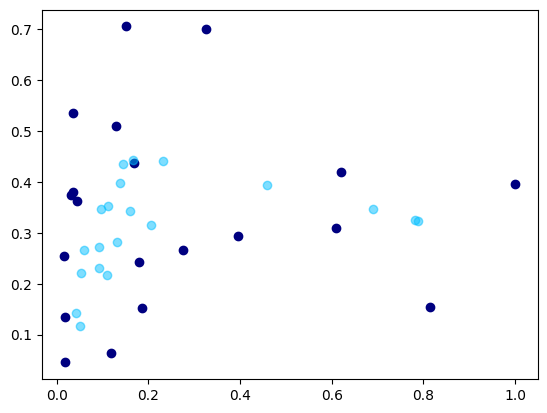

 83%|██████████████████████████████████████████████████████████████████▍             | 830/1000 [02:26<00:28,  5.92it/s]

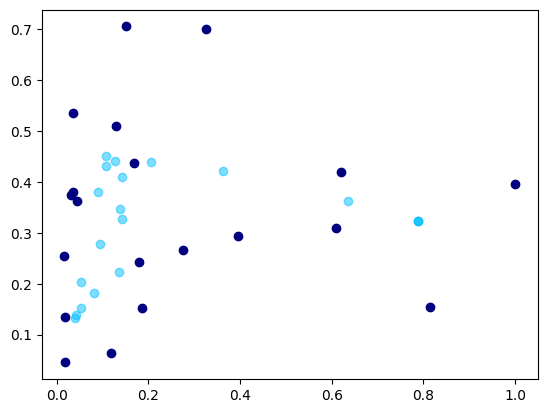

 83%|██████████████████████████████████████████████████████████████████▍             | 831/1000 [02:26<00:28,  5.91it/s]

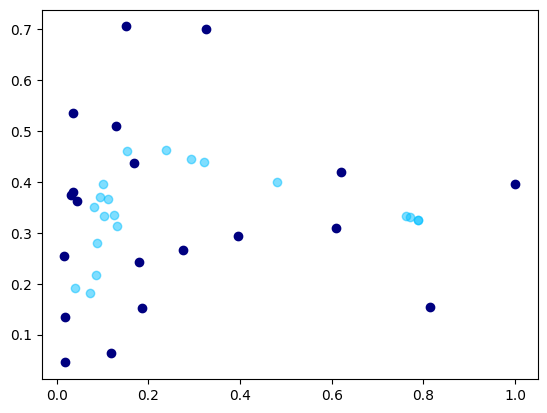

 83%|██████████████████████████████████████████████████████████████████▌             | 832/1000 [02:26<00:28,  5.97it/s]

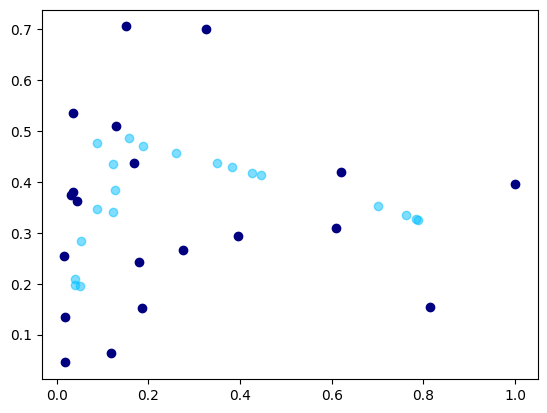

 83%|██████████████████████████████████████████████████████████████████▋             | 833/1000 [02:26<00:28,  5.89it/s]

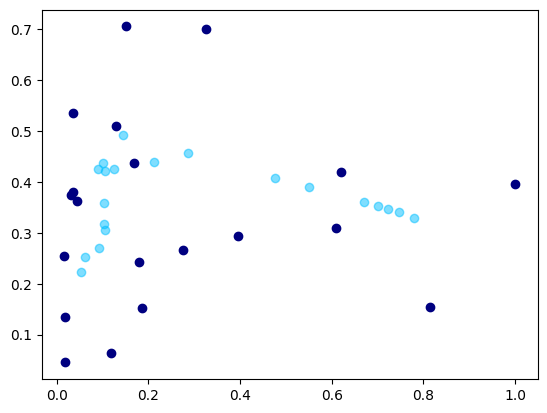

 83%|██████████████████████████████████████████████████████████████████▋             | 834/1000 [02:26<00:27,  5.96it/s]

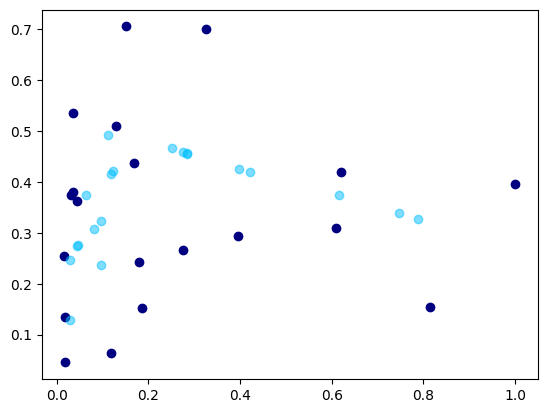

 84%|██████████████████████████████████████████████████████████████████▊             | 835/1000 [02:27<00:28,  5.82it/s]

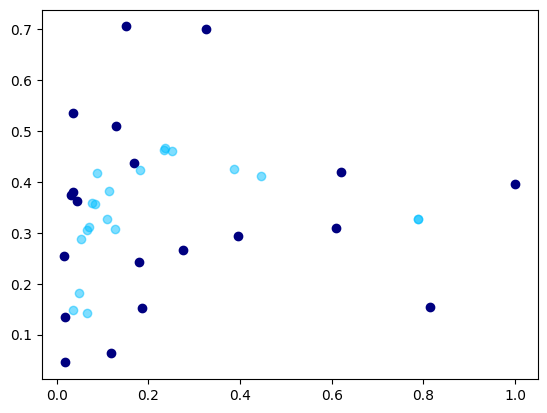

 84%|██████████████████████████████████████████████████████████████████▉             | 836/1000 [02:27<00:29,  5.61it/s]

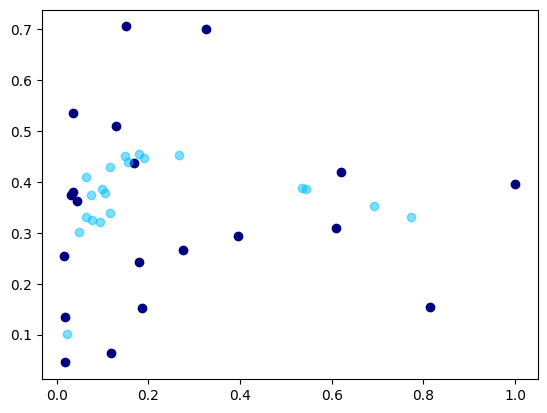

 84%|██████████████████████████████████████████████████████████████████▉             | 837/1000 [02:27<00:28,  5.74it/s]

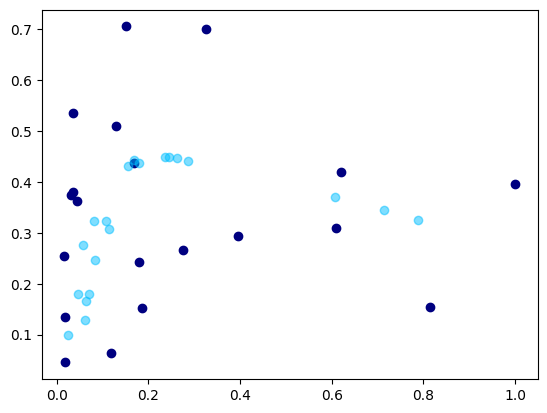

 84%|███████████████████████████████████████████████████████████████████             | 838/1000 [02:27<00:27,  5.82it/s]

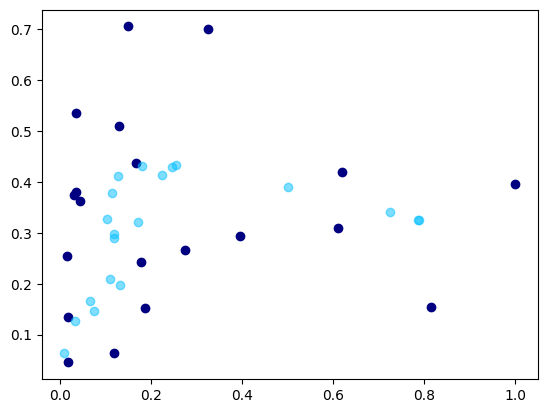

 84%|███████████████████████████████████████████████████████████████████             | 839/1000 [02:27<00:27,  5.88it/s]

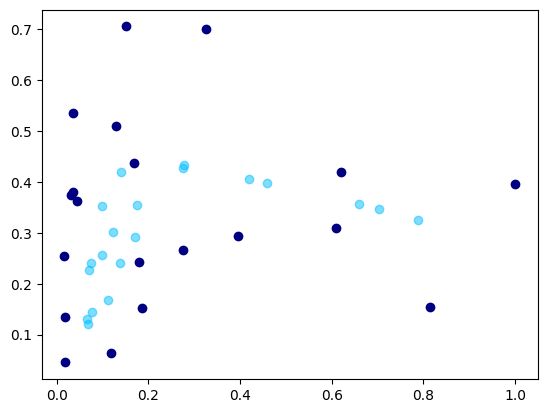

 84%|███████████████████████████████████████████████████████████████████▏            | 840/1000 [02:27<00:26,  5.96it/s]

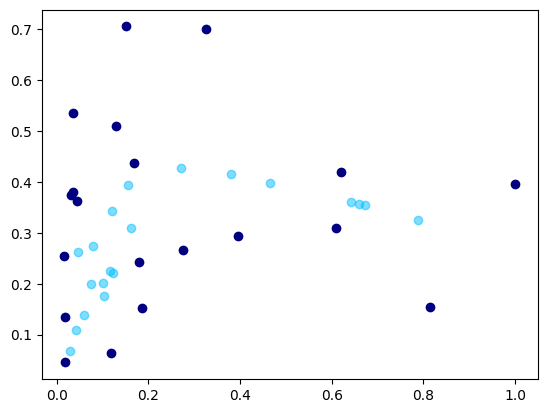

 84%|███████████████████████████████████████████████████████████████████▎            | 841/1000 [02:28<00:26,  5.96it/s]

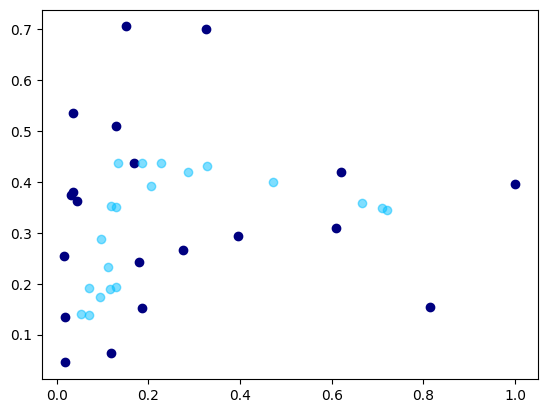

 84%|███████████████████████████████████████████████████████████████████▎            | 842/1000 [02:28<00:26,  5.99it/s]

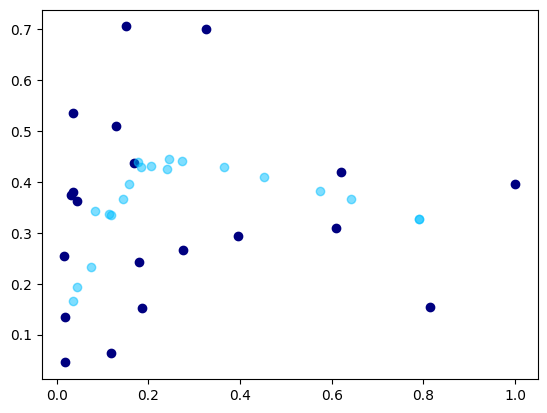

 84%|███████████████████████████████████████████████████████████████████▍            | 843/1000 [02:28<00:26,  5.93it/s]

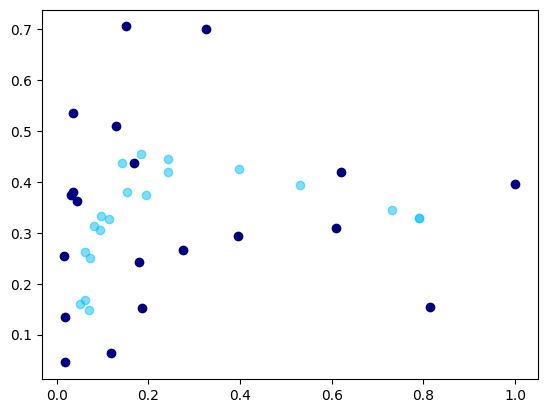

 84%|███████████████████████████████████████████████████████████████████▌            | 844/1000 [02:28<00:26,  5.87it/s]

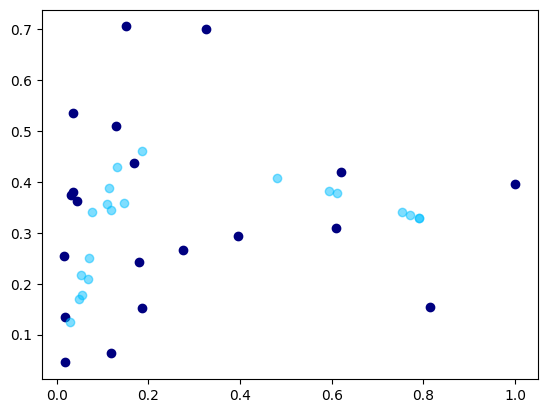

 84%|███████████████████████████████████████████████████████████████████▌            | 845/1000 [02:28<00:26,  5.91it/s]

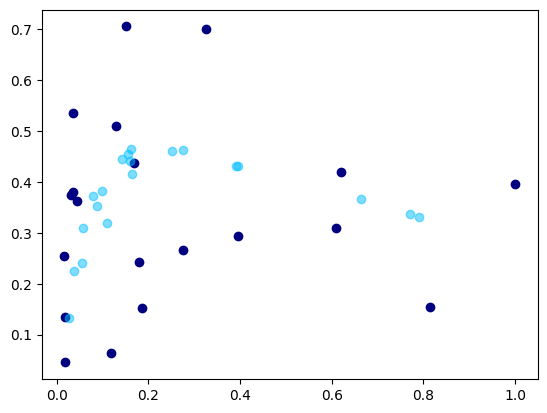

 85%|███████████████████████████████████████████████████████████████████▋            | 846/1000 [02:28<00:25,  5.99it/s]

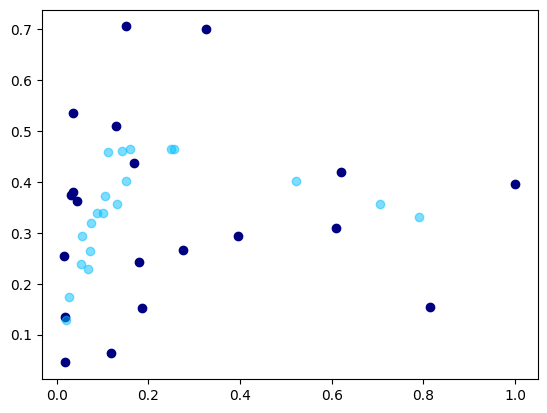

 85%|███████████████████████████████████████████████████████████████████▊            | 847/1000 [02:29<00:25,  5.95it/s]

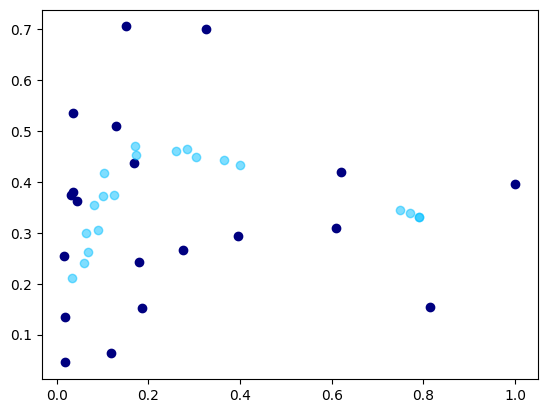

 85%|███████████████████████████████████████████████████████████████████▊            | 848/1000 [02:29<00:25,  5.99it/s]

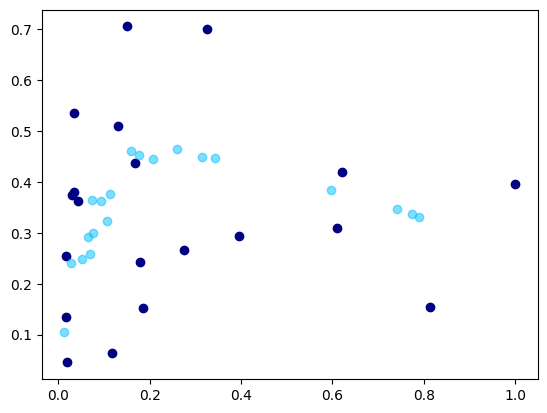

 85%|███████████████████████████████████████████████████████████████████▉            | 849/1000 [02:29<00:25,  5.85it/s]

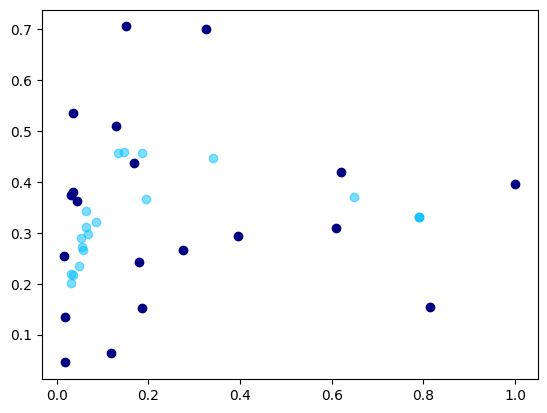

 85%|████████████████████████████████████████████████████████████████████            | 850/1000 [02:29<00:25,  5.92it/s]

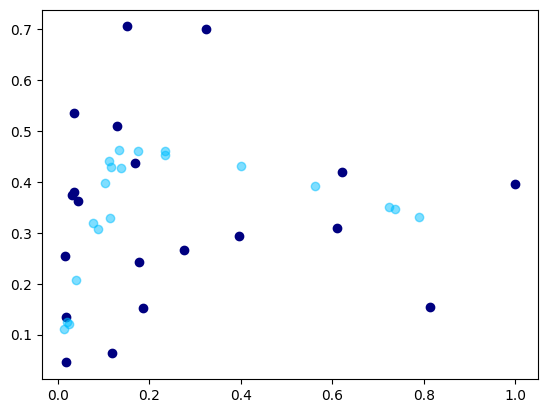

 85%|████████████████████████████████████████████████████████████████████            | 851/1000 [02:29<00:24,  5.97it/s]

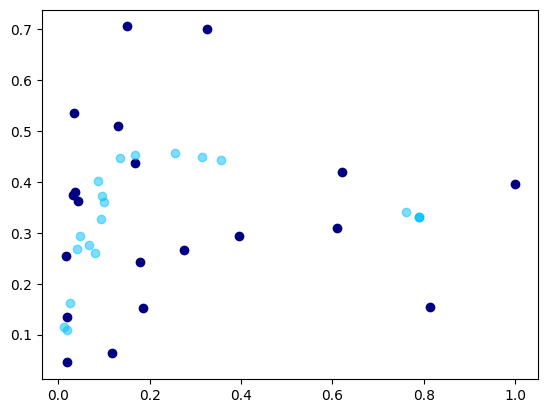

 85%|████████████████████████████████████████████████████████████████████▏           | 852/1000 [02:30<00:44,  3.31it/s]

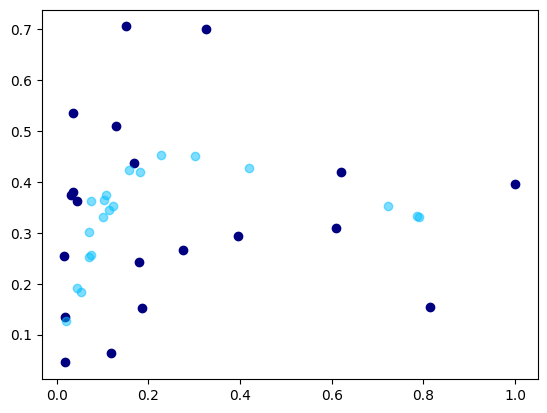

 85%|████████████████████████████████████████████████████████████████████▏           | 853/1000 [02:30<00:38,  3.83it/s]

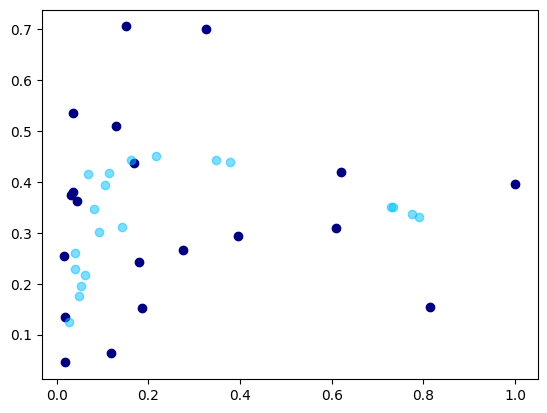

 85%|████████████████████████████████████████████████████████████████████▎           | 854/1000 [02:30<00:34,  4.25it/s]

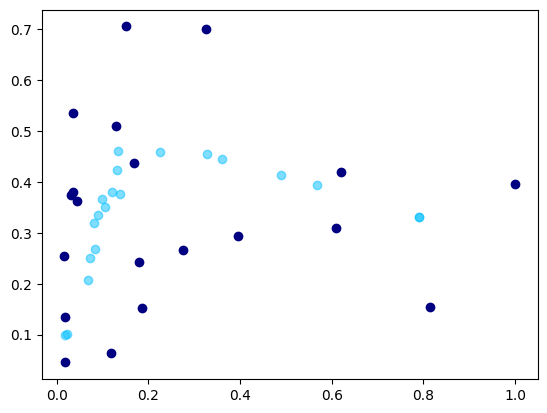

 86%|████████████████████████████████████████████████████████████████████▍           | 855/1000 [02:30<00:31,  4.64it/s]

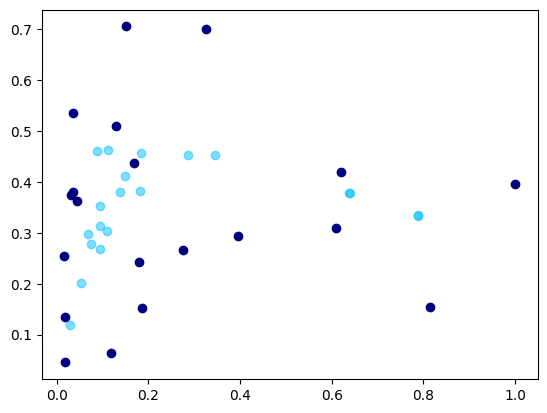

 86%|████████████████████████████████████████████████████████████████████▍           | 856/1000 [02:31<00:29,  4.89it/s]

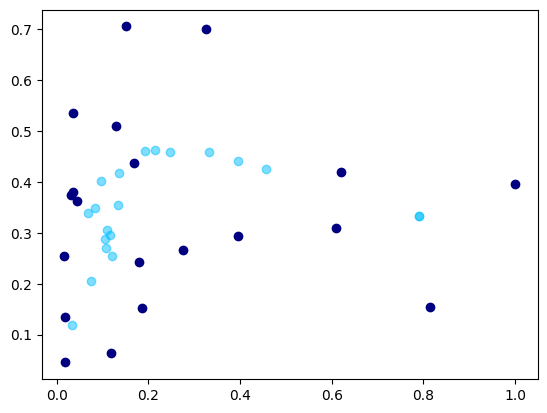

 86%|████████████████████████████████████████████████████████████████████▌           | 857/1000 [02:31<00:27,  5.18it/s]

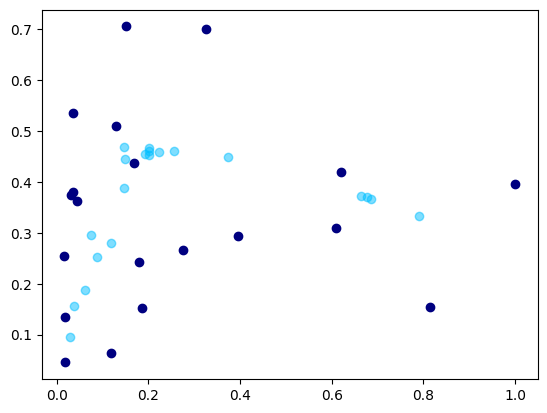

 86%|████████████████████████████████████████████████████████████████████▋           | 858/1000 [02:31<00:27,  5.18it/s]

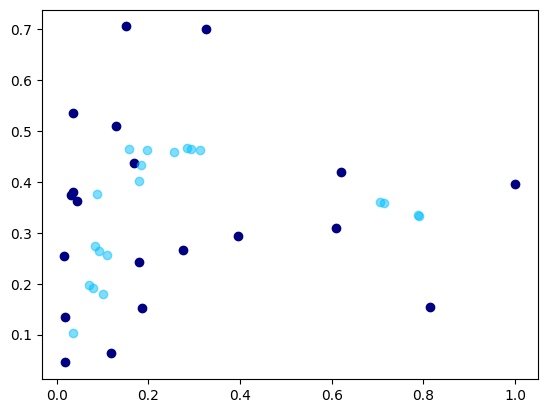

 86%|████████████████████████████████████████████████████████████████████▋           | 859/1000 [02:31<00:26,  5.26it/s]

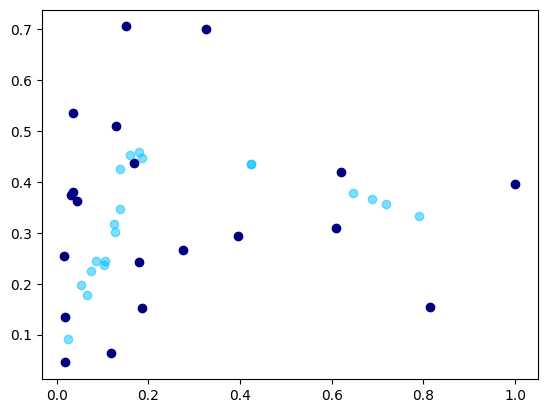

 86%|████████████████████████████████████████████████████████████████████▊           | 860/1000 [02:31<00:25,  5.44it/s]

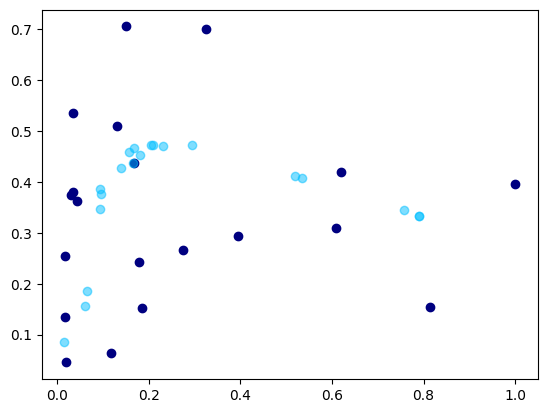

 86%|████████████████████████████████████████████████████████████████████▉           | 861/1000 [02:31<00:24,  5.59it/s]

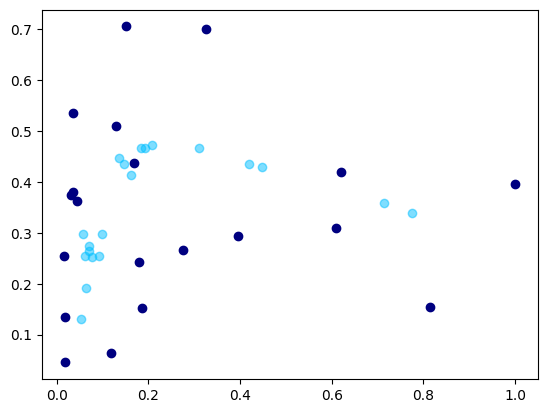

 86%|████████████████████████████████████████████████████████████████████▉           | 862/1000 [02:32<00:24,  5.63it/s]

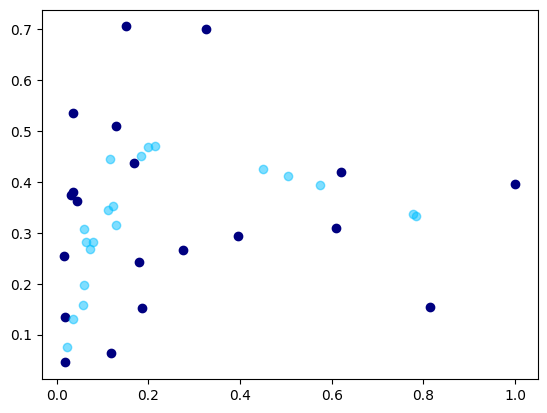

 86%|█████████████████████████████████████████████████████████████████████           | 863/1000 [02:32<00:24,  5.50it/s]

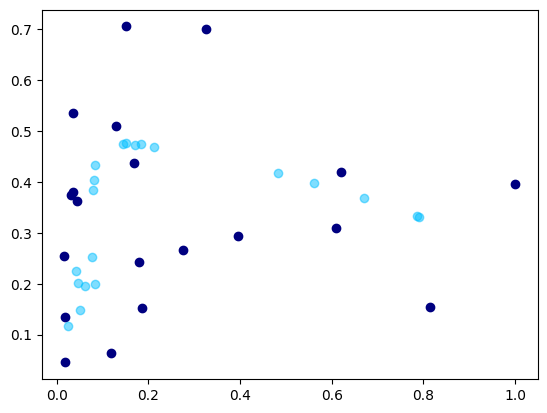

 86%|█████████████████████████████████████████████████████████████████████           | 864/1000 [02:32<00:24,  5.64it/s]

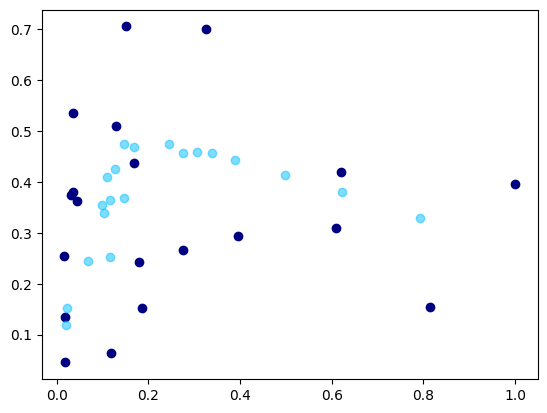

 86%|█████████████████████████████████████████████████████████████████████▏          | 865/1000 [02:32<00:23,  5.72it/s]

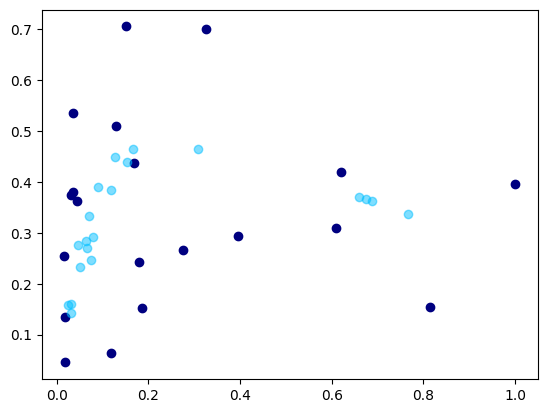

 87%|█████████████████████████████████████████████████████████████████████▎          | 866/1000 [02:32<00:23,  5.80it/s]

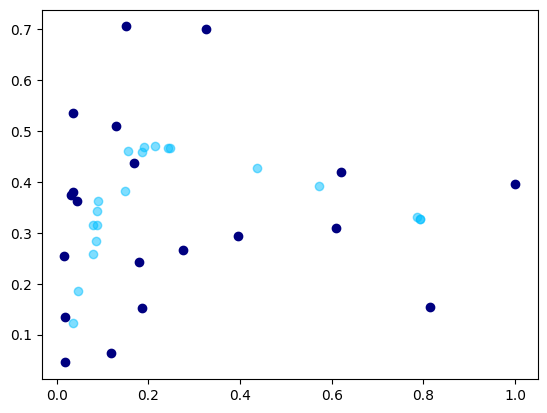

 87%|█████████████████████████████████████████████████████████████████████▎          | 867/1000 [02:33<00:22,  5.85it/s]

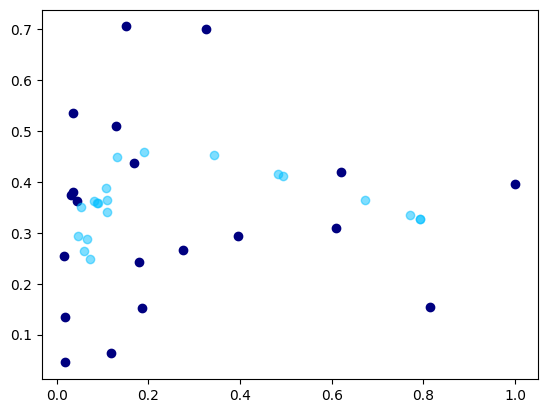

 87%|█████████████████████████████████████████████████████████████████████▍          | 868/1000 [02:33<00:22,  5.92it/s]

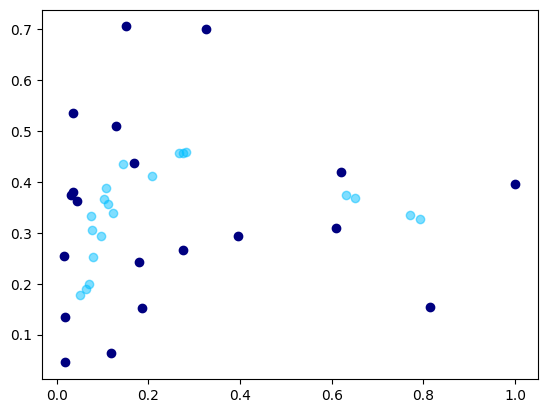

 87%|█████████████████████████████████████████████████████████████████████▌          | 869/1000 [02:33<00:22,  5.94it/s]

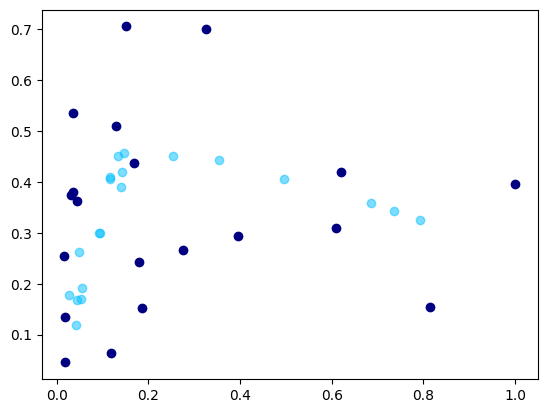

 87%|█████████████████████████████████████████████████████████████████████▌          | 870/1000 [02:33<00:21,  5.94it/s]

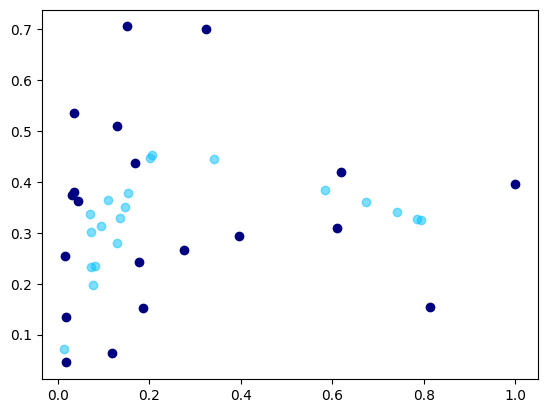

 87%|█████████████████████████████████████████████████████████████████████▋          | 871/1000 [02:33<00:21,  5.91it/s]

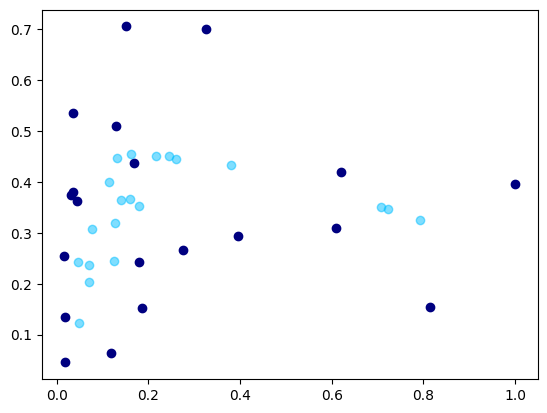

 87%|█████████████████████████████████████████████████████████████████████▊          | 872/1000 [02:33<00:21,  5.95it/s]

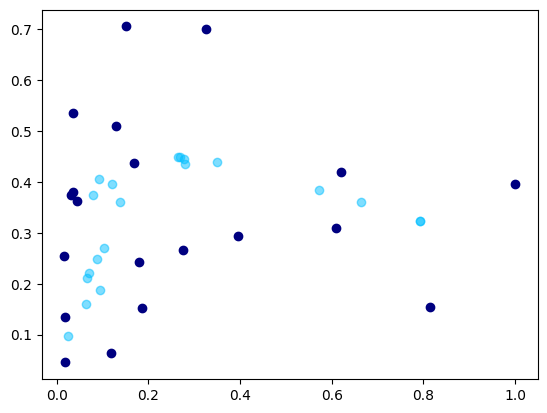

 87%|█████████████████████████████████████████████████████████████████████▊          | 873/1000 [02:34<00:21,  5.89it/s]

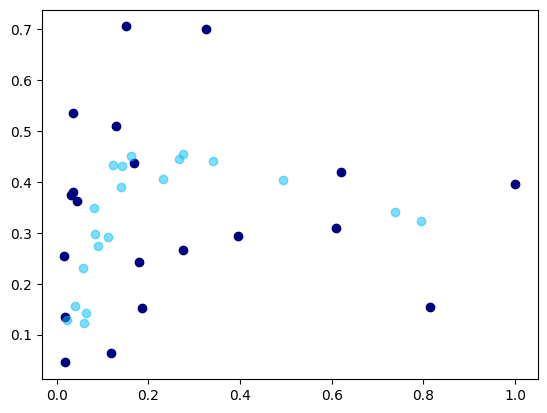

 87%|█████████████████████████████████████████████████████████████████████▉          | 874/1000 [02:34<00:21,  5.86it/s]

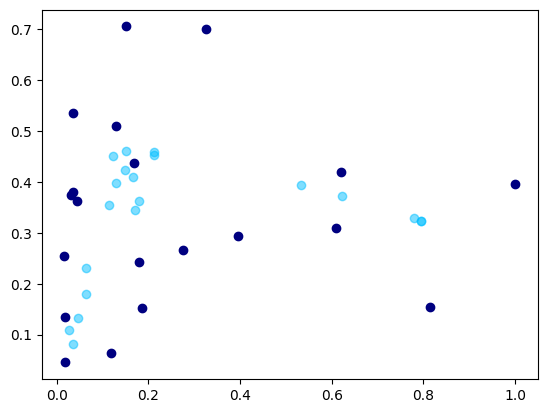

 88%|██████████████████████████████████████████████████████████████████████          | 875/1000 [02:34<00:21,  5.88it/s]

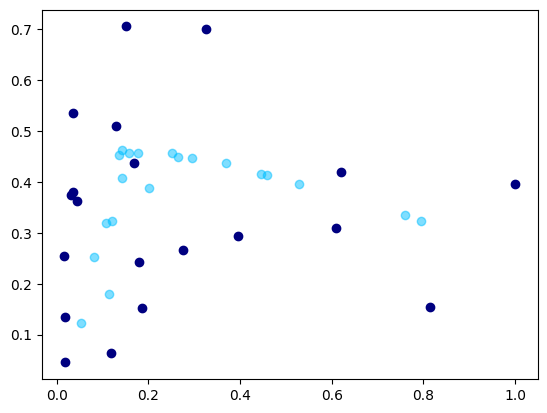

 88%|██████████████████████████████████████████████████████████████████████          | 876/1000 [02:34<00:21,  5.82it/s]

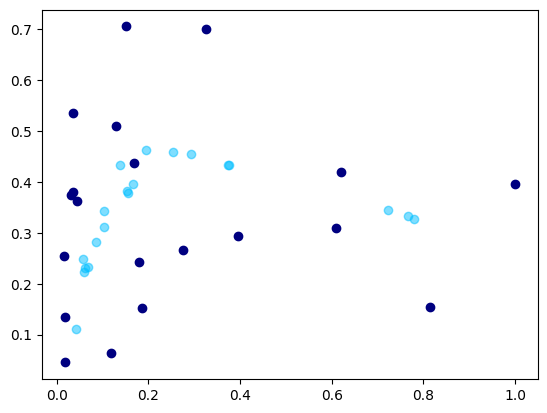

 88%|██████████████████████████████████████████████████████████████████████▏         | 877/1000 [02:34<00:21,  5.85it/s]

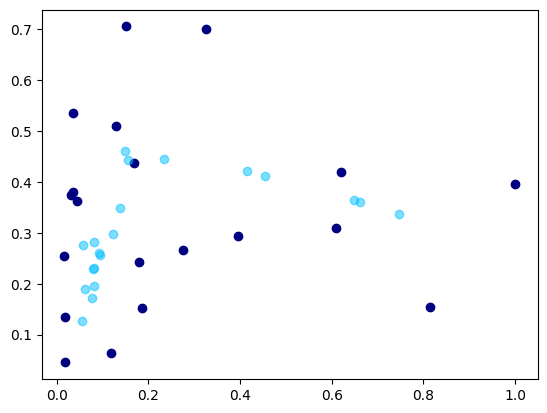

 88%|██████████████████████████████████████████████████████████████████████▏         | 878/1000 [02:34<00:20,  5.90it/s]

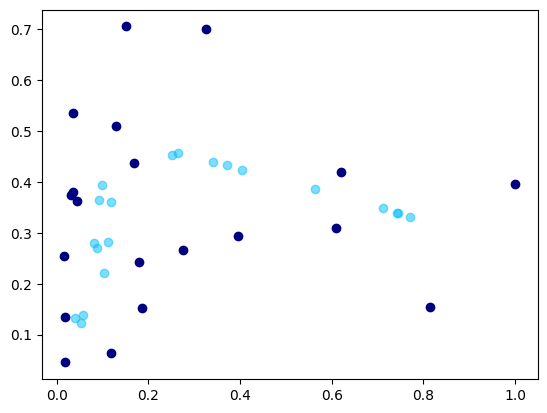

 88%|██████████████████████████████████████████████████████████████████████▎         | 879/1000 [02:35<00:20,  5.91it/s]

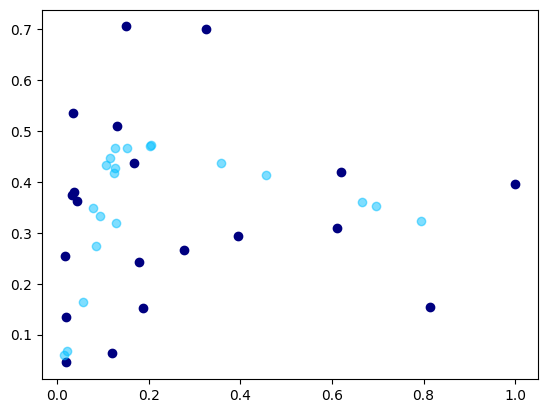

 88%|██████████████████████████████████████████████████████████████████████▍         | 880/1000 [02:35<00:20,  5.90it/s]

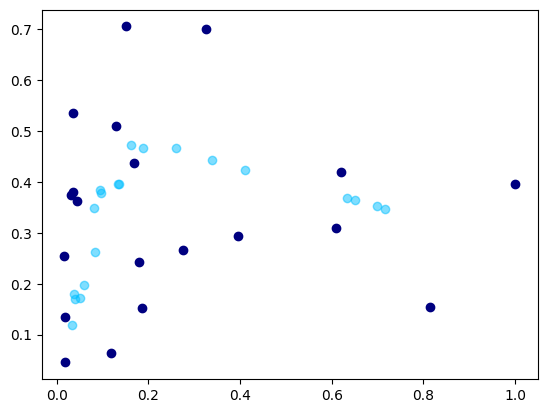

 88%|██████████████████████████████████████████████████████████████████████▍         | 881/1000 [02:35<00:21,  5.52it/s]

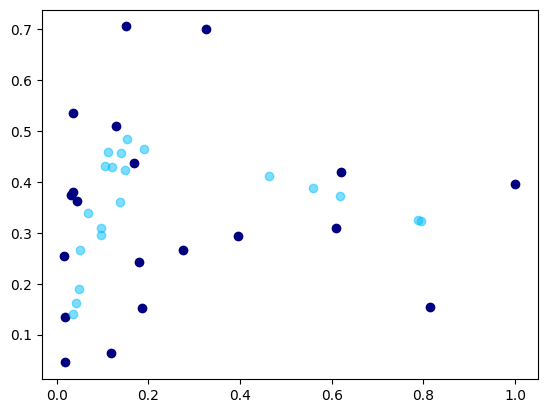

 88%|██████████████████████████████████████████████████████████████████████▌         | 882/1000 [02:35<00:21,  5.50it/s]

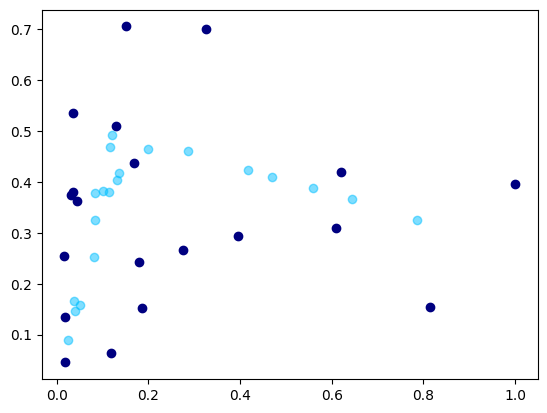

 88%|██████████████████████████████████████████████████████████████████████▋         | 883/1000 [02:35<00:20,  5.63it/s]

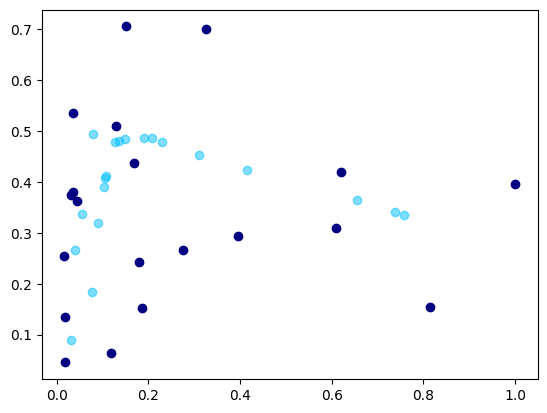

 88%|██████████████████████████████████████████████████████████████████████▋         | 884/1000 [02:35<00:20,  5.73it/s]

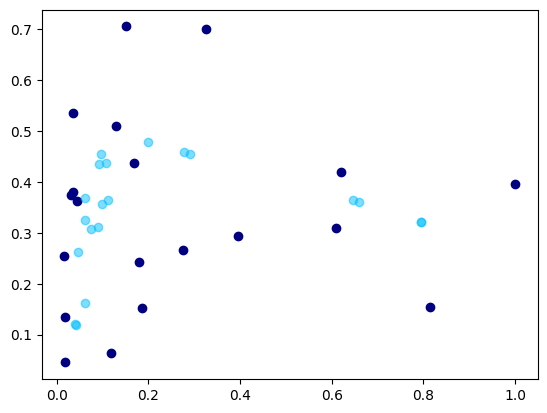

 88%|██████████████████████████████████████████████████████████████████████▊         | 885/1000 [02:36<00:20,  5.63it/s]

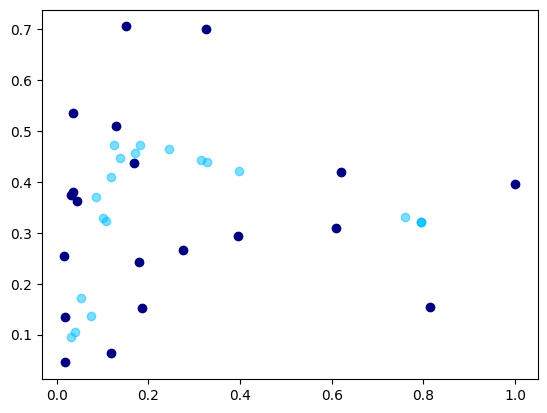

 89%|██████████████████████████████████████████████████████████████████████▉         | 886/1000 [02:36<00:20,  5.59it/s]

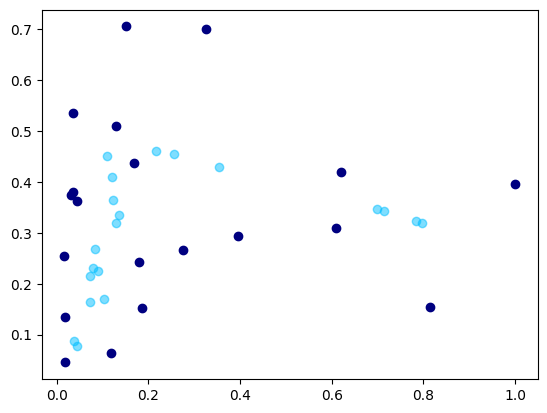

 89%|██████████████████████████████████████████████████████████████████████▉         | 887/1000 [02:36<00:20,  5.45it/s]

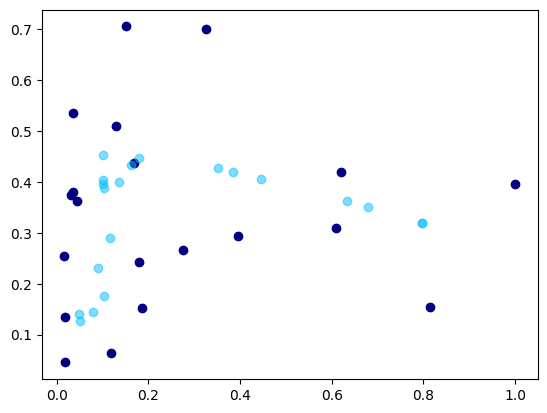

 89%|███████████████████████████████████████████████████████████████████████         | 888/1000 [02:36<00:19,  5.61it/s]

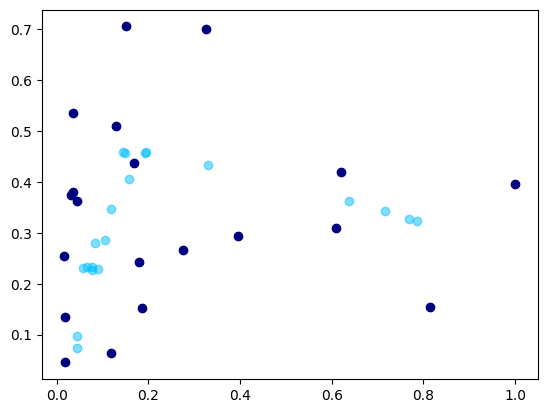

 89%|███████████████████████████████████████████████████████████████████████         | 889/1000 [02:36<00:19,  5.76it/s]

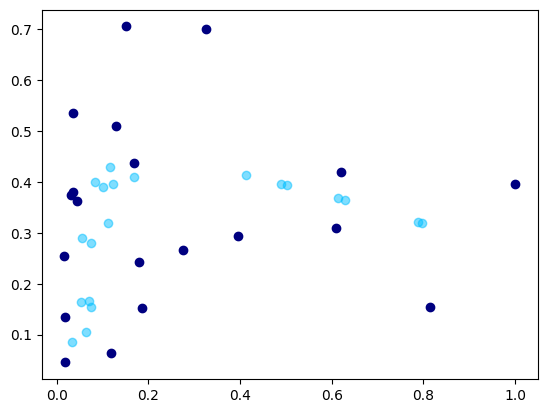

 89%|███████████████████████████████████████████████████████████████████████▏        | 890/1000 [02:37<00:18,  5.86it/s]

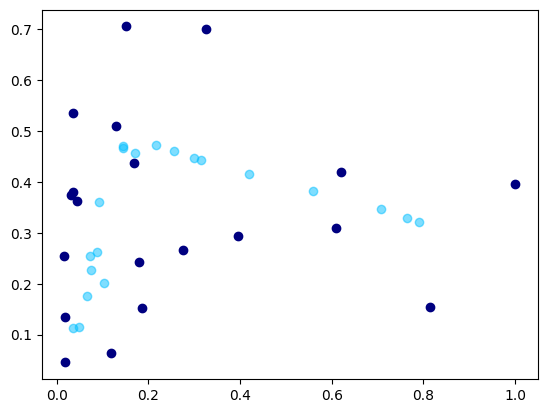

 89%|███████████████████████████████████████████████████████████████████████▎        | 891/1000 [02:37<00:18,  5.79it/s]

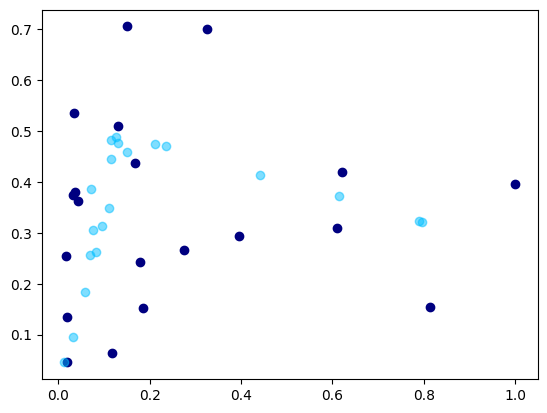

 89%|███████████████████████████████████████████████████████████████████████▎        | 892/1000 [02:37<00:18,  5.86it/s]

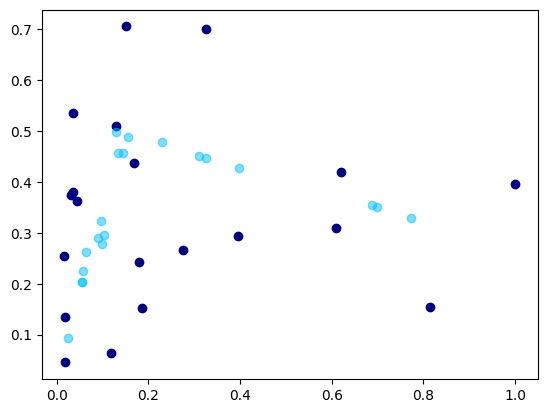

 89%|███████████████████████████████████████████████████████████████████████▍        | 893/1000 [02:37<00:18,  5.93it/s]

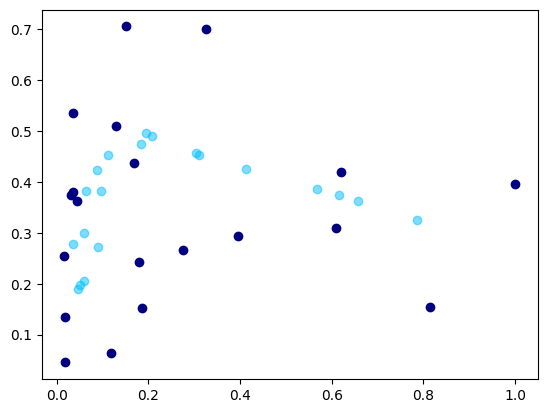

 89%|███████████████████████████████████████████████████████████████████████▌        | 894/1000 [02:37<00:17,  5.97it/s]

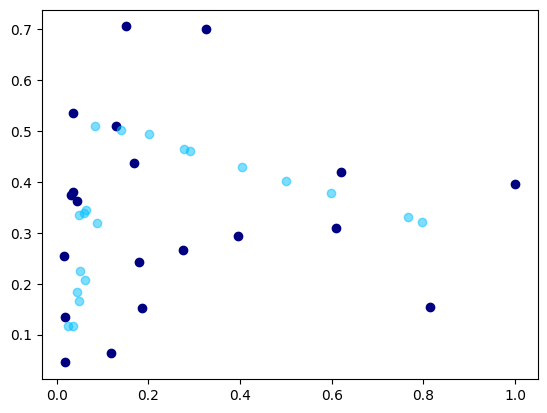

 90%|███████████████████████████████████████████████████████████████████████▌        | 895/1000 [02:37<00:17,  5.89it/s]

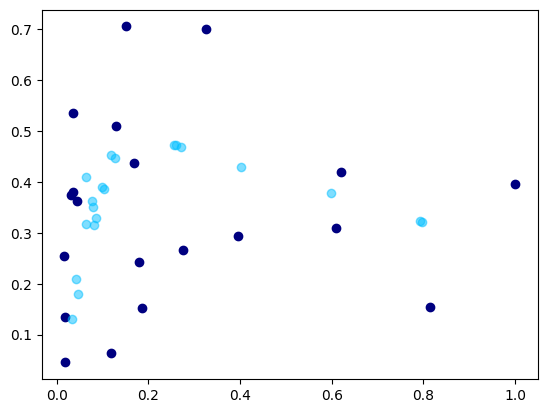

 90%|███████████████████████████████████████████████████████████████████████▋        | 896/1000 [02:38<00:17,  5.90it/s]

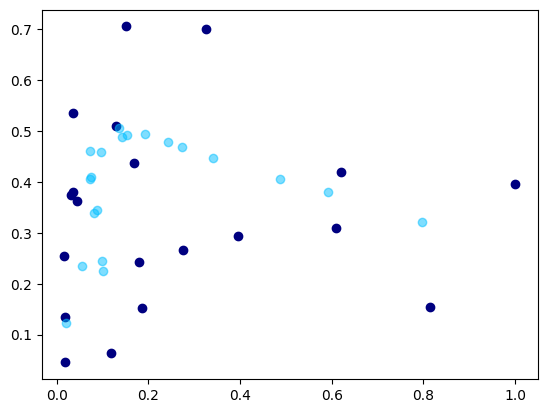

 90%|███████████████████████████████████████████████████████████████████████▊        | 897/1000 [02:38<00:17,  5.74it/s]

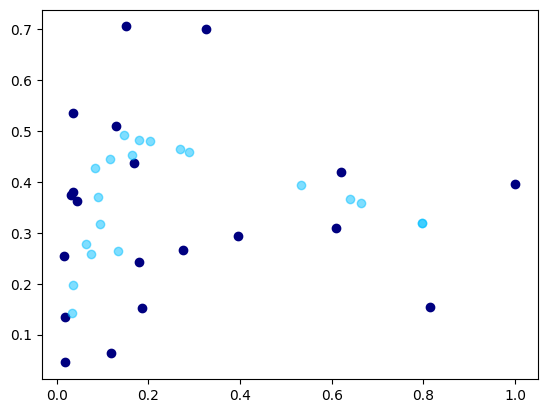

 90%|███████████████████████████████████████████████████████████████████████▊        | 898/1000 [02:38<00:17,  5.73it/s]

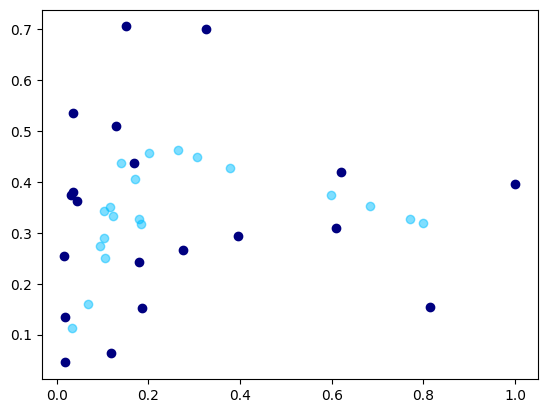

 90%|███████████████████████████████████████████████████████████████████████▉        | 899/1000 [02:38<00:17,  5.83it/s]

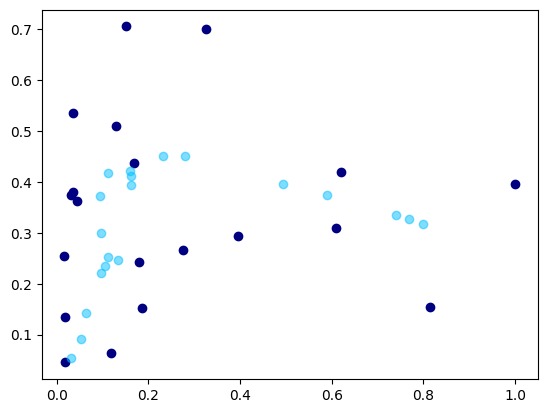

 90%|████████████████████████████████████████████████████████████████████████        | 900/1000 [02:38<00:17,  5.82it/s]

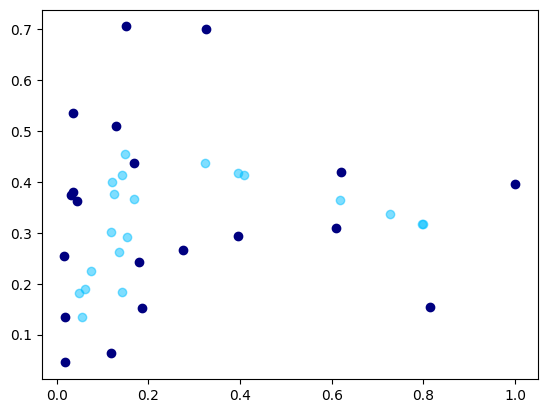

 90%|████████████████████████████████████████████████████████████████████████        | 901/1000 [02:38<00:16,  5.86it/s]

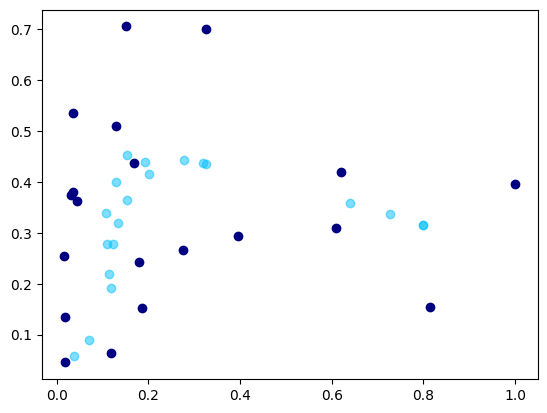

 90%|████████████████████████████████████████████████████████████████████████▏       | 902/1000 [02:39<00:16,  5.84it/s]

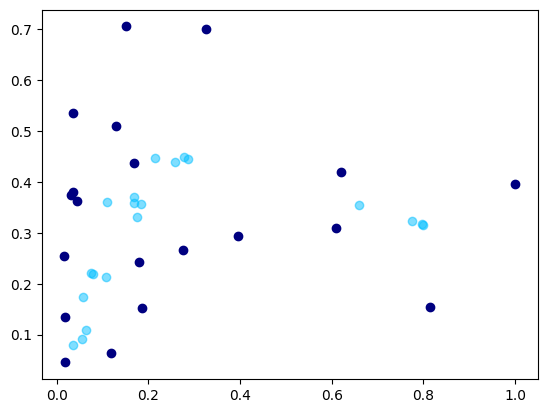

 90%|████████████████████████████████████████████████████████████████████████▏       | 903/1000 [02:39<00:16,  5.72it/s]

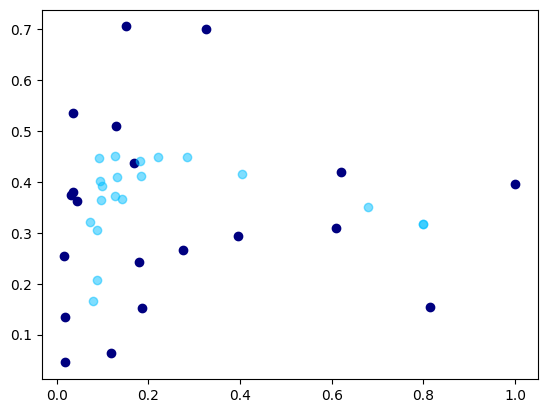

 90%|████████████████████████████████████████████████████████████████████████▎       | 904/1000 [02:39<00:16,  5.79it/s]

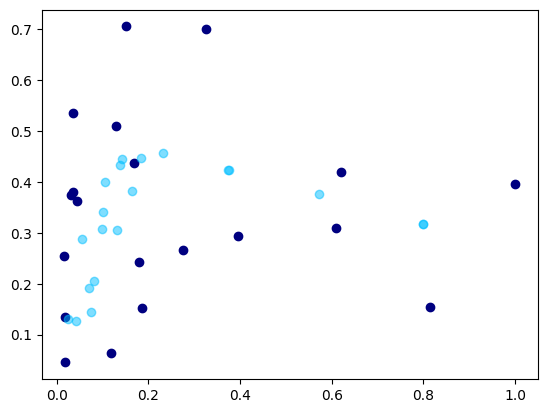

 90%|████████████████████████████████████████████████████████████████████████▍       | 905/1000 [02:39<00:16,  5.76it/s]

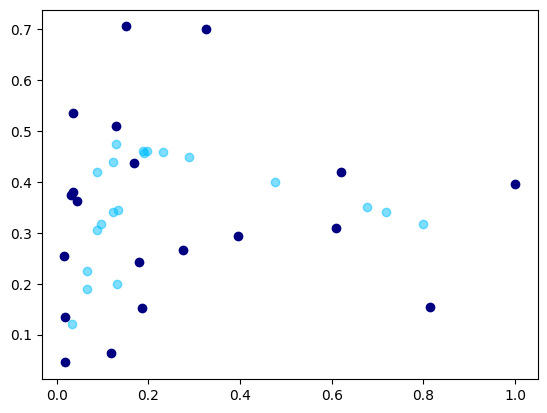

 91%|████████████████████████████████████████████████████████████████████████▍       | 906/1000 [02:39<00:16,  5.74it/s]

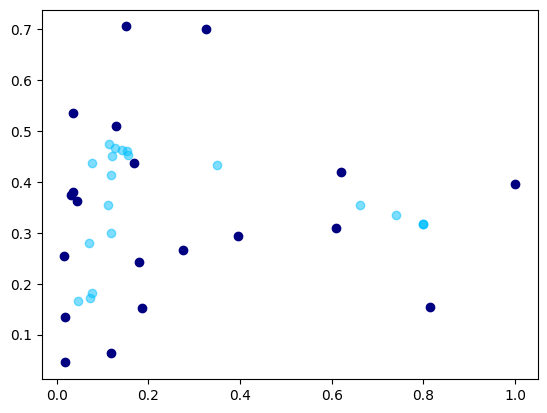

 91%|████████████████████████████████████████████████████████████████████████▌       | 907/1000 [02:39<00:16,  5.81it/s]

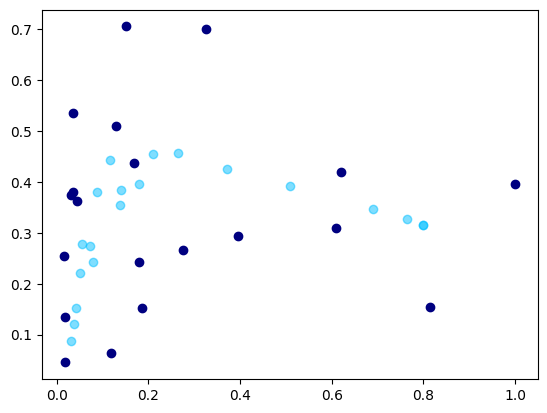

 91%|████████████████████████████████████████████████████████████████████████▋       | 908/1000 [02:40<00:15,  5.89it/s]

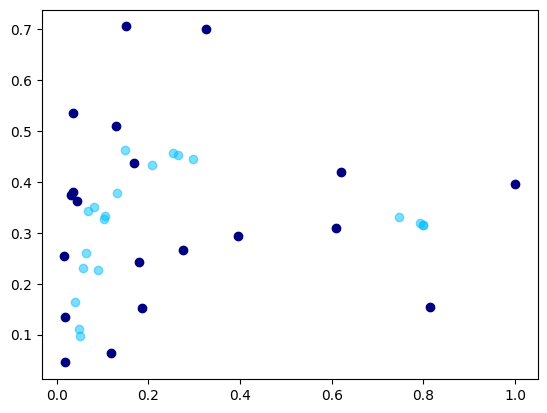

 91%|████████████████████████████████████████████████████████████████████████▋       | 909/1000 [02:40<00:15,  5.90it/s]

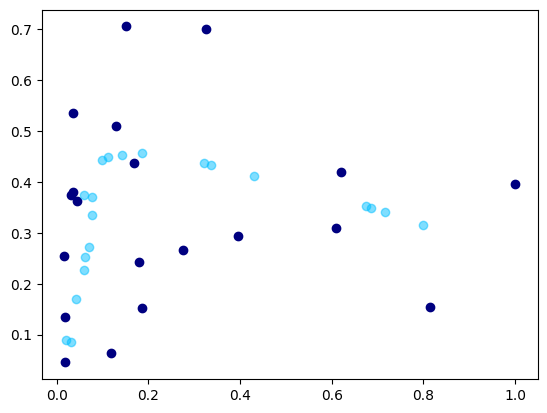

 91%|████████████████████████████████████████████████████████████████████████▊       | 910/1000 [02:40<00:15,  5.97it/s]

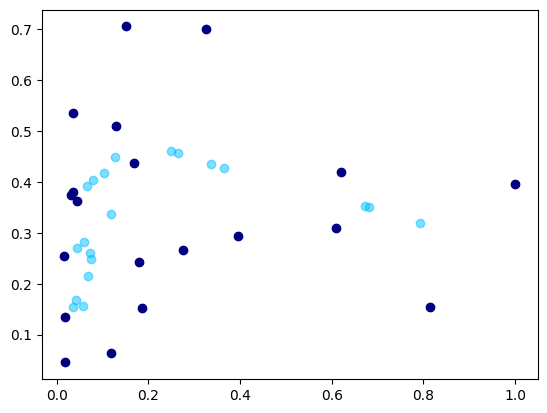

 91%|████████████████████████████████████████████████████████████████████████▉       | 911/1000 [02:40<00:15,  5.91it/s]

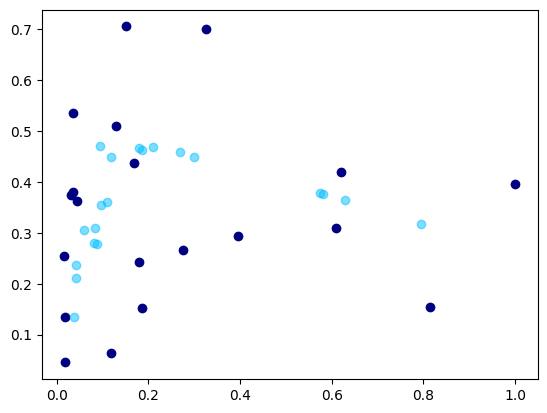

 91%|████████████████████████████████████████████████████████████████████████▉       | 912/1000 [02:40<00:15,  5.62it/s]

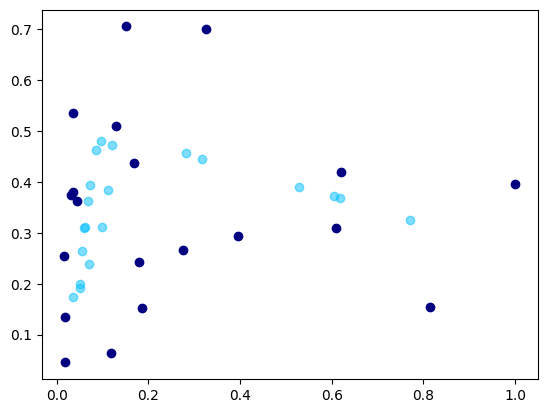

 91%|█████████████████████████████████████████████████████████████████████████       | 913/1000 [02:40<00:15,  5.71it/s]

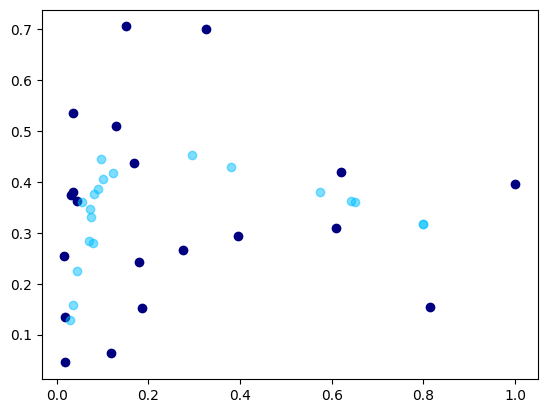

 91%|█████████████████████████████████████████████████████████████████████████       | 914/1000 [02:41<00:14,  5.82it/s]

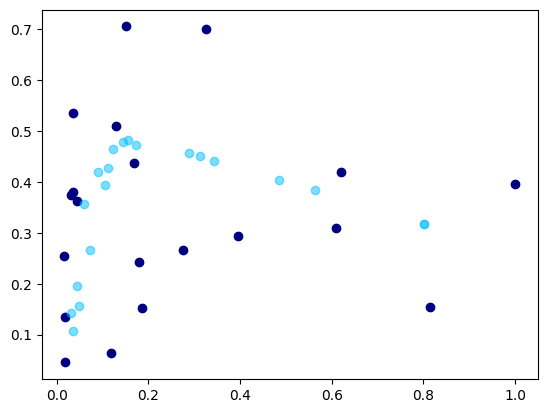

 92%|█████████████████████████████████████████████████████████████████████████▏      | 915/1000 [02:41<00:14,  5.86it/s]

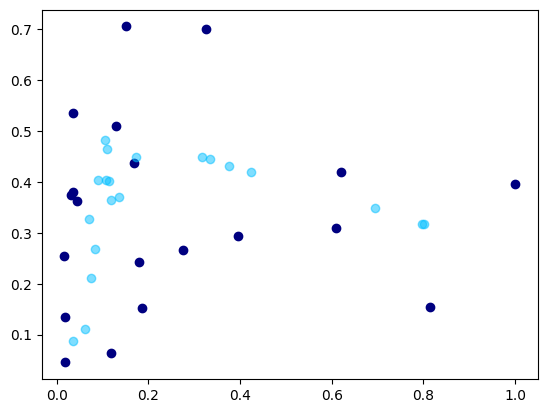

 92%|█████████████████████████████████████████████████████████████████████████▎      | 916/1000 [02:41<00:14,  5.93it/s]

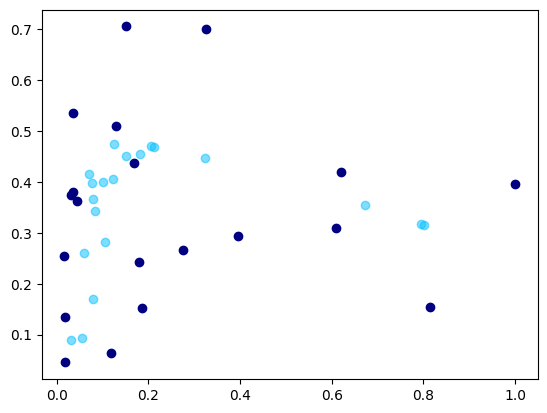

 92%|█████████████████████████████████████████████████████████████████████████▎      | 917/1000 [02:41<00:14,  5.91it/s]

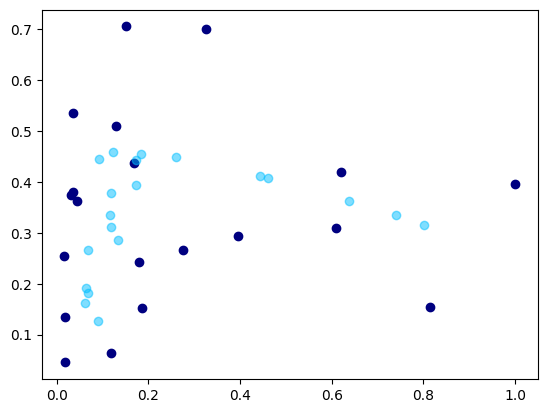

 92%|█████████████████████████████████████████████████████████████████████████▍      | 918/1000 [02:41<00:14,  5.85it/s]

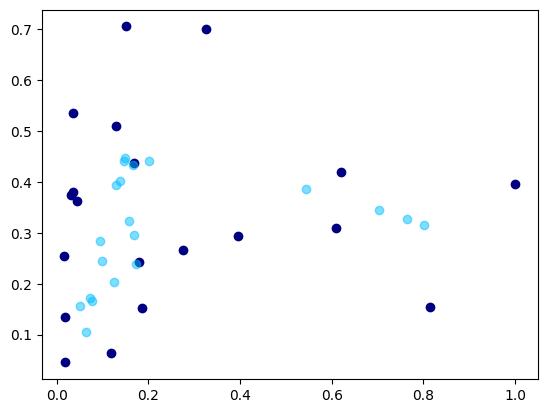

 92%|█████████████████████████████████████████████████████████████████████████▌      | 919/1000 [02:41<00:13,  5.93it/s]

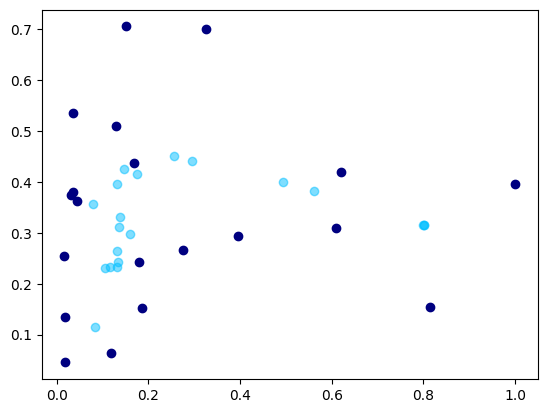

 92%|█████████████████████████████████████████████████████████████████████████▌      | 920/1000 [02:42<00:13,  5.91it/s]

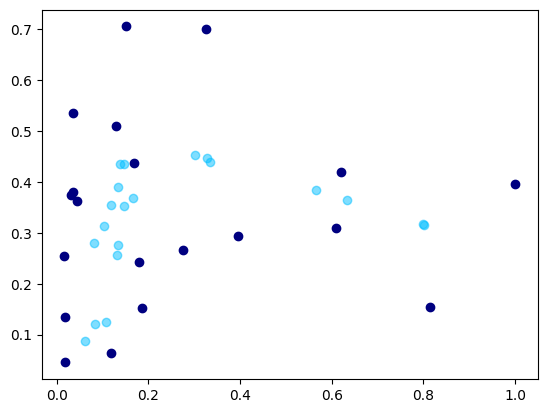

 92%|█████████████████████████████████████████████████████████████████████████▋      | 921/1000 [02:42<00:13,  5.89it/s]

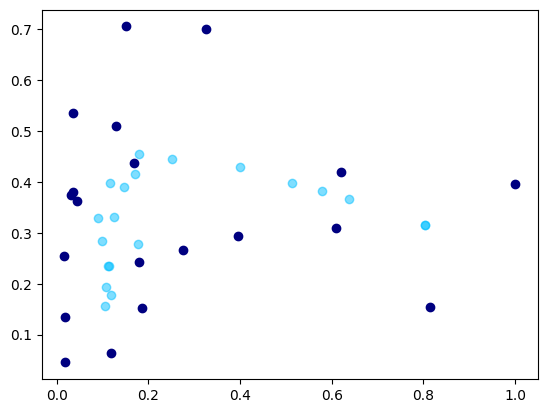

 92%|█████████████████████████████████████████████████████████████████████████▊      | 922/1000 [02:42<00:13,  5.95it/s]

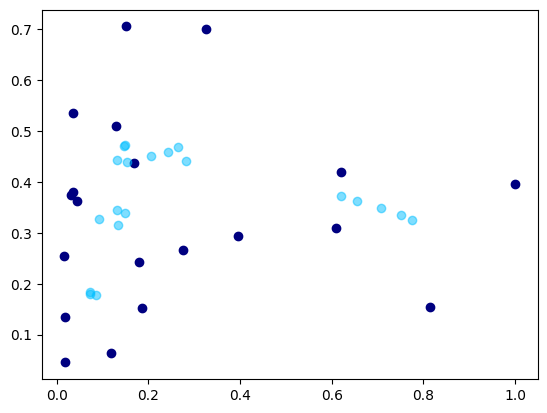

 92%|█████████████████████████████████████████████████████████████████████████▊      | 923/1000 [02:42<00:12,  5.95it/s]

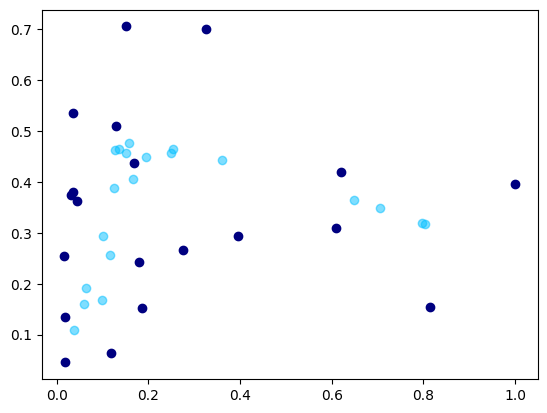

 92%|█████████████████████████████████████████████████████████████████████████▉      | 924/1000 [02:42<00:12,  5.96it/s]

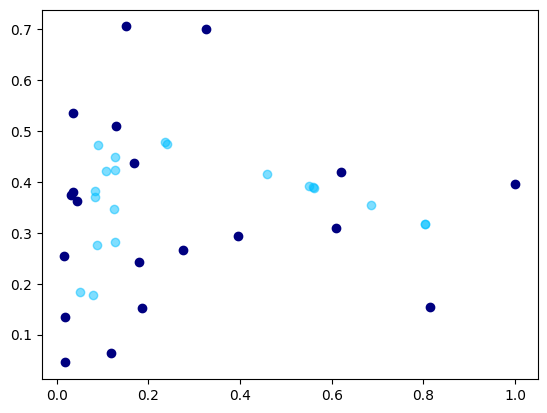

 92%|██████████████████████████████████████████████████████████████████████████      | 925/1000 [02:42<00:12,  5.96it/s]

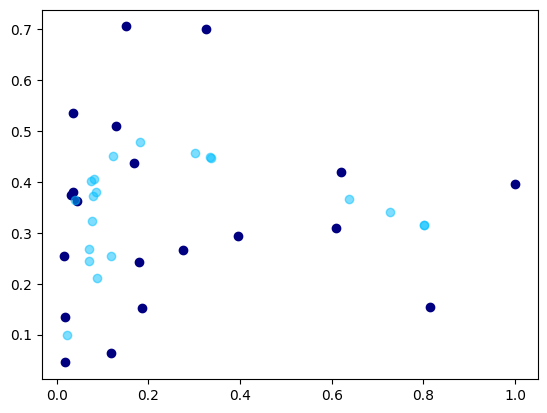

 93%|██████████████████████████████████████████████████████████████████████████      | 926/1000 [02:43<00:12,  5.87it/s]

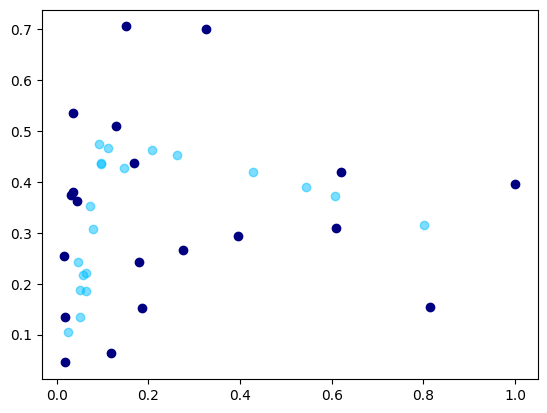

 93%|██████████████████████████████████████████████████████████████████████████▏     | 927/1000 [02:43<00:12,  5.93it/s]

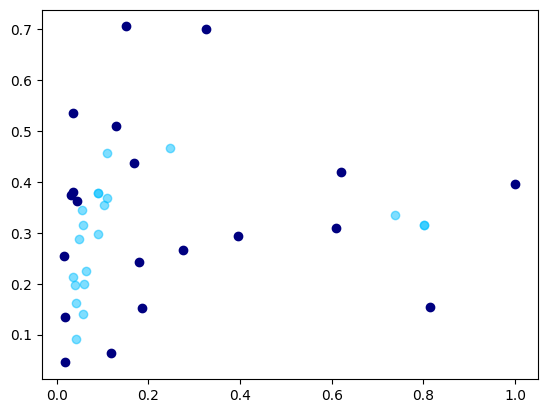

 93%|██████████████████████████████████████████████████████████████████████████▏     | 928/1000 [02:43<00:12,  5.92it/s]

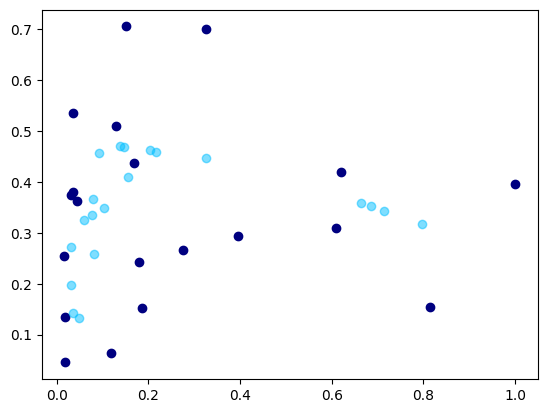

 93%|██████████████████████████████████████████████████████████████████████████▎     | 929/1000 [02:43<00:12,  5.88it/s]

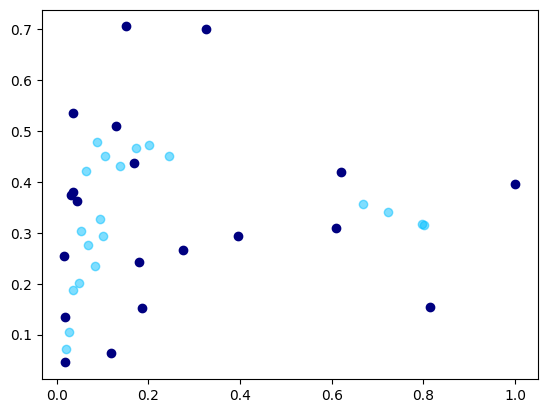

 93%|██████████████████████████████████████████████████████████████████████████▍     | 930/1000 [02:43<00:11,  5.93it/s]

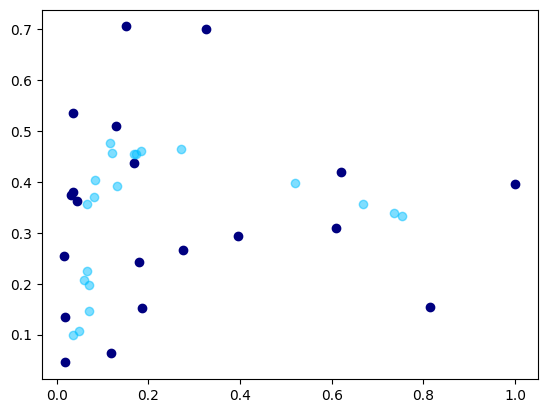

 93%|██████████████████████████████████████████████████████████████████████████▍     | 931/1000 [02:43<00:11,  5.95it/s]

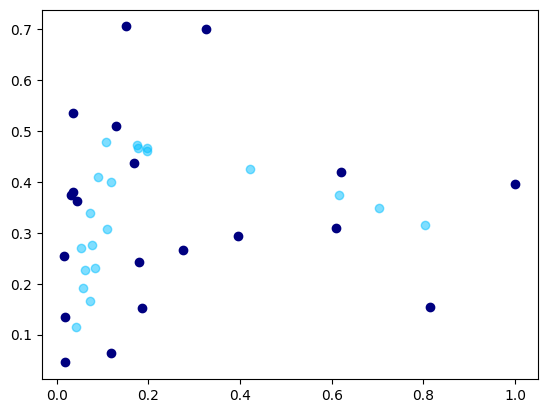

 93%|██████████████████████████████████████████████████████████████████████████▌     | 932/1000 [02:44<00:11,  5.72it/s]

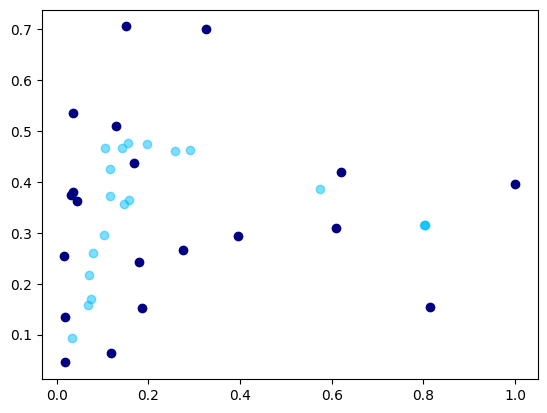

 93%|██████████████████████████████████████████████████████████████████████████▋     | 933/1000 [02:44<00:11,  5.80it/s]

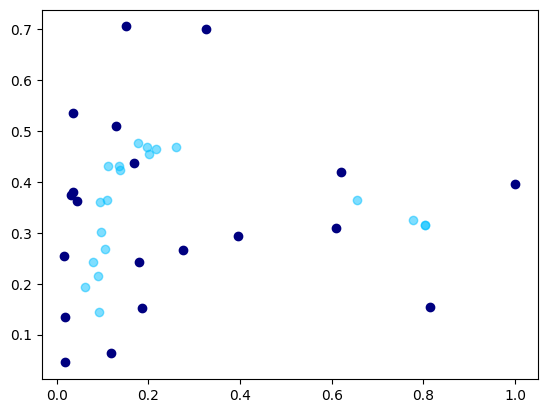

 93%|██████████████████████████████████████████████████████████████████████████▋     | 934/1000 [02:44<00:11,  5.83it/s]

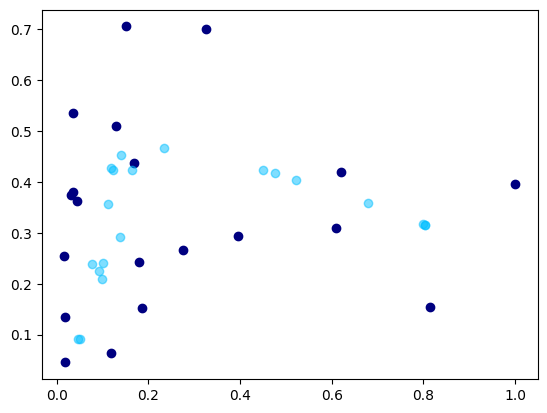

 94%|██████████████████████████████████████████████████████████████████████████▊     | 935/1000 [02:44<00:11,  5.66it/s]

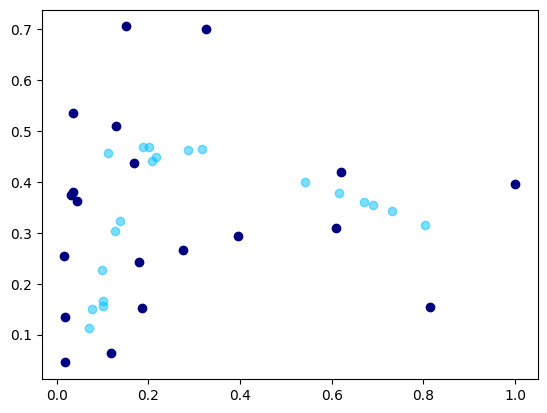

 94%|██████████████████████████████████████████████████████████████████████████▉     | 936/1000 [02:44<00:11,  5.76it/s]

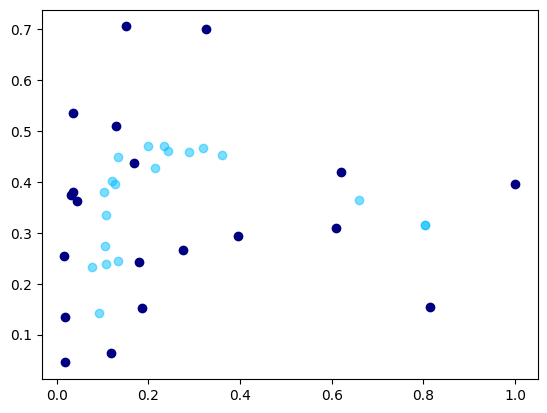

 94%|██████████████████████████████████████████████████████████████████████████▉     | 937/1000 [02:45<00:10,  5.87it/s]

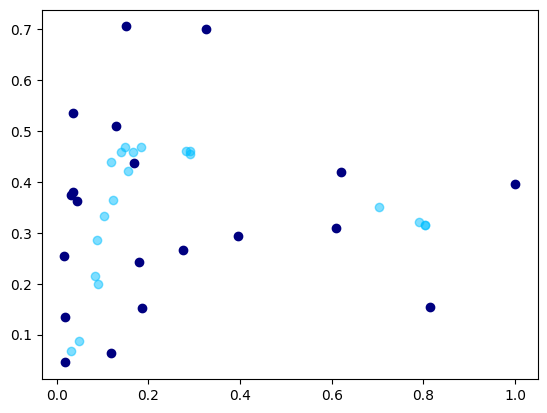

 94%|███████████████████████████████████████████████████████████████████████████     | 938/1000 [02:45<00:10,  5.76it/s]

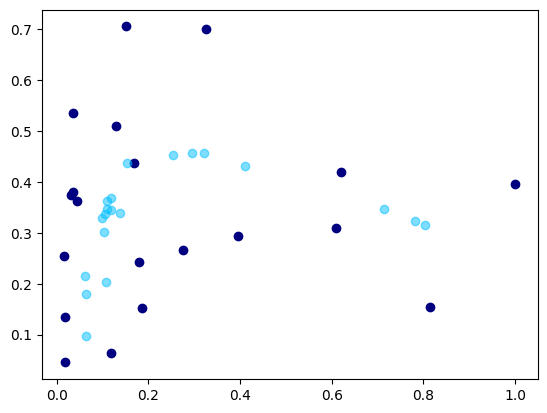

 94%|███████████████████████████████████████████████████████████████████████████     | 939/1000 [02:45<00:10,  5.83it/s]

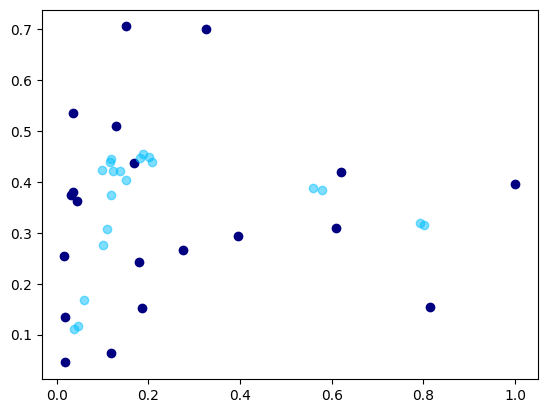

 94%|███████████████████████████████████████████████████████████████████████████▏    | 940/1000 [02:45<00:10,  5.83it/s]

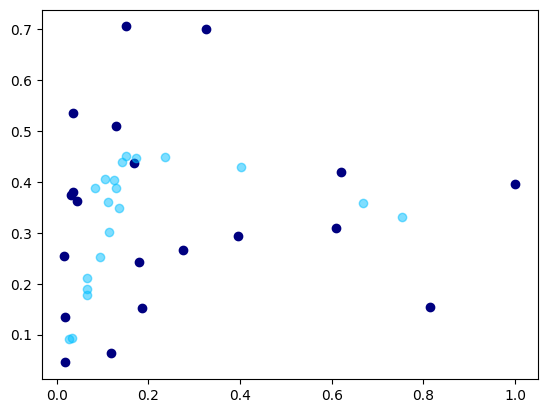

 94%|███████████████████████████████████████████████████████████████████████████▎    | 941/1000 [02:45<00:09,  5.93it/s]

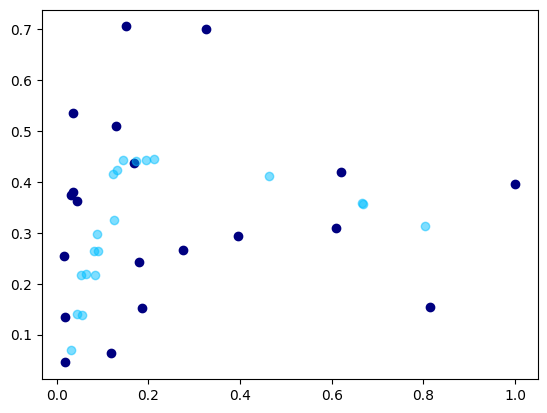

 94%|███████████████████████████████████████████████████████████████████████████▎    | 942/1000 [02:45<00:09,  5.94it/s]

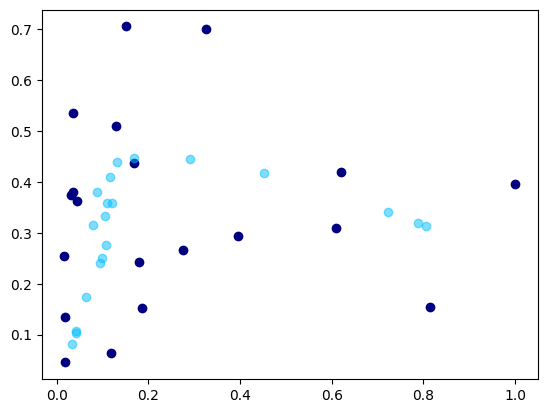

 94%|███████████████████████████████████████████████████████████████████████████▍    | 943/1000 [02:46<00:09,  5.92it/s]

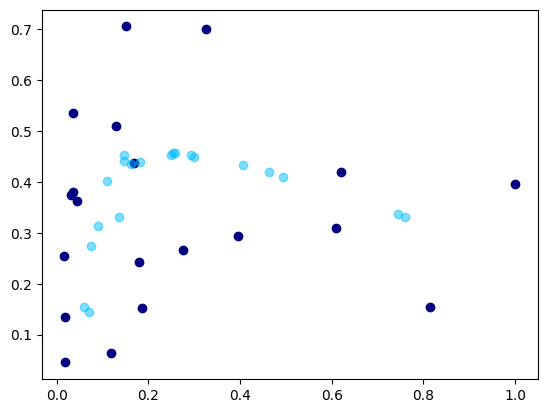

 94%|███████████████████████████████████████████████████████████████████████████▌    | 944/1000 [02:46<00:09,  5.90it/s]

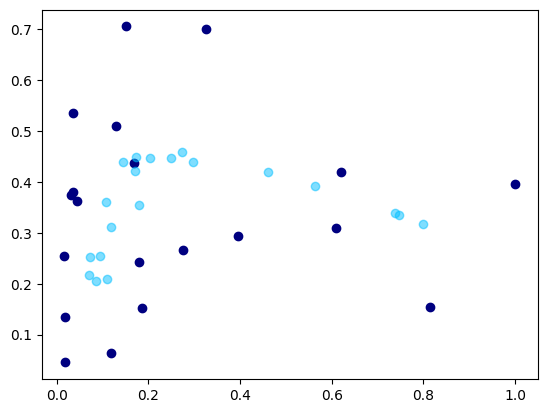

 94%|███████████████████████████████████████████████████████████████████████████▌    | 945/1000 [02:46<00:09,  5.89it/s]

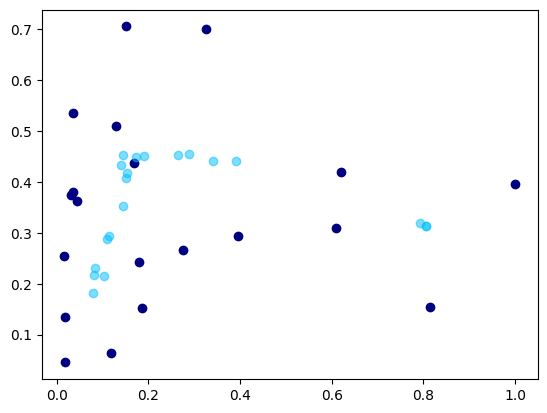

 95%|███████████████████████████████████████████████████████████████████████████▋    | 946/1000 [02:46<00:09,  5.96it/s]

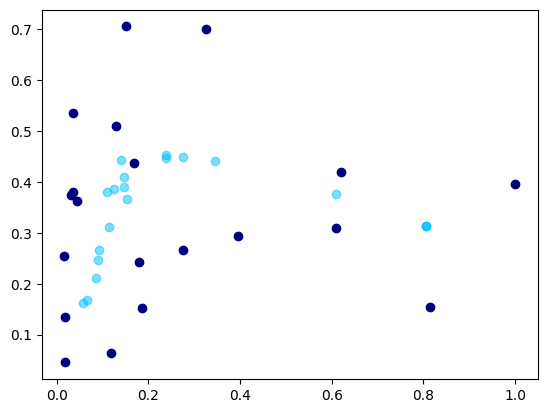

 95%|███████████████████████████████████████████████████████████████████████████▊    | 947/1000 [02:46<00:09,  5.64it/s]

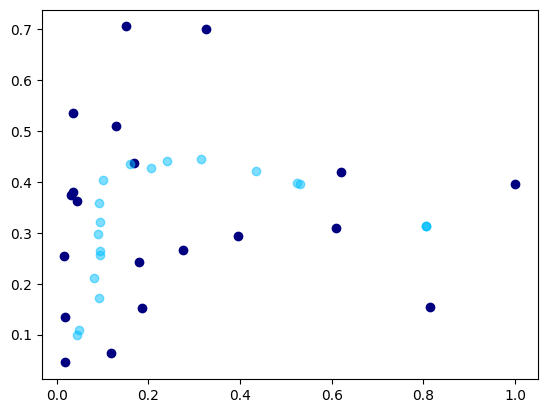

 95%|███████████████████████████████████████████████████████████████████████████▊    | 948/1000 [02:46<00:09,  5.73it/s]

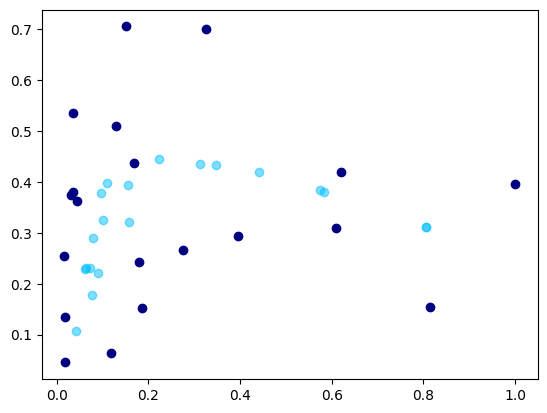

 95%|███████████████████████████████████████████████████████████████████████████▉    | 949/1000 [02:47<00:08,  5.85it/s]

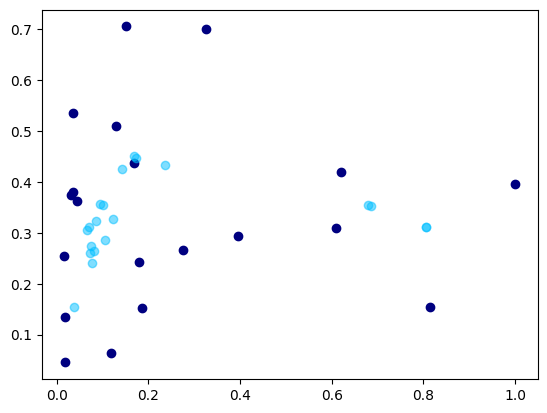

 95%|████████████████████████████████████████████████████████████████████████████    | 950/1000 [02:47<00:08,  5.94it/s]

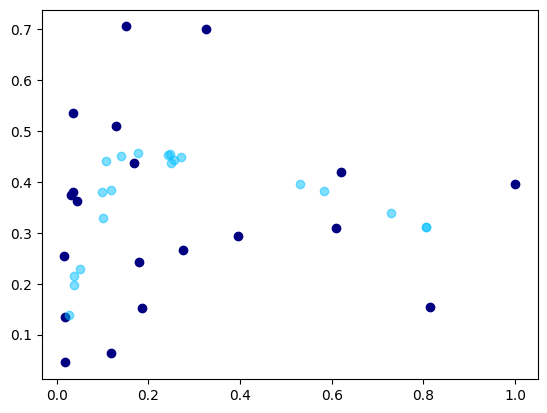

 95%|████████████████████████████████████████████████████████████████████████████    | 951/1000 [02:47<00:08,  5.98it/s]

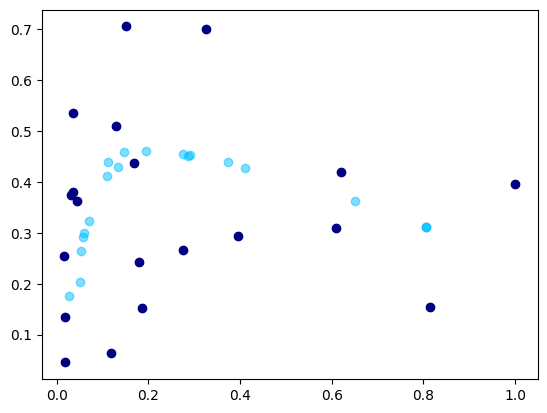

 95%|████████████████████████████████████████████████████████████████████████████▏   | 952/1000 [02:47<00:07,  6.03it/s]

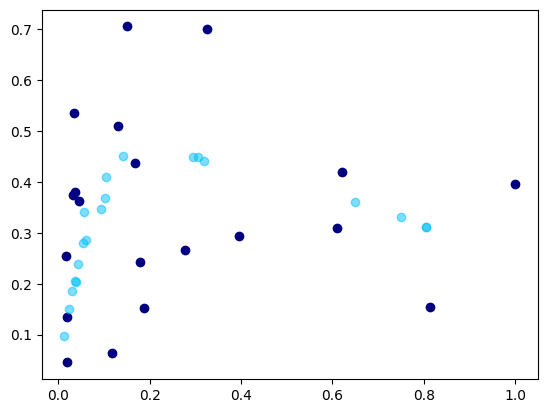

 95%|████████████████████████████████████████████████████████████████████████████▏   | 953/1000 [02:47<00:07,  5.94it/s]

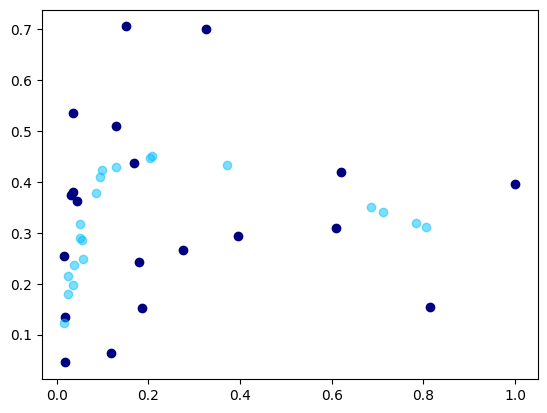

 95%|████████████████████████████████████████████████████████████████████████████▎   | 954/1000 [02:47<00:07,  5.84it/s]

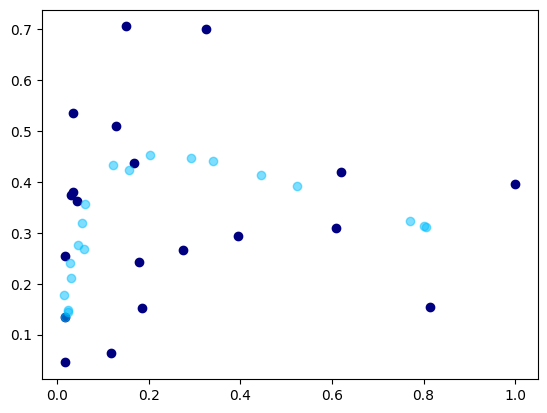

 96%|████████████████████████████████████████████████████████████████████████████▍   | 955/1000 [02:48<00:07,  5.90it/s]

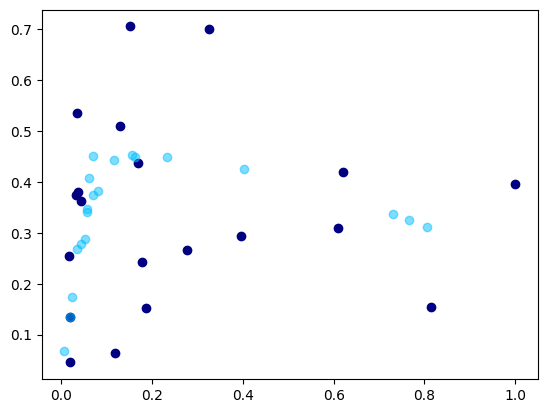

 96%|████████████████████████████████████████████████████████████████████████████▍   | 956/1000 [02:48<00:07,  5.96it/s]

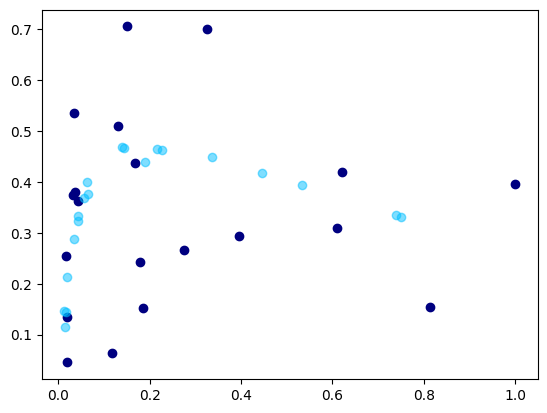

 96%|████████████████████████████████████████████████████████████████████████████▌   | 957/1000 [02:48<00:07,  5.90it/s]

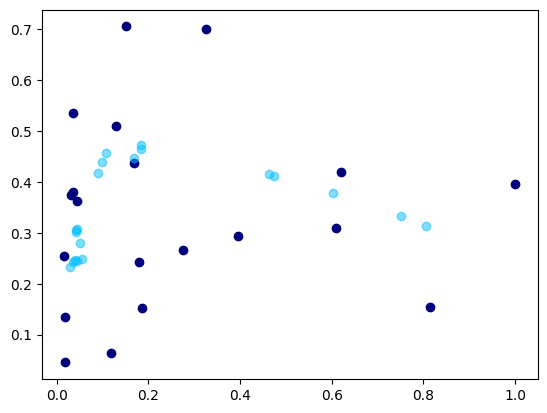

 96%|████████████████████████████████████████████████████████████████████████████▋   | 958/1000 [02:48<00:07,  5.97it/s]

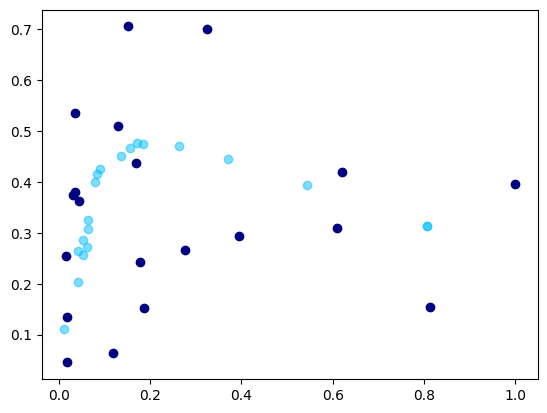

 96%|████████████████████████████████████████████████████████████████████████████▋   | 959/1000 [02:48<00:07,  5.73it/s]

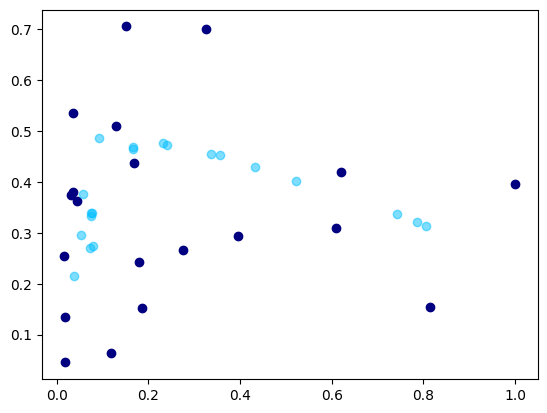

 96%|████████████████████████████████████████████████████████████████████████████▊   | 960/1000 [02:48<00:06,  5.80it/s]

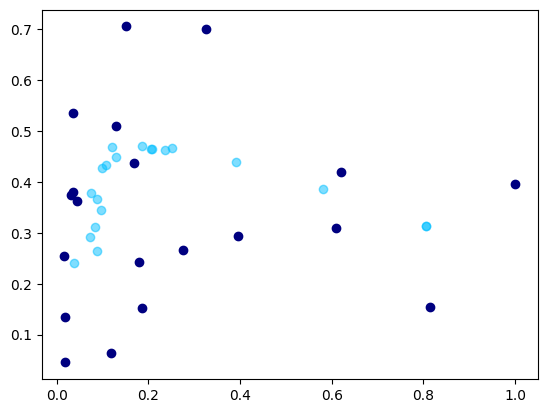

 96%|████████████████████████████████████████████████████████████████████████████▉   | 961/1000 [02:49<00:06,  5.83it/s]

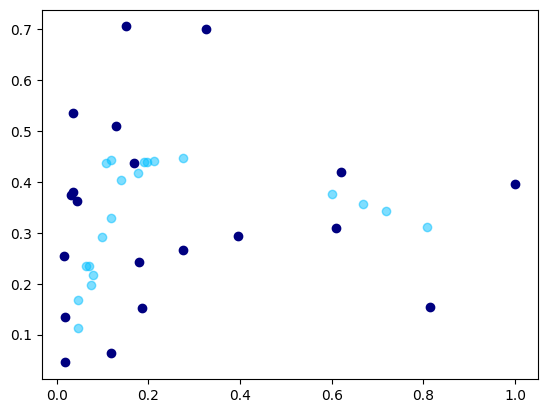

 96%|████████████████████████████████████████████████████████████████████████████▉   | 962/1000 [02:49<00:06,  5.87it/s]

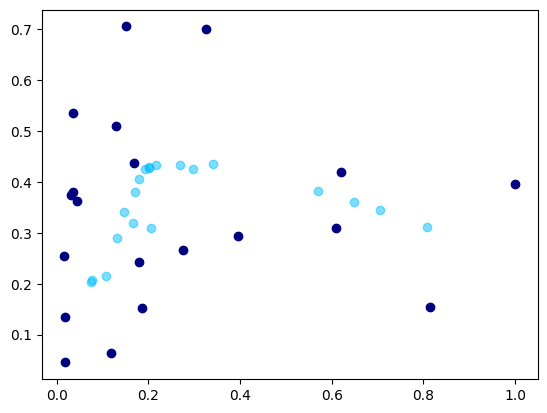

 96%|█████████████████████████████████████████████████████████████████████████████   | 963/1000 [02:49<00:06,  5.85it/s]

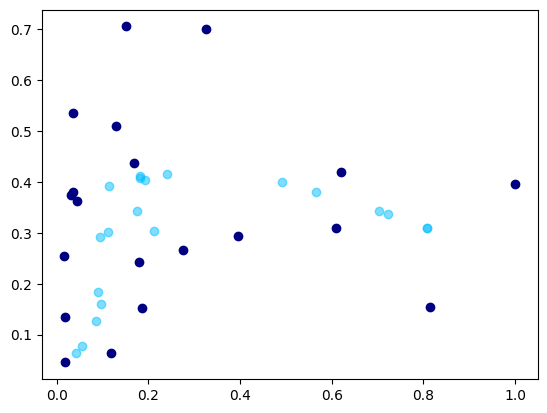

 96%|█████████████████████████████████████████████████████████████████████████████   | 964/1000 [02:49<00:06,  5.90it/s]

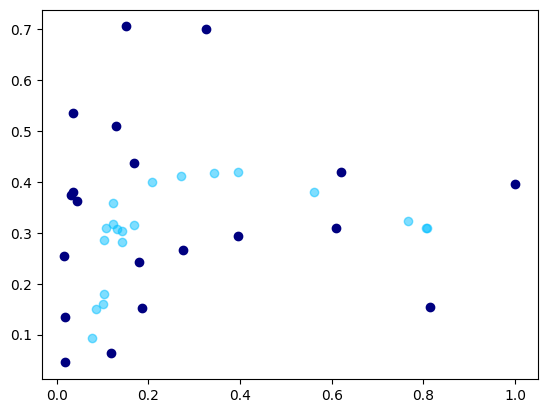

 96%|█████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [02:49<00:05,  5.91it/s]

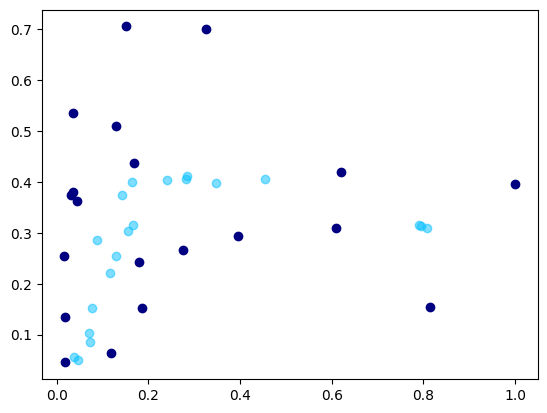

 97%|█████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [02:49<00:05,  5.96it/s]

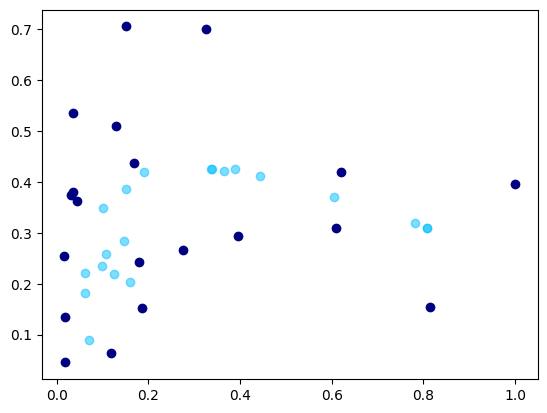

 97%|█████████████████████████████████████████████████████████████████████████████▎  | 967/1000 [02:50<00:05,  5.92it/s]

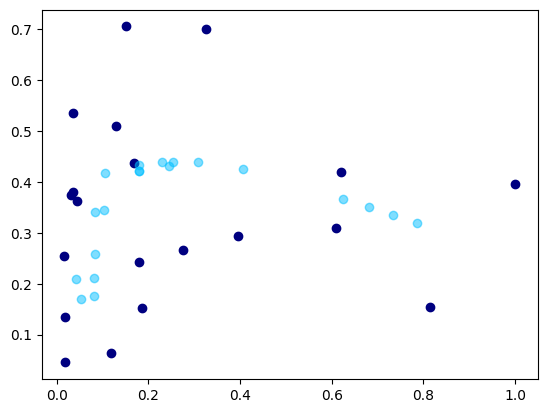

 97%|█████████████████████████████████████████████████████████████████████████████▍  | 968/1000 [02:50<00:05,  5.97it/s]

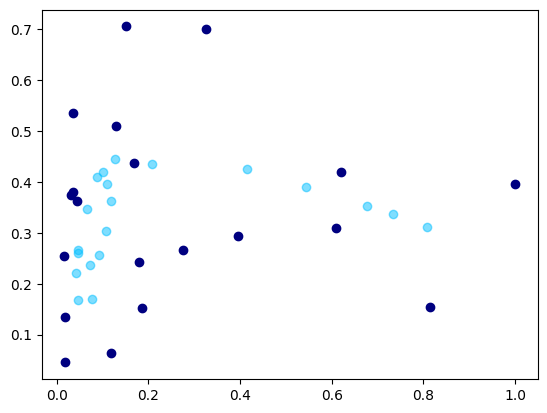

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [02:50<00:05,  5.95it/s]

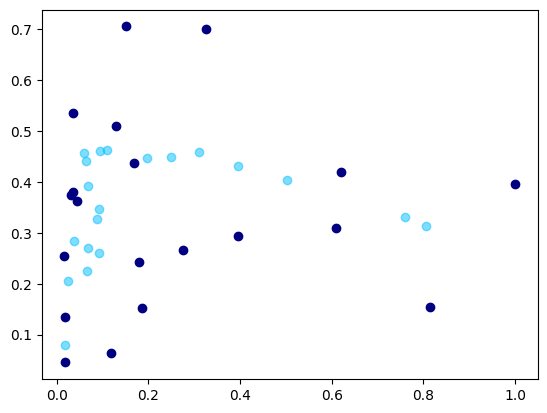

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 970/1000 [02:50<00:05,  5.95it/s]

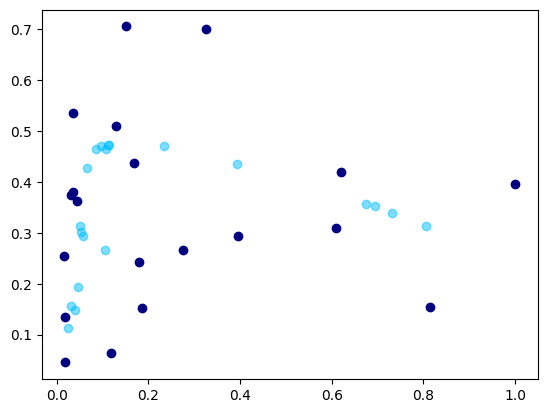

 97%|█████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [02:50<00:04,  5.95it/s]

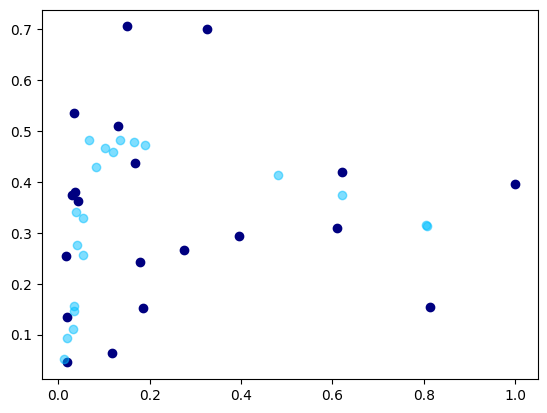

 97%|█████████████████████████████████████████████████████████████████████████████▊  | 972/1000 [02:50<00:04,  5.86it/s]

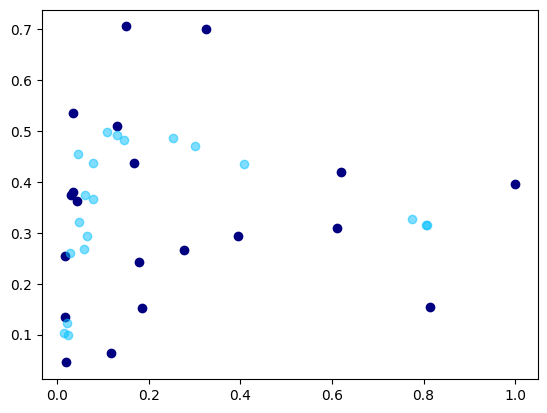

 97%|█████████████████████████████████████████████████████████████████████████████▊  | 973/1000 [02:51<00:04,  5.87it/s]

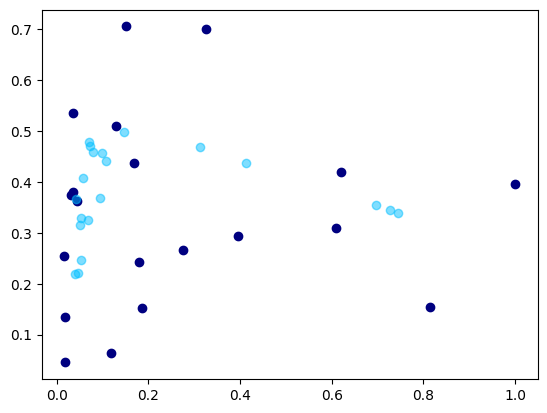

 97%|█████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [02:51<00:04,  5.87it/s]

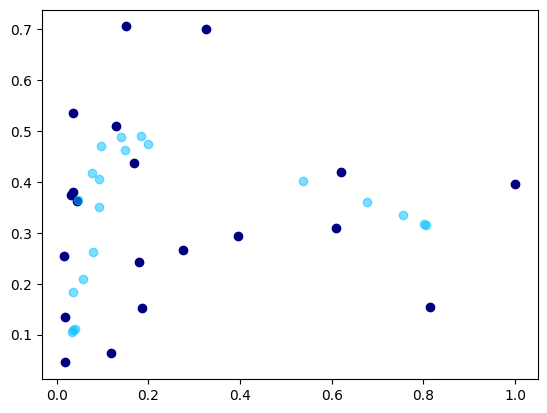

 98%|██████████████████████████████████████████████████████████████████████████████  | 975/1000 [02:51<00:04,  5.91it/s]

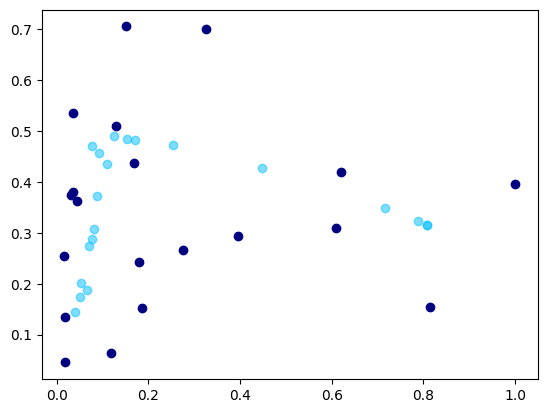

 98%|██████████████████████████████████████████████████████████████████████████████  | 976/1000 [02:52<00:07,  3.27it/s]

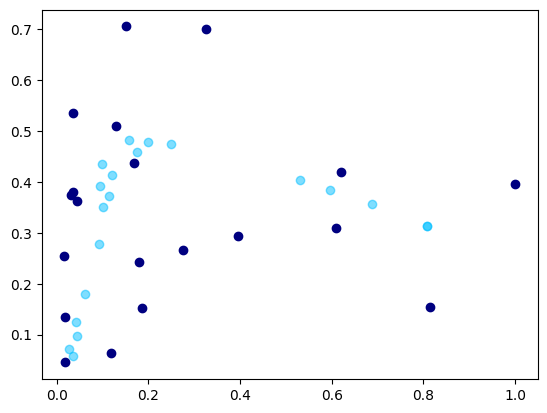

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [02:52<00:06,  3.77it/s]

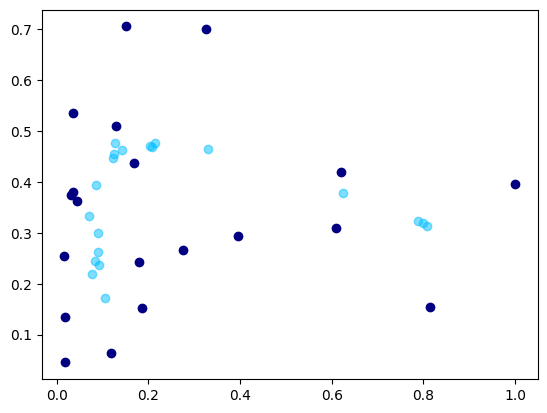

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 978/1000 [02:52<00:05,  4.21it/s]

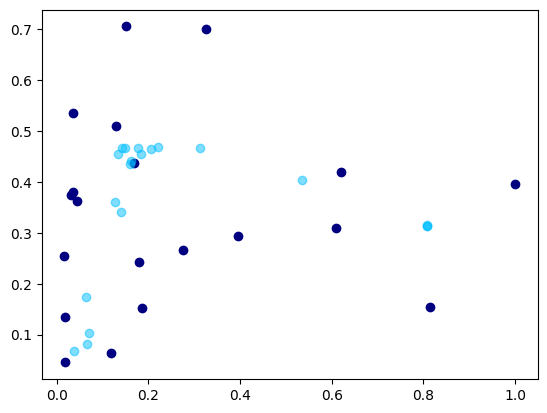

 98%|██████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [02:52<00:04,  4.61it/s]

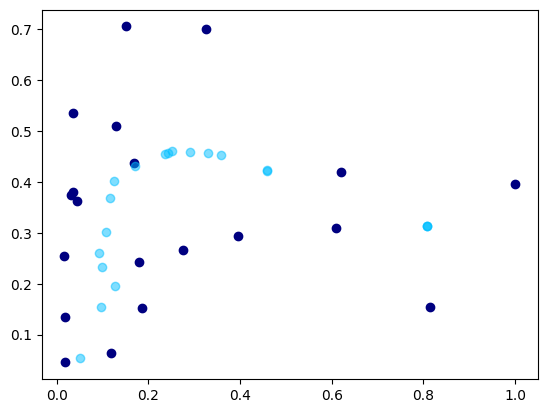

 98%|██████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [02:52<00:04,  4.97it/s]

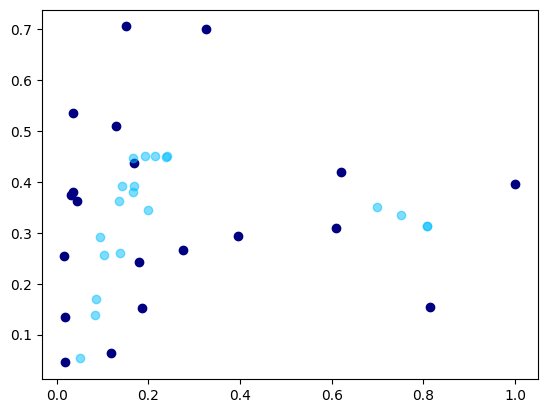

 98%|██████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [02:52<00:03,  5.24it/s]

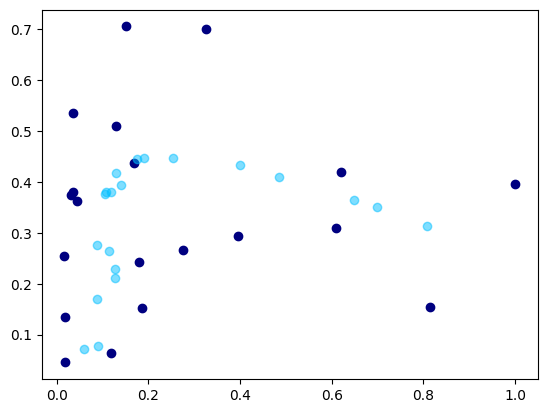

 98%|██████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [02:53<00:03,  5.31it/s]

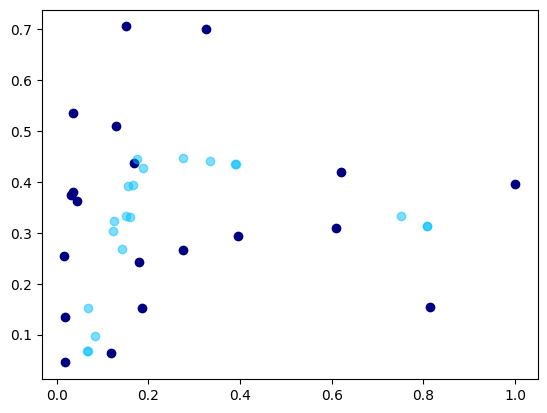

 98%|██████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [02:53<00:03,  5.48it/s]

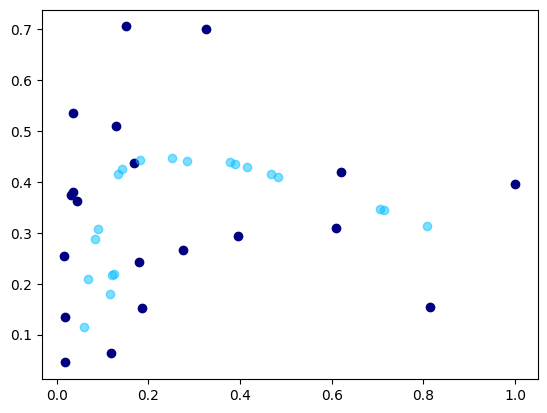

 98%|██████████████████████████████████████████████████████████████████████████████▋ | 984/1000 [02:53<00:02,  5.56it/s]

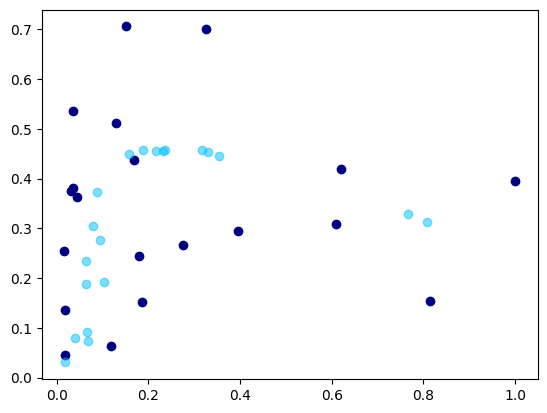

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [02:53<00:02,  5.63it/s]

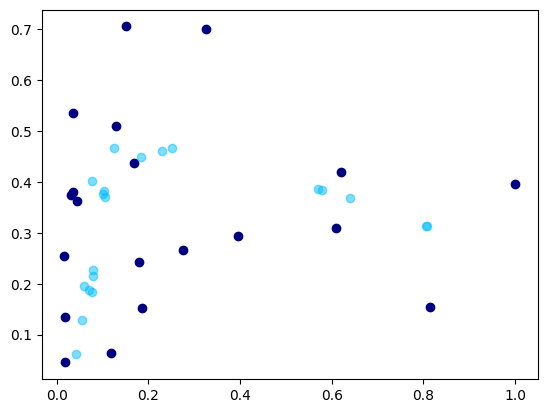

 99%|██████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [02:53<00:02,  5.49it/s]

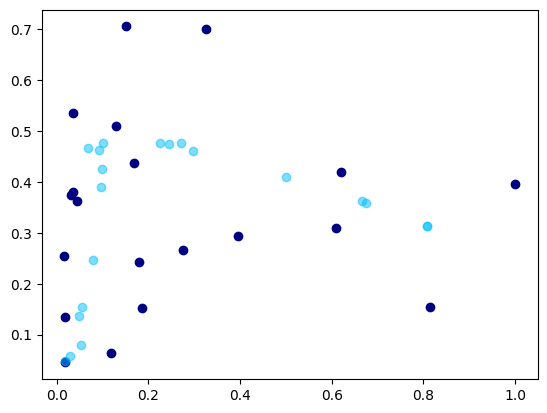

 99%|██████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [02:54<00:02,  5.65it/s]

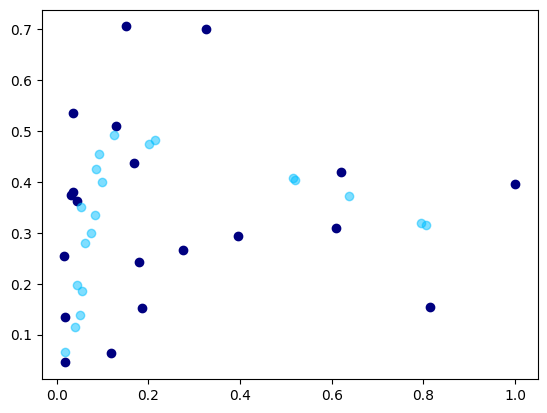

 99%|███████████████████████████████████████████████████████████████████████████████ | 988/1000 [02:54<00:02,  5.79it/s]

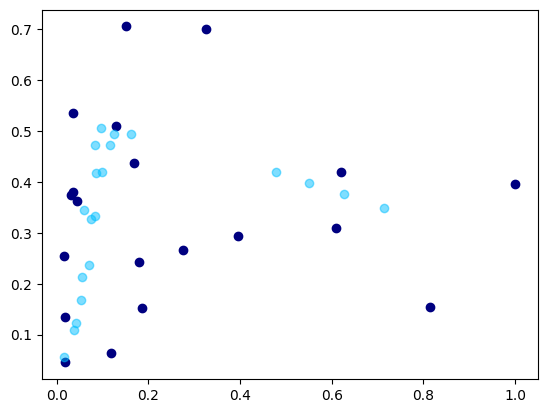

 99%|███████████████████████████████████████████████████████████████████████████████ | 989/1000 [02:54<00:01,  5.84it/s]

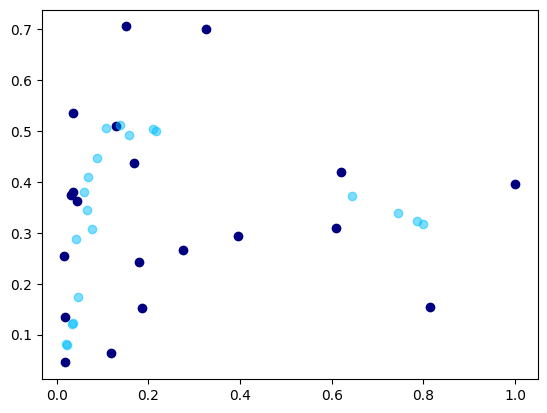

 99%|███████████████████████████████████████████████████████████████████████████████▏| 990/1000 [02:54<00:01,  5.88it/s]

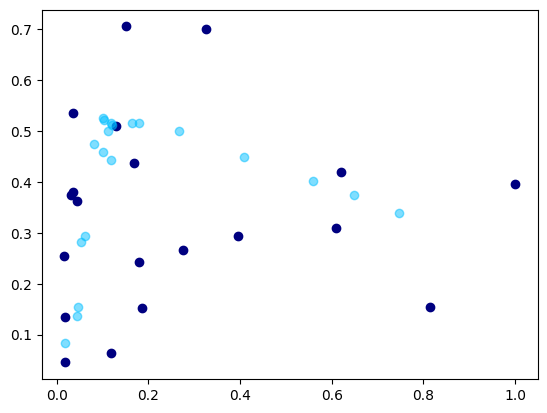

 99%|███████████████████████████████████████████████████████████████████████████████▎| 991/1000 [02:54<00:01,  5.93it/s]

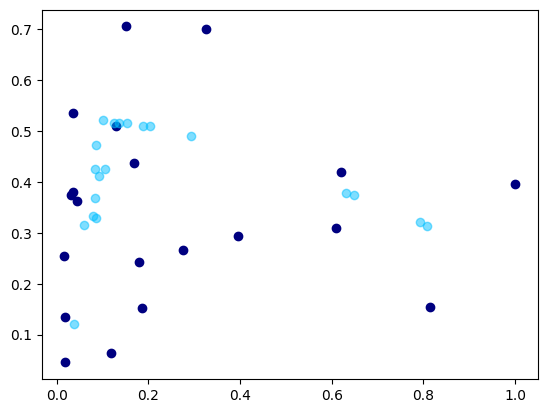

 99%|███████████████████████████████████████████████████████████████████████████████▎| 992/1000 [02:54<00:01,  6.00it/s]

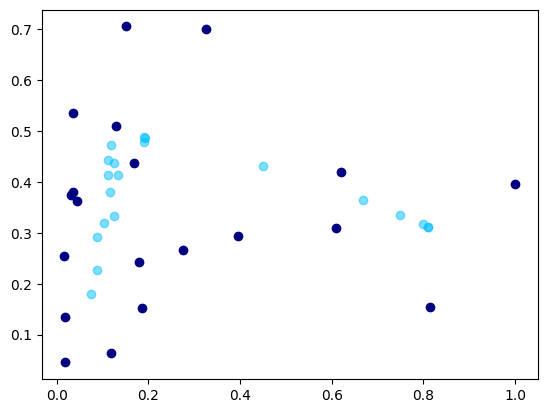

 99%|███████████████████████████████████████████████████████████████████████████████▍| 993/1000 [02:55<00:01,  5.95it/s]

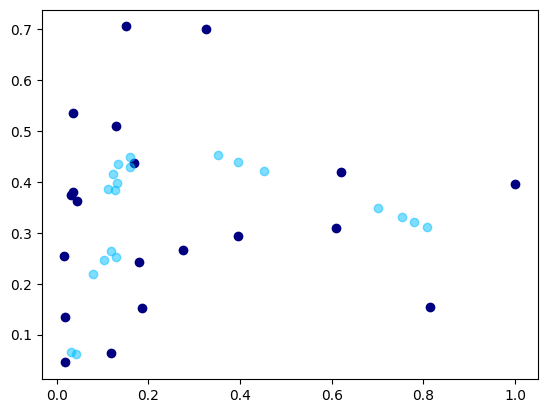

 99%|███████████████████████████████████████████████████████████████████████████████▌| 994/1000 [02:55<00:01,  5.82it/s]

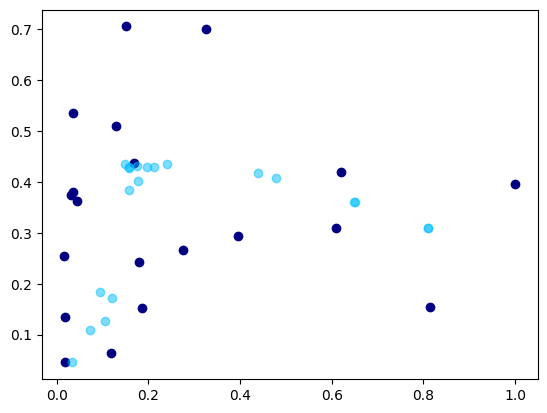

100%|███████████████████████████████████████████████████████████████████████████████▌| 995/1000 [02:55<00:00,  5.85it/s]

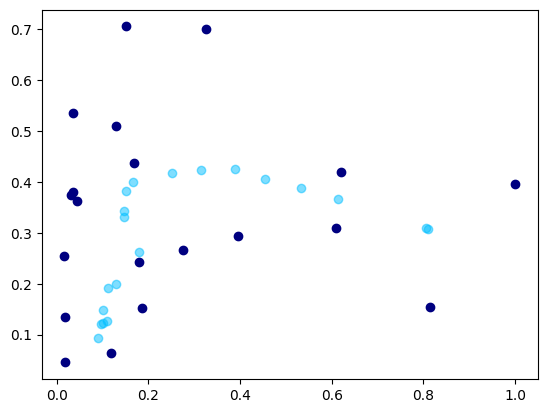

100%|███████████████████████████████████████████████████████████████████████████████▋| 996/1000 [02:55<00:00,  5.89it/s]

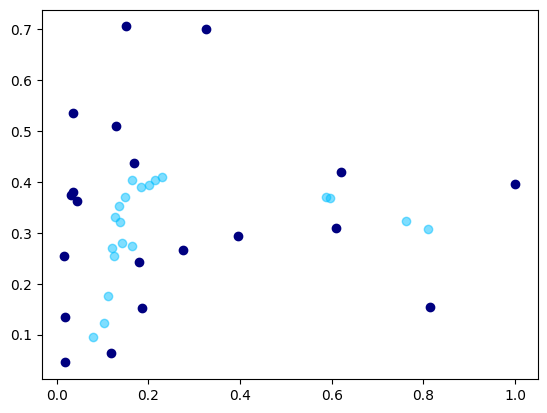

100%|███████████████████████████████████████████████████████████████████████████████▊| 997/1000 [02:55<00:00,  5.88it/s]

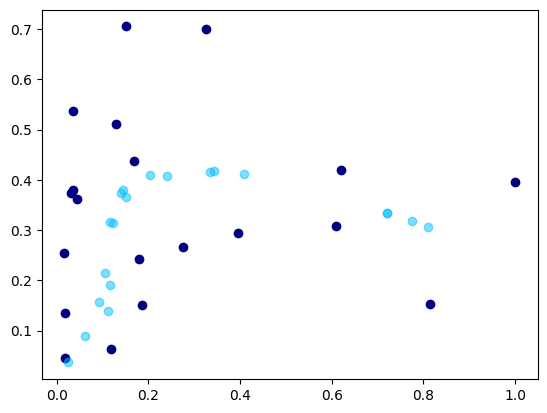

100%|███████████████████████████████████████████████████████████████████████████████▊| 998/1000 [02:55<00:00,  5.95it/s]

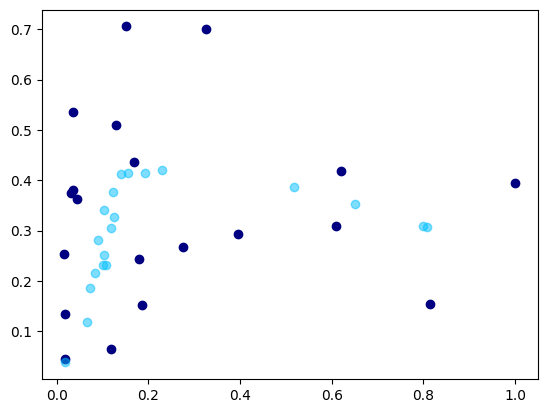

100%|███████████████████████████████████████████████████████████████████████████████▉| 999/1000 [02:56<00:00,  5.94it/s]

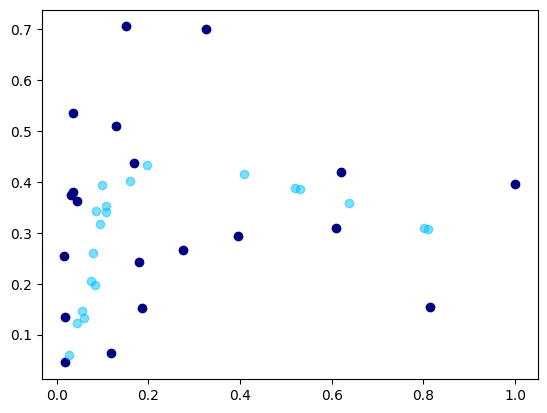

100%|███████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:56<00:00,  5.67it/s]


In [207]:
vae = VAE(2, 10, device = device)
_, losses = train_VAE2D(vae, y, n_epochs = 1000, prop_reconstruction = 1, prop_regularization = 0.03)

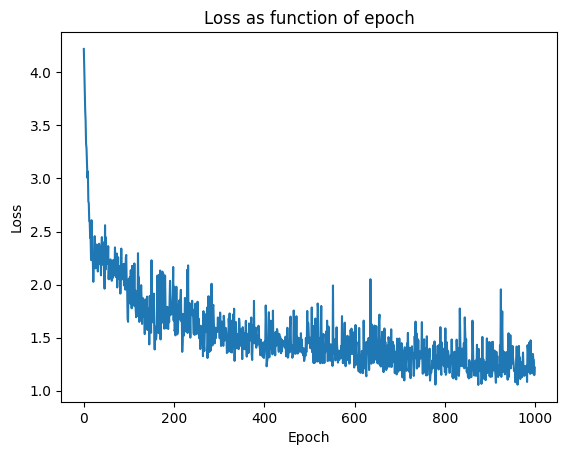

In [209]:
plt.plot(losses)
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Loss as function of epoch")
plt.show()

Now we have reach a better reconstruction, we need to see how well the data is generated.

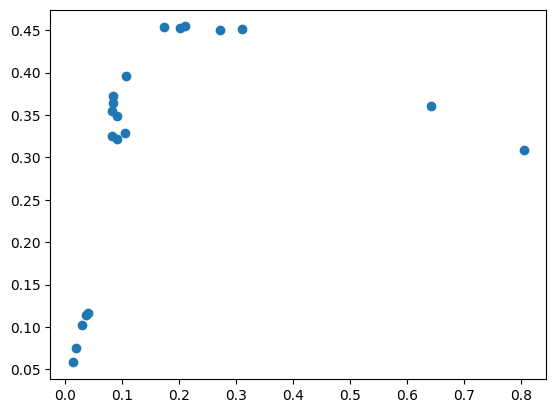

In [210]:
test = vae.decoder(torch.randn(20, 10).to(device)).detach().cpu().numpy()
plt.scatter(test[:, 0], test[:, 1])

The generation is worse than GAN.

## Question 2.1

The difficulties encountered for the hyperparameters:
For the three models:
* The architecture plays a key role for the learning. We need to have a good balance between Generator and dicriminator / encoder and decoder.
* The learning rate, especially for the VAE that seems to learn pretty slowly.
* For the GAN and WGAN, the number of iterations of learning for the discriminator and the generator. Again, we comeback to the problem of finding a good balance between the two adversaries. One should not be too much stronger than the other.
* The gradient penalty weight / clipping value for the WGAN.
* For the VAE, the weight the latent regularizer plays a crucial role in the good reconstruction and generation of the data.

Notice also that the GAN and WGAN are much harder to train than VAE which has a loss that behaves well during training compared to the loss of the GANs.

## Question 2.2

Note : I have commented along the execution of the cells, but I will add some remarks in this section.

First, the VAE is not suited for this small dataset, it has great difficulties to reconstruct the dataset, even with the latent regularizer set to 0. I hope that it will be better for MNIST dataset.

The GAN is surprisingly good, I suspects that the decoder is much more powerful than the generator, but the generator managed to generate meaningful points, and it has understood the global structure of the dataset (avoiding some outliers).

The WGAN performs the best, it is better than the GAN because it has also taken into account the outliers.

# Question 3

Now we'll move on to MNIST dataset.

In [288]:
dataset = MNIST("./data", download = True, transform = transforms.ToTensor() )

In [289]:
print("Size of dataset : ", len(dataset))
print("Size of an image : ", tuple(dataset[0][0].shape))

Size of dataset :  60000
Size of an image :  (1, 28, 28)


## Question 3.1

### WGAN

In [435]:

def train_wgan(G, D, loader, b = 100, lr = 0.002, n_epochs = 100, niterD = 1000, niterG = 10, lrdisc = 0.002, beta_1 = 0.5, beta_2 = 0.999, gpw = 0.1, iter_display = 5):
    """
    Utility function for training WGAN.
    ---Args:
        G : Generator
        D : Discriminator
        y : 2D dataset
        lr : learning rate for the generator and discriminator optimizers
        n_epochs : number of epochs
        niterD : number of optimization step per epoch for the discriminator
        niterG : number of optimization step per epoch for the generator
        beta_1: coefficient for computing moving average of gradients
        beta_2 : coefficient for computing square moving average of gradients
        gpw : Gradient penalty weight
        iter_display : when to display

    ---Returns:
        wgan : A trained generator.
    """
    torch.manual_seed(1)  # initialize random seed for reproducibility
    
    # Initialize generators and discriminators
    #G = Generator(n_in=n_in, n_out=d, n_hid=10, nlayers=3, device=device)
    optimG = optim.Adam(G.parameters(), lr=lr)
    
    #D = DWGAN(n_in=d, n_hid=10).to(device)
    optimD = optim.Adam(D.parameters(), lr=lrdisc, betas=(beta_1, beta_2))
    
    
    Glosses = []
    Dlosses = []
    n_in = G.n_in
    fixed_noise = torch.randn(10, n_in).to(device)
    flatten = nn.Flatten()
    shape_image = 28, 28
    for epoch in tqdm(range(0,n_epochs)):

        for batch, _ in loader:
            for i in range(niterD):
                
                batch = flatten(batch.to(device))
                optimD.zero_grad()
                z = torch.randn(b, n_in).to(device)
                g_z = G(z).detach()
                ### UPDATE OF D ###
                gp = gradient_penalty(D,batch,g_z)
                Dloss = -torch.mean(D(batch)) + torch.mean(D(g_z)) + gpw * gp
                Dloss.backward()
                optimD.step()
    
    
            for i in range(0,niterG):
                optimG.zero_grad()
                z = torch.randn(b, n_in, device = device)
                g_z = G(z)
                Gloss = - torch.mean(D(g_z))
                Gloss.backward()
                optimG.step()
    
    
        # Output training stats
        print('[%d/%d] \tLoss_D: %.4f\tLoss_G: %.4f'
          % (epoch, n_epochs, Dloss.item(), Gloss.item()))
        Glosses.append(Gloss.item())
        Dlosses.append(Dloss.item())
    
        if(epoch % iter_display == 0):
            generated = G(fixed_noise).detach().cpu().numpy()
            fig, ax = plt.subplots(2, 5)
            for i in range(ax.shape[0]):
                for j in range(ax.shape[1]):
                    ax[i, j].imshow(generated[i * 5 + j].reshape(shape_image))
            plt.show()
    
    
    # Save final generator for later use
    wgan = Generator(n_in=G.n_in, n_out=G.n_out, n_hid=G.n_hid, nlayers=G.nlayers, device=device)
    wgan.load_state_dict(G.state_dict())
    return wgan, Glosses, Dlosses

  0%|                                                                                            | 0/30 [00:00<?, ?it/s]

[0/30] 	Loss_D: -12.1236	Loss_G: 3.7048


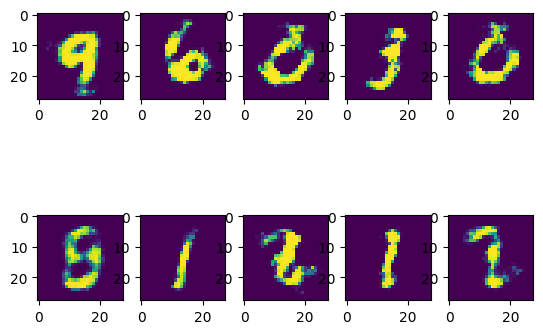

  7%|█████▌                                                                             | 2/30 [03:55<54:46, 117.37s/it]

[1/30] 	Loss_D: -10.9492	Loss_G: -2.7198
[2/30] 	Loss_D: -6.8577	Loss_G: -3.8523


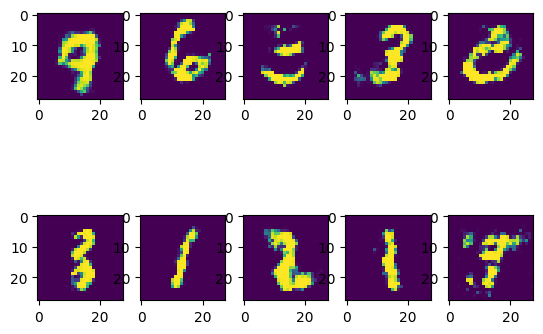

 13%|███████████                                                                        | 4/30 [07:49<50:27, 116.43s/it]

[3/30] 	Loss_D: -7.0576	Loss_G: -5.9253
[4/30] 	Loss_D: -7.8456	Loss_G: 3.4452


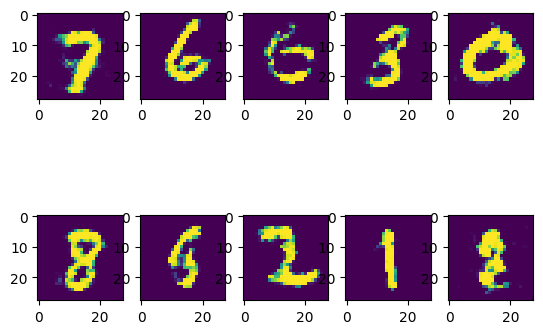

 20%|████████████████▌                                                                  | 6/30 [11:23<44:27, 111.14s/it]

[5/30] 	Loss_D: -8.5292	Loss_G: 6.6361
[6/30] 	Loss_D: -8.9841	Loss_G: -15.4021


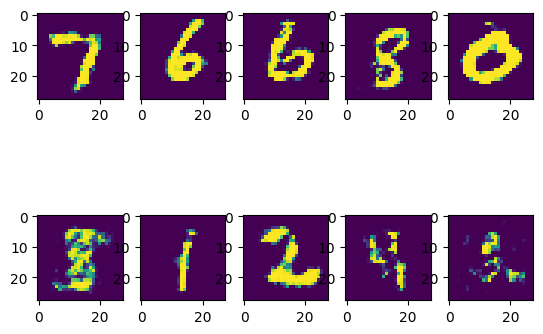

 27%|██████████████████████▏                                                            | 8/30 [14:54<39:35, 107.99s/it]

[7/30] 	Loss_D: -6.5006	Loss_G: -22.1086
[8/30] 	Loss_D: -4.2821	Loss_G: 3.0193


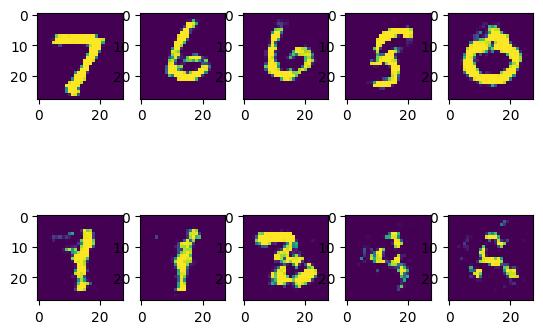

 33%|███████████████████████████▎                                                      | 10/30 [18:26<35:39, 106.98s/it]

[9/30] 	Loss_D: -5.9324	Loss_G: -4.2267
[10/30] 	Loss_D: -4.8931	Loss_G: 3.3375


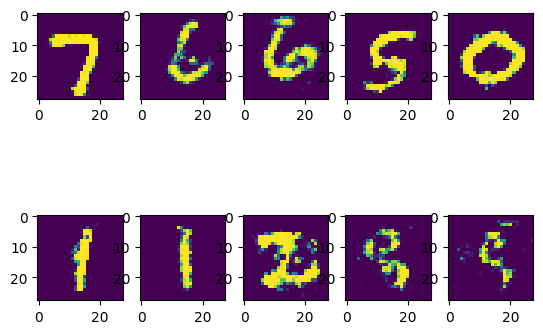

 40%|████████████████████████████████▊                                                 | 12/30 [21:56<31:47, 105.99s/it]

[11/30] 	Loss_D: -5.3257	Loss_G: 0.8367
[12/30] 	Loss_D: -5.9270	Loss_G: -0.3552


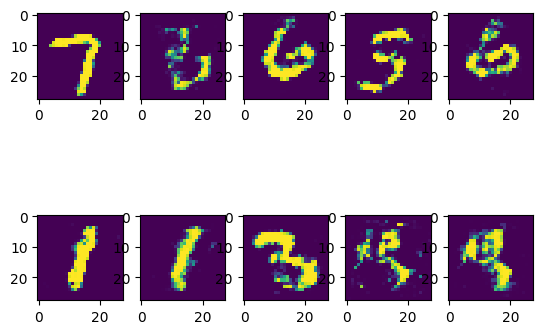

 47%|██████████████████████████████████████▎                                           | 14/30 [25:33<28:41, 107.61s/it]

[13/30] 	Loss_D: -3.9944	Loss_G: -3.3964
[14/30] 	Loss_D: -8.4613	Loss_G: -0.5914


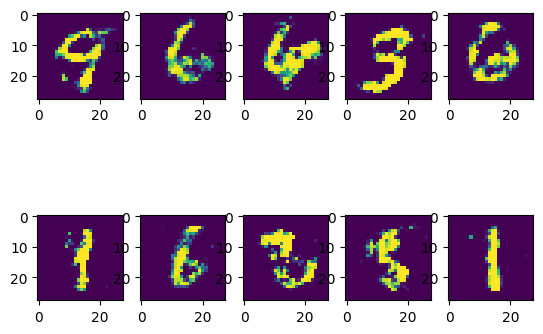

 53%|███████████████████████████████████████████▋                                      | 16/30 [29:02<24:40, 105.76s/it]

[15/30] 	Loss_D: -5.4500	Loss_G: 23.2022
[16/30] 	Loss_D: -3.6811	Loss_G: 8.7643


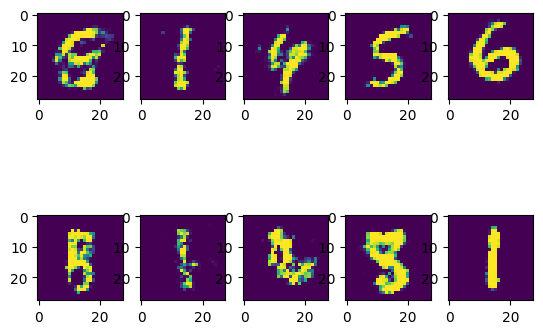

 60%|█████████████████████████████████████████████████▏                                | 18/30 [32:30<20:56, 104.74s/it]

[17/30] 	Loss_D: -4.5028	Loss_G: -5.3775
[18/30] 	Loss_D: -4.9673	Loss_G: 2.7208


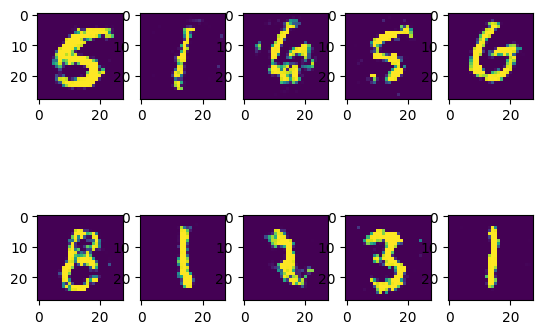

 67%|██████████████████████████████████████████████████████▋                           | 20/30 [35:58<17:25, 104.54s/it]

[19/30] 	Loss_D: -2.8322	Loss_G: 1.8493
[20/30] 	Loss_D: -3.3845	Loss_G: -15.0706


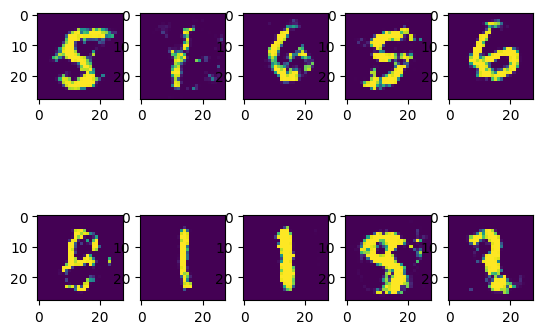

 73%|████████████████████████████████████████████████████████████▏                     | 22/30 [39:28<13:57, 104.67s/it]

[21/30] 	Loss_D: -4.9388	Loss_G: -17.6025
[22/30] 	Loss_D: -3.9149	Loss_G: -7.6957


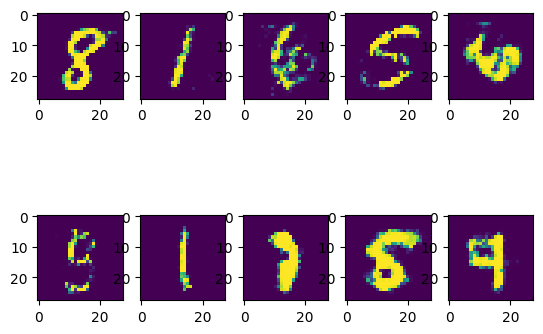

 80%|█████████████████████████████████████████████████████████████████▌                | 24/30 [42:56<10:24, 104.16s/it]

[23/30] 	Loss_D: -3.0467	Loss_G: 1.3905
[24/30] 	Loss_D: -2.6723	Loss_G: -0.4641


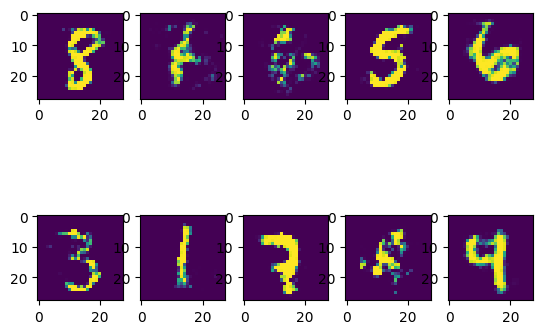

 87%|███████████████████████████████████████████████████████████████████████           | 26/30 [46:31<07:03, 105.97s/it]

[25/30] 	Loss_D: -3.3731	Loss_G: 2.6949
[26/30] 	Loss_D: -3.2994	Loss_G: -12.1447


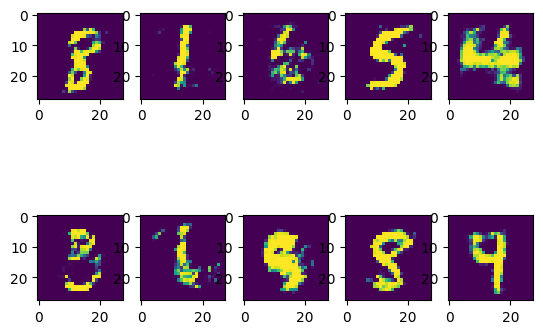

 93%|████████████████████████████████████████████████████████████████████████████▌     | 28/30 [50:03<03:31, 105.75s/it]

[27/30] 	Loss_D: -4.4826	Loss_G: -0.4713
[28/30] 	Loss_D: -5.0573	Loss_G: -14.5090


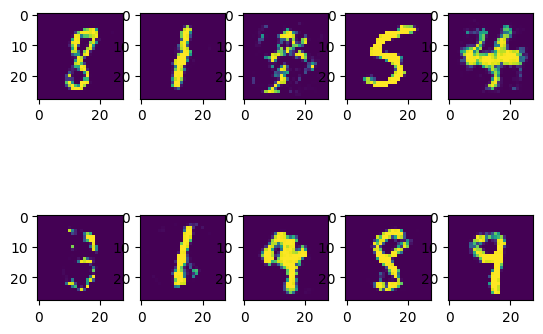

100%|██████████████████████████████████████████████████████████████████████████████████| 30/30 [53:33<00:00, 107.11s/it]

[29/30] 	Loss_D: -3.6906	Loss_G: -13.1924


In [442]:
# Training WGAN
n_in = 256
b = 64
G = Generator(n_in=n_in, n_out=784, n_hid=128, nlayers=5, device=device)

D = DWGAN(784, n_hid = 128).to(device)

loader = DataLoader(dataset, batch_size = 64, shuffle = True, pin_memory = True)
wgan, Glosses, Dlosses = train_wgan(G, D, loader, n_epochs = 30, lr = 0.0004,  b = 64, niterD = 10, niterG = 2, gpw = 0.2, iter_display = 2)

In [444]:
torch.save(wgan, "wgan.pth")

Text(0.5, 1.0, 'Loss as function of epoch')

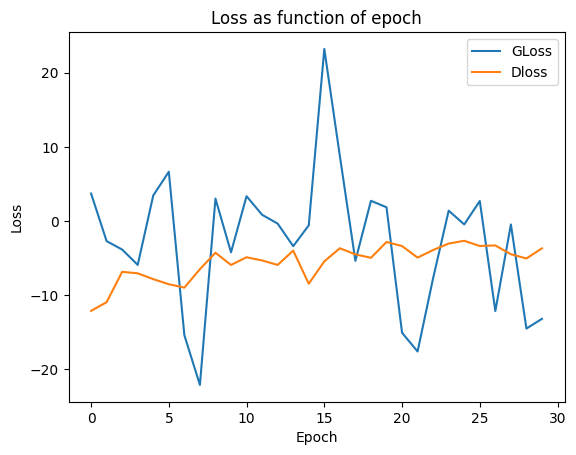

In [446]:
plt.plot(Glosses, label = "GLoss")
plt.plot(Dlosses, label = "Dloss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.title("Loss as function of epoch")

During the training, we can notice that some digits becomes through the epochs, while other digits become worse (take the six for instance).

The loss is pretty telling, the decoder loss sems pretty steady, while the Gloss fluctuates a lot, meaning the the generator seems to have a hard time to generate good images. A possible enhancement is to increase the number of iterations for the generator, or reduce the capacity of the decoder. And also train for more epochs the WGAN.

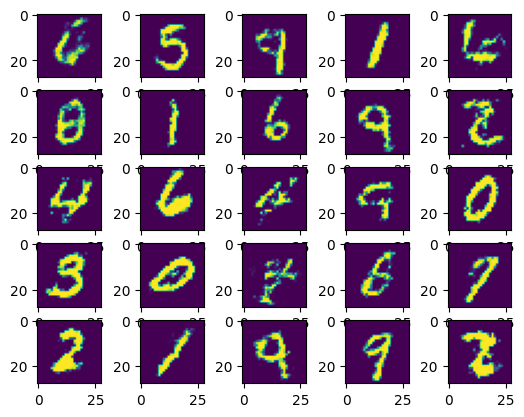

In [447]:
z = torch.randn(25, n_in, device = device)
generated = wgan(z).detach().cpu().numpy()
fig, ax = plt.subplots(5, 5)
for i in range(ax.shape[0]):
    for j in range(ax.shape[1]):
        ax[i, j].imshow(generated[i * 5 + j].reshape((28, 28)))
plt.show()


The images seems pretty good.

First there is a good diversity of the generated digits, thanks to the wasserstein loss.
Second some digits are very well generated, take for instance the 3, 4, 2, 1, 5...
But some other digits are very weird, and incomplete. 

Furthermore, the digits are noisy. The contours are not well define.

But overall, it is a good model for generating digits.



### VAE

In [449]:
def train_VAE(model,loader,  lr = 0.001, n_epochs = 200, prop_reconstruction = 1, prop_regularization = 1, iter_display = 5, device = "cuda"):
    optimizer = torch.optim.Adam(model.parameters(), lr)
    losses = []
    size = 25
    #fixed_noise = torch.randn(10, model.decoder.n_in, device = device)
    flatten = nn.Flatten()
    for i in tqdm(range(n_epochs)):
        for batch, _ in loader:
              shape_image = batch.shape[-2], batch.shape[-1]
              batch = flatten(batch.to(device))
              optimizer.zero_grad()
              x_reconstructed, mean, logvar = model(batch)
              loss = loss_vae(batch, x_reconstructed, mean, logvar, prop_reconstruction, prop_regularization)
              loss.backward()
              optimizer.step()
              losses.append(loss.item())
        if i % iter_display == 0:
            with torch.no_grad():
                fixed_noise = torch.randn(10, model.decoder.n_in, device = device)
                generated = vae.decoder(fixed_noise).detach().cpu().numpy()
                fig, ax = plt.subplots(2, 5)
                for i in range(ax.shape[0]):
                    for j in range(ax.shape[1]):
                        ax[i, j].imshow(generated[i * 5 + j].reshape(shape_image))
            plt.show()
    return model, losses

  0%|                                                                                           | 0/100 [00:00<?, ?it/s]

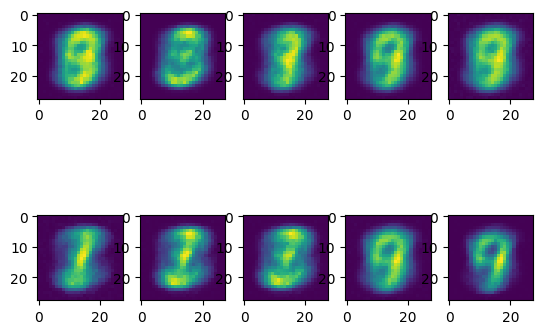

  5%|████▏                                                                              | 5/100 [01:27<27:30, 17.37s/it]

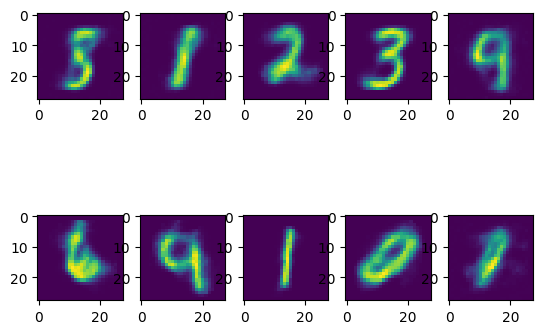

 10%|████████▏                                                                         | 10/100 [02:53<25:53, 17.27s/it]

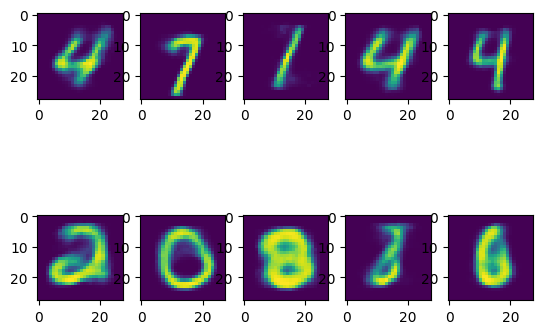

 15%|████████████▎                                                                     | 15/100 [04:21<24:33, 17.33s/it]

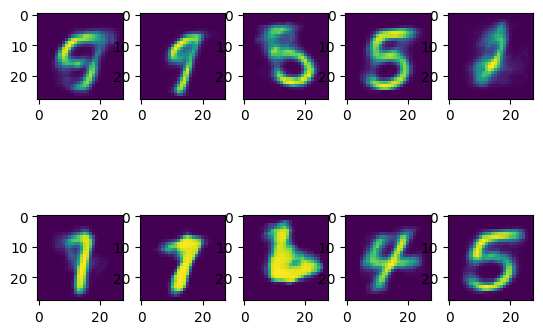

 20%|████████████████▍                                                                 | 20/100 [05:48<23:18, 17.48s/it]

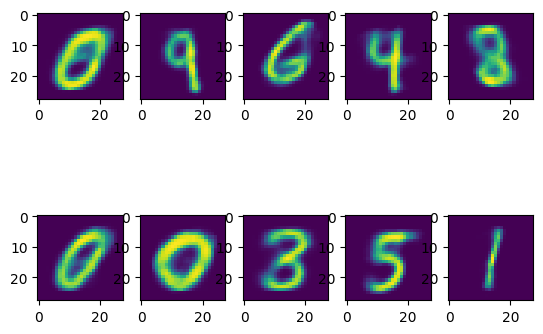

 25%|████████████████████▌                                                             | 25/100 [07:16<21:40, 17.34s/it]

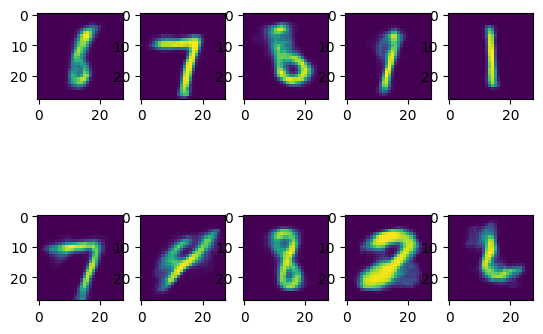

 30%|████████████████████████▌                                                         | 30/100 [08:42<20:06, 17.24s/it]

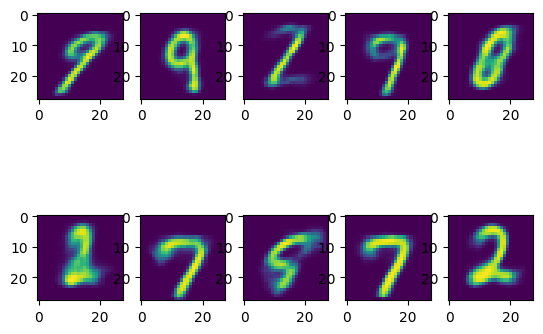

 35%|████████████████████████████▋                                                     | 35/100 [10:08<18:41, 17.25s/it]

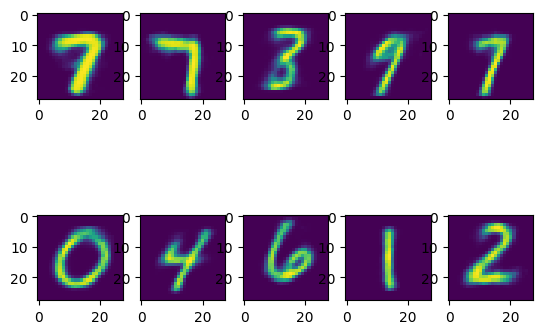

 40%|████████████████████████████████▊                                                 | 40/100 [11:35<17:05, 17.10s/it]

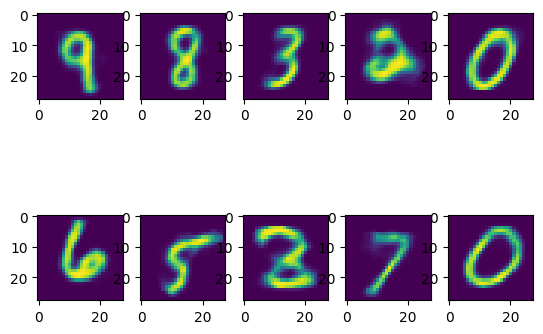

 45%|████████████████████████████████████▉                                             | 45/100 [13:02<15:57, 17.41s/it]

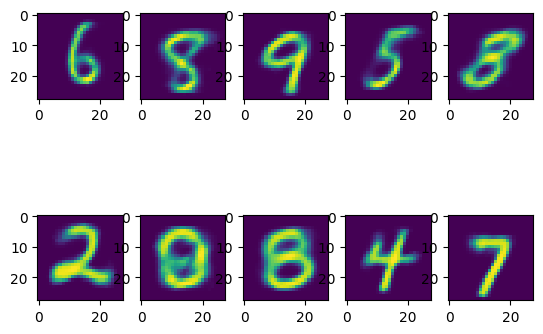

 50%|█████████████████████████████████████████                                         | 50/100 [14:30<14:37, 17.55s/it]

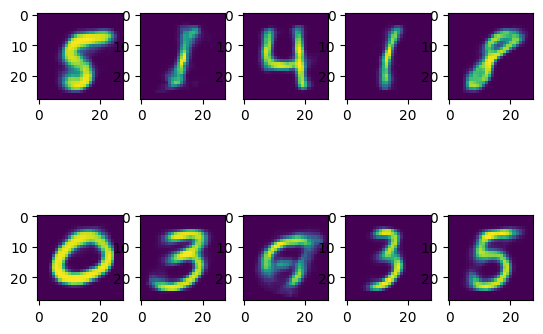

 55%|█████████████████████████████████████████████                                     | 55/100 [15:58<13:06, 17.47s/it]

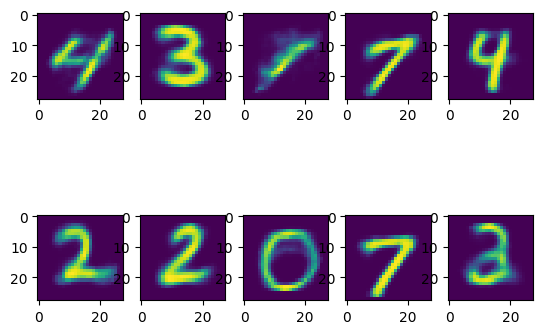

 60%|█████████████████████████████████████████████████▏                                | 60/100 [17:26<11:38, 17.45s/it]

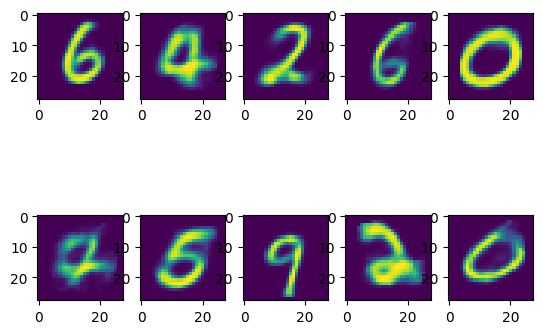

 65%|█████████████████████████████████████████████████████▎                            | 65/100 [18:53<10:04, 17.27s/it]

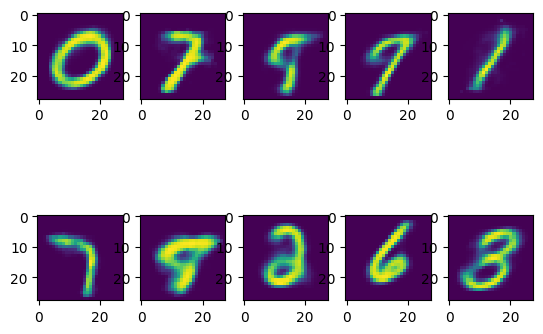

 70%|█████████████████████████████████████████████████████████▍                        | 70/100 [20:19<08:35, 17.19s/it]

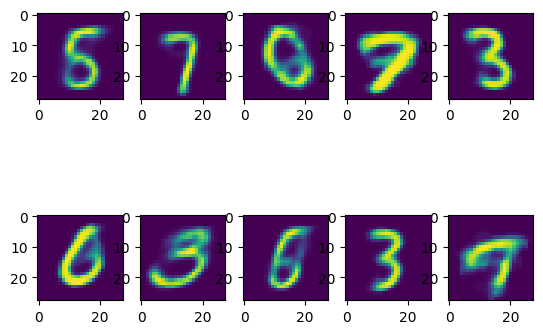

 75%|█████████████████████████████████████████████████████████████▌                    | 75/100 [21:45<07:07, 17.11s/it]

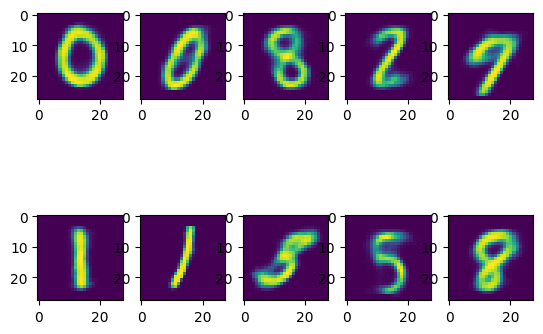

 80%|█████████████████████████████████████████████████████████████████▌                | 80/100 [23:11<05:41, 17.06s/it]

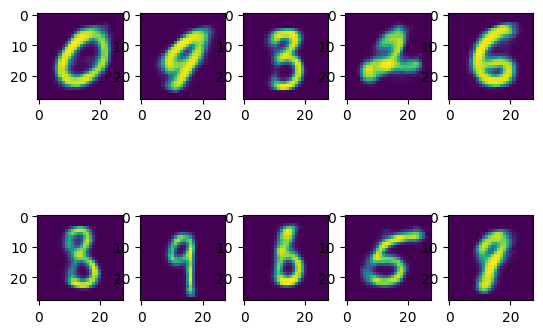

 85%|█████████████████████████████████████████████████████████████████████▋            | 85/100 [24:36<04:14, 16.97s/it]

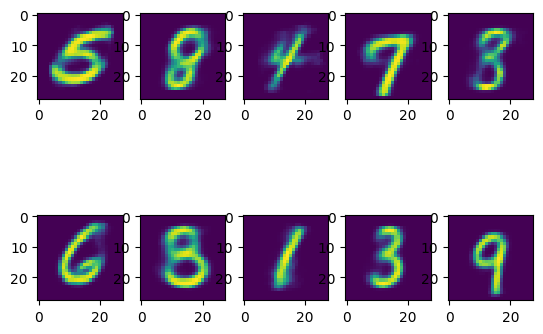

 90%|█████████████████████████████████████████████████████████████████████████▊        | 90/100 [26:01<02:49, 16.93s/it]

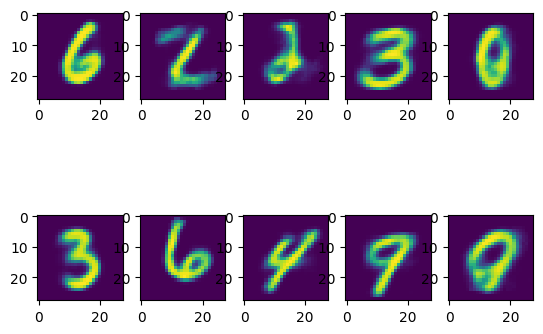

 95%|█████████████████████████████████████████████████████████████████████████████▉    | 95/100 [27:26<01:24, 16.92s/it]

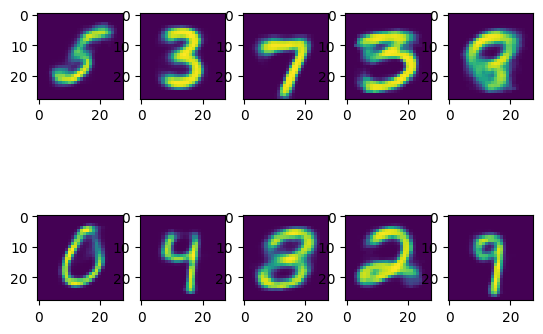

100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [28:51<00:00, 17.32s/it]


In [453]:
n_in_encoder = 28 * 28
n_in_decoder = 128
loader = DataLoader(dataset, batch_size = 128, shuffle = True, pin_memory = True)

vae = VAE(n_in_encoder, n_in_decoder, n_hid_encoder = 256, n_hid_decoder = 256)
model_vae, losses = train_VAE(vae, loader, n_epochs = 100, prop_regularization = 1)

In [472]:
torch.save(model_vae, "vae.pth")

/tmp/ipykernel_203259/3147150899.py:4: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


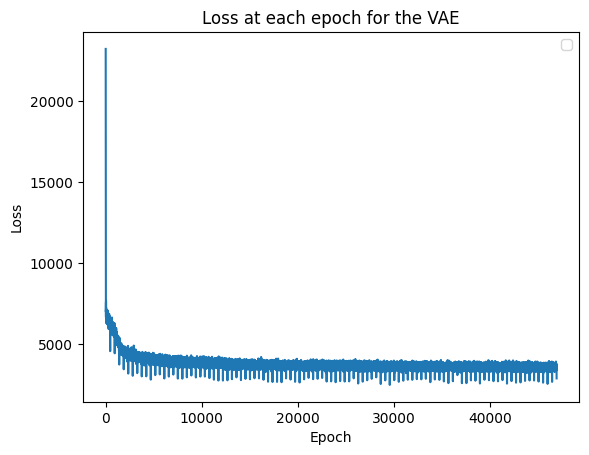

In [455]:
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Loss at each epoch for the VAE")
plt.legend()
plt.plot(losses)

The VAE is very good at generating the digits, even though they are a little bit blurry (because the posterior distribution approximation is a gaussian probability distribution), those digits are plausible.
## Question 3.2

For this case, I would favor the VAE.

It is easier to train, converges easily, generates very good images with a lot of variety. Its drawback is the bluriness.

The WGAN is better for generating sharp images, but considering its difficulty to train, I'll choose the VAE.

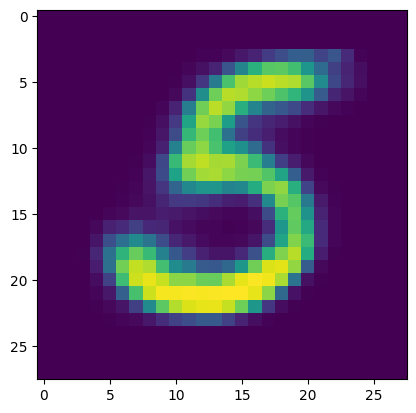

In [474]:
z = torch.randn(1, model_vae.decoder.n_in, device = device)
img = model_vae.decoder(z).reshape(28, 28).detach().cpu().numpy()
plt.imshow(img)

# Question 4

## Question 4.1

Fréchet inception distance (FID) is a metric used to assess the quality of a generative model. It measures how close are two features distributions $ \mu $ and $ \nu $, where:

* $\mu$ is the distribution of generated images.
* $\nu$ is the distribution of a set of real images (ground truth).



Algorithm:
1. Draw samples $ x_i \sim \mu $ and  $ y_i \sim \nu $ and compute high level features $ f(x_i) $ and $ f(y_i) $ where f is the deepest layer in Inception-v3.
2. We compute the mean and variances in feature space of the two distributions.
3. We compute the 2-Wassertein distance of the gaussian distributions in feature space.

FID seems appropriate for our case, our images are simple, and it will give a good insight on how well the generative models perform. Note also that the FID score considers the Wasserstein distance between two distributions,  which is exactly what we try to minimize in the loss of the WGAN.




## Question 4.2
A good score that will take into account the classes:
* Train a MNIST classifier or get one (state-of-the-art) that has been trained on MNIST.
* Classify the generated images, and computes the FID score per class.

## Question 4.3
For the FID score:

Advantages :
* Measures the diversity of generated images.
* Captures both precision (probability that a fake image falls in the real images distribution) and recall (probability that a real image falls in the fake images distributions).

Drawbacks :
* Need a neural network to represent the features.
* Doesn't consider the photo-realism.


For the MNIST classifier:

Advantages:
* Easy to implement.
* Very insightful.

Drawbacks:

* Generated data could be misleading even if they were correctly generated (adversarial images), entailing that the classification would not be accurate.